<a href="https://colab.research.google.com/github/Manureddy148/DSA_Assign1/blob/main/BloomFilter_3Dvs1D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import hashlib
import pandas as pd

class BloomFilter3D:
    def __init__(self, size, hash_funcs):
        self.size = size
        self.hash_funcs = hash_funcs
        self.filter = np.zeros(size, dtype=bool)
        self.hash_data = [] # To store hash values for display

    def _hash_value(self, value, hash_func):
        # Convert the value to a string before hashing
        return int(hash_func(str(value).encode('utf-8')).hexdigest(), 16)

    def add(self, item):
        self.hash_data = [] # Clear previous hash data
        for i, hash_func in enumerate(self.hash_funcs):
            for j, hf_j in enumerate(self.hash_funcs):
                for k, hf_k in enumerate(self.hash_funcs):
                    hash_val_i = self._hash_value(item, hash_func) % self.size[0]
                    hash_val_j = self._hash_value(item, hf_j) % self.size[1]
                    hash_val_k = self._hash_value(item, hf_k) % self.size[2]
                    self.filter[hash_val_i, hash_val_j, hash_val_k] = True
                    self.hash_data.append({
                        "Item": item,
                        "Hash Func i": hash_func.__name__,
                        "Hash Func j": hf_j.__name__,
                        "Hash Func k": hf_k.__name__,
                        "Hash Value i": hash_val_i,
                        "Hash Value j": hash_val_j,
                        "Hash Value k": hash_val_k
                    })
        print(f"Hash values generated during add for '{item}':")
        display(pd.DataFrame(self.hash_data))


    def contains(self, item):
        self.hash_data = [] # Clear previous hash data
        is_in_filter = True
        for i, hash_func in enumerate(self.hash_funcs):
            for j, hf_j in enumerate(self.hash_funcs):
                for k, hf_k in enumerate(self.hash_funcs):
                    hash_val_i = self._hash_value(item, hash_func) % self.size[0]
                    hash_val_j = self._hash_value(item, hf_j) % self.size[1]
                    hash_val_k = self._hash_value(item, hf_k) % self.size[2]
                    self.hash_data.append({
                        "Item": item,
                        "Hash Func i": hash_func.__name__,
                        "Hash Func j": hf_j.__name__,
                        "Hash Func k": hf_k.__name__,
                        "Hash Value i": hash_val_i,
                        "Hash Value j": hash_val_j,
                        "Hash Value k": hash_val_k,
                        "Filter Value": self.filter[hash_val_i, hash_val_j, hash_val_k].astype(int)
                    })
                    if not self.filter[hash_val_i, hash_val_j, hash_val_k]:
                        is_in_filter = False
        print(f"Hash values generated during contains for '{item}':")
        display(pd.DataFrame(self.hash_data))
        return is_in_filter


# Example usage:
# Define the size of the 3D Bloom filter
filter_size = (100, 100, 100)

# Define a list of hash functions
hash_functions = [hashlib.sha256, hashlib.md5, hashlib.sha1]

# Create a Bloom filter instance
bloom_filter = BloomFilter3D(filter_size, hash_functions)

# Add items to the filter
items_to_add = ["apple", "banana", "cherry", "date"]
for item in items_to_add:
    bloom_filter.add(item)

# Check if items are in the filter
items_to_check = ["apple", "grape", "cherry", "orange"]
for item in items_to_check:
    if bloom_filter.contains(item):
        print(f"{item} might be in the filter.")
    else:
        print(f"{item} is definitely not in the filter.")

Hash values generated during add for 'apple':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,apple,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27
1,apple,openssl_sha256,openssl_sha256,openssl_md5,27,27,31
2,apple,openssl_sha256,openssl_sha256,openssl_sha1,27,27,84
3,apple,openssl_sha256,openssl_md5,openssl_sha256,27,31,27
4,apple,openssl_sha256,openssl_md5,openssl_md5,27,31,31
5,apple,openssl_sha256,openssl_md5,openssl_sha1,27,31,84
6,apple,openssl_sha256,openssl_sha1,openssl_sha256,27,84,27
7,apple,openssl_sha256,openssl_sha1,openssl_md5,27,84,31
8,apple,openssl_sha256,openssl_sha1,openssl_sha1,27,84,84
9,apple,openssl_md5,openssl_sha256,openssl_sha256,31,27,27


Hash values generated during add for 'banana':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,banana,openssl_sha256,openssl_sha256,openssl_sha256,10,10,10
1,banana,openssl_sha256,openssl_sha256,openssl_md5,10,10,21
2,banana,openssl_sha256,openssl_sha256,openssl_sha1,10,10,16
3,banana,openssl_sha256,openssl_md5,openssl_sha256,10,21,10
4,banana,openssl_sha256,openssl_md5,openssl_md5,10,21,21
5,banana,openssl_sha256,openssl_md5,openssl_sha1,10,21,16
6,banana,openssl_sha256,openssl_sha1,openssl_sha256,10,16,10
7,banana,openssl_sha256,openssl_sha1,openssl_md5,10,16,21
8,banana,openssl_sha256,openssl_sha1,openssl_sha1,10,16,16
9,banana,openssl_md5,openssl_sha256,openssl_sha256,21,10,10


Hash values generated during add for 'cherry':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,cherry,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26
1,cherry,openssl_sha256,openssl_sha256,openssl_md5,26,26,18
2,cherry,openssl_sha256,openssl_sha256,openssl_sha1,26,26,65
3,cherry,openssl_sha256,openssl_md5,openssl_sha256,26,18,26
4,cherry,openssl_sha256,openssl_md5,openssl_md5,26,18,18
5,cherry,openssl_sha256,openssl_md5,openssl_sha1,26,18,65
6,cherry,openssl_sha256,openssl_sha1,openssl_sha256,26,65,26
7,cherry,openssl_sha256,openssl_sha1,openssl_md5,26,65,18
8,cherry,openssl_sha256,openssl_sha1,openssl_sha1,26,65,65
9,cherry,openssl_md5,openssl_sha256,openssl_sha256,18,26,26


Hash values generated during add for 'date':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,date,openssl_sha256,openssl_sha256,openssl_sha256,33,33,33
1,date,openssl_sha256,openssl_sha256,openssl_md5,33,33,19
2,date,openssl_sha256,openssl_sha256,openssl_sha1,33,33,30
3,date,openssl_sha256,openssl_md5,openssl_sha256,33,19,33
4,date,openssl_sha256,openssl_md5,openssl_md5,33,19,19
5,date,openssl_sha256,openssl_md5,openssl_sha1,33,19,30
6,date,openssl_sha256,openssl_sha1,openssl_sha256,33,30,33
7,date,openssl_sha256,openssl_sha1,openssl_md5,33,30,19
8,date,openssl_sha256,openssl_sha1,openssl_sha1,33,30,30
9,date,openssl_md5,openssl_sha256,openssl_sha256,19,33,33


Hash values generated during contains for 'apple':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,apple,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27,1
1,apple,openssl_sha256,openssl_sha256,openssl_md5,27,27,31,1
2,apple,openssl_sha256,openssl_sha256,openssl_sha1,27,27,84,1
3,apple,openssl_sha256,openssl_md5,openssl_sha256,27,31,27,1
4,apple,openssl_sha256,openssl_md5,openssl_md5,27,31,31,1
5,apple,openssl_sha256,openssl_md5,openssl_sha1,27,31,84,1
6,apple,openssl_sha256,openssl_sha1,openssl_sha256,27,84,27,1
7,apple,openssl_sha256,openssl_sha1,openssl_md5,27,84,31,1
8,apple,openssl_sha256,openssl_sha1,openssl_sha1,27,84,84,1
9,apple,openssl_md5,openssl_sha256,openssl_sha256,31,27,27,1


apple might be in the filter.
Hash values generated during contains for 'grape':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,grape,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54,0
1,grape,openssl_sha256,openssl_sha256,openssl_md5,54,54,13,0
2,grape,openssl_sha256,openssl_sha256,openssl_sha1,54,54,71,0
3,grape,openssl_sha256,openssl_md5,openssl_sha256,54,13,54,0
4,grape,openssl_sha256,openssl_md5,openssl_md5,54,13,13,0
5,grape,openssl_sha256,openssl_md5,openssl_sha1,54,13,71,0
6,grape,openssl_sha256,openssl_sha1,openssl_sha256,54,71,54,0
7,grape,openssl_sha256,openssl_sha1,openssl_md5,54,71,13,0
8,grape,openssl_sha256,openssl_sha1,openssl_sha1,54,71,71,0
9,grape,openssl_md5,openssl_sha256,openssl_sha256,13,54,54,0


grape is definitely not in the filter.
Hash values generated during contains for 'cherry':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,cherry,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26,1
1,cherry,openssl_sha256,openssl_sha256,openssl_md5,26,26,18,1
2,cherry,openssl_sha256,openssl_sha256,openssl_sha1,26,26,65,1
3,cherry,openssl_sha256,openssl_md5,openssl_sha256,26,18,26,1
4,cherry,openssl_sha256,openssl_md5,openssl_md5,26,18,18,1
5,cherry,openssl_sha256,openssl_md5,openssl_sha1,26,18,65,1
6,cherry,openssl_sha256,openssl_sha1,openssl_sha256,26,65,26,1
7,cherry,openssl_sha256,openssl_sha1,openssl_md5,26,65,18,1
8,cherry,openssl_sha256,openssl_sha1,openssl_sha1,26,65,65,1
9,cherry,openssl_md5,openssl_sha256,openssl_sha256,18,26,26,1


cherry might be in the filter.
Hash values generated during contains for 'orange':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,orange,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48,0
1,orange,openssl_sha256,openssl_sha256,openssl_md5,48,48,45,0
2,orange,openssl_sha256,openssl_sha256,openssl_sha1,48,48,58,0
3,orange,openssl_sha256,openssl_md5,openssl_sha256,48,45,48,0
4,orange,openssl_sha256,openssl_md5,openssl_md5,48,45,45,0
5,orange,openssl_sha256,openssl_md5,openssl_sha1,48,45,58,0
6,orange,openssl_sha256,openssl_sha1,openssl_sha256,48,58,48,0
7,orange,openssl_sha256,openssl_sha1,openssl_md5,48,58,45,0
8,orange,openssl_sha256,openssl_sha1,openssl_sha1,48,58,58,0
9,orange,openssl_md5,openssl_sha256,openssl_sha256,45,48,48,0


orange is definitely not in the filter.


In [ ]:
print("i:",hash_val_i)
print("j:",hash_val_j)
print("k:",hash_val_k)

i: 65
j: 65
k: 65


In [ ]:
display(bloom_filter.filter.astype(int))

array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 

In [ ]:
# Choose an item to check
item_to_display = "apple"

print(f"Displaying parts of the Bloom filter where '{item_to_display}' is stored:")

for i, hash_func in enumerate(bloom_filter.hash_funcs):
    for j, hf_j in enumerate(bloom_filter.hash_funcs):
        for k, hf_k in enumerate(bloom_filter.hash_funcs):
            hash_val_i = bloom_filter._hash_value(item_to_display, hash_func) % bloom_filter.size[0]
            hash_val_j = bloom_filter._hash_value(item_to_display, hf_j) % bloom_filter.size[1]
            hash_val_k = bloom_filter._hash_value(item_to_display, hf_k) % bloom_filter.size[2]
            print(f"Index ({hash_val_i}, {hash_val_j}, {hash_val_k}): {bloom_filter.filter[hash_val_i, hash_val_j, hash_val_k].astype(int)}")

Displaying parts of the Bloom filter where 'apple' is stored:
Index (27, 27, 27): 1
Index (27, 27, 31): 1
Index (27, 27, 84): 1
Index (27, 31, 27): 1
Index (27, 31, 31): 1
Index (27, 31, 84): 1
Index (27, 84, 27): 1
Index (27, 84, 31): 1
Index (27, 84, 84): 1
Index (31, 27, 27): 1
Index (31, 27, 31): 1
Index (31, 27, 84): 1
Index (31, 31, 27): 1
Index (31, 31, 31): 1
Index (31, 31, 84): 1
Index (31, 84, 27): 1
Index (31, 84, 31): 1
Index (31, 84, 84): 1
Index (84, 27, 27): 1
Index (84, 27, 31): 1
Index (84, 27, 84): 1
Index (84, 31, 27): 1
Index (84, 31, 31): 1
Index (84, 31, 84): 1
Index (84, 84, 27): 1
Index (84, 84, 31): 1
Index (84, 84, 84): 1


In [ ]:
import pandas as pd

# Choose an item to check
item_to_display = "apple"

print(f"Values in the Bloom filter at indices for '{item_to_display}':")

data = []
for i, hash_func in enumerate(bloom_filter.hash_funcs):
    for j, hf_j in enumerate(bloom_filter.hash_funcs):
        for k, hf_k in enumerate(bloom_filter.hash_funcs):
            hash_val_i = bloom_filter._hash_value(item_to_display, hash_func) % bloom_filter.size[0]
            hash_val_j = bloom_filter._hash_value(item_to_display, hf_j) % bloom_filter.size[1]
            hash_val_k = bloom_filter._hash_value(item_to_display, hf_k) % bloom_filter.size[2]
            data.append({
                "Index (i, j, k)": f"({hash_val_i}, {hash_val_j}, {hash_val_k})",
                "Value": bloom_filter.filter[hash_val_i, hash_val_j, hash_val_k].astype(int)
            })

df = pd.DataFrame(data)
display(df)

Values in the Bloom filter at indices for 'apple':


,"Index (i, j, k)",Value
0,"(27, 27, 27)",1
1,"(27, 27, 31)",1
2,"(27, 27, 84)",1
3,"(27, 31, 27)",1
4,"(27, 31, 31)",1
5,"(27, 31, 84)",1
6,"(27, 84, 27)",1
7,"(27, 84, 31)",1
8,"(27, 84, 84)",1
9,"(31, 27, 27)",1


# Task
Visualize the 3D Bloom filter, including the locations of specific items and the overall density of set bits.

## Visualize the entire bloom filter

### Subtask:
Create a 3D visualization of the entire Bloom filter to show the distribution of set bits (where the value is 1).


**Reasoning**:
Create a 3D scatter plot to visualize the distribution of set bits in the Bloom filter.



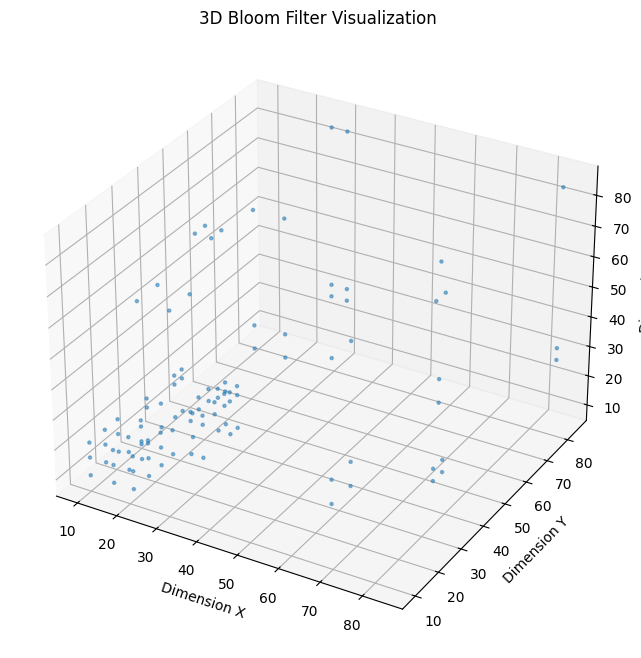

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Get the coordinates of the set bits
x_coords, y_coords, z_coords = np.where(bloom_filter.filter)

# Create a 3D scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the set bits
ax.scatter(x_coords, y_coords, z_coords, s=5, alpha=0.5)

# Label the axes
ax.set_xlabel('Dimension X')
ax.set_ylabel('Dimension Y')
ax.set_zlabel('Dimension Z')

# Add a title
ax.set_title('3D Bloom Filter Visualization')

# Display the plot
plt.show()

## Visualize specific item locations

### Subtask:
Visualize the specific locations within the 3D filter where the hash values for a particular item are set.


**Reasoning**:
I need to choose an item, calculate its hash values across all hash function combinations to get 3D coordinates, and then plot these specific points on a 3D scatter plot, labeling the plot appropriately. This requires looping through the hash functions and calculating the coordinates for the chosen item.



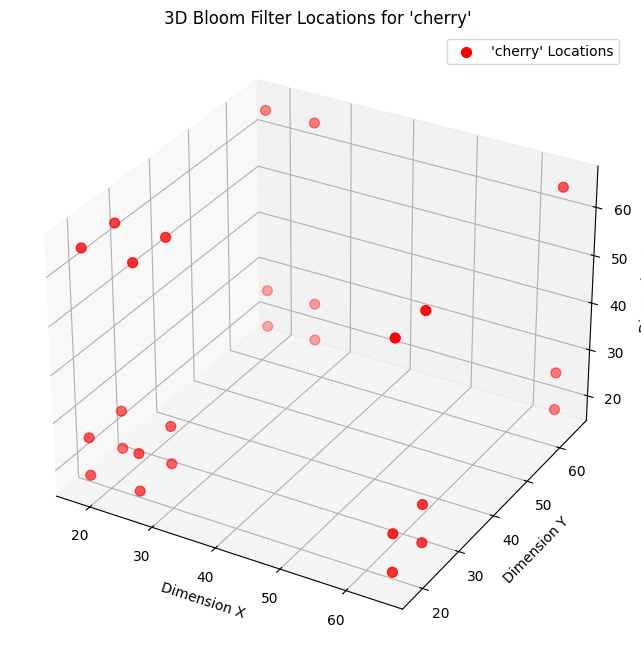

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Choose an item to visualize
item_to_visualize = "cherry"

# Create a new 3D scatter plot for the specific item
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Lists to store the coordinates for the chosen item
item_x_coords = []
item_y_coords = []
item_z_coords = []

# Calculate and collect the 3D coordinates for the chosen item
for hash_func_i in bloom_filter.hash_funcs:
    for hash_func_j in bloom_filter.hash_funcs:
        for hash_func_k in bloom_filter.hash_funcs:
            hash_val_i = bloom_filter._hash_value(item_to_visualize, hash_func_i) % bloom_filter.size[0]
            hash_val_j = bloom_filter._hash_value(item_to_visualize, hash_func_j) % bloom_filter.size[1]
            hash_val_k = bloom_filter._hash_value(item_to_visualize, hash_func_k) % bloom_filter.size[2]
            item_x_coords.append(hash_val_i)
            item_y_coords.append(hash_val_j)
            item_z_coords.append(hash_val_k)

# Plot the specific locations for the chosen item
ax.scatter(item_x_coords, item_y_coords, item_z_coords, s=50, c='red', marker='o', label=f"'{item_to_visualize}' Locations")

# Label the axes
ax.set_xlabel('Dimension X')
ax.set_ylabel('Dimension Y')
ax.set_zlabel('Dimension Z')

# Add a title
ax.set_title(f"3D Bloom Filter Locations for '{item_to_visualize}'")

# Add a legend
ax.legend()

# Display the plot
plt.show()

## Compare item locations

### Subtask:
Visualize the locations of multiple items to observe potential overlaps and collisions.


**Reasoning**:
Create a 3D scatter plot and visualize the locations of multiple items using different colors and markers, adding a legend and axis labels.



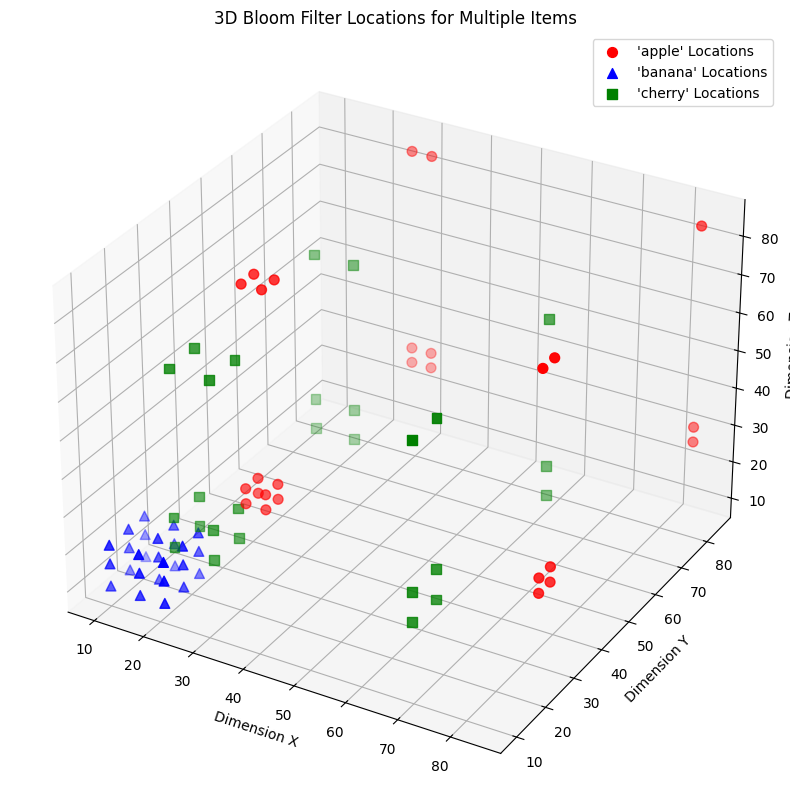

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create a new 3D scatter plot figure and add a 3D subplot.
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Define a list of items to visualize
items_to_visualize = ["apple", "banana", "cherry"]
colors = ['red', 'blue', 'green'] # Define colors for each item
markers = ['o', '^', 's'] # Define markers for each item

# For each item in the list, calculate and plot the 3D hash coordinates
for i, item in enumerate(items_to_visualize):
    item_x_coords = []
    item_y_coords = []
    item_z_coords = []

    for hash_func_i in bloom_filter.hash_funcs:
        for hash_func_j in bloom_filter.hash_funcs:
            for hash_func_k in bloom_filter.hash_funcs:
                hash_val_i = bloom_filter._hash_value(item, hash_func_i) % bloom_filter.size[0]
                hash_val_j = bloom_filter._hash_value(item, hash_func_j) % bloom_filter.size[1]
                hash_val_k = bloom_filter._hash_value(item, hash_func_k) % bloom_filter.size[2]
                item_x_coords.append(hash_val_i)
                item_y_coords.append(hash_val_j)
                item_z_coords.append(hash_val_k)

    # Plot the coordinates for each item
    ax.scatter(item_x_coords, item_y_coords, item_z_coords, s=50, c=colors[i], marker=markers[i], label=f"'{item}' Locations")

# Set appropriate labels for the x, y, and z axes
ax.set_xlabel('Dimension X')
ax.set_ylabel('Dimension Y')
ax.set_zlabel('Dimension Z')

# Add a title to the plot
ax.set_title('3D Bloom Filter Locations for Multiple Items')

# Add a legend
ax.legend()

# Display the plot
plt.show()

## Visualize the bloom filter density

### Subtask:
Create a visualization that shows the density of set bits within different regions of the 3D filter.


**Reasoning**:
I need to create a 3D visualization of the density of set bits in the Bloom filter. This involves aggregating the set bits into grid cells and then plotting these aggregated counts. I will define a grid size, iterate through the filter to count set bits in each grid cell, and then use a 3D scatter plot with point size or color representing density.



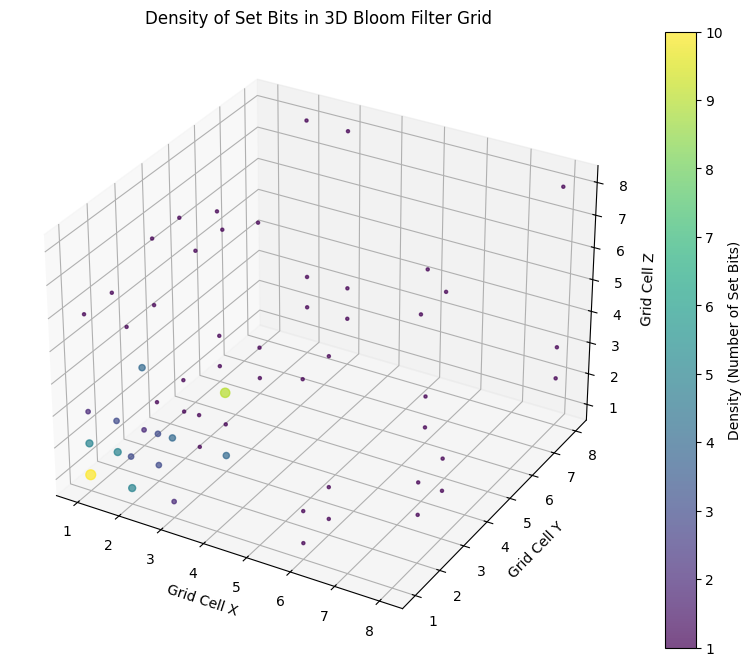

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Define a grid size for density visualization (smaller than filter size)
grid_size = (10, 10, 10)

# Create a 3D array to store density counts
density_grid = np.zeros(grid_size, dtype=int)

# Calculate the size of each grid cell
cell_size = (
    bloom_filter.size[0] // grid_size[0],
    bloom_filter.size[1] // grid_size[1],
    bloom_filter.size[2] // grid_size[2]
)

# Iterate through the Bloom filter and increment density counts
for i in range(bloom_filter.size[0]):
    for j in range(bloom_filter.size[1]):
        for k in range(bloom_filter.size[2]):
            if bloom_filter.filter[i, j, k]:
                # Determine which grid cell this set bit falls into
                grid_i = min(i // cell_size[0], grid_size[0] - 1)
                grid_j = min(j // cell_size[1], grid_size[1] - 1)
                grid_k = min(k // cell_size[2], grid_size[2] - 1)
                density_grid[grid_i, grid_j, grid_k] += 1

# Get the coordinates and densities of the grid cells with set bits
grid_x_coords, grid_y_coords, grid_z_coords = np.where(density_grid > 0)
densities = density_grid[grid_x_coords, grid_y_coords, grid_z_coords]

# Create a 3D scatter plot for density visualization
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the density using point size
scatter = ax.scatter(grid_x_coords, grid_y_coords, grid_z_coords, s=densities * 5, c=densities, cmap='viridis', alpha=0.7)

# Add a color bar to show density mapping
fig.colorbar(scatter, label='Density (Number of Set Bits)')

# Label the axes
ax.set_xlabel('Grid Cell X')
ax.set_ylabel('Grid Cell Y')
ax.set_zlabel('Grid Cell Z')

# Add a title
ax.set_title('Density of Set Bits in 3D Bloom Filter Grid')

# Display the plot
plt.show()

In [ ]:
# Define a list of items NOT in the filter to test for false positives
items_not_in_filter = ["orange", "grape", "pear", "kiwi", "mango"]

false_positives = 0
total_items_not_in_filter = len(items_not_in_filter)

print("Checking for false positives:")
for item in items_not_in_filter:
    if bloom_filter.contains(item):
        print(f"'{item}' might be in the filter (False Positive).")
        false_positives += 1
    else:
        print(f"'{item}' is definitely not in the filter (Correct).")

# Calculate the false positive rate
false_positive_rate = (false_positives / total_items_not_in_filter) * 100

print(f"\nTotal items checked (not in filter): {total_items_not_in_filter}")
print(f"False positives found: {false_positives}")
print(f"False positive rate: {false_positive_rate:.2f}%")

Checking for false positives:
Hash values generated during contains for 'orange':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,orange,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48,0
1,orange,openssl_sha256,openssl_sha256,openssl_md5,48,48,45,0
2,orange,openssl_sha256,openssl_sha256,openssl_sha1,48,48,58,0
3,orange,openssl_sha256,openssl_md5,openssl_sha256,48,45,48,0
4,orange,openssl_sha256,openssl_md5,openssl_md5,48,45,45,0
5,orange,openssl_sha256,openssl_md5,openssl_sha1,48,45,58,0
6,orange,openssl_sha256,openssl_sha1,openssl_sha256,48,58,48,0
7,orange,openssl_sha256,openssl_sha1,openssl_md5,48,58,45,0
8,orange,openssl_sha256,openssl_sha1,openssl_sha1,48,58,58,0
9,orange,openssl_md5,openssl_sha256,openssl_sha256,45,48,48,0


'orange' is definitely not in the filter (Correct).
Hash values generated during contains for 'grape':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,grape,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54,0
1,grape,openssl_sha256,openssl_sha256,openssl_md5,54,54,13,0
2,grape,openssl_sha256,openssl_sha256,openssl_sha1,54,54,71,0
3,grape,openssl_sha256,openssl_md5,openssl_sha256,54,13,54,0
4,grape,openssl_sha256,openssl_md5,openssl_md5,54,13,13,0
5,grape,openssl_sha256,openssl_md5,openssl_sha1,54,13,71,0
6,grape,openssl_sha256,openssl_sha1,openssl_sha256,54,71,54,0
7,grape,openssl_sha256,openssl_sha1,openssl_md5,54,71,13,0
8,grape,openssl_sha256,openssl_sha1,openssl_sha1,54,71,71,0
9,grape,openssl_md5,openssl_sha256,openssl_sha256,13,54,54,0


'grape' is definitely not in the filter (Correct).
Hash values generated during contains for 'pear':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,pear,openssl_sha256,openssl_sha256,openssl_sha256,46,46,46,0
1,pear,openssl_sha256,openssl_sha256,openssl_md5,46,46,35,0
2,pear,openssl_sha256,openssl_sha256,openssl_sha1,46,46,57,0
3,pear,openssl_sha256,openssl_md5,openssl_sha256,46,35,46,0
4,pear,openssl_sha256,openssl_md5,openssl_md5,46,35,35,0
5,pear,openssl_sha256,openssl_md5,openssl_sha1,46,35,57,0
6,pear,openssl_sha256,openssl_sha1,openssl_sha256,46,57,46,0
7,pear,openssl_sha256,openssl_sha1,openssl_md5,46,57,35,0
8,pear,openssl_sha256,openssl_sha1,openssl_sha1,46,57,57,0
9,pear,openssl_md5,openssl_sha256,openssl_sha256,35,46,46,0


'pear' is definitely not in the filter (Correct).
Hash values generated during contains for 'kiwi':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,kiwi,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77,0
1,kiwi,openssl_sha256,openssl_sha256,openssl_md5,77,77,0,0
2,kiwi,openssl_sha256,openssl_sha256,openssl_sha1,77,77,89,0
3,kiwi,openssl_sha256,openssl_md5,openssl_sha256,77,0,77,0
4,kiwi,openssl_sha256,openssl_md5,openssl_md5,77,0,0,0
5,kiwi,openssl_sha256,openssl_md5,openssl_sha1,77,0,89,0
6,kiwi,openssl_sha256,openssl_sha1,openssl_sha256,77,89,77,0
7,kiwi,openssl_sha256,openssl_sha1,openssl_md5,77,89,0,0
8,kiwi,openssl_sha256,openssl_sha1,openssl_sha1,77,89,89,0
9,kiwi,openssl_md5,openssl_sha256,openssl_sha256,0,77,77,0


'kiwi' is definitely not in the filter (Correct).
Hash values generated during contains for 'mango':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,mango,openssl_sha256,openssl_sha256,openssl_sha256,88,88,88,0
1,mango,openssl_sha256,openssl_sha256,openssl_md5,88,88,80,0
2,mango,openssl_sha256,openssl_sha256,openssl_sha1,88,88,98,0
3,mango,openssl_sha256,openssl_md5,openssl_sha256,88,80,88,0
4,mango,openssl_sha256,openssl_md5,openssl_md5,88,80,80,0
5,mango,openssl_sha256,openssl_md5,openssl_sha1,88,80,98,0
6,mango,openssl_sha256,openssl_sha1,openssl_sha256,88,98,88,0
7,mango,openssl_sha256,openssl_sha1,openssl_md5,88,98,80,0
8,mango,openssl_sha256,openssl_sha1,openssl_sha1,88,98,98,0
9,mango,openssl_md5,openssl_sha256,openssl_sha256,80,88,88,0


'mango' is definitely not in the filter (Correct).

Total items checked (not in filter): 5
False positives found: 0
False positive rate: 0.00%


In [ ]:
import numpy as np
import hashlib
import pandas as pd

class BloomFilter1D:
    def __init__(self, size, hash_funcs):
        self.size = size
        self.hash_funcs = hash_funcs
        self.filter = np.zeros(size, dtype=bool)
        self.hash_data = []

    def _hash_value(self, value, hash_func):
        return int(hash_func(str(value).encode('utf-8')).hexdigest(), 16)

    def add(self, item):
        self.hash_data = []
        for hash_func in self.hash_funcs:
            hash_val = self._hash_value(item, hash_func) % self.size
            self.filter[hash_val] = True
            self.hash_data.append({
                "Item": item,
                "Hash Func": hash_func.__name__,
                "Hash Value": hash_val
            })
        print(f"Hash values generated during add for '{item}':")
        display(pd.DataFrame(self.hash_data))

    def contains(self, item):
        self.hash_data = []
        is_in_filter = True
        for hash_func in self.hash_funcs:
            hash_val = self._hash_value(item, hash_func) % self.size
            self.hash_data.append({
                "Item": item,
                "Hash Func": hash_func.__name__,
                "Hash Value": hash_val,
                "Filter Value": self.filter[hash_val].astype(int)
            })
            if not self.filter[hash_val]:
                is_in_filter = False
        print(f"Hash values generated during contains for '{item}':")
        display(pd.DataFrame(self.hash_data))
        return is_in_filter

# Example usage for 1D Bloom filter:
filter_size_1d = 1000 # Define the size of the 1D Bloom filter
hash_functions_1d = [hashlib.sha256, hashlib.md5, hashlib.sha1, hashlib.sha512] # Define hash functions

# Create a 1D Bloom filter instance
bloom_filter_1d = BloomFilter1D(filter_size_1d, hash_functions_1d)

# Add items to the filter
items_to_add_1d = ["apple", "banana", "cherry", "date", "grape", "kiwi", "mango", "orange", "pear", "quince"]
for item in items_to_add_1d:
    bloom_filter_1d.add(item)

Hash values generated during add for 'apple':


,Item,Hash Func,Hash Value
0,apple,openssl_sha256,227
1,apple,openssl_md5,231
2,apple,openssl_sha1,784
3,apple,openssl_sha512,650


Hash values generated during add for 'banana':


,Item,Hash Func,Hash Value
0,banana,openssl_sha256,310
1,banana,openssl_md5,121
2,banana,openssl_sha1,416
3,banana,openssl_sha512,475


Hash values generated during add for 'cherry':


,Item,Hash Func,Hash Value
0,cherry,openssl_sha256,526
1,cherry,openssl_md5,218
2,cherry,openssl_sha1,65
3,cherry,openssl_sha512,472


Hash values generated during add for 'date':


,Item,Hash Func,Hash Value
0,date,openssl_sha256,433
1,date,openssl_md5,119
2,date,openssl_sha1,830
3,date,openssl_sha512,401


Hash values generated during add for 'grape':


,Item,Hash Func,Hash Value
0,grape,openssl_sha256,54
1,grape,openssl_md5,113
2,grape,openssl_sha1,871
3,grape,openssl_sha512,820


Hash values generated during add for 'kiwi':


,Item,Hash Func,Hash Value
0,kiwi,openssl_sha256,177
1,kiwi,openssl_md5,600
2,kiwi,openssl_sha1,889
3,kiwi,openssl_sha512,617


Hash values generated during add for 'mango':


,Item,Hash Func,Hash Value
0,mango,openssl_sha256,788
1,mango,openssl_md5,680
2,mango,openssl_sha1,998
3,mango,openssl_sha512,273


Hash values generated during add for 'orange':


,Item,Hash Func,Hash Value
0,orange,openssl_sha256,348
1,orange,openssl_md5,645
2,orange,openssl_sha1,358
3,orange,openssl_sha512,744


Hash values generated during add for 'pear':


,Item,Hash Func,Hash Value
0,pear,openssl_sha256,46
1,pear,openssl_md5,435
2,pear,openssl_sha1,957
3,pear,openssl_sha512,362


Hash values generated during add for 'quince':


,Item,Hash Func,Hash Value
0,quince,openssl_sha256,167
1,quince,openssl_md5,918
2,quince,openssl_sha1,195
3,quince,openssl_sha512,960


In [ ]:
# Define a list of items NOT in the 1D filter to test for false positives
items_not_in_filter_1d = ["zucchini", "pineapple", "strawberry", "blueberry", "raspberry"]

false_positives_1d = 0
total_items_not_in_filter_1d = len(items_not_in_filter_1d)

print("\nChecking for false positives in 1D Bloom filter:")
for item in items_not_in_filter_1d:
    if bloom_filter_1d.contains(item):
        print(f"'{item}' might be in the 1D filter (False Positive).")
        false_positives_1d += 1
    else:
        print(f"'{item}' is definitely not in the 1D filter (Correct).")

# Calculate the false positive rate for 1D Bloom filter
false_positive_rate_1d = (false_positives_1d / total_items_not_in_filter_1d) * 100

print(f"\nTotal items checked (not in 1D filter): {total_items_not_in_filter_1d}")
print(f"False positives found in 1D filter: {false_positives_1d}")
print(f"False positive rate for 1D filter: {false_positive_rate_1d:.2f}%")


Checking for false positives in 1D Bloom filter:
Hash values generated during contains for 'zucchini':


,Item,Hash Func,Hash Value,Filter Value
0,zucchini,openssl_sha256,483,0
1,zucchini,openssl_md5,737,0
2,zucchini,openssl_sha1,155,0
3,zucchini,openssl_sha512,211,0


'zucchini' is definitely not in the 1D filter (Correct).
Hash values generated during contains for 'pineapple':


,Item,Hash Func,Hash Value,Filter Value
0,pineapple,openssl_sha256,740,0
1,pineapple,openssl_md5,491,0
2,pineapple,openssl_sha1,623,0
3,pineapple,openssl_sha512,444,0


'pineapple' is definitely not in the 1D filter (Correct).
Hash values generated during contains for 'strawberry':


,Item,Hash Func,Hash Value,Filter Value
0,strawberry,openssl_sha256,594,0
1,strawberry,openssl_md5,441,0
2,strawberry,openssl_sha1,915,0
3,strawberry,openssl_sha512,696,0


'strawberry' is definitely not in the 1D filter (Correct).
Hash values generated during contains for 'blueberry':


,Item,Hash Func,Hash Value,Filter Value
0,blueberry,openssl_sha256,124,0
1,blueberry,openssl_md5,92,0
2,blueberry,openssl_sha1,346,0
3,blueberry,openssl_sha512,560,0


'blueberry' is definitely not in the 1D filter (Correct).
Hash values generated during contains for 'raspberry':


,Item,Hash Func,Hash Value,Filter Value
0,raspberry,openssl_sha256,939,0
1,raspberry,openssl_md5,922,0
2,raspberry,openssl_sha1,359,0
3,raspberry,openssl_sha512,862,0


'raspberry' is definitely not in the 1D filter (Correct).

Total items checked (not in 1D filter): 5
False positives found in 1D filter: 0
False positive rate for 1D filter: 0.00%


In [ ]:
#compare 1D and 3D Bloom filter performance:
#Compare the false positive rates and memory usage of the 1D and 3D Bloom filters with similar capacities and numbers of hash functions.

In [76]:
import random
import string

def generate_registration_numbers(num_records, length):
    """Generates a list of unique alphanumeric registration numbers."""
    registration_numbers = set()
    characters = string.ascii_uppercase + string.digits  # Uppercase letters and digits

    while len(registration_numbers) < num_records:
        # Generate a random 7-character alphanumeric string
        reg_number = ''.join(random.choice(characters) for _ in range(length))
        registration_numbers.add(reg_number)

    return list(registration_numbers)

# Generate 1000 unique 7-alphanumeric registration numbers
num_records = 1000
reg_number_length = 7
college_reg_numbers = generate_registration_numbers(num_records, reg_number_length)

print(f"Generated {len(college_reg_numbers)} unique registration numbers.")
# Display the first 10 registration numbers as a sample
print("Sample registration numbers:")
for i in range(min(10, len(college_reg_numbers))):
    print(college_reg_numbers[i])

Generated 1000 unique registration numbers.
Sample registration numbers:
S7EQPL2
G7H8041
0K2HW1C
Z342WMD
7GHZT0H
6YV6XQC
F1U4BV9
9FJQRGL
2K7C3Y6
16A2SZC


In [ ]:
# Step 2: Add a subset of registration numbers to Bloom filters

# Determine the number of registration numbers to add to the filters
num_to_add = int(num_records * 0.5)  # Add 50% of the registration numbers

# Select a subset of registration numbers to add
reg_numbers_to_add = college_reg_numbers[:num_to_add]
reg_numbers_to_check = college_reg_numbers[num_to_add:]

print(f"Adding {len(reg_numbers_to_add)} registration numbers to the Bloom filters.")

# Add registration numbers to the 1D Bloom filter
for reg_num in reg_numbers_to_add:
    bloom_filter_1d.add(reg_num)

# Add registration numbers to the 3D Bloom filter
for reg_num in reg_numbers_to_add:
    bloom_filter.add(reg_num)

print("Finished adding registration numbers to both filters.")
print(f"\n{len(reg_numbers_to_check)} registration numbers will be used to check for false positives.")

Adding 500 registration numbers to the Bloom filters.
Hash values generated during add for 'MCZN767':


,Item,Hash Func,Hash Value
0,MCZN767,openssl_sha256,830
1,MCZN767,openssl_md5,901
2,MCZN767,openssl_sha1,998
3,MCZN767,openssl_sha512,172


Hash values generated during add for 'UW7SWOL':


,Item,Hash Func,Hash Value
0,UW7SWOL,openssl_sha256,95
1,UW7SWOL,openssl_md5,405
2,UW7SWOL,openssl_sha1,874
3,UW7SWOL,openssl_sha512,401


Hash values generated during add for 'H52IQ9V':


,Item,Hash Func,Hash Value
0,H52IQ9V,openssl_sha256,852
1,H52IQ9V,openssl_md5,587
2,H52IQ9V,openssl_sha1,535
3,H52IQ9V,openssl_sha512,925


Hash values generated during add for 'G4ABLWU':


,Item,Hash Func,Hash Value
0,G4ABLWU,openssl_sha256,65
1,G4ABLWU,openssl_md5,648
2,G4ABLWU,openssl_sha1,688
3,G4ABLWU,openssl_sha512,625


Hash values generated during add for 'VWASLLD':


,Item,Hash Func,Hash Value
0,VWASLLD,openssl_sha256,525
1,VWASLLD,openssl_md5,785
2,VWASLLD,openssl_sha1,796
3,VWASLLD,openssl_sha512,109


Hash values generated during add for 'DVLR8C5':


,Item,Hash Func,Hash Value
0,DVLR8C5,openssl_sha256,221
1,DVLR8C5,openssl_md5,558
2,DVLR8C5,openssl_sha1,851
3,DVLR8C5,openssl_sha512,927


Hash values generated during add for '5A8Y3OH':


,Item,Hash Func,Hash Value
0,5A8Y3OH,openssl_sha256,998
1,5A8Y3OH,openssl_md5,313
2,5A8Y3OH,openssl_sha1,911
3,5A8Y3OH,openssl_sha512,719


Hash values generated during add for 'C0KKPIG':


,Item,Hash Func,Hash Value
0,C0KKPIG,openssl_sha256,462
1,C0KKPIG,openssl_md5,89
2,C0KKPIG,openssl_sha1,280
3,C0KKPIG,openssl_sha512,183


Hash values generated during add for 'S37HGEH':


,Item,Hash Func,Hash Value
0,S37HGEH,openssl_sha256,949
1,S37HGEH,openssl_md5,401
2,S37HGEH,openssl_sha1,267
3,S37HGEH,openssl_sha512,621


Hash values generated during add for 'VB1KOL4':


,Item,Hash Func,Hash Value
0,VB1KOL4,openssl_sha256,853
1,VB1KOL4,openssl_md5,667
2,VB1KOL4,openssl_sha1,854
3,VB1KOL4,openssl_sha512,532


Hash values generated during add for 'WRANNH0':


,Item,Hash Func,Hash Value
0,WRANNH0,openssl_sha256,588
1,WRANNH0,openssl_md5,306
2,WRANNH0,openssl_sha1,693
3,WRANNH0,openssl_sha512,660


Hash values generated during add for '6X5W1C0':


,Item,Hash Func,Hash Value
0,6X5W1C0,openssl_sha256,658
1,6X5W1C0,openssl_md5,660
2,6X5W1C0,openssl_sha1,569
3,6X5W1C0,openssl_sha512,717


Hash values generated during add for 'FJQQ128':


,Item,Hash Func,Hash Value
0,FJQQ128,openssl_sha256,467
1,FJQQ128,openssl_md5,655
2,FJQQ128,openssl_sha1,274
3,FJQQ128,openssl_sha512,404


Hash values generated during add for '4QO9B56':


,Item,Hash Func,Hash Value
0,4QO9B56,openssl_sha256,184
1,4QO9B56,openssl_md5,4
2,4QO9B56,openssl_sha1,731
3,4QO9B56,openssl_sha512,860


Hash values generated during add for '9HHSINI':


,Item,Hash Func,Hash Value
0,9HHSINI,openssl_sha256,612
1,9HHSINI,openssl_md5,345
2,9HHSINI,openssl_sha1,286
3,9HHSINI,openssl_sha512,220


Hash values generated during add for '6ZNCFMU':


,Item,Hash Func,Hash Value
0,6ZNCFMU,openssl_sha256,988
1,6ZNCFMU,openssl_md5,904
2,6ZNCFMU,openssl_sha1,926
3,6ZNCFMU,openssl_sha512,45


Hash values generated during add for 'ADL1N6S':


,Item,Hash Func,Hash Value
0,ADL1N6S,openssl_sha256,610
1,ADL1N6S,openssl_md5,54
2,ADL1N6S,openssl_sha1,899
3,ADL1N6S,openssl_sha512,849


Hash values generated during add for '39LOUD1':


,Item,Hash Func,Hash Value
0,39LOUD1,openssl_sha256,207
1,39LOUD1,openssl_md5,142
2,39LOUD1,openssl_sha1,641
3,39LOUD1,openssl_sha512,0


Hash values generated during add for 'F63LS3O':


,Item,Hash Func,Hash Value
0,F63LS3O,openssl_sha256,389
1,F63LS3O,openssl_md5,921
2,F63LS3O,openssl_sha1,343
3,F63LS3O,openssl_sha512,391


Hash values generated during add for 'HNI5H9J':


,Item,Hash Func,Hash Value
0,HNI5H9J,openssl_sha256,480
1,HNI5H9J,openssl_md5,413
2,HNI5H9J,openssl_sha1,549
3,HNI5H9J,openssl_sha512,535


Hash values generated during add for '761ENTL':


,Item,Hash Func,Hash Value
0,761ENTL,openssl_sha256,416
1,761ENTL,openssl_md5,490
2,761ENTL,openssl_sha1,765
3,761ENTL,openssl_sha512,945


Hash values generated during add for 'ZANHL43':


,Item,Hash Func,Hash Value
0,ZANHL43,openssl_sha256,250
1,ZANHL43,openssl_md5,436
2,ZANHL43,openssl_sha1,57
3,ZANHL43,openssl_sha512,648


Hash values generated during add for 'ESMS7P1':


,Item,Hash Func,Hash Value
0,ESMS7P1,openssl_sha256,862
1,ESMS7P1,openssl_md5,23
2,ESMS7P1,openssl_sha1,806
3,ESMS7P1,openssl_sha512,308


Hash values generated during add for 'VY3OXZU':


,Item,Hash Func,Hash Value
0,VY3OXZU,openssl_sha256,485
1,VY3OXZU,openssl_md5,934
2,VY3OXZU,openssl_sha1,580
3,VY3OXZU,openssl_sha512,729


Hash values generated during add for '0OVW4JT':


,Item,Hash Func,Hash Value
0,0OVW4JT,openssl_sha256,252
1,0OVW4JT,openssl_md5,36
2,0OVW4JT,openssl_sha1,155
3,0OVW4JT,openssl_sha512,132


Hash values generated during add for '37ORIEH':


,Item,Hash Func,Hash Value
0,37ORIEH,openssl_sha256,178
1,37ORIEH,openssl_md5,183
2,37ORIEH,openssl_sha1,159
3,37ORIEH,openssl_sha512,358


Hash values generated during add for 'WSPOTR3':


,Item,Hash Func,Hash Value
0,WSPOTR3,openssl_sha256,186
1,WSPOTR3,openssl_md5,388
2,WSPOTR3,openssl_sha1,740
3,WSPOTR3,openssl_sha512,377


Hash values generated during add for 'R87N0RH':


,Item,Hash Func,Hash Value
0,R87N0RH,openssl_sha256,247
1,R87N0RH,openssl_md5,871
2,R87N0RH,openssl_sha1,709
3,R87N0RH,openssl_sha512,646


Hash values generated during add for 'BO07LIP':


,Item,Hash Func,Hash Value
0,BO07LIP,openssl_sha256,772
1,BO07LIP,openssl_md5,32
2,BO07LIP,openssl_sha1,332
3,BO07LIP,openssl_sha512,365


Hash values generated during add for '66U29KQ':


,Item,Hash Func,Hash Value
0,66U29KQ,openssl_sha256,323
1,66U29KQ,openssl_md5,33
2,66U29KQ,openssl_sha1,320
3,66U29KQ,openssl_sha512,709


Hash values generated during add for '9LAQVP5':


,Item,Hash Func,Hash Value
0,9LAQVP5,openssl_sha256,597
1,9LAQVP5,openssl_md5,790
2,9LAQVP5,openssl_sha1,397
3,9LAQVP5,openssl_sha512,373


Hash values generated during add for '1RX0C7T':


,Item,Hash Func,Hash Value
0,1RX0C7T,openssl_sha256,268
1,1RX0C7T,openssl_md5,485
2,1RX0C7T,openssl_sha1,510
3,1RX0C7T,openssl_sha512,925


Hash values generated during add for 'TLY0DYP':


,Item,Hash Func,Hash Value
0,TLY0DYP,openssl_sha256,148
1,TLY0DYP,openssl_md5,964
2,TLY0DYP,openssl_sha1,715
3,TLY0DYP,openssl_sha512,541


Hash values generated during add for 'QNTEC9A':


,Item,Hash Func,Hash Value
0,QNTEC9A,openssl_sha256,471
1,QNTEC9A,openssl_md5,444
2,QNTEC9A,openssl_sha1,909
3,QNTEC9A,openssl_sha512,376


Hash values generated during add for '3MBR75S':


,Item,Hash Func,Hash Value
0,3MBR75S,openssl_sha256,313
1,3MBR75S,openssl_md5,453
2,3MBR75S,openssl_sha1,686
3,3MBR75S,openssl_sha512,561


Hash values generated during add for 'R2L8U7B':


,Item,Hash Func,Hash Value
0,R2L8U7B,openssl_sha256,227
1,R2L8U7B,openssl_md5,345
2,R2L8U7B,openssl_sha1,795
3,R2L8U7B,openssl_sha512,988


Hash values generated during add for 'GRTIPVT':


,Item,Hash Func,Hash Value
0,GRTIPVT,openssl_sha256,750
1,GRTIPVT,openssl_md5,38
2,GRTIPVT,openssl_sha1,808
3,GRTIPVT,openssl_sha512,230


Hash values generated during add for '52REU73':


,Item,Hash Func,Hash Value
0,52REU73,openssl_sha256,93
1,52REU73,openssl_md5,885
2,52REU73,openssl_sha1,632
3,52REU73,openssl_sha512,883


Hash values generated during add for 'SQNJEUN':


,Item,Hash Func,Hash Value
0,SQNJEUN,openssl_sha256,588
1,SQNJEUN,openssl_md5,327
2,SQNJEUN,openssl_sha1,87
3,SQNJEUN,openssl_sha512,253


Hash values generated during add for 'K9VHXFZ':


,Item,Hash Func,Hash Value
0,K9VHXFZ,openssl_sha256,386
1,K9VHXFZ,openssl_md5,794
2,K9VHXFZ,openssl_sha1,247
3,K9VHXFZ,openssl_sha512,277


Hash values generated during add for 'I3E81SZ':


,Item,Hash Func,Hash Value
0,I3E81SZ,openssl_sha256,775
1,I3E81SZ,openssl_md5,77
2,I3E81SZ,openssl_sha1,202
3,I3E81SZ,openssl_sha512,732


Hash values generated during add for 'S0BSL5N':


,Item,Hash Func,Hash Value
0,S0BSL5N,openssl_sha256,789
1,S0BSL5N,openssl_md5,422
2,S0BSL5N,openssl_sha1,624
3,S0BSL5N,openssl_sha512,958


Hash values generated during add for '1O74II5':


,Item,Hash Func,Hash Value
0,1O74II5,openssl_sha256,439
1,1O74II5,openssl_md5,86
2,1O74II5,openssl_sha1,796
3,1O74II5,openssl_sha512,98


Hash values generated during add for '4G71D3S':


,Item,Hash Func,Hash Value
0,4G71D3S,openssl_sha256,528
1,4G71D3S,openssl_md5,877
2,4G71D3S,openssl_sha1,62
3,4G71D3S,openssl_sha512,39


Hash values generated during add for 'YMD5SHP':


,Item,Hash Func,Hash Value
0,YMD5SHP,openssl_sha256,73
1,YMD5SHP,openssl_md5,425
2,YMD5SHP,openssl_sha1,706
3,YMD5SHP,openssl_sha512,381


Hash values generated during add for 'MLUIDJ3':


,Item,Hash Func,Hash Value
0,MLUIDJ3,openssl_sha256,931
1,MLUIDJ3,openssl_md5,473
2,MLUIDJ3,openssl_sha1,775
3,MLUIDJ3,openssl_sha512,992


Hash values generated during add for 'X34UVA6':


,Item,Hash Func,Hash Value
0,X34UVA6,openssl_sha256,713
1,X34UVA6,openssl_md5,689
2,X34UVA6,openssl_sha1,102
3,X34UVA6,openssl_sha512,735


Hash values generated during add for 'O1I644W':


,Item,Hash Func,Hash Value
0,O1I644W,openssl_sha256,778
1,O1I644W,openssl_md5,169
2,O1I644W,openssl_sha1,611
3,O1I644W,openssl_sha512,775


Hash values generated during add for '3C1RBUD':


,Item,Hash Func,Hash Value
0,3C1RBUD,openssl_sha256,468
1,3C1RBUD,openssl_md5,816
2,3C1RBUD,openssl_sha1,451
3,3C1RBUD,openssl_sha512,774


Hash values generated during add for 'LUOA3EF':


,Item,Hash Func,Hash Value
0,LUOA3EF,openssl_sha256,487
1,LUOA3EF,openssl_md5,608
2,LUOA3EF,openssl_sha1,166
3,LUOA3EF,openssl_sha512,620


Hash values generated during add for 'UJFIST7':


,Item,Hash Func,Hash Value
0,UJFIST7,openssl_sha256,729
1,UJFIST7,openssl_md5,572
2,UJFIST7,openssl_sha1,199
3,UJFIST7,openssl_sha512,162


Hash values generated during add for '7V92SN8':


,Item,Hash Func,Hash Value
0,7V92SN8,openssl_sha256,414
1,7V92SN8,openssl_md5,47
2,7V92SN8,openssl_sha1,194
3,7V92SN8,openssl_sha512,294


Hash values generated during add for '7QHZVZZ':


,Item,Hash Func,Hash Value
0,7QHZVZZ,openssl_sha256,974
1,7QHZVZZ,openssl_md5,854
2,7QHZVZZ,openssl_sha1,531
3,7QHZVZZ,openssl_sha512,717


Hash values generated during add for 'F8J655I':


,Item,Hash Func,Hash Value
0,F8J655I,openssl_sha256,725
1,F8J655I,openssl_md5,924
2,F8J655I,openssl_sha1,980
3,F8J655I,openssl_sha512,5


Hash values generated during add for 'EF09P7I':


,Item,Hash Func,Hash Value
0,EF09P7I,openssl_sha256,368
1,EF09P7I,openssl_md5,277
2,EF09P7I,openssl_sha1,12
3,EF09P7I,openssl_sha512,91


Hash values generated during add for '5COKR92':


,Item,Hash Func,Hash Value
0,5COKR92,openssl_sha256,6
1,5COKR92,openssl_md5,762
2,5COKR92,openssl_sha1,394
3,5COKR92,openssl_sha512,724


Hash values generated during add for 'C8D9ZXS':


,Item,Hash Func,Hash Value
0,C8D9ZXS,openssl_sha256,319
1,C8D9ZXS,openssl_md5,494
2,C8D9ZXS,openssl_sha1,231
3,C8D9ZXS,openssl_sha512,164


Hash values generated during add for 'X0MAYLV':


,Item,Hash Func,Hash Value
0,X0MAYLV,openssl_sha256,420
1,X0MAYLV,openssl_md5,440
2,X0MAYLV,openssl_sha1,724
3,X0MAYLV,openssl_sha512,109


Hash values generated during add for 'Y0QLLZ8':


,Item,Hash Func,Hash Value
0,Y0QLLZ8,openssl_sha256,5
1,Y0QLLZ8,openssl_md5,303
2,Y0QLLZ8,openssl_sha1,99
3,Y0QLLZ8,openssl_sha512,656


Hash values generated during add for '7PKS1LU':


,Item,Hash Func,Hash Value
0,7PKS1LU,openssl_sha256,803
1,7PKS1LU,openssl_md5,810
2,7PKS1LU,openssl_sha1,609
3,7PKS1LU,openssl_sha512,649


Hash values generated during add for 'LIQ2539':


,Item,Hash Func,Hash Value
0,LIQ2539,openssl_sha256,951
1,LIQ2539,openssl_md5,589
2,LIQ2539,openssl_sha1,24
3,LIQ2539,openssl_sha512,614


Hash values generated during add for 'BKL6N1Y':


,Item,Hash Func,Hash Value
0,BKL6N1Y,openssl_sha256,528
1,BKL6N1Y,openssl_md5,99
2,BKL6N1Y,openssl_sha1,593
3,BKL6N1Y,openssl_sha512,153


Hash values generated during add for '6GMCI77':


,Item,Hash Func,Hash Value
0,6GMCI77,openssl_sha256,448
1,6GMCI77,openssl_md5,688
2,6GMCI77,openssl_sha1,446
3,6GMCI77,openssl_sha512,992


Hash values generated during add for '1SHVTZZ':


,Item,Hash Func,Hash Value
0,1SHVTZZ,openssl_sha256,733
1,1SHVTZZ,openssl_md5,59
2,1SHVTZZ,openssl_sha1,297
3,1SHVTZZ,openssl_sha512,280


Hash values generated during add for '3PC1E65':


,Item,Hash Func,Hash Value
0,3PC1E65,openssl_sha256,981
1,3PC1E65,openssl_md5,193
2,3PC1E65,openssl_sha1,876
3,3PC1E65,openssl_sha512,624


Hash values generated during add for 'I2HNUKW':


,Item,Hash Func,Hash Value
0,I2HNUKW,openssl_sha256,309
1,I2HNUKW,openssl_md5,496
2,I2HNUKW,openssl_sha1,715
3,I2HNUKW,openssl_sha512,847


Hash values generated during add for 'NYJJHNA':


,Item,Hash Func,Hash Value
0,NYJJHNA,openssl_sha256,750
1,NYJJHNA,openssl_md5,236
2,NYJJHNA,openssl_sha1,21
3,NYJJHNA,openssl_sha512,670


Hash values generated during add for 'JKGB4ZL':


,Item,Hash Func,Hash Value
0,JKGB4ZL,openssl_sha256,876
1,JKGB4ZL,openssl_md5,139
2,JKGB4ZL,openssl_sha1,379
3,JKGB4ZL,openssl_sha512,946


Hash values generated during add for '41KSCVJ':


,Item,Hash Func,Hash Value
0,41KSCVJ,openssl_sha256,570
1,41KSCVJ,openssl_md5,175
2,41KSCVJ,openssl_sha1,820
3,41KSCVJ,openssl_sha512,167


Hash values generated during add for '544COOB':


,Item,Hash Func,Hash Value
0,544COOB,openssl_sha256,81
1,544COOB,openssl_md5,247
2,544COOB,openssl_sha1,978
3,544COOB,openssl_sha512,121


Hash values generated during add for 'D5SL9K1':


,Item,Hash Func,Hash Value
0,D5SL9K1,openssl_sha256,763
1,D5SL9K1,openssl_md5,95
2,D5SL9K1,openssl_sha1,322
3,D5SL9K1,openssl_sha512,843


Hash values generated during add for 'JR505F0':


,Item,Hash Func,Hash Value
0,JR505F0,openssl_sha256,752
1,JR505F0,openssl_md5,358
2,JR505F0,openssl_sha1,901
3,JR505F0,openssl_sha512,87


Hash values generated during add for 'D2Q3T4N':


,Item,Hash Func,Hash Value
0,D2Q3T4N,openssl_sha256,297
1,D2Q3T4N,openssl_md5,769
2,D2Q3T4N,openssl_sha1,0
3,D2Q3T4N,openssl_sha512,90


Hash values generated during add for '6YWUGBB':


,Item,Hash Func,Hash Value
0,6YWUGBB,openssl_sha256,732
1,6YWUGBB,openssl_md5,690
2,6YWUGBB,openssl_sha1,226
3,6YWUGBB,openssl_sha512,565


Hash values generated during add for 'SWLR57V':


,Item,Hash Func,Hash Value
0,SWLR57V,openssl_sha256,131
1,SWLR57V,openssl_md5,740
2,SWLR57V,openssl_sha1,503
3,SWLR57V,openssl_sha512,794


Hash values generated during add for 'B647UM1':


,Item,Hash Func,Hash Value
0,B647UM1,openssl_sha256,180
1,B647UM1,openssl_md5,207
2,B647UM1,openssl_sha1,851
3,B647UM1,openssl_sha512,484


Hash values generated during add for 'G06R6OS':


,Item,Hash Func,Hash Value
0,G06R6OS,openssl_sha256,663
1,G06R6OS,openssl_md5,930
2,G06R6OS,openssl_sha1,156
3,G06R6OS,openssl_sha512,220


Hash values generated during add for '0VRNK66':


,Item,Hash Func,Hash Value
0,0VRNK66,openssl_sha256,219
1,0VRNK66,openssl_md5,397
2,0VRNK66,openssl_sha1,746
3,0VRNK66,openssl_sha512,668


Hash values generated during add for 'TXV2IQR':


,Item,Hash Func,Hash Value
0,TXV2IQR,openssl_sha256,258
1,TXV2IQR,openssl_md5,590
2,TXV2IQR,openssl_sha1,683
3,TXV2IQR,openssl_sha512,634


Hash values generated during add for 'UQ4KLI1':


,Item,Hash Func,Hash Value
0,UQ4KLI1,openssl_sha256,846
1,UQ4KLI1,openssl_md5,473
2,UQ4KLI1,openssl_sha1,995
3,UQ4KLI1,openssl_sha512,667


Hash values generated during add for 'I9IO9DD':


,Item,Hash Func,Hash Value
0,I9IO9DD,openssl_sha256,846
1,I9IO9DD,openssl_md5,354
2,I9IO9DD,openssl_sha1,76
3,I9IO9DD,openssl_sha512,836


Hash values generated during add for '1OC2DCS':


,Item,Hash Func,Hash Value
0,1OC2DCS,openssl_sha256,703
1,1OC2DCS,openssl_md5,884
2,1OC2DCS,openssl_sha1,929
3,1OC2DCS,openssl_sha512,818


Hash values generated during add for 'L0684YN':


,Item,Hash Func,Hash Value
0,L0684YN,openssl_sha256,87
1,L0684YN,openssl_md5,242
2,L0684YN,openssl_sha1,478
3,L0684YN,openssl_sha512,574


Hash values generated during add for 'XBMLPQT':


,Item,Hash Func,Hash Value
0,XBMLPQT,openssl_sha256,656
1,XBMLPQT,openssl_md5,454
2,XBMLPQT,openssl_sha1,694
3,XBMLPQT,openssl_sha512,731


Hash values generated during add for 'JOZZ9BZ':


,Item,Hash Func,Hash Value
0,JOZZ9BZ,openssl_sha256,296
1,JOZZ9BZ,openssl_md5,126
2,JOZZ9BZ,openssl_sha1,95
3,JOZZ9BZ,openssl_sha512,686


Hash values generated during add for 'W9K0EQV':


,Item,Hash Func,Hash Value
0,W9K0EQV,openssl_sha256,97
1,W9K0EQV,openssl_md5,223
2,W9K0EQV,openssl_sha1,149
3,W9K0EQV,openssl_sha512,993


Hash values generated during add for 'UT2PHTC':


,Item,Hash Func,Hash Value
0,UT2PHTC,openssl_sha256,811
1,UT2PHTC,openssl_md5,904
2,UT2PHTC,openssl_sha1,885
3,UT2PHTC,openssl_sha512,958


Hash values generated during add for '08ZAWMY':


,Item,Hash Func,Hash Value
0,08ZAWMY,openssl_sha256,429
1,08ZAWMY,openssl_md5,723
2,08ZAWMY,openssl_sha1,599
3,08ZAWMY,openssl_sha512,295


Hash values generated during add for '7VWE4BG':


,Item,Hash Func,Hash Value
0,7VWE4BG,openssl_sha256,270
1,7VWE4BG,openssl_md5,690
2,7VWE4BG,openssl_sha1,939
3,7VWE4BG,openssl_sha512,368


Hash values generated during add for 'BQIXMLO':


,Item,Hash Func,Hash Value
0,BQIXMLO,openssl_sha256,174
1,BQIXMLO,openssl_md5,811
2,BQIXMLO,openssl_sha1,837
3,BQIXMLO,openssl_sha512,456


Hash values generated during add for 'JGQT613':


,Item,Hash Func,Hash Value
0,JGQT613,openssl_sha256,14
1,JGQT613,openssl_md5,783
2,JGQT613,openssl_sha1,219
3,JGQT613,openssl_sha512,965


Hash values generated during add for 'K07BM3M':


,Item,Hash Func,Hash Value
0,K07BM3M,openssl_sha256,611
1,K07BM3M,openssl_md5,72
2,K07BM3M,openssl_sha1,718
3,K07BM3M,openssl_sha512,570


Hash values generated during add for '4VCW30I':


,Item,Hash Func,Hash Value
0,4VCW30I,openssl_sha256,309
1,4VCW30I,openssl_md5,103
2,4VCW30I,openssl_sha1,12
3,4VCW30I,openssl_sha512,279


Hash values generated during add for 'KYZQYNA':


,Item,Hash Func,Hash Value
0,KYZQYNA,openssl_sha256,463
1,KYZQYNA,openssl_md5,96
2,KYZQYNA,openssl_sha1,421
3,KYZQYNA,openssl_sha512,435


Hash values generated during add for 'TS8BFHL':


,Item,Hash Func,Hash Value
0,TS8BFHL,openssl_sha256,730
1,TS8BFHL,openssl_md5,446
2,TS8BFHL,openssl_sha1,482
3,TS8BFHL,openssl_sha512,534


Hash values generated during add for 'M7U3QMR':


,Item,Hash Func,Hash Value
0,M7U3QMR,openssl_sha256,798
1,M7U3QMR,openssl_md5,704
2,M7U3QMR,openssl_sha1,804
3,M7U3QMR,openssl_sha512,639


Hash values generated during add for 'W3I1MIG':


,Item,Hash Func,Hash Value
0,W3I1MIG,openssl_sha256,87
1,W3I1MIG,openssl_md5,81
2,W3I1MIG,openssl_sha1,371
3,W3I1MIG,openssl_sha512,753


Hash values generated during add for 'L59BO8E':


,Item,Hash Func,Hash Value
0,L59BO8E,openssl_sha256,222
1,L59BO8E,openssl_md5,122
2,L59BO8E,openssl_sha1,489
3,L59BO8E,openssl_sha512,36


Hash values generated during add for 'Z3MMFD0':


,Item,Hash Func,Hash Value
0,Z3MMFD0,openssl_sha256,216
1,Z3MMFD0,openssl_md5,131
2,Z3MMFD0,openssl_sha1,712
3,Z3MMFD0,openssl_sha512,204


Hash values generated during add for 'HQ6VQAQ':


,Item,Hash Func,Hash Value
0,HQ6VQAQ,openssl_sha256,863
1,HQ6VQAQ,openssl_md5,209
2,HQ6VQAQ,openssl_sha1,310
3,HQ6VQAQ,openssl_sha512,735


Hash values generated during add for 'FN9HKHJ':


,Item,Hash Func,Hash Value
0,FN9HKHJ,openssl_sha256,71
1,FN9HKHJ,openssl_md5,18
2,FN9HKHJ,openssl_sha1,644
3,FN9HKHJ,openssl_sha512,374


Hash values generated during add for 'WMCGZ7L':


,Item,Hash Func,Hash Value
0,WMCGZ7L,openssl_sha256,327
1,WMCGZ7L,openssl_md5,199
2,WMCGZ7L,openssl_sha1,628
3,WMCGZ7L,openssl_sha512,902


Hash values generated during add for '7G87FMX':


,Item,Hash Func,Hash Value
0,7G87FMX,openssl_sha256,162
1,7G87FMX,openssl_md5,929
2,7G87FMX,openssl_sha1,816
3,7G87FMX,openssl_sha512,634


Hash values generated during add for 'I9Z2QWT':


,Item,Hash Func,Hash Value
0,I9Z2QWT,openssl_sha256,598
1,I9Z2QWT,openssl_md5,560
2,I9Z2QWT,openssl_sha1,411
3,I9Z2QWT,openssl_sha512,341


Hash values generated during add for 'P9VMF7I':


,Item,Hash Func,Hash Value
0,P9VMF7I,openssl_sha256,637
1,P9VMF7I,openssl_md5,818
2,P9VMF7I,openssl_sha1,9
3,P9VMF7I,openssl_sha512,778


Hash values generated during add for 'Z04OBS6':


,Item,Hash Func,Hash Value
0,Z04OBS6,openssl_sha256,109
1,Z04OBS6,openssl_md5,570
2,Z04OBS6,openssl_sha1,780
3,Z04OBS6,openssl_sha512,308


Hash values generated during add for 'S39OHJM':


,Item,Hash Func,Hash Value
0,S39OHJM,openssl_sha256,635
1,S39OHJM,openssl_md5,268
2,S39OHJM,openssl_sha1,698
3,S39OHJM,openssl_sha512,716


Hash values generated during add for 'VFM3EGT':


,Item,Hash Func,Hash Value
0,VFM3EGT,openssl_sha256,313
1,VFM3EGT,openssl_md5,279
2,VFM3EGT,openssl_sha1,999
3,VFM3EGT,openssl_sha512,582


Hash values generated during add for 'FFCOG42':


,Item,Hash Func,Hash Value
0,FFCOG42,openssl_sha256,685
1,FFCOG42,openssl_md5,126
2,FFCOG42,openssl_sha1,347
3,FFCOG42,openssl_sha512,625


Hash values generated during add for 'NY5L00B':


,Item,Hash Func,Hash Value
0,NY5L00B,openssl_sha256,822
1,NY5L00B,openssl_md5,437
2,NY5L00B,openssl_sha1,194
3,NY5L00B,openssl_sha512,192


Hash values generated during add for 'LIF3SEO':


,Item,Hash Func,Hash Value
0,LIF3SEO,openssl_sha256,594
1,LIF3SEO,openssl_md5,774
2,LIF3SEO,openssl_sha1,103
3,LIF3SEO,openssl_sha512,804


Hash values generated during add for '0MQB1WK':


,Item,Hash Func,Hash Value
0,0MQB1WK,openssl_sha256,573
1,0MQB1WK,openssl_md5,604
2,0MQB1WK,openssl_sha1,225
3,0MQB1WK,openssl_sha512,276


Hash values generated during add for '378CTT2':


,Item,Hash Func,Hash Value
0,378CTT2,openssl_sha256,252
1,378CTT2,openssl_md5,260
2,378CTT2,openssl_sha1,331
3,378CTT2,openssl_sha512,871


Hash values generated during add for 'DPD0BHM':


,Item,Hash Func,Hash Value
0,DPD0BHM,openssl_sha256,753
1,DPD0BHM,openssl_md5,662
2,DPD0BHM,openssl_sha1,744
3,DPD0BHM,openssl_sha512,411


Hash values generated during add for '3YR9ZQK':


,Item,Hash Func,Hash Value
0,3YR9ZQK,openssl_sha256,565
1,3YR9ZQK,openssl_md5,968
2,3YR9ZQK,openssl_sha1,711
3,3YR9ZQK,openssl_sha512,785


Hash values generated during add for 'KOPAT0Y':


,Item,Hash Func,Hash Value
0,KOPAT0Y,openssl_sha256,866
1,KOPAT0Y,openssl_md5,831
2,KOPAT0Y,openssl_sha1,694
3,KOPAT0Y,openssl_sha512,649


Hash values generated during add for 'NBJVM59':


,Item,Hash Func,Hash Value
0,NBJVM59,openssl_sha256,278
1,NBJVM59,openssl_md5,154
2,NBJVM59,openssl_sha1,984
3,NBJVM59,openssl_sha512,975


Hash values generated during add for 'N8NNJVJ':


,Item,Hash Func,Hash Value
0,N8NNJVJ,openssl_sha256,91
1,N8NNJVJ,openssl_md5,680
2,N8NNJVJ,openssl_sha1,881
3,N8NNJVJ,openssl_sha512,459


Hash values generated during add for 'IPK6D1L':


,Item,Hash Func,Hash Value
0,IPK6D1L,openssl_sha256,426
1,IPK6D1L,openssl_md5,163
2,IPK6D1L,openssl_sha1,779
3,IPK6D1L,openssl_sha512,328


Hash values generated during add for '9S7PX0A':


,Item,Hash Func,Hash Value
0,9S7PX0A,openssl_sha256,215
1,9S7PX0A,openssl_md5,580
2,9S7PX0A,openssl_sha1,840
3,9S7PX0A,openssl_sha512,126


Hash values generated during add for 'XAY12AZ':


,Item,Hash Func,Hash Value
0,XAY12AZ,openssl_sha256,530
1,XAY12AZ,openssl_md5,636
2,XAY12AZ,openssl_sha1,661
3,XAY12AZ,openssl_sha512,658


Hash values generated during add for 'VBAJ96D':


,Item,Hash Func,Hash Value
0,VBAJ96D,openssl_sha256,148
1,VBAJ96D,openssl_md5,724
2,VBAJ96D,openssl_sha1,622
3,VBAJ96D,openssl_sha512,873


Hash values generated during add for 'JLRTJD2':


,Item,Hash Func,Hash Value
0,JLRTJD2,openssl_sha256,226
1,JLRTJD2,openssl_md5,633
2,JLRTJD2,openssl_sha1,854
3,JLRTJD2,openssl_sha512,431


Hash values generated during add for 'G0ALW62':


,Item,Hash Func,Hash Value
0,G0ALW62,openssl_sha256,491
1,G0ALW62,openssl_md5,672
2,G0ALW62,openssl_sha1,640
3,G0ALW62,openssl_sha512,289


Hash values generated during add for 'PNAPJJ1':


,Item,Hash Func,Hash Value
0,PNAPJJ1,openssl_sha256,722
1,PNAPJJ1,openssl_md5,376
2,PNAPJJ1,openssl_sha1,186
3,PNAPJJ1,openssl_sha512,828


Hash values generated during add for 'N3YCAA4':


,Item,Hash Func,Hash Value
0,N3YCAA4,openssl_sha256,999
1,N3YCAA4,openssl_md5,10
2,N3YCAA4,openssl_sha1,851
3,N3YCAA4,openssl_sha512,897


Hash values generated during add for 'B3ON4CT':


,Item,Hash Func,Hash Value
0,B3ON4CT,openssl_sha256,425
1,B3ON4CT,openssl_md5,641
2,B3ON4CT,openssl_sha1,876
3,B3ON4CT,openssl_sha512,212


Hash values generated during add for 'U5VGYKX':


,Item,Hash Func,Hash Value
0,U5VGYKX,openssl_sha256,252
1,U5VGYKX,openssl_md5,350
2,U5VGYKX,openssl_sha1,705
3,U5VGYKX,openssl_sha512,827


Hash values generated during add for '8O2KPY8':


,Item,Hash Func,Hash Value
0,8O2KPY8,openssl_sha256,308
1,8O2KPY8,openssl_md5,336
2,8O2KPY8,openssl_sha1,23
3,8O2KPY8,openssl_sha512,602


Hash values generated during add for 'UN02OL6':


,Item,Hash Func,Hash Value
0,UN02OL6,openssl_sha256,85
1,UN02OL6,openssl_md5,41
2,UN02OL6,openssl_sha1,48
3,UN02OL6,openssl_sha512,489


Hash values generated during add for 'MCXIWMY':


,Item,Hash Func,Hash Value
0,MCXIWMY,openssl_sha256,507
1,MCXIWMY,openssl_md5,389
2,MCXIWMY,openssl_sha1,702
3,MCXIWMY,openssl_sha512,836


Hash values generated during add for '575GL0X':


,Item,Hash Func,Hash Value
0,575GL0X,openssl_sha256,454
1,575GL0X,openssl_md5,991
2,575GL0X,openssl_sha1,686
3,575GL0X,openssl_sha512,351


Hash values generated during add for 'NQGPT0G':


,Item,Hash Func,Hash Value
0,NQGPT0G,openssl_sha256,880
1,NQGPT0G,openssl_md5,657
2,NQGPT0G,openssl_sha1,737
3,NQGPT0G,openssl_sha512,769


Hash values generated during add for '5GOHBPD':


,Item,Hash Func,Hash Value
0,5GOHBPD,openssl_sha256,785
1,5GOHBPD,openssl_md5,146
2,5GOHBPD,openssl_sha1,748
3,5GOHBPD,openssl_sha512,425


Hash values generated during add for 'M6ZQ3RX':


,Item,Hash Func,Hash Value
0,M6ZQ3RX,openssl_sha256,592
1,M6ZQ3RX,openssl_md5,897
2,M6ZQ3RX,openssl_sha1,338
3,M6ZQ3RX,openssl_sha512,105


Hash values generated during add for '4YRQNOI':


,Item,Hash Func,Hash Value
0,4YRQNOI,openssl_sha256,161
1,4YRQNOI,openssl_md5,692
2,4YRQNOI,openssl_sha1,24
3,4YRQNOI,openssl_sha512,106


Hash values generated during add for 'ROBC8YN':


,Item,Hash Func,Hash Value
0,ROBC8YN,openssl_sha256,273
1,ROBC8YN,openssl_md5,461
2,ROBC8YN,openssl_sha1,577
3,ROBC8YN,openssl_sha512,148


Hash values generated during add for 'EHRSWVU':


,Item,Hash Func,Hash Value
0,EHRSWVU,openssl_sha256,3
1,EHRSWVU,openssl_md5,96
2,EHRSWVU,openssl_sha1,37
3,EHRSWVU,openssl_sha512,939


Hash values generated during add for 'X2IXC3U':


,Item,Hash Func,Hash Value
0,X2IXC3U,openssl_sha256,537
1,X2IXC3U,openssl_md5,723
2,X2IXC3U,openssl_sha1,274
3,X2IXC3U,openssl_sha512,654


Hash values generated during add for 'D5V3U6U':


,Item,Hash Func,Hash Value
0,D5V3U6U,openssl_sha256,424
1,D5V3U6U,openssl_md5,885
2,D5V3U6U,openssl_sha1,35
3,D5V3U6U,openssl_sha512,743


Hash values generated during add for 'GW3TFE1':


,Item,Hash Func,Hash Value
0,GW3TFE1,openssl_sha256,941
1,GW3TFE1,openssl_md5,312
2,GW3TFE1,openssl_sha1,690
3,GW3TFE1,openssl_sha512,705


Hash values generated during add for 'Q586SC9':


,Item,Hash Func,Hash Value
0,Q586SC9,openssl_sha256,573
1,Q586SC9,openssl_md5,508
2,Q586SC9,openssl_sha1,388
3,Q586SC9,openssl_sha512,305


Hash values generated during add for 'K23GMAX':


,Item,Hash Func,Hash Value
0,K23GMAX,openssl_sha256,931
1,K23GMAX,openssl_md5,700
2,K23GMAX,openssl_sha1,120
3,K23GMAX,openssl_sha512,808


Hash values generated during add for '80SDPBF':


,Item,Hash Func,Hash Value
0,80SDPBF,openssl_sha256,66
1,80SDPBF,openssl_md5,879
2,80SDPBF,openssl_sha1,532
3,80SDPBF,openssl_sha512,595


Hash values generated during add for 'VR8LDP1':


,Item,Hash Func,Hash Value
0,VR8LDP1,openssl_sha256,286
1,VR8LDP1,openssl_md5,56
2,VR8LDP1,openssl_sha1,987
3,VR8LDP1,openssl_sha512,537


Hash values generated during add for 'ZXHXVIK':


,Item,Hash Func,Hash Value
0,ZXHXVIK,openssl_sha256,14
1,ZXHXVIK,openssl_md5,583
2,ZXHXVIK,openssl_sha1,804
3,ZXHXVIK,openssl_sha512,738


Hash values generated during add for 'UILSKY3':


,Item,Hash Func,Hash Value
0,UILSKY3,openssl_sha256,973
1,UILSKY3,openssl_md5,516
2,UILSKY3,openssl_sha1,409
3,UILSKY3,openssl_sha512,826


Hash values generated during add for 'HVNQOO2':


,Item,Hash Func,Hash Value
0,HVNQOO2,openssl_sha256,576
1,HVNQOO2,openssl_md5,603
2,HVNQOO2,openssl_sha1,167
3,HVNQOO2,openssl_sha512,533


Hash values generated during add for 'AKLX1DM':


,Item,Hash Func,Hash Value
0,AKLX1DM,openssl_sha256,882
1,AKLX1DM,openssl_md5,846
2,AKLX1DM,openssl_sha1,594
3,AKLX1DM,openssl_sha512,974


Hash values generated during add for 'MUGRCAC':


,Item,Hash Func,Hash Value
0,MUGRCAC,openssl_sha256,285
1,MUGRCAC,openssl_md5,879
2,MUGRCAC,openssl_sha1,225
3,MUGRCAC,openssl_sha512,785


Hash values generated during add for 'Q9IRRFS':


,Item,Hash Func,Hash Value
0,Q9IRRFS,openssl_sha256,444
1,Q9IRRFS,openssl_md5,643
2,Q9IRRFS,openssl_sha1,351
3,Q9IRRFS,openssl_sha512,104


Hash values generated during add for 'HXBYCFY':


,Item,Hash Func,Hash Value
0,HXBYCFY,openssl_sha256,634
1,HXBYCFY,openssl_md5,273
2,HXBYCFY,openssl_sha1,249
3,HXBYCFY,openssl_sha512,805


Hash values generated during add for 'HTAKY2S':


,Item,Hash Func,Hash Value
0,HTAKY2S,openssl_sha256,479
1,HTAKY2S,openssl_md5,765
2,HTAKY2S,openssl_sha1,763
3,HTAKY2S,openssl_sha512,694


Hash values generated during add for 'YKU787B':


,Item,Hash Func,Hash Value
0,YKU787B,openssl_sha256,148
1,YKU787B,openssl_md5,663
2,YKU787B,openssl_sha1,303
3,YKU787B,openssl_sha512,285


Hash values generated during add for 'Z2YR2FQ':


,Item,Hash Func,Hash Value
0,Z2YR2FQ,openssl_sha256,51
1,Z2YR2FQ,openssl_md5,894
2,Z2YR2FQ,openssl_sha1,404
3,Z2YR2FQ,openssl_sha512,318


Hash values generated during add for 'F2GT0BV':


,Item,Hash Func,Hash Value
0,F2GT0BV,openssl_sha256,119
1,F2GT0BV,openssl_md5,536
2,F2GT0BV,openssl_sha1,682
3,F2GT0BV,openssl_sha512,523


Hash values generated during add for 'CEGMT6G':


,Item,Hash Func,Hash Value
0,CEGMT6G,openssl_sha256,422
1,CEGMT6G,openssl_md5,51
2,CEGMT6G,openssl_sha1,8
3,CEGMT6G,openssl_sha512,7


Hash values generated during add for 'OT8ESMA':


,Item,Hash Func,Hash Value
0,OT8ESMA,openssl_sha256,415
1,OT8ESMA,openssl_md5,76
2,OT8ESMA,openssl_sha1,543
3,OT8ESMA,openssl_sha512,549


Hash values generated during add for 'JXS8F0S':


,Item,Hash Func,Hash Value
0,JXS8F0S,openssl_sha256,695
1,JXS8F0S,openssl_md5,599
2,JXS8F0S,openssl_sha1,923
3,JXS8F0S,openssl_sha512,885


Hash values generated during add for '6F1MSA3':


,Item,Hash Func,Hash Value
0,6F1MSA3,openssl_sha256,179
1,6F1MSA3,openssl_md5,126
2,6F1MSA3,openssl_sha1,104
3,6F1MSA3,openssl_sha512,85


Hash values generated during add for '9YEYNRL':


,Item,Hash Func,Hash Value
0,9YEYNRL,openssl_sha256,669
1,9YEYNRL,openssl_md5,696
2,9YEYNRL,openssl_sha1,573
3,9YEYNRL,openssl_sha512,21


Hash values generated during add for 'DBWFHJO':


,Item,Hash Func,Hash Value
0,DBWFHJO,openssl_sha256,777
1,DBWFHJO,openssl_md5,204
2,DBWFHJO,openssl_sha1,753
3,DBWFHJO,openssl_sha512,927


Hash values generated during add for '75ZD1AY':


,Item,Hash Func,Hash Value
0,75ZD1AY,openssl_sha256,931
1,75ZD1AY,openssl_md5,735
2,75ZD1AY,openssl_sha1,151
3,75ZD1AY,openssl_sha512,670


Hash values generated during add for 'FQXFWZS':


,Item,Hash Func,Hash Value
0,FQXFWZS,openssl_sha256,45
1,FQXFWZS,openssl_md5,392
2,FQXFWZS,openssl_sha1,305
3,FQXFWZS,openssl_sha512,498


Hash values generated during add for 'WI1XJR4':


,Item,Hash Func,Hash Value
0,WI1XJR4,openssl_sha256,412
1,WI1XJR4,openssl_md5,997
2,WI1XJR4,openssl_sha1,334
3,WI1XJR4,openssl_sha512,430


Hash values generated during add for '0N1CK6H':


,Item,Hash Func,Hash Value
0,0N1CK6H,openssl_sha256,715
1,0N1CK6H,openssl_md5,198
2,0N1CK6H,openssl_sha1,334
3,0N1CK6H,openssl_sha512,978


Hash values generated during add for 'I2MEEZU':


,Item,Hash Func,Hash Value
0,I2MEEZU,openssl_sha256,414
1,I2MEEZU,openssl_md5,410
2,I2MEEZU,openssl_sha1,733
3,I2MEEZU,openssl_sha512,50


Hash values generated during add for 'UQIE5JY':


,Item,Hash Func,Hash Value
0,UQIE5JY,openssl_sha256,725
1,UQIE5JY,openssl_md5,352
2,UQIE5JY,openssl_sha1,178
3,UQIE5JY,openssl_sha512,335


Hash values generated during add for 'QOWUN0Y':


,Item,Hash Func,Hash Value
0,QOWUN0Y,openssl_sha256,113
1,QOWUN0Y,openssl_md5,513
2,QOWUN0Y,openssl_sha1,0
3,QOWUN0Y,openssl_sha512,529


Hash values generated during add for '20T483S':


,Item,Hash Func,Hash Value
0,20T483S,openssl_sha256,959
1,20T483S,openssl_md5,985
2,20T483S,openssl_sha1,603
3,20T483S,openssl_sha512,725


Hash values generated during add for 'GVTR445':


,Item,Hash Func,Hash Value
0,GVTR445,openssl_sha256,230
1,GVTR445,openssl_md5,734
2,GVTR445,openssl_sha1,983
3,GVTR445,openssl_sha512,381


Hash values generated during add for '6OYRZQD':


,Item,Hash Func,Hash Value
0,6OYRZQD,openssl_sha256,392
1,6OYRZQD,openssl_md5,146
2,6OYRZQD,openssl_sha1,790
3,6OYRZQD,openssl_sha512,265


Hash values generated during add for 'JUI1SE4':


,Item,Hash Func,Hash Value
0,JUI1SE4,openssl_sha256,173
1,JUI1SE4,openssl_md5,372
2,JUI1SE4,openssl_sha1,92
3,JUI1SE4,openssl_sha512,92


Hash values generated during add for '42KCF3Y':


,Item,Hash Func,Hash Value
0,42KCF3Y,openssl_sha256,550
1,42KCF3Y,openssl_md5,637
2,42KCF3Y,openssl_sha1,852
3,42KCF3Y,openssl_sha512,709


Hash values generated during add for 'FOXSAN5':


,Item,Hash Func,Hash Value
0,FOXSAN5,openssl_sha256,816
1,FOXSAN5,openssl_md5,260
2,FOXSAN5,openssl_sha1,746
3,FOXSAN5,openssl_sha512,449


Hash values generated during add for 'W8VESCT':


,Item,Hash Func,Hash Value
0,W8VESCT,openssl_sha256,70
1,W8VESCT,openssl_md5,479
2,W8VESCT,openssl_sha1,202
3,W8VESCT,openssl_sha512,97


Hash values generated during add for 'QGUL8GD':


,Item,Hash Func,Hash Value
0,QGUL8GD,openssl_sha256,209
1,QGUL8GD,openssl_md5,478
2,QGUL8GD,openssl_sha1,435
3,QGUL8GD,openssl_sha512,153


Hash values generated during add for 'NVUN59F':


,Item,Hash Func,Hash Value
0,NVUN59F,openssl_sha256,309
1,NVUN59F,openssl_md5,395
2,NVUN59F,openssl_sha1,210
3,NVUN59F,openssl_sha512,412


Hash values generated during add for 'WW4K8RA':


,Item,Hash Func,Hash Value
0,WW4K8RA,openssl_sha256,806
1,WW4K8RA,openssl_md5,859
2,WW4K8RA,openssl_sha1,957
3,WW4K8RA,openssl_sha512,779


Hash values generated during add for 'EUQ0RGA':


,Item,Hash Func,Hash Value
0,EUQ0RGA,openssl_sha256,217
1,EUQ0RGA,openssl_md5,727
2,EUQ0RGA,openssl_sha1,414
3,EUQ0RGA,openssl_sha512,724


Hash values generated during add for '6PO1GB3':


,Item,Hash Func,Hash Value
0,6PO1GB3,openssl_sha256,444
1,6PO1GB3,openssl_md5,281
2,6PO1GB3,openssl_sha1,744
3,6PO1GB3,openssl_sha512,163


Hash values generated during add for 'GCIRDFU':


,Item,Hash Func,Hash Value
0,GCIRDFU,openssl_sha256,454
1,GCIRDFU,openssl_md5,524
2,GCIRDFU,openssl_sha1,529
3,GCIRDFU,openssl_sha512,905


Hash values generated during add for '7Y1AZWO':


,Item,Hash Func,Hash Value
0,7Y1AZWO,openssl_sha256,836
1,7Y1AZWO,openssl_md5,753
2,7Y1AZWO,openssl_sha1,521
3,7Y1AZWO,openssl_sha512,910


Hash values generated during add for '8XYDK55':


,Item,Hash Func,Hash Value
0,8XYDK55,openssl_sha256,297
1,8XYDK55,openssl_md5,462
2,8XYDK55,openssl_sha1,162
3,8XYDK55,openssl_sha512,291


Hash values generated during add for 'X4JLVP6':


,Item,Hash Func,Hash Value
0,X4JLVP6,openssl_sha256,980
1,X4JLVP6,openssl_md5,296
2,X4JLVP6,openssl_sha1,422
3,X4JLVP6,openssl_sha512,558


Hash values generated during add for 'HBM5YXI':


,Item,Hash Func,Hash Value
0,HBM5YXI,openssl_sha256,520
1,HBM5YXI,openssl_md5,362
2,HBM5YXI,openssl_sha1,762
3,HBM5YXI,openssl_sha512,837


Hash values generated during add for 'QX46B0E':


,Item,Hash Func,Hash Value
0,QX46B0E,openssl_sha256,525
1,QX46B0E,openssl_md5,857
2,QX46B0E,openssl_sha1,349
3,QX46B0E,openssl_sha512,690


Hash values generated during add for 'H4DKSV7':


,Item,Hash Func,Hash Value
0,H4DKSV7,openssl_sha256,892
1,H4DKSV7,openssl_md5,599
2,H4DKSV7,openssl_sha1,571
3,H4DKSV7,openssl_sha512,456


Hash values generated during add for 'XK2GNCD':


,Item,Hash Func,Hash Value
0,XK2GNCD,openssl_sha256,142
1,XK2GNCD,openssl_md5,358
2,XK2GNCD,openssl_sha1,718
3,XK2GNCD,openssl_sha512,557


Hash values generated during add for '4UYOSMQ':


,Item,Hash Func,Hash Value
0,4UYOSMQ,openssl_sha256,340
1,4UYOSMQ,openssl_md5,822
2,4UYOSMQ,openssl_sha1,391
3,4UYOSMQ,openssl_sha512,360


Hash values generated during add for 'EH6D6UJ':


,Item,Hash Func,Hash Value
0,EH6D6UJ,openssl_sha256,111
1,EH6D6UJ,openssl_md5,491
2,EH6D6UJ,openssl_sha1,407
3,EH6D6UJ,openssl_sha512,879


Hash values generated during add for 'C6PX86C':


,Item,Hash Func,Hash Value
0,C6PX86C,openssl_sha256,87
1,C6PX86C,openssl_md5,120
2,C6PX86C,openssl_sha1,512
3,C6PX86C,openssl_sha512,621


Hash values generated during add for '5HU142L':


,Item,Hash Func,Hash Value
0,5HU142L,openssl_sha256,512
1,5HU142L,openssl_md5,506
2,5HU142L,openssl_sha1,149
3,5HU142L,openssl_sha512,761


Hash values generated during add for 'NLEXZ78':


,Item,Hash Func,Hash Value
0,NLEXZ78,openssl_sha256,107
1,NLEXZ78,openssl_md5,822
2,NLEXZ78,openssl_sha1,366
3,NLEXZ78,openssl_sha512,25


Hash values generated during add for 'LFFUYCL':


,Item,Hash Func,Hash Value
0,LFFUYCL,openssl_sha256,710
1,LFFUYCL,openssl_md5,92
2,LFFUYCL,openssl_sha1,892
3,LFFUYCL,openssl_sha512,829


Hash values generated during add for 'T7UU5A9':


,Item,Hash Func,Hash Value
0,T7UU5A9,openssl_sha256,103
1,T7UU5A9,openssl_md5,99
2,T7UU5A9,openssl_sha1,484
3,T7UU5A9,openssl_sha512,268


Hash values generated during add for 'O5HFL3M':


,Item,Hash Func,Hash Value
0,O5HFL3M,openssl_sha256,866
1,O5HFL3M,openssl_md5,480
2,O5HFL3M,openssl_sha1,886
3,O5HFL3M,openssl_sha512,352


Hash values generated during add for 'QP7CAYY':


,Item,Hash Func,Hash Value
0,QP7CAYY,openssl_sha256,577
1,QP7CAYY,openssl_md5,198
2,QP7CAYY,openssl_sha1,106
3,QP7CAYY,openssl_sha512,219


Hash values generated during add for '51BTSVM':


,Item,Hash Func,Hash Value
0,51BTSVM,openssl_sha256,5
1,51BTSVM,openssl_md5,246
2,51BTSVM,openssl_sha1,41
3,51BTSVM,openssl_sha512,862


Hash values generated during add for 'JCF9DZS':


,Item,Hash Func,Hash Value
0,JCF9DZS,openssl_sha256,232
1,JCF9DZS,openssl_md5,983
2,JCF9DZS,openssl_sha1,958
3,JCF9DZS,openssl_sha512,693


Hash values generated during add for '3E9NI6U':


,Item,Hash Func,Hash Value
0,3E9NI6U,openssl_sha256,158
1,3E9NI6U,openssl_md5,199
2,3E9NI6U,openssl_sha1,780
3,3E9NI6U,openssl_sha512,838


Hash values generated during add for 'U6Z7MGS':


,Item,Hash Func,Hash Value
0,U6Z7MGS,openssl_sha256,543
1,U6Z7MGS,openssl_md5,970
2,U6Z7MGS,openssl_sha1,258
3,U6Z7MGS,openssl_sha512,614


Hash values generated during add for 'MN448UI':


,Item,Hash Func,Hash Value
0,MN448UI,openssl_sha256,638
1,MN448UI,openssl_md5,299
2,MN448UI,openssl_sha1,226
3,MN448UI,openssl_sha512,742


Hash values generated during add for 'M4AKR9G':


,Item,Hash Func,Hash Value
0,M4AKR9G,openssl_sha256,54
1,M4AKR9G,openssl_md5,488
2,M4AKR9G,openssl_sha1,676
3,M4AKR9G,openssl_sha512,430


Hash values generated during add for 'O4WFBI7':


,Item,Hash Func,Hash Value
0,O4WFBI7,openssl_sha256,828
1,O4WFBI7,openssl_md5,414
2,O4WFBI7,openssl_sha1,685
3,O4WFBI7,openssl_sha512,408


Hash values generated during add for '9AIAWX1':


,Item,Hash Func,Hash Value
0,9AIAWX1,openssl_sha256,27
1,9AIAWX1,openssl_md5,898
2,9AIAWX1,openssl_sha1,461
3,9AIAWX1,openssl_sha512,527


Hash values generated during add for 'RP6AZ3R':


,Item,Hash Func,Hash Value
0,RP6AZ3R,openssl_sha256,12
1,RP6AZ3R,openssl_md5,615
2,RP6AZ3R,openssl_sha1,354
3,RP6AZ3R,openssl_sha512,92


Hash values generated during add for 'T5MOD6O':


,Item,Hash Func,Hash Value
0,T5MOD6O,openssl_sha256,592
1,T5MOD6O,openssl_md5,161
2,T5MOD6O,openssl_sha1,365
3,T5MOD6O,openssl_sha512,292


Hash values generated during add for 'NFL79OO':


,Item,Hash Func,Hash Value
0,NFL79OO,openssl_sha256,637
1,NFL79OO,openssl_md5,361
2,NFL79OO,openssl_sha1,869
3,NFL79OO,openssl_sha512,722


Hash values generated during add for 'TLFOPFV':


,Item,Hash Func,Hash Value
0,TLFOPFV,openssl_sha256,531
1,TLFOPFV,openssl_md5,114
2,TLFOPFV,openssl_sha1,185
3,TLFOPFV,openssl_sha512,348


Hash values generated during add for '1GHSEWE':


,Item,Hash Func,Hash Value
0,1GHSEWE,openssl_sha256,129
1,1GHSEWE,openssl_md5,999
2,1GHSEWE,openssl_sha1,464
3,1GHSEWE,openssl_sha512,636


Hash values generated during add for '3NFRQC5':


,Item,Hash Func,Hash Value
0,3NFRQC5,openssl_sha256,731
1,3NFRQC5,openssl_md5,227
2,3NFRQC5,openssl_sha1,424
3,3NFRQC5,openssl_sha512,56


Hash values generated during add for 'G62C170':


,Item,Hash Func,Hash Value
0,G62C170,openssl_sha256,219
1,G62C170,openssl_md5,382
2,G62C170,openssl_sha1,953
3,G62C170,openssl_sha512,266


Hash values generated during add for 'SLCAA0M':


,Item,Hash Func,Hash Value
0,SLCAA0M,openssl_sha256,168
1,SLCAA0M,openssl_md5,848
2,SLCAA0M,openssl_sha1,444
3,SLCAA0M,openssl_sha512,318


Hash values generated during add for '8BSYDQR':


,Item,Hash Func,Hash Value
0,8BSYDQR,openssl_sha256,381
1,8BSYDQR,openssl_md5,346
2,8BSYDQR,openssl_sha1,231
3,8BSYDQR,openssl_sha512,337


Hash values generated during add for '83AQHKX':


,Item,Hash Func,Hash Value
0,83AQHKX,openssl_sha256,684
1,83AQHKX,openssl_md5,934
2,83AQHKX,openssl_sha1,904
3,83AQHKX,openssl_sha512,741


Hash values generated during add for '93AICQM':


,Item,Hash Func,Hash Value
0,93AICQM,openssl_sha256,29
1,93AICQM,openssl_md5,38
2,93AICQM,openssl_sha1,840
3,93AICQM,openssl_sha512,757


Hash values generated during add for '9CTN660':


,Item,Hash Func,Hash Value
0,9CTN660,openssl_sha256,207
1,9CTN660,openssl_md5,113
2,9CTN660,openssl_sha1,676
3,9CTN660,openssl_sha512,871


Hash values generated during add for 'A6RF2IG':


,Item,Hash Func,Hash Value
0,A6RF2IG,openssl_sha256,784
1,A6RF2IG,openssl_md5,734
2,A6RF2IG,openssl_sha1,491
3,A6RF2IG,openssl_sha512,598


Hash values generated during add for 'RKI7CJ4':


,Item,Hash Func,Hash Value
0,RKI7CJ4,openssl_sha256,553
1,RKI7CJ4,openssl_md5,772
2,RKI7CJ4,openssl_sha1,511
3,RKI7CJ4,openssl_sha512,588


Hash values generated during add for '5CG1S6O':


,Item,Hash Func,Hash Value
0,5CG1S6O,openssl_sha256,479
1,5CG1S6O,openssl_md5,123
2,5CG1S6O,openssl_sha1,55
3,5CG1S6O,openssl_sha512,746


Hash values generated during add for '8WM6ZDZ':


,Item,Hash Func,Hash Value
0,8WM6ZDZ,openssl_sha256,203
1,8WM6ZDZ,openssl_md5,118
2,8WM6ZDZ,openssl_sha1,730
3,8WM6ZDZ,openssl_sha512,729


Hash values generated during add for 'BAKL8CB':


,Item,Hash Func,Hash Value
0,BAKL8CB,openssl_sha256,171
1,BAKL8CB,openssl_md5,288
2,BAKL8CB,openssl_sha1,746
3,BAKL8CB,openssl_sha512,55


Hash values generated during add for 'TLJHHBO':


,Item,Hash Func,Hash Value
0,TLJHHBO,openssl_sha256,419
1,TLJHHBO,openssl_md5,878
2,TLJHHBO,openssl_sha1,956
3,TLJHHBO,openssl_sha512,673


Hash values generated during add for 'RLRUDLC':


,Item,Hash Func,Hash Value
0,RLRUDLC,openssl_sha256,62
1,RLRUDLC,openssl_md5,867
2,RLRUDLC,openssl_sha1,0
3,RLRUDLC,openssl_sha512,95


Hash values generated during add for 'KOPV3WP':


,Item,Hash Func,Hash Value
0,KOPV3WP,openssl_sha256,679
1,KOPV3WP,openssl_md5,238
2,KOPV3WP,openssl_sha1,751
3,KOPV3WP,openssl_sha512,837


Hash values generated during add for 'H0JDB67':


,Item,Hash Func,Hash Value
0,H0JDB67,openssl_sha256,105
1,H0JDB67,openssl_md5,537
2,H0JDB67,openssl_sha1,482
3,H0JDB67,openssl_sha512,914


Hash values generated during add for 'GFAZDXU':


,Item,Hash Func,Hash Value
0,GFAZDXU,openssl_sha256,255
1,GFAZDXU,openssl_md5,467
2,GFAZDXU,openssl_sha1,625
3,GFAZDXU,openssl_sha512,651


Hash values generated during add for 'FJYQLJK':


,Item,Hash Func,Hash Value
0,FJYQLJK,openssl_sha256,918
1,FJYQLJK,openssl_md5,50
2,FJYQLJK,openssl_sha1,185
3,FJYQLJK,openssl_sha512,435


Hash values generated during add for 'QHSMQSZ':


,Item,Hash Func,Hash Value
0,QHSMQSZ,openssl_sha256,642
1,QHSMQSZ,openssl_md5,316
2,QHSMQSZ,openssl_sha1,963
3,QHSMQSZ,openssl_sha512,285


Hash values generated during add for '277SS5O':


,Item,Hash Func,Hash Value
0,277SS5O,openssl_sha256,948
1,277SS5O,openssl_md5,921
2,277SS5O,openssl_sha1,952
3,277SS5O,openssl_sha512,260


Hash values generated during add for '26OAU2M':


,Item,Hash Func,Hash Value
0,26OAU2M,openssl_sha256,229
1,26OAU2M,openssl_md5,858
2,26OAU2M,openssl_sha1,701
3,26OAU2M,openssl_sha512,383


Hash values generated during add for 'HHMYGIP':


,Item,Hash Func,Hash Value
0,HHMYGIP,openssl_sha256,196
1,HHMYGIP,openssl_md5,908
2,HHMYGIP,openssl_sha1,803
3,HHMYGIP,openssl_sha512,811


Hash values generated during add for 'PSI1ACO':


,Item,Hash Func,Hash Value
0,PSI1ACO,openssl_sha256,543
1,PSI1ACO,openssl_md5,959
2,PSI1ACO,openssl_sha1,601
3,PSI1ACO,openssl_sha512,45


Hash values generated during add for '5KDS130':


,Item,Hash Func,Hash Value
0,5KDS130,openssl_sha256,814
1,5KDS130,openssl_md5,444
2,5KDS130,openssl_sha1,599
3,5KDS130,openssl_sha512,636


Hash values generated during add for 'XV65ZZ9':


,Item,Hash Func,Hash Value
0,XV65ZZ9,openssl_sha256,792
1,XV65ZZ9,openssl_md5,834
2,XV65ZZ9,openssl_sha1,153
3,XV65ZZ9,openssl_sha512,42


Hash values generated during add for 'V231W4N':


,Item,Hash Func,Hash Value
0,V231W4N,openssl_sha256,695
1,V231W4N,openssl_md5,192
2,V231W4N,openssl_sha1,967
3,V231W4N,openssl_sha512,390


Hash values generated during add for 'FU2RBK1':


,Item,Hash Func,Hash Value
0,FU2RBK1,openssl_sha256,186
1,FU2RBK1,openssl_md5,211
2,FU2RBK1,openssl_sha1,237
3,FU2RBK1,openssl_sha512,506


Hash values generated during add for 'VA8LVJ5':


,Item,Hash Func,Hash Value
0,VA8LVJ5,openssl_sha256,799
1,VA8LVJ5,openssl_md5,276
2,VA8LVJ5,openssl_sha1,814
3,VA8LVJ5,openssl_sha512,814


Hash values generated during add for '9FTZPDH':


,Item,Hash Func,Hash Value
0,9FTZPDH,openssl_sha256,436
1,9FTZPDH,openssl_md5,20
2,9FTZPDH,openssl_sha1,95
3,9FTZPDH,openssl_sha512,10


Hash values generated during add for 'FZJMQ0J':


,Item,Hash Func,Hash Value
0,FZJMQ0J,openssl_sha256,415
1,FZJMQ0J,openssl_md5,190
2,FZJMQ0J,openssl_sha1,67
3,FZJMQ0J,openssl_sha512,438


Hash values generated during add for 'MXNVQYK':


,Item,Hash Func,Hash Value
0,MXNVQYK,openssl_sha256,184
1,MXNVQYK,openssl_md5,637
2,MXNVQYK,openssl_sha1,885
3,MXNVQYK,openssl_sha512,415


Hash values generated during add for 'AAYZZ5S':


,Item,Hash Func,Hash Value
0,AAYZZ5S,openssl_sha256,3
1,AAYZZ5S,openssl_md5,154
2,AAYZZ5S,openssl_sha1,351
3,AAYZZ5S,openssl_sha512,830


Hash values generated during add for 'JPPRP74':


,Item,Hash Func,Hash Value
0,JPPRP74,openssl_sha256,256
1,JPPRP74,openssl_md5,115
2,JPPRP74,openssl_sha1,174
3,JPPRP74,openssl_sha512,984


Hash values generated during add for 'LU3VQ6M':


,Item,Hash Func,Hash Value
0,LU3VQ6M,openssl_sha256,442
1,LU3VQ6M,openssl_md5,685
2,LU3VQ6M,openssl_sha1,667
3,LU3VQ6M,openssl_sha512,787


Hash values generated during add for 'V3XVFU9':


,Item,Hash Func,Hash Value
0,V3XVFU9,openssl_sha256,817
1,V3XVFU9,openssl_md5,901
2,V3XVFU9,openssl_sha1,688
3,V3XVFU9,openssl_sha512,245


Hash values generated during add for 'ED76846':


,Item,Hash Func,Hash Value
0,ED76846,openssl_sha256,486
1,ED76846,openssl_md5,656
2,ED76846,openssl_sha1,937
3,ED76846,openssl_sha512,71


Hash values generated during add for 'H9GT61M':


,Item,Hash Func,Hash Value
0,H9GT61M,openssl_sha256,794
1,H9GT61M,openssl_md5,312
2,H9GT61M,openssl_sha1,427
3,H9GT61M,openssl_sha512,841


Hash values generated during add for 'TOUEF8P':


,Item,Hash Func,Hash Value
0,TOUEF8P,openssl_sha256,944
1,TOUEF8P,openssl_md5,344
2,TOUEF8P,openssl_sha1,323
3,TOUEF8P,openssl_sha512,276


Hash values generated during add for 'TIBTYF0':


,Item,Hash Func,Hash Value
0,TIBTYF0,openssl_sha256,662
1,TIBTYF0,openssl_md5,923
2,TIBTYF0,openssl_sha1,251
3,TIBTYF0,openssl_sha512,904


Hash values generated during add for 'XMTLT12':


,Item,Hash Func,Hash Value
0,XMTLT12,openssl_sha256,776
1,XMTLT12,openssl_md5,316
2,XMTLT12,openssl_sha1,821
3,XMTLT12,openssl_sha512,500


Hash values generated during add for 'H7SFH1B':


,Item,Hash Func,Hash Value
0,H7SFH1B,openssl_sha256,191
1,H7SFH1B,openssl_md5,243
2,H7SFH1B,openssl_sha1,219
3,H7SFH1B,openssl_sha512,870


Hash values generated during add for 'AU7MR18':


,Item,Hash Func,Hash Value
0,AU7MR18,openssl_sha256,951
1,AU7MR18,openssl_md5,756
2,AU7MR18,openssl_sha1,945
3,AU7MR18,openssl_sha512,756


Hash values generated during add for 'JP2G3TG':


,Item,Hash Func,Hash Value
0,JP2G3TG,openssl_sha256,89
1,JP2G3TG,openssl_md5,753
2,JP2G3TG,openssl_sha1,764
3,JP2G3TG,openssl_sha512,790


Hash values generated during add for 'SIFUYM0':


,Item,Hash Func,Hash Value
0,SIFUYM0,openssl_sha256,603
1,SIFUYM0,openssl_md5,216
2,SIFUYM0,openssl_sha1,426
3,SIFUYM0,openssl_sha512,974


Hash values generated during add for '90O8MIF':


,Item,Hash Func,Hash Value
0,90O8MIF,openssl_sha256,292
1,90O8MIF,openssl_md5,677
2,90O8MIF,openssl_sha1,249
3,90O8MIF,openssl_sha512,735


Hash values generated during add for 'AJKUNQZ':


,Item,Hash Func,Hash Value
0,AJKUNQZ,openssl_sha256,691
1,AJKUNQZ,openssl_md5,418
2,AJKUNQZ,openssl_sha1,999
3,AJKUNQZ,openssl_sha512,802


Hash values generated during add for '1BUZC9E':


,Item,Hash Func,Hash Value
0,1BUZC9E,openssl_sha256,163
1,1BUZC9E,openssl_md5,278
2,1BUZC9E,openssl_sha1,992
3,1BUZC9E,openssl_sha512,0


Hash values generated during add for 'GRS9MVP':


,Item,Hash Func,Hash Value
0,GRS9MVP,openssl_sha256,697
1,GRS9MVP,openssl_md5,664
2,GRS9MVP,openssl_sha1,959
3,GRS9MVP,openssl_sha512,621


Hash values generated during add for 'S8X0F8D':


,Item,Hash Func,Hash Value
0,S8X0F8D,openssl_sha256,716
1,S8X0F8D,openssl_md5,917
2,S8X0F8D,openssl_sha1,122
3,S8X0F8D,openssl_sha512,980


Hash values generated during add for '9KOH0L2':


,Item,Hash Func,Hash Value
0,9KOH0L2,openssl_sha256,750
1,9KOH0L2,openssl_md5,81
2,9KOH0L2,openssl_sha1,953
3,9KOH0L2,openssl_sha512,919


Hash values generated during add for 'AAZ0ITO':


,Item,Hash Func,Hash Value
0,AAZ0ITO,openssl_sha256,465
1,AAZ0ITO,openssl_md5,283
2,AAZ0ITO,openssl_sha1,31
3,AAZ0ITO,openssl_sha512,74


Hash values generated during add for 'YEGCTMM':


,Item,Hash Func,Hash Value
0,YEGCTMM,openssl_sha256,387
1,YEGCTMM,openssl_md5,460
2,YEGCTMM,openssl_sha1,791
3,YEGCTMM,openssl_sha512,755


Hash values generated during add for 'FTGRD5T':


,Item,Hash Func,Hash Value
0,FTGRD5T,openssl_sha256,626
1,FTGRD5T,openssl_md5,483
2,FTGRD5T,openssl_sha1,663
3,FTGRD5T,openssl_sha512,514


Hash values generated during add for 'QOJ4HAU':


,Item,Hash Func,Hash Value
0,QOJ4HAU,openssl_sha256,464
1,QOJ4HAU,openssl_md5,589
2,QOJ4HAU,openssl_sha1,263
3,QOJ4HAU,openssl_sha512,688


Hash values generated during add for '7NSS3LJ':


,Item,Hash Func,Hash Value
0,7NSS3LJ,openssl_sha256,927
1,7NSS3LJ,openssl_md5,882
2,7NSS3LJ,openssl_sha1,426
3,7NSS3LJ,openssl_sha512,969


Hash values generated during add for 'XTYON98':


,Item,Hash Func,Hash Value
0,XTYON98,openssl_sha256,663
1,XTYON98,openssl_md5,606
2,XTYON98,openssl_sha1,438
3,XTYON98,openssl_sha512,68


Hash values generated during add for '7PKVCPH':


,Item,Hash Func,Hash Value
0,7PKVCPH,openssl_sha256,315
1,7PKVCPH,openssl_md5,510
2,7PKVCPH,openssl_sha1,358
3,7PKVCPH,openssl_sha512,57


Hash values generated during add for 'WS7JB9N':


,Item,Hash Func,Hash Value
0,WS7JB9N,openssl_sha256,583
1,WS7JB9N,openssl_md5,95
2,WS7JB9N,openssl_sha1,32
3,WS7JB9N,openssl_sha512,196


Hash values generated during add for 'SHJ157C':


,Item,Hash Func,Hash Value
0,SHJ157C,openssl_sha256,320
1,SHJ157C,openssl_md5,611
2,SHJ157C,openssl_sha1,512
3,SHJ157C,openssl_sha512,170


Hash values generated during add for '2CFIL1G':


,Item,Hash Func,Hash Value
0,2CFIL1G,openssl_sha256,404
1,2CFIL1G,openssl_md5,444
2,2CFIL1G,openssl_sha1,553
3,2CFIL1G,openssl_sha512,811


Hash values generated during add for '3YPQ8CA':


,Item,Hash Func,Hash Value
0,3YPQ8CA,openssl_sha256,338
1,3YPQ8CA,openssl_md5,885
2,3YPQ8CA,openssl_sha1,428
3,3YPQ8CA,openssl_sha512,777


Hash values generated during add for 'WB0RG22':


,Item,Hash Func,Hash Value
0,WB0RG22,openssl_sha256,358
1,WB0RG22,openssl_md5,155
2,WB0RG22,openssl_sha1,300
3,WB0RG22,openssl_sha512,863


Hash values generated during add for 'QOOSESY':


,Item,Hash Func,Hash Value
0,QOOSESY,openssl_sha256,311
1,QOOSESY,openssl_md5,889
2,QOOSESY,openssl_sha1,219
3,QOOSESY,openssl_sha512,980


Hash values generated during add for 'HA1GB0V':


,Item,Hash Func,Hash Value
0,HA1GB0V,openssl_sha256,332
1,HA1GB0V,openssl_md5,290
2,HA1GB0V,openssl_sha1,399
3,HA1GB0V,openssl_sha512,251


Hash values generated during add for 'TG21EQD':


,Item,Hash Func,Hash Value
0,TG21EQD,openssl_sha256,768
1,TG21EQD,openssl_md5,717
2,TG21EQD,openssl_sha1,186
3,TG21EQD,openssl_sha512,653


Hash values generated during add for 'UW921O6':


,Item,Hash Func,Hash Value
0,UW921O6,openssl_sha256,930
1,UW921O6,openssl_md5,256
2,UW921O6,openssl_sha1,832
3,UW921O6,openssl_sha512,937


Hash values generated during add for 'REV98FV':


,Item,Hash Func,Hash Value
0,REV98FV,openssl_sha256,934
1,REV98FV,openssl_md5,596
2,REV98FV,openssl_sha1,281
3,REV98FV,openssl_sha512,167


Hash values generated during add for '5IZUQIU':


,Item,Hash Func,Hash Value
0,5IZUQIU,openssl_sha256,547
1,5IZUQIU,openssl_md5,103
2,5IZUQIU,openssl_sha1,10
3,5IZUQIU,openssl_sha512,183


Hash values generated during add for 'PKH6LFQ':


,Item,Hash Func,Hash Value
0,PKH6LFQ,openssl_sha256,233
1,PKH6LFQ,openssl_md5,463
2,PKH6LFQ,openssl_sha1,400
3,PKH6LFQ,openssl_sha512,604


Hash values generated during add for '6OLA8YH':


,Item,Hash Func,Hash Value
0,6OLA8YH,openssl_sha256,234
1,6OLA8YH,openssl_md5,349
2,6OLA8YH,openssl_sha1,851
3,6OLA8YH,openssl_sha512,289


Hash values generated during add for 'DWWIATY':


,Item,Hash Func,Hash Value
0,DWWIATY,openssl_sha256,676
1,DWWIATY,openssl_md5,416
2,DWWIATY,openssl_sha1,512
3,DWWIATY,openssl_sha512,215


Hash values generated during add for '7TUM8PJ':


,Item,Hash Func,Hash Value
0,7TUM8PJ,openssl_sha256,530
1,7TUM8PJ,openssl_md5,963
2,7TUM8PJ,openssl_sha1,102
3,7TUM8PJ,openssl_sha512,837


Hash values generated during add for 'ETBHJNR':


,Item,Hash Func,Hash Value
0,ETBHJNR,openssl_sha256,374
1,ETBHJNR,openssl_md5,139
2,ETBHJNR,openssl_sha1,452
3,ETBHJNR,openssl_sha512,265


Hash values generated during add for 'PSVAZK4':


,Item,Hash Func,Hash Value
0,PSVAZK4,openssl_sha256,764
1,PSVAZK4,openssl_md5,392
2,PSVAZK4,openssl_sha1,490
3,PSVAZK4,openssl_sha512,815


Hash values generated during add for '9RFFKDZ':


,Item,Hash Func,Hash Value
0,9RFFKDZ,openssl_sha256,404
1,9RFFKDZ,openssl_md5,755
2,9RFFKDZ,openssl_sha1,933
3,9RFFKDZ,openssl_sha512,285


Hash values generated during add for 'WRC8FVO':


,Item,Hash Func,Hash Value
0,WRC8FVO,openssl_sha256,268
1,WRC8FVO,openssl_md5,606
2,WRC8FVO,openssl_sha1,753
3,WRC8FVO,openssl_sha512,921


Hash values generated during add for 'U0MTJWA':


,Item,Hash Func,Hash Value
0,U0MTJWA,openssl_sha256,1
1,U0MTJWA,openssl_md5,367
2,U0MTJWA,openssl_sha1,44
3,U0MTJWA,openssl_sha512,205


Hash values generated during add for '46GDO8X':


,Item,Hash Func,Hash Value
0,46GDO8X,openssl_sha256,937
1,46GDO8X,openssl_md5,293
2,46GDO8X,openssl_sha1,480
3,46GDO8X,openssl_sha512,245


Hash values generated during add for '3346ZKO':


,Item,Hash Func,Hash Value
0,3346ZKO,openssl_sha256,111
1,3346ZKO,openssl_md5,14
2,3346ZKO,openssl_sha1,51
3,3346ZKO,openssl_sha512,450


Hash values generated during add for 'O3I32XI':


,Item,Hash Func,Hash Value
0,O3I32XI,openssl_sha256,682
1,O3I32XI,openssl_md5,187
2,O3I32XI,openssl_sha1,900
3,O3I32XI,openssl_sha512,895


Hash values generated during add for 'IKITVV5':


,Item,Hash Func,Hash Value
0,IKITVV5,openssl_sha256,281
1,IKITVV5,openssl_md5,722
2,IKITVV5,openssl_sha1,264
3,IKITVV5,openssl_sha512,320


Hash values generated during add for 'AZ9RZVR':


,Item,Hash Func,Hash Value
0,AZ9RZVR,openssl_sha256,106
1,AZ9RZVR,openssl_md5,464
2,AZ9RZVR,openssl_sha1,638
3,AZ9RZVR,openssl_sha512,532


Hash values generated during add for 'HDNO5ZX':


,Item,Hash Func,Hash Value
0,HDNO5ZX,openssl_sha256,542
1,HDNO5ZX,openssl_md5,314
2,HDNO5ZX,openssl_sha1,411
3,HDNO5ZX,openssl_sha512,28


Hash values generated during add for 'A6E1HJI':


,Item,Hash Func,Hash Value
0,A6E1HJI,openssl_sha256,821
1,A6E1HJI,openssl_md5,568
2,A6E1HJI,openssl_sha1,516
3,A6E1HJI,openssl_sha512,787


Hash values generated during add for 'TQILJXY':


,Item,Hash Func,Hash Value
0,TQILJXY,openssl_sha256,550
1,TQILJXY,openssl_md5,865
2,TQILJXY,openssl_sha1,376
3,TQILJXY,openssl_sha512,77


Hash values generated during add for 'RIX7XWR':


,Item,Hash Func,Hash Value
0,RIX7XWR,openssl_sha256,689
1,RIX7XWR,openssl_md5,862
2,RIX7XWR,openssl_sha1,388
3,RIX7XWR,openssl_sha512,201


Hash values generated during add for 'HT1WPCN':


,Item,Hash Func,Hash Value
0,HT1WPCN,openssl_sha256,572
1,HT1WPCN,openssl_md5,528
2,HT1WPCN,openssl_sha1,746
3,HT1WPCN,openssl_sha512,465


Hash values generated during add for 'ICUC7QQ':


,Item,Hash Func,Hash Value
0,ICUC7QQ,openssl_sha256,268
1,ICUC7QQ,openssl_md5,6
2,ICUC7QQ,openssl_sha1,673
3,ICUC7QQ,openssl_sha512,797


Hash values generated during add for 'C29Y95J':


,Item,Hash Func,Hash Value
0,C29Y95J,openssl_sha256,578
1,C29Y95J,openssl_md5,597
2,C29Y95J,openssl_sha1,33
3,C29Y95J,openssl_sha512,6


Hash values generated during add for '9PLS2HB':


,Item,Hash Func,Hash Value
0,9PLS2HB,openssl_sha256,531
1,9PLS2HB,openssl_md5,269
2,9PLS2HB,openssl_sha1,876
3,9PLS2HB,openssl_sha512,438


Hash values generated during add for 'UEJ5G27':


,Item,Hash Func,Hash Value
0,UEJ5G27,openssl_sha256,663
1,UEJ5G27,openssl_md5,763
2,UEJ5G27,openssl_sha1,500
3,UEJ5G27,openssl_sha512,246


Hash values generated during add for 'BNLFTW6':


,Item,Hash Func,Hash Value
0,BNLFTW6,openssl_sha256,786
1,BNLFTW6,openssl_md5,852
2,BNLFTW6,openssl_sha1,283
3,BNLFTW6,openssl_sha512,352


Hash values generated during add for 'PCWBXWB':


,Item,Hash Func,Hash Value
0,PCWBXWB,openssl_sha256,764
1,PCWBXWB,openssl_md5,110
2,PCWBXWB,openssl_sha1,452
3,PCWBXWB,openssl_sha512,375


Hash values generated during add for 'F3E9I6M':


,Item,Hash Func,Hash Value
0,F3E9I6M,openssl_sha256,517
1,F3E9I6M,openssl_md5,843
2,F3E9I6M,openssl_sha1,460
3,F3E9I6M,openssl_sha512,229


Hash values generated during add for 'WKDPKMQ':


,Item,Hash Func,Hash Value
0,WKDPKMQ,openssl_sha256,406
1,WKDPKMQ,openssl_md5,161
2,WKDPKMQ,openssl_sha1,91
3,WKDPKMQ,openssl_sha512,962


Hash values generated during add for '28BK1YJ':


,Item,Hash Func,Hash Value
0,28BK1YJ,openssl_sha256,85
1,28BK1YJ,openssl_md5,267
2,28BK1YJ,openssl_sha1,88
3,28BK1YJ,openssl_sha512,657


Hash values generated during add for '1G6YFE5':


,Item,Hash Func,Hash Value
0,1G6YFE5,openssl_sha256,689
1,1G6YFE5,openssl_md5,45
2,1G6YFE5,openssl_sha1,499
3,1G6YFE5,openssl_sha512,402


Hash values generated during add for 'N8NOIVZ':


,Item,Hash Func,Hash Value
0,N8NOIVZ,openssl_sha256,850
1,N8NOIVZ,openssl_md5,648
2,N8NOIVZ,openssl_sha1,394
3,N8NOIVZ,openssl_sha512,334


Hash values generated during add for '2TL1OHY':


,Item,Hash Func,Hash Value
0,2TL1OHY,openssl_sha256,24
1,2TL1OHY,openssl_md5,754
2,2TL1OHY,openssl_sha1,140
3,2TL1OHY,openssl_sha512,252


Hash values generated during add for '9ZA5CWA':


,Item,Hash Func,Hash Value
0,9ZA5CWA,openssl_sha256,968
1,9ZA5CWA,openssl_md5,774
2,9ZA5CWA,openssl_sha1,377
3,9ZA5CWA,openssl_sha512,313


Hash values generated during add for 'B56FBZU':


,Item,Hash Func,Hash Value
0,B56FBZU,openssl_sha256,56
1,B56FBZU,openssl_md5,595
2,B56FBZU,openssl_sha1,393
3,B56FBZU,openssl_sha512,384


Hash values generated during add for 'UT46IAW':


,Item,Hash Func,Hash Value
0,UT46IAW,openssl_sha256,858
1,UT46IAW,openssl_md5,180
2,UT46IAW,openssl_sha1,97
3,UT46IAW,openssl_sha512,477


Hash values generated during add for '695GOGI':


,Item,Hash Func,Hash Value
0,695GOGI,openssl_sha256,166
1,695GOGI,openssl_md5,899
2,695GOGI,openssl_sha1,913
3,695GOGI,openssl_sha512,292


Hash values generated during add for '92R3FVV':


,Item,Hash Func,Hash Value
0,92R3FVV,openssl_sha256,931
1,92R3FVV,openssl_md5,272
2,92R3FVV,openssl_sha1,388
3,92R3FVV,openssl_sha512,671


Hash values generated during add for 'KIKMXQM':


,Item,Hash Func,Hash Value
0,KIKMXQM,openssl_sha256,956
1,KIKMXQM,openssl_md5,782
2,KIKMXQM,openssl_sha1,996
3,KIKMXQM,openssl_sha512,246


Hash values generated during add for 'U5L9TRD':


,Item,Hash Func,Hash Value
0,U5L9TRD,openssl_sha256,622
1,U5L9TRD,openssl_md5,28
2,U5L9TRD,openssl_sha1,569
3,U5L9TRD,openssl_sha512,377


Hash values generated during add for 'MVO3VKK':


,Item,Hash Func,Hash Value
0,MVO3VKK,openssl_sha256,77
1,MVO3VKK,openssl_md5,719
2,MVO3VKK,openssl_sha1,4
3,MVO3VKK,openssl_sha512,600


Hash values generated during add for 'UZBWW6M':


,Item,Hash Func,Hash Value
0,UZBWW6M,openssl_sha256,910
1,UZBWW6M,openssl_md5,467
2,UZBWW6M,openssl_sha1,219
3,UZBWW6M,openssl_sha512,620


Hash values generated during add for 'FND6FEB':


,Item,Hash Func,Hash Value
0,FND6FEB,openssl_sha256,481
1,FND6FEB,openssl_md5,960
2,FND6FEB,openssl_sha1,781
3,FND6FEB,openssl_sha512,341


Hash values generated during add for 'JEA97CQ':


,Item,Hash Func,Hash Value
0,JEA97CQ,openssl_sha256,732
1,JEA97CQ,openssl_md5,262
2,JEA97CQ,openssl_sha1,269
3,JEA97CQ,openssl_sha512,373


Hash values generated during add for '38NYC8O':


,Item,Hash Func,Hash Value
0,38NYC8O,openssl_sha256,406
1,38NYC8O,openssl_md5,383
2,38NYC8O,openssl_sha1,45
3,38NYC8O,openssl_sha512,82


Hash values generated during add for 'UDK3G9V':


,Item,Hash Func,Hash Value
0,UDK3G9V,openssl_sha256,43
1,UDK3G9V,openssl_md5,474
2,UDK3G9V,openssl_sha1,900
3,UDK3G9V,openssl_sha512,329


Hash values generated during add for 'BN4J4IG':


,Item,Hash Func,Hash Value
0,BN4J4IG,openssl_sha256,361
1,BN4J4IG,openssl_md5,55
2,BN4J4IG,openssl_sha1,908
3,BN4J4IG,openssl_sha512,160


Hash values generated during add for 'Z9PQYNK':


,Item,Hash Func,Hash Value
0,Z9PQYNK,openssl_sha256,558
1,Z9PQYNK,openssl_md5,281
2,Z9PQYNK,openssl_sha1,408
3,Z9PQYNK,openssl_sha512,711


Hash values generated during add for 'LHIKVRR':


,Item,Hash Func,Hash Value
0,LHIKVRR,openssl_sha256,384
1,LHIKVRR,openssl_md5,937
2,LHIKVRR,openssl_sha1,889
3,LHIKVRR,openssl_sha512,888


Hash values generated during add for 'Z9A6BZ2':


,Item,Hash Func,Hash Value
0,Z9A6BZ2,openssl_sha256,848
1,Z9A6BZ2,openssl_md5,705
2,Z9A6BZ2,openssl_sha1,650
3,Z9A6BZ2,openssl_sha512,146


Hash values generated during add for 'FX06BMA':


,Item,Hash Func,Hash Value
0,FX06BMA,openssl_sha256,3
1,FX06BMA,openssl_md5,694
2,FX06BMA,openssl_sha1,224
3,FX06BMA,openssl_sha512,66


Hash values generated during add for 'S8CSQ0Q':


,Item,Hash Func,Hash Value
0,S8CSQ0Q,openssl_sha256,520
1,S8CSQ0Q,openssl_md5,668
2,S8CSQ0Q,openssl_sha1,299
3,S8CSQ0Q,openssl_sha512,490


Hash values generated during add for '42AWECW':


,Item,Hash Func,Hash Value
0,42AWECW,openssl_sha256,444
1,42AWECW,openssl_md5,171
2,42AWECW,openssl_sha1,367
3,42AWECW,openssl_sha512,85


Hash values generated during add for '6VDRW8Y':


,Item,Hash Func,Hash Value
0,6VDRW8Y,openssl_sha256,9
1,6VDRW8Y,openssl_md5,517
2,6VDRW8Y,openssl_sha1,514
3,6VDRW8Y,openssl_sha512,761


Hash values generated during add for '0TOKX4J':


,Item,Hash Func,Hash Value
0,0TOKX4J,openssl_sha256,755
1,0TOKX4J,openssl_md5,23
2,0TOKX4J,openssl_sha1,480
3,0TOKX4J,openssl_sha512,425


Hash values generated during add for 'RXZIU94':


,Item,Hash Func,Hash Value
0,RXZIU94,openssl_sha256,21
1,RXZIU94,openssl_md5,45
2,RXZIU94,openssl_sha1,610
3,RXZIU94,openssl_sha512,491


Hash values generated during add for '2T251UY':


,Item,Hash Func,Hash Value
0,2T251UY,openssl_sha256,116
1,2T251UY,openssl_md5,975
2,2T251UY,openssl_sha1,512
3,2T251UY,openssl_sha512,855


Hash values generated during add for 'UB2Q77S':


,Item,Hash Func,Hash Value
0,UB2Q77S,openssl_sha256,130
1,UB2Q77S,openssl_md5,972
2,UB2Q77S,openssl_sha1,214
3,UB2Q77S,openssl_sha512,773


Hash values generated during add for 'AT9AX6M':


,Item,Hash Func,Hash Value
0,AT9AX6M,openssl_sha256,871
1,AT9AX6M,openssl_md5,281
2,AT9AX6M,openssl_sha1,826
3,AT9AX6M,openssl_sha512,613


Hash values generated during add for '08I3NU6':


,Item,Hash Func,Hash Value
0,08I3NU6,openssl_sha256,980
1,08I3NU6,openssl_md5,829
2,08I3NU6,openssl_sha1,328
3,08I3NU6,openssl_sha512,251


Hash values generated during add for 'F2ON2QD':


,Item,Hash Func,Hash Value
0,F2ON2QD,openssl_sha256,996
1,F2ON2QD,openssl_md5,725
2,F2ON2QD,openssl_sha1,849
3,F2ON2QD,openssl_sha512,284


Hash values generated during add for '539YWR4':


,Item,Hash Func,Hash Value
0,539YWR4,openssl_sha256,708
1,539YWR4,openssl_md5,589
2,539YWR4,openssl_sha1,727
3,539YWR4,openssl_sha512,412


Hash values generated during add for 'XN3SNUX':


,Item,Hash Func,Hash Value
0,XN3SNUX,openssl_sha256,635
1,XN3SNUX,openssl_md5,539
2,XN3SNUX,openssl_sha1,609
3,XN3SNUX,openssl_sha512,37


Hash values generated during add for 'HZ8920A':


,Item,Hash Func,Hash Value
0,HZ8920A,openssl_sha256,63
1,HZ8920A,openssl_md5,137
2,HZ8920A,openssl_sha1,342
3,HZ8920A,openssl_sha512,183


Hash values generated during add for 'ZMZR27K':


,Item,Hash Func,Hash Value
0,ZMZR27K,openssl_sha256,904
1,ZMZR27K,openssl_md5,405
2,ZMZR27K,openssl_sha1,735
3,ZMZR27K,openssl_sha512,116


Hash values generated during add for '2GPH936':


,Item,Hash Func,Hash Value
0,2GPH936,openssl_sha256,698
1,2GPH936,openssl_md5,569
2,2GPH936,openssl_sha1,736
3,2GPH936,openssl_sha512,527


Hash values generated during add for 'T6456RY':


,Item,Hash Func,Hash Value
0,T6456RY,openssl_sha256,883
1,T6456RY,openssl_md5,828
2,T6456RY,openssl_sha1,507
3,T6456RY,openssl_sha512,152


Hash values generated during add for 'P2DLU0J':


,Item,Hash Func,Hash Value
0,P2DLU0J,openssl_sha256,786
1,P2DLU0J,openssl_md5,930
2,P2DLU0J,openssl_sha1,376
3,P2DLU0J,openssl_sha512,199


Hash values generated during add for '5UNCXNL':


,Item,Hash Func,Hash Value
0,5UNCXNL,openssl_sha256,54
1,5UNCXNL,openssl_md5,505
2,5UNCXNL,openssl_sha1,622
3,5UNCXNL,openssl_sha512,300


Hash values generated during add for 'H6BUUN4':


,Item,Hash Func,Hash Value
0,H6BUUN4,openssl_sha256,733
1,H6BUUN4,openssl_md5,892
2,H6BUUN4,openssl_sha1,443
3,H6BUUN4,openssl_sha512,160


Hash values generated during add for 'ACJL3O1':


,Item,Hash Func,Hash Value
0,ACJL3O1,openssl_sha256,865
1,ACJL3O1,openssl_md5,845
2,ACJL3O1,openssl_sha1,949
3,ACJL3O1,openssl_sha512,352


Hash values generated during add for 'RE96RT1':


,Item,Hash Func,Hash Value
0,RE96RT1,openssl_sha256,665
1,RE96RT1,openssl_md5,273
2,RE96RT1,openssl_sha1,494
3,RE96RT1,openssl_sha512,199


Hash values generated during add for 'LSAZD2M':


,Item,Hash Func,Hash Value
0,LSAZD2M,openssl_sha256,5
1,LSAZD2M,openssl_md5,785
2,LSAZD2M,openssl_sha1,719
3,LSAZD2M,openssl_sha512,17


Hash values generated during add for 'GBG3RWB':


,Item,Hash Func,Hash Value
0,GBG3RWB,openssl_sha256,571
1,GBG3RWB,openssl_md5,16
2,GBG3RWB,openssl_sha1,817
3,GBG3RWB,openssl_sha512,719


Hash values generated during add for 'EGFE44N':


,Item,Hash Func,Hash Value
0,EGFE44N,openssl_sha256,882
1,EGFE44N,openssl_md5,324
2,EGFE44N,openssl_sha1,818
3,EGFE44N,openssl_sha512,928


Hash values generated during add for '7LAP0ME':


,Item,Hash Func,Hash Value
0,7LAP0ME,openssl_sha256,726
1,7LAP0ME,openssl_md5,304
2,7LAP0ME,openssl_sha1,25
3,7LAP0ME,openssl_sha512,834


Hash values generated during add for 'PJC3DI7':


,Item,Hash Func,Hash Value
0,PJC3DI7,openssl_sha256,340
1,PJC3DI7,openssl_md5,684
2,PJC3DI7,openssl_sha1,405
3,PJC3DI7,openssl_sha512,204


Hash values generated during add for 'GIRJPG9':


,Item,Hash Func,Hash Value
0,GIRJPG9,openssl_sha256,21
1,GIRJPG9,openssl_md5,16
2,GIRJPG9,openssl_sha1,249
3,GIRJPG9,openssl_sha512,735


Hash values generated during add for 'C6P1GU8':


,Item,Hash Func,Hash Value
0,C6P1GU8,openssl_sha256,68
1,C6P1GU8,openssl_md5,790
2,C6P1GU8,openssl_sha1,239
3,C6P1GU8,openssl_sha512,872


Hash values generated during add for 'FPH5KEG':


,Item,Hash Func,Hash Value
0,FPH5KEG,openssl_sha256,555
1,FPH5KEG,openssl_md5,155
2,FPH5KEG,openssl_sha1,399
3,FPH5KEG,openssl_sha512,442


Hash values generated during add for 'S2E4M9W':


,Item,Hash Func,Hash Value
0,S2E4M9W,openssl_sha256,251
1,S2E4M9W,openssl_md5,563
2,S2E4M9W,openssl_sha1,825
3,S2E4M9W,openssl_sha512,630


Hash values generated during add for 'DQPG60C':


,Item,Hash Func,Hash Value
0,DQPG60C,openssl_sha256,527
1,DQPG60C,openssl_md5,273
2,DQPG60C,openssl_sha1,980
3,DQPG60C,openssl_sha512,229


Hash values generated during add for 'TGH1BSC':


,Item,Hash Func,Hash Value
0,TGH1BSC,openssl_sha256,971
1,TGH1BSC,openssl_md5,56
2,TGH1BSC,openssl_sha1,191
3,TGH1BSC,openssl_sha512,644


Hash values generated during add for '9J9TZRH':


,Item,Hash Func,Hash Value
0,9J9TZRH,openssl_sha256,322
1,9J9TZRH,openssl_md5,324
2,9J9TZRH,openssl_sha1,233
3,9J9TZRH,openssl_sha512,774


Hash values generated during add for 'SFQTBEO':


,Item,Hash Func,Hash Value
0,SFQTBEO,openssl_sha256,249
1,SFQTBEO,openssl_md5,506
2,SFQTBEO,openssl_sha1,493
3,SFQTBEO,openssl_sha512,717


Hash values generated during add for 'OFYBHFB':


,Item,Hash Func,Hash Value
0,OFYBHFB,openssl_sha256,673
1,OFYBHFB,openssl_md5,577
2,OFYBHFB,openssl_sha1,876
3,OFYBHFB,openssl_sha512,482


Hash values generated during add for 'NHU5K89':


,Item,Hash Func,Hash Value
0,NHU5K89,openssl_sha256,56
1,NHU5K89,openssl_md5,727
2,NHU5K89,openssl_sha1,919
3,NHU5K89,openssl_sha512,671


Hash values generated during add for 'NK5KB3Q':


,Item,Hash Func,Hash Value
0,NK5KB3Q,openssl_sha256,824
1,NK5KB3Q,openssl_md5,173
2,NK5KB3Q,openssl_sha1,281
3,NK5KB3Q,openssl_sha512,30


Hash values generated during add for 'D9JTNFU':


,Item,Hash Func,Hash Value
0,D9JTNFU,openssl_sha256,472
1,D9JTNFU,openssl_md5,592
2,D9JTNFU,openssl_sha1,612
3,D9JTNFU,openssl_sha512,545


Hash values generated during add for 'PLQO7EN':


,Item,Hash Func,Hash Value
0,PLQO7EN,openssl_sha256,528
1,PLQO7EN,openssl_md5,658
2,PLQO7EN,openssl_sha1,603
3,PLQO7EN,openssl_sha512,287


Hash values generated during add for '3JX5P5I':


,Item,Hash Func,Hash Value
0,3JX5P5I,openssl_sha256,887
1,3JX5P5I,openssl_md5,62
2,3JX5P5I,openssl_sha1,612
3,3JX5P5I,openssl_sha512,192


Hash values generated during add for '1J3XUMY':


,Item,Hash Func,Hash Value
0,1J3XUMY,openssl_sha256,573
1,1J3XUMY,openssl_md5,899
2,1J3XUMY,openssl_sha1,331
3,1J3XUMY,openssl_sha512,546


Hash values generated during add for 'P96HFHB':


,Item,Hash Func,Hash Value
0,P96HFHB,openssl_sha256,783
1,P96HFHB,openssl_md5,690
2,P96HFHB,openssl_sha1,820
3,P96HFHB,openssl_sha512,413


Hash values generated during add for 'DB6QD4T':


,Item,Hash Func,Hash Value
0,DB6QD4T,openssl_sha256,784
1,DB6QD4T,openssl_md5,110
2,DB6QD4T,openssl_sha1,753
3,DB6QD4T,openssl_sha512,913


Hash values generated during add for 'OM9PHFB':


,Item,Hash Func,Hash Value
0,OM9PHFB,openssl_sha256,441
1,OM9PHFB,openssl_md5,827
2,OM9PHFB,openssl_sha1,958
3,OM9PHFB,openssl_sha512,715


Hash values generated during add for 'DAQ97IJ':


,Item,Hash Func,Hash Value
0,DAQ97IJ,openssl_sha256,179
1,DAQ97IJ,openssl_md5,143
2,DAQ97IJ,openssl_sha1,98
3,DAQ97IJ,openssl_sha512,528


Hash values generated during add for '539J3TX':


,Item,Hash Func,Hash Value
0,539J3TX,openssl_sha256,405
1,539J3TX,openssl_md5,316
2,539J3TX,openssl_sha1,178
3,539J3TX,openssl_sha512,348


Hash values generated during add for '87S3YHI':


,Item,Hash Func,Hash Value
0,87S3YHI,openssl_sha256,784
1,87S3YHI,openssl_md5,277
2,87S3YHI,openssl_sha1,289
3,87S3YHI,openssl_sha512,910


Hash values generated during add for '7J1CX9X':


,Item,Hash Func,Hash Value
0,7J1CX9X,openssl_sha256,278
1,7J1CX9X,openssl_md5,827
2,7J1CX9X,openssl_sha1,991
3,7J1CX9X,openssl_sha512,269


Hash values generated during add for 'WAD7YSB':


,Item,Hash Func,Hash Value
0,WAD7YSB,openssl_sha256,957
1,WAD7YSB,openssl_md5,350
2,WAD7YSB,openssl_sha1,632
3,WAD7YSB,openssl_sha512,632


Hash values generated during add for 'IFHZRXN':


,Item,Hash Func,Hash Value
0,IFHZRXN,openssl_sha256,88
1,IFHZRXN,openssl_md5,295
2,IFHZRXN,openssl_sha1,483
3,IFHZRXN,openssl_sha512,671


Hash values generated during add for 'XMCU449':


,Item,Hash Func,Hash Value
0,XMCU449,openssl_sha256,217
1,XMCU449,openssl_md5,391
2,XMCU449,openssl_sha1,735
3,XMCU449,openssl_sha512,365


Hash values generated during add for 'LONO3C2':


,Item,Hash Func,Hash Value
0,LONO3C2,openssl_sha256,608
1,LONO3C2,openssl_md5,595
2,LONO3C2,openssl_sha1,771
3,LONO3C2,openssl_sha512,860


Hash values generated during add for 'Z6DPHEM':


,Item,Hash Func,Hash Value
0,Z6DPHEM,openssl_sha256,97
1,Z6DPHEM,openssl_md5,519
2,Z6DPHEM,openssl_sha1,845
3,Z6DPHEM,openssl_sha512,103


Hash values generated during add for 'Z2UR1CY':


,Item,Hash Func,Hash Value
0,Z2UR1CY,openssl_sha256,804
1,Z2UR1CY,openssl_md5,888
2,Z2UR1CY,openssl_sha1,915
3,Z2UR1CY,openssl_sha512,416


Hash values generated during add for 'FD7BY0L':


,Item,Hash Func,Hash Value
0,FD7BY0L,openssl_sha256,671
1,FD7BY0L,openssl_md5,336
2,FD7BY0L,openssl_sha1,165
3,FD7BY0L,openssl_sha512,585


Hash values generated during add for 'Q7VEH1A':


,Item,Hash Func,Hash Value
0,Q7VEH1A,openssl_sha256,734
1,Q7VEH1A,openssl_md5,597
2,Q7VEH1A,openssl_sha1,222
3,Q7VEH1A,openssl_sha512,390


Hash values generated during add for 'ZVTS10V':


,Item,Hash Func,Hash Value
0,ZVTS10V,openssl_sha256,261
1,ZVTS10V,openssl_md5,469
2,ZVTS10V,openssl_sha1,527
3,ZVTS10V,openssl_sha512,465


Hash values generated during add for 'Y00M669':


,Item,Hash Func,Hash Value
0,Y00M669,openssl_sha256,567
1,Y00M669,openssl_md5,18
2,Y00M669,openssl_sha1,230
3,Y00M669,openssl_sha512,554


Hash values generated during add for 'G1O42OO':


,Item,Hash Func,Hash Value
0,G1O42OO,openssl_sha256,220
1,G1O42OO,openssl_md5,376
2,G1O42OO,openssl_sha1,744
3,G1O42OO,openssl_sha512,862


Hash values generated during add for 'YHR4LAB':


,Item,Hash Func,Hash Value
0,YHR4LAB,openssl_sha256,579
1,YHR4LAB,openssl_md5,322
2,YHR4LAB,openssl_sha1,390
3,YHR4LAB,openssl_sha512,939


Hash values generated during add for 'Y5MOAO4':


,Item,Hash Func,Hash Value
0,Y5MOAO4,openssl_sha256,314
1,Y5MOAO4,openssl_md5,789
2,Y5MOAO4,openssl_sha1,363
3,Y5MOAO4,openssl_sha512,402


Hash values generated during add for 'JZT2B6A':


,Item,Hash Func,Hash Value
0,JZT2B6A,openssl_sha256,790
1,JZT2B6A,openssl_md5,843
2,JZT2B6A,openssl_sha1,126
3,JZT2B6A,openssl_sha512,893


Hash values generated during add for '5Q1UJFZ':


,Item,Hash Func,Hash Value
0,5Q1UJFZ,openssl_sha256,690
1,5Q1UJFZ,openssl_md5,161
2,5Q1UJFZ,openssl_sha1,333
3,5Q1UJFZ,openssl_sha512,249


Hash values generated during add for 'CLV8X88':


,Item,Hash Func,Hash Value
0,CLV8X88,openssl_sha256,834
1,CLV8X88,openssl_md5,36
2,CLV8X88,openssl_sha1,385
3,CLV8X88,openssl_sha512,728


Hash values generated during add for 'M68WOHX':


,Item,Hash Func,Hash Value
0,M68WOHX,openssl_sha256,114
1,M68WOHX,openssl_md5,295
2,M68WOHX,openssl_sha1,861
3,M68WOHX,openssl_sha512,726


Hash values generated during add for '9WQAFM4':


,Item,Hash Func,Hash Value
0,9WQAFM4,openssl_sha256,573
1,9WQAFM4,openssl_md5,754
2,9WQAFM4,openssl_sha1,338
3,9WQAFM4,openssl_sha512,63


Hash values generated during add for '7LS8SIC':


,Item,Hash Func,Hash Value
0,7LS8SIC,openssl_sha256,313
1,7LS8SIC,openssl_md5,201
2,7LS8SIC,openssl_sha1,571
3,7LS8SIC,openssl_sha512,910


Hash values generated during add for 'RBRHFUT':


,Item,Hash Func,Hash Value
0,RBRHFUT,openssl_sha256,513
1,RBRHFUT,openssl_md5,3
2,RBRHFUT,openssl_sha1,296
3,RBRHFUT,openssl_sha512,133


Hash values generated during add for 'GH3WJ6V':


,Item,Hash Func,Hash Value
0,GH3WJ6V,openssl_sha256,60
1,GH3WJ6V,openssl_md5,443
2,GH3WJ6V,openssl_sha1,573
3,GH3WJ6V,openssl_sha512,534


Hash values generated during add for 'B5LZ5GZ':


,Item,Hash Func,Hash Value
0,B5LZ5GZ,openssl_sha256,280
1,B5LZ5GZ,openssl_md5,240
2,B5LZ5GZ,openssl_sha1,859
3,B5LZ5GZ,openssl_sha512,561


Hash values generated during add for 'SPO28QD':


,Item,Hash Func,Hash Value
0,SPO28QD,openssl_sha256,284
1,SPO28QD,openssl_md5,189
2,SPO28QD,openssl_sha1,686
3,SPO28QD,openssl_sha512,974


Hash values generated during add for '6N8IRQW':


,Item,Hash Func,Hash Value
0,6N8IRQW,openssl_sha256,872
1,6N8IRQW,openssl_md5,336
2,6N8IRQW,openssl_sha1,962
3,6N8IRQW,openssl_sha512,205


Hash values generated during add for 'KKGXVAO':


,Item,Hash Func,Hash Value
0,KKGXVAO,openssl_sha256,126
1,KKGXVAO,openssl_md5,602
2,KKGXVAO,openssl_sha1,498
3,KKGXVAO,openssl_sha512,532


Hash values generated during add for 'BE5AU72':


,Item,Hash Func,Hash Value
0,BE5AU72,openssl_sha256,534
1,BE5AU72,openssl_md5,6
2,BE5AU72,openssl_sha1,142
3,BE5AU72,openssl_sha512,733


Hash values generated during add for '6J5CULT':


,Item,Hash Func,Hash Value
0,6J5CULT,openssl_sha256,370
1,6J5CULT,openssl_md5,316
2,6J5CULT,openssl_sha1,710
3,6J5CULT,openssl_sha512,68


Hash values generated during add for 'S6EIZ4C':


,Item,Hash Func,Hash Value
0,S6EIZ4C,openssl_sha256,204
1,S6EIZ4C,openssl_md5,881
2,S6EIZ4C,openssl_sha1,87
3,S6EIZ4C,openssl_sha512,402


Hash values generated during add for 'BKEC8WL':


,Item,Hash Func,Hash Value
0,BKEC8WL,openssl_sha256,99
1,BKEC8WL,openssl_md5,201
2,BKEC8WL,openssl_sha1,869
3,BKEC8WL,openssl_sha512,505


Hash values generated during add for 'CR27IJV':


,Item,Hash Func,Hash Value
0,CR27IJV,openssl_sha256,758
1,CR27IJV,openssl_md5,694
2,CR27IJV,openssl_sha1,221
3,CR27IJV,openssl_sha512,614


Hash values generated during add for 'KS9SQ4J':


,Item,Hash Func,Hash Value
0,KS9SQ4J,openssl_sha256,165
1,KS9SQ4J,openssl_md5,981
2,KS9SQ4J,openssl_sha1,107
3,KS9SQ4J,openssl_sha512,553


Hash values generated during add for 'QJHDLOY':


,Item,Hash Func,Hash Value
0,QJHDLOY,openssl_sha256,557
1,QJHDLOY,openssl_md5,163
2,QJHDLOY,openssl_sha1,36
3,QJHDLOY,openssl_sha512,132


Hash values generated during add for 'T3NNHLP':


,Item,Hash Func,Hash Value
0,T3NNHLP,openssl_sha256,940
1,T3NNHLP,openssl_md5,39
2,T3NNHLP,openssl_sha1,734
3,T3NNHLP,openssl_sha512,290


Hash values generated during add for 'IGK9LLR':


,Item,Hash Func,Hash Value
0,IGK9LLR,openssl_sha256,468
1,IGK9LLR,openssl_md5,238
2,IGK9LLR,openssl_sha1,478
3,IGK9LLR,openssl_sha512,614


Hash values generated during add for 'PT04TFT':


,Item,Hash Func,Hash Value
0,PT04TFT,openssl_sha256,325
1,PT04TFT,openssl_md5,886
2,PT04TFT,openssl_sha1,958
3,PT04TFT,openssl_sha512,584


Hash values generated during add for 'JYL53S8':


,Item,Hash Func,Hash Value
0,JYL53S8,openssl_sha256,211
1,JYL53S8,openssl_md5,787
2,JYL53S8,openssl_sha1,453
3,JYL53S8,openssl_sha512,6


Hash values generated during add for '1RT5SKO':


,Item,Hash Func,Hash Value
0,1RT5SKO,openssl_sha256,557
1,1RT5SKO,openssl_md5,28
2,1RT5SKO,openssl_sha1,559
3,1RT5SKO,openssl_sha512,402


Hash values generated during add for 'WUGXIWJ':


,Item,Hash Func,Hash Value
0,WUGXIWJ,openssl_sha256,111
1,WUGXIWJ,openssl_md5,602
2,WUGXIWJ,openssl_sha1,708
3,WUGXIWJ,openssl_sha512,663


Hash values generated during add for 'QWVQHP1':


,Item,Hash Func,Hash Value
0,QWVQHP1,openssl_sha256,482
1,QWVQHP1,openssl_md5,849
2,QWVQHP1,openssl_sha1,686
3,QWVQHP1,openssl_sha512,214


Hash values generated during add for 'V8QYVL0':


,Item,Hash Func,Hash Value
0,V8QYVL0,openssl_sha256,799
1,V8QYVL0,openssl_md5,475
2,V8QYVL0,openssl_sha1,680
3,V8QYVL0,openssl_sha512,971


Hash values generated during add for 'XFU879M':


,Item,Hash Func,Hash Value
0,XFU879M,openssl_sha256,806
1,XFU879M,openssl_md5,323
2,XFU879M,openssl_sha1,759
3,XFU879M,openssl_sha512,154


Hash values generated during add for '1D3AQ2E':


,Item,Hash Func,Hash Value
0,1D3AQ2E,openssl_sha256,951
1,1D3AQ2E,openssl_md5,203
2,1D3AQ2E,openssl_sha1,783
3,1D3AQ2E,openssl_sha512,771


Hash values generated during add for '1BGDPT9':


,Item,Hash Func,Hash Value
0,1BGDPT9,openssl_sha256,725
1,1BGDPT9,openssl_md5,23
2,1BGDPT9,openssl_sha1,931
3,1BGDPT9,openssl_sha512,200


Hash values generated during add for 'LZAL31E':


,Item,Hash Func,Hash Value
0,LZAL31E,openssl_sha256,833
1,LZAL31E,openssl_md5,452
2,LZAL31E,openssl_sha1,221
3,LZAL31E,openssl_sha512,165


Hash values generated during add for 'C78N3IM':


,Item,Hash Func,Hash Value
0,C78N3IM,openssl_sha256,461
1,C78N3IM,openssl_md5,727
2,C78N3IM,openssl_sha1,51
3,C78N3IM,openssl_sha512,661


Hash values generated during add for '2QYWW4C':


,Item,Hash Func,Hash Value
0,2QYWW4C,openssl_sha256,612
1,2QYWW4C,openssl_md5,458
2,2QYWW4C,openssl_sha1,894
3,2QYWW4C,openssl_sha512,998


Hash values generated during add for '7BR0F51':


,Item,Hash Func,Hash Value
0,7BR0F51,openssl_sha256,750
1,7BR0F51,openssl_md5,29
2,7BR0F51,openssl_sha1,868
3,7BR0F51,openssl_sha512,928


Hash values generated during add for 'CKT5FUH':


,Item,Hash Func,Hash Value
0,CKT5FUH,openssl_sha256,576
1,CKT5FUH,openssl_md5,227
2,CKT5FUH,openssl_sha1,621
3,CKT5FUH,openssl_sha512,203


Hash values generated during add for 'MXA7RIP':


,Item,Hash Func,Hash Value
0,MXA7RIP,openssl_sha256,370
1,MXA7RIP,openssl_md5,362
2,MXA7RIP,openssl_sha1,94
3,MXA7RIP,openssl_sha512,699


Hash values generated during add for 'MB8HEWX':


,Item,Hash Func,Hash Value
0,MB8HEWX,openssl_sha256,117
1,MB8HEWX,openssl_md5,357
2,MB8HEWX,openssl_sha1,410
3,MB8HEWX,openssl_sha512,289


Hash values generated during add for 'VCWPV0I':


,Item,Hash Func,Hash Value
0,VCWPV0I,openssl_sha256,566
1,VCWPV0I,openssl_md5,470
2,VCWPV0I,openssl_sha1,697
3,VCWPV0I,openssl_sha512,2


Hash values generated during add for 'RQ1QV9A':


,Item,Hash Func,Hash Value
0,RQ1QV9A,openssl_sha256,193
1,RQ1QV9A,openssl_md5,356
2,RQ1QV9A,openssl_sha1,599
3,RQ1QV9A,openssl_sha512,806


Hash values generated during add for 'PC4Y0LE':


,Item,Hash Func,Hash Value
0,PC4Y0LE,openssl_sha256,738
1,PC4Y0LE,openssl_md5,225
2,PC4Y0LE,openssl_sha1,62
3,PC4Y0LE,openssl_sha512,944


Hash values generated during add for '9SD1OV4':


,Item,Hash Func,Hash Value
0,9SD1OV4,openssl_sha256,496
1,9SD1OV4,openssl_md5,635
2,9SD1OV4,openssl_sha1,90
3,9SD1OV4,openssl_sha512,80


Hash values generated during add for '1YRTDKH':


,Item,Hash Func,Hash Value
0,1YRTDKH,openssl_sha256,183
1,1YRTDKH,openssl_md5,531
2,1YRTDKH,openssl_sha1,661
3,1YRTDKH,openssl_sha512,896


Hash values generated during add for '1DXE0SN':


,Item,Hash Func,Hash Value
0,1DXE0SN,openssl_sha256,423
1,1DXE0SN,openssl_md5,344
2,1DXE0SN,openssl_sha1,472
3,1DXE0SN,openssl_sha512,827


Hash values generated during add for 'NBPH0WC':


,Item,Hash Func,Hash Value
0,NBPH0WC,openssl_sha256,278
1,NBPH0WC,openssl_md5,696
2,NBPH0WC,openssl_sha1,938
3,NBPH0WC,openssl_sha512,608


Hash values generated during add for 'Y7AGYKC':


,Item,Hash Func,Hash Value
0,Y7AGYKC,openssl_sha256,398
1,Y7AGYKC,openssl_md5,863
2,Y7AGYKC,openssl_sha1,813
3,Y7AGYKC,openssl_sha512,164


Hash values generated during add for 'L5ASBAU':


,Item,Hash Func,Hash Value
0,L5ASBAU,openssl_sha256,212
1,L5ASBAU,openssl_md5,540
2,L5ASBAU,openssl_sha1,568
3,L5ASBAU,openssl_sha512,716


Hash values generated during add for 'PVESGES':


,Item,Hash Func,Hash Value
0,PVESGES,openssl_sha256,655
1,PVESGES,openssl_md5,372
2,PVESGES,openssl_sha1,853
3,PVESGES,openssl_sha512,194


Hash values generated during add for '8196U8L':


,Item,Hash Func,Hash Value
0,8196U8L,openssl_sha256,425
1,8196U8L,openssl_md5,749
2,8196U8L,openssl_sha1,964
3,8196U8L,openssl_sha512,756


Hash values generated during add for 'ITU47O9':


,Item,Hash Func,Hash Value
0,ITU47O9,openssl_sha256,479
1,ITU47O9,openssl_md5,550
2,ITU47O9,openssl_sha1,135
3,ITU47O9,openssl_sha512,570


Hash values generated during add for 'TJBT0BY':


,Item,Hash Func,Hash Value
0,TJBT0BY,openssl_sha256,624
1,TJBT0BY,openssl_md5,26
2,TJBT0BY,openssl_sha1,877
3,TJBT0BY,openssl_sha512,978


Hash values generated during add for 'KI2VQB4':


,Item,Hash Func,Hash Value
0,KI2VQB4,openssl_sha256,480
1,KI2VQB4,openssl_md5,329
2,KI2VQB4,openssl_sha1,733
3,KI2VQB4,openssl_sha512,511


Hash values generated during add for '496H1YZ':


,Item,Hash Func,Hash Value
0,496H1YZ,openssl_sha256,145
1,496H1YZ,openssl_md5,437
2,496H1YZ,openssl_sha1,162
3,496H1YZ,openssl_sha512,35


Hash values generated during add for 'W4560DU':


,Item,Hash Func,Hash Value
0,W4560DU,openssl_sha256,142
1,W4560DU,openssl_md5,783
2,W4560DU,openssl_sha1,888
3,W4560DU,openssl_sha512,340


Hash values generated during add for 'YTOZN01':


,Item,Hash Func,Hash Value
0,YTOZN01,openssl_sha256,542
1,YTOZN01,openssl_md5,570
2,YTOZN01,openssl_sha1,484
3,YTOZN01,openssl_sha512,595


Hash values generated during add for 'OOCXEL6':


,Item,Hash Func,Hash Value
0,OOCXEL6,openssl_sha256,763
1,OOCXEL6,openssl_md5,550
2,OOCXEL6,openssl_sha1,422
3,OOCXEL6,openssl_sha512,302


Hash values generated during add for 'C0VI57N':


,Item,Hash Func,Hash Value
0,C0VI57N,openssl_sha256,256
1,C0VI57N,openssl_md5,444
2,C0VI57N,openssl_sha1,910
3,C0VI57N,openssl_sha512,986


Hash values generated during add for 'SXPL3CX':


,Item,Hash Func,Hash Value
0,SXPL3CX,openssl_sha256,563
1,SXPL3CX,openssl_md5,106
2,SXPL3CX,openssl_sha1,255
3,SXPL3CX,openssl_sha512,647


Hash values generated during add for '3EBSCOZ':


,Item,Hash Func,Hash Value
0,3EBSCOZ,openssl_sha256,557
1,3EBSCOZ,openssl_md5,635
2,3EBSCOZ,openssl_sha1,223
3,3EBSCOZ,openssl_sha512,555


Hash values generated during add for 'C70RSLG':


,Item,Hash Func,Hash Value
0,C70RSLG,openssl_sha256,277
1,C70RSLG,openssl_md5,638
2,C70RSLG,openssl_sha1,160
3,C70RSLG,openssl_sha512,908


Hash values generated during add for 'YB8P5YC':


,Item,Hash Func,Hash Value
0,YB8P5YC,openssl_sha256,574
1,YB8P5YC,openssl_md5,829
2,YB8P5YC,openssl_sha1,623
3,YB8P5YC,openssl_sha512,224


Hash values generated during add for 'E2QMZUP':


,Item,Hash Func,Hash Value
0,E2QMZUP,openssl_sha256,555
1,E2QMZUP,openssl_md5,683
2,E2QMZUP,openssl_sha1,64
3,E2QMZUP,openssl_sha512,636


Hash values generated during add for 'XL5YGFO':


,Item,Hash Func,Hash Value
0,XL5YGFO,openssl_sha256,205
1,XL5YGFO,openssl_md5,357
2,XL5YGFO,openssl_sha1,985
3,XL5YGFO,openssl_sha512,196


Hash values generated during add for 'RMDXLW1':


,Item,Hash Func,Hash Value
0,RMDXLW1,openssl_sha256,983
1,RMDXLW1,openssl_md5,105
2,RMDXLW1,openssl_sha1,453
3,RMDXLW1,openssl_sha512,57


Hash values generated during add for '9WHQYON':


,Item,Hash Func,Hash Value
0,9WHQYON,openssl_sha256,770
1,9WHQYON,openssl_md5,357
2,9WHQYON,openssl_sha1,341
3,9WHQYON,openssl_sha512,958


Hash values generated during add for 'K3SLR0W':


,Item,Hash Func,Hash Value
0,K3SLR0W,openssl_sha256,742
1,K3SLR0W,openssl_md5,263
2,K3SLR0W,openssl_sha1,964
3,K3SLR0W,openssl_sha512,921


Hash values generated during add for 'P57KW8J':


,Item,Hash Func,Hash Value
0,P57KW8J,openssl_sha256,957
1,P57KW8J,openssl_md5,514
2,P57KW8J,openssl_sha1,438
3,P57KW8J,openssl_sha512,905


Hash values generated during add for 'TWZISBB':


,Item,Hash Func,Hash Value
0,TWZISBB,openssl_sha256,922
1,TWZISBB,openssl_md5,949
2,TWZISBB,openssl_sha1,181
3,TWZISBB,openssl_sha512,203


Hash values generated during add for '6GA96A6':


,Item,Hash Func,Hash Value
0,6GA96A6,openssl_sha256,428
1,6GA96A6,openssl_md5,154
2,6GA96A6,openssl_sha1,265
3,6GA96A6,openssl_sha512,301


Hash values generated during add for '97DZJ5T':


,Item,Hash Func,Hash Value
0,97DZJ5T,openssl_sha256,898
1,97DZJ5T,openssl_md5,485
2,97DZJ5T,openssl_sha1,961
3,97DZJ5T,openssl_sha512,757


Hash values generated during add for 'CWKB8KR':


,Item,Hash Func,Hash Value
0,CWKB8KR,openssl_sha256,237
1,CWKB8KR,openssl_md5,506
2,CWKB8KR,openssl_sha1,605
3,CWKB8KR,openssl_sha512,565


Hash values generated during add for 'QXAE04R':


,Item,Hash Func,Hash Value
0,QXAE04R,openssl_sha256,809
1,QXAE04R,openssl_md5,955
2,QXAE04R,openssl_sha1,375
3,QXAE04R,openssl_sha512,468


Hash values generated during add for 'UJJJM4O':


,Item,Hash Func,Hash Value
0,UJJJM4O,openssl_sha256,740
1,UJJJM4O,openssl_md5,199
2,UJJJM4O,openssl_sha1,469
3,UJJJM4O,openssl_sha512,509


Hash values generated during add for 'NJF0Z28':


,Item,Hash Func,Hash Value
0,NJF0Z28,openssl_sha256,11
1,NJF0Z28,openssl_md5,347
2,NJF0Z28,openssl_sha1,191
3,NJF0Z28,openssl_sha512,264


Hash values generated during add for 'YP36EQB':


,Item,Hash Func,Hash Value
0,YP36EQB,openssl_sha256,379
1,YP36EQB,openssl_md5,796
2,YP36EQB,openssl_sha1,95
3,YP36EQB,openssl_sha512,193


Hash values generated during add for 'N6VUOJ4':


,Item,Hash Func,Hash Value
0,N6VUOJ4,openssl_sha256,581
1,N6VUOJ4,openssl_md5,445
2,N6VUOJ4,openssl_sha1,756
3,N6VUOJ4,openssl_sha512,304


Hash values generated during add for 'SI6LJZV':


,Item,Hash Func,Hash Value
0,SI6LJZV,openssl_sha256,696
1,SI6LJZV,openssl_md5,96
2,SI6LJZV,openssl_sha1,904
3,SI6LJZV,openssl_sha512,996


Hash values generated during add for 'HGBSTFY':


,Item,Hash Func,Hash Value
0,HGBSTFY,openssl_sha256,916
1,HGBSTFY,openssl_md5,929
2,HGBSTFY,openssl_sha1,300
3,HGBSTFY,openssl_sha512,86


Hash values generated during add for '1USA83Z':


,Item,Hash Func,Hash Value
0,1USA83Z,openssl_sha256,925
1,1USA83Z,openssl_md5,676
2,1USA83Z,openssl_sha1,631
3,1USA83Z,openssl_sha512,519


Hash values generated during add for 'VDGS30W':


,Item,Hash Func,Hash Value
0,VDGS30W,openssl_sha256,282
1,VDGS30W,openssl_md5,379
2,VDGS30W,openssl_sha1,475
3,VDGS30W,openssl_sha512,867


Hash values generated during add for 'XOIOXFB':


,Item,Hash Func,Hash Value
0,XOIOXFB,openssl_sha256,859
1,XOIOXFB,openssl_md5,791
2,XOIOXFB,openssl_sha1,719
3,XOIOXFB,openssl_sha512,802


Hash values generated during add for 'I7TN4UX':


,Item,Hash Func,Hash Value
0,I7TN4UX,openssl_sha256,796
1,I7TN4UX,openssl_md5,802
2,I7TN4UX,openssl_sha1,205
3,I7TN4UX,openssl_sha512,317


Hash values generated during add for 'QTYX4JQ':


,Item,Hash Func,Hash Value
0,QTYX4JQ,openssl_sha256,857
1,QTYX4JQ,openssl_md5,533
2,QTYX4JQ,openssl_sha1,653
3,QTYX4JQ,openssl_sha512,637


Hash values generated during add for 'WYO1EK7':


,Item,Hash Func,Hash Value
0,WYO1EK7,openssl_sha256,713
1,WYO1EK7,openssl_md5,918
2,WYO1EK7,openssl_sha1,377
3,WYO1EK7,openssl_sha512,207


Hash values generated during add for 'W155IOQ':


,Item,Hash Func,Hash Value
0,W155IOQ,openssl_sha256,319
1,W155IOQ,openssl_md5,496
2,W155IOQ,openssl_sha1,803
3,W155IOQ,openssl_sha512,630


Hash values generated during add for '3J3ST7O':


,Item,Hash Func,Hash Value
0,3J3ST7O,openssl_sha256,642
1,3J3ST7O,openssl_md5,59
2,3J3ST7O,openssl_sha1,447
3,3J3ST7O,openssl_sha512,226


Hash values generated during add for 'G9L14AG':


,Item,Hash Func,Hash Value
0,G9L14AG,openssl_sha256,289
1,G9L14AG,openssl_md5,85
2,G9L14AG,openssl_sha1,68
3,G9L14AG,openssl_sha512,899


Hash values generated during add for 'UNJ3JVG':


,Item,Hash Func,Hash Value
0,UNJ3JVG,openssl_sha256,113
1,UNJ3JVG,openssl_md5,171
2,UNJ3JVG,openssl_sha1,684
3,UNJ3JVG,openssl_sha512,502


Hash values generated during add for '6EFXC1N':


,Item,Hash Func,Hash Value
0,6EFXC1N,openssl_sha256,168
1,6EFXC1N,openssl_md5,764
2,6EFXC1N,openssl_sha1,332
3,6EFXC1N,openssl_sha512,534


Hash values generated during add for 'A72I3D1':


,Item,Hash Func,Hash Value
0,A72I3D1,openssl_sha256,541
1,A72I3D1,openssl_md5,839
2,A72I3D1,openssl_sha1,7
3,A72I3D1,openssl_sha512,779


Hash values generated during add for 'RO14HIF':


,Item,Hash Func,Hash Value
0,RO14HIF,openssl_sha256,748
1,RO14HIF,openssl_md5,268
2,RO14HIF,openssl_sha1,194
3,RO14HIF,openssl_sha512,547


Hash values generated during add for 'DRGNRUO':


,Item,Hash Func,Hash Value
0,DRGNRUO,openssl_sha256,496
1,DRGNRUO,openssl_md5,588
2,DRGNRUO,openssl_sha1,207
3,DRGNRUO,openssl_sha512,303


Hash values generated during add for 'H1UDA56':


,Item,Hash Func,Hash Value
0,H1UDA56,openssl_sha256,223
1,H1UDA56,openssl_md5,127
2,H1UDA56,openssl_sha1,832
3,H1UDA56,openssl_sha512,937


Hash values generated during add for 'CPBTGUK':


,Item,Hash Func,Hash Value
0,CPBTGUK,openssl_sha256,404
1,CPBTGUK,openssl_md5,867
2,CPBTGUK,openssl_sha1,775
3,CPBTGUK,openssl_sha512,684


Hash values generated during add for 'DDLXCUQ':


,Item,Hash Func,Hash Value
0,DDLXCUQ,openssl_sha256,984
1,DDLXCUQ,openssl_md5,531
2,DDLXCUQ,openssl_sha1,578
3,DDLXCUQ,openssl_sha512,93


Hash values generated during add for 'M937Z47':


,Item,Hash Func,Hash Value
0,M937Z47,openssl_sha256,81
1,M937Z47,openssl_md5,289
2,M937Z47,openssl_sha1,2
3,M937Z47,openssl_sha512,193


Hash values generated during add for '1WJMMZB':


,Item,Hash Func,Hash Value
0,1WJMMZB,openssl_sha256,7
1,1WJMMZB,openssl_md5,621
2,1WJMMZB,openssl_sha1,409
3,1WJMMZB,openssl_sha512,551


Hash values generated during add for 'GF69Y3J':


,Item,Hash Func,Hash Value
0,GF69Y3J,openssl_sha256,896
1,GF69Y3J,openssl_md5,319
2,GF69Y3J,openssl_sha1,525
3,GF69Y3J,openssl_sha512,342


Hash values generated during add for 'Y95GVA5':


,Item,Hash Func,Hash Value
0,Y95GVA5,openssl_sha256,571
1,Y95GVA5,openssl_md5,853
2,Y95GVA5,openssl_sha1,366
3,Y95GVA5,openssl_sha512,289


Hash values generated during add for 'ATPQ8AN':


,Item,Hash Func,Hash Value
0,ATPQ8AN,openssl_sha256,182
1,ATPQ8AN,openssl_md5,369
2,ATPQ8AN,openssl_sha1,152
3,ATPQ8AN,openssl_sha512,846


Hash values generated during add for 'RTUEUV8':


,Item,Hash Func,Hash Value
0,RTUEUV8,openssl_sha256,480
1,RTUEUV8,openssl_md5,947
2,RTUEUV8,openssl_sha1,695
3,RTUEUV8,openssl_sha512,483


Hash values generated during add for 'J9056SX':


,Item,Hash Func,Hash Value
0,J9056SX,openssl_sha256,61
1,J9056SX,openssl_md5,685
2,J9056SX,openssl_sha1,701
3,J9056SX,openssl_sha512,392


Hash values generated during add for 'VCYH64C':


,Item,Hash Func,Hash Value
0,VCYH64C,openssl_sha256,794
1,VCYH64C,openssl_md5,257
2,VCYH64C,openssl_sha1,697
3,VCYH64C,openssl_sha512,438


Hash values generated during add for 'LI9EIMR':


,Item,Hash Func,Hash Value
0,LI9EIMR,openssl_sha256,449
1,LI9EIMR,openssl_md5,678
2,LI9EIMR,openssl_sha1,264
3,LI9EIMR,openssl_sha512,380


Hash values generated during add for 'PD5D3KT':


,Item,Hash Func,Hash Value
0,PD5D3KT,openssl_sha256,489
1,PD5D3KT,openssl_md5,336
2,PD5D3KT,openssl_sha1,816
3,PD5D3KT,openssl_sha512,947


Hash values generated during add for 'IEX8RKE':


,Item,Hash Func,Hash Value
0,IEX8RKE,openssl_sha256,363
1,IEX8RKE,openssl_md5,728
2,IEX8RKE,openssl_sha1,213
3,IEX8RKE,openssl_sha512,973


Hash values generated during add for 'GGG4FW1':


,Item,Hash Func,Hash Value
0,GGG4FW1,openssl_sha256,915
1,GGG4FW1,openssl_md5,151
2,GGG4FW1,openssl_sha1,898
3,GGG4FW1,openssl_sha512,41


Hash values generated during add for 'V6GODUO':


,Item,Hash Func,Hash Value
0,V6GODUO,openssl_sha256,654
1,V6GODUO,openssl_md5,76
2,V6GODUO,openssl_sha1,94
3,V6GODUO,openssl_sha512,836


Hash values generated during add for 'JNFCCAU':


,Item,Hash Func,Hash Value
0,JNFCCAU,openssl_sha256,818
1,JNFCCAU,openssl_md5,236
2,JNFCCAU,openssl_sha1,837
3,JNFCCAU,openssl_sha512,596


Hash values generated during add for '36658BD':


,Item,Hash Func,Hash Value
0,36658BD,openssl_sha256,194
1,36658BD,openssl_md5,432
2,36658BD,openssl_sha1,930
3,36658BD,openssl_sha512,177


Hash values generated during add for 'CHB8MDM':


,Item,Hash Func,Hash Value
0,CHB8MDM,openssl_sha256,135
1,CHB8MDM,openssl_md5,225
2,CHB8MDM,openssl_sha1,451
3,CHB8MDM,openssl_sha512,667


Hash values generated during add for 'Q9V6956':


,Item,Hash Func,Hash Value
0,Q9V6956,openssl_sha256,904
1,Q9V6956,openssl_md5,848
2,Q9V6956,openssl_sha1,926
3,Q9V6956,openssl_sha512,46


Hash values generated during add for 'MCZN767':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MCZN767,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30
1,MCZN767,openssl_sha256,openssl_sha256,openssl_md5,30,30,1
2,MCZN767,openssl_sha256,openssl_sha256,openssl_sha1,30,30,98
3,MCZN767,openssl_sha256,openssl_md5,openssl_sha256,30,1,30
4,MCZN767,openssl_sha256,openssl_md5,openssl_md5,30,1,1
5,MCZN767,openssl_sha256,openssl_md5,openssl_sha1,30,1,98
6,MCZN767,openssl_sha256,openssl_sha1,openssl_sha256,30,98,30
7,MCZN767,openssl_sha256,openssl_sha1,openssl_md5,30,98,1
8,MCZN767,openssl_sha256,openssl_sha1,openssl_sha1,30,98,98
9,MCZN767,openssl_md5,openssl_sha256,openssl_sha256,1,30,30


Hash values generated during add for 'UW7SWOL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UW7SWOL,openssl_sha256,openssl_sha256,openssl_sha256,95,95,95
1,UW7SWOL,openssl_sha256,openssl_sha256,openssl_md5,95,95,5
2,UW7SWOL,openssl_sha256,openssl_sha256,openssl_sha1,95,95,74
3,UW7SWOL,openssl_sha256,openssl_md5,openssl_sha256,95,5,95
4,UW7SWOL,openssl_sha256,openssl_md5,openssl_md5,95,5,5
5,UW7SWOL,openssl_sha256,openssl_md5,openssl_sha1,95,5,74
6,UW7SWOL,openssl_sha256,openssl_sha1,openssl_sha256,95,74,95
7,UW7SWOL,openssl_sha256,openssl_sha1,openssl_md5,95,74,5
8,UW7SWOL,openssl_sha256,openssl_sha1,openssl_sha1,95,74,74
9,UW7SWOL,openssl_md5,openssl_sha256,openssl_sha256,5,95,95


Hash values generated during add for 'H52IQ9V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,H52IQ9V,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52
1,H52IQ9V,openssl_sha256,openssl_sha256,openssl_md5,52,52,87
2,H52IQ9V,openssl_sha256,openssl_sha256,openssl_sha1,52,52,35
3,H52IQ9V,openssl_sha256,openssl_md5,openssl_sha256,52,87,52
4,H52IQ9V,openssl_sha256,openssl_md5,openssl_md5,52,87,87
5,H52IQ9V,openssl_sha256,openssl_md5,openssl_sha1,52,87,35
6,H52IQ9V,openssl_sha256,openssl_sha1,openssl_sha256,52,35,52
7,H52IQ9V,openssl_sha256,openssl_sha1,openssl_md5,52,35,87
8,H52IQ9V,openssl_sha256,openssl_sha1,openssl_sha1,52,35,35
9,H52IQ9V,openssl_md5,openssl_sha256,openssl_sha256,87,52,52


Hash values generated during add for 'G4ABLWU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,G4ABLWU,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65
1,G4ABLWU,openssl_sha256,openssl_sha256,openssl_md5,65,65,48
2,G4ABLWU,openssl_sha256,openssl_sha256,openssl_sha1,65,65,88
3,G4ABLWU,openssl_sha256,openssl_md5,openssl_sha256,65,48,65
4,G4ABLWU,openssl_sha256,openssl_md5,openssl_md5,65,48,48
5,G4ABLWU,openssl_sha256,openssl_md5,openssl_sha1,65,48,88
6,G4ABLWU,openssl_sha256,openssl_sha1,openssl_sha256,65,88,65
7,G4ABLWU,openssl_sha256,openssl_sha1,openssl_md5,65,88,48
8,G4ABLWU,openssl_sha256,openssl_sha1,openssl_sha1,65,88,88
9,G4ABLWU,openssl_md5,openssl_sha256,openssl_sha256,48,65,65


Hash values generated during add for 'VWASLLD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VWASLLD,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,VWASLLD,openssl_sha256,openssl_sha256,openssl_md5,25,25,85
2,VWASLLD,openssl_sha256,openssl_sha256,openssl_sha1,25,25,96
3,VWASLLD,openssl_sha256,openssl_md5,openssl_sha256,25,85,25
4,VWASLLD,openssl_sha256,openssl_md5,openssl_md5,25,85,85
5,VWASLLD,openssl_sha256,openssl_md5,openssl_sha1,25,85,96
6,VWASLLD,openssl_sha256,openssl_sha1,openssl_sha256,25,96,25
7,VWASLLD,openssl_sha256,openssl_sha1,openssl_md5,25,96,85
8,VWASLLD,openssl_sha256,openssl_sha1,openssl_sha1,25,96,96
9,VWASLLD,openssl_md5,openssl_sha256,openssl_sha256,85,25,25


Hash values generated during add for 'DVLR8C5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DVLR8C5,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21
1,DVLR8C5,openssl_sha256,openssl_sha256,openssl_md5,21,21,58
2,DVLR8C5,openssl_sha256,openssl_sha256,openssl_sha1,21,21,51
3,DVLR8C5,openssl_sha256,openssl_md5,openssl_sha256,21,58,21
4,DVLR8C5,openssl_sha256,openssl_md5,openssl_md5,21,58,58
5,DVLR8C5,openssl_sha256,openssl_md5,openssl_sha1,21,58,51
6,DVLR8C5,openssl_sha256,openssl_sha1,openssl_sha256,21,51,21
7,DVLR8C5,openssl_sha256,openssl_sha1,openssl_md5,21,51,58
8,DVLR8C5,openssl_sha256,openssl_sha1,openssl_sha1,21,51,51
9,DVLR8C5,openssl_md5,openssl_sha256,openssl_sha256,58,21,21


Hash values generated during add for '5A8Y3OH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5A8Y3OH,openssl_sha256,openssl_sha256,openssl_sha256,98,98,98
1,5A8Y3OH,openssl_sha256,openssl_sha256,openssl_md5,98,98,13
2,5A8Y3OH,openssl_sha256,openssl_sha256,openssl_sha1,98,98,11
3,5A8Y3OH,openssl_sha256,openssl_md5,openssl_sha256,98,13,98
4,5A8Y3OH,openssl_sha256,openssl_md5,openssl_md5,98,13,13
5,5A8Y3OH,openssl_sha256,openssl_md5,openssl_sha1,98,13,11
6,5A8Y3OH,openssl_sha256,openssl_sha1,openssl_sha256,98,11,98
7,5A8Y3OH,openssl_sha256,openssl_sha1,openssl_md5,98,11,13
8,5A8Y3OH,openssl_sha256,openssl_sha1,openssl_sha1,98,11,11
9,5A8Y3OH,openssl_md5,openssl_sha256,openssl_sha256,13,98,98


Hash values generated during add for 'C0KKPIG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C0KKPIG,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62
1,C0KKPIG,openssl_sha256,openssl_sha256,openssl_md5,62,62,89
2,C0KKPIG,openssl_sha256,openssl_sha256,openssl_sha1,62,62,80
3,C0KKPIG,openssl_sha256,openssl_md5,openssl_sha256,62,89,62
4,C0KKPIG,openssl_sha256,openssl_md5,openssl_md5,62,89,89
5,C0KKPIG,openssl_sha256,openssl_md5,openssl_sha1,62,89,80
6,C0KKPIG,openssl_sha256,openssl_sha1,openssl_sha256,62,80,62
7,C0KKPIG,openssl_sha256,openssl_sha1,openssl_md5,62,80,89
8,C0KKPIG,openssl_sha256,openssl_sha1,openssl_sha1,62,80,80
9,C0KKPIG,openssl_md5,openssl_sha256,openssl_sha256,89,62,62


Hash values generated during add for 'S37HGEH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,S37HGEH,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49
1,S37HGEH,openssl_sha256,openssl_sha256,openssl_md5,49,49,1
2,S37HGEH,openssl_sha256,openssl_sha256,openssl_sha1,49,49,67
3,S37HGEH,openssl_sha256,openssl_md5,openssl_sha256,49,1,49
4,S37HGEH,openssl_sha256,openssl_md5,openssl_md5,49,1,1
5,S37HGEH,openssl_sha256,openssl_md5,openssl_sha1,49,1,67
6,S37HGEH,openssl_sha256,openssl_sha1,openssl_sha256,49,67,49
7,S37HGEH,openssl_sha256,openssl_sha1,openssl_md5,49,67,1
8,S37HGEH,openssl_sha256,openssl_sha1,openssl_sha1,49,67,67
9,S37HGEH,openssl_md5,openssl_sha256,openssl_sha256,1,49,49


Hash values generated during add for 'VB1KOL4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VB1KOL4,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53
1,VB1KOL4,openssl_sha256,openssl_sha256,openssl_md5,53,53,67
2,VB1KOL4,openssl_sha256,openssl_sha256,openssl_sha1,53,53,54
3,VB1KOL4,openssl_sha256,openssl_md5,openssl_sha256,53,67,53
4,VB1KOL4,openssl_sha256,openssl_md5,openssl_md5,53,67,67
5,VB1KOL4,openssl_sha256,openssl_md5,openssl_sha1,53,67,54
6,VB1KOL4,openssl_sha256,openssl_sha1,openssl_sha256,53,54,53
7,VB1KOL4,openssl_sha256,openssl_sha1,openssl_md5,53,54,67
8,VB1KOL4,openssl_sha256,openssl_sha1,openssl_sha1,53,54,54
9,VB1KOL4,openssl_md5,openssl_sha256,openssl_sha256,67,53,53


Hash values generated during add for 'WRANNH0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WRANNH0,openssl_sha256,openssl_sha256,openssl_sha256,88,88,88
1,WRANNH0,openssl_sha256,openssl_sha256,openssl_md5,88,88,6
2,WRANNH0,openssl_sha256,openssl_sha256,openssl_sha1,88,88,93
3,WRANNH0,openssl_sha256,openssl_md5,openssl_sha256,88,6,88
4,WRANNH0,openssl_sha256,openssl_md5,openssl_md5,88,6,6
5,WRANNH0,openssl_sha256,openssl_md5,openssl_sha1,88,6,93
6,WRANNH0,openssl_sha256,openssl_sha1,openssl_sha256,88,93,88
7,WRANNH0,openssl_sha256,openssl_sha1,openssl_md5,88,93,6
8,WRANNH0,openssl_sha256,openssl_sha1,openssl_sha1,88,93,93
9,WRANNH0,openssl_md5,openssl_sha256,openssl_sha256,6,88,88


Hash values generated during add for '6X5W1C0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6X5W1C0,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58
1,6X5W1C0,openssl_sha256,openssl_sha256,openssl_md5,58,58,60
2,6X5W1C0,openssl_sha256,openssl_sha256,openssl_sha1,58,58,69
3,6X5W1C0,openssl_sha256,openssl_md5,openssl_sha256,58,60,58
4,6X5W1C0,openssl_sha256,openssl_md5,openssl_md5,58,60,60
5,6X5W1C0,openssl_sha256,openssl_md5,openssl_sha1,58,60,69
6,6X5W1C0,openssl_sha256,openssl_sha1,openssl_sha256,58,69,58
7,6X5W1C0,openssl_sha256,openssl_sha1,openssl_md5,58,69,60
8,6X5W1C0,openssl_sha256,openssl_sha1,openssl_sha1,58,69,69
9,6X5W1C0,openssl_md5,openssl_sha256,openssl_sha256,60,58,58


Hash values generated during add for 'FJQQ128':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FJQQ128,openssl_sha256,openssl_sha256,openssl_sha256,67,67,67
1,FJQQ128,openssl_sha256,openssl_sha256,openssl_md5,67,67,55
2,FJQQ128,openssl_sha256,openssl_sha256,openssl_sha1,67,67,74
3,FJQQ128,openssl_sha256,openssl_md5,openssl_sha256,67,55,67
4,FJQQ128,openssl_sha256,openssl_md5,openssl_md5,67,55,55
5,FJQQ128,openssl_sha256,openssl_md5,openssl_sha1,67,55,74
6,FJQQ128,openssl_sha256,openssl_sha1,openssl_sha256,67,74,67
7,FJQQ128,openssl_sha256,openssl_sha1,openssl_md5,67,74,55
8,FJQQ128,openssl_sha256,openssl_sha1,openssl_sha1,67,74,74
9,FJQQ128,openssl_md5,openssl_sha256,openssl_sha256,55,67,67


Hash values generated during add for '4QO9B56':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,4QO9B56,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,4QO9B56,openssl_sha256,openssl_sha256,openssl_md5,84,84,4
2,4QO9B56,openssl_sha256,openssl_sha256,openssl_sha1,84,84,31
3,4QO9B56,openssl_sha256,openssl_md5,openssl_sha256,84,4,84
4,4QO9B56,openssl_sha256,openssl_md5,openssl_md5,84,4,4
5,4QO9B56,openssl_sha256,openssl_md5,openssl_sha1,84,4,31
6,4QO9B56,openssl_sha256,openssl_sha1,openssl_sha256,84,31,84
7,4QO9B56,openssl_sha256,openssl_sha1,openssl_md5,84,31,4
8,4QO9B56,openssl_sha256,openssl_sha1,openssl_sha1,84,31,31
9,4QO9B56,openssl_md5,openssl_sha256,openssl_sha256,4,84,84


Hash values generated during add for '9HHSINI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9HHSINI,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12
1,9HHSINI,openssl_sha256,openssl_sha256,openssl_md5,12,12,45
2,9HHSINI,openssl_sha256,openssl_sha256,openssl_sha1,12,12,86
3,9HHSINI,openssl_sha256,openssl_md5,openssl_sha256,12,45,12
4,9HHSINI,openssl_sha256,openssl_md5,openssl_md5,12,45,45
5,9HHSINI,openssl_sha256,openssl_md5,openssl_sha1,12,45,86
6,9HHSINI,openssl_sha256,openssl_sha1,openssl_sha256,12,86,12
7,9HHSINI,openssl_sha256,openssl_sha1,openssl_md5,12,86,45
8,9HHSINI,openssl_sha256,openssl_sha1,openssl_sha1,12,86,86
9,9HHSINI,openssl_md5,openssl_sha256,openssl_sha256,45,12,12


Hash values generated during add for '6ZNCFMU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6ZNCFMU,openssl_sha256,openssl_sha256,openssl_sha256,88,88,88
1,6ZNCFMU,openssl_sha256,openssl_sha256,openssl_md5,88,88,4
2,6ZNCFMU,openssl_sha256,openssl_sha256,openssl_sha1,88,88,26
3,6ZNCFMU,openssl_sha256,openssl_md5,openssl_sha256,88,4,88
4,6ZNCFMU,openssl_sha256,openssl_md5,openssl_md5,88,4,4
5,6ZNCFMU,openssl_sha256,openssl_md5,openssl_sha1,88,4,26
6,6ZNCFMU,openssl_sha256,openssl_sha1,openssl_sha256,88,26,88
7,6ZNCFMU,openssl_sha256,openssl_sha1,openssl_md5,88,26,4
8,6ZNCFMU,openssl_sha256,openssl_sha1,openssl_sha1,88,26,26
9,6ZNCFMU,openssl_md5,openssl_sha256,openssl_sha256,4,88,88


Hash values generated during add for 'ADL1N6S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ADL1N6S,openssl_sha256,openssl_sha256,openssl_sha256,10,10,10
1,ADL1N6S,openssl_sha256,openssl_sha256,openssl_md5,10,10,54
2,ADL1N6S,openssl_sha256,openssl_sha256,openssl_sha1,10,10,99
3,ADL1N6S,openssl_sha256,openssl_md5,openssl_sha256,10,54,10
4,ADL1N6S,openssl_sha256,openssl_md5,openssl_md5,10,54,54
5,ADL1N6S,openssl_sha256,openssl_md5,openssl_sha1,10,54,99
6,ADL1N6S,openssl_sha256,openssl_sha1,openssl_sha256,10,99,10
7,ADL1N6S,openssl_sha256,openssl_sha1,openssl_md5,10,99,54
8,ADL1N6S,openssl_sha256,openssl_sha1,openssl_sha1,10,99,99
9,ADL1N6S,openssl_md5,openssl_sha256,openssl_sha256,54,10,10


Hash values generated during add for '39LOUD1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,39LOUD1,openssl_sha256,openssl_sha256,openssl_sha256,7,7,7
1,39LOUD1,openssl_sha256,openssl_sha256,openssl_md5,7,7,42
2,39LOUD1,openssl_sha256,openssl_sha256,openssl_sha1,7,7,41
3,39LOUD1,openssl_sha256,openssl_md5,openssl_sha256,7,42,7
4,39LOUD1,openssl_sha256,openssl_md5,openssl_md5,7,42,42
5,39LOUD1,openssl_sha256,openssl_md5,openssl_sha1,7,42,41
6,39LOUD1,openssl_sha256,openssl_sha1,openssl_sha256,7,41,7
7,39LOUD1,openssl_sha256,openssl_sha1,openssl_md5,7,41,42
8,39LOUD1,openssl_sha256,openssl_sha1,openssl_sha1,7,41,41
9,39LOUD1,openssl_md5,openssl_sha256,openssl_sha256,42,7,7


Hash values generated during add for 'F63LS3O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,F63LS3O,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89
1,F63LS3O,openssl_sha256,openssl_sha256,openssl_md5,89,89,21
2,F63LS3O,openssl_sha256,openssl_sha256,openssl_sha1,89,89,43
3,F63LS3O,openssl_sha256,openssl_md5,openssl_sha256,89,21,89
4,F63LS3O,openssl_sha256,openssl_md5,openssl_md5,89,21,21
5,F63LS3O,openssl_sha256,openssl_md5,openssl_sha1,89,21,43
6,F63LS3O,openssl_sha256,openssl_sha1,openssl_sha256,89,43,89
7,F63LS3O,openssl_sha256,openssl_sha1,openssl_md5,89,43,21
8,F63LS3O,openssl_sha256,openssl_sha1,openssl_sha1,89,43,43
9,F63LS3O,openssl_md5,openssl_sha256,openssl_sha256,21,89,89


Hash values generated during add for 'HNI5H9J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HNI5H9J,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,HNI5H9J,openssl_sha256,openssl_sha256,openssl_md5,80,80,13
2,HNI5H9J,openssl_sha256,openssl_sha256,openssl_sha1,80,80,49
3,HNI5H9J,openssl_sha256,openssl_md5,openssl_sha256,80,13,80
4,HNI5H9J,openssl_sha256,openssl_md5,openssl_md5,80,13,13
5,HNI5H9J,openssl_sha256,openssl_md5,openssl_sha1,80,13,49
6,HNI5H9J,openssl_sha256,openssl_sha1,openssl_sha256,80,49,80
7,HNI5H9J,openssl_sha256,openssl_sha1,openssl_md5,80,49,13
8,HNI5H9J,openssl_sha256,openssl_sha1,openssl_sha1,80,49,49
9,HNI5H9J,openssl_md5,openssl_sha256,openssl_sha256,13,80,80


Hash values generated during add for '761ENTL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,761ENTL,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16
1,761ENTL,openssl_sha256,openssl_sha256,openssl_md5,16,16,90
2,761ENTL,openssl_sha256,openssl_sha256,openssl_sha1,16,16,65
3,761ENTL,openssl_sha256,openssl_md5,openssl_sha256,16,90,16
4,761ENTL,openssl_sha256,openssl_md5,openssl_md5,16,90,90
5,761ENTL,openssl_sha256,openssl_md5,openssl_sha1,16,90,65
6,761ENTL,openssl_sha256,openssl_sha1,openssl_sha256,16,65,16
7,761ENTL,openssl_sha256,openssl_sha1,openssl_md5,16,65,90
8,761ENTL,openssl_sha256,openssl_sha1,openssl_sha1,16,65,65
9,761ENTL,openssl_md5,openssl_sha256,openssl_sha256,90,16,16


Hash values generated during add for 'ZANHL43':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ZANHL43,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,ZANHL43,openssl_sha256,openssl_sha256,openssl_md5,50,50,36
2,ZANHL43,openssl_sha256,openssl_sha256,openssl_sha1,50,50,57
3,ZANHL43,openssl_sha256,openssl_md5,openssl_sha256,50,36,50
4,ZANHL43,openssl_sha256,openssl_md5,openssl_md5,50,36,36
5,ZANHL43,openssl_sha256,openssl_md5,openssl_sha1,50,36,57
6,ZANHL43,openssl_sha256,openssl_sha1,openssl_sha256,50,57,50
7,ZANHL43,openssl_sha256,openssl_sha1,openssl_md5,50,57,36
8,ZANHL43,openssl_sha256,openssl_sha1,openssl_sha1,50,57,57
9,ZANHL43,openssl_md5,openssl_sha256,openssl_sha256,36,50,50


Hash values generated during add for 'ESMS7P1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ESMS7P1,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62
1,ESMS7P1,openssl_sha256,openssl_sha256,openssl_md5,62,62,23
2,ESMS7P1,openssl_sha256,openssl_sha256,openssl_sha1,62,62,6
3,ESMS7P1,openssl_sha256,openssl_md5,openssl_sha256,62,23,62
4,ESMS7P1,openssl_sha256,openssl_md5,openssl_md5,62,23,23
5,ESMS7P1,openssl_sha256,openssl_md5,openssl_sha1,62,23,6
6,ESMS7P1,openssl_sha256,openssl_sha1,openssl_sha256,62,6,62
7,ESMS7P1,openssl_sha256,openssl_sha1,openssl_md5,62,6,23
8,ESMS7P1,openssl_sha256,openssl_sha1,openssl_sha1,62,6,6
9,ESMS7P1,openssl_md5,openssl_sha256,openssl_sha256,23,62,62


Hash values generated during add for 'VY3OXZU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VY3OXZU,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85
1,VY3OXZU,openssl_sha256,openssl_sha256,openssl_md5,85,85,34
2,VY3OXZU,openssl_sha256,openssl_sha256,openssl_sha1,85,85,80
3,VY3OXZU,openssl_sha256,openssl_md5,openssl_sha256,85,34,85
4,VY3OXZU,openssl_sha256,openssl_md5,openssl_md5,85,34,34
5,VY3OXZU,openssl_sha256,openssl_md5,openssl_sha1,85,34,80
6,VY3OXZU,openssl_sha256,openssl_sha1,openssl_sha256,85,80,85
7,VY3OXZU,openssl_sha256,openssl_sha1,openssl_md5,85,80,34
8,VY3OXZU,openssl_sha256,openssl_sha1,openssl_sha1,85,80,80
9,VY3OXZU,openssl_md5,openssl_sha256,openssl_sha256,34,85,85


Hash values generated during add for '0OVW4JT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,0OVW4JT,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52
1,0OVW4JT,openssl_sha256,openssl_sha256,openssl_md5,52,52,36
2,0OVW4JT,openssl_sha256,openssl_sha256,openssl_sha1,52,52,55
3,0OVW4JT,openssl_sha256,openssl_md5,openssl_sha256,52,36,52
4,0OVW4JT,openssl_sha256,openssl_md5,openssl_md5,52,36,36
5,0OVW4JT,openssl_sha256,openssl_md5,openssl_sha1,52,36,55
6,0OVW4JT,openssl_sha256,openssl_sha1,openssl_sha256,52,55,52
7,0OVW4JT,openssl_sha256,openssl_sha1,openssl_md5,52,55,36
8,0OVW4JT,openssl_sha256,openssl_sha1,openssl_sha1,52,55,55
9,0OVW4JT,openssl_md5,openssl_sha256,openssl_sha256,36,52,52


Hash values generated during add for '37ORIEH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,37ORIEH,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78
1,37ORIEH,openssl_sha256,openssl_sha256,openssl_md5,78,78,83
2,37ORIEH,openssl_sha256,openssl_sha256,openssl_sha1,78,78,59
3,37ORIEH,openssl_sha256,openssl_md5,openssl_sha256,78,83,78
4,37ORIEH,openssl_sha256,openssl_md5,openssl_md5,78,83,83
5,37ORIEH,openssl_sha256,openssl_md5,openssl_sha1,78,83,59
6,37ORIEH,openssl_sha256,openssl_sha1,openssl_sha256,78,59,78
7,37ORIEH,openssl_sha256,openssl_sha1,openssl_md5,78,59,83
8,37ORIEH,openssl_sha256,openssl_sha1,openssl_sha1,78,59,59
9,37ORIEH,openssl_md5,openssl_sha256,openssl_sha256,83,78,78


Hash values generated during add for 'WSPOTR3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WSPOTR3,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86
1,WSPOTR3,openssl_sha256,openssl_sha256,openssl_md5,86,86,88
2,WSPOTR3,openssl_sha256,openssl_sha256,openssl_sha1,86,86,40
3,WSPOTR3,openssl_sha256,openssl_md5,openssl_sha256,86,88,86
4,WSPOTR3,openssl_sha256,openssl_md5,openssl_md5,86,88,88
5,WSPOTR3,openssl_sha256,openssl_md5,openssl_sha1,86,88,40
6,WSPOTR3,openssl_sha256,openssl_sha1,openssl_sha256,86,40,86
7,WSPOTR3,openssl_sha256,openssl_sha1,openssl_md5,86,40,88
8,WSPOTR3,openssl_sha256,openssl_sha1,openssl_sha1,86,40,40
9,WSPOTR3,openssl_md5,openssl_sha256,openssl_sha256,88,86,86


Hash values generated during add for 'R87N0RH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,R87N0RH,openssl_sha256,openssl_sha256,openssl_sha256,47,47,47
1,R87N0RH,openssl_sha256,openssl_sha256,openssl_md5,47,47,71
2,R87N0RH,openssl_sha256,openssl_sha256,openssl_sha1,47,47,9
3,R87N0RH,openssl_sha256,openssl_md5,openssl_sha256,47,71,47
4,R87N0RH,openssl_sha256,openssl_md5,openssl_md5,47,71,71
5,R87N0RH,openssl_sha256,openssl_md5,openssl_sha1,47,71,9
6,R87N0RH,openssl_sha256,openssl_sha1,openssl_sha256,47,9,47
7,R87N0RH,openssl_sha256,openssl_sha1,openssl_md5,47,9,71
8,R87N0RH,openssl_sha256,openssl_sha1,openssl_sha1,47,9,9
9,R87N0RH,openssl_md5,openssl_sha256,openssl_sha256,71,47,47


Hash values generated during add for 'BO07LIP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BO07LIP,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72
1,BO07LIP,openssl_sha256,openssl_sha256,openssl_md5,72,72,32
2,BO07LIP,openssl_sha256,openssl_sha256,openssl_sha1,72,72,32
3,BO07LIP,openssl_sha256,openssl_md5,openssl_sha256,72,32,72
4,BO07LIP,openssl_sha256,openssl_md5,openssl_md5,72,32,32
5,BO07LIP,openssl_sha256,openssl_md5,openssl_sha1,72,32,32
6,BO07LIP,openssl_sha256,openssl_sha1,openssl_sha256,72,32,72
7,BO07LIP,openssl_sha256,openssl_sha1,openssl_md5,72,32,32
8,BO07LIP,openssl_sha256,openssl_sha1,openssl_sha1,72,32,32
9,BO07LIP,openssl_md5,openssl_sha256,openssl_sha256,32,72,72


Hash values generated during add for '66U29KQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,66U29KQ,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23
1,66U29KQ,openssl_sha256,openssl_sha256,openssl_md5,23,23,33
2,66U29KQ,openssl_sha256,openssl_sha256,openssl_sha1,23,23,20
3,66U29KQ,openssl_sha256,openssl_md5,openssl_sha256,23,33,23
4,66U29KQ,openssl_sha256,openssl_md5,openssl_md5,23,33,33
5,66U29KQ,openssl_sha256,openssl_md5,openssl_sha1,23,33,20
6,66U29KQ,openssl_sha256,openssl_sha1,openssl_sha256,23,20,23
7,66U29KQ,openssl_sha256,openssl_sha1,openssl_md5,23,20,33
8,66U29KQ,openssl_sha256,openssl_sha1,openssl_sha1,23,20,20
9,66U29KQ,openssl_md5,openssl_sha256,openssl_sha256,33,23,23


Hash values generated during add for '9LAQVP5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9LAQVP5,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97
1,9LAQVP5,openssl_sha256,openssl_sha256,openssl_md5,97,97,90
2,9LAQVP5,openssl_sha256,openssl_sha256,openssl_sha1,97,97,97
3,9LAQVP5,openssl_sha256,openssl_md5,openssl_sha256,97,90,97
4,9LAQVP5,openssl_sha256,openssl_md5,openssl_md5,97,90,90
5,9LAQVP5,openssl_sha256,openssl_md5,openssl_sha1,97,90,97
6,9LAQVP5,openssl_sha256,openssl_sha1,openssl_sha256,97,97,97
7,9LAQVP5,openssl_sha256,openssl_sha1,openssl_md5,97,97,90
8,9LAQVP5,openssl_sha256,openssl_sha1,openssl_sha1,97,97,97
9,9LAQVP5,openssl_md5,openssl_sha256,openssl_sha256,90,97,97


Hash values generated during add for '1RX0C7T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1RX0C7T,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,1RX0C7T,openssl_sha256,openssl_sha256,openssl_md5,68,68,85
2,1RX0C7T,openssl_sha256,openssl_sha256,openssl_sha1,68,68,10
3,1RX0C7T,openssl_sha256,openssl_md5,openssl_sha256,68,85,68
4,1RX0C7T,openssl_sha256,openssl_md5,openssl_md5,68,85,85
5,1RX0C7T,openssl_sha256,openssl_md5,openssl_sha1,68,85,10
6,1RX0C7T,openssl_sha256,openssl_sha1,openssl_sha256,68,10,68
7,1RX0C7T,openssl_sha256,openssl_sha1,openssl_md5,68,10,85
8,1RX0C7T,openssl_sha256,openssl_sha1,openssl_sha1,68,10,10
9,1RX0C7T,openssl_md5,openssl_sha256,openssl_sha256,85,68,68


Hash values generated during add for 'TLY0DYP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TLY0DYP,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48
1,TLY0DYP,openssl_sha256,openssl_sha256,openssl_md5,48,48,64
2,TLY0DYP,openssl_sha256,openssl_sha256,openssl_sha1,48,48,15
3,TLY0DYP,openssl_sha256,openssl_md5,openssl_sha256,48,64,48
4,TLY0DYP,openssl_sha256,openssl_md5,openssl_md5,48,64,64
5,TLY0DYP,openssl_sha256,openssl_md5,openssl_sha1,48,64,15
6,TLY0DYP,openssl_sha256,openssl_sha1,openssl_sha256,48,15,48
7,TLY0DYP,openssl_sha256,openssl_sha1,openssl_md5,48,15,64
8,TLY0DYP,openssl_sha256,openssl_sha1,openssl_sha1,48,15,15
9,TLY0DYP,openssl_md5,openssl_sha256,openssl_sha256,64,48,48


Hash values generated during add for 'QNTEC9A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QNTEC9A,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,QNTEC9A,openssl_sha256,openssl_sha256,openssl_md5,71,71,44
2,QNTEC9A,openssl_sha256,openssl_sha256,openssl_sha1,71,71,9
3,QNTEC9A,openssl_sha256,openssl_md5,openssl_sha256,71,44,71
4,QNTEC9A,openssl_sha256,openssl_md5,openssl_md5,71,44,44
5,QNTEC9A,openssl_sha256,openssl_md5,openssl_sha1,71,44,9
6,QNTEC9A,openssl_sha256,openssl_sha1,openssl_sha256,71,9,71
7,QNTEC9A,openssl_sha256,openssl_sha1,openssl_md5,71,9,44
8,QNTEC9A,openssl_sha256,openssl_sha1,openssl_sha1,71,9,9
9,QNTEC9A,openssl_md5,openssl_sha256,openssl_sha256,44,71,71


Hash values generated during add for '3MBR75S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3MBR75S,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,3MBR75S,openssl_sha256,openssl_sha256,openssl_md5,13,13,53
2,3MBR75S,openssl_sha256,openssl_sha256,openssl_sha1,13,13,86
3,3MBR75S,openssl_sha256,openssl_md5,openssl_sha256,13,53,13
4,3MBR75S,openssl_sha256,openssl_md5,openssl_md5,13,53,53
5,3MBR75S,openssl_sha256,openssl_md5,openssl_sha1,13,53,86
6,3MBR75S,openssl_sha256,openssl_sha1,openssl_sha256,13,86,13
7,3MBR75S,openssl_sha256,openssl_sha1,openssl_md5,13,86,53
8,3MBR75S,openssl_sha256,openssl_sha1,openssl_sha1,13,86,86
9,3MBR75S,openssl_md5,openssl_sha256,openssl_sha256,53,13,13


Hash values generated during add for 'R2L8U7B':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,R2L8U7B,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27
1,R2L8U7B,openssl_sha256,openssl_sha256,openssl_md5,27,27,45
2,R2L8U7B,openssl_sha256,openssl_sha256,openssl_sha1,27,27,95
3,R2L8U7B,openssl_sha256,openssl_md5,openssl_sha256,27,45,27
4,R2L8U7B,openssl_sha256,openssl_md5,openssl_md5,27,45,45
5,R2L8U7B,openssl_sha256,openssl_md5,openssl_sha1,27,45,95
6,R2L8U7B,openssl_sha256,openssl_sha1,openssl_sha256,27,95,27
7,R2L8U7B,openssl_sha256,openssl_sha1,openssl_md5,27,95,45
8,R2L8U7B,openssl_sha256,openssl_sha1,openssl_sha1,27,95,95
9,R2L8U7B,openssl_md5,openssl_sha256,openssl_sha256,45,27,27


Hash values generated during add for 'GRTIPVT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GRTIPVT,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,GRTIPVT,openssl_sha256,openssl_sha256,openssl_md5,50,50,38
2,GRTIPVT,openssl_sha256,openssl_sha256,openssl_sha1,50,50,8
3,GRTIPVT,openssl_sha256,openssl_md5,openssl_sha256,50,38,50
4,GRTIPVT,openssl_sha256,openssl_md5,openssl_md5,50,38,38
5,GRTIPVT,openssl_sha256,openssl_md5,openssl_sha1,50,38,8
6,GRTIPVT,openssl_sha256,openssl_sha1,openssl_sha256,50,8,50
7,GRTIPVT,openssl_sha256,openssl_sha1,openssl_md5,50,8,38
8,GRTIPVT,openssl_sha256,openssl_sha1,openssl_sha1,50,8,8
9,GRTIPVT,openssl_md5,openssl_sha256,openssl_sha256,38,50,50


Hash values generated during add for '52REU73':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,52REU73,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93
1,52REU73,openssl_sha256,openssl_sha256,openssl_md5,93,93,85
2,52REU73,openssl_sha256,openssl_sha256,openssl_sha1,93,93,32
3,52REU73,openssl_sha256,openssl_md5,openssl_sha256,93,85,93
4,52REU73,openssl_sha256,openssl_md5,openssl_md5,93,85,85
5,52REU73,openssl_sha256,openssl_md5,openssl_sha1,93,85,32
6,52REU73,openssl_sha256,openssl_sha1,openssl_sha256,93,32,93
7,52REU73,openssl_sha256,openssl_sha1,openssl_md5,93,32,85
8,52REU73,openssl_sha256,openssl_sha1,openssl_sha1,93,32,32
9,52REU73,openssl_md5,openssl_sha256,openssl_sha256,85,93,93


Hash values generated during add for 'SQNJEUN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SQNJEUN,openssl_sha256,openssl_sha256,openssl_sha256,88,88,88
1,SQNJEUN,openssl_sha256,openssl_sha256,openssl_md5,88,88,27
2,SQNJEUN,openssl_sha256,openssl_sha256,openssl_sha1,88,88,87
3,SQNJEUN,openssl_sha256,openssl_md5,openssl_sha256,88,27,88
4,SQNJEUN,openssl_sha256,openssl_md5,openssl_md5,88,27,27
5,SQNJEUN,openssl_sha256,openssl_md5,openssl_sha1,88,27,87
6,SQNJEUN,openssl_sha256,openssl_sha1,openssl_sha256,88,87,88
7,SQNJEUN,openssl_sha256,openssl_sha1,openssl_md5,88,87,27
8,SQNJEUN,openssl_sha256,openssl_sha1,openssl_sha1,88,87,87
9,SQNJEUN,openssl_md5,openssl_sha256,openssl_sha256,27,88,88


Hash values generated during add for 'K9VHXFZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,K9VHXFZ,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86
1,K9VHXFZ,openssl_sha256,openssl_sha256,openssl_md5,86,86,94
2,K9VHXFZ,openssl_sha256,openssl_sha256,openssl_sha1,86,86,47
3,K9VHXFZ,openssl_sha256,openssl_md5,openssl_sha256,86,94,86
4,K9VHXFZ,openssl_sha256,openssl_md5,openssl_md5,86,94,94
5,K9VHXFZ,openssl_sha256,openssl_md5,openssl_sha1,86,94,47
6,K9VHXFZ,openssl_sha256,openssl_sha1,openssl_sha256,86,47,86
7,K9VHXFZ,openssl_sha256,openssl_sha1,openssl_md5,86,47,94
8,K9VHXFZ,openssl_sha256,openssl_sha1,openssl_sha1,86,47,47
9,K9VHXFZ,openssl_md5,openssl_sha256,openssl_sha256,94,86,86


Hash values generated during add for 'I3E81SZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,I3E81SZ,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75
1,I3E81SZ,openssl_sha256,openssl_sha256,openssl_md5,75,75,77
2,I3E81SZ,openssl_sha256,openssl_sha256,openssl_sha1,75,75,2
3,I3E81SZ,openssl_sha256,openssl_md5,openssl_sha256,75,77,75
4,I3E81SZ,openssl_sha256,openssl_md5,openssl_md5,75,77,77
5,I3E81SZ,openssl_sha256,openssl_md5,openssl_sha1,75,77,2
6,I3E81SZ,openssl_sha256,openssl_sha1,openssl_sha256,75,2,75
7,I3E81SZ,openssl_sha256,openssl_sha1,openssl_md5,75,2,77
8,I3E81SZ,openssl_sha256,openssl_sha1,openssl_sha1,75,2,2
9,I3E81SZ,openssl_md5,openssl_sha256,openssl_sha256,77,75,75


Hash values generated during add for 'S0BSL5N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,S0BSL5N,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89
1,S0BSL5N,openssl_sha256,openssl_sha256,openssl_md5,89,89,22
2,S0BSL5N,openssl_sha256,openssl_sha256,openssl_sha1,89,89,24
3,S0BSL5N,openssl_sha256,openssl_md5,openssl_sha256,89,22,89
4,S0BSL5N,openssl_sha256,openssl_md5,openssl_md5,89,22,22
5,S0BSL5N,openssl_sha256,openssl_md5,openssl_sha1,89,22,24
6,S0BSL5N,openssl_sha256,openssl_sha1,openssl_sha256,89,24,89
7,S0BSL5N,openssl_sha256,openssl_sha1,openssl_md5,89,24,22
8,S0BSL5N,openssl_sha256,openssl_sha1,openssl_sha1,89,24,24
9,S0BSL5N,openssl_md5,openssl_sha256,openssl_sha256,22,89,89


Hash values generated during add for '1O74II5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1O74II5,openssl_sha256,openssl_sha256,openssl_sha256,39,39,39
1,1O74II5,openssl_sha256,openssl_sha256,openssl_md5,39,39,86
2,1O74II5,openssl_sha256,openssl_sha256,openssl_sha1,39,39,96
3,1O74II5,openssl_sha256,openssl_md5,openssl_sha256,39,86,39
4,1O74II5,openssl_sha256,openssl_md5,openssl_md5,39,86,86
5,1O74II5,openssl_sha256,openssl_md5,openssl_sha1,39,86,96
6,1O74II5,openssl_sha256,openssl_sha1,openssl_sha256,39,96,39
7,1O74II5,openssl_sha256,openssl_sha1,openssl_md5,39,96,86
8,1O74II5,openssl_sha256,openssl_sha1,openssl_sha1,39,96,96
9,1O74II5,openssl_md5,openssl_sha256,openssl_sha256,86,39,39


Hash values generated during add for '4G71D3S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,4G71D3S,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28
1,4G71D3S,openssl_sha256,openssl_sha256,openssl_md5,28,28,77
2,4G71D3S,openssl_sha256,openssl_sha256,openssl_sha1,28,28,62
3,4G71D3S,openssl_sha256,openssl_md5,openssl_sha256,28,77,28
4,4G71D3S,openssl_sha256,openssl_md5,openssl_md5,28,77,77
5,4G71D3S,openssl_sha256,openssl_md5,openssl_sha1,28,77,62
6,4G71D3S,openssl_sha256,openssl_sha1,openssl_sha256,28,62,28
7,4G71D3S,openssl_sha256,openssl_sha1,openssl_md5,28,62,77
8,4G71D3S,openssl_sha256,openssl_sha1,openssl_sha1,28,62,62
9,4G71D3S,openssl_md5,openssl_sha256,openssl_sha256,77,28,28


Hash values generated during add for 'YMD5SHP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,YMD5SHP,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,YMD5SHP,openssl_sha256,openssl_sha256,openssl_md5,73,73,25
2,YMD5SHP,openssl_sha256,openssl_sha256,openssl_sha1,73,73,6
3,YMD5SHP,openssl_sha256,openssl_md5,openssl_sha256,73,25,73
4,YMD5SHP,openssl_sha256,openssl_md5,openssl_md5,73,25,25
5,YMD5SHP,openssl_sha256,openssl_md5,openssl_sha1,73,25,6
6,YMD5SHP,openssl_sha256,openssl_sha1,openssl_sha256,73,6,73
7,YMD5SHP,openssl_sha256,openssl_sha1,openssl_md5,73,6,25
8,YMD5SHP,openssl_sha256,openssl_sha1,openssl_sha1,73,6,6
9,YMD5SHP,openssl_md5,openssl_sha256,openssl_sha256,25,73,73


Hash values generated during add for 'MLUIDJ3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MLUIDJ3,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,MLUIDJ3,openssl_sha256,openssl_sha256,openssl_md5,31,31,73
2,MLUIDJ3,openssl_sha256,openssl_sha256,openssl_sha1,31,31,75
3,MLUIDJ3,openssl_sha256,openssl_md5,openssl_sha256,31,73,31
4,MLUIDJ3,openssl_sha256,openssl_md5,openssl_md5,31,73,73
5,MLUIDJ3,openssl_sha256,openssl_md5,openssl_sha1,31,73,75
6,MLUIDJ3,openssl_sha256,openssl_sha1,openssl_sha256,31,75,31
7,MLUIDJ3,openssl_sha256,openssl_sha1,openssl_md5,31,75,73
8,MLUIDJ3,openssl_sha256,openssl_sha1,openssl_sha1,31,75,75
9,MLUIDJ3,openssl_md5,openssl_sha256,openssl_sha256,73,31,31


Hash values generated during add for 'X34UVA6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,X34UVA6,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,X34UVA6,openssl_sha256,openssl_sha256,openssl_md5,13,13,89
2,X34UVA6,openssl_sha256,openssl_sha256,openssl_sha1,13,13,2
3,X34UVA6,openssl_sha256,openssl_md5,openssl_sha256,13,89,13
4,X34UVA6,openssl_sha256,openssl_md5,openssl_md5,13,89,89
5,X34UVA6,openssl_sha256,openssl_md5,openssl_sha1,13,89,2
6,X34UVA6,openssl_sha256,openssl_sha1,openssl_sha256,13,2,13
7,X34UVA6,openssl_sha256,openssl_sha1,openssl_md5,13,2,89
8,X34UVA6,openssl_sha256,openssl_sha1,openssl_sha1,13,2,2
9,X34UVA6,openssl_md5,openssl_sha256,openssl_sha256,89,13,13


Hash values generated during add for 'O1I644W':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,O1I644W,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78
1,O1I644W,openssl_sha256,openssl_sha256,openssl_md5,78,78,69
2,O1I644W,openssl_sha256,openssl_sha256,openssl_sha1,78,78,11
3,O1I644W,openssl_sha256,openssl_md5,openssl_sha256,78,69,78
4,O1I644W,openssl_sha256,openssl_md5,openssl_md5,78,69,69
5,O1I644W,openssl_sha256,openssl_md5,openssl_sha1,78,69,11
6,O1I644W,openssl_sha256,openssl_sha1,openssl_sha256,78,11,78
7,O1I644W,openssl_sha256,openssl_sha1,openssl_md5,78,11,69
8,O1I644W,openssl_sha256,openssl_sha1,openssl_sha1,78,11,11
9,O1I644W,openssl_md5,openssl_sha256,openssl_sha256,69,78,78


Hash values generated during add for '3C1RBUD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3C1RBUD,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,3C1RBUD,openssl_sha256,openssl_sha256,openssl_md5,68,68,16
2,3C1RBUD,openssl_sha256,openssl_sha256,openssl_sha1,68,68,51
3,3C1RBUD,openssl_sha256,openssl_md5,openssl_sha256,68,16,68
4,3C1RBUD,openssl_sha256,openssl_md5,openssl_md5,68,16,16
5,3C1RBUD,openssl_sha256,openssl_md5,openssl_sha1,68,16,51
6,3C1RBUD,openssl_sha256,openssl_sha1,openssl_sha256,68,51,68
7,3C1RBUD,openssl_sha256,openssl_sha1,openssl_md5,68,51,16
8,3C1RBUD,openssl_sha256,openssl_sha1,openssl_sha1,68,51,51
9,3C1RBUD,openssl_md5,openssl_sha256,openssl_sha256,16,68,68


Hash values generated during add for 'LUOA3EF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LUOA3EF,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87
1,LUOA3EF,openssl_sha256,openssl_sha256,openssl_md5,87,87,8
2,LUOA3EF,openssl_sha256,openssl_sha256,openssl_sha1,87,87,66
3,LUOA3EF,openssl_sha256,openssl_md5,openssl_sha256,87,8,87
4,LUOA3EF,openssl_sha256,openssl_md5,openssl_md5,87,8,8
5,LUOA3EF,openssl_sha256,openssl_md5,openssl_sha1,87,8,66
6,LUOA3EF,openssl_sha256,openssl_sha1,openssl_sha256,87,66,87
7,LUOA3EF,openssl_sha256,openssl_sha1,openssl_md5,87,66,8
8,LUOA3EF,openssl_sha256,openssl_sha1,openssl_sha1,87,66,66
9,LUOA3EF,openssl_md5,openssl_sha256,openssl_sha256,8,87,87


Hash values generated during add for 'UJFIST7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UJFIST7,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29
1,UJFIST7,openssl_sha256,openssl_sha256,openssl_md5,29,29,72
2,UJFIST7,openssl_sha256,openssl_sha256,openssl_sha1,29,29,99
3,UJFIST7,openssl_sha256,openssl_md5,openssl_sha256,29,72,29
4,UJFIST7,openssl_sha256,openssl_md5,openssl_md5,29,72,72
5,UJFIST7,openssl_sha256,openssl_md5,openssl_sha1,29,72,99
6,UJFIST7,openssl_sha256,openssl_sha1,openssl_sha256,29,99,29
7,UJFIST7,openssl_sha256,openssl_sha1,openssl_md5,29,99,72
8,UJFIST7,openssl_sha256,openssl_sha1,openssl_sha1,29,99,99
9,UJFIST7,openssl_md5,openssl_sha256,openssl_sha256,72,29,29


Hash values generated during add for '7V92SN8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7V92SN8,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14
1,7V92SN8,openssl_sha256,openssl_sha256,openssl_md5,14,14,47
2,7V92SN8,openssl_sha256,openssl_sha256,openssl_sha1,14,14,94
3,7V92SN8,openssl_sha256,openssl_md5,openssl_sha256,14,47,14
4,7V92SN8,openssl_sha256,openssl_md5,openssl_md5,14,47,47
5,7V92SN8,openssl_sha256,openssl_md5,openssl_sha1,14,47,94
6,7V92SN8,openssl_sha256,openssl_sha1,openssl_sha256,14,94,14
7,7V92SN8,openssl_sha256,openssl_sha1,openssl_md5,14,94,47
8,7V92SN8,openssl_sha256,openssl_sha1,openssl_sha1,14,94,94
9,7V92SN8,openssl_md5,openssl_sha256,openssl_sha256,47,14,14


Hash values generated during add for '7QHZVZZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7QHZVZZ,openssl_sha256,openssl_sha256,openssl_sha256,74,74,74
1,7QHZVZZ,openssl_sha256,openssl_sha256,openssl_md5,74,74,54
2,7QHZVZZ,openssl_sha256,openssl_sha256,openssl_sha1,74,74,31
3,7QHZVZZ,openssl_sha256,openssl_md5,openssl_sha256,74,54,74
4,7QHZVZZ,openssl_sha256,openssl_md5,openssl_md5,74,54,54
5,7QHZVZZ,openssl_sha256,openssl_md5,openssl_sha1,74,54,31
6,7QHZVZZ,openssl_sha256,openssl_sha1,openssl_sha256,74,31,74
7,7QHZVZZ,openssl_sha256,openssl_sha1,openssl_md5,74,31,54
8,7QHZVZZ,openssl_sha256,openssl_sha1,openssl_sha1,74,31,31
9,7QHZVZZ,openssl_md5,openssl_sha256,openssl_sha256,54,74,74


Hash values generated during add for 'F8J655I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,F8J655I,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,F8J655I,openssl_sha256,openssl_sha256,openssl_md5,25,25,24
2,F8J655I,openssl_sha256,openssl_sha256,openssl_sha1,25,25,80
3,F8J655I,openssl_sha256,openssl_md5,openssl_sha256,25,24,25
4,F8J655I,openssl_sha256,openssl_md5,openssl_md5,25,24,24
5,F8J655I,openssl_sha256,openssl_md5,openssl_sha1,25,24,80
6,F8J655I,openssl_sha256,openssl_sha1,openssl_sha256,25,80,25
7,F8J655I,openssl_sha256,openssl_sha1,openssl_md5,25,80,24
8,F8J655I,openssl_sha256,openssl_sha1,openssl_sha1,25,80,80
9,F8J655I,openssl_md5,openssl_sha256,openssl_sha256,24,25,25


Hash values generated during add for 'EF09P7I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,EF09P7I,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,EF09P7I,openssl_sha256,openssl_sha256,openssl_md5,68,68,77
2,EF09P7I,openssl_sha256,openssl_sha256,openssl_sha1,68,68,12
3,EF09P7I,openssl_sha256,openssl_md5,openssl_sha256,68,77,68
4,EF09P7I,openssl_sha256,openssl_md5,openssl_md5,68,77,77
5,EF09P7I,openssl_sha256,openssl_md5,openssl_sha1,68,77,12
6,EF09P7I,openssl_sha256,openssl_sha1,openssl_sha256,68,12,68
7,EF09P7I,openssl_sha256,openssl_sha1,openssl_md5,68,12,77
8,EF09P7I,openssl_sha256,openssl_sha1,openssl_sha1,68,12,12
9,EF09P7I,openssl_md5,openssl_sha256,openssl_sha256,77,68,68


Hash values generated during add for '5COKR92':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5COKR92,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6
1,5COKR92,openssl_sha256,openssl_sha256,openssl_md5,6,6,62
2,5COKR92,openssl_sha256,openssl_sha256,openssl_sha1,6,6,94
3,5COKR92,openssl_sha256,openssl_md5,openssl_sha256,6,62,6
4,5COKR92,openssl_sha256,openssl_md5,openssl_md5,6,62,62
5,5COKR92,openssl_sha256,openssl_md5,openssl_sha1,6,62,94
6,5COKR92,openssl_sha256,openssl_sha1,openssl_sha256,6,94,6
7,5COKR92,openssl_sha256,openssl_sha1,openssl_md5,6,94,62
8,5COKR92,openssl_sha256,openssl_sha1,openssl_sha1,6,94,94
9,5COKR92,openssl_md5,openssl_sha256,openssl_sha256,62,6,6


Hash values generated during add for 'C8D9ZXS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C8D9ZXS,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19
1,C8D9ZXS,openssl_sha256,openssl_sha256,openssl_md5,19,19,94
2,C8D9ZXS,openssl_sha256,openssl_sha256,openssl_sha1,19,19,31
3,C8D9ZXS,openssl_sha256,openssl_md5,openssl_sha256,19,94,19
4,C8D9ZXS,openssl_sha256,openssl_md5,openssl_md5,19,94,94
5,C8D9ZXS,openssl_sha256,openssl_md5,openssl_sha1,19,94,31
6,C8D9ZXS,openssl_sha256,openssl_sha1,openssl_sha256,19,31,19
7,C8D9ZXS,openssl_sha256,openssl_sha1,openssl_md5,19,31,94
8,C8D9ZXS,openssl_sha256,openssl_sha1,openssl_sha1,19,31,31
9,C8D9ZXS,openssl_md5,openssl_sha256,openssl_sha256,94,19,19


Hash values generated during add for 'X0MAYLV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,X0MAYLV,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20
1,X0MAYLV,openssl_sha256,openssl_sha256,openssl_md5,20,20,40
2,X0MAYLV,openssl_sha256,openssl_sha256,openssl_sha1,20,20,24
3,X0MAYLV,openssl_sha256,openssl_md5,openssl_sha256,20,40,20
4,X0MAYLV,openssl_sha256,openssl_md5,openssl_md5,20,40,40
5,X0MAYLV,openssl_sha256,openssl_md5,openssl_sha1,20,40,24
6,X0MAYLV,openssl_sha256,openssl_sha1,openssl_sha256,20,24,20
7,X0MAYLV,openssl_sha256,openssl_sha1,openssl_md5,20,24,40
8,X0MAYLV,openssl_sha256,openssl_sha1,openssl_sha1,20,24,24
9,X0MAYLV,openssl_md5,openssl_sha256,openssl_sha256,40,20,20


Hash values generated during add for 'Y0QLLZ8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Y0QLLZ8,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5
1,Y0QLLZ8,openssl_sha256,openssl_sha256,openssl_md5,5,5,3
2,Y0QLLZ8,openssl_sha256,openssl_sha256,openssl_sha1,5,5,99
3,Y0QLLZ8,openssl_sha256,openssl_md5,openssl_sha256,5,3,5
4,Y0QLLZ8,openssl_sha256,openssl_md5,openssl_md5,5,3,3
5,Y0QLLZ8,openssl_sha256,openssl_md5,openssl_sha1,5,3,99
6,Y0QLLZ8,openssl_sha256,openssl_sha1,openssl_sha256,5,99,5
7,Y0QLLZ8,openssl_sha256,openssl_sha1,openssl_md5,5,99,3
8,Y0QLLZ8,openssl_sha256,openssl_sha1,openssl_sha1,5,99,99
9,Y0QLLZ8,openssl_md5,openssl_sha256,openssl_sha256,3,5,5


Hash values generated during add for '7PKS1LU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7PKS1LU,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,7PKS1LU,openssl_sha256,openssl_sha256,openssl_md5,3,3,10
2,7PKS1LU,openssl_sha256,openssl_sha256,openssl_sha1,3,3,9
3,7PKS1LU,openssl_sha256,openssl_md5,openssl_sha256,3,10,3
4,7PKS1LU,openssl_sha256,openssl_md5,openssl_md5,3,10,10
5,7PKS1LU,openssl_sha256,openssl_md5,openssl_sha1,3,10,9
6,7PKS1LU,openssl_sha256,openssl_sha1,openssl_sha256,3,9,3
7,7PKS1LU,openssl_sha256,openssl_sha1,openssl_md5,3,9,10
8,7PKS1LU,openssl_sha256,openssl_sha1,openssl_sha1,3,9,9
9,7PKS1LU,openssl_md5,openssl_sha256,openssl_sha256,10,3,3


Hash values generated during add for 'LIQ2539':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LIQ2539,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51
1,LIQ2539,openssl_sha256,openssl_sha256,openssl_md5,51,51,89
2,LIQ2539,openssl_sha256,openssl_sha256,openssl_sha1,51,51,24
3,LIQ2539,openssl_sha256,openssl_md5,openssl_sha256,51,89,51
4,LIQ2539,openssl_sha256,openssl_md5,openssl_md5,51,89,89
5,LIQ2539,openssl_sha256,openssl_md5,openssl_sha1,51,89,24
6,LIQ2539,openssl_sha256,openssl_sha1,openssl_sha256,51,24,51
7,LIQ2539,openssl_sha256,openssl_sha1,openssl_md5,51,24,89
8,LIQ2539,openssl_sha256,openssl_sha1,openssl_sha1,51,24,24
9,LIQ2539,openssl_md5,openssl_sha256,openssl_sha256,89,51,51


Hash values generated during add for 'BKL6N1Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BKL6N1Y,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28
1,BKL6N1Y,openssl_sha256,openssl_sha256,openssl_md5,28,28,99
2,BKL6N1Y,openssl_sha256,openssl_sha256,openssl_sha1,28,28,93
3,BKL6N1Y,openssl_sha256,openssl_md5,openssl_sha256,28,99,28
4,BKL6N1Y,openssl_sha256,openssl_md5,openssl_md5,28,99,99
5,BKL6N1Y,openssl_sha256,openssl_md5,openssl_sha1,28,99,93
6,BKL6N1Y,openssl_sha256,openssl_sha1,openssl_sha256,28,93,28
7,BKL6N1Y,openssl_sha256,openssl_sha1,openssl_md5,28,93,99
8,BKL6N1Y,openssl_sha256,openssl_sha1,openssl_sha1,28,93,93
9,BKL6N1Y,openssl_md5,openssl_sha256,openssl_sha256,99,28,28


Hash values generated during add for '6GMCI77':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6GMCI77,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48
1,6GMCI77,openssl_sha256,openssl_sha256,openssl_md5,48,48,88
2,6GMCI77,openssl_sha256,openssl_sha256,openssl_sha1,48,48,46
3,6GMCI77,openssl_sha256,openssl_md5,openssl_sha256,48,88,48
4,6GMCI77,openssl_sha256,openssl_md5,openssl_md5,48,88,88
5,6GMCI77,openssl_sha256,openssl_md5,openssl_sha1,48,88,46
6,6GMCI77,openssl_sha256,openssl_sha1,openssl_sha256,48,46,48
7,6GMCI77,openssl_sha256,openssl_sha1,openssl_md5,48,46,88
8,6GMCI77,openssl_sha256,openssl_sha1,openssl_sha1,48,46,46
9,6GMCI77,openssl_md5,openssl_sha256,openssl_sha256,88,48,48


Hash values generated during add for '1SHVTZZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1SHVTZZ,openssl_sha256,openssl_sha256,openssl_sha256,33,33,33
1,1SHVTZZ,openssl_sha256,openssl_sha256,openssl_md5,33,33,59
2,1SHVTZZ,openssl_sha256,openssl_sha256,openssl_sha1,33,33,97
3,1SHVTZZ,openssl_sha256,openssl_md5,openssl_sha256,33,59,33
4,1SHVTZZ,openssl_sha256,openssl_md5,openssl_md5,33,59,59
5,1SHVTZZ,openssl_sha256,openssl_md5,openssl_sha1,33,59,97
6,1SHVTZZ,openssl_sha256,openssl_sha1,openssl_sha256,33,97,33
7,1SHVTZZ,openssl_sha256,openssl_sha1,openssl_md5,33,97,59
8,1SHVTZZ,openssl_sha256,openssl_sha1,openssl_sha1,33,97,97
9,1SHVTZZ,openssl_md5,openssl_sha256,openssl_sha256,59,33,33


Hash values generated during add for '3PC1E65':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3PC1E65,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81
1,3PC1E65,openssl_sha256,openssl_sha256,openssl_md5,81,81,93
2,3PC1E65,openssl_sha256,openssl_sha256,openssl_sha1,81,81,76
3,3PC1E65,openssl_sha256,openssl_md5,openssl_sha256,81,93,81
4,3PC1E65,openssl_sha256,openssl_md5,openssl_md5,81,93,93
5,3PC1E65,openssl_sha256,openssl_md5,openssl_sha1,81,93,76
6,3PC1E65,openssl_sha256,openssl_sha1,openssl_sha256,81,76,81
7,3PC1E65,openssl_sha256,openssl_sha1,openssl_md5,81,76,93
8,3PC1E65,openssl_sha256,openssl_sha1,openssl_sha1,81,76,76
9,3PC1E65,openssl_md5,openssl_sha256,openssl_sha256,93,81,81


Hash values generated during add for 'I2HNUKW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,I2HNUKW,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9
1,I2HNUKW,openssl_sha256,openssl_sha256,openssl_md5,9,9,96
2,I2HNUKW,openssl_sha256,openssl_sha256,openssl_sha1,9,9,15
3,I2HNUKW,openssl_sha256,openssl_md5,openssl_sha256,9,96,9
4,I2HNUKW,openssl_sha256,openssl_md5,openssl_md5,9,96,96
5,I2HNUKW,openssl_sha256,openssl_md5,openssl_sha1,9,96,15
6,I2HNUKW,openssl_sha256,openssl_sha1,openssl_sha256,9,15,9
7,I2HNUKW,openssl_sha256,openssl_sha1,openssl_md5,9,15,96
8,I2HNUKW,openssl_sha256,openssl_sha1,openssl_sha1,9,15,15
9,I2HNUKW,openssl_md5,openssl_sha256,openssl_sha256,96,9,9


Hash values generated during add for 'NYJJHNA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NYJJHNA,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,NYJJHNA,openssl_sha256,openssl_sha256,openssl_md5,50,50,36
2,NYJJHNA,openssl_sha256,openssl_sha256,openssl_sha1,50,50,21
3,NYJJHNA,openssl_sha256,openssl_md5,openssl_sha256,50,36,50
4,NYJJHNA,openssl_sha256,openssl_md5,openssl_md5,50,36,36
5,NYJJHNA,openssl_sha256,openssl_md5,openssl_sha1,50,36,21
6,NYJJHNA,openssl_sha256,openssl_sha1,openssl_sha256,50,21,50
7,NYJJHNA,openssl_sha256,openssl_sha1,openssl_md5,50,21,36
8,NYJJHNA,openssl_sha256,openssl_sha1,openssl_sha1,50,21,21
9,NYJJHNA,openssl_md5,openssl_sha256,openssl_sha256,36,50,50


Hash values generated during add for 'JKGB4ZL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JKGB4ZL,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76
1,JKGB4ZL,openssl_sha256,openssl_sha256,openssl_md5,76,76,39
2,JKGB4ZL,openssl_sha256,openssl_sha256,openssl_sha1,76,76,79
3,JKGB4ZL,openssl_sha256,openssl_md5,openssl_sha256,76,39,76
4,JKGB4ZL,openssl_sha256,openssl_md5,openssl_md5,76,39,39
5,JKGB4ZL,openssl_sha256,openssl_md5,openssl_sha1,76,39,79
6,JKGB4ZL,openssl_sha256,openssl_sha1,openssl_sha256,76,79,76
7,JKGB4ZL,openssl_sha256,openssl_sha1,openssl_md5,76,79,39
8,JKGB4ZL,openssl_sha256,openssl_sha1,openssl_sha1,76,79,79
9,JKGB4ZL,openssl_md5,openssl_sha256,openssl_sha256,39,76,76


Hash values generated during add for '41KSCVJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,41KSCVJ,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70
1,41KSCVJ,openssl_sha256,openssl_sha256,openssl_md5,70,70,75
2,41KSCVJ,openssl_sha256,openssl_sha256,openssl_sha1,70,70,20
3,41KSCVJ,openssl_sha256,openssl_md5,openssl_sha256,70,75,70
4,41KSCVJ,openssl_sha256,openssl_md5,openssl_md5,70,75,75
5,41KSCVJ,openssl_sha256,openssl_md5,openssl_sha1,70,75,20
6,41KSCVJ,openssl_sha256,openssl_sha1,openssl_sha256,70,20,70
7,41KSCVJ,openssl_sha256,openssl_sha1,openssl_md5,70,20,75
8,41KSCVJ,openssl_sha256,openssl_sha1,openssl_sha1,70,20,20
9,41KSCVJ,openssl_md5,openssl_sha256,openssl_sha256,75,70,70


Hash values generated during add for '544COOB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,544COOB,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81
1,544COOB,openssl_sha256,openssl_sha256,openssl_md5,81,81,47
2,544COOB,openssl_sha256,openssl_sha256,openssl_sha1,81,81,78
3,544COOB,openssl_sha256,openssl_md5,openssl_sha256,81,47,81
4,544COOB,openssl_sha256,openssl_md5,openssl_md5,81,47,47
5,544COOB,openssl_sha256,openssl_md5,openssl_sha1,81,47,78
6,544COOB,openssl_sha256,openssl_sha1,openssl_sha256,81,78,81
7,544COOB,openssl_sha256,openssl_sha1,openssl_md5,81,78,47
8,544COOB,openssl_sha256,openssl_sha1,openssl_sha1,81,78,78
9,544COOB,openssl_md5,openssl_sha256,openssl_sha256,47,81,81


Hash values generated during add for 'D5SL9K1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,D5SL9K1,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,D5SL9K1,openssl_sha256,openssl_sha256,openssl_md5,63,63,95
2,D5SL9K1,openssl_sha256,openssl_sha256,openssl_sha1,63,63,22
3,D5SL9K1,openssl_sha256,openssl_md5,openssl_sha256,63,95,63
4,D5SL9K1,openssl_sha256,openssl_md5,openssl_md5,63,95,95
5,D5SL9K1,openssl_sha256,openssl_md5,openssl_sha1,63,95,22
6,D5SL9K1,openssl_sha256,openssl_sha1,openssl_sha256,63,22,63
7,D5SL9K1,openssl_sha256,openssl_sha1,openssl_md5,63,22,95
8,D5SL9K1,openssl_sha256,openssl_sha1,openssl_sha1,63,22,22
9,D5SL9K1,openssl_md5,openssl_sha256,openssl_sha256,95,63,63


Hash values generated during add for 'JR505F0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JR505F0,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52
1,JR505F0,openssl_sha256,openssl_sha256,openssl_md5,52,52,58
2,JR505F0,openssl_sha256,openssl_sha256,openssl_sha1,52,52,1
3,JR505F0,openssl_sha256,openssl_md5,openssl_sha256,52,58,52
4,JR505F0,openssl_sha256,openssl_md5,openssl_md5,52,58,58
5,JR505F0,openssl_sha256,openssl_md5,openssl_sha1,52,58,1
6,JR505F0,openssl_sha256,openssl_sha1,openssl_sha256,52,1,52
7,JR505F0,openssl_sha256,openssl_sha1,openssl_md5,52,1,58
8,JR505F0,openssl_sha256,openssl_sha1,openssl_sha1,52,1,1
9,JR505F0,openssl_md5,openssl_sha256,openssl_sha256,58,52,52


Hash values generated during add for 'D2Q3T4N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,D2Q3T4N,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97
1,D2Q3T4N,openssl_sha256,openssl_sha256,openssl_md5,97,97,69
2,D2Q3T4N,openssl_sha256,openssl_sha256,openssl_sha1,97,97,0
3,D2Q3T4N,openssl_sha256,openssl_md5,openssl_sha256,97,69,97
4,D2Q3T4N,openssl_sha256,openssl_md5,openssl_md5,97,69,69
5,D2Q3T4N,openssl_sha256,openssl_md5,openssl_sha1,97,69,0
6,D2Q3T4N,openssl_sha256,openssl_sha1,openssl_sha256,97,0,97
7,D2Q3T4N,openssl_sha256,openssl_sha1,openssl_md5,97,0,69
8,D2Q3T4N,openssl_sha256,openssl_sha1,openssl_sha1,97,0,0
9,D2Q3T4N,openssl_md5,openssl_sha256,openssl_sha256,69,97,97


Hash values generated during add for '6YWUGBB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6YWUGBB,openssl_sha256,openssl_sha256,openssl_sha256,32,32,32
1,6YWUGBB,openssl_sha256,openssl_sha256,openssl_md5,32,32,90
2,6YWUGBB,openssl_sha256,openssl_sha256,openssl_sha1,32,32,26
3,6YWUGBB,openssl_sha256,openssl_md5,openssl_sha256,32,90,32
4,6YWUGBB,openssl_sha256,openssl_md5,openssl_md5,32,90,90
5,6YWUGBB,openssl_sha256,openssl_md5,openssl_sha1,32,90,26
6,6YWUGBB,openssl_sha256,openssl_sha1,openssl_sha256,32,26,32
7,6YWUGBB,openssl_sha256,openssl_sha1,openssl_md5,32,26,90
8,6YWUGBB,openssl_sha256,openssl_sha1,openssl_sha1,32,26,26
9,6YWUGBB,openssl_md5,openssl_sha256,openssl_sha256,90,32,32


Hash values generated during add for 'SWLR57V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SWLR57V,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,SWLR57V,openssl_sha256,openssl_sha256,openssl_md5,31,31,40
2,SWLR57V,openssl_sha256,openssl_sha256,openssl_sha1,31,31,3
3,SWLR57V,openssl_sha256,openssl_md5,openssl_sha256,31,40,31
4,SWLR57V,openssl_sha256,openssl_md5,openssl_md5,31,40,40
5,SWLR57V,openssl_sha256,openssl_md5,openssl_sha1,31,40,3
6,SWLR57V,openssl_sha256,openssl_sha1,openssl_sha256,31,3,31
7,SWLR57V,openssl_sha256,openssl_sha1,openssl_md5,31,3,40
8,SWLR57V,openssl_sha256,openssl_sha1,openssl_sha1,31,3,3
9,SWLR57V,openssl_md5,openssl_sha256,openssl_sha256,40,31,31


Hash values generated during add for 'B647UM1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,B647UM1,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,B647UM1,openssl_sha256,openssl_sha256,openssl_md5,80,80,7
2,B647UM1,openssl_sha256,openssl_sha256,openssl_sha1,80,80,51
3,B647UM1,openssl_sha256,openssl_md5,openssl_sha256,80,7,80
4,B647UM1,openssl_sha256,openssl_md5,openssl_md5,80,7,7
5,B647UM1,openssl_sha256,openssl_md5,openssl_sha1,80,7,51
6,B647UM1,openssl_sha256,openssl_sha1,openssl_sha256,80,51,80
7,B647UM1,openssl_sha256,openssl_sha1,openssl_md5,80,51,7
8,B647UM1,openssl_sha256,openssl_sha1,openssl_sha1,80,51,51
9,B647UM1,openssl_md5,openssl_sha256,openssl_sha256,7,80,80


Hash values generated during add for 'G06R6OS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,G06R6OS,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,G06R6OS,openssl_sha256,openssl_sha256,openssl_md5,63,63,30
2,G06R6OS,openssl_sha256,openssl_sha256,openssl_sha1,63,63,56
3,G06R6OS,openssl_sha256,openssl_md5,openssl_sha256,63,30,63
4,G06R6OS,openssl_sha256,openssl_md5,openssl_md5,63,30,30
5,G06R6OS,openssl_sha256,openssl_md5,openssl_sha1,63,30,56
6,G06R6OS,openssl_sha256,openssl_sha1,openssl_sha256,63,56,63
7,G06R6OS,openssl_sha256,openssl_sha1,openssl_md5,63,56,30
8,G06R6OS,openssl_sha256,openssl_sha1,openssl_sha1,63,56,56
9,G06R6OS,openssl_md5,openssl_sha256,openssl_sha256,30,63,63


Hash values generated during add for '0VRNK66':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,0VRNK66,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19
1,0VRNK66,openssl_sha256,openssl_sha256,openssl_md5,19,19,97
2,0VRNK66,openssl_sha256,openssl_sha256,openssl_sha1,19,19,46
3,0VRNK66,openssl_sha256,openssl_md5,openssl_sha256,19,97,19
4,0VRNK66,openssl_sha256,openssl_md5,openssl_md5,19,97,97
5,0VRNK66,openssl_sha256,openssl_md5,openssl_sha1,19,97,46
6,0VRNK66,openssl_sha256,openssl_sha1,openssl_sha256,19,46,19
7,0VRNK66,openssl_sha256,openssl_sha1,openssl_md5,19,46,97
8,0VRNK66,openssl_sha256,openssl_sha1,openssl_sha1,19,46,46
9,0VRNK66,openssl_md5,openssl_sha256,openssl_sha256,97,19,19


Hash values generated during add for 'TXV2IQR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TXV2IQR,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58
1,TXV2IQR,openssl_sha256,openssl_sha256,openssl_md5,58,58,90
2,TXV2IQR,openssl_sha256,openssl_sha256,openssl_sha1,58,58,83
3,TXV2IQR,openssl_sha256,openssl_md5,openssl_sha256,58,90,58
4,TXV2IQR,openssl_sha256,openssl_md5,openssl_md5,58,90,90
5,TXV2IQR,openssl_sha256,openssl_md5,openssl_sha1,58,90,83
6,TXV2IQR,openssl_sha256,openssl_sha1,openssl_sha256,58,83,58
7,TXV2IQR,openssl_sha256,openssl_sha1,openssl_md5,58,83,90
8,TXV2IQR,openssl_sha256,openssl_sha1,openssl_sha1,58,83,83
9,TXV2IQR,openssl_md5,openssl_sha256,openssl_sha256,90,58,58


Hash values generated during add for 'UQ4KLI1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UQ4KLI1,openssl_sha256,openssl_sha256,openssl_sha256,46,46,46
1,UQ4KLI1,openssl_sha256,openssl_sha256,openssl_md5,46,46,73
2,UQ4KLI1,openssl_sha256,openssl_sha256,openssl_sha1,46,46,95
3,UQ4KLI1,openssl_sha256,openssl_md5,openssl_sha256,46,73,46
4,UQ4KLI1,openssl_sha256,openssl_md5,openssl_md5,46,73,73
5,UQ4KLI1,openssl_sha256,openssl_md5,openssl_sha1,46,73,95
6,UQ4KLI1,openssl_sha256,openssl_sha1,openssl_sha256,46,95,46
7,UQ4KLI1,openssl_sha256,openssl_sha1,openssl_md5,46,95,73
8,UQ4KLI1,openssl_sha256,openssl_sha1,openssl_sha1,46,95,95
9,UQ4KLI1,openssl_md5,openssl_sha256,openssl_sha256,73,46,46


Hash values generated during add for 'I9IO9DD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,I9IO9DD,openssl_sha256,openssl_sha256,openssl_sha256,46,46,46
1,I9IO9DD,openssl_sha256,openssl_sha256,openssl_md5,46,46,54
2,I9IO9DD,openssl_sha256,openssl_sha256,openssl_sha1,46,46,76
3,I9IO9DD,openssl_sha256,openssl_md5,openssl_sha256,46,54,46
4,I9IO9DD,openssl_sha256,openssl_md5,openssl_md5,46,54,54
5,I9IO9DD,openssl_sha256,openssl_md5,openssl_sha1,46,54,76
6,I9IO9DD,openssl_sha256,openssl_sha1,openssl_sha256,46,76,46
7,I9IO9DD,openssl_sha256,openssl_sha1,openssl_md5,46,76,54
8,I9IO9DD,openssl_sha256,openssl_sha1,openssl_sha1,46,76,76
9,I9IO9DD,openssl_md5,openssl_sha256,openssl_sha256,54,46,46


Hash values generated during add for '1OC2DCS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1OC2DCS,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,1OC2DCS,openssl_sha256,openssl_sha256,openssl_md5,3,3,84
2,1OC2DCS,openssl_sha256,openssl_sha256,openssl_sha1,3,3,29
3,1OC2DCS,openssl_sha256,openssl_md5,openssl_sha256,3,84,3
4,1OC2DCS,openssl_sha256,openssl_md5,openssl_md5,3,84,84
5,1OC2DCS,openssl_sha256,openssl_md5,openssl_sha1,3,84,29
6,1OC2DCS,openssl_sha256,openssl_sha1,openssl_sha256,3,29,3
7,1OC2DCS,openssl_sha256,openssl_sha1,openssl_md5,3,29,84
8,1OC2DCS,openssl_sha256,openssl_sha1,openssl_sha1,3,29,29
9,1OC2DCS,openssl_md5,openssl_sha256,openssl_sha256,84,3,3


Hash values generated during add for 'L0684YN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,L0684YN,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87
1,L0684YN,openssl_sha256,openssl_sha256,openssl_md5,87,87,42
2,L0684YN,openssl_sha256,openssl_sha256,openssl_sha1,87,87,78
3,L0684YN,openssl_sha256,openssl_md5,openssl_sha256,87,42,87
4,L0684YN,openssl_sha256,openssl_md5,openssl_md5,87,42,42
5,L0684YN,openssl_sha256,openssl_md5,openssl_sha1,87,42,78
6,L0684YN,openssl_sha256,openssl_sha1,openssl_sha256,87,78,87
7,L0684YN,openssl_sha256,openssl_sha1,openssl_md5,87,78,42
8,L0684YN,openssl_sha256,openssl_sha1,openssl_sha1,87,78,78
9,L0684YN,openssl_md5,openssl_sha256,openssl_sha256,42,87,87


Hash values generated during add for 'XBMLPQT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XBMLPQT,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56
1,XBMLPQT,openssl_sha256,openssl_sha256,openssl_md5,56,56,54
2,XBMLPQT,openssl_sha256,openssl_sha256,openssl_sha1,56,56,94
3,XBMLPQT,openssl_sha256,openssl_md5,openssl_sha256,56,54,56
4,XBMLPQT,openssl_sha256,openssl_md5,openssl_md5,56,54,54
5,XBMLPQT,openssl_sha256,openssl_md5,openssl_sha1,56,54,94
6,XBMLPQT,openssl_sha256,openssl_sha1,openssl_sha256,56,94,56
7,XBMLPQT,openssl_sha256,openssl_sha1,openssl_md5,56,94,54
8,XBMLPQT,openssl_sha256,openssl_sha1,openssl_sha1,56,94,94
9,XBMLPQT,openssl_md5,openssl_sha256,openssl_sha256,54,56,56


Hash values generated during add for 'JOZZ9BZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JOZZ9BZ,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,JOZZ9BZ,openssl_sha256,openssl_sha256,openssl_md5,96,96,26
2,JOZZ9BZ,openssl_sha256,openssl_sha256,openssl_sha1,96,96,95
3,JOZZ9BZ,openssl_sha256,openssl_md5,openssl_sha256,96,26,96
4,JOZZ9BZ,openssl_sha256,openssl_md5,openssl_md5,96,26,26
5,JOZZ9BZ,openssl_sha256,openssl_md5,openssl_sha1,96,26,95
6,JOZZ9BZ,openssl_sha256,openssl_sha1,openssl_sha256,96,95,96
7,JOZZ9BZ,openssl_sha256,openssl_sha1,openssl_md5,96,95,26
8,JOZZ9BZ,openssl_sha256,openssl_sha1,openssl_sha1,96,95,95
9,JOZZ9BZ,openssl_md5,openssl_sha256,openssl_sha256,26,96,96


Hash values generated during add for 'W9K0EQV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,W9K0EQV,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97
1,W9K0EQV,openssl_sha256,openssl_sha256,openssl_md5,97,97,23
2,W9K0EQV,openssl_sha256,openssl_sha256,openssl_sha1,97,97,49
3,W9K0EQV,openssl_sha256,openssl_md5,openssl_sha256,97,23,97
4,W9K0EQV,openssl_sha256,openssl_md5,openssl_md5,97,23,23
5,W9K0EQV,openssl_sha256,openssl_md5,openssl_sha1,97,23,49
6,W9K0EQV,openssl_sha256,openssl_sha1,openssl_sha256,97,49,97
7,W9K0EQV,openssl_sha256,openssl_sha1,openssl_md5,97,49,23
8,W9K0EQV,openssl_sha256,openssl_sha1,openssl_sha1,97,49,49
9,W9K0EQV,openssl_md5,openssl_sha256,openssl_sha256,23,97,97


Hash values generated during add for 'UT2PHTC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UT2PHTC,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,UT2PHTC,openssl_sha256,openssl_sha256,openssl_md5,11,11,4
2,UT2PHTC,openssl_sha256,openssl_sha256,openssl_sha1,11,11,85
3,UT2PHTC,openssl_sha256,openssl_md5,openssl_sha256,11,4,11
4,UT2PHTC,openssl_sha256,openssl_md5,openssl_md5,11,4,4
5,UT2PHTC,openssl_sha256,openssl_md5,openssl_sha1,11,4,85
6,UT2PHTC,openssl_sha256,openssl_sha1,openssl_sha256,11,85,11
7,UT2PHTC,openssl_sha256,openssl_sha1,openssl_md5,11,85,4
8,UT2PHTC,openssl_sha256,openssl_sha1,openssl_sha1,11,85,85
9,UT2PHTC,openssl_md5,openssl_sha256,openssl_sha256,4,11,11


Hash values generated during add for '08ZAWMY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,08ZAWMY,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29
1,08ZAWMY,openssl_sha256,openssl_sha256,openssl_md5,29,29,23
2,08ZAWMY,openssl_sha256,openssl_sha256,openssl_sha1,29,29,99
3,08ZAWMY,openssl_sha256,openssl_md5,openssl_sha256,29,23,29
4,08ZAWMY,openssl_sha256,openssl_md5,openssl_md5,29,23,23
5,08ZAWMY,openssl_sha256,openssl_md5,openssl_sha1,29,23,99
6,08ZAWMY,openssl_sha256,openssl_sha1,openssl_sha256,29,99,29
7,08ZAWMY,openssl_sha256,openssl_sha1,openssl_md5,29,99,23
8,08ZAWMY,openssl_sha256,openssl_sha1,openssl_sha1,29,99,99
9,08ZAWMY,openssl_md5,openssl_sha256,openssl_sha256,23,29,29


Hash values generated during add for '7VWE4BG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7VWE4BG,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70
1,7VWE4BG,openssl_sha256,openssl_sha256,openssl_md5,70,70,90
2,7VWE4BG,openssl_sha256,openssl_sha256,openssl_sha1,70,70,39
3,7VWE4BG,openssl_sha256,openssl_md5,openssl_sha256,70,90,70
4,7VWE4BG,openssl_sha256,openssl_md5,openssl_md5,70,90,90
5,7VWE4BG,openssl_sha256,openssl_md5,openssl_sha1,70,90,39
6,7VWE4BG,openssl_sha256,openssl_sha1,openssl_sha256,70,39,70
7,7VWE4BG,openssl_sha256,openssl_sha1,openssl_md5,70,39,90
8,7VWE4BG,openssl_sha256,openssl_sha1,openssl_sha1,70,39,39
9,7VWE4BG,openssl_md5,openssl_sha256,openssl_sha256,90,70,70


Hash values generated during add for 'BQIXMLO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BQIXMLO,openssl_sha256,openssl_sha256,openssl_sha256,74,74,74
1,BQIXMLO,openssl_sha256,openssl_sha256,openssl_md5,74,74,11
2,BQIXMLO,openssl_sha256,openssl_sha256,openssl_sha1,74,74,37
3,BQIXMLO,openssl_sha256,openssl_md5,openssl_sha256,74,11,74
4,BQIXMLO,openssl_sha256,openssl_md5,openssl_md5,74,11,11
5,BQIXMLO,openssl_sha256,openssl_md5,openssl_sha1,74,11,37
6,BQIXMLO,openssl_sha256,openssl_sha1,openssl_sha256,74,37,74
7,BQIXMLO,openssl_sha256,openssl_sha1,openssl_md5,74,37,11
8,BQIXMLO,openssl_sha256,openssl_sha1,openssl_sha1,74,37,37
9,BQIXMLO,openssl_md5,openssl_sha256,openssl_sha256,11,74,74


Hash values generated during add for 'JGQT613':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JGQT613,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14
1,JGQT613,openssl_sha256,openssl_sha256,openssl_md5,14,14,83
2,JGQT613,openssl_sha256,openssl_sha256,openssl_sha1,14,14,19
3,JGQT613,openssl_sha256,openssl_md5,openssl_sha256,14,83,14
4,JGQT613,openssl_sha256,openssl_md5,openssl_md5,14,83,83
5,JGQT613,openssl_sha256,openssl_md5,openssl_sha1,14,83,19
6,JGQT613,openssl_sha256,openssl_sha1,openssl_sha256,14,19,14
7,JGQT613,openssl_sha256,openssl_sha1,openssl_md5,14,19,83
8,JGQT613,openssl_sha256,openssl_sha1,openssl_sha1,14,19,19
9,JGQT613,openssl_md5,openssl_sha256,openssl_sha256,83,14,14


Hash values generated during add for 'K07BM3M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,K07BM3M,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,K07BM3M,openssl_sha256,openssl_sha256,openssl_md5,11,11,72
2,K07BM3M,openssl_sha256,openssl_sha256,openssl_sha1,11,11,18
3,K07BM3M,openssl_sha256,openssl_md5,openssl_sha256,11,72,11
4,K07BM3M,openssl_sha256,openssl_md5,openssl_md5,11,72,72
5,K07BM3M,openssl_sha256,openssl_md5,openssl_sha1,11,72,18
6,K07BM3M,openssl_sha256,openssl_sha1,openssl_sha256,11,18,11
7,K07BM3M,openssl_sha256,openssl_sha1,openssl_md5,11,18,72
8,K07BM3M,openssl_sha256,openssl_sha1,openssl_sha1,11,18,18
9,K07BM3M,openssl_md5,openssl_sha256,openssl_sha256,72,11,11


Hash values generated during add for '4VCW30I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,4VCW30I,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9
1,4VCW30I,openssl_sha256,openssl_sha256,openssl_md5,9,9,3
2,4VCW30I,openssl_sha256,openssl_sha256,openssl_sha1,9,9,12
3,4VCW30I,openssl_sha256,openssl_md5,openssl_sha256,9,3,9
4,4VCW30I,openssl_sha256,openssl_md5,openssl_md5,9,3,3
5,4VCW30I,openssl_sha256,openssl_md5,openssl_sha1,9,3,12
6,4VCW30I,openssl_sha256,openssl_sha1,openssl_sha256,9,12,9
7,4VCW30I,openssl_sha256,openssl_sha1,openssl_md5,9,12,3
8,4VCW30I,openssl_sha256,openssl_sha1,openssl_sha1,9,12,12
9,4VCW30I,openssl_md5,openssl_sha256,openssl_sha256,3,9,9


Hash values generated during add for 'KYZQYNA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,KYZQYNA,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,KYZQYNA,openssl_sha256,openssl_sha256,openssl_md5,63,63,96
2,KYZQYNA,openssl_sha256,openssl_sha256,openssl_sha1,63,63,21
3,KYZQYNA,openssl_sha256,openssl_md5,openssl_sha256,63,96,63
4,KYZQYNA,openssl_sha256,openssl_md5,openssl_md5,63,96,96
5,KYZQYNA,openssl_sha256,openssl_md5,openssl_sha1,63,96,21
6,KYZQYNA,openssl_sha256,openssl_sha1,openssl_sha256,63,21,63
7,KYZQYNA,openssl_sha256,openssl_sha1,openssl_md5,63,21,96
8,KYZQYNA,openssl_sha256,openssl_sha1,openssl_sha1,63,21,21
9,KYZQYNA,openssl_md5,openssl_sha256,openssl_sha256,96,63,63


Hash values generated during add for 'TS8BFHL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TS8BFHL,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30
1,TS8BFHL,openssl_sha256,openssl_sha256,openssl_md5,30,30,46
2,TS8BFHL,openssl_sha256,openssl_sha256,openssl_sha1,30,30,82
3,TS8BFHL,openssl_sha256,openssl_md5,openssl_sha256,30,46,30
4,TS8BFHL,openssl_sha256,openssl_md5,openssl_md5,30,46,46
5,TS8BFHL,openssl_sha256,openssl_md5,openssl_sha1,30,46,82
6,TS8BFHL,openssl_sha256,openssl_sha1,openssl_sha256,30,82,30
7,TS8BFHL,openssl_sha256,openssl_sha1,openssl_md5,30,82,46
8,TS8BFHL,openssl_sha256,openssl_sha1,openssl_sha1,30,82,82
9,TS8BFHL,openssl_md5,openssl_sha256,openssl_sha256,46,30,30


Hash values generated during add for 'M7U3QMR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,M7U3QMR,openssl_sha256,openssl_sha256,openssl_sha256,98,98,98
1,M7U3QMR,openssl_sha256,openssl_sha256,openssl_md5,98,98,4
2,M7U3QMR,openssl_sha256,openssl_sha256,openssl_sha1,98,98,4
3,M7U3QMR,openssl_sha256,openssl_md5,openssl_sha256,98,4,98
4,M7U3QMR,openssl_sha256,openssl_md5,openssl_md5,98,4,4
5,M7U3QMR,openssl_sha256,openssl_md5,openssl_sha1,98,4,4
6,M7U3QMR,openssl_sha256,openssl_sha1,openssl_sha256,98,4,98
7,M7U3QMR,openssl_sha256,openssl_sha1,openssl_md5,98,4,4
8,M7U3QMR,openssl_sha256,openssl_sha1,openssl_sha1,98,4,4
9,M7U3QMR,openssl_md5,openssl_sha256,openssl_sha256,4,98,98


Hash values generated during add for 'W3I1MIG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,W3I1MIG,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87
1,W3I1MIG,openssl_sha256,openssl_sha256,openssl_md5,87,87,81
2,W3I1MIG,openssl_sha256,openssl_sha256,openssl_sha1,87,87,71
3,W3I1MIG,openssl_sha256,openssl_md5,openssl_sha256,87,81,87
4,W3I1MIG,openssl_sha256,openssl_md5,openssl_md5,87,81,81
5,W3I1MIG,openssl_sha256,openssl_md5,openssl_sha1,87,81,71
6,W3I1MIG,openssl_sha256,openssl_sha1,openssl_sha256,87,71,87
7,W3I1MIG,openssl_sha256,openssl_sha1,openssl_md5,87,71,81
8,W3I1MIG,openssl_sha256,openssl_sha1,openssl_sha1,87,71,71
9,W3I1MIG,openssl_md5,openssl_sha256,openssl_sha256,81,87,87


Hash values generated during add for 'L59BO8E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,L59BO8E,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22
1,L59BO8E,openssl_sha256,openssl_sha256,openssl_md5,22,22,22
2,L59BO8E,openssl_sha256,openssl_sha256,openssl_sha1,22,22,89
3,L59BO8E,openssl_sha256,openssl_md5,openssl_sha256,22,22,22
4,L59BO8E,openssl_sha256,openssl_md5,openssl_md5,22,22,22
5,L59BO8E,openssl_sha256,openssl_md5,openssl_sha1,22,22,89
6,L59BO8E,openssl_sha256,openssl_sha1,openssl_sha256,22,89,22
7,L59BO8E,openssl_sha256,openssl_sha1,openssl_md5,22,89,22
8,L59BO8E,openssl_sha256,openssl_sha1,openssl_sha1,22,89,89
9,L59BO8E,openssl_md5,openssl_sha256,openssl_sha256,22,22,22


Hash values generated during add for 'Z3MMFD0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Z3MMFD0,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16
1,Z3MMFD0,openssl_sha256,openssl_sha256,openssl_md5,16,16,31
2,Z3MMFD0,openssl_sha256,openssl_sha256,openssl_sha1,16,16,12
3,Z3MMFD0,openssl_sha256,openssl_md5,openssl_sha256,16,31,16
4,Z3MMFD0,openssl_sha256,openssl_md5,openssl_md5,16,31,31
5,Z3MMFD0,openssl_sha256,openssl_md5,openssl_sha1,16,31,12
6,Z3MMFD0,openssl_sha256,openssl_sha1,openssl_sha256,16,12,16
7,Z3MMFD0,openssl_sha256,openssl_sha1,openssl_md5,16,12,31
8,Z3MMFD0,openssl_sha256,openssl_sha1,openssl_sha1,16,12,12
9,Z3MMFD0,openssl_md5,openssl_sha256,openssl_sha256,31,16,16


Hash values generated during add for 'HQ6VQAQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HQ6VQAQ,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,HQ6VQAQ,openssl_sha256,openssl_sha256,openssl_md5,63,63,9
2,HQ6VQAQ,openssl_sha256,openssl_sha256,openssl_sha1,63,63,10
3,HQ6VQAQ,openssl_sha256,openssl_md5,openssl_sha256,63,9,63
4,HQ6VQAQ,openssl_sha256,openssl_md5,openssl_md5,63,9,9
5,HQ6VQAQ,openssl_sha256,openssl_md5,openssl_sha1,63,9,10
6,HQ6VQAQ,openssl_sha256,openssl_sha1,openssl_sha256,63,10,63
7,HQ6VQAQ,openssl_sha256,openssl_sha1,openssl_md5,63,10,9
8,HQ6VQAQ,openssl_sha256,openssl_sha1,openssl_sha1,63,10,10
9,HQ6VQAQ,openssl_md5,openssl_sha256,openssl_sha256,9,63,63


Hash values generated during add for 'FN9HKHJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FN9HKHJ,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,FN9HKHJ,openssl_sha256,openssl_sha256,openssl_md5,71,71,18
2,FN9HKHJ,openssl_sha256,openssl_sha256,openssl_sha1,71,71,44
3,FN9HKHJ,openssl_sha256,openssl_md5,openssl_sha256,71,18,71
4,FN9HKHJ,openssl_sha256,openssl_md5,openssl_md5,71,18,18
5,FN9HKHJ,openssl_sha256,openssl_md5,openssl_sha1,71,18,44
6,FN9HKHJ,openssl_sha256,openssl_sha1,openssl_sha256,71,44,71
7,FN9HKHJ,openssl_sha256,openssl_sha1,openssl_md5,71,44,18
8,FN9HKHJ,openssl_sha256,openssl_sha1,openssl_sha1,71,44,44
9,FN9HKHJ,openssl_md5,openssl_sha256,openssl_sha256,18,71,71


Hash values generated during add for 'WMCGZ7L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WMCGZ7L,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27
1,WMCGZ7L,openssl_sha256,openssl_sha256,openssl_md5,27,27,99
2,WMCGZ7L,openssl_sha256,openssl_sha256,openssl_sha1,27,27,28
3,WMCGZ7L,openssl_sha256,openssl_md5,openssl_sha256,27,99,27
4,WMCGZ7L,openssl_sha256,openssl_md5,openssl_md5,27,99,99
5,WMCGZ7L,openssl_sha256,openssl_md5,openssl_sha1,27,99,28
6,WMCGZ7L,openssl_sha256,openssl_sha1,openssl_sha256,27,28,27
7,WMCGZ7L,openssl_sha256,openssl_sha1,openssl_md5,27,28,99
8,WMCGZ7L,openssl_sha256,openssl_sha1,openssl_sha1,27,28,28
9,WMCGZ7L,openssl_md5,openssl_sha256,openssl_sha256,99,27,27


Hash values generated during add for '7G87FMX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7G87FMX,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62
1,7G87FMX,openssl_sha256,openssl_sha256,openssl_md5,62,62,29
2,7G87FMX,openssl_sha256,openssl_sha256,openssl_sha1,62,62,16
3,7G87FMX,openssl_sha256,openssl_md5,openssl_sha256,62,29,62
4,7G87FMX,openssl_sha256,openssl_md5,openssl_md5,62,29,29
5,7G87FMX,openssl_sha256,openssl_md5,openssl_sha1,62,29,16
6,7G87FMX,openssl_sha256,openssl_sha1,openssl_sha256,62,16,62
7,7G87FMX,openssl_sha256,openssl_sha1,openssl_md5,62,16,29
8,7G87FMX,openssl_sha256,openssl_sha1,openssl_sha1,62,16,16
9,7G87FMX,openssl_md5,openssl_sha256,openssl_sha256,29,62,62


Hash values generated during add for 'I9Z2QWT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,I9Z2QWT,openssl_sha256,openssl_sha256,openssl_sha256,98,98,98
1,I9Z2QWT,openssl_sha256,openssl_sha256,openssl_md5,98,98,60
2,I9Z2QWT,openssl_sha256,openssl_sha256,openssl_sha1,98,98,11
3,I9Z2QWT,openssl_sha256,openssl_md5,openssl_sha256,98,60,98
4,I9Z2QWT,openssl_sha256,openssl_md5,openssl_md5,98,60,60
5,I9Z2QWT,openssl_sha256,openssl_md5,openssl_sha1,98,60,11
6,I9Z2QWT,openssl_sha256,openssl_sha1,openssl_sha256,98,11,98
7,I9Z2QWT,openssl_sha256,openssl_sha1,openssl_md5,98,11,60
8,I9Z2QWT,openssl_sha256,openssl_sha1,openssl_sha1,98,11,11
9,I9Z2QWT,openssl_md5,openssl_sha256,openssl_sha256,60,98,98


Hash values generated during add for 'P9VMF7I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,P9VMF7I,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37
1,P9VMF7I,openssl_sha256,openssl_sha256,openssl_md5,37,37,18
2,P9VMF7I,openssl_sha256,openssl_sha256,openssl_sha1,37,37,9
3,P9VMF7I,openssl_sha256,openssl_md5,openssl_sha256,37,18,37
4,P9VMF7I,openssl_sha256,openssl_md5,openssl_md5,37,18,18
5,P9VMF7I,openssl_sha256,openssl_md5,openssl_sha1,37,18,9
6,P9VMF7I,openssl_sha256,openssl_sha1,openssl_sha256,37,9,37
7,P9VMF7I,openssl_sha256,openssl_sha1,openssl_md5,37,9,18
8,P9VMF7I,openssl_sha256,openssl_sha1,openssl_sha1,37,9,9
9,P9VMF7I,openssl_md5,openssl_sha256,openssl_sha256,18,37,37


Hash values generated during add for 'Z04OBS6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Z04OBS6,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9
1,Z04OBS6,openssl_sha256,openssl_sha256,openssl_md5,9,9,70
2,Z04OBS6,openssl_sha256,openssl_sha256,openssl_sha1,9,9,80
3,Z04OBS6,openssl_sha256,openssl_md5,openssl_sha256,9,70,9
4,Z04OBS6,openssl_sha256,openssl_md5,openssl_md5,9,70,70
5,Z04OBS6,openssl_sha256,openssl_md5,openssl_sha1,9,70,80
6,Z04OBS6,openssl_sha256,openssl_sha1,openssl_sha256,9,80,9
7,Z04OBS6,openssl_sha256,openssl_sha1,openssl_md5,9,80,70
8,Z04OBS6,openssl_sha256,openssl_sha1,openssl_sha1,9,80,80
9,Z04OBS6,openssl_md5,openssl_sha256,openssl_sha256,70,9,9


Hash values generated during add for 'S39OHJM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,S39OHJM,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35
1,S39OHJM,openssl_sha256,openssl_sha256,openssl_md5,35,35,68
2,S39OHJM,openssl_sha256,openssl_sha256,openssl_sha1,35,35,98
3,S39OHJM,openssl_sha256,openssl_md5,openssl_sha256,35,68,35
4,S39OHJM,openssl_sha256,openssl_md5,openssl_md5,35,68,68
5,S39OHJM,openssl_sha256,openssl_md5,openssl_sha1,35,68,98
6,S39OHJM,openssl_sha256,openssl_sha1,openssl_sha256,35,98,35
7,S39OHJM,openssl_sha256,openssl_sha1,openssl_md5,35,98,68
8,S39OHJM,openssl_sha256,openssl_sha1,openssl_sha1,35,98,98
9,S39OHJM,openssl_md5,openssl_sha256,openssl_sha256,68,35,35


Hash values generated during add for 'VFM3EGT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VFM3EGT,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,VFM3EGT,openssl_sha256,openssl_sha256,openssl_md5,13,13,79
2,VFM3EGT,openssl_sha256,openssl_sha256,openssl_sha1,13,13,99
3,VFM3EGT,openssl_sha256,openssl_md5,openssl_sha256,13,79,13
4,VFM3EGT,openssl_sha256,openssl_md5,openssl_md5,13,79,79
5,VFM3EGT,openssl_sha256,openssl_md5,openssl_sha1,13,79,99
6,VFM3EGT,openssl_sha256,openssl_sha1,openssl_sha256,13,99,13
7,VFM3EGT,openssl_sha256,openssl_sha1,openssl_md5,13,99,79
8,VFM3EGT,openssl_sha256,openssl_sha1,openssl_sha1,13,99,99
9,VFM3EGT,openssl_md5,openssl_sha256,openssl_sha256,79,13,13


Hash values generated during add for 'FFCOG42':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FFCOG42,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85
1,FFCOG42,openssl_sha256,openssl_sha256,openssl_md5,85,85,26
2,FFCOG42,openssl_sha256,openssl_sha256,openssl_sha1,85,85,47
3,FFCOG42,openssl_sha256,openssl_md5,openssl_sha256,85,26,85
4,FFCOG42,openssl_sha256,openssl_md5,openssl_md5,85,26,26
5,FFCOG42,openssl_sha256,openssl_md5,openssl_sha1,85,26,47
6,FFCOG42,openssl_sha256,openssl_sha1,openssl_sha256,85,47,85
7,FFCOG42,openssl_sha256,openssl_sha1,openssl_md5,85,47,26
8,FFCOG42,openssl_sha256,openssl_sha1,openssl_sha1,85,47,47
9,FFCOG42,openssl_md5,openssl_sha256,openssl_sha256,26,85,85


Hash values generated during add for 'NY5L00B':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NY5L00B,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22
1,NY5L00B,openssl_sha256,openssl_sha256,openssl_md5,22,22,37
2,NY5L00B,openssl_sha256,openssl_sha256,openssl_sha1,22,22,94
3,NY5L00B,openssl_sha256,openssl_md5,openssl_sha256,22,37,22
4,NY5L00B,openssl_sha256,openssl_md5,openssl_md5,22,37,37
5,NY5L00B,openssl_sha256,openssl_md5,openssl_sha1,22,37,94
6,NY5L00B,openssl_sha256,openssl_sha1,openssl_sha256,22,94,22
7,NY5L00B,openssl_sha256,openssl_sha1,openssl_md5,22,94,37
8,NY5L00B,openssl_sha256,openssl_sha1,openssl_sha1,22,94,94
9,NY5L00B,openssl_md5,openssl_sha256,openssl_sha256,37,22,22


Hash values generated during add for 'LIF3SEO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LIF3SEO,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94
1,LIF3SEO,openssl_sha256,openssl_sha256,openssl_md5,94,94,74
2,LIF3SEO,openssl_sha256,openssl_sha256,openssl_sha1,94,94,3
3,LIF3SEO,openssl_sha256,openssl_md5,openssl_sha256,94,74,94
4,LIF3SEO,openssl_sha256,openssl_md5,openssl_md5,94,74,74
5,LIF3SEO,openssl_sha256,openssl_md5,openssl_sha1,94,74,3
6,LIF3SEO,openssl_sha256,openssl_sha1,openssl_sha256,94,3,94
7,LIF3SEO,openssl_sha256,openssl_sha1,openssl_md5,94,3,74
8,LIF3SEO,openssl_sha256,openssl_sha1,openssl_sha1,94,3,3
9,LIF3SEO,openssl_md5,openssl_sha256,openssl_sha256,74,94,94


Hash values generated during add for '0MQB1WK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,0MQB1WK,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,0MQB1WK,openssl_sha256,openssl_sha256,openssl_md5,73,73,4
2,0MQB1WK,openssl_sha256,openssl_sha256,openssl_sha1,73,73,25
3,0MQB1WK,openssl_sha256,openssl_md5,openssl_sha256,73,4,73
4,0MQB1WK,openssl_sha256,openssl_md5,openssl_md5,73,4,4
5,0MQB1WK,openssl_sha256,openssl_md5,openssl_sha1,73,4,25
6,0MQB1WK,openssl_sha256,openssl_sha1,openssl_sha256,73,25,73
7,0MQB1WK,openssl_sha256,openssl_sha1,openssl_md5,73,25,4
8,0MQB1WK,openssl_sha256,openssl_sha1,openssl_sha1,73,25,25
9,0MQB1WK,openssl_md5,openssl_sha256,openssl_sha256,4,73,73


Hash values generated during add for '378CTT2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,378CTT2,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52
1,378CTT2,openssl_sha256,openssl_sha256,openssl_md5,52,52,60
2,378CTT2,openssl_sha256,openssl_sha256,openssl_sha1,52,52,31
3,378CTT2,openssl_sha256,openssl_md5,openssl_sha256,52,60,52
4,378CTT2,openssl_sha256,openssl_md5,openssl_md5,52,60,60
5,378CTT2,openssl_sha256,openssl_md5,openssl_sha1,52,60,31
6,378CTT2,openssl_sha256,openssl_sha1,openssl_sha256,52,31,52
7,378CTT2,openssl_sha256,openssl_sha1,openssl_md5,52,31,60
8,378CTT2,openssl_sha256,openssl_sha1,openssl_sha1,52,31,31
9,378CTT2,openssl_md5,openssl_sha256,openssl_sha256,60,52,52


Hash values generated during add for 'DPD0BHM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DPD0BHM,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53
1,DPD0BHM,openssl_sha256,openssl_sha256,openssl_md5,53,53,62
2,DPD0BHM,openssl_sha256,openssl_sha256,openssl_sha1,53,53,44
3,DPD0BHM,openssl_sha256,openssl_md5,openssl_sha256,53,62,53
4,DPD0BHM,openssl_sha256,openssl_md5,openssl_md5,53,62,62
5,DPD0BHM,openssl_sha256,openssl_md5,openssl_sha1,53,62,44
6,DPD0BHM,openssl_sha256,openssl_sha1,openssl_sha256,53,44,53
7,DPD0BHM,openssl_sha256,openssl_sha1,openssl_md5,53,44,62
8,DPD0BHM,openssl_sha256,openssl_sha1,openssl_sha1,53,44,44
9,DPD0BHM,openssl_md5,openssl_sha256,openssl_sha256,62,53,53


Hash values generated during add for '3YR9ZQK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3YR9ZQK,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65
1,3YR9ZQK,openssl_sha256,openssl_sha256,openssl_md5,65,65,68
2,3YR9ZQK,openssl_sha256,openssl_sha256,openssl_sha1,65,65,11
3,3YR9ZQK,openssl_sha256,openssl_md5,openssl_sha256,65,68,65
4,3YR9ZQK,openssl_sha256,openssl_md5,openssl_md5,65,68,68
5,3YR9ZQK,openssl_sha256,openssl_md5,openssl_sha1,65,68,11
6,3YR9ZQK,openssl_sha256,openssl_sha1,openssl_sha256,65,11,65
7,3YR9ZQK,openssl_sha256,openssl_sha1,openssl_md5,65,11,68
8,3YR9ZQK,openssl_sha256,openssl_sha1,openssl_sha1,65,11,11
9,3YR9ZQK,openssl_md5,openssl_sha256,openssl_sha256,68,65,65


Hash values generated during add for 'KOPAT0Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,KOPAT0Y,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66
1,KOPAT0Y,openssl_sha256,openssl_sha256,openssl_md5,66,66,31
2,KOPAT0Y,openssl_sha256,openssl_sha256,openssl_sha1,66,66,94
3,KOPAT0Y,openssl_sha256,openssl_md5,openssl_sha256,66,31,66
4,KOPAT0Y,openssl_sha256,openssl_md5,openssl_md5,66,31,31
5,KOPAT0Y,openssl_sha256,openssl_md5,openssl_sha1,66,31,94
6,KOPAT0Y,openssl_sha256,openssl_sha1,openssl_sha256,66,94,66
7,KOPAT0Y,openssl_sha256,openssl_sha1,openssl_md5,66,94,31
8,KOPAT0Y,openssl_sha256,openssl_sha1,openssl_sha1,66,94,94
9,KOPAT0Y,openssl_md5,openssl_sha256,openssl_sha256,31,66,66


Hash values generated during add for 'NBJVM59':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NBJVM59,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78
1,NBJVM59,openssl_sha256,openssl_sha256,openssl_md5,78,78,54
2,NBJVM59,openssl_sha256,openssl_sha256,openssl_sha1,78,78,84
3,NBJVM59,openssl_sha256,openssl_md5,openssl_sha256,78,54,78
4,NBJVM59,openssl_sha256,openssl_md5,openssl_md5,78,54,54
5,NBJVM59,openssl_sha256,openssl_md5,openssl_sha1,78,54,84
6,NBJVM59,openssl_sha256,openssl_sha1,openssl_sha256,78,84,78
7,NBJVM59,openssl_sha256,openssl_sha1,openssl_md5,78,84,54
8,NBJVM59,openssl_sha256,openssl_sha1,openssl_sha1,78,84,84
9,NBJVM59,openssl_md5,openssl_sha256,openssl_sha256,54,78,78


Hash values generated during add for 'N8NNJVJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,N8NNJVJ,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91
1,N8NNJVJ,openssl_sha256,openssl_sha256,openssl_md5,91,91,80
2,N8NNJVJ,openssl_sha256,openssl_sha256,openssl_sha1,91,91,81
3,N8NNJVJ,openssl_sha256,openssl_md5,openssl_sha256,91,80,91
4,N8NNJVJ,openssl_sha256,openssl_md5,openssl_md5,91,80,80
5,N8NNJVJ,openssl_sha256,openssl_md5,openssl_sha1,91,80,81
6,N8NNJVJ,openssl_sha256,openssl_sha1,openssl_sha256,91,81,91
7,N8NNJVJ,openssl_sha256,openssl_sha1,openssl_md5,91,81,80
8,N8NNJVJ,openssl_sha256,openssl_sha1,openssl_sha1,91,81,81
9,N8NNJVJ,openssl_md5,openssl_sha256,openssl_sha256,80,91,91


Hash values generated during add for 'IPK6D1L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,IPK6D1L,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26
1,IPK6D1L,openssl_sha256,openssl_sha256,openssl_md5,26,26,63
2,IPK6D1L,openssl_sha256,openssl_sha256,openssl_sha1,26,26,79
3,IPK6D1L,openssl_sha256,openssl_md5,openssl_sha256,26,63,26
4,IPK6D1L,openssl_sha256,openssl_md5,openssl_md5,26,63,63
5,IPK6D1L,openssl_sha256,openssl_md5,openssl_sha1,26,63,79
6,IPK6D1L,openssl_sha256,openssl_sha1,openssl_sha256,26,79,26
7,IPK6D1L,openssl_sha256,openssl_sha1,openssl_md5,26,79,63
8,IPK6D1L,openssl_sha256,openssl_sha1,openssl_sha1,26,79,79
9,IPK6D1L,openssl_md5,openssl_sha256,openssl_sha256,63,26,26


Hash values generated during add for '9S7PX0A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9S7PX0A,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15
1,9S7PX0A,openssl_sha256,openssl_sha256,openssl_md5,15,15,80
2,9S7PX0A,openssl_sha256,openssl_sha256,openssl_sha1,15,15,40
3,9S7PX0A,openssl_sha256,openssl_md5,openssl_sha256,15,80,15
4,9S7PX0A,openssl_sha256,openssl_md5,openssl_md5,15,80,80
5,9S7PX0A,openssl_sha256,openssl_md5,openssl_sha1,15,80,40
6,9S7PX0A,openssl_sha256,openssl_sha1,openssl_sha256,15,40,15
7,9S7PX0A,openssl_sha256,openssl_sha1,openssl_md5,15,40,80
8,9S7PX0A,openssl_sha256,openssl_sha1,openssl_sha1,15,40,40
9,9S7PX0A,openssl_md5,openssl_sha256,openssl_sha256,80,15,15


Hash values generated during add for 'XAY12AZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XAY12AZ,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30
1,XAY12AZ,openssl_sha256,openssl_sha256,openssl_md5,30,30,36
2,XAY12AZ,openssl_sha256,openssl_sha256,openssl_sha1,30,30,61
3,XAY12AZ,openssl_sha256,openssl_md5,openssl_sha256,30,36,30
4,XAY12AZ,openssl_sha256,openssl_md5,openssl_md5,30,36,36
5,XAY12AZ,openssl_sha256,openssl_md5,openssl_sha1,30,36,61
6,XAY12AZ,openssl_sha256,openssl_sha1,openssl_sha256,30,61,30
7,XAY12AZ,openssl_sha256,openssl_sha1,openssl_md5,30,61,36
8,XAY12AZ,openssl_sha256,openssl_sha1,openssl_sha1,30,61,61
9,XAY12AZ,openssl_md5,openssl_sha256,openssl_sha256,36,30,30


Hash values generated during add for 'VBAJ96D':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VBAJ96D,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48
1,VBAJ96D,openssl_sha256,openssl_sha256,openssl_md5,48,48,24
2,VBAJ96D,openssl_sha256,openssl_sha256,openssl_sha1,48,48,22
3,VBAJ96D,openssl_sha256,openssl_md5,openssl_sha256,48,24,48
4,VBAJ96D,openssl_sha256,openssl_md5,openssl_md5,48,24,24
5,VBAJ96D,openssl_sha256,openssl_md5,openssl_sha1,48,24,22
6,VBAJ96D,openssl_sha256,openssl_sha1,openssl_sha256,48,22,48
7,VBAJ96D,openssl_sha256,openssl_sha1,openssl_md5,48,22,24
8,VBAJ96D,openssl_sha256,openssl_sha1,openssl_sha1,48,22,22
9,VBAJ96D,openssl_md5,openssl_sha256,openssl_sha256,24,48,48


Hash values generated during add for 'JLRTJD2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JLRTJD2,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26
1,JLRTJD2,openssl_sha256,openssl_sha256,openssl_md5,26,26,33
2,JLRTJD2,openssl_sha256,openssl_sha256,openssl_sha1,26,26,54
3,JLRTJD2,openssl_sha256,openssl_md5,openssl_sha256,26,33,26
4,JLRTJD2,openssl_sha256,openssl_md5,openssl_md5,26,33,33
5,JLRTJD2,openssl_sha256,openssl_md5,openssl_sha1,26,33,54
6,JLRTJD2,openssl_sha256,openssl_sha1,openssl_sha256,26,54,26
7,JLRTJD2,openssl_sha256,openssl_sha1,openssl_md5,26,54,33
8,JLRTJD2,openssl_sha256,openssl_sha1,openssl_sha1,26,54,54
9,JLRTJD2,openssl_md5,openssl_sha256,openssl_sha256,33,26,26


Hash values generated during add for 'G0ALW62':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,G0ALW62,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91
1,G0ALW62,openssl_sha256,openssl_sha256,openssl_md5,91,91,72
2,G0ALW62,openssl_sha256,openssl_sha256,openssl_sha1,91,91,40
3,G0ALW62,openssl_sha256,openssl_md5,openssl_sha256,91,72,91
4,G0ALW62,openssl_sha256,openssl_md5,openssl_md5,91,72,72
5,G0ALW62,openssl_sha256,openssl_md5,openssl_sha1,91,72,40
6,G0ALW62,openssl_sha256,openssl_sha1,openssl_sha256,91,40,91
7,G0ALW62,openssl_sha256,openssl_sha1,openssl_md5,91,40,72
8,G0ALW62,openssl_sha256,openssl_sha1,openssl_sha1,91,40,40
9,G0ALW62,openssl_md5,openssl_sha256,openssl_sha256,72,91,91


Hash values generated during add for 'PNAPJJ1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PNAPJJ1,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22
1,PNAPJJ1,openssl_sha256,openssl_sha256,openssl_md5,22,22,76
2,PNAPJJ1,openssl_sha256,openssl_sha256,openssl_sha1,22,22,86
3,PNAPJJ1,openssl_sha256,openssl_md5,openssl_sha256,22,76,22
4,PNAPJJ1,openssl_sha256,openssl_md5,openssl_md5,22,76,76
5,PNAPJJ1,openssl_sha256,openssl_md5,openssl_sha1,22,76,86
6,PNAPJJ1,openssl_sha256,openssl_sha1,openssl_sha256,22,86,22
7,PNAPJJ1,openssl_sha256,openssl_sha1,openssl_md5,22,86,76
8,PNAPJJ1,openssl_sha256,openssl_sha1,openssl_sha1,22,86,86
9,PNAPJJ1,openssl_md5,openssl_sha256,openssl_sha256,76,22,22


Hash values generated during add for 'N3YCAA4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,N3YCAA4,openssl_sha256,openssl_sha256,openssl_sha256,99,99,99
1,N3YCAA4,openssl_sha256,openssl_sha256,openssl_md5,99,99,10
2,N3YCAA4,openssl_sha256,openssl_sha256,openssl_sha1,99,99,51
3,N3YCAA4,openssl_sha256,openssl_md5,openssl_sha256,99,10,99
4,N3YCAA4,openssl_sha256,openssl_md5,openssl_md5,99,10,10
5,N3YCAA4,openssl_sha256,openssl_md5,openssl_sha1,99,10,51
6,N3YCAA4,openssl_sha256,openssl_sha1,openssl_sha256,99,51,99
7,N3YCAA4,openssl_sha256,openssl_sha1,openssl_md5,99,51,10
8,N3YCAA4,openssl_sha256,openssl_sha1,openssl_sha1,99,51,51
9,N3YCAA4,openssl_md5,openssl_sha256,openssl_sha256,10,99,99


Hash values generated during add for 'B3ON4CT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,B3ON4CT,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,B3ON4CT,openssl_sha256,openssl_sha256,openssl_md5,25,25,41
2,B3ON4CT,openssl_sha256,openssl_sha256,openssl_sha1,25,25,76
3,B3ON4CT,openssl_sha256,openssl_md5,openssl_sha256,25,41,25
4,B3ON4CT,openssl_sha256,openssl_md5,openssl_md5,25,41,41
5,B3ON4CT,openssl_sha256,openssl_md5,openssl_sha1,25,41,76
6,B3ON4CT,openssl_sha256,openssl_sha1,openssl_sha256,25,76,25
7,B3ON4CT,openssl_sha256,openssl_sha1,openssl_md5,25,76,41
8,B3ON4CT,openssl_sha256,openssl_sha1,openssl_sha1,25,76,76
9,B3ON4CT,openssl_md5,openssl_sha256,openssl_sha256,41,25,25


Hash values generated during add for 'U5VGYKX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,U5VGYKX,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52
1,U5VGYKX,openssl_sha256,openssl_sha256,openssl_md5,52,52,50
2,U5VGYKX,openssl_sha256,openssl_sha256,openssl_sha1,52,52,5
3,U5VGYKX,openssl_sha256,openssl_md5,openssl_sha256,52,50,52
4,U5VGYKX,openssl_sha256,openssl_md5,openssl_md5,52,50,50
5,U5VGYKX,openssl_sha256,openssl_md5,openssl_sha1,52,50,5
6,U5VGYKX,openssl_sha256,openssl_sha1,openssl_sha256,52,5,52
7,U5VGYKX,openssl_sha256,openssl_sha1,openssl_md5,52,5,50
8,U5VGYKX,openssl_sha256,openssl_sha1,openssl_sha1,52,5,5
9,U5VGYKX,openssl_md5,openssl_sha256,openssl_sha256,50,52,52


Hash values generated during add for '8O2KPY8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,8O2KPY8,openssl_sha256,openssl_sha256,openssl_sha256,8,8,8
1,8O2KPY8,openssl_sha256,openssl_sha256,openssl_md5,8,8,36
2,8O2KPY8,openssl_sha256,openssl_sha256,openssl_sha1,8,8,23
3,8O2KPY8,openssl_sha256,openssl_md5,openssl_sha256,8,36,8
4,8O2KPY8,openssl_sha256,openssl_md5,openssl_md5,8,36,36
5,8O2KPY8,openssl_sha256,openssl_md5,openssl_sha1,8,36,23
6,8O2KPY8,openssl_sha256,openssl_sha1,openssl_sha256,8,23,8
7,8O2KPY8,openssl_sha256,openssl_sha1,openssl_md5,8,23,36
8,8O2KPY8,openssl_sha256,openssl_sha1,openssl_sha1,8,23,23
9,8O2KPY8,openssl_md5,openssl_sha256,openssl_sha256,36,8,8


Hash values generated during add for 'UN02OL6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UN02OL6,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85
1,UN02OL6,openssl_sha256,openssl_sha256,openssl_md5,85,85,41
2,UN02OL6,openssl_sha256,openssl_sha256,openssl_sha1,85,85,48
3,UN02OL6,openssl_sha256,openssl_md5,openssl_sha256,85,41,85
4,UN02OL6,openssl_sha256,openssl_md5,openssl_md5,85,41,41
5,UN02OL6,openssl_sha256,openssl_md5,openssl_sha1,85,41,48
6,UN02OL6,openssl_sha256,openssl_sha1,openssl_sha256,85,48,85
7,UN02OL6,openssl_sha256,openssl_sha1,openssl_md5,85,48,41
8,UN02OL6,openssl_sha256,openssl_sha1,openssl_sha1,85,48,48
9,UN02OL6,openssl_md5,openssl_sha256,openssl_sha256,41,85,85


Hash values generated during add for 'MCXIWMY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MCXIWMY,openssl_sha256,openssl_sha256,openssl_sha256,7,7,7
1,MCXIWMY,openssl_sha256,openssl_sha256,openssl_md5,7,7,89
2,MCXIWMY,openssl_sha256,openssl_sha256,openssl_sha1,7,7,2
3,MCXIWMY,openssl_sha256,openssl_md5,openssl_sha256,7,89,7
4,MCXIWMY,openssl_sha256,openssl_md5,openssl_md5,7,89,89
5,MCXIWMY,openssl_sha256,openssl_md5,openssl_sha1,7,89,2
6,MCXIWMY,openssl_sha256,openssl_sha1,openssl_sha256,7,2,7
7,MCXIWMY,openssl_sha256,openssl_sha1,openssl_md5,7,2,89
8,MCXIWMY,openssl_sha256,openssl_sha1,openssl_sha1,7,2,2
9,MCXIWMY,openssl_md5,openssl_sha256,openssl_sha256,89,7,7


Hash values generated during add for '575GL0X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,575GL0X,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54
1,575GL0X,openssl_sha256,openssl_sha256,openssl_md5,54,54,91
2,575GL0X,openssl_sha256,openssl_sha256,openssl_sha1,54,54,86
3,575GL0X,openssl_sha256,openssl_md5,openssl_sha256,54,91,54
4,575GL0X,openssl_sha256,openssl_md5,openssl_md5,54,91,91
5,575GL0X,openssl_sha256,openssl_md5,openssl_sha1,54,91,86
6,575GL0X,openssl_sha256,openssl_sha1,openssl_sha256,54,86,54
7,575GL0X,openssl_sha256,openssl_sha1,openssl_md5,54,86,91
8,575GL0X,openssl_sha256,openssl_sha1,openssl_sha1,54,86,86
9,575GL0X,openssl_md5,openssl_sha256,openssl_sha256,91,54,54


Hash values generated during add for 'NQGPT0G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NQGPT0G,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,NQGPT0G,openssl_sha256,openssl_sha256,openssl_md5,80,80,57
2,NQGPT0G,openssl_sha256,openssl_sha256,openssl_sha1,80,80,37
3,NQGPT0G,openssl_sha256,openssl_md5,openssl_sha256,80,57,80
4,NQGPT0G,openssl_sha256,openssl_md5,openssl_md5,80,57,57
5,NQGPT0G,openssl_sha256,openssl_md5,openssl_sha1,80,57,37
6,NQGPT0G,openssl_sha256,openssl_sha1,openssl_sha256,80,37,80
7,NQGPT0G,openssl_sha256,openssl_sha1,openssl_md5,80,37,57
8,NQGPT0G,openssl_sha256,openssl_sha1,openssl_sha1,80,37,37
9,NQGPT0G,openssl_md5,openssl_sha256,openssl_sha256,57,80,80


Hash values generated during add for '5GOHBPD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5GOHBPD,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85
1,5GOHBPD,openssl_sha256,openssl_sha256,openssl_md5,85,85,46
2,5GOHBPD,openssl_sha256,openssl_sha256,openssl_sha1,85,85,48
3,5GOHBPD,openssl_sha256,openssl_md5,openssl_sha256,85,46,85
4,5GOHBPD,openssl_sha256,openssl_md5,openssl_md5,85,46,46
5,5GOHBPD,openssl_sha256,openssl_md5,openssl_sha1,85,46,48
6,5GOHBPD,openssl_sha256,openssl_sha1,openssl_sha256,85,48,85
7,5GOHBPD,openssl_sha256,openssl_sha1,openssl_md5,85,48,46
8,5GOHBPD,openssl_sha256,openssl_sha1,openssl_sha1,85,48,48
9,5GOHBPD,openssl_md5,openssl_sha256,openssl_sha256,46,85,85


Hash values generated during add for 'M6ZQ3RX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,M6ZQ3RX,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92
1,M6ZQ3RX,openssl_sha256,openssl_sha256,openssl_md5,92,92,97
2,M6ZQ3RX,openssl_sha256,openssl_sha256,openssl_sha1,92,92,38
3,M6ZQ3RX,openssl_sha256,openssl_md5,openssl_sha256,92,97,92
4,M6ZQ3RX,openssl_sha256,openssl_md5,openssl_md5,92,97,97
5,M6ZQ3RX,openssl_sha256,openssl_md5,openssl_sha1,92,97,38
6,M6ZQ3RX,openssl_sha256,openssl_sha1,openssl_sha256,92,38,92
7,M6ZQ3RX,openssl_sha256,openssl_sha1,openssl_md5,92,38,97
8,M6ZQ3RX,openssl_sha256,openssl_sha1,openssl_sha1,92,38,38
9,M6ZQ3RX,openssl_md5,openssl_sha256,openssl_sha256,97,92,92


Hash values generated during add for '4YRQNOI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,4YRQNOI,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61
1,4YRQNOI,openssl_sha256,openssl_sha256,openssl_md5,61,61,92
2,4YRQNOI,openssl_sha256,openssl_sha256,openssl_sha1,61,61,24
3,4YRQNOI,openssl_sha256,openssl_md5,openssl_sha256,61,92,61
4,4YRQNOI,openssl_sha256,openssl_md5,openssl_md5,61,92,92
5,4YRQNOI,openssl_sha256,openssl_md5,openssl_sha1,61,92,24
6,4YRQNOI,openssl_sha256,openssl_sha1,openssl_sha256,61,24,61
7,4YRQNOI,openssl_sha256,openssl_sha1,openssl_md5,61,24,92
8,4YRQNOI,openssl_sha256,openssl_sha1,openssl_sha1,61,24,24
9,4YRQNOI,openssl_md5,openssl_sha256,openssl_sha256,92,61,61


Hash values generated during add for 'ROBC8YN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ROBC8YN,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,ROBC8YN,openssl_sha256,openssl_sha256,openssl_md5,73,73,61
2,ROBC8YN,openssl_sha256,openssl_sha256,openssl_sha1,73,73,77
3,ROBC8YN,openssl_sha256,openssl_md5,openssl_sha256,73,61,73
4,ROBC8YN,openssl_sha256,openssl_md5,openssl_md5,73,61,61
5,ROBC8YN,openssl_sha256,openssl_md5,openssl_sha1,73,61,77
6,ROBC8YN,openssl_sha256,openssl_sha1,openssl_sha256,73,77,73
7,ROBC8YN,openssl_sha256,openssl_sha1,openssl_md5,73,77,61
8,ROBC8YN,openssl_sha256,openssl_sha1,openssl_sha1,73,77,77
9,ROBC8YN,openssl_md5,openssl_sha256,openssl_sha256,61,73,73


Hash values generated during add for 'EHRSWVU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,EHRSWVU,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,EHRSWVU,openssl_sha256,openssl_sha256,openssl_md5,3,3,96
2,EHRSWVU,openssl_sha256,openssl_sha256,openssl_sha1,3,3,37
3,EHRSWVU,openssl_sha256,openssl_md5,openssl_sha256,3,96,3
4,EHRSWVU,openssl_sha256,openssl_md5,openssl_md5,3,96,96
5,EHRSWVU,openssl_sha256,openssl_md5,openssl_sha1,3,96,37
6,EHRSWVU,openssl_sha256,openssl_sha1,openssl_sha256,3,37,3
7,EHRSWVU,openssl_sha256,openssl_sha1,openssl_md5,3,37,96
8,EHRSWVU,openssl_sha256,openssl_sha1,openssl_sha1,3,37,37
9,EHRSWVU,openssl_md5,openssl_sha256,openssl_sha256,96,3,3


Hash values generated during add for 'X2IXC3U':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,X2IXC3U,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37
1,X2IXC3U,openssl_sha256,openssl_sha256,openssl_md5,37,37,23
2,X2IXC3U,openssl_sha256,openssl_sha256,openssl_sha1,37,37,74
3,X2IXC3U,openssl_sha256,openssl_md5,openssl_sha256,37,23,37
4,X2IXC3U,openssl_sha256,openssl_md5,openssl_md5,37,23,23
5,X2IXC3U,openssl_sha256,openssl_md5,openssl_sha1,37,23,74
6,X2IXC3U,openssl_sha256,openssl_sha1,openssl_sha256,37,74,37
7,X2IXC3U,openssl_sha256,openssl_sha1,openssl_md5,37,74,23
8,X2IXC3U,openssl_sha256,openssl_sha1,openssl_sha1,37,74,74
9,X2IXC3U,openssl_md5,openssl_sha256,openssl_sha256,23,37,37


Hash values generated during add for 'D5V3U6U':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,D5V3U6U,openssl_sha256,openssl_sha256,openssl_sha256,24,24,24
1,D5V3U6U,openssl_sha256,openssl_sha256,openssl_md5,24,24,85
2,D5V3U6U,openssl_sha256,openssl_sha256,openssl_sha1,24,24,35
3,D5V3U6U,openssl_sha256,openssl_md5,openssl_sha256,24,85,24
4,D5V3U6U,openssl_sha256,openssl_md5,openssl_md5,24,85,85
5,D5V3U6U,openssl_sha256,openssl_md5,openssl_sha1,24,85,35
6,D5V3U6U,openssl_sha256,openssl_sha1,openssl_sha256,24,35,24
7,D5V3U6U,openssl_sha256,openssl_sha1,openssl_md5,24,35,85
8,D5V3U6U,openssl_sha256,openssl_sha1,openssl_sha1,24,35,35
9,D5V3U6U,openssl_md5,openssl_sha256,openssl_sha256,85,24,24


Hash values generated during add for 'GW3TFE1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GW3TFE1,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41
1,GW3TFE1,openssl_sha256,openssl_sha256,openssl_md5,41,41,12
2,GW3TFE1,openssl_sha256,openssl_sha256,openssl_sha1,41,41,90
3,GW3TFE1,openssl_sha256,openssl_md5,openssl_sha256,41,12,41
4,GW3TFE1,openssl_sha256,openssl_md5,openssl_md5,41,12,12
5,GW3TFE1,openssl_sha256,openssl_md5,openssl_sha1,41,12,90
6,GW3TFE1,openssl_sha256,openssl_sha1,openssl_sha256,41,90,41
7,GW3TFE1,openssl_sha256,openssl_sha1,openssl_md5,41,90,12
8,GW3TFE1,openssl_sha256,openssl_sha1,openssl_sha1,41,90,90
9,GW3TFE1,openssl_md5,openssl_sha256,openssl_sha256,12,41,41


Hash values generated during add for 'Q586SC9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Q586SC9,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,Q586SC9,openssl_sha256,openssl_sha256,openssl_md5,73,73,8
2,Q586SC9,openssl_sha256,openssl_sha256,openssl_sha1,73,73,88
3,Q586SC9,openssl_sha256,openssl_md5,openssl_sha256,73,8,73
4,Q586SC9,openssl_sha256,openssl_md5,openssl_md5,73,8,8
5,Q586SC9,openssl_sha256,openssl_md5,openssl_sha1,73,8,88
6,Q586SC9,openssl_sha256,openssl_sha1,openssl_sha256,73,88,73
7,Q586SC9,openssl_sha256,openssl_sha1,openssl_md5,73,88,8
8,Q586SC9,openssl_sha256,openssl_sha1,openssl_sha1,73,88,88
9,Q586SC9,openssl_md5,openssl_sha256,openssl_sha256,8,73,73


Hash values generated during add for 'K23GMAX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,K23GMAX,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,K23GMAX,openssl_sha256,openssl_sha256,openssl_md5,31,31,0
2,K23GMAX,openssl_sha256,openssl_sha256,openssl_sha1,31,31,20
3,K23GMAX,openssl_sha256,openssl_md5,openssl_sha256,31,0,31
4,K23GMAX,openssl_sha256,openssl_md5,openssl_md5,31,0,0
5,K23GMAX,openssl_sha256,openssl_md5,openssl_sha1,31,0,20
6,K23GMAX,openssl_sha256,openssl_sha1,openssl_sha256,31,20,31
7,K23GMAX,openssl_sha256,openssl_sha1,openssl_md5,31,20,0
8,K23GMAX,openssl_sha256,openssl_sha1,openssl_sha1,31,20,20
9,K23GMAX,openssl_md5,openssl_sha256,openssl_sha256,0,31,31


Hash values generated during add for '80SDPBF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,80SDPBF,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66
1,80SDPBF,openssl_sha256,openssl_sha256,openssl_md5,66,66,79
2,80SDPBF,openssl_sha256,openssl_sha256,openssl_sha1,66,66,32
3,80SDPBF,openssl_sha256,openssl_md5,openssl_sha256,66,79,66
4,80SDPBF,openssl_sha256,openssl_md5,openssl_md5,66,79,79
5,80SDPBF,openssl_sha256,openssl_md5,openssl_sha1,66,79,32
6,80SDPBF,openssl_sha256,openssl_sha1,openssl_sha256,66,32,66
7,80SDPBF,openssl_sha256,openssl_sha1,openssl_md5,66,32,79
8,80SDPBF,openssl_sha256,openssl_sha1,openssl_sha1,66,32,32
9,80SDPBF,openssl_md5,openssl_sha256,openssl_sha256,79,66,66


Hash values generated during add for 'VR8LDP1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VR8LDP1,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86
1,VR8LDP1,openssl_sha256,openssl_sha256,openssl_md5,86,86,56
2,VR8LDP1,openssl_sha256,openssl_sha256,openssl_sha1,86,86,87
3,VR8LDP1,openssl_sha256,openssl_md5,openssl_sha256,86,56,86
4,VR8LDP1,openssl_sha256,openssl_md5,openssl_md5,86,56,56
5,VR8LDP1,openssl_sha256,openssl_md5,openssl_sha1,86,56,87
6,VR8LDP1,openssl_sha256,openssl_sha1,openssl_sha256,86,87,86
7,VR8LDP1,openssl_sha256,openssl_sha1,openssl_md5,86,87,56
8,VR8LDP1,openssl_sha256,openssl_sha1,openssl_sha1,86,87,87
9,VR8LDP1,openssl_md5,openssl_sha256,openssl_sha256,56,86,86


Hash values generated during add for 'ZXHXVIK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ZXHXVIK,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14
1,ZXHXVIK,openssl_sha256,openssl_sha256,openssl_md5,14,14,83
2,ZXHXVIK,openssl_sha256,openssl_sha256,openssl_sha1,14,14,4
3,ZXHXVIK,openssl_sha256,openssl_md5,openssl_sha256,14,83,14
4,ZXHXVIK,openssl_sha256,openssl_md5,openssl_md5,14,83,83
5,ZXHXVIK,openssl_sha256,openssl_md5,openssl_sha1,14,83,4
6,ZXHXVIK,openssl_sha256,openssl_sha1,openssl_sha256,14,4,14
7,ZXHXVIK,openssl_sha256,openssl_sha1,openssl_md5,14,4,83
8,ZXHXVIK,openssl_sha256,openssl_sha1,openssl_sha1,14,4,4
9,ZXHXVIK,openssl_md5,openssl_sha256,openssl_sha256,83,14,14


Hash values generated during add for 'UILSKY3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UILSKY3,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,UILSKY3,openssl_sha256,openssl_sha256,openssl_md5,73,73,16
2,UILSKY3,openssl_sha256,openssl_sha256,openssl_sha1,73,73,9
3,UILSKY3,openssl_sha256,openssl_md5,openssl_sha256,73,16,73
4,UILSKY3,openssl_sha256,openssl_md5,openssl_md5,73,16,16
5,UILSKY3,openssl_sha256,openssl_md5,openssl_sha1,73,16,9
6,UILSKY3,openssl_sha256,openssl_sha1,openssl_sha256,73,9,73
7,UILSKY3,openssl_sha256,openssl_sha1,openssl_md5,73,9,16
8,UILSKY3,openssl_sha256,openssl_sha1,openssl_sha1,73,9,9
9,UILSKY3,openssl_md5,openssl_sha256,openssl_sha256,16,73,73


Hash values generated during add for 'HVNQOO2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HVNQOO2,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76
1,HVNQOO2,openssl_sha256,openssl_sha256,openssl_md5,76,76,3
2,HVNQOO2,openssl_sha256,openssl_sha256,openssl_sha1,76,76,67
3,HVNQOO2,openssl_sha256,openssl_md5,openssl_sha256,76,3,76
4,HVNQOO2,openssl_sha256,openssl_md5,openssl_md5,76,3,3
5,HVNQOO2,openssl_sha256,openssl_md5,openssl_sha1,76,3,67
6,HVNQOO2,openssl_sha256,openssl_sha1,openssl_sha256,76,67,76
7,HVNQOO2,openssl_sha256,openssl_sha1,openssl_md5,76,67,3
8,HVNQOO2,openssl_sha256,openssl_sha1,openssl_sha1,76,67,67
9,HVNQOO2,openssl_md5,openssl_sha256,openssl_sha256,3,76,76


Hash values generated during add for 'AKLX1DM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,AKLX1DM,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82
1,AKLX1DM,openssl_sha256,openssl_sha256,openssl_md5,82,82,46
2,AKLX1DM,openssl_sha256,openssl_sha256,openssl_sha1,82,82,94
3,AKLX1DM,openssl_sha256,openssl_md5,openssl_sha256,82,46,82
4,AKLX1DM,openssl_sha256,openssl_md5,openssl_md5,82,46,46
5,AKLX1DM,openssl_sha256,openssl_md5,openssl_sha1,82,46,94
6,AKLX1DM,openssl_sha256,openssl_sha1,openssl_sha256,82,94,82
7,AKLX1DM,openssl_sha256,openssl_sha1,openssl_md5,82,94,46
8,AKLX1DM,openssl_sha256,openssl_sha1,openssl_sha1,82,94,94
9,AKLX1DM,openssl_md5,openssl_sha256,openssl_sha256,46,82,82


Hash values generated during add for 'MUGRCAC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MUGRCAC,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85
1,MUGRCAC,openssl_sha256,openssl_sha256,openssl_md5,85,85,79
2,MUGRCAC,openssl_sha256,openssl_sha256,openssl_sha1,85,85,25
3,MUGRCAC,openssl_sha256,openssl_md5,openssl_sha256,85,79,85
4,MUGRCAC,openssl_sha256,openssl_md5,openssl_md5,85,79,79
5,MUGRCAC,openssl_sha256,openssl_md5,openssl_sha1,85,79,25
6,MUGRCAC,openssl_sha256,openssl_sha1,openssl_sha256,85,25,85
7,MUGRCAC,openssl_sha256,openssl_sha1,openssl_md5,85,25,79
8,MUGRCAC,openssl_sha256,openssl_sha1,openssl_sha1,85,25,25
9,MUGRCAC,openssl_md5,openssl_sha256,openssl_sha256,79,85,85


Hash values generated during add for 'Q9IRRFS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Q9IRRFS,openssl_sha256,openssl_sha256,openssl_sha256,44,44,44
1,Q9IRRFS,openssl_sha256,openssl_sha256,openssl_md5,44,44,43
2,Q9IRRFS,openssl_sha256,openssl_sha256,openssl_sha1,44,44,51
3,Q9IRRFS,openssl_sha256,openssl_md5,openssl_sha256,44,43,44
4,Q9IRRFS,openssl_sha256,openssl_md5,openssl_md5,44,43,43
5,Q9IRRFS,openssl_sha256,openssl_md5,openssl_sha1,44,43,51
6,Q9IRRFS,openssl_sha256,openssl_sha1,openssl_sha256,44,51,44
7,Q9IRRFS,openssl_sha256,openssl_sha1,openssl_md5,44,51,43
8,Q9IRRFS,openssl_sha256,openssl_sha1,openssl_sha1,44,51,51
9,Q9IRRFS,openssl_md5,openssl_sha256,openssl_sha256,43,44,44


Hash values generated during add for 'HXBYCFY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HXBYCFY,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34
1,HXBYCFY,openssl_sha256,openssl_sha256,openssl_md5,34,34,73
2,HXBYCFY,openssl_sha256,openssl_sha256,openssl_sha1,34,34,49
3,HXBYCFY,openssl_sha256,openssl_md5,openssl_sha256,34,73,34
4,HXBYCFY,openssl_sha256,openssl_md5,openssl_md5,34,73,73
5,HXBYCFY,openssl_sha256,openssl_md5,openssl_sha1,34,73,49
6,HXBYCFY,openssl_sha256,openssl_sha1,openssl_sha256,34,49,34
7,HXBYCFY,openssl_sha256,openssl_sha1,openssl_md5,34,49,73
8,HXBYCFY,openssl_sha256,openssl_sha1,openssl_sha1,34,49,49
9,HXBYCFY,openssl_md5,openssl_sha256,openssl_sha256,73,34,34


Hash values generated during add for 'HTAKY2S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HTAKY2S,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,HTAKY2S,openssl_sha256,openssl_sha256,openssl_md5,79,79,65
2,HTAKY2S,openssl_sha256,openssl_sha256,openssl_sha1,79,79,63
3,HTAKY2S,openssl_sha256,openssl_md5,openssl_sha256,79,65,79
4,HTAKY2S,openssl_sha256,openssl_md5,openssl_md5,79,65,65
5,HTAKY2S,openssl_sha256,openssl_md5,openssl_sha1,79,65,63
6,HTAKY2S,openssl_sha256,openssl_sha1,openssl_sha256,79,63,79
7,HTAKY2S,openssl_sha256,openssl_sha1,openssl_md5,79,63,65
8,HTAKY2S,openssl_sha256,openssl_sha1,openssl_sha1,79,63,63
9,HTAKY2S,openssl_md5,openssl_sha256,openssl_sha256,65,79,79


Hash values generated during add for 'YKU787B':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,YKU787B,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48
1,YKU787B,openssl_sha256,openssl_sha256,openssl_md5,48,48,63
2,YKU787B,openssl_sha256,openssl_sha256,openssl_sha1,48,48,3
3,YKU787B,openssl_sha256,openssl_md5,openssl_sha256,48,63,48
4,YKU787B,openssl_sha256,openssl_md5,openssl_md5,48,63,63
5,YKU787B,openssl_sha256,openssl_md5,openssl_sha1,48,63,3
6,YKU787B,openssl_sha256,openssl_sha1,openssl_sha256,48,3,48
7,YKU787B,openssl_sha256,openssl_sha1,openssl_md5,48,3,63
8,YKU787B,openssl_sha256,openssl_sha1,openssl_sha1,48,3,3
9,YKU787B,openssl_md5,openssl_sha256,openssl_sha256,63,48,48


Hash values generated during add for 'Z2YR2FQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Z2YR2FQ,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51
1,Z2YR2FQ,openssl_sha256,openssl_sha256,openssl_md5,51,51,94
2,Z2YR2FQ,openssl_sha256,openssl_sha256,openssl_sha1,51,51,4
3,Z2YR2FQ,openssl_sha256,openssl_md5,openssl_sha256,51,94,51
4,Z2YR2FQ,openssl_sha256,openssl_md5,openssl_md5,51,94,94
5,Z2YR2FQ,openssl_sha256,openssl_md5,openssl_sha1,51,94,4
6,Z2YR2FQ,openssl_sha256,openssl_sha1,openssl_sha256,51,4,51
7,Z2YR2FQ,openssl_sha256,openssl_sha1,openssl_md5,51,4,94
8,Z2YR2FQ,openssl_sha256,openssl_sha1,openssl_sha1,51,4,4
9,Z2YR2FQ,openssl_md5,openssl_sha256,openssl_sha256,94,51,51


Hash values generated during add for 'F2GT0BV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,F2GT0BV,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19
1,F2GT0BV,openssl_sha256,openssl_sha256,openssl_md5,19,19,36
2,F2GT0BV,openssl_sha256,openssl_sha256,openssl_sha1,19,19,82
3,F2GT0BV,openssl_sha256,openssl_md5,openssl_sha256,19,36,19
4,F2GT0BV,openssl_sha256,openssl_md5,openssl_md5,19,36,36
5,F2GT0BV,openssl_sha256,openssl_md5,openssl_sha1,19,36,82
6,F2GT0BV,openssl_sha256,openssl_sha1,openssl_sha256,19,82,19
7,F2GT0BV,openssl_sha256,openssl_sha1,openssl_md5,19,82,36
8,F2GT0BV,openssl_sha256,openssl_sha1,openssl_sha1,19,82,82
9,F2GT0BV,openssl_md5,openssl_sha256,openssl_sha256,36,19,19


Hash values generated during add for 'CEGMT6G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,CEGMT6G,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22
1,CEGMT6G,openssl_sha256,openssl_sha256,openssl_md5,22,22,51
2,CEGMT6G,openssl_sha256,openssl_sha256,openssl_sha1,22,22,8
3,CEGMT6G,openssl_sha256,openssl_md5,openssl_sha256,22,51,22
4,CEGMT6G,openssl_sha256,openssl_md5,openssl_md5,22,51,51
5,CEGMT6G,openssl_sha256,openssl_md5,openssl_sha1,22,51,8
6,CEGMT6G,openssl_sha256,openssl_sha1,openssl_sha256,22,8,22
7,CEGMT6G,openssl_sha256,openssl_sha1,openssl_md5,22,8,51
8,CEGMT6G,openssl_sha256,openssl_sha1,openssl_sha1,22,8,8
9,CEGMT6G,openssl_md5,openssl_sha256,openssl_sha256,51,22,22


Hash values generated during add for 'OT8ESMA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,OT8ESMA,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15
1,OT8ESMA,openssl_sha256,openssl_sha256,openssl_md5,15,15,76
2,OT8ESMA,openssl_sha256,openssl_sha256,openssl_sha1,15,15,43
3,OT8ESMA,openssl_sha256,openssl_md5,openssl_sha256,15,76,15
4,OT8ESMA,openssl_sha256,openssl_md5,openssl_md5,15,76,76
5,OT8ESMA,openssl_sha256,openssl_md5,openssl_sha1,15,76,43
6,OT8ESMA,openssl_sha256,openssl_sha1,openssl_sha256,15,43,15
7,OT8ESMA,openssl_sha256,openssl_sha1,openssl_md5,15,43,76
8,OT8ESMA,openssl_sha256,openssl_sha1,openssl_sha1,15,43,43
9,OT8ESMA,openssl_md5,openssl_sha256,openssl_sha256,76,15,15


Hash values generated during add for 'JXS8F0S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JXS8F0S,openssl_sha256,openssl_sha256,openssl_sha256,95,95,95
1,JXS8F0S,openssl_sha256,openssl_sha256,openssl_md5,95,95,99
2,JXS8F0S,openssl_sha256,openssl_sha256,openssl_sha1,95,95,23
3,JXS8F0S,openssl_sha256,openssl_md5,openssl_sha256,95,99,95
4,JXS8F0S,openssl_sha256,openssl_md5,openssl_md5,95,99,99
5,JXS8F0S,openssl_sha256,openssl_md5,openssl_sha1,95,99,23
6,JXS8F0S,openssl_sha256,openssl_sha1,openssl_sha256,95,23,95
7,JXS8F0S,openssl_sha256,openssl_sha1,openssl_md5,95,23,99
8,JXS8F0S,openssl_sha256,openssl_sha1,openssl_sha1,95,23,23
9,JXS8F0S,openssl_md5,openssl_sha256,openssl_sha256,99,95,95


Hash values generated during add for '6F1MSA3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6F1MSA3,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,6F1MSA3,openssl_sha256,openssl_sha256,openssl_md5,79,79,26
2,6F1MSA3,openssl_sha256,openssl_sha256,openssl_sha1,79,79,4
3,6F1MSA3,openssl_sha256,openssl_md5,openssl_sha256,79,26,79
4,6F1MSA3,openssl_sha256,openssl_md5,openssl_md5,79,26,26
5,6F1MSA3,openssl_sha256,openssl_md5,openssl_sha1,79,26,4
6,6F1MSA3,openssl_sha256,openssl_sha1,openssl_sha256,79,4,79
7,6F1MSA3,openssl_sha256,openssl_sha1,openssl_md5,79,4,26
8,6F1MSA3,openssl_sha256,openssl_sha1,openssl_sha1,79,4,4
9,6F1MSA3,openssl_md5,openssl_sha256,openssl_sha256,26,79,79


Hash values generated during add for '9YEYNRL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9YEYNRL,openssl_sha256,openssl_sha256,openssl_sha256,69,69,69
1,9YEYNRL,openssl_sha256,openssl_sha256,openssl_md5,69,69,96
2,9YEYNRL,openssl_sha256,openssl_sha256,openssl_sha1,69,69,73
3,9YEYNRL,openssl_sha256,openssl_md5,openssl_sha256,69,96,69
4,9YEYNRL,openssl_sha256,openssl_md5,openssl_md5,69,96,96
5,9YEYNRL,openssl_sha256,openssl_md5,openssl_sha1,69,96,73
6,9YEYNRL,openssl_sha256,openssl_sha1,openssl_sha256,69,73,69
7,9YEYNRL,openssl_sha256,openssl_sha1,openssl_md5,69,73,96
8,9YEYNRL,openssl_sha256,openssl_sha1,openssl_sha1,69,73,73
9,9YEYNRL,openssl_md5,openssl_sha256,openssl_sha256,96,69,69


Hash values generated during add for 'DBWFHJO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DBWFHJO,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77
1,DBWFHJO,openssl_sha256,openssl_sha256,openssl_md5,77,77,4
2,DBWFHJO,openssl_sha256,openssl_sha256,openssl_sha1,77,77,53
3,DBWFHJO,openssl_sha256,openssl_md5,openssl_sha256,77,4,77
4,DBWFHJO,openssl_sha256,openssl_md5,openssl_md5,77,4,4
5,DBWFHJO,openssl_sha256,openssl_md5,openssl_sha1,77,4,53
6,DBWFHJO,openssl_sha256,openssl_sha1,openssl_sha256,77,53,77
7,DBWFHJO,openssl_sha256,openssl_sha1,openssl_md5,77,53,4
8,DBWFHJO,openssl_sha256,openssl_sha1,openssl_sha1,77,53,53
9,DBWFHJO,openssl_md5,openssl_sha256,openssl_sha256,4,77,77


Hash values generated during add for '75ZD1AY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,75ZD1AY,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,75ZD1AY,openssl_sha256,openssl_sha256,openssl_md5,31,31,35
2,75ZD1AY,openssl_sha256,openssl_sha256,openssl_sha1,31,31,51
3,75ZD1AY,openssl_sha256,openssl_md5,openssl_sha256,31,35,31
4,75ZD1AY,openssl_sha256,openssl_md5,openssl_md5,31,35,35
5,75ZD1AY,openssl_sha256,openssl_md5,openssl_sha1,31,35,51
6,75ZD1AY,openssl_sha256,openssl_sha1,openssl_sha256,31,51,31
7,75ZD1AY,openssl_sha256,openssl_sha1,openssl_md5,31,51,35
8,75ZD1AY,openssl_sha256,openssl_sha1,openssl_sha1,31,51,51
9,75ZD1AY,openssl_md5,openssl_sha256,openssl_sha256,35,31,31


Hash values generated during add for 'FQXFWZS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FQXFWZS,openssl_sha256,openssl_sha256,openssl_sha256,45,45,45
1,FQXFWZS,openssl_sha256,openssl_sha256,openssl_md5,45,45,92
2,FQXFWZS,openssl_sha256,openssl_sha256,openssl_sha1,45,45,5
3,FQXFWZS,openssl_sha256,openssl_md5,openssl_sha256,45,92,45
4,FQXFWZS,openssl_sha256,openssl_md5,openssl_md5,45,92,92
5,FQXFWZS,openssl_sha256,openssl_md5,openssl_sha1,45,92,5
6,FQXFWZS,openssl_sha256,openssl_sha1,openssl_sha256,45,5,45
7,FQXFWZS,openssl_sha256,openssl_sha1,openssl_md5,45,5,92
8,FQXFWZS,openssl_sha256,openssl_sha1,openssl_sha1,45,5,5
9,FQXFWZS,openssl_md5,openssl_sha256,openssl_sha256,92,45,45


Hash values generated during add for 'WI1XJR4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WI1XJR4,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12
1,WI1XJR4,openssl_sha256,openssl_sha256,openssl_md5,12,12,97
2,WI1XJR4,openssl_sha256,openssl_sha256,openssl_sha1,12,12,34
3,WI1XJR4,openssl_sha256,openssl_md5,openssl_sha256,12,97,12
4,WI1XJR4,openssl_sha256,openssl_md5,openssl_md5,12,97,97
5,WI1XJR4,openssl_sha256,openssl_md5,openssl_sha1,12,97,34
6,WI1XJR4,openssl_sha256,openssl_sha1,openssl_sha256,12,34,12
7,WI1XJR4,openssl_sha256,openssl_sha1,openssl_md5,12,34,97
8,WI1XJR4,openssl_sha256,openssl_sha1,openssl_sha1,12,34,34
9,WI1XJR4,openssl_md5,openssl_sha256,openssl_sha256,97,12,12


Hash values generated during add for '0N1CK6H':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,0N1CK6H,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15
1,0N1CK6H,openssl_sha256,openssl_sha256,openssl_md5,15,15,98
2,0N1CK6H,openssl_sha256,openssl_sha256,openssl_sha1,15,15,34
3,0N1CK6H,openssl_sha256,openssl_md5,openssl_sha256,15,98,15
4,0N1CK6H,openssl_sha256,openssl_md5,openssl_md5,15,98,98
5,0N1CK6H,openssl_sha256,openssl_md5,openssl_sha1,15,98,34
6,0N1CK6H,openssl_sha256,openssl_sha1,openssl_sha256,15,34,15
7,0N1CK6H,openssl_sha256,openssl_sha1,openssl_md5,15,34,98
8,0N1CK6H,openssl_sha256,openssl_sha1,openssl_sha1,15,34,34
9,0N1CK6H,openssl_md5,openssl_sha256,openssl_sha256,98,15,15


Hash values generated during add for 'I2MEEZU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,I2MEEZU,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14
1,I2MEEZU,openssl_sha256,openssl_sha256,openssl_md5,14,14,10
2,I2MEEZU,openssl_sha256,openssl_sha256,openssl_sha1,14,14,33
3,I2MEEZU,openssl_sha256,openssl_md5,openssl_sha256,14,10,14
4,I2MEEZU,openssl_sha256,openssl_md5,openssl_md5,14,10,10
5,I2MEEZU,openssl_sha256,openssl_md5,openssl_sha1,14,10,33
6,I2MEEZU,openssl_sha256,openssl_sha1,openssl_sha256,14,33,14
7,I2MEEZU,openssl_sha256,openssl_sha1,openssl_md5,14,33,10
8,I2MEEZU,openssl_sha256,openssl_sha1,openssl_sha1,14,33,33
9,I2MEEZU,openssl_md5,openssl_sha256,openssl_sha256,10,14,14


Hash values generated during add for 'UQIE5JY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UQIE5JY,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,UQIE5JY,openssl_sha256,openssl_sha256,openssl_md5,25,25,52
2,UQIE5JY,openssl_sha256,openssl_sha256,openssl_sha1,25,25,78
3,UQIE5JY,openssl_sha256,openssl_md5,openssl_sha256,25,52,25
4,UQIE5JY,openssl_sha256,openssl_md5,openssl_md5,25,52,52
5,UQIE5JY,openssl_sha256,openssl_md5,openssl_sha1,25,52,78
6,UQIE5JY,openssl_sha256,openssl_sha1,openssl_sha256,25,78,25
7,UQIE5JY,openssl_sha256,openssl_sha1,openssl_md5,25,78,52
8,UQIE5JY,openssl_sha256,openssl_sha1,openssl_sha1,25,78,78
9,UQIE5JY,openssl_md5,openssl_sha256,openssl_sha256,52,25,25


Hash values generated during add for 'QOWUN0Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QOWUN0Y,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,QOWUN0Y,openssl_sha256,openssl_sha256,openssl_md5,13,13,13
2,QOWUN0Y,openssl_sha256,openssl_sha256,openssl_sha1,13,13,0
3,QOWUN0Y,openssl_sha256,openssl_md5,openssl_sha256,13,13,13
4,QOWUN0Y,openssl_sha256,openssl_md5,openssl_md5,13,13,13
5,QOWUN0Y,openssl_sha256,openssl_md5,openssl_sha1,13,13,0
6,QOWUN0Y,openssl_sha256,openssl_sha1,openssl_sha256,13,0,13
7,QOWUN0Y,openssl_sha256,openssl_sha1,openssl_md5,13,0,13
8,QOWUN0Y,openssl_sha256,openssl_sha1,openssl_sha1,13,0,0
9,QOWUN0Y,openssl_md5,openssl_sha256,openssl_sha256,13,13,13


Hash values generated during add for '20T483S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,20T483S,openssl_sha256,openssl_sha256,openssl_sha256,59,59,59
1,20T483S,openssl_sha256,openssl_sha256,openssl_md5,59,59,85
2,20T483S,openssl_sha256,openssl_sha256,openssl_sha1,59,59,3
3,20T483S,openssl_sha256,openssl_md5,openssl_sha256,59,85,59
4,20T483S,openssl_sha256,openssl_md5,openssl_md5,59,85,85
5,20T483S,openssl_sha256,openssl_md5,openssl_sha1,59,85,3
6,20T483S,openssl_sha256,openssl_sha1,openssl_sha256,59,3,59
7,20T483S,openssl_sha256,openssl_sha1,openssl_md5,59,3,85
8,20T483S,openssl_sha256,openssl_sha1,openssl_sha1,59,3,3
9,20T483S,openssl_md5,openssl_sha256,openssl_sha256,85,59,59


Hash values generated during add for 'GVTR445':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GVTR445,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30
1,GVTR445,openssl_sha256,openssl_sha256,openssl_md5,30,30,34
2,GVTR445,openssl_sha256,openssl_sha256,openssl_sha1,30,30,83
3,GVTR445,openssl_sha256,openssl_md5,openssl_sha256,30,34,30
4,GVTR445,openssl_sha256,openssl_md5,openssl_md5,30,34,34
5,GVTR445,openssl_sha256,openssl_md5,openssl_sha1,30,34,83
6,GVTR445,openssl_sha256,openssl_sha1,openssl_sha256,30,83,30
7,GVTR445,openssl_sha256,openssl_sha1,openssl_md5,30,83,34
8,GVTR445,openssl_sha256,openssl_sha1,openssl_sha1,30,83,83
9,GVTR445,openssl_md5,openssl_sha256,openssl_sha256,34,30,30


Hash values generated during add for '6OYRZQD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6OYRZQD,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92
1,6OYRZQD,openssl_sha256,openssl_sha256,openssl_md5,92,92,46
2,6OYRZQD,openssl_sha256,openssl_sha256,openssl_sha1,92,92,90
3,6OYRZQD,openssl_sha256,openssl_md5,openssl_sha256,92,46,92
4,6OYRZQD,openssl_sha256,openssl_md5,openssl_md5,92,46,46
5,6OYRZQD,openssl_sha256,openssl_md5,openssl_sha1,92,46,90
6,6OYRZQD,openssl_sha256,openssl_sha1,openssl_sha256,92,90,92
7,6OYRZQD,openssl_sha256,openssl_sha1,openssl_md5,92,90,46
8,6OYRZQD,openssl_sha256,openssl_sha1,openssl_sha1,92,90,90
9,6OYRZQD,openssl_md5,openssl_sha256,openssl_sha256,46,92,92


Hash values generated during add for 'JUI1SE4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JUI1SE4,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,JUI1SE4,openssl_sha256,openssl_sha256,openssl_md5,73,73,72
2,JUI1SE4,openssl_sha256,openssl_sha256,openssl_sha1,73,73,92
3,JUI1SE4,openssl_sha256,openssl_md5,openssl_sha256,73,72,73
4,JUI1SE4,openssl_sha256,openssl_md5,openssl_md5,73,72,72
5,JUI1SE4,openssl_sha256,openssl_md5,openssl_sha1,73,72,92
6,JUI1SE4,openssl_sha256,openssl_sha1,openssl_sha256,73,92,73
7,JUI1SE4,openssl_sha256,openssl_sha1,openssl_md5,73,92,72
8,JUI1SE4,openssl_sha256,openssl_sha1,openssl_sha1,73,92,92
9,JUI1SE4,openssl_md5,openssl_sha256,openssl_sha256,72,73,73


Hash values generated during add for '42KCF3Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,42KCF3Y,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,42KCF3Y,openssl_sha256,openssl_sha256,openssl_md5,50,50,37
2,42KCF3Y,openssl_sha256,openssl_sha256,openssl_sha1,50,50,52
3,42KCF3Y,openssl_sha256,openssl_md5,openssl_sha256,50,37,50
4,42KCF3Y,openssl_sha256,openssl_md5,openssl_md5,50,37,37
5,42KCF3Y,openssl_sha256,openssl_md5,openssl_sha1,50,37,52
6,42KCF3Y,openssl_sha256,openssl_sha1,openssl_sha256,50,52,50
7,42KCF3Y,openssl_sha256,openssl_sha1,openssl_md5,50,52,37
8,42KCF3Y,openssl_sha256,openssl_sha1,openssl_sha1,50,52,52
9,42KCF3Y,openssl_md5,openssl_sha256,openssl_sha256,37,50,50


Hash values generated during add for 'FOXSAN5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FOXSAN5,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16
1,FOXSAN5,openssl_sha256,openssl_sha256,openssl_md5,16,16,60
2,FOXSAN5,openssl_sha256,openssl_sha256,openssl_sha1,16,16,46
3,FOXSAN5,openssl_sha256,openssl_md5,openssl_sha256,16,60,16
4,FOXSAN5,openssl_sha256,openssl_md5,openssl_md5,16,60,60
5,FOXSAN5,openssl_sha256,openssl_md5,openssl_sha1,16,60,46
6,FOXSAN5,openssl_sha256,openssl_sha1,openssl_sha256,16,46,16
7,FOXSAN5,openssl_sha256,openssl_sha1,openssl_md5,16,46,60
8,FOXSAN5,openssl_sha256,openssl_sha1,openssl_sha1,16,46,46
9,FOXSAN5,openssl_md5,openssl_sha256,openssl_sha256,60,16,16


Hash values generated during add for 'W8VESCT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,W8VESCT,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70
1,W8VESCT,openssl_sha256,openssl_sha256,openssl_md5,70,70,79
2,W8VESCT,openssl_sha256,openssl_sha256,openssl_sha1,70,70,2
3,W8VESCT,openssl_sha256,openssl_md5,openssl_sha256,70,79,70
4,W8VESCT,openssl_sha256,openssl_md5,openssl_md5,70,79,79
5,W8VESCT,openssl_sha256,openssl_md5,openssl_sha1,70,79,2
6,W8VESCT,openssl_sha256,openssl_sha1,openssl_sha256,70,2,70
7,W8VESCT,openssl_sha256,openssl_sha1,openssl_md5,70,2,79
8,W8VESCT,openssl_sha256,openssl_sha1,openssl_sha1,70,2,2
9,W8VESCT,openssl_md5,openssl_sha256,openssl_sha256,79,70,70


Hash values generated during add for 'QGUL8GD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QGUL8GD,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9
1,QGUL8GD,openssl_sha256,openssl_sha256,openssl_md5,9,9,78
2,QGUL8GD,openssl_sha256,openssl_sha256,openssl_sha1,9,9,35
3,QGUL8GD,openssl_sha256,openssl_md5,openssl_sha256,9,78,9
4,QGUL8GD,openssl_sha256,openssl_md5,openssl_md5,9,78,78
5,QGUL8GD,openssl_sha256,openssl_md5,openssl_sha1,9,78,35
6,QGUL8GD,openssl_sha256,openssl_sha1,openssl_sha256,9,35,9
7,QGUL8GD,openssl_sha256,openssl_sha1,openssl_md5,9,35,78
8,QGUL8GD,openssl_sha256,openssl_sha1,openssl_sha1,9,35,35
9,QGUL8GD,openssl_md5,openssl_sha256,openssl_sha256,78,9,9


Hash values generated during add for 'NVUN59F':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NVUN59F,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9
1,NVUN59F,openssl_sha256,openssl_sha256,openssl_md5,9,9,95
2,NVUN59F,openssl_sha256,openssl_sha256,openssl_sha1,9,9,10
3,NVUN59F,openssl_sha256,openssl_md5,openssl_sha256,9,95,9
4,NVUN59F,openssl_sha256,openssl_md5,openssl_md5,9,95,95
5,NVUN59F,openssl_sha256,openssl_md5,openssl_sha1,9,95,10
6,NVUN59F,openssl_sha256,openssl_sha1,openssl_sha256,9,10,9
7,NVUN59F,openssl_sha256,openssl_sha1,openssl_md5,9,10,95
8,NVUN59F,openssl_sha256,openssl_sha1,openssl_sha1,9,10,10
9,NVUN59F,openssl_md5,openssl_sha256,openssl_sha256,95,9,9


Hash values generated during add for 'WW4K8RA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WW4K8RA,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6
1,WW4K8RA,openssl_sha256,openssl_sha256,openssl_md5,6,6,59
2,WW4K8RA,openssl_sha256,openssl_sha256,openssl_sha1,6,6,57
3,WW4K8RA,openssl_sha256,openssl_md5,openssl_sha256,6,59,6
4,WW4K8RA,openssl_sha256,openssl_md5,openssl_md5,6,59,59
5,WW4K8RA,openssl_sha256,openssl_md5,openssl_sha1,6,59,57
6,WW4K8RA,openssl_sha256,openssl_sha1,openssl_sha256,6,57,6
7,WW4K8RA,openssl_sha256,openssl_sha1,openssl_md5,6,57,59
8,WW4K8RA,openssl_sha256,openssl_sha1,openssl_sha1,6,57,57
9,WW4K8RA,openssl_md5,openssl_sha256,openssl_sha256,59,6,6


Hash values generated during add for 'EUQ0RGA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,EUQ0RGA,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17
1,EUQ0RGA,openssl_sha256,openssl_sha256,openssl_md5,17,17,27
2,EUQ0RGA,openssl_sha256,openssl_sha256,openssl_sha1,17,17,14
3,EUQ0RGA,openssl_sha256,openssl_md5,openssl_sha256,17,27,17
4,EUQ0RGA,openssl_sha256,openssl_md5,openssl_md5,17,27,27
5,EUQ0RGA,openssl_sha256,openssl_md5,openssl_sha1,17,27,14
6,EUQ0RGA,openssl_sha256,openssl_sha1,openssl_sha256,17,14,17
7,EUQ0RGA,openssl_sha256,openssl_sha1,openssl_md5,17,14,27
8,EUQ0RGA,openssl_sha256,openssl_sha1,openssl_sha1,17,14,14
9,EUQ0RGA,openssl_md5,openssl_sha256,openssl_sha256,27,17,17


Hash values generated during add for '6PO1GB3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6PO1GB3,openssl_sha256,openssl_sha256,openssl_sha256,44,44,44
1,6PO1GB3,openssl_sha256,openssl_sha256,openssl_md5,44,44,81
2,6PO1GB3,openssl_sha256,openssl_sha256,openssl_sha1,44,44,44
3,6PO1GB3,openssl_sha256,openssl_md5,openssl_sha256,44,81,44
4,6PO1GB3,openssl_sha256,openssl_md5,openssl_md5,44,81,81
5,6PO1GB3,openssl_sha256,openssl_md5,openssl_sha1,44,81,44
6,6PO1GB3,openssl_sha256,openssl_sha1,openssl_sha256,44,44,44
7,6PO1GB3,openssl_sha256,openssl_sha1,openssl_md5,44,44,81
8,6PO1GB3,openssl_sha256,openssl_sha1,openssl_sha1,44,44,44
9,6PO1GB3,openssl_md5,openssl_sha256,openssl_sha256,81,44,44


Hash values generated during add for 'GCIRDFU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GCIRDFU,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54
1,GCIRDFU,openssl_sha256,openssl_sha256,openssl_md5,54,54,24
2,GCIRDFU,openssl_sha256,openssl_sha256,openssl_sha1,54,54,29
3,GCIRDFU,openssl_sha256,openssl_md5,openssl_sha256,54,24,54
4,GCIRDFU,openssl_sha256,openssl_md5,openssl_md5,54,24,24
5,GCIRDFU,openssl_sha256,openssl_md5,openssl_sha1,54,24,29
6,GCIRDFU,openssl_sha256,openssl_sha1,openssl_sha256,54,29,54
7,GCIRDFU,openssl_sha256,openssl_sha1,openssl_md5,54,29,24
8,GCIRDFU,openssl_sha256,openssl_sha1,openssl_sha1,54,29,29
9,GCIRDFU,openssl_md5,openssl_sha256,openssl_sha256,24,54,54


Hash values generated during add for '7Y1AZWO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7Y1AZWO,openssl_sha256,openssl_sha256,openssl_sha256,36,36,36
1,7Y1AZWO,openssl_sha256,openssl_sha256,openssl_md5,36,36,53
2,7Y1AZWO,openssl_sha256,openssl_sha256,openssl_sha1,36,36,21
3,7Y1AZWO,openssl_sha256,openssl_md5,openssl_sha256,36,53,36
4,7Y1AZWO,openssl_sha256,openssl_md5,openssl_md5,36,53,53
5,7Y1AZWO,openssl_sha256,openssl_md5,openssl_sha1,36,53,21
6,7Y1AZWO,openssl_sha256,openssl_sha1,openssl_sha256,36,21,36
7,7Y1AZWO,openssl_sha256,openssl_sha1,openssl_md5,36,21,53
8,7Y1AZWO,openssl_sha256,openssl_sha1,openssl_sha1,36,21,21
9,7Y1AZWO,openssl_md5,openssl_sha256,openssl_sha256,53,36,36


Hash values generated during add for '8XYDK55':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,8XYDK55,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97
1,8XYDK55,openssl_sha256,openssl_sha256,openssl_md5,97,97,62
2,8XYDK55,openssl_sha256,openssl_sha256,openssl_sha1,97,97,62
3,8XYDK55,openssl_sha256,openssl_md5,openssl_sha256,97,62,97
4,8XYDK55,openssl_sha256,openssl_md5,openssl_md5,97,62,62
5,8XYDK55,openssl_sha256,openssl_md5,openssl_sha1,97,62,62
6,8XYDK55,openssl_sha256,openssl_sha1,openssl_sha256,97,62,97
7,8XYDK55,openssl_sha256,openssl_sha1,openssl_md5,97,62,62
8,8XYDK55,openssl_sha256,openssl_sha1,openssl_sha1,97,62,62
9,8XYDK55,openssl_md5,openssl_sha256,openssl_sha256,62,97,97


Hash values generated during add for 'X4JLVP6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,X4JLVP6,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,X4JLVP6,openssl_sha256,openssl_sha256,openssl_md5,80,80,96
2,X4JLVP6,openssl_sha256,openssl_sha256,openssl_sha1,80,80,22
3,X4JLVP6,openssl_sha256,openssl_md5,openssl_sha256,80,96,80
4,X4JLVP6,openssl_sha256,openssl_md5,openssl_md5,80,96,96
5,X4JLVP6,openssl_sha256,openssl_md5,openssl_sha1,80,96,22
6,X4JLVP6,openssl_sha256,openssl_sha1,openssl_sha256,80,22,80
7,X4JLVP6,openssl_sha256,openssl_sha1,openssl_md5,80,22,96
8,X4JLVP6,openssl_sha256,openssl_sha1,openssl_sha1,80,22,22
9,X4JLVP6,openssl_md5,openssl_sha256,openssl_sha256,96,80,80


Hash values generated during add for 'HBM5YXI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HBM5YXI,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20
1,HBM5YXI,openssl_sha256,openssl_sha256,openssl_md5,20,20,62
2,HBM5YXI,openssl_sha256,openssl_sha256,openssl_sha1,20,20,62
3,HBM5YXI,openssl_sha256,openssl_md5,openssl_sha256,20,62,20
4,HBM5YXI,openssl_sha256,openssl_md5,openssl_md5,20,62,62
5,HBM5YXI,openssl_sha256,openssl_md5,openssl_sha1,20,62,62
6,HBM5YXI,openssl_sha256,openssl_sha1,openssl_sha256,20,62,20
7,HBM5YXI,openssl_sha256,openssl_sha1,openssl_md5,20,62,62
8,HBM5YXI,openssl_sha256,openssl_sha1,openssl_sha1,20,62,62
9,HBM5YXI,openssl_md5,openssl_sha256,openssl_sha256,62,20,20


Hash values generated during add for 'QX46B0E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QX46B0E,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,QX46B0E,openssl_sha256,openssl_sha256,openssl_md5,25,25,57
2,QX46B0E,openssl_sha256,openssl_sha256,openssl_sha1,25,25,49
3,QX46B0E,openssl_sha256,openssl_md5,openssl_sha256,25,57,25
4,QX46B0E,openssl_sha256,openssl_md5,openssl_md5,25,57,57
5,QX46B0E,openssl_sha256,openssl_md5,openssl_sha1,25,57,49
6,QX46B0E,openssl_sha256,openssl_sha1,openssl_sha256,25,49,25
7,QX46B0E,openssl_sha256,openssl_sha1,openssl_md5,25,49,57
8,QX46B0E,openssl_sha256,openssl_sha1,openssl_sha1,25,49,49
9,QX46B0E,openssl_md5,openssl_sha256,openssl_sha256,57,25,25


Hash values generated during add for 'H4DKSV7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,H4DKSV7,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92
1,H4DKSV7,openssl_sha256,openssl_sha256,openssl_md5,92,92,99
2,H4DKSV7,openssl_sha256,openssl_sha256,openssl_sha1,92,92,71
3,H4DKSV7,openssl_sha256,openssl_md5,openssl_sha256,92,99,92
4,H4DKSV7,openssl_sha256,openssl_md5,openssl_md5,92,99,99
5,H4DKSV7,openssl_sha256,openssl_md5,openssl_sha1,92,99,71
6,H4DKSV7,openssl_sha256,openssl_sha1,openssl_sha256,92,71,92
7,H4DKSV7,openssl_sha256,openssl_sha1,openssl_md5,92,71,99
8,H4DKSV7,openssl_sha256,openssl_sha1,openssl_sha1,92,71,71
9,H4DKSV7,openssl_md5,openssl_sha256,openssl_sha256,99,92,92


Hash values generated during add for 'XK2GNCD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XK2GNCD,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,XK2GNCD,openssl_sha256,openssl_sha256,openssl_md5,42,42,58
2,XK2GNCD,openssl_sha256,openssl_sha256,openssl_sha1,42,42,18
3,XK2GNCD,openssl_sha256,openssl_md5,openssl_sha256,42,58,42
4,XK2GNCD,openssl_sha256,openssl_md5,openssl_md5,42,58,58
5,XK2GNCD,openssl_sha256,openssl_md5,openssl_sha1,42,58,18
6,XK2GNCD,openssl_sha256,openssl_sha1,openssl_sha256,42,18,42
7,XK2GNCD,openssl_sha256,openssl_sha1,openssl_md5,42,18,58
8,XK2GNCD,openssl_sha256,openssl_sha1,openssl_sha1,42,18,18
9,XK2GNCD,openssl_md5,openssl_sha256,openssl_sha256,58,42,42


Hash values generated during add for '4UYOSMQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,4UYOSMQ,openssl_sha256,openssl_sha256,openssl_sha256,40,40,40
1,4UYOSMQ,openssl_sha256,openssl_sha256,openssl_md5,40,40,22
2,4UYOSMQ,openssl_sha256,openssl_sha256,openssl_sha1,40,40,91
3,4UYOSMQ,openssl_sha256,openssl_md5,openssl_sha256,40,22,40
4,4UYOSMQ,openssl_sha256,openssl_md5,openssl_md5,40,22,22
5,4UYOSMQ,openssl_sha256,openssl_md5,openssl_sha1,40,22,91
6,4UYOSMQ,openssl_sha256,openssl_sha1,openssl_sha256,40,91,40
7,4UYOSMQ,openssl_sha256,openssl_sha1,openssl_md5,40,91,22
8,4UYOSMQ,openssl_sha256,openssl_sha1,openssl_sha1,40,91,91
9,4UYOSMQ,openssl_md5,openssl_sha256,openssl_sha256,22,40,40


Hash values generated during add for 'EH6D6UJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,EH6D6UJ,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,EH6D6UJ,openssl_sha256,openssl_sha256,openssl_md5,11,11,91
2,EH6D6UJ,openssl_sha256,openssl_sha256,openssl_sha1,11,11,7
3,EH6D6UJ,openssl_sha256,openssl_md5,openssl_sha256,11,91,11
4,EH6D6UJ,openssl_sha256,openssl_md5,openssl_md5,11,91,91
5,EH6D6UJ,openssl_sha256,openssl_md5,openssl_sha1,11,91,7
6,EH6D6UJ,openssl_sha256,openssl_sha1,openssl_sha256,11,7,11
7,EH6D6UJ,openssl_sha256,openssl_sha1,openssl_md5,11,7,91
8,EH6D6UJ,openssl_sha256,openssl_sha1,openssl_sha1,11,7,7
9,EH6D6UJ,openssl_md5,openssl_sha256,openssl_sha256,91,11,11


Hash values generated during add for 'C6PX86C':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C6PX86C,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87
1,C6PX86C,openssl_sha256,openssl_sha256,openssl_md5,87,87,20
2,C6PX86C,openssl_sha256,openssl_sha256,openssl_sha1,87,87,12
3,C6PX86C,openssl_sha256,openssl_md5,openssl_sha256,87,20,87
4,C6PX86C,openssl_sha256,openssl_md5,openssl_md5,87,20,20
5,C6PX86C,openssl_sha256,openssl_md5,openssl_sha1,87,20,12
6,C6PX86C,openssl_sha256,openssl_sha1,openssl_sha256,87,12,87
7,C6PX86C,openssl_sha256,openssl_sha1,openssl_md5,87,12,20
8,C6PX86C,openssl_sha256,openssl_sha1,openssl_sha1,87,12,12
9,C6PX86C,openssl_md5,openssl_sha256,openssl_sha256,20,87,87


Hash values generated during add for '5HU142L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5HU142L,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12
1,5HU142L,openssl_sha256,openssl_sha256,openssl_md5,12,12,6
2,5HU142L,openssl_sha256,openssl_sha256,openssl_sha1,12,12,49
3,5HU142L,openssl_sha256,openssl_md5,openssl_sha256,12,6,12
4,5HU142L,openssl_sha256,openssl_md5,openssl_md5,12,6,6
5,5HU142L,openssl_sha256,openssl_md5,openssl_sha1,12,6,49
6,5HU142L,openssl_sha256,openssl_sha1,openssl_sha256,12,49,12
7,5HU142L,openssl_sha256,openssl_sha1,openssl_md5,12,49,6
8,5HU142L,openssl_sha256,openssl_sha1,openssl_sha1,12,49,49
9,5HU142L,openssl_md5,openssl_sha256,openssl_sha256,6,12,12


Hash values generated during add for 'NLEXZ78':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NLEXZ78,openssl_sha256,openssl_sha256,openssl_sha256,7,7,7
1,NLEXZ78,openssl_sha256,openssl_sha256,openssl_md5,7,7,22
2,NLEXZ78,openssl_sha256,openssl_sha256,openssl_sha1,7,7,66
3,NLEXZ78,openssl_sha256,openssl_md5,openssl_sha256,7,22,7
4,NLEXZ78,openssl_sha256,openssl_md5,openssl_md5,7,22,22
5,NLEXZ78,openssl_sha256,openssl_md5,openssl_sha1,7,22,66
6,NLEXZ78,openssl_sha256,openssl_sha1,openssl_sha256,7,66,7
7,NLEXZ78,openssl_sha256,openssl_sha1,openssl_md5,7,66,22
8,NLEXZ78,openssl_sha256,openssl_sha1,openssl_sha1,7,66,66
9,NLEXZ78,openssl_md5,openssl_sha256,openssl_sha256,22,7,7


Hash values generated during add for 'LFFUYCL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LFFUYCL,openssl_sha256,openssl_sha256,openssl_sha256,10,10,10
1,LFFUYCL,openssl_sha256,openssl_sha256,openssl_md5,10,10,92
2,LFFUYCL,openssl_sha256,openssl_sha256,openssl_sha1,10,10,92
3,LFFUYCL,openssl_sha256,openssl_md5,openssl_sha256,10,92,10
4,LFFUYCL,openssl_sha256,openssl_md5,openssl_md5,10,92,92
5,LFFUYCL,openssl_sha256,openssl_md5,openssl_sha1,10,92,92
6,LFFUYCL,openssl_sha256,openssl_sha1,openssl_sha256,10,92,10
7,LFFUYCL,openssl_sha256,openssl_sha1,openssl_md5,10,92,92
8,LFFUYCL,openssl_sha256,openssl_sha1,openssl_sha1,10,92,92
9,LFFUYCL,openssl_md5,openssl_sha256,openssl_sha256,92,10,10


Hash values generated during add for 'T7UU5A9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,T7UU5A9,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,T7UU5A9,openssl_sha256,openssl_sha256,openssl_md5,3,3,99
2,T7UU5A9,openssl_sha256,openssl_sha256,openssl_sha1,3,3,84
3,T7UU5A9,openssl_sha256,openssl_md5,openssl_sha256,3,99,3
4,T7UU5A9,openssl_sha256,openssl_md5,openssl_md5,3,99,99
5,T7UU5A9,openssl_sha256,openssl_md5,openssl_sha1,3,99,84
6,T7UU5A9,openssl_sha256,openssl_sha1,openssl_sha256,3,84,3
7,T7UU5A9,openssl_sha256,openssl_sha1,openssl_md5,3,84,99
8,T7UU5A9,openssl_sha256,openssl_sha1,openssl_sha1,3,84,84
9,T7UU5A9,openssl_md5,openssl_sha256,openssl_sha256,99,3,3


Hash values generated during add for 'O5HFL3M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,O5HFL3M,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66
1,O5HFL3M,openssl_sha256,openssl_sha256,openssl_md5,66,66,80
2,O5HFL3M,openssl_sha256,openssl_sha256,openssl_sha1,66,66,86
3,O5HFL3M,openssl_sha256,openssl_md5,openssl_sha256,66,80,66
4,O5HFL3M,openssl_sha256,openssl_md5,openssl_md5,66,80,80
5,O5HFL3M,openssl_sha256,openssl_md5,openssl_sha1,66,80,86
6,O5HFL3M,openssl_sha256,openssl_sha1,openssl_sha256,66,86,66
7,O5HFL3M,openssl_sha256,openssl_sha1,openssl_md5,66,86,80
8,O5HFL3M,openssl_sha256,openssl_sha1,openssl_sha1,66,86,86
9,O5HFL3M,openssl_md5,openssl_sha256,openssl_sha256,80,66,66


Hash values generated during add for 'QP7CAYY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QP7CAYY,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77
1,QP7CAYY,openssl_sha256,openssl_sha256,openssl_md5,77,77,98
2,QP7CAYY,openssl_sha256,openssl_sha256,openssl_sha1,77,77,6
3,QP7CAYY,openssl_sha256,openssl_md5,openssl_sha256,77,98,77
4,QP7CAYY,openssl_sha256,openssl_md5,openssl_md5,77,98,98
5,QP7CAYY,openssl_sha256,openssl_md5,openssl_sha1,77,98,6
6,QP7CAYY,openssl_sha256,openssl_sha1,openssl_sha256,77,6,77
7,QP7CAYY,openssl_sha256,openssl_sha1,openssl_md5,77,6,98
8,QP7CAYY,openssl_sha256,openssl_sha1,openssl_sha1,77,6,6
9,QP7CAYY,openssl_md5,openssl_sha256,openssl_sha256,98,77,77


Hash values generated during add for '51BTSVM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,51BTSVM,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5
1,51BTSVM,openssl_sha256,openssl_sha256,openssl_md5,5,5,46
2,51BTSVM,openssl_sha256,openssl_sha256,openssl_sha1,5,5,41
3,51BTSVM,openssl_sha256,openssl_md5,openssl_sha256,5,46,5
4,51BTSVM,openssl_sha256,openssl_md5,openssl_md5,5,46,46
5,51BTSVM,openssl_sha256,openssl_md5,openssl_sha1,5,46,41
6,51BTSVM,openssl_sha256,openssl_sha1,openssl_sha256,5,41,5
7,51BTSVM,openssl_sha256,openssl_sha1,openssl_md5,5,41,46
8,51BTSVM,openssl_sha256,openssl_sha1,openssl_sha1,5,41,41
9,51BTSVM,openssl_md5,openssl_sha256,openssl_sha256,46,5,5


Hash values generated during add for 'JCF9DZS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JCF9DZS,openssl_sha256,openssl_sha256,openssl_sha256,32,32,32
1,JCF9DZS,openssl_sha256,openssl_sha256,openssl_md5,32,32,83
2,JCF9DZS,openssl_sha256,openssl_sha256,openssl_sha1,32,32,58
3,JCF9DZS,openssl_sha256,openssl_md5,openssl_sha256,32,83,32
4,JCF9DZS,openssl_sha256,openssl_md5,openssl_md5,32,83,83
5,JCF9DZS,openssl_sha256,openssl_md5,openssl_sha1,32,83,58
6,JCF9DZS,openssl_sha256,openssl_sha1,openssl_sha256,32,58,32
7,JCF9DZS,openssl_sha256,openssl_sha1,openssl_md5,32,58,83
8,JCF9DZS,openssl_sha256,openssl_sha1,openssl_sha1,32,58,58
9,JCF9DZS,openssl_md5,openssl_sha256,openssl_sha256,83,32,32


Hash values generated during add for '3E9NI6U':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3E9NI6U,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58
1,3E9NI6U,openssl_sha256,openssl_sha256,openssl_md5,58,58,99
2,3E9NI6U,openssl_sha256,openssl_sha256,openssl_sha1,58,58,80
3,3E9NI6U,openssl_sha256,openssl_md5,openssl_sha256,58,99,58
4,3E9NI6U,openssl_sha256,openssl_md5,openssl_md5,58,99,99
5,3E9NI6U,openssl_sha256,openssl_md5,openssl_sha1,58,99,80
6,3E9NI6U,openssl_sha256,openssl_sha1,openssl_sha256,58,80,58
7,3E9NI6U,openssl_sha256,openssl_sha1,openssl_md5,58,80,99
8,3E9NI6U,openssl_sha256,openssl_sha1,openssl_sha1,58,80,80
9,3E9NI6U,openssl_md5,openssl_sha256,openssl_sha256,99,58,58


Hash values generated during add for 'U6Z7MGS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,U6Z7MGS,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43
1,U6Z7MGS,openssl_sha256,openssl_sha256,openssl_md5,43,43,70
2,U6Z7MGS,openssl_sha256,openssl_sha256,openssl_sha1,43,43,58
3,U6Z7MGS,openssl_sha256,openssl_md5,openssl_sha256,43,70,43
4,U6Z7MGS,openssl_sha256,openssl_md5,openssl_md5,43,70,70
5,U6Z7MGS,openssl_sha256,openssl_md5,openssl_sha1,43,70,58
6,U6Z7MGS,openssl_sha256,openssl_sha1,openssl_sha256,43,58,43
7,U6Z7MGS,openssl_sha256,openssl_sha1,openssl_md5,43,58,70
8,U6Z7MGS,openssl_sha256,openssl_sha1,openssl_sha1,43,58,58
9,U6Z7MGS,openssl_md5,openssl_sha256,openssl_sha256,70,43,43


Hash values generated during add for 'MN448UI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MN448UI,openssl_sha256,openssl_sha256,openssl_sha256,38,38,38
1,MN448UI,openssl_sha256,openssl_sha256,openssl_md5,38,38,99
2,MN448UI,openssl_sha256,openssl_sha256,openssl_sha1,38,38,26
3,MN448UI,openssl_sha256,openssl_md5,openssl_sha256,38,99,38
4,MN448UI,openssl_sha256,openssl_md5,openssl_md5,38,99,99
5,MN448UI,openssl_sha256,openssl_md5,openssl_sha1,38,99,26
6,MN448UI,openssl_sha256,openssl_sha1,openssl_sha256,38,26,38
7,MN448UI,openssl_sha256,openssl_sha1,openssl_md5,38,26,99
8,MN448UI,openssl_sha256,openssl_sha1,openssl_sha1,38,26,26
9,MN448UI,openssl_md5,openssl_sha256,openssl_sha256,99,38,38


Hash values generated during add for 'M4AKR9G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,M4AKR9G,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54
1,M4AKR9G,openssl_sha256,openssl_sha256,openssl_md5,54,54,88
2,M4AKR9G,openssl_sha256,openssl_sha256,openssl_sha1,54,54,76
3,M4AKR9G,openssl_sha256,openssl_md5,openssl_sha256,54,88,54
4,M4AKR9G,openssl_sha256,openssl_md5,openssl_md5,54,88,88
5,M4AKR9G,openssl_sha256,openssl_md5,openssl_sha1,54,88,76
6,M4AKR9G,openssl_sha256,openssl_sha1,openssl_sha256,54,76,54
7,M4AKR9G,openssl_sha256,openssl_sha1,openssl_md5,54,76,88
8,M4AKR9G,openssl_sha256,openssl_sha1,openssl_sha1,54,76,76
9,M4AKR9G,openssl_md5,openssl_sha256,openssl_sha256,88,54,54


Hash values generated during add for 'O4WFBI7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,O4WFBI7,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28
1,O4WFBI7,openssl_sha256,openssl_sha256,openssl_md5,28,28,14
2,O4WFBI7,openssl_sha256,openssl_sha256,openssl_sha1,28,28,85
3,O4WFBI7,openssl_sha256,openssl_md5,openssl_sha256,28,14,28
4,O4WFBI7,openssl_sha256,openssl_md5,openssl_md5,28,14,14
5,O4WFBI7,openssl_sha256,openssl_md5,openssl_sha1,28,14,85
6,O4WFBI7,openssl_sha256,openssl_sha1,openssl_sha256,28,85,28
7,O4WFBI7,openssl_sha256,openssl_sha1,openssl_md5,28,85,14
8,O4WFBI7,openssl_sha256,openssl_sha1,openssl_sha1,28,85,85
9,O4WFBI7,openssl_md5,openssl_sha256,openssl_sha256,14,28,28


Hash values generated during add for '9AIAWX1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9AIAWX1,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27
1,9AIAWX1,openssl_sha256,openssl_sha256,openssl_md5,27,27,98
2,9AIAWX1,openssl_sha256,openssl_sha256,openssl_sha1,27,27,61
3,9AIAWX1,openssl_sha256,openssl_md5,openssl_sha256,27,98,27
4,9AIAWX1,openssl_sha256,openssl_md5,openssl_md5,27,98,98
5,9AIAWX1,openssl_sha256,openssl_md5,openssl_sha1,27,98,61
6,9AIAWX1,openssl_sha256,openssl_sha1,openssl_sha256,27,61,27
7,9AIAWX1,openssl_sha256,openssl_sha1,openssl_md5,27,61,98
8,9AIAWX1,openssl_sha256,openssl_sha1,openssl_sha1,27,61,61
9,9AIAWX1,openssl_md5,openssl_sha256,openssl_sha256,98,27,27


Hash values generated during add for 'RP6AZ3R':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RP6AZ3R,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12
1,RP6AZ3R,openssl_sha256,openssl_sha256,openssl_md5,12,12,15
2,RP6AZ3R,openssl_sha256,openssl_sha256,openssl_sha1,12,12,54
3,RP6AZ3R,openssl_sha256,openssl_md5,openssl_sha256,12,15,12
4,RP6AZ3R,openssl_sha256,openssl_md5,openssl_md5,12,15,15
5,RP6AZ3R,openssl_sha256,openssl_md5,openssl_sha1,12,15,54
6,RP6AZ3R,openssl_sha256,openssl_sha1,openssl_sha256,12,54,12
7,RP6AZ3R,openssl_sha256,openssl_sha1,openssl_md5,12,54,15
8,RP6AZ3R,openssl_sha256,openssl_sha1,openssl_sha1,12,54,54
9,RP6AZ3R,openssl_md5,openssl_sha256,openssl_sha256,15,12,12


Hash values generated during add for 'T5MOD6O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,T5MOD6O,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92
1,T5MOD6O,openssl_sha256,openssl_sha256,openssl_md5,92,92,61
2,T5MOD6O,openssl_sha256,openssl_sha256,openssl_sha1,92,92,65
3,T5MOD6O,openssl_sha256,openssl_md5,openssl_sha256,92,61,92
4,T5MOD6O,openssl_sha256,openssl_md5,openssl_md5,92,61,61
5,T5MOD6O,openssl_sha256,openssl_md5,openssl_sha1,92,61,65
6,T5MOD6O,openssl_sha256,openssl_sha1,openssl_sha256,92,65,92
7,T5MOD6O,openssl_sha256,openssl_sha1,openssl_md5,92,65,61
8,T5MOD6O,openssl_sha256,openssl_sha1,openssl_sha1,92,65,65
9,T5MOD6O,openssl_md5,openssl_sha256,openssl_sha256,61,92,92


Hash values generated during add for 'NFL79OO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NFL79OO,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37
1,NFL79OO,openssl_sha256,openssl_sha256,openssl_md5,37,37,61
2,NFL79OO,openssl_sha256,openssl_sha256,openssl_sha1,37,37,69
3,NFL79OO,openssl_sha256,openssl_md5,openssl_sha256,37,61,37
4,NFL79OO,openssl_sha256,openssl_md5,openssl_md5,37,61,61
5,NFL79OO,openssl_sha256,openssl_md5,openssl_sha1,37,61,69
6,NFL79OO,openssl_sha256,openssl_sha1,openssl_sha256,37,69,37
7,NFL79OO,openssl_sha256,openssl_sha1,openssl_md5,37,69,61
8,NFL79OO,openssl_sha256,openssl_sha1,openssl_sha1,37,69,69
9,NFL79OO,openssl_md5,openssl_sha256,openssl_sha256,61,37,37


Hash values generated during add for 'TLFOPFV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TLFOPFV,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,TLFOPFV,openssl_sha256,openssl_sha256,openssl_md5,31,31,14
2,TLFOPFV,openssl_sha256,openssl_sha256,openssl_sha1,31,31,85
3,TLFOPFV,openssl_sha256,openssl_md5,openssl_sha256,31,14,31
4,TLFOPFV,openssl_sha256,openssl_md5,openssl_md5,31,14,14
5,TLFOPFV,openssl_sha256,openssl_md5,openssl_sha1,31,14,85
6,TLFOPFV,openssl_sha256,openssl_sha1,openssl_sha256,31,85,31
7,TLFOPFV,openssl_sha256,openssl_sha1,openssl_md5,31,85,14
8,TLFOPFV,openssl_sha256,openssl_sha1,openssl_sha1,31,85,85
9,TLFOPFV,openssl_md5,openssl_sha256,openssl_sha256,14,31,31


Hash values generated during add for '1GHSEWE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1GHSEWE,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29
1,1GHSEWE,openssl_sha256,openssl_sha256,openssl_md5,29,29,99
2,1GHSEWE,openssl_sha256,openssl_sha256,openssl_sha1,29,29,64
3,1GHSEWE,openssl_sha256,openssl_md5,openssl_sha256,29,99,29
4,1GHSEWE,openssl_sha256,openssl_md5,openssl_md5,29,99,99
5,1GHSEWE,openssl_sha256,openssl_md5,openssl_sha1,29,99,64
6,1GHSEWE,openssl_sha256,openssl_sha1,openssl_sha256,29,64,29
7,1GHSEWE,openssl_sha256,openssl_sha1,openssl_md5,29,64,99
8,1GHSEWE,openssl_sha256,openssl_sha1,openssl_sha1,29,64,64
9,1GHSEWE,openssl_md5,openssl_sha256,openssl_sha256,99,29,29


Hash values generated during add for '3NFRQC5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3NFRQC5,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,3NFRQC5,openssl_sha256,openssl_sha256,openssl_md5,31,31,27
2,3NFRQC5,openssl_sha256,openssl_sha256,openssl_sha1,31,31,24
3,3NFRQC5,openssl_sha256,openssl_md5,openssl_sha256,31,27,31
4,3NFRQC5,openssl_sha256,openssl_md5,openssl_md5,31,27,27
5,3NFRQC5,openssl_sha256,openssl_md5,openssl_sha1,31,27,24
6,3NFRQC5,openssl_sha256,openssl_sha1,openssl_sha256,31,24,31
7,3NFRQC5,openssl_sha256,openssl_sha1,openssl_md5,31,24,27
8,3NFRQC5,openssl_sha256,openssl_sha1,openssl_sha1,31,24,24
9,3NFRQC5,openssl_md5,openssl_sha256,openssl_sha256,27,31,31


Hash values generated during add for 'G62C170':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,G62C170,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19
1,G62C170,openssl_sha256,openssl_sha256,openssl_md5,19,19,82
2,G62C170,openssl_sha256,openssl_sha256,openssl_sha1,19,19,53
3,G62C170,openssl_sha256,openssl_md5,openssl_sha256,19,82,19
4,G62C170,openssl_sha256,openssl_md5,openssl_md5,19,82,82
5,G62C170,openssl_sha256,openssl_md5,openssl_sha1,19,82,53
6,G62C170,openssl_sha256,openssl_sha1,openssl_sha256,19,53,19
7,G62C170,openssl_sha256,openssl_sha1,openssl_md5,19,53,82
8,G62C170,openssl_sha256,openssl_sha1,openssl_sha1,19,53,53
9,G62C170,openssl_md5,openssl_sha256,openssl_sha256,82,19,19


Hash values generated during add for 'SLCAA0M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SLCAA0M,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,SLCAA0M,openssl_sha256,openssl_sha256,openssl_md5,68,68,48
2,SLCAA0M,openssl_sha256,openssl_sha256,openssl_sha1,68,68,44
3,SLCAA0M,openssl_sha256,openssl_md5,openssl_sha256,68,48,68
4,SLCAA0M,openssl_sha256,openssl_md5,openssl_md5,68,48,48
5,SLCAA0M,openssl_sha256,openssl_md5,openssl_sha1,68,48,44
6,SLCAA0M,openssl_sha256,openssl_sha1,openssl_sha256,68,44,68
7,SLCAA0M,openssl_sha256,openssl_sha1,openssl_md5,68,44,48
8,SLCAA0M,openssl_sha256,openssl_sha1,openssl_sha1,68,44,44
9,SLCAA0M,openssl_md5,openssl_sha256,openssl_sha256,48,68,68


Hash values generated during add for '8BSYDQR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,8BSYDQR,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81
1,8BSYDQR,openssl_sha256,openssl_sha256,openssl_md5,81,81,46
2,8BSYDQR,openssl_sha256,openssl_sha256,openssl_sha1,81,81,31
3,8BSYDQR,openssl_sha256,openssl_md5,openssl_sha256,81,46,81
4,8BSYDQR,openssl_sha256,openssl_md5,openssl_md5,81,46,46
5,8BSYDQR,openssl_sha256,openssl_md5,openssl_sha1,81,46,31
6,8BSYDQR,openssl_sha256,openssl_sha1,openssl_sha256,81,31,81
7,8BSYDQR,openssl_sha256,openssl_sha1,openssl_md5,81,31,46
8,8BSYDQR,openssl_sha256,openssl_sha1,openssl_sha1,81,31,31
9,8BSYDQR,openssl_md5,openssl_sha256,openssl_sha256,46,81,81


Hash values generated during add for '83AQHKX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,83AQHKX,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,83AQHKX,openssl_sha256,openssl_sha256,openssl_md5,84,84,34
2,83AQHKX,openssl_sha256,openssl_sha256,openssl_sha1,84,84,4
3,83AQHKX,openssl_sha256,openssl_md5,openssl_sha256,84,34,84
4,83AQHKX,openssl_sha256,openssl_md5,openssl_md5,84,34,34
5,83AQHKX,openssl_sha256,openssl_md5,openssl_sha1,84,34,4
6,83AQHKX,openssl_sha256,openssl_sha1,openssl_sha256,84,4,84
7,83AQHKX,openssl_sha256,openssl_sha1,openssl_md5,84,4,34
8,83AQHKX,openssl_sha256,openssl_sha1,openssl_sha1,84,4,4
9,83AQHKX,openssl_md5,openssl_sha256,openssl_sha256,34,84,84


Hash values generated during add for '93AICQM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,93AICQM,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29
1,93AICQM,openssl_sha256,openssl_sha256,openssl_md5,29,29,38
2,93AICQM,openssl_sha256,openssl_sha256,openssl_sha1,29,29,40
3,93AICQM,openssl_sha256,openssl_md5,openssl_sha256,29,38,29
4,93AICQM,openssl_sha256,openssl_md5,openssl_md5,29,38,38
5,93AICQM,openssl_sha256,openssl_md5,openssl_sha1,29,38,40
6,93AICQM,openssl_sha256,openssl_sha1,openssl_sha256,29,40,29
7,93AICQM,openssl_sha256,openssl_sha1,openssl_md5,29,40,38
8,93AICQM,openssl_sha256,openssl_sha1,openssl_sha1,29,40,40
9,93AICQM,openssl_md5,openssl_sha256,openssl_sha256,38,29,29


Hash values generated during add for '9CTN660':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9CTN660,openssl_sha256,openssl_sha256,openssl_sha256,7,7,7
1,9CTN660,openssl_sha256,openssl_sha256,openssl_md5,7,7,13
2,9CTN660,openssl_sha256,openssl_sha256,openssl_sha1,7,7,76
3,9CTN660,openssl_sha256,openssl_md5,openssl_sha256,7,13,7
4,9CTN660,openssl_sha256,openssl_md5,openssl_md5,7,13,13
5,9CTN660,openssl_sha256,openssl_md5,openssl_sha1,7,13,76
6,9CTN660,openssl_sha256,openssl_sha1,openssl_sha256,7,76,7
7,9CTN660,openssl_sha256,openssl_sha1,openssl_md5,7,76,13
8,9CTN660,openssl_sha256,openssl_sha1,openssl_sha1,7,76,76
9,9CTN660,openssl_md5,openssl_sha256,openssl_sha256,13,7,7


Hash values generated during add for 'A6RF2IG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,A6RF2IG,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,A6RF2IG,openssl_sha256,openssl_sha256,openssl_md5,84,84,34
2,A6RF2IG,openssl_sha256,openssl_sha256,openssl_sha1,84,84,91
3,A6RF2IG,openssl_sha256,openssl_md5,openssl_sha256,84,34,84
4,A6RF2IG,openssl_sha256,openssl_md5,openssl_md5,84,34,34
5,A6RF2IG,openssl_sha256,openssl_md5,openssl_sha1,84,34,91
6,A6RF2IG,openssl_sha256,openssl_sha1,openssl_sha256,84,91,84
7,A6RF2IG,openssl_sha256,openssl_sha1,openssl_md5,84,91,34
8,A6RF2IG,openssl_sha256,openssl_sha1,openssl_sha1,84,91,91
9,A6RF2IG,openssl_md5,openssl_sha256,openssl_sha256,34,84,84


Hash values generated during add for 'RKI7CJ4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RKI7CJ4,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53
1,RKI7CJ4,openssl_sha256,openssl_sha256,openssl_md5,53,53,72
2,RKI7CJ4,openssl_sha256,openssl_sha256,openssl_sha1,53,53,11
3,RKI7CJ4,openssl_sha256,openssl_md5,openssl_sha256,53,72,53
4,RKI7CJ4,openssl_sha256,openssl_md5,openssl_md5,53,72,72
5,RKI7CJ4,openssl_sha256,openssl_md5,openssl_sha1,53,72,11
6,RKI7CJ4,openssl_sha256,openssl_sha1,openssl_sha256,53,11,53
7,RKI7CJ4,openssl_sha256,openssl_sha1,openssl_md5,53,11,72
8,RKI7CJ4,openssl_sha256,openssl_sha1,openssl_sha1,53,11,11
9,RKI7CJ4,openssl_md5,openssl_sha256,openssl_sha256,72,53,53


Hash values generated during add for '5CG1S6O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5CG1S6O,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,5CG1S6O,openssl_sha256,openssl_sha256,openssl_md5,79,79,23
2,5CG1S6O,openssl_sha256,openssl_sha256,openssl_sha1,79,79,55
3,5CG1S6O,openssl_sha256,openssl_md5,openssl_sha256,79,23,79
4,5CG1S6O,openssl_sha256,openssl_md5,openssl_md5,79,23,23
5,5CG1S6O,openssl_sha256,openssl_md5,openssl_sha1,79,23,55
6,5CG1S6O,openssl_sha256,openssl_sha1,openssl_sha256,79,55,79
7,5CG1S6O,openssl_sha256,openssl_sha1,openssl_md5,79,55,23
8,5CG1S6O,openssl_sha256,openssl_sha1,openssl_sha1,79,55,55
9,5CG1S6O,openssl_md5,openssl_sha256,openssl_sha256,23,79,79


Hash values generated during add for '8WM6ZDZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,8WM6ZDZ,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,8WM6ZDZ,openssl_sha256,openssl_sha256,openssl_md5,3,3,18
2,8WM6ZDZ,openssl_sha256,openssl_sha256,openssl_sha1,3,3,30
3,8WM6ZDZ,openssl_sha256,openssl_md5,openssl_sha256,3,18,3
4,8WM6ZDZ,openssl_sha256,openssl_md5,openssl_md5,3,18,18
5,8WM6ZDZ,openssl_sha256,openssl_md5,openssl_sha1,3,18,30
6,8WM6ZDZ,openssl_sha256,openssl_sha1,openssl_sha256,3,30,3
7,8WM6ZDZ,openssl_sha256,openssl_sha1,openssl_md5,3,30,18
8,8WM6ZDZ,openssl_sha256,openssl_sha1,openssl_sha1,3,30,30
9,8WM6ZDZ,openssl_md5,openssl_sha256,openssl_sha256,18,3,3


Hash values generated during add for 'BAKL8CB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BAKL8CB,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,BAKL8CB,openssl_sha256,openssl_sha256,openssl_md5,71,71,88
2,BAKL8CB,openssl_sha256,openssl_sha256,openssl_sha1,71,71,46
3,BAKL8CB,openssl_sha256,openssl_md5,openssl_sha256,71,88,71
4,BAKL8CB,openssl_sha256,openssl_md5,openssl_md5,71,88,88
5,BAKL8CB,openssl_sha256,openssl_md5,openssl_sha1,71,88,46
6,BAKL8CB,openssl_sha256,openssl_sha1,openssl_sha256,71,46,71
7,BAKL8CB,openssl_sha256,openssl_sha1,openssl_md5,71,46,88
8,BAKL8CB,openssl_sha256,openssl_sha1,openssl_sha1,71,46,46
9,BAKL8CB,openssl_md5,openssl_sha256,openssl_sha256,88,71,71


Hash values generated during add for 'TLJHHBO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TLJHHBO,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19
1,TLJHHBO,openssl_sha256,openssl_sha256,openssl_md5,19,19,78
2,TLJHHBO,openssl_sha256,openssl_sha256,openssl_sha1,19,19,56
3,TLJHHBO,openssl_sha256,openssl_md5,openssl_sha256,19,78,19
4,TLJHHBO,openssl_sha256,openssl_md5,openssl_md5,19,78,78
5,TLJHHBO,openssl_sha256,openssl_md5,openssl_sha1,19,78,56
6,TLJHHBO,openssl_sha256,openssl_sha1,openssl_sha256,19,56,19
7,TLJHHBO,openssl_sha256,openssl_sha1,openssl_md5,19,56,78
8,TLJHHBO,openssl_sha256,openssl_sha1,openssl_sha1,19,56,56
9,TLJHHBO,openssl_md5,openssl_sha256,openssl_sha256,78,19,19


Hash values generated during add for 'RLRUDLC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RLRUDLC,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62
1,RLRUDLC,openssl_sha256,openssl_sha256,openssl_md5,62,62,67
2,RLRUDLC,openssl_sha256,openssl_sha256,openssl_sha1,62,62,0
3,RLRUDLC,openssl_sha256,openssl_md5,openssl_sha256,62,67,62
4,RLRUDLC,openssl_sha256,openssl_md5,openssl_md5,62,67,67
5,RLRUDLC,openssl_sha256,openssl_md5,openssl_sha1,62,67,0
6,RLRUDLC,openssl_sha256,openssl_sha1,openssl_sha256,62,0,62
7,RLRUDLC,openssl_sha256,openssl_sha1,openssl_md5,62,0,67
8,RLRUDLC,openssl_sha256,openssl_sha1,openssl_sha1,62,0,0
9,RLRUDLC,openssl_md5,openssl_sha256,openssl_sha256,67,62,62


Hash values generated during add for 'KOPV3WP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,KOPV3WP,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,KOPV3WP,openssl_sha256,openssl_sha256,openssl_md5,79,79,38
2,KOPV3WP,openssl_sha256,openssl_sha256,openssl_sha1,79,79,51
3,KOPV3WP,openssl_sha256,openssl_md5,openssl_sha256,79,38,79
4,KOPV3WP,openssl_sha256,openssl_md5,openssl_md5,79,38,38
5,KOPV3WP,openssl_sha256,openssl_md5,openssl_sha1,79,38,51
6,KOPV3WP,openssl_sha256,openssl_sha1,openssl_sha256,79,51,79
7,KOPV3WP,openssl_sha256,openssl_sha1,openssl_md5,79,51,38
8,KOPV3WP,openssl_sha256,openssl_sha1,openssl_sha1,79,51,51
9,KOPV3WP,openssl_md5,openssl_sha256,openssl_sha256,38,79,79


Hash values generated during add for 'H0JDB67':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,H0JDB67,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5
1,H0JDB67,openssl_sha256,openssl_sha256,openssl_md5,5,5,37
2,H0JDB67,openssl_sha256,openssl_sha256,openssl_sha1,5,5,82
3,H0JDB67,openssl_sha256,openssl_md5,openssl_sha256,5,37,5
4,H0JDB67,openssl_sha256,openssl_md5,openssl_md5,5,37,37
5,H0JDB67,openssl_sha256,openssl_md5,openssl_sha1,5,37,82
6,H0JDB67,openssl_sha256,openssl_sha1,openssl_sha256,5,82,5
7,H0JDB67,openssl_sha256,openssl_sha1,openssl_md5,5,82,37
8,H0JDB67,openssl_sha256,openssl_sha1,openssl_sha1,5,82,82
9,H0JDB67,openssl_md5,openssl_sha256,openssl_sha256,37,5,5


Hash values generated during add for 'GFAZDXU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GFAZDXU,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55
1,GFAZDXU,openssl_sha256,openssl_sha256,openssl_md5,55,55,67
2,GFAZDXU,openssl_sha256,openssl_sha256,openssl_sha1,55,55,25
3,GFAZDXU,openssl_sha256,openssl_md5,openssl_sha256,55,67,55
4,GFAZDXU,openssl_sha256,openssl_md5,openssl_md5,55,67,67
5,GFAZDXU,openssl_sha256,openssl_md5,openssl_sha1,55,67,25
6,GFAZDXU,openssl_sha256,openssl_sha1,openssl_sha256,55,25,55
7,GFAZDXU,openssl_sha256,openssl_sha1,openssl_md5,55,25,67
8,GFAZDXU,openssl_sha256,openssl_sha1,openssl_sha1,55,25,25
9,GFAZDXU,openssl_md5,openssl_sha256,openssl_sha256,67,55,55


Hash values generated during add for 'FJYQLJK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FJYQLJK,openssl_sha256,openssl_sha256,openssl_sha256,18,18,18
1,FJYQLJK,openssl_sha256,openssl_sha256,openssl_md5,18,18,50
2,FJYQLJK,openssl_sha256,openssl_sha256,openssl_sha1,18,18,85
3,FJYQLJK,openssl_sha256,openssl_md5,openssl_sha256,18,50,18
4,FJYQLJK,openssl_sha256,openssl_md5,openssl_md5,18,50,50
5,FJYQLJK,openssl_sha256,openssl_md5,openssl_sha1,18,50,85
6,FJYQLJK,openssl_sha256,openssl_sha1,openssl_sha256,18,85,18
7,FJYQLJK,openssl_sha256,openssl_sha1,openssl_md5,18,85,50
8,FJYQLJK,openssl_sha256,openssl_sha1,openssl_sha1,18,85,85
9,FJYQLJK,openssl_md5,openssl_sha256,openssl_sha256,50,18,18


Hash values generated during add for 'QHSMQSZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QHSMQSZ,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,QHSMQSZ,openssl_sha256,openssl_sha256,openssl_md5,42,42,16
2,QHSMQSZ,openssl_sha256,openssl_sha256,openssl_sha1,42,42,63
3,QHSMQSZ,openssl_sha256,openssl_md5,openssl_sha256,42,16,42
4,QHSMQSZ,openssl_sha256,openssl_md5,openssl_md5,42,16,16
5,QHSMQSZ,openssl_sha256,openssl_md5,openssl_sha1,42,16,63
6,QHSMQSZ,openssl_sha256,openssl_sha1,openssl_sha256,42,63,42
7,QHSMQSZ,openssl_sha256,openssl_sha1,openssl_md5,42,63,16
8,QHSMQSZ,openssl_sha256,openssl_sha1,openssl_sha1,42,63,63
9,QHSMQSZ,openssl_md5,openssl_sha256,openssl_sha256,16,42,42


Hash values generated during add for '277SS5O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,277SS5O,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48
1,277SS5O,openssl_sha256,openssl_sha256,openssl_md5,48,48,21
2,277SS5O,openssl_sha256,openssl_sha256,openssl_sha1,48,48,52
3,277SS5O,openssl_sha256,openssl_md5,openssl_sha256,48,21,48
4,277SS5O,openssl_sha256,openssl_md5,openssl_md5,48,21,21
5,277SS5O,openssl_sha256,openssl_md5,openssl_sha1,48,21,52
6,277SS5O,openssl_sha256,openssl_sha1,openssl_sha256,48,52,48
7,277SS5O,openssl_sha256,openssl_sha1,openssl_md5,48,52,21
8,277SS5O,openssl_sha256,openssl_sha1,openssl_sha1,48,52,52
9,277SS5O,openssl_md5,openssl_sha256,openssl_sha256,21,48,48


Hash values generated during add for '26OAU2M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,26OAU2M,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29
1,26OAU2M,openssl_sha256,openssl_sha256,openssl_md5,29,29,58
2,26OAU2M,openssl_sha256,openssl_sha256,openssl_sha1,29,29,1
3,26OAU2M,openssl_sha256,openssl_md5,openssl_sha256,29,58,29
4,26OAU2M,openssl_sha256,openssl_md5,openssl_md5,29,58,58
5,26OAU2M,openssl_sha256,openssl_md5,openssl_sha1,29,58,1
6,26OAU2M,openssl_sha256,openssl_sha1,openssl_sha256,29,1,29
7,26OAU2M,openssl_sha256,openssl_sha1,openssl_md5,29,1,58
8,26OAU2M,openssl_sha256,openssl_sha1,openssl_sha1,29,1,1
9,26OAU2M,openssl_md5,openssl_sha256,openssl_sha256,58,29,29


Hash values generated during add for 'HHMYGIP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HHMYGIP,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,HHMYGIP,openssl_sha256,openssl_sha256,openssl_md5,96,96,8
2,HHMYGIP,openssl_sha256,openssl_sha256,openssl_sha1,96,96,3
3,HHMYGIP,openssl_sha256,openssl_md5,openssl_sha256,96,8,96
4,HHMYGIP,openssl_sha256,openssl_md5,openssl_md5,96,8,8
5,HHMYGIP,openssl_sha256,openssl_md5,openssl_sha1,96,8,3
6,HHMYGIP,openssl_sha256,openssl_sha1,openssl_sha256,96,3,96
7,HHMYGIP,openssl_sha256,openssl_sha1,openssl_md5,96,3,8
8,HHMYGIP,openssl_sha256,openssl_sha1,openssl_sha1,96,3,3
9,HHMYGIP,openssl_md5,openssl_sha256,openssl_sha256,8,96,96


Hash values generated during add for 'PSI1ACO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PSI1ACO,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43
1,PSI1ACO,openssl_sha256,openssl_sha256,openssl_md5,43,43,59
2,PSI1ACO,openssl_sha256,openssl_sha256,openssl_sha1,43,43,1
3,PSI1ACO,openssl_sha256,openssl_md5,openssl_sha256,43,59,43
4,PSI1ACO,openssl_sha256,openssl_md5,openssl_md5,43,59,59
5,PSI1ACO,openssl_sha256,openssl_md5,openssl_sha1,43,59,1
6,PSI1ACO,openssl_sha256,openssl_sha1,openssl_sha256,43,1,43
7,PSI1ACO,openssl_sha256,openssl_sha1,openssl_md5,43,1,59
8,PSI1ACO,openssl_sha256,openssl_sha1,openssl_sha1,43,1,1
9,PSI1ACO,openssl_md5,openssl_sha256,openssl_sha256,59,43,43


Hash values generated during add for '5KDS130':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5KDS130,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14
1,5KDS130,openssl_sha256,openssl_sha256,openssl_md5,14,14,44
2,5KDS130,openssl_sha256,openssl_sha256,openssl_sha1,14,14,99
3,5KDS130,openssl_sha256,openssl_md5,openssl_sha256,14,44,14
4,5KDS130,openssl_sha256,openssl_md5,openssl_md5,14,44,44
5,5KDS130,openssl_sha256,openssl_md5,openssl_sha1,14,44,99
6,5KDS130,openssl_sha256,openssl_sha1,openssl_sha256,14,99,14
7,5KDS130,openssl_sha256,openssl_sha1,openssl_md5,14,99,44
8,5KDS130,openssl_sha256,openssl_sha1,openssl_sha1,14,99,99
9,5KDS130,openssl_md5,openssl_sha256,openssl_sha256,44,14,14


Hash values generated during add for 'XV65ZZ9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XV65ZZ9,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92
1,XV65ZZ9,openssl_sha256,openssl_sha256,openssl_md5,92,92,34
2,XV65ZZ9,openssl_sha256,openssl_sha256,openssl_sha1,92,92,53
3,XV65ZZ9,openssl_sha256,openssl_md5,openssl_sha256,92,34,92
4,XV65ZZ9,openssl_sha256,openssl_md5,openssl_md5,92,34,34
5,XV65ZZ9,openssl_sha256,openssl_md5,openssl_sha1,92,34,53
6,XV65ZZ9,openssl_sha256,openssl_sha1,openssl_sha256,92,53,92
7,XV65ZZ9,openssl_sha256,openssl_sha1,openssl_md5,92,53,34
8,XV65ZZ9,openssl_sha256,openssl_sha1,openssl_sha1,92,53,53
9,XV65ZZ9,openssl_md5,openssl_sha256,openssl_sha256,34,92,92


Hash values generated during add for 'V231W4N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,V231W4N,openssl_sha256,openssl_sha256,openssl_sha256,95,95,95
1,V231W4N,openssl_sha256,openssl_sha256,openssl_md5,95,95,92
2,V231W4N,openssl_sha256,openssl_sha256,openssl_sha1,95,95,67
3,V231W4N,openssl_sha256,openssl_md5,openssl_sha256,95,92,95
4,V231W4N,openssl_sha256,openssl_md5,openssl_md5,95,92,92
5,V231W4N,openssl_sha256,openssl_md5,openssl_sha1,95,92,67
6,V231W4N,openssl_sha256,openssl_sha1,openssl_sha256,95,67,95
7,V231W4N,openssl_sha256,openssl_sha1,openssl_md5,95,67,92
8,V231W4N,openssl_sha256,openssl_sha1,openssl_sha1,95,67,67
9,V231W4N,openssl_md5,openssl_sha256,openssl_sha256,92,95,95


Hash values generated during add for 'FU2RBK1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FU2RBK1,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86
1,FU2RBK1,openssl_sha256,openssl_sha256,openssl_md5,86,86,11
2,FU2RBK1,openssl_sha256,openssl_sha256,openssl_sha1,86,86,37
3,FU2RBK1,openssl_sha256,openssl_md5,openssl_sha256,86,11,86
4,FU2RBK1,openssl_sha256,openssl_md5,openssl_md5,86,11,11
5,FU2RBK1,openssl_sha256,openssl_md5,openssl_sha1,86,11,37
6,FU2RBK1,openssl_sha256,openssl_sha1,openssl_sha256,86,37,86
7,FU2RBK1,openssl_sha256,openssl_sha1,openssl_md5,86,37,11
8,FU2RBK1,openssl_sha256,openssl_sha1,openssl_sha1,86,37,37
9,FU2RBK1,openssl_md5,openssl_sha256,openssl_sha256,11,86,86


Hash values generated during add for 'VA8LVJ5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VA8LVJ5,openssl_sha256,openssl_sha256,openssl_sha256,99,99,99
1,VA8LVJ5,openssl_sha256,openssl_sha256,openssl_md5,99,99,76
2,VA8LVJ5,openssl_sha256,openssl_sha256,openssl_sha1,99,99,14
3,VA8LVJ5,openssl_sha256,openssl_md5,openssl_sha256,99,76,99
4,VA8LVJ5,openssl_sha256,openssl_md5,openssl_md5,99,76,76
5,VA8LVJ5,openssl_sha256,openssl_md5,openssl_sha1,99,76,14
6,VA8LVJ5,openssl_sha256,openssl_sha1,openssl_sha256,99,14,99
7,VA8LVJ5,openssl_sha256,openssl_sha1,openssl_md5,99,14,76
8,VA8LVJ5,openssl_sha256,openssl_sha1,openssl_sha1,99,14,14
9,VA8LVJ5,openssl_md5,openssl_sha256,openssl_sha256,76,99,99


Hash values generated during add for '9FTZPDH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9FTZPDH,openssl_sha256,openssl_sha256,openssl_sha256,36,36,36
1,9FTZPDH,openssl_sha256,openssl_sha256,openssl_md5,36,36,20
2,9FTZPDH,openssl_sha256,openssl_sha256,openssl_sha1,36,36,95
3,9FTZPDH,openssl_sha256,openssl_md5,openssl_sha256,36,20,36
4,9FTZPDH,openssl_sha256,openssl_md5,openssl_md5,36,20,20
5,9FTZPDH,openssl_sha256,openssl_md5,openssl_sha1,36,20,95
6,9FTZPDH,openssl_sha256,openssl_sha1,openssl_sha256,36,95,36
7,9FTZPDH,openssl_sha256,openssl_sha1,openssl_md5,36,95,20
8,9FTZPDH,openssl_sha256,openssl_sha1,openssl_sha1,36,95,95
9,9FTZPDH,openssl_md5,openssl_sha256,openssl_sha256,20,36,36


Hash values generated during add for 'FZJMQ0J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FZJMQ0J,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15
1,FZJMQ0J,openssl_sha256,openssl_sha256,openssl_md5,15,15,90
2,FZJMQ0J,openssl_sha256,openssl_sha256,openssl_sha1,15,15,67
3,FZJMQ0J,openssl_sha256,openssl_md5,openssl_sha256,15,90,15
4,FZJMQ0J,openssl_sha256,openssl_md5,openssl_md5,15,90,90
5,FZJMQ0J,openssl_sha256,openssl_md5,openssl_sha1,15,90,67
6,FZJMQ0J,openssl_sha256,openssl_sha1,openssl_sha256,15,67,15
7,FZJMQ0J,openssl_sha256,openssl_sha1,openssl_md5,15,67,90
8,FZJMQ0J,openssl_sha256,openssl_sha1,openssl_sha1,15,67,67
9,FZJMQ0J,openssl_md5,openssl_sha256,openssl_sha256,90,15,15


Hash values generated during add for 'MXNVQYK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MXNVQYK,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,MXNVQYK,openssl_sha256,openssl_sha256,openssl_md5,84,84,37
2,MXNVQYK,openssl_sha256,openssl_sha256,openssl_sha1,84,84,85
3,MXNVQYK,openssl_sha256,openssl_md5,openssl_sha256,84,37,84
4,MXNVQYK,openssl_sha256,openssl_md5,openssl_md5,84,37,37
5,MXNVQYK,openssl_sha256,openssl_md5,openssl_sha1,84,37,85
6,MXNVQYK,openssl_sha256,openssl_sha1,openssl_sha256,84,85,84
7,MXNVQYK,openssl_sha256,openssl_sha1,openssl_md5,84,85,37
8,MXNVQYK,openssl_sha256,openssl_sha1,openssl_sha1,84,85,85
9,MXNVQYK,openssl_md5,openssl_sha256,openssl_sha256,37,84,84


Hash values generated during add for 'AAYZZ5S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,AAYZZ5S,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,AAYZZ5S,openssl_sha256,openssl_sha256,openssl_md5,3,3,54
2,AAYZZ5S,openssl_sha256,openssl_sha256,openssl_sha1,3,3,51
3,AAYZZ5S,openssl_sha256,openssl_md5,openssl_sha256,3,54,3
4,AAYZZ5S,openssl_sha256,openssl_md5,openssl_md5,3,54,54
5,AAYZZ5S,openssl_sha256,openssl_md5,openssl_sha1,3,54,51
6,AAYZZ5S,openssl_sha256,openssl_sha1,openssl_sha256,3,51,3
7,AAYZZ5S,openssl_sha256,openssl_sha1,openssl_md5,3,51,54
8,AAYZZ5S,openssl_sha256,openssl_sha1,openssl_sha1,3,51,51
9,AAYZZ5S,openssl_md5,openssl_sha256,openssl_sha256,54,3,3


Hash values generated during add for 'JPPRP74':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JPPRP74,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56
1,JPPRP74,openssl_sha256,openssl_sha256,openssl_md5,56,56,15
2,JPPRP74,openssl_sha256,openssl_sha256,openssl_sha1,56,56,74
3,JPPRP74,openssl_sha256,openssl_md5,openssl_sha256,56,15,56
4,JPPRP74,openssl_sha256,openssl_md5,openssl_md5,56,15,15
5,JPPRP74,openssl_sha256,openssl_md5,openssl_sha1,56,15,74
6,JPPRP74,openssl_sha256,openssl_sha1,openssl_sha256,56,74,56
7,JPPRP74,openssl_sha256,openssl_sha1,openssl_md5,56,74,15
8,JPPRP74,openssl_sha256,openssl_sha1,openssl_sha1,56,74,74
9,JPPRP74,openssl_md5,openssl_sha256,openssl_sha256,15,56,56


Hash values generated during add for 'LU3VQ6M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LU3VQ6M,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,LU3VQ6M,openssl_sha256,openssl_sha256,openssl_md5,42,42,85
2,LU3VQ6M,openssl_sha256,openssl_sha256,openssl_sha1,42,42,67
3,LU3VQ6M,openssl_sha256,openssl_md5,openssl_sha256,42,85,42
4,LU3VQ6M,openssl_sha256,openssl_md5,openssl_md5,42,85,85
5,LU3VQ6M,openssl_sha256,openssl_md5,openssl_sha1,42,85,67
6,LU3VQ6M,openssl_sha256,openssl_sha1,openssl_sha256,42,67,42
7,LU3VQ6M,openssl_sha256,openssl_sha1,openssl_md5,42,67,85
8,LU3VQ6M,openssl_sha256,openssl_sha1,openssl_sha1,42,67,67
9,LU3VQ6M,openssl_md5,openssl_sha256,openssl_sha256,85,42,42


Hash values generated during add for 'V3XVFU9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,V3XVFU9,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17
1,V3XVFU9,openssl_sha256,openssl_sha256,openssl_md5,17,17,1
2,V3XVFU9,openssl_sha256,openssl_sha256,openssl_sha1,17,17,88
3,V3XVFU9,openssl_sha256,openssl_md5,openssl_sha256,17,1,17
4,V3XVFU9,openssl_sha256,openssl_md5,openssl_md5,17,1,1
5,V3XVFU9,openssl_sha256,openssl_md5,openssl_sha1,17,1,88
6,V3XVFU9,openssl_sha256,openssl_sha1,openssl_sha256,17,88,17
7,V3XVFU9,openssl_sha256,openssl_sha1,openssl_md5,17,88,1
8,V3XVFU9,openssl_sha256,openssl_sha1,openssl_sha1,17,88,88
9,V3XVFU9,openssl_md5,openssl_sha256,openssl_sha256,1,17,17


Hash values generated during add for 'ED76846':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ED76846,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86
1,ED76846,openssl_sha256,openssl_sha256,openssl_md5,86,86,56
2,ED76846,openssl_sha256,openssl_sha256,openssl_sha1,86,86,37
3,ED76846,openssl_sha256,openssl_md5,openssl_sha256,86,56,86
4,ED76846,openssl_sha256,openssl_md5,openssl_md5,86,56,56
5,ED76846,openssl_sha256,openssl_md5,openssl_sha1,86,56,37
6,ED76846,openssl_sha256,openssl_sha1,openssl_sha256,86,37,86
7,ED76846,openssl_sha256,openssl_sha1,openssl_md5,86,37,56
8,ED76846,openssl_sha256,openssl_sha1,openssl_sha1,86,37,37
9,ED76846,openssl_md5,openssl_sha256,openssl_sha256,56,86,86


Hash values generated during add for 'H9GT61M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,H9GT61M,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94
1,H9GT61M,openssl_sha256,openssl_sha256,openssl_md5,94,94,12
2,H9GT61M,openssl_sha256,openssl_sha256,openssl_sha1,94,94,27
3,H9GT61M,openssl_sha256,openssl_md5,openssl_sha256,94,12,94
4,H9GT61M,openssl_sha256,openssl_md5,openssl_md5,94,12,12
5,H9GT61M,openssl_sha256,openssl_md5,openssl_sha1,94,12,27
6,H9GT61M,openssl_sha256,openssl_sha1,openssl_sha256,94,27,94
7,H9GT61M,openssl_sha256,openssl_sha1,openssl_md5,94,27,12
8,H9GT61M,openssl_sha256,openssl_sha1,openssl_sha1,94,27,27
9,H9GT61M,openssl_md5,openssl_sha256,openssl_sha256,12,94,94


Hash values generated during add for 'TOUEF8P':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TOUEF8P,openssl_sha256,openssl_sha256,openssl_sha256,44,44,44
1,TOUEF8P,openssl_sha256,openssl_sha256,openssl_md5,44,44,44
2,TOUEF8P,openssl_sha256,openssl_sha256,openssl_sha1,44,44,23
3,TOUEF8P,openssl_sha256,openssl_md5,openssl_sha256,44,44,44
4,TOUEF8P,openssl_sha256,openssl_md5,openssl_md5,44,44,44
5,TOUEF8P,openssl_sha256,openssl_md5,openssl_sha1,44,44,23
6,TOUEF8P,openssl_sha256,openssl_sha1,openssl_sha256,44,23,44
7,TOUEF8P,openssl_sha256,openssl_sha1,openssl_md5,44,23,44
8,TOUEF8P,openssl_sha256,openssl_sha1,openssl_sha1,44,23,23
9,TOUEF8P,openssl_md5,openssl_sha256,openssl_sha256,44,44,44


Hash values generated during add for 'TIBTYF0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TIBTYF0,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62
1,TIBTYF0,openssl_sha256,openssl_sha256,openssl_md5,62,62,23
2,TIBTYF0,openssl_sha256,openssl_sha256,openssl_sha1,62,62,51
3,TIBTYF0,openssl_sha256,openssl_md5,openssl_sha256,62,23,62
4,TIBTYF0,openssl_sha256,openssl_md5,openssl_md5,62,23,23
5,TIBTYF0,openssl_sha256,openssl_md5,openssl_sha1,62,23,51
6,TIBTYF0,openssl_sha256,openssl_sha1,openssl_sha256,62,51,62
7,TIBTYF0,openssl_sha256,openssl_sha1,openssl_md5,62,51,23
8,TIBTYF0,openssl_sha256,openssl_sha1,openssl_sha1,62,51,51
9,TIBTYF0,openssl_md5,openssl_sha256,openssl_sha256,23,62,62


Hash values generated during add for 'XMTLT12':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XMTLT12,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76
1,XMTLT12,openssl_sha256,openssl_sha256,openssl_md5,76,76,16
2,XMTLT12,openssl_sha256,openssl_sha256,openssl_sha1,76,76,21
3,XMTLT12,openssl_sha256,openssl_md5,openssl_sha256,76,16,76
4,XMTLT12,openssl_sha256,openssl_md5,openssl_md5,76,16,16
5,XMTLT12,openssl_sha256,openssl_md5,openssl_sha1,76,16,21
6,XMTLT12,openssl_sha256,openssl_sha1,openssl_sha256,76,21,76
7,XMTLT12,openssl_sha256,openssl_sha1,openssl_md5,76,21,16
8,XMTLT12,openssl_sha256,openssl_sha1,openssl_sha1,76,21,21
9,XMTLT12,openssl_md5,openssl_sha256,openssl_sha256,16,76,76


Hash values generated during add for 'H7SFH1B':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,H7SFH1B,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91
1,H7SFH1B,openssl_sha256,openssl_sha256,openssl_md5,91,91,43
2,H7SFH1B,openssl_sha256,openssl_sha256,openssl_sha1,91,91,19
3,H7SFH1B,openssl_sha256,openssl_md5,openssl_sha256,91,43,91
4,H7SFH1B,openssl_sha256,openssl_md5,openssl_md5,91,43,43
5,H7SFH1B,openssl_sha256,openssl_md5,openssl_sha1,91,43,19
6,H7SFH1B,openssl_sha256,openssl_sha1,openssl_sha256,91,19,91
7,H7SFH1B,openssl_sha256,openssl_sha1,openssl_md5,91,19,43
8,H7SFH1B,openssl_sha256,openssl_sha1,openssl_sha1,91,19,19
9,H7SFH1B,openssl_md5,openssl_sha256,openssl_sha256,43,91,91


Hash values generated during add for 'AU7MR18':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,AU7MR18,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51
1,AU7MR18,openssl_sha256,openssl_sha256,openssl_md5,51,51,56
2,AU7MR18,openssl_sha256,openssl_sha256,openssl_sha1,51,51,45
3,AU7MR18,openssl_sha256,openssl_md5,openssl_sha256,51,56,51
4,AU7MR18,openssl_sha256,openssl_md5,openssl_md5,51,56,56
5,AU7MR18,openssl_sha256,openssl_md5,openssl_sha1,51,56,45
6,AU7MR18,openssl_sha256,openssl_sha1,openssl_sha256,51,45,51
7,AU7MR18,openssl_sha256,openssl_sha1,openssl_md5,51,45,56
8,AU7MR18,openssl_sha256,openssl_sha1,openssl_sha1,51,45,45
9,AU7MR18,openssl_md5,openssl_sha256,openssl_sha256,56,51,51


Hash values generated during add for 'JP2G3TG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JP2G3TG,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89
1,JP2G3TG,openssl_sha256,openssl_sha256,openssl_md5,89,89,53
2,JP2G3TG,openssl_sha256,openssl_sha256,openssl_sha1,89,89,64
3,JP2G3TG,openssl_sha256,openssl_md5,openssl_sha256,89,53,89
4,JP2G3TG,openssl_sha256,openssl_md5,openssl_md5,89,53,53
5,JP2G3TG,openssl_sha256,openssl_md5,openssl_sha1,89,53,64
6,JP2G3TG,openssl_sha256,openssl_sha1,openssl_sha256,89,64,89
7,JP2G3TG,openssl_sha256,openssl_sha1,openssl_md5,89,64,53
8,JP2G3TG,openssl_sha256,openssl_sha1,openssl_sha1,89,64,64
9,JP2G3TG,openssl_md5,openssl_sha256,openssl_sha256,53,89,89


Hash values generated during add for 'SIFUYM0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SIFUYM0,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,SIFUYM0,openssl_sha256,openssl_sha256,openssl_md5,3,3,16
2,SIFUYM0,openssl_sha256,openssl_sha256,openssl_sha1,3,3,26
3,SIFUYM0,openssl_sha256,openssl_md5,openssl_sha256,3,16,3
4,SIFUYM0,openssl_sha256,openssl_md5,openssl_md5,3,16,16
5,SIFUYM0,openssl_sha256,openssl_md5,openssl_sha1,3,16,26
6,SIFUYM0,openssl_sha256,openssl_sha1,openssl_sha256,3,26,3
7,SIFUYM0,openssl_sha256,openssl_sha1,openssl_md5,3,26,16
8,SIFUYM0,openssl_sha256,openssl_sha1,openssl_sha1,3,26,26
9,SIFUYM0,openssl_md5,openssl_sha256,openssl_sha256,16,3,3


Hash values generated during add for '90O8MIF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,90O8MIF,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92
1,90O8MIF,openssl_sha256,openssl_sha256,openssl_md5,92,92,77
2,90O8MIF,openssl_sha256,openssl_sha256,openssl_sha1,92,92,49
3,90O8MIF,openssl_sha256,openssl_md5,openssl_sha256,92,77,92
4,90O8MIF,openssl_sha256,openssl_md5,openssl_md5,92,77,77
5,90O8MIF,openssl_sha256,openssl_md5,openssl_sha1,92,77,49
6,90O8MIF,openssl_sha256,openssl_sha1,openssl_sha256,92,49,92
7,90O8MIF,openssl_sha256,openssl_sha1,openssl_md5,92,49,77
8,90O8MIF,openssl_sha256,openssl_sha1,openssl_sha1,92,49,49
9,90O8MIF,openssl_md5,openssl_sha256,openssl_sha256,77,92,92


Hash values generated during add for 'AJKUNQZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,AJKUNQZ,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91
1,AJKUNQZ,openssl_sha256,openssl_sha256,openssl_md5,91,91,18
2,AJKUNQZ,openssl_sha256,openssl_sha256,openssl_sha1,91,91,99
3,AJKUNQZ,openssl_sha256,openssl_md5,openssl_sha256,91,18,91
4,AJKUNQZ,openssl_sha256,openssl_md5,openssl_md5,91,18,18
5,AJKUNQZ,openssl_sha256,openssl_md5,openssl_sha1,91,18,99
6,AJKUNQZ,openssl_sha256,openssl_sha1,openssl_sha256,91,99,91
7,AJKUNQZ,openssl_sha256,openssl_sha1,openssl_md5,91,99,18
8,AJKUNQZ,openssl_sha256,openssl_sha1,openssl_sha1,91,99,99
9,AJKUNQZ,openssl_md5,openssl_sha256,openssl_sha256,18,91,91


Hash values generated during add for '1BUZC9E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1BUZC9E,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,1BUZC9E,openssl_sha256,openssl_sha256,openssl_md5,63,63,78
2,1BUZC9E,openssl_sha256,openssl_sha256,openssl_sha1,63,63,92
3,1BUZC9E,openssl_sha256,openssl_md5,openssl_sha256,63,78,63
4,1BUZC9E,openssl_sha256,openssl_md5,openssl_md5,63,78,78
5,1BUZC9E,openssl_sha256,openssl_md5,openssl_sha1,63,78,92
6,1BUZC9E,openssl_sha256,openssl_sha1,openssl_sha256,63,92,63
7,1BUZC9E,openssl_sha256,openssl_sha1,openssl_md5,63,92,78
8,1BUZC9E,openssl_sha256,openssl_sha1,openssl_sha1,63,92,92
9,1BUZC9E,openssl_md5,openssl_sha256,openssl_sha256,78,63,63


Hash values generated during add for 'GRS9MVP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GRS9MVP,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97
1,GRS9MVP,openssl_sha256,openssl_sha256,openssl_md5,97,97,64
2,GRS9MVP,openssl_sha256,openssl_sha256,openssl_sha1,97,97,59
3,GRS9MVP,openssl_sha256,openssl_md5,openssl_sha256,97,64,97
4,GRS9MVP,openssl_sha256,openssl_md5,openssl_md5,97,64,64
5,GRS9MVP,openssl_sha256,openssl_md5,openssl_sha1,97,64,59
6,GRS9MVP,openssl_sha256,openssl_sha1,openssl_sha256,97,59,97
7,GRS9MVP,openssl_sha256,openssl_sha1,openssl_md5,97,59,64
8,GRS9MVP,openssl_sha256,openssl_sha1,openssl_sha1,97,59,59
9,GRS9MVP,openssl_md5,openssl_sha256,openssl_sha256,64,97,97


Hash values generated during add for 'S8X0F8D':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,S8X0F8D,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16
1,S8X0F8D,openssl_sha256,openssl_sha256,openssl_md5,16,16,17
2,S8X0F8D,openssl_sha256,openssl_sha256,openssl_sha1,16,16,22
3,S8X0F8D,openssl_sha256,openssl_md5,openssl_sha256,16,17,16
4,S8X0F8D,openssl_sha256,openssl_md5,openssl_md5,16,17,17
5,S8X0F8D,openssl_sha256,openssl_md5,openssl_sha1,16,17,22
6,S8X0F8D,openssl_sha256,openssl_sha1,openssl_sha256,16,22,16
7,S8X0F8D,openssl_sha256,openssl_sha1,openssl_md5,16,22,17
8,S8X0F8D,openssl_sha256,openssl_sha1,openssl_sha1,16,22,22
9,S8X0F8D,openssl_md5,openssl_sha256,openssl_sha256,17,16,16


Hash values generated during add for '9KOH0L2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9KOH0L2,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,9KOH0L2,openssl_sha256,openssl_sha256,openssl_md5,50,50,81
2,9KOH0L2,openssl_sha256,openssl_sha256,openssl_sha1,50,50,53
3,9KOH0L2,openssl_sha256,openssl_md5,openssl_sha256,50,81,50
4,9KOH0L2,openssl_sha256,openssl_md5,openssl_md5,50,81,81
5,9KOH0L2,openssl_sha256,openssl_md5,openssl_sha1,50,81,53
6,9KOH0L2,openssl_sha256,openssl_sha1,openssl_sha256,50,53,50
7,9KOH0L2,openssl_sha256,openssl_sha1,openssl_md5,50,53,81
8,9KOH0L2,openssl_sha256,openssl_sha1,openssl_sha1,50,53,53
9,9KOH0L2,openssl_md5,openssl_sha256,openssl_sha256,81,50,50


Hash values generated during add for 'AAZ0ITO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,AAZ0ITO,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65
1,AAZ0ITO,openssl_sha256,openssl_sha256,openssl_md5,65,65,83
2,AAZ0ITO,openssl_sha256,openssl_sha256,openssl_sha1,65,65,31
3,AAZ0ITO,openssl_sha256,openssl_md5,openssl_sha256,65,83,65
4,AAZ0ITO,openssl_sha256,openssl_md5,openssl_md5,65,83,83
5,AAZ0ITO,openssl_sha256,openssl_md5,openssl_sha1,65,83,31
6,AAZ0ITO,openssl_sha256,openssl_sha1,openssl_sha256,65,31,65
7,AAZ0ITO,openssl_sha256,openssl_sha1,openssl_md5,65,31,83
8,AAZ0ITO,openssl_sha256,openssl_sha1,openssl_sha1,65,31,31
9,AAZ0ITO,openssl_md5,openssl_sha256,openssl_sha256,83,65,65


Hash values generated during add for 'YEGCTMM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,YEGCTMM,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87
1,YEGCTMM,openssl_sha256,openssl_sha256,openssl_md5,87,87,60
2,YEGCTMM,openssl_sha256,openssl_sha256,openssl_sha1,87,87,91
3,YEGCTMM,openssl_sha256,openssl_md5,openssl_sha256,87,60,87
4,YEGCTMM,openssl_sha256,openssl_md5,openssl_md5,87,60,60
5,YEGCTMM,openssl_sha256,openssl_md5,openssl_sha1,87,60,91
6,YEGCTMM,openssl_sha256,openssl_sha1,openssl_sha256,87,91,87
7,YEGCTMM,openssl_sha256,openssl_sha1,openssl_md5,87,91,60
8,YEGCTMM,openssl_sha256,openssl_sha1,openssl_sha1,87,91,91
9,YEGCTMM,openssl_md5,openssl_sha256,openssl_sha256,60,87,87


Hash values generated during add for 'FTGRD5T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FTGRD5T,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26
1,FTGRD5T,openssl_sha256,openssl_sha256,openssl_md5,26,26,83
2,FTGRD5T,openssl_sha256,openssl_sha256,openssl_sha1,26,26,63
3,FTGRD5T,openssl_sha256,openssl_md5,openssl_sha256,26,83,26
4,FTGRD5T,openssl_sha256,openssl_md5,openssl_md5,26,83,83
5,FTGRD5T,openssl_sha256,openssl_md5,openssl_sha1,26,83,63
6,FTGRD5T,openssl_sha256,openssl_sha1,openssl_sha256,26,63,26
7,FTGRD5T,openssl_sha256,openssl_sha1,openssl_md5,26,63,83
8,FTGRD5T,openssl_sha256,openssl_sha1,openssl_sha1,26,63,63
9,FTGRD5T,openssl_md5,openssl_sha256,openssl_sha256,83,26,26


Hash values generated during add for 'QOJ4HAU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QOJ4HAU,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64
1,QOJ4HAU,openssl_sha256,openssl_sha256,openssl_md5,64,64,89
2,QOJ4HAU,openssl_sha256,openssl_sha256,openssl_sha1,64,64,63
3,QOJ4HAU,openssl_sha256,openssl_md5,openssl_sha256,64,89,64
4,QOJ4HAU,openssl_sha256,openssl_md5,openssl_md5,64,89,89
5,QOJ4HAU,openssl_sha256,openssl_md5,openssl_sha1,64,89,63
6,QOJ4HAU,openssl_sha256,openssl_sha1,openssl_sha256,64,63,64
7,QOJ4HAU,openssl_sha256,openssl_sha1,openssl_md5,64,63,89
8,QOJ4HAU,openssl_sha256,openssl_sha1,openssl_sha1,64,63,63
9,QOJ4HAU,openssl_md5,openssl_sha256,openssl_sha256,89,64,64


Hash values generated during add for '7NSS3LJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7NSS3LJ,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27
1,7NSS3LJ,openssl_sha256,openssl_sha256,openssl_md5,27,27,82
2,7NSS3LJ,openssl_sha256,openssl_sha256,openssl_sha1,27,27,26
3,7NSS3LJ,openssl_sha256,openssl_md5,openssl_sha256,27,82,27
4,7NSS3LJ,openssl_sha256,openssl_md5,openssl_md5,27,82,82
5,7NSS3LJ,openssl_sha256,openssl_md5,openssl_sha1,27,82,26
6,7NSS3LJ,openssl_sha256,openssl_sha1,openssl_sha256,27,26,27
7,7NSS3LJ,openssl_sha256,openssl_sha1,openssl_md5,27,26,82
8,7NSS3LJ,openssl_sha256,openssl_sha1,openssl_sha1,27,26,26
9,7NSS3LJ,openssl_md5,openssl_sha256,openssl_sha256,82,27,27


Hash values generated during add for 'XTYON98':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XTYON98,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,XTYON98,openssl_sha256,openssl_sha256,openssl_md5,63,63,6
2,XTYON98,openssl_sha256,openssl_sha256,openssl_sha1,63,63,38
3,XTYON98,openssl_sha256,openssl_md5,openssl_sha256,63,6,63
4,XTYON98,openssl_sha256,openssl_md5,openssl_md5,63,6,6
5,XTYON98,openssl_sha256,openssl_md5,openssl_sha1,63,6,38
6,XTYON98,openssl_sha256,openssl_sha1,openssl_sha256,63,38,63
7,XTYON98,openssl_sha256,openssl_sha1,openssl_md5,63,38,6
8,XTYON98,openssl_sha256,openssl_sha1,openssl_sha1,63,38,38
9,XTYON98,openssl_md5,openssl_sha256,openssl_sha256,6,63,63


Hash values generated during add for '7PKVCPH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7PKVCPH,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15
1,7PKVCPH,openssl_sha256,openssl_sha256,openssl_md5,15,15,10
2,7PKVCPH,openssl_sha256,openssl_sha256,openssl_sha1,15,15,58
3,7PKVCPH,openssl_sha256,openssl_md5,openssl_sha256,15,10,15
4,7PKVCPH,openssl_sha256,openssl_md5,openssl_md5,15,10,10
5,7PKVCPH,openssl_sha256,openssl_md5,openssl_sha1,15,10,58
6,7PKVCPH,openssl_sha256,openssl_sha1,openssl_sha256,15,58,15
7,7PKVCPH,openssl_sha256,openssl_sha1,openssl_md5,15,58,10
8,7PKVCPH,openssl_sha256,openssl_sha1,openssl_sha1,15,58,58
9,7PKVCPH,openssl_md5,openssl_sha256,openssl_sha256,10,15,15


Hash values generated during add for 'WS7JB9N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WS7JB9N,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83
1,WS7JB9N,openssl_sha256,openssl_sha256,openssl_md5,83,83,95
2,WS7JB9N,openssl_sha256,openssl_sha256,openssl_sha1,83,83,32
3,WS7JB9N,openssl_sha256,openssl_md5,openssl_sha256,83,95,83
4,WS7JB9N,openssl_sha256,openssl_md5,openssl_md5,83,95,95
5,WS7JB9N,openssl_sha256,openssl_md5,openssl_sha1,83,95,32
6,WS7JB9N,openssl_sha256,openssl_sha1,openssl_sha256,83,32,83
7,WS7JB9N,openssl_sha256,openssl_sha1,openssl_md5,83,32,95
8,WS7JB9N,openssl_sha256,openssl_sha1,openssl_sha1,83,32,32
9,WS7JB9N,openssl_md5,openssl_sha256,openssl_sha256,95,83,83


Hash values generated during add for 'SHJ157C':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SHJ157C,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20
1,SHJ157C,openssl_sha256,openssl_sha256,openssl_md5,20,20,11
2,SHJ157C,openssl_sha256,openssl_sha256,openssl_sha1,20,20,12
3,SHJ157C,openssl_sha256,openssl_md5,openssl_sha256,20,11,20
4,SHJ157C,openssl_sha256,openssl_md5,openssl_md5,20,11,11
5,SHJ157C,openssl_sha256,openssl_md5,openssl_sha1,20,11,12
6,SHJ157C,openssl_sha256,openssl_sha1,openssl_sha256,20,12,20
7,SHJ157C,openssl_sha256,openssl_sha1,openssl_md5,20,12,11
8,SHJ157C,openssl_sha256,openssl_sha1,openssl_sha1,20,12,12
9,SHJ157C,openssl_md5,openssl_sha256,openssl_sha256,11,20,20


Hash values generated during add for '2CFIL1G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,2CFIL1G,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4
1,2CFIL1G,openssl_sha256,openssl_sha256,openssl_md5,4,4,44
2,2CFIL1G,openssl_sha256,openssl_sha256,openssl_sha1,4,4,53
3,2CFIL1G,openssl_sha256,openssl_md5,openssl_sha256,4,44,4
4,2CFIL1G,openssl_sha256,openssl_md5,openssl_md5,4,44,44
5,2CFIL1G,openssl_sha256,openssl_md5,openssl_sha1,4,44,53
6,2CFIL1G,openssl_sha256,openssl_sha1,openssl_sha256,4,53,4
7,2CFIL1G,openssl_sha256,openssl_sha1,openssl_md5,4,53,44
8,2CFIL1G,openssl_sha256,openssl_sha1,openssl_sha1,4,53,53
9,2CFIL1G,openssl_md5,openssl_sha256,openssl_sha256,44,4,4


Hash values generated during add for '3YPQ8CA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3YPQ8CA,openssl_sha256,openssl_sha256,openssl_sha256,38,38,38
1,3YPQ8CA,openssl_sha256,openssl_sha256,openssl_md5,38,38,85
2,3YPQ8CA,openssl_sha256,openssl_sha256,openssl_sha1,38,38,28
3,3YPQ8CA,openssl_sha256,openssl_md5,openssl_sha256,38,85,38
4,3YPQ8CA,openssl_sha256,openssl_md5,openssl_md5,38,85,85
5,3YPQ8CA,openssl_sha256,openssl_md5,openssl_sha1,38,85,28
6,3YPQ8CA,openssl_sha256,openssl_sha1,openssl_sha256,38,28,38
7,3YPQ8CA,openssl_sha256,openssl_sha1,openssl_md5,38,28,85
8,3YPQ8CA,openssl_sha256,openssl_sha1,openssl_sha1,38,28,28
9,3YPQ8CA,openssl_md5,openssl_sha256,openssl_sha256,85,38,38


Hash values generated during add for 'WB0RG22':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WB0RG22,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58
1,WB0RG22,openssl_sha256,openssl_sha256,openssl_md5,58,58,55
2,WB0RG22,openssl_sha256,openssl_sha256,openssl_sha1,58,58,0
3,WB0RG22,openssl_sha256,openssl_md5,openssl_sha256,58,55,58
4,WB0RG22,openssl_sha256,openssl_md5,openssl_md5,58,55,55
5,WB0RG22,openssl_sha256,openssl_md5,openssl_sha1,58,55,0
6,WB0RG22,openssl_sha256,openssl_sha1,openssl_sha256,58,0,58
7,WB0RG22,openssl_sha256,openssl_sha1,openssl_md5,58,0,55
8,WB0RG22,openssl_sha256,openssl_sha1,openssl_sha1,58,0,0
9,WB0RG22,openssl_md5,openssl_sha256,openssl_sha256,55,58,58


Hash values generated during add for 'QOOSESY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QOOSESY,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,QOOSESY,openssl_sha256,openssl_sha256,openssl_md5,11,11,89
2,QOOSESY,openssl_sha256,openssl_sha256,openssl_sha1,11,11,19
3,QOOSESY,openssl_sha256,openssl_md5,openssl_sha256,11,89,11
4,QOOSESY,openssl_sha256,openssl_md5,openssl_md5,11,89,89
5,QOOSESY,openssl_sha256,openssl_md5,openssl_sha1,11,89,19
6,QOOSESY,openssl_sha256,openssl_sha1,openssl_sha256,11,19,11
7,QOOSESY,openssl_sha256,openssl_sha1,openssl_md5,11,19,89
8,QOOSESY,openssl_sha256,openssl_sha1,openssl_sha1,11,19,19
9,QOOSESY,openssl_md5,openssl_sha256,openssl_sha256,89,11,11


Hash values generated during add for 'HA1GB0V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HA1GB0V,openssl_sha256,openssl_sha256,openssl_sha256,32,32,32
1,HA1GB0V,openssl_sha256,openssl_sha256,openssl_md5,32,32,90
2,HA1GB0V,openssl_sha256,openssl_sha256,openssl_sha1,32,32,99
3,HA1GB0V,openssl_sha256,openssl_md5,openssl_sha256,32,90,32
4,HA1GB0V,openssl_sha256,openssl_md5,openssl_md5,32,90,90
5,HA1GB0V,openssl_sha256,openssl_md5,openssl_sha1,32,90,99
6,HA1GB0V,openssl_sha256,openssl_sha1,openssl_sha256,32,99,32
7,HA1GB0V,openssl_sha256,openssl_sha1,openssl_md5,32,99,90
8,HA1GB0V,openssl_sha256,openssl_sha1,openssl_sha1,32,99,99
9,HA1GB0V,openssl_md5,openssl_sha256,openssl_sha256,90,32,32


Hash values generated during add for 'TG21EQD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TG21EQD,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,TG21EQD,openssl_sha256,openssl_sha256,openssl_md5,68,68,17
2,TG21EQD,openssl_sha256,openssl_sha256,openssl_sha1,68,68,86
3,TG21EQD,openssl_sha256,openssl_md5,openssl_sha256,68,17,68
4,TG21EQD,openssl_sha256,openssl_md5,openssl_md5,68,17,17
5,TG21EQD,openssl_sha256,openssl_md5,openssl_sha1,68,17,86
6,TG21EQD,openssl_sha256,openssl_sha1,openssl_sha256,68,86,68
7,TG21EQD,openssl_sha256,openssl_sha1,openssl_md5,68,86,17
8,TG21EQD,openssl_sha256,openssl_sha1,openssl_sha1,68,86,86
9,TG21EQD,openssl_md5,openssl_sha256,openssl_sha256,17,68,68


Hash values generated during add for 'UW921O6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UW921O6,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30
1,UW921O6,openssl_sha256,openssl_sha256,openssl_md5,30,30,56
2,UW921O6,openssl_sha256,openssl_sha256,openssl_sha1,30,30,32
3,UW921O6,openssl_sha256,openssl_md5,openssl_sha256,30,56,30
4,UW921O6,openssl_sha256,openssl_md5,openssl_md5,30,56,56
5,UW921O6,openssl_sha256,openssl_md5,openssl_sha1,30,56,32
6,UW921O6,openssl_sha256,openssl_sha1,openssl_sha256,30,32,30
7,UW921O6,openssl_sha256,openssl_sha1,openssl_md5,30,32,56
8,UW921O6,openssl_sha256,openssl_sha1,openssl_sha1,30,32,32
9,UW921O6,openssl_md5,openssl_sha256,openssl_sha256,56,30,30


Hash values generated during add for 'REV98FV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,REV98FV,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34
1,REV98FV,openssl_sha256,openssl_sha256,openssl_md5,34,34,96
2,REV98FV,openssl_sha256,openssl_sha256,openssl_sha1,34,34,81
3,REV98FV,openssl_sha256,openssl_md5,openssl_sha256,34,96,34
4,REV98FV,openssl_sha256,openssl_md5,openssl_md5,34,96,96
5,REV98FV,openssl_sha256,openssl_md5,openssl_sha1,34,96,81
6,REV98FV,openssl_sha256,openssl_sha1,openssl_sha256,34,81,34
7,REV98FV,openssl_sha256,openssl_sha1,openssl_md5,34,81,96
8,REV98FV,openssl_sha256,openssl_sha1,openssl_sha1,34,81,81
9,REV98FV,openssl_md5,openssl_sha256,openssl_sha256,96,34,34


Hash values generated during add for '5IZUQIU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5IZUQIU,openssl_sha256,openssl_sha256,openssl_sha256,47,47,47
1,5IZUQIU,openssl_sha256,openssl_sha256,openssl_md5,47,47,3
2,5IZUQIU,openssl_sha256,openssl_sha256,openssl_sha1,47,47,10
3,5IZUQIU,openssl_sha256,openssl_md5,openssl_sha256,47,3,47
4,5IZUQIU,openssl_sha256,openssl_md5,openssl_md5,47,3,3
5,5IZUQIU,openssl_sha256,openssl_md5,openssl_sha1,47,3,10
6,5IZUQIU,openssl_sha256,openssl_sha1,openssl_sha256,47,10,47
7,5IZUQIU,openssl_sha256,openssl_sha1,openssl_md5,47,10,3
8,5IZUQIU,openssl_sha256,openssl_sha1,openssl_sha1,47,10,10
9,5IZUQIU,openssl_md5,openssl_sha256,openssl_sha256,3,47,47


Hash values generated during add for 'PKH6LFQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PKH6LFQ,openssl_sha256,openssl_sha256,openssl_sha256,33,33,33
1,PKH6LFQ,openssl_sha256,openssl_sha256,openssl_md5,33,33,63
2,PKH6LFQ,openssl_sha256,openssl_sha256,openssl_sha1,33,33,0
3,PKH6LFQ,openssl_sha256,openssl_md5,openssl_sha256,33,63,33
4,PKH6LFQ,openssl_sha256,openssl_md5,openssl_md5,33,63,63
5,PKH6LFQ,openssl_sha256,openssl_md5,openssl_sha1,33,63,0
6,PKH6LFQ,openssl_sha256,openssl_sha1,openssl_sha256,33,0,33
7,PKH6LFQ,openssl_sha256,openssl_sha1,openssl_md5,33,0,63
8,PKH6LFQ,openssl_sha256,openssl_sha1,openssl_sha1,33,0,0
9,PKH6LFQ,openssl_md5,openssl_sha256,openssl_sha256,63,33,33


Hash values generated during add for '6OLA8YH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6OLA8YH,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34
1,6OLA8YH,openssl_sha256,openssl_sha256,openssl_md5,34,34,49
2,6OLA8YH,openssl_sha256,openssl_sha256,openssl_sha1,34,34,51
3,6OLA8YH,openssl_sha256,openssl_md5,openssl_sha256,34,49,34
4,6OLA8YH,openssl_sha256,openssl_md5,openssl_md5,34,49,49
5,6OLA8YH,openssl_sha256,openssl_md5,openssl_sha1,34,49,51
6,6OLA8YH,openssl_sha256,openssl_sha1,openssl_sha256,34,51,34
7,6OLA8YH,openssl_sha256,openssl_sha1,openssl_md5,34,51,49
8,6OLA8YH,openssl_sha256,openssl_sha1,openssl_sha1,34,51,51
9,6OLA8YH,openssl_md5,openssl_sha256,openssl_sha256,49,34,34


Hash values generated during add for 'DWWIATY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DWWIATY,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76
1,DWWIATY,openssl_sha256,openssl_sha256,openssl_md5,76,76,16
2,DWWIATY,openssl_sha256,openssl_sha256,openssl_sha1,76,76,12
3,DWWIATY,openssl_sha256,openssl_md5,openssl_sha256,76,16,76
4,DWWIATY,openssl_sha256,openssl_md5,openssl_md5,76,16,16
5,DWWIATY,openssl_sha256,openssl_md5,openssl_sha1,76,16,12
6,DWWIATY,openssl_sha256,openssl_sha1,openssl_sha256,76,12,76
7,DWWIATY,openssl_sha256,openssl_sha1,openssl_md5,76,12,16
8,DWWIATY,openssl_sha256,openssl_sha1,openssl_sha1,76,12,12
9,DWWIATY,openssl_md5,openssl_sha256,openssl_sha256,16,76,76


Hash values generated during add for '7TUM8PJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7TUM8PJ,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30
1,7TUM8PJ,openssl_sha256,openssl_sha256,openssl_md5,30,30,63
2,7TUM8PJ,openssl_sha256,openssl_sha256,openssl_sha1,30,30,2
3,7TUM8PJ,openssl_sha256,openssl_md5,openssl_sha256,30,63,30
4,7TUM8PJ,openssl_sha256,openssl_md5,openssl_md5,30,63,63
5,7TUM8PJ,openssl_sha256,openssl_md5,openssl_sha1,30,63,2
6,7TUM8PJ,openssl_sha256,openssl_sha1,openssl_sha256,30,2,30
7,7TUM8PJ,openssl_sha256,openssl_sha1,openssl_md5,30,2,63
8,7TUM8PJ,openssl_sha256,openssl_sha1,openssl_sha1,30,2,2
9,7TUM8PJ,openssl_md5,openssl_sha256,openssl_sha256,63,30,30


Hash values generated during add for 'ETBHJNR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ETBHJNR,openssl_sha256,openssl_sha256,openssl_sha256,74,74,74
1,ETBHJNR,openssl_sha256,openssl_sha256,openssl_md5,74,74,39
2,ETBHJNR,openssl_sha256,openssl_sha256,openssl_sha1,74,74,52
3,ETBHJNR,openssl_sha256,openssl_md5,openssl_sha256,74,39,74
4,ETBHJNR,openssl_sha256,openssl_md5,openssl_md5,74,39,39
5,ETBHJNR,openssl_sha256,openssl_md5,openssl_sha1,74,39,52
6,ETBHJNR,openssl_sha256,openssl_sha1,openssl_sha256,74,52,74
7,ETBHJNR,openssl_sha256,openssl_sha1,openssl_md5,74,52,39
8,ETBHJNR,openssl_sha256,openssl_sha1,openssl_sha1,74,52,52
9,ETBHJNR,openssl_md5,openssl_sha256,openssl_sha256,39,74,74


Hash values generated during add for 'PSVAZK4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PSVAZK4,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64
1,PSVAZK4,openssl_sha256,openssl_sha256,openssl_md5,64,64,92
2,PSVAZK4,openssl_sha256,openssl_sha256,openssl_sha1,64,64,90
3,PSVAZK4,openssl_sha256,openssl_md5,openssl_sha256,64,92,64
4,PSVAZK4,openssl_sha256,openssl_md5,openssl_md5,64,92,92
5,PSVAZK4,openssl_sha256,openssl_md5,openssl_sha1,64,92,90
6,PSVAZK4,openssl_sha256,openssl_sha1,openssl_sha256,64,90,64
7,PSVAZK4,openssl_sha256,openssl_sha1,openssl_md5,64,90,92
8,PSVAZK4,openssl_sha256,openssl_sha1,openssl_sha1,64,90,90
9,PSVAZK4,openssl_md5,openssl_sha256,openssl_sha256,92,64,64


Hash values generated during add for '9RFFKDZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9RFFKDZ,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4
1,9RFFKDZ,openssl_sha256,openssl_sha256,openssl_md5,4,4,55
2,9RFFKDZ,openssl_sha256,openssl_sha256,openssl_sha1,4,4,33
3,9RFFKDZ,openssl_sha256,openssl_md5,openssl_sha256,4,55,4
4,9RFFKDZ,openssl_sha256,openssl_md5,openssl_md5,4,55,55
5,9RFFKDZ,openssl_sha256,openssl_md5,openssl_sha1,4,55,33
6,9RFFKDZ,openssl_sha256,openssl_sha1,openssl_sha256,4,33,4
7,9RFFKDZ,openssl_sha256,openssl_sha1,openssl_md5,4,33,55
8,9RFFKDZ,openssl_sha256,openssl_sha1,openssl_sha1,4,33,33
9,9RFFKDZ,openssl_md5,openssl_sha256,openssl_sha256,55,4,4


Hash values generated during add for 'WRC8FVO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WRC8FVO,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,WRC8FVO,openssl_sha256,openssl_sha256,openssl_md5,68,68,6
2,WRC8FVO,openssl_sha256,openssl_sha256,openssl_sha1,68,68,53
3,WRC8FVO,openssl_sha256,openssl_md5,openssl_sha256,68,6,68
4,WRC8FVO,openssl_sha256,openssl_md5,openssl_md5,68,6,6
5,WRC8FVO,openssl_sha256,openssl_md5,openssl_sha1,68,6,53
6,WRC8FVO,openssl_sha256,openssl_sha1,openssl_sha256,68,53,68
7,WRC8FVO,openssl_sha256,openssl_sha1,openssl_md5,68,53,6
8,WRC8FVO,openssl_sha256,openssl_sha1,openssl_sha1,68,53,53
9,WRC8FVO,openssl_md5,openssl_sha256,openssl_sha256,6,68,68


Hash values generated during add for 'U0MTJWA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,U0MTJWA,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1
1,U0MTJWA,openssl_sha256,openssl_sha256,openssl_md5,1,1,67
2,U0MTJWA,openssl_sha256,openssl_sha256,openssl_sha1,1,1,44
3,U0MTJWA,openssl_sha256,openssl_md5,openssl_sha256,1,67,1
4,U0MTJWA,openssl_sha256,openssl_md5,openssl_md5,1,67,67
5,U0MTJWA,openssl_sha256,openssl_md5,openssl_sha1,1,67,44
6,U0MTJWA,openssl_sha256,openssl_sha1,openssl_sha256,1,44,1
7,U0MTJWA,openssl_sha256,openssl_sha1,openssl_md5,1,44,67
8,U0MTJWA,openssl_sha256,openssl_sha1,openssl_sha1,1,44,44
9,U0MTJWA,openssl_md5,openssl_sha256,openssl_sha256,67,1,1


Hash values generated during add for '46GDO8X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,46GDO8X,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37
1,46GDO8X,openssl_sha256,openssl_sha256,openssl_md5,37,37,93
2,46GDO8X,openssl_sha256,openssl_sha256,openssl_sha1,37,37,80
3,46GDO8X,openssl_sha256,openssl_md5,openssl_sha256,37,93,37
4,46GDO8X,openssl_sha256,openssl_md5,openssl_md5,37,93,93
5,46GDO8X,openssl_sha256,openssl_md5,openssl_sha1,37,93,80
6,46GDO8X,openssl_sha256,openssl_sha1,openssl_sha256,37,80,37
7,46GDO8X,openssl_sha256,openssl_sha1,openssl_md5,37,80,93
8,46GDO8X,openssl_sha256,openssl_sha1,openssl_sha1,37,80,80
9,46GDO8X,openssl_md5,openssl_sha256,openssl_sha256,93,37,37


Hash values generated during add for '3346ZKO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3346ZKO,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,3346ZKO,openssl_sha256,openssl_sha256,openssl_md5,11,11,14
2,3346ZKO,openssl_sha256,openssl_sha256,openssl_sha1,11,11,51
3,3346ZKO,openssl_sha256,openssl_md5,openssl_sha256,11,14,11
4,3346ZKO,openssl_sha256,openssl_md5,openssl_md5,11,14,14
5,3346ZKO,openssl_sha256,openssl_md5,openssl_sha1,11,14,51
6,3346ZKO,openssl_sha256,openssl_sha1,openssl_sha256,11,51,11
7,3346ZKO,openssl_sha256,openssl_sha1,openssl_md5,11,51,14
8,3346ZKO,openssl_sha256,openssl_sha1,openssl_sha1,11,51,51
9,3346ZKO,openssl_md5,openssl_sha256,openssl_sha256,14,11,11


Hash values generated during add for 'O3I32XI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,O3I32XI,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82
1,O3I32XI,openssl_sha256,openssl_sha256,openssl_md5,82,82,87
2,O3I32XI,openssl_sha256,openssl_sha256,openssl_sha1,82,82,0
3,O3I32XI,openssl_sha256,openssl_md5,openssl_sha256,82,87,82
4,O3I32XI,openssl_sha256,openssl_md5,openssl_md5,82,87,87
5,O3I32XI,openssl_sha256,openssl_md5,openssl_sha1,82,87,0
6,O3I32XI,openssl_sha256,openssl_sha1,openssl_sha256,82,0,82
7,O3I32XI,openssl_sha256,openssl_sha1,openssl_md5,82,0,87
8,O3I32XI,openssl_sha256,openssl_sha1,openssl_sha1,82,0,0
9,O3I32XI,openssl_md5,openssl_sha256,openssl_sha256,87,82,82


Hash values generated during add for 'IKITVV5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,IKITVV5,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81
1,IKITVV5,openssl_sha256,openssl_sha256,openssl_md5,81,81,22
2,IKITVV5,openssl_sha256,openssl_sha256,openssl_sha1,81,81,64
3,IKITVV5,openssl_sha256,openssl_md5,openssl_sha256,81,22,81
4,IKITVV5,openssl_sha256,openssl_md5,openssl_md5,81,22,22
5,IKITVV5,openssl_sha256,openssl_md5,openssl_sha1,81,22,64
6,IKITVV5,openssl_sha256,openssl_sha1,openssl_sha256,81,64,81
7,IKITVV5,openssl_sha256,openssl_sha1,openssl_md5,81,64,22
8,IKITVV5,openssl_sha256,openssl_sha1,openssl_sha1,81,64,64
9,IKITVV5,openssl_md5,openssl_sha256,openssl_sha256,22,81,81


Hash values generated during add for 'AZ9RZVR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,AZ9RZVR,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6
1,AZ9RZVR,openssl_sha256,openssl_sha256,openssl_md5,6,6,64
2,AZ9RZVR,openssl_sha256,openssl_sha256,openssl_sha1,6,6,38
3,AZ9RZVR,openssl_sha256,openssl_md5,openssl_sha256,6,64,6
4,AZ9RZVR,openssl_sha256,openssl_md5,openssl_md5,6,64,64
5,AZ9RZVR,openssl_sha256,openssl_md5,openssl_sha1,6,64,38
6,AZ9RZVR,openssl_sha256,openssl_sha1,openssl_sha256,6,38,6
7,AZ9RZVR,openssl_sha256,openssl_sha1,openssl_md5,6,38,64
8,AZ9RZVR,openssl_sha256,openssl_sha1,openssl_sha1,6,38,38
9,AZ9RZVR,openssl_md5,openssl_sha256,openssl_sha256,64,6,6


Hash values generated during add for 'HDNO5ZX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HDNO5ZX,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,HDNO5ZX,openssl_sha256,openssl_sha256,openssl_md5,42,42,14
2,HDNO5ZX,openssl_sha256,openssl_sha256,openssl_sha1,42,42,11
3,HDNO5ZX,openssl_sha256,openssl_md5,openssl_sha256,42,14,42
4,HDNO5ZX,openssl_sha256,openssl_md5,openssl_md5,42,14,14
5,HDNO5ZX,openssl_sha256,openssl_md5,openssl_sha1,42,14,11
6,HDNO5ZX,openssl_sha256,openssl_sha1,openssl_sha256,42,11,42
7,HDNO5ZX,openssl_sha256,openssl_sha1,openssl_md5,42,11,14
8,HDNO5ZX,openssl_sha256,openssl_sha1,openssl_sha1,42,11,11
9,HDNO5ZX,openssl_md5,openssl_sha256,openssl_sha256,14,42,42


Hash values generated during add for 'A6E1HJI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,A6E1HJI,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21
1,A6E1HJI,openssl_sha256,openssl_sha256,openssl_md5,21,21,68
2,A6E1HJI,openssl_sha256,openssl_sha256,openssl_sha1,21,21,16
3,A6E1HJI,openssl_sha256,openssl_md5,openssl_sha256,21,68,21
4,A6E1HJI,openssl_sha256,openssl_md5,openssl_md5,21,68,68
5,A6E1HJI,openssl_sha256,openssl_md5,openssl_sha1,21,68,16
6,A6E1HJI,openssl_sha256,openssl_sha1,openssl_sha256,21,16,21
7,A6E1HJI,openssl_sha256,openssl_sha1,openssl_md5,21,16,68
8,A6E1HJI,openssl_sha256,openssl_sha1,openssl_sha1,21,16,16
9,A6E1HJI,openssl_md5,openssl_sha256,openssl_sha256,68,21,21


Hash values generated during add for 'TQILJXY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TQILJXY,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,TQILJXY,openssl_sha256,openssl_sha256,openssl_md5,50,50,65
2,TQILJXY,openssl_sha256,openssl_sha256,openssl_sha1,50,50,76
3,TQILJXY,openssl_sha256,openssl_md5,openssl_sha256,50,65,50
4,TQILJXY,openssl_sha256,openssl_md5,openssl_md5,50,65,65
5,TQILJXY,openssl_sha256,openssl_md5,openssl_sha1,50,65,76
6,TQILJXY,openssl_sha256,openssl_sha1,openssl_sha256,50,76,50
7,TQILJXY,openssl_sha256,openssl_sha1,openssl_md5,50,76,65
8,TQILJXY,openssl_sha256,openssl_sha1,openssl_sha1,50,76,76
9,TQILJXY,openssl_md5,openssl_sha256,openssl_sha256,65,50,50


Hash values generated during add for 'RIX7XWR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RIX7XWR,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89
1,RIX7XWR,openssl_sha256,openssl_sha256,openssl_md5,89,89,62
2,RIX7XWR,openssl_sha256,openssl_sha256,openssl_sha1,89,89,88
3,RIX7XWR,openssl_sha256,openssl_md5,openssl_sha256,89,62,89
4,RIX7XWR,openssl_sha256,openssl_md5,openssl_md5,89,62,62
5,RIX7XWR,openssl_sha256,openssl_md5,openssl_sha1,89,62,88
6,RIX7XWR,openssl_sha256,openssl_sha1,openssl_sha256,89,88,89
7,RIX7XWR,openssl_sha256,openssl_sha1,openssl_md5,89,88,62
8,RIX7XWR,openssl_sha256,openssl_sha1,openssl_sha1,89,88,88
9,RIX7XWR,openssl_md5,openssl_sha256,openssl_sha256,62,89,89


Hash values generated during add for 'HT1WPCN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HT1WPCN,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72
1,HT1WPCN,openssl_sha256,openssl_sha256,openssl_md5,72,72,28
2,HT1WPCN,openssl_sha256,openssl_sha256,openssl_sha1,72,72,46
3,HT1WPCN,openssl_sha256,openssl_md5,openssl_sha256,72,28,72
4,HT1WPCN,openssl_sha256,openssl_md5,openssl_md5,72,28,28
5,HT1WPCN,openssl_sha256,openssl_md5,openssl_sha1,72,28,46
6,HT1WPCN,openssl_sha256,openssl_sha1,openssl_sha256,72,46,72
7,HT1WPCN,openssl_sha256,openssl_sha1,openssl_md5,72,46,28
8,HT1WPCN,openssl_sha256,openssl_sha1,openssl_sha1,72,46,46
9,HT1WPCN,openssl_md5,openssl_sha256,openssl_sha256,28,72,72


Hash values generated during add for 'ICUC7QQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ICUC7QQ,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,ICUC7QQ,openssl_sha256,openssl_sha256,openssl_md5,68,68,6
2,ICUC7QQ,openssl_sha256,openssl_sha256,openssl_sha1,68,68,73
3,ICUC7QQ,openssl_sha256,openssl_md5,openssl_sha256,68,6,68
4,ICUC7QQ,openssl_sha256,openssl_md5,openssl_md5,68,6,6
5,ICUC7QQ,openssl_sha256,openssl_md5,openssl_sha1,68,6,73
6,ICUC7QQ,openssl_sha256,openssl_sha1,openssl_sha256,68,73,68
7,ICUC7QQ,openssl_sha256,openssl_sha1,openssl_md5,68,73,6
8,ICUC7QQ,openssl_sha256,openssl_sha1,openssl_sha1,68,73,73
9,ICUC7QQ,openssl_md5,openssl_sha256,openssl_sha256,6,68,68


Hash values generated during add for 'C29Y95J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C29Y95J,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78
1,C29Y95J,openssl_sha256,openssl_sha256,openssl_md5,78,78,97
2,C29Y95J,openssl_sha256,openssl_sha256,openssl_sha1,78,78,33
3,C29Y95J,openssl_sha256,openssl_md5,openssl_sha256,78,97,78
4,C29Y95J,openssl_sha256,openssl_md5,openssl_md5,78,97,97
5,C29Y95J,openssl_sha256,openssl_md5,openssl_sha1,78,97,33
6,C29Y95J,openssl_sha256,openssl_sha1,openssl_sha256,78,33,78
7,C29Y95J,openssl_sha256,openssl_sha1,openssl_md5,78,33,97
8,C29Y95J,openssl_sha256,openssl_sha1,openssl_sha1,78,33,33
9,C29Y95J,openssl_md5,openssl_sha256,openssl_sha256,97,78,78


Hash values generated during add for '9PLS2HB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9PLS2HB,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,9PLS2HB,openssl_sha256,openssl_sha256,openssl_md5,31,31,69
2,9PLS2HB,openssl_sha256,openssl_sha256,openssl_sha1,31,31,76
3,9PLS2HB,openssl_sha256,openssl_md5,openssl_sha256,31,69,31
4,9PLS2HB,openssl_sha256,openssl_md5,openssl_md5,31,69,69
5,9PLS2HB,openssl_sha256,openssl_md5,openssl_sha1,31,69,76
6,9PLS2HB,openssl_sha256,openssl_sha1,openssl_sha256,31,76,31
7,9PLS2HB,openssl_sha256,openssl_sha1,openssl_md5,31,76,69
8,9PLS2HB,openssl_sha256,openssl_sha1,openssl_sha1,31,76,76
9,9PLS2HB,openssl_md5,openssl_sha256,openssl_sha256,69,31,31


Hash values generated during add for 'UEJ5G27':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UEJ5G27,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,UEJ5G27,openssl_sha256,openssl_sha256,openssl_md5,63,63,63
2,UEJ5G27,openssl_sha256,openssl_sha256,openssl_sha1,63,63,0
3,UEJ5G27,openssl_sha256,openssl_md5,openssl_sha256,63,63,63
4,UEJ5G27,openssl_sha256,openssl_md5,openssl_md5,63,63,63
5,UEJ5G27,openssl_sha256,openssl_md5,openssl_sha1,63,63,0
6,UEJ5G27,openssl_sha256,openssl_sha1,openssl_sha256,63,0,63
7,UEJ5G27,openssl_sha256,openssl_sha1,openssl_md5,63,0,63
8,UEJ5G27,openssl_sha256,openssl_sha1,openssl_sha1,63,0,0
9,UEJ5G27,openssl_md5,openssl_sha256,openssl_sha256,63,63,63


Hash values generated during add for 'BNLFTW6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BNLFTW6,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86
1,BNLFTW6,openssl_sha256,openssl_sha256,openssl_md5,86,86,52
2,BNLFTW6,openssl_sha256,openssl_sha256,openssl_sha1,86,86,83
3,BNLFTW6,openssl_sha256,openssl_md5,openssl_sha256,86,52,86
4,BNLFTW6,openssl_sha256,openssl_md5,openssl_md5,86,52,52
5,BNLFTW6,openssl_sha256,openssl_md5,openssl_sha1,86,52,83
6,BNLFTW6,openssl_sha256,openssl_sha1,openssl_sha256,86,83,86
7,BNLFTW6,openssl_sha256,openssl_sha1,openssl_md5,86,83,52
8,BNLFTW6,openssl_sha256,openssl_sha1,openssl_sha1,86,83,83
9,BNLFTW6,openssl_md5,openssl_sha256,openssl_sha256,52,86,86


Hash values generated during add for 'PCWBXWB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PCWBXWB,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64
1,PCWBXWB,openssl_sha256,openssl_sha256,openssl_md5,64,64,10
2,PCWBXWB,openssl_sha256,openssl_sha256,openssl_sha1,64,64,52
3,PCWBXWB,openssl_sha256,openssl_md5,openssl_sha256,64,10,64
4,PCWBXWB,openssl_sha256,openssl_md5,openssl_md5,64,10,10
5,PCWBXWB,openssl_sha256,openssl_md5,openssl_sha1,64,10,52
6,PCWBXWB,openssl_sha256,openssl_sha1,openssl_sha256,64,52,64
7,PCWBXWB,openssl_sha256,openssl_sha1,openssl_md5,64,52,10
8,PCWBXWB,openssl_sha256,openssl_sha1,openssl_sha1,64,52,52
9,PCWBXWB,openssl_md5,openssl_sha256,openssl_sha256,10,64,64


Hash values generated during add for 'F3E9I6M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,F3E9I6M,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17
1,F3E9I6M,openssl_sha256,openssl_sha256,openssl_md5,17,17,43
2,F3E9I6M,openssl_sha256,openssl_sha256,openssl_sha1,17,17,60
3,F3E9I6M,openssl_sha256,openssl_md5,openssl_sha256,17,43,17
4,F3E9I6M,openssl_sha256,openssl_md5,openssl_md5,17,43,43
5,F3E9I6M,openssl_sha256,openssl_md5,openssl_sha1,17,43,60
6,F3E9I6M,openssl_sha256,openssl_sha1,openssl_sha256,17,60,17
7,F3E9I6M,openssl_sha256,openssl_sha1,openssl_md5,17,60,43
8,F3E9I6M,openssl_sha256,openssl_sha1,openssl_sha1,17,60,60
9,F3E9I6M,openssl_md5,openssl_sha256,openssl_sha256,43,17,17


Hash values generated during add for 'WKDPKMQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WKDPKMQ,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6
1,WKDPKMQ,openssl_sha256,openssl_sha256,openssl_md5,6,6,61
2,WKDPKMQ,openssl_sha256,openssl_sha256,openssl_sha1,6,6,91
3,WKDPKMQ,openssl_sha256,openssl_md5,openssl_sha256,6,61,6
4,WKDPKMQ,openssl_sha256,openssl_md5,openssl_md5,6,61,61
5,WKDPKMQ,openssl_sha256,openssl_md5,openssl_sha1,6,61,91
6,WKDPKMQ,openssl_sha256,openssl_sha1,openssl_sha256,6,91,6
7,WKDPKMQ,openssl_sha256,openssl_sha1,openssl_md5,6,91,61
8,WKDPKMQ,openssl_sha256,openssl_sha1,openssl_sha1,6,91,91
9,WKDPKMQ,openssl_md5,openssl_sha256,openssl_sha256,61,6,6


Hash values generated during add for '28BK1YJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,28BK1YJ,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85
1,28BK1YJ,openssl_sha256,openssl_sha256,openssl_md5,85,85,67
2,28BK1YJ,openssl_sha256,openssl_sha256,openssl_sha1,85,85,88
3,28BK1YJ,openssl_sha256,openssl_md5,openssl_sha256,85,67,85
4,28BK1YJ,openssl_sha256,openssl_md5,openssl_md5,85,67,67
5,28BK1YJ,openssl_sha256,openssl_md5,openssl_sha1,85,67,88
6,28BK1YJ,openssl_sha256,openssl_sha1,openssl_sha256,85,88,85
7,28BK1YJ,openssl_sha256,openssl_sha1,openssl_md5,85,88,67
8,28BK1YJ,openssl_sha256,openssl_sha1,openssl_sha1,85,88,88
9,28BK1YJ,openssl_md5,openssl_sha256,openssl_sha256,67,85,85


Hash values generated during add for '1G6YFE5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1G6YFE5,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89
1,1G6YFE5,openssl_sha256,openssl_sha256,openssl_md5,89,89,45
2,1G6YFE5,openssl_sha256,openssl_sha256,openssl_sha1,89,89,99
3,1G6YFE5,openssl_sha256,openssl_md5,openssl_sha256,89,45,89
4,1G6YFE5,openssl_sha256,openssl_md5,openssl_md5,89,45,45
5,1G6YFE5,openssl_sha256,openssl_md5,openssl_sha1,89,45,99
6,1G6YFE5,openssl_sha256,openssl_sha1,openssl_sha256,89,99,89
7,1G6YFE5,openssl_sha256,openssl_sha1,openssl_md5,89,99,45
8,1G6YFE5,openssl_sha256,openssl_sha1,openssl_sha1,89,99,99
9,1G6YFE5,openssl_md5,openssl_sha256,openssl_sha256,45,89,89


Hash values generated during add for 'N8NOIVZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,N8NOIVZ,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,N8NOIVZ,openssl_sha256,openssl_sha256,openssl_md5,50,50,48
2,N8NOIVZ,openssl_sha256,openssl_sha256,openssl_sha1,50,50,94
3,N8NOIVZ,openssl_sha256,openssl_md5,openssl_sha256,50,48,50
4,N8NOIVZ,openssl_sha256,openssl_md5,openssl_md5,50,48,48
5,N8NOIVZ,openssl_sha256,openssl_md5,openssl_sha1,50,48,94
6,N8NOIVZ,openssl_sha256,openssl_sha1,openssl_sha256,50,94,50
7,N8NOIVZ,openssl_sha256,openssl_sha1,openssl_md5,50,94,48
8,N8NOIVZ,openssl_sha256,openssl_sha1,openssl_sha1,50,94,94
9,N8NOIVZ,openssl_md5,openssl_sha256,openssl_sha256,48,50,50


Hash values generated during add for '2TL1OHY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,2TL1OHY,openssl_sha256,openssl_sha256,openssl_sha256,24,24,24
1,2TL1OHY,openssl_sha256,openssl_sha256,openssl_md5,24,24,54
2,2TL1OHY,openssl_sha256,openssl_sha256,openssl_sha1,24,24,40
3,2TL1OHY,openssl_sha256,openssl_md5,openssl_sha256,24,54,24
4,2TL1OHY,openssl_sha256,openssl_md5,openssl_md5,24,54,54
5,2TL1OHY,openssl_sha256,openssl_md5,openssl_sha1,24,54,40
6,2TL1OHY,openssl_sha256,openssl_sha1,openssl_sha256,24,40,24
7,2TL1OHY,openssl_sha256,openssl_sha1,openssl_md5,24,40,54
8,2TL1OHY,openssl_sha256,openssl_sha1,openssl_sha1,24,40,40
9,2TL1OHY,openssl_md5,openssl_sha256,openssl_sha256,54,24,24


Hash values generated during add for '9ZA5CWA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9ZA5CWA,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,9ZA5CWA,openssl_sha256,openssl_sha256,openssl_md5,68,68,74
2,9ZA5CWA,openssl_sha256,openssl_sha256,openssl_sha1,68,68,77
3,9ZA5CWA,openssl_sha256,openssl_md5,openssl_sha256,68,74,68
4,9ZA5CWA,openssl_sha256,openssl_md5,openssl_md5,68,74,74
5,9ZA5CWA,openssl_sha256,openssl_md5,openssl_sha1,68,74,77
6,9ZA5CWA,openssl_sha256,openssl_sha1,openssl_sha256,68,77,68
7,9ZA5CWA,openssl_sha256,openssl_sha1,openssl_md5,68,77,74
8,9ZA5CWA,openssl_sha256,openssl_sha1,openssl_sha1,68,77,77
9,9ZA5CWA,openssl_md5,openssl_sha256,openssl_sha256,74,68,68


Hash values generated during add for 'B56FBZU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,B56FBZU,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56
1,B56FBZU,openssl_sha256,openssl_sha256,openssl_md5,56,56,95
2,B56FBZU,openssl_sha256,openssl_sha256,openssl_sha1,56,56,93
3,B56FBZU,openssl_sha256,openssl_md5,openssl_sha256,56,95,56
4,B56FBZU,openssl_sha256,openssl_md5,openssl_md5,56,95,95
5,B56FBZU,openssl_sha256,openssl_md5,openssl_sha1,56,95,93
6,B56FBZU,openssl_sha256,openssl_sha1,openssl_sha256,56,93,56
7,B56FBZU,openssl_sha256,openssl_sha1,openssl_md5,56,93,95
8,B56FBZU,openssl_sha256,openssl_sha1,openssl_sha1,56,93,93
9,B56FBZU,openssl_md5,openssl_sha256,openssl_sha256,95,56,56


Hash values generated during add for 'UT46IAW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UT46IAW,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58
1,UT46IAW,openssl_sha256,openssl_sha256,openssl_md5,58,58,80
2,UT46IAW,openssl_sha256,openssl_sha256,openssl_sha1,58,58,97
3,UT46IAW,openssl_sha256,openssl_md5,openssl_sha256,58,80,58
4,UT46IAW,openssl_sha256,openssl_md5,openssl_md5,58,80,80
5,UT46IAW,openssl_sha256,openssl_md5,openssl_sha1,58,80,97
6,UT46IAW,openssl_sha256,openssl_sha1,openssl_sha256,58,97,58
7,UT46IAW,openssl_sha256,openssl_sha1,openssl_md5,58,97,80
8,UT46IAW,openssl_sha256,openssl_sha1,openssl_sha1,58,97,97
9,UT46IAW,openssl_md5,openssl_sha256,openssl_sha256,80,58,58


Hash values generated during add for '695GOGI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,695GOGI,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66
1,695GOGI,openssl_sha256,openssl_sha256,openssl_md5,66,66,99
2,695GOGI,openssl_sha256,openssl_sha256,openssl_sha1,66,66,13
3,695GOGI,openssl_sha256,openssl_md5,openssl_sha256,66,99,66
4,695GOGI,openssl_sha256,openssl_md5,openssl_md5,66,99,99
5,695GOGI,openssl_sha256,openssl_md5,openssl_sha1,66,99,13
6,695GOGI,openssl_sha256,openssl_sha1,openssl_sha256,66,13,66
7,695GOGI,openssl_sha256,openssl_sha1,openssl_md5,66,13,99
8,695GOGI,openssl_sha256,openssl_sha1,openssl_sha1,66,13,13
9,695GOGI,openssl_md5,openssl_sha256,openssl_sha256,99,66,66


Hash values generated during add for '92R3FVV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,92R3FVV,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31
1,92R3FVV,openssl_sha256,openssl_sha256,openssl_md5,31,31,72
2,92R3FVV,openssl_sha256,openssl_sha256,openssl_sha1,31,31,88
3,92R3FVV,openssl_sha256,openssl_md5,openssl_sha256,31,72,31
4,92R3FVV,openssl_sha256,openssl_md5,openssl_md5,31,72,72
5,92R3FVV,openssl_sha256,openssl_md5,openssl_sha1,31,72,88
6,92R3FVV,openssl_sha256,openssl_sha1,openssl_sha256,31,88,31
7,92R3FVV,openssl_sha256,openssl_sha1,openssl_md5,31,88,72
8,92R3FVV,openssl_sha256,openssl_sha1,openssl_sha1,31,88,88
9,92R3FVV,openssl_md5,openssl_sha256,openssl_sha256,72,31,31


Hash values generated during add for 'KIKMXQM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,KIKMXQM,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56
1,KIKMXQM,openssl_sha256,openssl_sha256,openssl_md5,56,56,82
2,KIKMXQM,openssl_sha256,openssl_sha256,openssl_sha1,56,56,96
3,KIKMXQM,openssl_sha256,openssl_md5,openssl_sha256,56,82,56
4,KIKMXQM,openssl_sha256,openssl_md5,openssl_md5,56,82,82
5,KIKMXQM,openssl_sha256,openssl_md5,openssl_sha1,56,82,96
6,KIKMXQM,openssl_sha256,openssl_sha1,openssl_sha256,56,96,56
7,KIKMXQM,openssl_sha256,openssl_sha1,openssl_md5,56,96,82
8,KIKMXQM,openssl_sha256,openssl_sha1,openssl_sha1,56,96,96
9,KIKMXQM,openssl_md5,openssl_sha256,openssl_sha256,82,56,56


Hash values generated during add for 'U5L9TRD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,U5L9TRD,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22
1,U5L9TRD,openssl_sha256,openssl_sha256,openssl_md5,22,22,28
2,U5L9TRD,openssl_sha256,openssl_sha256,openssl_sha1,22,22,69
3,U5L9TRD,openssl_sha256,openssl_md5,openssl_sha256,22,28,22
4,U5L9TRD,openssl_sha256,openssl_md5,openssl_md5,22,28,28
5,U5L9TRD,openssl_sha256,openssl_md5,openssl_sha1,22,28,69
6,U5L9TRD,openssl_sha256,openssl_sha1,openssl_sha256,22,69,22
7,U5L9TRD,openssl_sha256,openssl_sha1,openssl_md5,22,69,28
8,U5L9TRD,openssl_sha256,openssl_sha1,openssl_sha1,22,69,69
9,U5L9TRD,openssl_md5,openssl_sha256,openssl_sha256,28,22,22


Hash values generated during add for 'MVO3VKK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MVO3VKK,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77
1,MVO3VKK,openssl_sha256,openssl_sha256,openssl_md5,77,77,19
2,MVO3VKK,openssl_sha256,openssl_sha256,openssl_sha1,77,77,4
3,MVO3VKK,openssl_sha256,openssl_md5,openssl_sha256,77,19,77
4,MVO3VKK,openssl_sha256,openssl_md5,openssl_md5,77,19,19
5,MVO3VKK,openssl_sha256,openssl_md5,openssl_sha1,77,19,4
6,MVO3VKK,openssl_sha256,openssl_sha1,openssl_sha256,77,4,77
7,MVO3VKK,openssl_sha256,openssl_sha1,openssl_md5,77,4,19
8,MVO3VKK,openssl_sha256,openssl_sha1,openssl_sha1,77,4,4
9,MVO3VKK,openssl_md5,openssl_sha256,openssl_sha256,19,77,77


Hash values generated during add for 'UZBWW6M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UZBWW6M,openssl_sha256,openssl_sha256,openssl_sha256,10,10,10
1,UZBWW6M,openssl_sha256,openssl_sha256,openssl_md5,10,10,67
2,UZBWW6M,openssl_sha256,openssl_sha256,openssl_sha1,10,10,19
3,UZBWW6M,openssl_sha256,openssl_md5,openssl_sha256,10,67,10
4,UZBWW6M,openssl_sha256,openssl_md5,openssl_md5,10,67,67
5,UZBWW6M,openssl_sha256,openssl_md5,openssl_sha1,10,67,19
6,UZBWW6M,openssl_sha256,openssl_sha1,openssl_sha256,10,19,10
7,UZBWW6M,openssl_sha256,openssl_sha1,openssl_md5,10,19,67
8,UZBWW6M,openssl_sha256,openssl_sha1,openssl_sha1,10,19,19
9,UZBWW6M,openssl_md5,openssl_sha256,openssl_sha256,67,10,10


Hash values generated during add for 'FND6FEB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FND6FEB,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81
1,FND6FEB,openssl_sha256,openssl_sha256,openssl_md5,81,81,60
2,FND6FEB,openssl_sha256,openssl_sha256,openssl_sha1,81,81,81
3,FND6FEB,openssl_sha256,openssl_md5,openssl_sha256,81,60,81
4,FND6FEB,openssl_sha256,openssl_md5,openssl_md5,81,60,60
5,FND6FEB,openssl_sha256,openssl_md5,openssl_sha1,81,60,81
6,FND6FEB,openssl_sha256,openssl_sha1,openssl_sha256,81,81,81
7,FND6FEB,openssl_sha256,openssl_sha1,openssl_md5,81,81,60
8,FND6FEB,openssl_sha256,openssl_sha1,openssl_sha1,81,81,81
9,FND6FEB,openssl_md5,openssl_sha256,openssl_sha256,60,81,81


Hash values generated during add for 'JEA97CQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JEA97CQ,openssl_sha256,openssl_sha256,openssl_sha256,32,32,32
1,JEA97CQ,openssl_sha256,openssl_sha256,openssl_md5,32,32,62
2,JEA97CQ,openssl_sha256,openssl_sha256,openssl_sha1,32,32,69
3,JEA97CQ,openssl_sha256,openssl_md5,openssl_sha256,32,62,32
4,JEA97CQ,openssl_sha256,openssl_md5,openssl_md5,32,62,62
5,JEA97CQ,openssl_sha256,openssl_md5,openssl_sha1,32,62,69
6,JEA97CQ,openssl_sha256,openssl_sha1,openssl_sha256,32,69,32
7,JEA97CQ,openssl_sha256,openssl_sha1,openssl_md5,32,69,62
8,JEA97CQ,openssl_sha256,openssl_sha1,openssl_sha1,32,69,69
9,JEA97CQ,openssl_md5,openssl_sha256,openssl_sha256,62,32,32


Hash values generated during add for '38NYC8O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,38NYC8O,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6
1,38NYC8O,openssl_sha256,openssl_sha256,openssl_md5,6,6,83
2,38NYC8O,openssl_sha256,openssl_sha256,openssl_sha1,6,6,45
3,38NYC8O,openssl_sha256,openssl_md5,openssl_sha256,6,83,6
4,38NYC8O,openssl_sha256,openssl_md5,openssl_md5,6,83,83
5,38NYC8O,openssl_sha256,openssl_md5,openssl_sha1,6,83,45
6,38NYC8O,openssl_sha256,openssl_sha1,openssl_sha256,6,45,6
7,38NYC8O,openssl_sha256,openssl_sha1,openssl_md5,6,45,83
8,38NYC8O,openssl_sha256,openssl_sha1,openssl_sha1,6,45,45
9,38NYC8O,openssl_md5,openssl_sha256,openssl_sha256,83,6,6


Hash values generated during add for 'UDK3G9V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UDK3G9V,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43
1,UDK3G9V,openssl_sha256,openssl_sha256,openssl_md5,43,43,74
2,UDK3G9V,openssl_sha256,openssl_sha256,openssl_sha1,43,43,0
3,UDK3G9V,openssl_sha256,openssl_md5,openssl_sha256,43,74,43
4,UDK3G9V,openssl_sha256,openssl_md5,openssl_md5,43,74,74
5,UDK3G9V,openssl_sha256,openssl_md5,openssl_sha1,43,74,0
6,UDK3G9V,openssl_sha256,openssl_sha1,openssl_sha256,43,0,43
7,UDK3G9V,openssl_sha256,openssl_sha1,openssl_md5,43,0,74
8,UDK3G9V,openssl_sha256,openssl_sha1,openssl_sha1,43,0,0
9,UDK3G9V,openssl_md5,openssl_sha256,openssl_sha256,74,43,43


Hash values generated during add for 'BN4J4IG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BN4J4IG,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61
1,BN4J4IG,openssl_sha256,openssl_sha256,openssl_md5,61,61,55
2,BN4J4IG,openssl_sha256,openssl_sha256,openssl_sha1,61,61,8
3,BN4J4IG,openssl_sha256,openssl_md5,openssl_sha256,61,55,61
4,BN4J4IG,openssl_sha256,openssl_md5,openssl_md5,61,55,55
5,BN4J4IG,openssl_sha256,openssl_md5,openssl_sha1,61,55,8
6,BN4J4IG,openssl_sha256,openssl_sha1,openssl_sha256,61,8,61
7,BN4J4IG,openssl_sha256,openssl_sha1,openssl_md5,61,8,55
8,BN4J4IG,openssl_sha256,openssl_sha1,openssl_sha1,61,8,8
9,BN4J4IG,openssl_md5,openssl_sha256,openssl_sha256,55,61,61


Hash values generated during add for 'Z9PQYNK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Z9PQYNK,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58
1,Z9PQYNK,openssl_sha256,openssl_sha256,openssl_md5,58,58,81
2,Z9PQYNK,openssl_sha256,openssl_sha256,openssl_sha1,58,58,8
3,Z9PQYNK,openssl_sha256,openssl_md5,openssl_sha256,58,81,58
4,Z9PQYNK,openssl_sha256,openssl_md5,openssl_md5,58,81,81
5,Z9PQYNK,openssl_sha256,openssl_md5,openssl_sha1,58,81,8
6,Z9PQYNK,openssl_sha256,openssl_sha1,openssl_sha256,58,8,58
7,Z9PQYNK,openssl_sha256,openssl_sha1,openssl_md5,58,8,81
8,Z9PQYNK,openssl_sha256,openssl_sha1,openssl_sha1,58,8,8
9,Z9PQYNK,openssl_md5,openssl_sha256,openssl_sha256,81,58,58


Hash values generated during add for 'LHIKVRR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LHIKVRR,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,LHIKVRR,openssl_sha256,openssl_sha256,openssl_md5,84,84,37
2,LHIKVRR,openssl_sha256,openssl_sha256,openssl_sha1,84,84,89
3,LHIKVRR,openssl_sha256,openssl_md5,openssl_sha256,84,37,84
4,LHIKVRR,openssl_sha256,openssl_md5,openssl_md5,84,37,37
5,LHIKVRR,openssl_sha256,openssl_md5,openssl_sha1,84,37,89
6,LHIKVRR,openssl_sha256,openssl_sha1,openssl_sha256,84,89,84
7,LHIKVRR,openssl_sha256,openssl_sha1,openssl_md5,84,89,37
8,LHIKVRR,openssl_sha256,openssl_sha1,openssl_sha1,84,89,89
9,LHIKVRR,openssl_md5,openssl_sha256,openssl_sha256,37,84,84


Hash values generated during add for 'Z9A6BZ2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Z9A6BZ2,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48
1,Z9A6BZ2,openssl_sha256,openssl_sha256,openssl_md5,48,48,5
2,Z9A6BZ2,openssl_sha256,openssl_sha256,openssl_sha1,48,48,50
3,Z9A6BZ2,openssl_sha256,openssl_md5,openssl_sha256,48,5,48
4,Z9A6BZ2,openssl_sha256,openssl_md5,openssl_md5,48,5,5
5,Z9A6BZ2,openssl_sha256,openssl_md5,openssl_sha1,48,5,50
6,Z9A6BZ2,openssl_sha256,openssl_sha1,openssl_sha256,48,50,48
7,Z9A6BZ2,openssl_sha256,openssl_sha1,openssl_md5,48,50,5
8,Z9A6BZ2,openssl_sha256,openssl_sha1,openssl_sha1,48,50,50
9,Z9A6BZ2,openssl_md5,openssl_sha256,openssl_sha256,5,48,48


Hash values generated during add for 'FX06BMA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FX06BMA,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3
1,FX06BMA,openssl_sha256,openssl_sha256,openssl_md5,3,3,94
2,FX06BMA,openssl_sha256,openssl_sha256,openssl_sha1,3,3,24
3,FX06BMA,openssl_sha256,openssl_md5,openssl_sha256,3,94,3
4,FX06BMA,openssl_sha256,openssl_md5,openssl_md5,3,94,94
5,FX06BMA,openssl_sha256,openssl_md5,openssl_sha1,3,94,24
6,FX06BMA,openssl_sha256,openssl_sha1,openssl_sha256,3,24,3
7,FX06BMA,openssl_sha256,openssl_sha1,openssl_md5,3,24,94
8,FX06BMA,openssl_sha256,openssl_sha1,openssl_sha1,3,24,24
9,FX06BMA,openssl_md5,openssl_sha256,openssl_sha256,94,3,3


Hash values generated during add for 'S8CSQ0Q':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,S8CSQ0Q,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20
1,S8CSQ0Q,openssl_sha256,openssl_sha256,openssl_md5,20,20,68
2,S8CSQ0Q,openssl_sha256,openssl_sha256,openssl_sha1,20,20,99
3,S8CSQ0Q,openssl_sha256,openssl_md5,openssl_sha256,20,68,20
4,S8CSQ0Q,openssl_sha256,openssl_md5,openssl_md5,20,68,68
5,S8CSQ0Q,openssl_sha256,openssl_md5,openssl_sha1,20,68,99
6,S8CSQ0Q,openssl_sha256,openssl_sha1,openssl_sha256,20,99,20
7,S8CSQ0Q,openssl_sha256,openssl_sha1,openssl_md5,20,99,68
8,S8CSQ0Q,openssl_sha256,openssl_sha1,openssl_sha1,20,99,99
9,S8CSQ0Q,openssl_md5,openssl_sha256,openssl_sha256,68,20,20


Hash values generated during add for '42AWECW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,42AWECW,openssl_sha256,openssl_sha256,openssl_sha256,44,44,44
1,42AWECW,openssl_sha256,openssl_sha256,openssl_md5,44,44,71
2,42AWECW,openssl_sha256,openssl_sha256,openssl_sha1,44,44,67
3,42AWECW,openssl_sha256,openssl_md5,openssl_sha256,44,71,44
4,42AWECW,openssl_sha256,openssl_md5,openssl_md5,44,71,71
5,42AWECW,openssl_sha256,openssl_md5,openssl_sha1,44,71,67
6,42AWECW,openssl_sha256,openssl_sha1,openssl_sha256,44,67,44
7,42AWECW,openssl_sha256,openssl_sha1,openssl_md5,44,67,71
8,42AWECW,openssl_sha256,openssl_sha1,openssl_sha1,44,67,67
9,42AWECW,openssl_md5,openssl_sha256,openssl_sha256,71,44,44


Hash values generated during add for '6VDRW8Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6VDRW8Y,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9
1,6VDRW8Y,openssl_sha256,openssl_sha256,openssl_md5,9,9,17
2,6VDRW8Y,openssl_sha256,openssl_sha256,openssl_sha1,9,9,14
3,6VDRW8Y,openssl_sha256,openssl_md5,openssl_sha256,9,17,9
4,6VDRW8Y,openssl_sha256,openssl_md5,openssl_md5,9,17,17
5,6VDRW8Y,openssl_sha256,openssl_md5,openssl_sha1,9,17,14
6,6VDRW8Y,openssl_sha256,openssl_sha1,openssl_sha256,9,14,9
7,6VDRW8Y,openssl_sha256,openssl_sha1,openssl_md5,9,14,17
8,6VDRW8Y,openssl_sha256,openssl_sha1,openssl_sha1,9,14,14
9,6VDRW8Y,openssl_md5,openssl_sha256,openssl_sha256,17,9,9


Hash values generated during add for '0TOKX4J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,0TOKX4J,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55
1,0TOKX4J,openssl_sha256,openssl_sha256,openssl_md5,55,55,23
2,0TOKX4J,openssl_sha256,openssl_sha256,openssl_sha1,55,55,80
3,0TOKX4J,openssl_sha256,openssl_md5,openssl_sha256,55,23,55
4,0TOKX4J,openssl_sha256,openssl_md5,openssl_md5,55,23,23
5,0TOKX4J,openssl_sha256,openssl_md5,openssl_sha1,55,23,80
6,0TOKX4J,openssl_sha256,openssl_sha1,openssl_sha256,55,80,55
7,0TOKX4J,openssl_sha256,openssl_sha1,openssl_md5,55,80,23
8,0TOKX4J,openssl_sha256,openssl_sha1,openssl_sha1,55,80,80
9,0TOKX4J,openssl_md5,openssl_sha256,openssl_sha256,23,55,55


Hash values generated during add for 'RXZIU94':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RXZIU94,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21
1,RXZIU94,openssl_sha256,openssl_sha256,openssl_md5,21,21,45
2,RXZIU94,openssl_sha256,openssl_sha256,openssl_sha1,21,21,10
3,RXZIU94,openssl_sha256,openssl_md5,openssl_sha256,21,45,21
4,RXZIU94,openssl_sha256,openssl_md5,openssl_md5,21,45,45
5,RXZIU94,openssl_sha256,openssl_md5,openssl_sha1,21,45,10
6,RXZIU94,openssl_sha256,openssl_sha1,openssl_sha256,21,10,21
7,RXZIU94,openssl_sha256,openssl_sha1,openssl_md5,21,10,45
8,RXZIU94,openssl_sha256,openssl_sha1,openssl_sha1,21,10,10
9,RXZIU94,openssl_md5,openssl_sha256,openssl_sha256,45,21,21


Hash values generated during add for '2T251UY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,2T251UY,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16
1,2T251UY,openssl_sha256,openssl_sha256,openssl_md5,16,16,75
2,2T251UY,openssl_sha256,openssl_sha256,openssl_sha1,16,16,12
3,2T251UY,openssl_sha256,openssl_md5,openssl_sha256,16,75,16
4,2T251UY,openssl_sha256,openssl_md5,openssl_md5,16,75,75
5,2T251UY,openssl_sha256,openssl_md5,openssl_sha1,16,75,12
6,2T251UY,openssl_sha256,openssl_sha1,openssl_sha256,16,12,16
7,2T251UY,openssl_sha256,openssl_sha1,openssl_md5,16,12,75
8,2T251UY,openssl_sha256,openssl_sha1,openssl_sha1,16,12,12
9,2T251UY,openssl_md5,openssl_sha256,openssl_sha256,75,16,16


Hash values generated during add for 'UB2Q77S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UB2Q77S,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30
1,UB2Q77S,openssl_sha256,openssl_sha256,openssl_md5,30,30,72
2,UB2Q77S,openssl_sha256,openssl_sha256,openssl_sha1,30,30,14
3,UB2Q77S,openssl_sha256,openssl_md5,openssl_sha256,30,72,30
4,UB2Q77S,openssl_sha256,openssl_md5,openssl_md5,30,72,72
5,UB2Q77S,openssl_sha256,openssl_md5,openssl_sha1,30,72,14
6,UB2Q77S,openssl_sha256,openssl_sha1,openssl_sha256,30,14,30
7,UB2Q77S,openssl_sha256,openssl_sha1,openssl_md5,30,14,72
8,UB2Q77S,openssl_sha256,openssl_sha1,openssl_sha1,30,14,14
9,UB2Q77S,openssl_md5,openssl_sha256,openssl_sha256,72,30,30


Hash values generated during add for 'AT9AX6M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,AT9AX6M,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,AT9AX6M,openssl_sha256,openssl_sha256,openssl_md5,71,71,81
2,AT9AX6M,openssl_sha256,openssl_sha256,openssl_sha1,71,71,26
3,AT9AX6M,openssl_sha256,openssl_md5,openssl_sha256,71,81,71
4,AT9AX6M,openssl_sha256,openssl_md5,openssl_md5,71,81,81
5,AT9AX6M,openssl_sha256,openssl_md5,openssl_sha1,71,81,26
6,AT9AX6M,openssl_sha256,openssl_sha1,openssl_sha256,71,26,71
7,AT9AX6M,openssl_sha256,openssl_sha1,openssl_md5,71,26,81
8,AT9AX6M,openssl_sha256,openssl_sha1,openssl_sha1,71,26,26
9,AT9AX6M,openssl_md5,openssl_sha256,openssl_sha256,81,71,71


Hash values generated during add for '08I3NU6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,08I3NU6,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,08I3NU6,openssl_sha256,openssl_sha256,openssl_md5,80,80,29
2,08I3NU6,openssl_sha256,openssl_sha256,openssl_sha1,80,80,28
3,08I3NU6,openssl_sha256,openssl_md5,openssl_sha256,80,29,80
4,08I3NU6,openssl_sha256,openssl_md5,openssl_md5,80,29,29
5,08I3NU6,openssl_sha256,openssl_md5,openssl_sha1,80,29,28
6,08I3NU6,openssl_sha256,openssl_sha1,openssl_sha256,80,28,80
7,08I3NU6,openssl_sha256,openssl_sha1,openssl_md5,80,28,29
8,08I3NU6,openssl_sha256,openssl_sha1,openssl_sha1,80,28,28
9,08I3NU6,openssl_md5,openssl_sha256,openssl_sha256,29,80,80


Hash values generated during add for 'F2ON2QD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,F2ON2QD,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,F2ON2QD,openssl_sha256,openssl_sha256,openssl_md5,96,96,25
2,F2ON2QD,openssl_sha256,openssl_sha256,openssl_sha1,96,96,49
3,F2ON2QD,openssl_sha256,openssl_md5,openssl_sha256,96,25,96
4,F2ON2QD,openssl_sha256,openssl_md5,openssl_md5,96,25,25
5,F2ON2QD,openssl_sha256,openssl_md5,openssl_sha1,96,25,49
6,F2ON2QD,openssl_sha256,openssl_sha1,openssl_sha256,96,49,96
7,F2ON2QD,openssl_sha256,openssl_sha1,openssl_md5,96,49,25
8,F2ON2QD,openssl_sha256,openssl_sha1,openssl_sha1,96,49,49
9,F2ON2QD,openssl_md5,openssl_sha256,openssl_sha256,25,96,96


Hash values generated during add for '539YWR4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,539YWR4,openssl_sha256,openssl_sha256,openssl_sha256,8,8,8
1,539YWR4,openssl_sha256,openssl_sha256,openssl_md5,8,8,89
2,539YWR4,openssl_sha256,openssl_sha256,openssl_sha1,8,8,27
3,539YWR4,openssl_sha256,openssl_md5,openssl_sha256,8,89,8
4,539YWR4,openssl_sha256,openssl_md5,openssl_md5,8,89,89
5,539YWR4,openssl_sha256,openssl_md5,openssl_sha1,8,89,27
6,539YWR4,openssl_sha256,openssl_sha1,openssl_sha256,8,27,8
7,539YWR4,openssl_sha256,openssl_sha1,openssl_md5,8,27,89
8,539YWR4,openssl_sha256,openssl_sha1,openssl_sha1,8,27,27
9,539YWR4,openssl_md5,openssl_sha256,openssl_sha256,89,8,8


Hash values generated during add for 'XN3SNUX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XN3SNUX,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35
1,XN3SNUX,openssl_sha256,openssl_sha256,openssl_md5,35,35,39
2,XN3SNUX,openssl_sha256,openssl_sha256,openssl_sha1,35,35,9
3,XN3SNUX,openssl_sha256,openssl_md5,openssl_sha256,35,39,35
4,XN3SNUX,openssl_sha256,openssl_md5,openssl_md5,35,39,39
5,XN3SNUX,openssl_sha256,openssl_md5,openssl_sha1,35,39,9
6,XN3SNUX,openssl_sha256,openssl_sha1,openssl_sha256,35,9,35
7,XN3SNUX,openssl_sha256,openssl_sha1,openssl_md5,35,9,39
8,XN3SNUX,openssl_sha256,openssl_sha1,openssl_sha1,35,9,9
9,XN3SNUX,openssl_md5,openssl_sha256,openssl_sha256,39,35,35


Hash values generated during add for 'HZ8920A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HZ8920A,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,HZ8920A,openssl_sha256,openssl_sha256,openssl_md5,63,63,37
2,HZ8920A,openssl_sha256,openssl_sha256,openssl_sha1,63,63,42
3,HZ8920A,openssl_sha256,openssl_md5,openssl_sha256,63,37,63
4,HZ8920A,openssl_sha256,openssl_md5,openssl_md5,63,37,37
5,HZ8920A,openssl_sha256,openssl_md5,openssl_sha1,63,37,42
6,HZ8920A,openssl_sha256,openssl_sha1,openssl_sha256,63,42,63
7,HZ8920A,openssl_sha256,openssl_sha1,openssl_md5,63,42,37
8,HZ8920A,openssl_sha256,openssl_sha1,openssl_sha1,63,42,42
9,HZ8920A,openssl_md5,openssl_sha256,openssl_sha256,37,63,63


Hash values generated during add for 'ZMZR27K':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ZMZR27K,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4
1,ZMZR27K,openssl_sha256,openssl_sha256,openssl_md5,4,4,5
2,ZMZR27K,openssl_sha256,openssl_sha256,openssl_sha1,4,4,35
3,ZMZR27K,openssl_sha256,openssl_md5,openssl_sha256,4,5,4
4,ZMZR27K,openssl_sha256,openssl_md5,openssl_md5,4,5,5
5,ZMZR27K,openssl_sha256,openssl_md5,openssl_sha1,4,5,35
6,ZMZR27K,openssl_sha256,openssl_sha1,openssl_sha256,4,35,4
7,ZMZR27K,openssl_sha256,openssl_sha1,openssl_md5,4,35,5
8,ZMZR27K,openssl_sha256,openssl_sha1,openssl_sha1,4,35,35
9,ZMZR27K,openssl_md5,openssl_sha256,openssl_sha256,5,4,4


Hash values generated during add for '2GPH936':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,2GPH936,openssl_sha256,openssl_sha256,openssl_sha256,98,98,98
1,2GPH936,openssl_sha256,openssl_sha256,openssl_md5,98,98,69
2,2GPH936,openssl_sha256,openssl_sha256,openssl_sha1,98,98,36
3,2GPH936,openssl_sha256,openssl_md5,openssl_sha256,98,69,98
4,2GPH936,openssl_sha256,openssl_md5,openssl_md5,98,69,69
5,2GPH936,openssl_sha256,openssl_md5,openssl_sha1,98,69,36
6,2GPH936,openssl_sha256,openssl_sha1,openssl_sha256,98,36,98
7,2GPH936,openssl_sha256,openssl_sha1,openssl_md5,98,36,69
8,2GPH936,openssl_sha256,openssl_sha1,openssl_sha1,98,36,36
9,2GPH936,openssl_md5,openssl_sha256,openssl_sha256,69,98,98


Hash values generated during add for 'T6456RY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,T6456RY,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83
1,T6456RY,openssl_sha256,openssl_sha256,openssl_md5,83,83,28
2,T6456RY,openssl_sha256,openssl_sha256,openssl_sha1,83,83,7
3,T6456RY,openssl_sha256,openssl_md5,openssl_sha256,83,28,83
4,T6456RY,openssl_sha256,openssl_md5,openssl_md5,83,28,28
5,T6456RY,openssl_sha256,openssl_md5,openssl_sha1,83,28,7
6,T6456RY,openssl_sha256,openssl_sha1,openssl_sha256,83,7,83
7,T6456RY,openssl_sha256,openssl_sha1,openssl_md5,83,7,28
8,T6456RY,openssl_sha256,openssl_sha1,openssl_sha1,83,7,7
9,T6456RY,openssl_md5,openssl_sha256,openssl_sha256,28,83,83


Hash values generated during add for 'P2DLU0J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,P2DLU0J,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86
1,P2DLU0J,openssl_sha256,openssl_sha256,openssl_md5,86,86,30
2,P2DLU0J,openssl_sha256,openssl_sha256,openssl_sha1,86,86,76
3,P2DLU0J,openssl_sha256,openssl_md5,openssl_sha256,86,30,86
4,P2DLU0J,openssl_sha256,openssl_md5,openssl_md5,86,30,30
5,P2DLU0J,openssl_sha256,openssl_md5,openssl_sha1,86,30,76
6,P2DLU0J,openssl_sha256,openssl_sha1,openssl_sha256,86,76,86
7,P2DLU0J,openssl_sha256,openssl_sha1,openssl_md5,86,76,30
8,P2DLU0J,openssl_sha256,openssl_sha1,openssl_sha1,86,76,76
9,P2DLU0J,openssl_md5,openssl_sha256,openssl_sha256,30,86,86


Hash values generated during add for '5UNCXNL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5UNCXNL,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54
1,5UNCXNL,openssl_sha256,openssl_sha256,openssl_md5,54,54,5
2,5UNCXNL,openssl_sha256,openssl_sha256,openssl_sha1,54,54,22
3,5UNCXNL,openssl_sha256,openssl_md5,openssl_sha256,54,5,54
4,5UNCXNL,openssl_sha256,openssl_md5,openssl_md5,54,5,5
5,5UNCXNL,openssl_sha256,openssl_md5,openssl_sha1,54,5,22
6,5UNCXNL,openssl_sha256,openssl_sha1,openssl_sha256,54,22,54
7,5UNCXNL,openssl_sha256,openssl_sha1,openssl_md5,54,22,5
8,5UNCXNL,openssl_sha256,openssl_sha1,openssl_sha1,54,22,22
9,5UNCXNL,openssl_md5,openssl_sha256,openssl_sha256,5,54,54


Hash values generated during add for 'H6BUUN4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,H6BUUN4,openssl_sha256,openssl_sha256,openssl_sha256,33,33,33
1,H6BUUN4,openssl_sha256,openssl_sha256,openssl_md5,33,33,92
2,H6BUUN4,openssl_sha256,openssl_sha256,openssl_sha1,33,33,43
3,H6BUUN4,openssl_sha256,openssl_md5,openssl_sha256,33,92,33
4,H6BUUN4,openssl_sha256,openssl_md5,openssl_md5,33,92,92
5,H6BUUN4,openssl_sha256,openssl_md5,openssl_sha1,33,92,43
6,H6BUUN4,openssl_sha256,openssl_sha1,openssl_sha256,33,43,33
7,H6BUUN4,openssl_sha256,openssl_sha1,openssl_md5,33,43,92
8,H6BUUN4,openssl_sha256,openssl_sha1,openssl_sha1,33,43,43
9,H6BUUN4,openssl_md5,openssl_sha256,openssl_sha256,92,33,33


Hash values generated during add for 'ACJL3O1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ACJL3O1,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65
1,ACJL3O1,openssl_sha256,openssl_sha256,openssl_md5,65,65,45
2,ACJL3O1,openssl_sha256,openssl_sha256,openssl_sha1,65,65,49
3,ACJL3O1,openssl_sha256,openssl_md5,openssl_sha256,65,45,65
4,ACJL3O1,openssl_sha256,openssl_md5,openssl_md5,65,45,45
5,ACJL3O1,openssl_sha256,openssl_md5,openssl_sha1,65,45,49
6,ACJL3O1,openssl_sha256,openssl_sha1,openssl_sha256,65,49,65
7,ACJL3O1,openssl_sha256,openssl_sha1,openssl_md5,65,49,45
8,ACJL3O1,openssl_sha256,openssl_sha1,openssl_sha1,65,49,49
9,ACJL3O1,openssl_md5,openssl_sha256,openssl_sha256,45,65,65


Hash values generated during add for 'RE96RT1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RE96RT1,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65
1,RE96RT1,openssl_sha256,openssl_sha256,openssl_md5,65,65,73
2,RE96RT1,openssl_sha256,openssl_sha256,openssl_sha1,65,65,94
3,RE96RT1,openssl_sha256,openssl_md5,openssl_sha256,65,73,65
4,RE96RT1,openssl_sha256,openssl_md5,openssl_md5,65,73,73
5,RE96RT1,openssl_sha256,openssl_md5,openssl_sha1,65,73,94
6,RE96RT1,openssl_sha256,openssl_sha1,openssl_sha256,65,94,65
7,RE96RT1,openssl_sha256,openssl_sha1,openssl_md5,65,94,73
8,RE96RT1,openssl_sha256,openssl_sha1,openssl_sha1,65,94,94
9,RE96RT1,openssl_md5,openssl_sha256,openssl_sha256,73,65,65


Hash values generated during add for 'LSAZD2M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LSAZD2M,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5
1,LSAZD2M,openssl_sha256,openssl_sha256,openssl_md5,5,5,85
2,LSAZD2M,openssl_sha256,openssl_sha256,openssl_sha1,5,5,19
3,LSAZD2M,openssl_sha256,openssl_md5,openssl_sha256,5,85,5
4,LSAZD2M,openssl_sha256,openssl_md5,openssl_md5,5,85,85
5,LSAZD2M,openssl_sha256,openssl_md5,openssl_sha1,5,85,19
6,LSAZD2M,openssl_sha256,openssl_sha1,openssl_sha256,5,19,5
7,LSAZD2M,openssl_sha256,openssl_sha1,openssl_md5,5,19,85
8,LSAZD2M,openssl_sha256,openssl_sha1,openssl_sha1,5,19,19
9,LSAZD2M,openssl_md5,openssl_sha256,openssl_sha256,85,5,5


Hash values generated during add for 'GBG3RWB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GBG3RWB,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,GBG3RWB,openssl_sha256,openssl_sha256,openssl_md5,71,71,16
2,GBG3RWB,openssl_sha256,openssl_sha256,openssl_sha1,71,71,17
3,GBG3RWB,openssl_sha256,openssl_md5,openssl_sha256,71,16,71
4,GBG3RWB,openssl_sha256,openssl_md5,openssl_md5,71,16,16
5,GBG3RWB,openssl_sha256,openssl_md5,openssl_sha1,71,16,17
6,GBG3RWB,openssl_sha256,openssl_sha1,openssl_sha256,71,17,71
7,GBG3RWB,openssl_sha256,openssl_sha1,openssl_md5,71,17,16
8,GBG3RWB,openssl_sha256,openssl_sha1,openssl_sha1,71,17,17
9,GBG3RWB,openssl_md5,openssl_sha256,openssl_sha256,16,71,71


Hash values generated during add for 'EGFE44N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,EGFE44N,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82
1,EGFE44N,openssl_sha256,openssl_sha256,openssl_md5,82,82,24
2,EGFE44N,openssl_sha256,openssl_sha256,openssl_sha1,82,82,18
3,EGFE44N,openssl_sha256,openssl_md5,openssl_sha256,82,24,82
4,EGFE44N,openssl_sha256,openssl_md5,openssl_md5,82,24,24
5,EGFE44N,openssl_sha256,openssl_md5,openssl_sha1,82,24,18
6,EGFE44N,openssl_sha256,openssl_sha1,openssl_sha256,82,18,82
7,EGFE44N,openssl_sha256,openssl_sha1,openssl_md5,82,18,24
8,EGFE44N,openssl_sha256,openssl_sha1,openssl_sha1,82,18,18
9,EGFE44N,openssl_md5,openssl_sha256,openssl_sha256,24,82,82


Hash values generated during add for '7LAP0ME':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7LAP0ME,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26
1,7LAP0ME,openssl_sha256,openssl_sha256,openssl_md5,26,26,4
2,7LAP0ME,openssl_sha256,openssl_sha256,openssl_sha1,26,26,25
3,7LAP0ME,openssl_sha256,openssl_md5,openssl_sha256,26,4,26
4,7LAP0ME,openssl_sha256,openssl_md5,openssl_md5,26,4,4
5,7LAP0ME,openssl_sha256,openssl_md5,openssl_sha1,26,4,25
6,7LAP0ME,openssl_sha256,openssl_sha1,openssl_sha256,26,25,26
7,7LAP0ME,openssl_sha256,openssl_sha1,openssl_md5,26,25,4
8,7LAP0ME,openssl_sha256,openssl_sha1,openssl_sha1,26,25,25
9,7LAP0ME,openssl_md5,openssl_sha256,openssl_sha256,4,26,26


Hash values generated during add for 'PJC3DI7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PJC3DI7,openssl_sha256,openssl_sha256,openssl_sha256,40,40,40
1,PJC3DI7,openssl_sha256,openssl_sha256,openssl_md5,40,40,84
2,PJC3DI7,openssl_sha256,openssl_sha256,openssl_sha1,40,40,5
3,PJC3DI7,openssl_sha256,openssl_md5,openssl_sha256,40,84,40
4,PJC3DI7,openssl_sha256,openssl_md5,openssl_md5,40,84,84
5,PJC3DI7,openssl_sha256,openssl_md5,openssl_sha1,40,84,5
6,PJC3DI7,openssl_sha256,openssl_sha1,openssl_sha256,40,5,40
7,PJC3DI7,openssl_sha256,openssl_sha1,openssl_md5,40,5,84
8,PJC3DI7,openssl_sha256,openssl_sha1,openssl_sha1,40,5,5
9,PJC3DI7,openssl_md5,openssl_sha256,openssl_sha256,84,40,40


Hash values generated during add for 'GIRJPG9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GIRJPG9,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21
1,GIRJPG9,openssl_sha256,openssl_sha256,openssl_md5,21,21,16
2,GIRJPG9,openssl_sha256,openssl_sha256,openssl_sha1,21,21,49
3,GIRJPG9,openssl_sha256,openssl_md5,openssl_sha256,21,16,21
4,GIRJPG9,openssl_sha256,openssl_md5,openssl_md5,21,16,16
5,GIRJPG9,openssl_sha256,openssl_md5,openssl_sha1,21,16,49
6,GIRJPG9,openssl_sha256,openssl_sha1,openssl_sha256,21,49,21
7,GIRJPG9,openssl_sha256,openssl_sha1,openssl_md5,21,49,16
8,GIRJPG9,openssl_sha256,openssl_sha1,openssl_sha1,21,49,49
9,GIRJPG9,openssl_md5,openssl_sha256,openssl_sha256,16,21,21


Hash values generated during add for 'C6P1GU8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C6P1GU8,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,C6P1GU8,openssl_sha256,openssl_sha256,openssl_md5,68,68,90
2,C6P1GU8,openssl_sha256,openssl_sha256,openssl_sha1,68,68,39
3,C6P1GU8,openssl_sha256,openssl_md5,openssl_sha256,68,90,68
4,C6P1GU8,openssl_sha256,openssl_md5,openssl_md5,68,90,90
5,C6P1GU8,openssl_sha256,openssl_md5,openssl_sha1,68,90,39
6,C6P1GU8,openssl_sha256,openssl_sha1,openssl_sha256,68,39,68
7,C6P1GU8,openssl_sha256,openssl_sha1,openssl_md5,68,39,90
8,C6P1GU8,openssl_sha256,openssl_sha1,openssl_sha1,68,39,39
9,C6P1GU8,openssl_md5,openssl_sha256,openssl_sha256,90,68,68


Hash values generated during add for 'FPH5KEG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FPH5KEG,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55
1,FPH5KEG,openssl_sha256,openssl_sha256,openssl_md5,55,55,55
2,FPH5KEG,openssl_sha256,openssl_sha256,openssl_sha1,55,55,99
3,FPH5KEG,openssl_sha256,openssl_md5,openssl_sha256,55,55,55
4,FPH5KEG,openssl_sha256,openssl_md5,openssl_md5,55,55,55
5,FPH5KEG,openssl_sha256,openssl_md5,openssl_sha1,55,55,99
6,FPH5KEG,openssl_sha256,openssl_sha1,openssl_sha256,55,99,55
7,FPH5KEG,openssl_sha256,openssl_sha1,openssl_md5,55,99,55
8,FPH5KEG,openssl_sha256,openssl_sha1,openssl_sha1,55,99,99
9,FPH5KEG,openssl_md5,openssl_sha256,openssl_sha256,55,55,55


Hash values generated during add for 'S2E4M9W':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,S2E4M9W,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51
1,S2E4M9W,openssl_sha256,openssl_sha256,openssl_md5,51,51,63
2,S2E4M9W,openssl_sha256,openssl_sha256,openssl_sha1,51,51,25
3,S2E4M9W,openssl_sha256,openssl_md5,openssl_sha256,51,63,51
4,S2E4M9W,openssl_sha256,openssl_md5,openssl_md5,51,63,63
5,S2E4M9W,openssl_sha256,openssl_md5,openssl_sha1,51,63,25
6,S2E4M9W,openssl_sha256,openssl_sha1,openssl_sha256,51,25,51
7,S2E4M9W,openssl_sha256,openssl_sha1,openssl_md5,51,25,63
8,S2E4M9W,openssl_sha256,openssl_sha1,openssl_sha1,51,25,25
9,S2E4M9W,openssl_md5,openssl_sha256,openssl_sha256,63,51,51


Hash values generated during add for 'DQPG60C':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DQPG60C,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27
1,DQPG60C,openssl_sha256,openssl_sha256,openssl_md5,27,27,73
2,DQPG60C,openssl_sha256,openssl_sha256,openssl_sha1,27,27,80
3,DQPG60C,openssl_sha256,openssl_md5,openssl_sha256,27,73,27
4,DQPG60C,openssl_sha256,openssl_md5,openssl_md5,27,73,73
5,DQPG60C,openssl_sha256,openssl_md5,openssl_sha1,27,73,80
6,DQPG60C,openssl_sha256,openssl_sha1,openssl_sha256,27,80,27
7,DQPG60C,openssl_sha256,openssl_sha1,openssl_md5,27,80,73
8,DQPG60C,openssl_sha256,openssl_sha1,openssl_sha1,27,80,80
9,DQPG60C,openssl_md5,openssl_sha256,openssl_sha256,73,27,27


Hash values generated during add for 'TGH1BSC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TGH1BSC,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,TGH1BSC,openssl_sha256,openssl_sha256,openssl_md5,71,71,56
2,TGH1BSC,openssl_sha256,openssl_sha256,openssl_sha1,71,71,91
3,TGH1BSC,openssl_sha256,openssl_md5,openssl_sha256,71,56,71
4,TGH1BSC,openssl_sha256,openssl_md5,openssl_md5,71,56,56
5,TGH1BSC,openssl_sha256,openssl_md5,openssl_sha1,71,56,91
6,TGH1BSC,openssl_sha256,openssl_sha1,openssl_sha256,71,91,71
7,TGH1BSC,openssl_sha256,openssl_sha1,openssl_md5,71,91,56
8,TGH1BSC,openssl_sha256,openssl_sha1,openssl_sha1,71,91,91
9,TGH1BSC,openssl_md5,openssl_sha256,openssl_sha256,56,71,71


Hash values generated during add for '9J9TZRH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9J9TZRH,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22
1,9J9TZRH,openssl_sha256,openssl_sha256,openssl_md5,22,22,24
2,9J9TZRH,openssl_sha256,openssl_sha256,openssl_sha1,22,22,33
3,9J9TZRH,openssl_sha256,openssl_md5,openssl_sha256,22,24,22
4,9J9TZRH,openssl_sha256,openssl_md5,openssl_md5,22,24,24
5,9J9TZRH,openssl_sha256,openssl_md5,openssl_sha1,22,24,33
6,9J9TZRH,openssl_sha256,openssl_sha1,openssl_sha256,22,33,22
7,9J9TZRH,openssl_sha256,openssl_sha1,openssl_md5,22,33,24
8,9J9TZRH,openssl_sha256,openssl_sha1,openssl_sha1,22,33,33
9,9J9TZRH,openssl_md5,openssl_sha256,openssl_sha256,24,22,22


Hash values generated during add for 'SFQTBEO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SFQTBEO,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49
1,SFQTBEO,openssl_sha256,openssl_sha256,openssl_md5,49,49,6
2,SFQTBEO,openssl_sha256,openssl_sha256,openssl_sha1,49,49,93
3,SFQTBEO,openssl_sha256,openssl_md5,openssl_sha256,49,6,49
4,SFQTBEO,openssl_sha256,openssl_md5,openssl_md5,49,6,6
5,SFQTBEO,openssl_sha256,openssl_md5,openssl_sha1,49,6,93
6,SFQTBEO,openssl_sha256,openssl_sha1,openssl_sha256,49,93,49
7,SFQTBEO,openssl_sha256,openssl_sha1,openssl_md5,49,93,6
8,SFQTBEO,openssl_sha256,openssl_sha1,openssl_sha1,49,93,93
9,SFQTBEO,openssl_md5,openssl_sha256,openssl_sha256,6,49,49


Hash values generated during add for 'OFYBHFB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,OFYBHFB,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,OFYBHFB,openssl_sha256,openssl_sha256,openssl_md5,73,73,77
2,OFYBHFB,openssl_sha256,openssl_sha256,openssl_sha1,73,73,76
3,OFYBHFB,openssl_sha256,openssl_md5,openssl_sha256,73,77,73
4,OFYBHFB,openssl_sha256,openssl_md5,openssl_md5,73,77,77
5,OFYBHFB,openssl_sha256,openssl_md5,openssl_sha1,73,77,76
6,OFYBHFB,openssl_sha256,openssl_sha1,openssl_sha256,73,76,73
7,OFYBHFB,openssl_sha256,openssl_sha1,openssl_md5,73,76,77
8,OFYBHFB,openssl_sha256,openssl_sha1,openssl_sha1,73,76,76
9,OFYBHFB,openssl_md5,openssl_sha256,openssl_sha256,77,73,73


Hash values generated during add for 'NHU5K89':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NHU5K89,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56
1,NHU5K89,openssl_sha256,openssl_sha256,openssl_md5,56,56,27
2,NHU5K89,openssl_sha256,openssl_sha256,openssl_sha1,56,56,19
3,NHU5K89,openssl_sha256,openssl_md5,openssl_sha256,56,27,56
4,NHU5K89,openssl_sha256,openssl_md5,openssl_md5,56,27,27
5,NHU5K89,openssl_sha256,openssl_md5,openssl_sha1,56,27,19
6,NHU5K89,openssl_sha256,openssl_sha1,openssl_sha256,56,19,56
7,NHU5K89,openssl_sha256,openssl_sha1,openssl_md5,56,19,27
8,NHU5K89,openssl_sha256,openssl_sha1,openssl_sha1,56,19,19
9,NHU5K89,openssl_md5,openssl_sha256,openssl_sha256,27,56,56


Hash values generated during add for 'NK5KB3Q':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NK5KB3Q,openssl_sha256,openssl_sha256,openssl_sha256,24,24,24
1,NK5KB3Q,openssl_sha256,openssl_sha256,openssl_md5,24,24,73
2,NK5KB3Q,openssl_sha256,openssl_sha256,openssl_sha1,24,24,81
3,NK5KB3Q,openssl_sha256,openssl_md5,openssl_sha256,24,73,24
4,NK5KB3Q,openssl_sha256,openssl_md5,openssl_md5,24,73,73
5,NK5KB3Q,openssl_sha256,openssl_md5,openssl_sha1,24,73,81
6,NK5KB3Q,openssl_sha256,openssl_sha1,openssl_sha256,24,81,24
7,NK5KB3Q,openssl_sha256,openssl_sha1,openssl_md5,24,81,73
8,NK5KB3Q,openssl_sha256,openssl_sha1,openssl_sha1,24,81,81
9,NK5KB3Q,openssl_md5,openssl_sha256,openssl_sha256,73,24,24


Hash values generated during add for 'D9JTNFU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,D9JTNFU,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72
1,D9JTNFU,openssl_sha256,openssl_sha256,openssl_md5,72,72,92
2,D9JTNFU,openssl_sha256,openssl_sha256,openssl_sha1,72,72,12
3,D9JTNFU,openssl_sha256,openssl_md5,openssl_sha256,72,92,72
4,D9JTNFU,openssl_sha256,openssl_md5,openssl_md5,72,92,92
5,D9JTNFU,openssl_sha256,openssl_md5,openssl_sha1,72,92,12
6,D9JTNFU,openssl_sha256,openssl_sha1,openssl_sha256,72,12,72
7,D9JTNFU,openssl_sha256,openssl_sha1,openssl_md5,72,12,92
8,D9JTNFU,openssl_sha256,openssl_sha1,openssl_sha1,72,12,12
9,D9JTNFU,openssl_md5,openssl_sha256,openssl_sha256,92,72,72


Hash values generated during add for 'PLQO7EN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PLQO7EN,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28
1,PLQO7EN,openssl_sha256,openssl_sha256,openssl_md5,28,28,58
2,PLQO7EN,openssl_sha256,openssl_sha256,openssl_sha1,28,28,3
3,PLQO7EN,openssl_sha256,openssl_md5,openssl_sha256,28,58,28
4,PLQO7EN,openssl_sha256,openssl_md5,openssl_md5,28,58,58
5,PLQO7EN,openssl_sha256,openssl_md5,openssl_sha1,28,58,3
6,PLQO7EN,openssl_sha256,openssl_sha1,openssl_sha256,28,3,28
7,PLQO7EN,openssl_sha256,openssl_sha1,openssl_md5,28,3,58
8,PLQO7EN,openssl_sha256,openssl_sha1,openssl_sha1,28,3,3
9,PLQO7EN,openssl_md5,openssl_sha256,openssl_sha256,58,28,28


Hash values generated during add for '3JX5P5I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3JX5P5I,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87
1,3JX5P5I,openssl_sha256,openssl_sha256,openssl_md5,87,87,62
2,3JX5P5I,openssl_sha256,openssl_sha256,openssl_sha1,87,87,12
3,3JX5P5I,openssl_sha256,openssl_md5,openssl_sha256,87,62,87
4,3JX5P5I,openssl_sha256,openssl_md5,openssl_md5,87,62,62
5,3JX5P5I,openssl_sha256,openssl_md5,openssl_sha1,87,62,12
6,3JX5P5I,openssl_sha256,openssl_sha1,openssl_sha256,87,12,87
7,3JX5P5I,openssl_sha256,openssl_sha1,openssl_md5,87,12,62
8,3JX5P5I,openssl_sha256,openssl_sha1,openssl_sha1,87,12,12
9,3JX5P5I,openssl_md5,openssl_sha256,openssl_sha256,62,87,87


Hash values generated during add for '1J3XUMY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1J3XUMY,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,1J3XUMY,openssl_sha256,openssl_sha256,openssl_md5,73,73,99
2,1J3XUMY,openssl_sha256,openssl_sha256,openssl_sha1,73,73,31
3,1J3XUMY,openssl_sha256,openssl_md5,openssl_sha256,73,99,73
4,1J3XUMY,openssl_sha256,openssl_md5,openssl_md5,73,99,99
5,1J3XUMY,openssl_sha256,openssl_md5,openssl_sha1,73,99,31
6,1J3XUMY,openssl_sha256,openssl_sha1,openssl_sha256,73,31,73
7,1J3XUMY,openssl_sha256,openssl_sha1,openssl_md5,73,31,99
8,1J3XUMY,openssl_sha256,openssl_sha1,openssl_sha1,73,31,31
9,1J3XUMY,openssl_md5,openssl_sha256,openssl_sha256,99,73,73


Hash values generated during add for 'P96HFHB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,P96HFHB,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83
1,P96HFHB,openssl_sha256,openssl_sha256,openssl_md5,83,83,90
2,P96HFHB,openssl_sha256,openssl_sha256,openssl_sha1,83,83,20
3,P96HFHB,openssl_sha256,openssl_md5,openssl_sha256,83,90,83
4,P96HFHB,openssl_sha256,openssl_md5,openssl_md5,83,90,90
5,P96HFHB,openssl_sha256,openssl_md5,openssl_sha1,83,90,20
6,P96HFHB,openssl_sha256,openssl_sha1,openssl_sha256,83,20,83
7,P96HFHB,openssl_sha256,openssl_sha1,openssl_md5,83,20,90
8,P96HFHB,openssl_sha256,openssl_sha1,openssl_sha1,83,20,20
9,P96HFHB,openssl_md5,openssl_sha256,openssl_sha256,90,83,83


Hash values generated during add for 'DB6QD4T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DB6QD4T,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,DB6QD4T,openssl_sha256,openssl_sha256,openssl_md5,84,84,10
2,DB6QD4T,openssl_sha256,openssl_sha256,openssl_sha1,84,84,53
3,DB6QD4T,openssl_sha256,openssl_md5,openssl_sha256,84,10,84
4,DB6QD4T,openssl_sha256,openssl_md5,openssl_md5,84,10,10
5,DB6QD4T,openssl_sha256,openssl_md5,openssl_sha1,84,10,53
6,DB6QD4T,openssl_sha256,openssl_sha1,openssl_sha256,84,53,84
7,DB6QD4T,openssl_sha256,openssl_sha1,openssl_md5,84,53,10
8,DB6QD4T,openssl_sha256,openssl_sha1,openssl_sha1,84,53,53
9,DB6QD4T,openssl_md5,openssl_sha256,openssl_sha256,10,84,84


Hash values generated during add for 'OM9PHFB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,OM9PHFB,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41
1,OM9PHFB,openssl_sha256,openssl_sha256,openssl_md5,41,41,27
2,OM9PHFB,openssl_sha256,openssl_sha256,openssl_sha1,41,41,58
3,OM9PHFB,openssl_sha256,openssl_md5,openssl_sha256,41,27,41
4,OM9PHFB,openssl_sha256,openssl_md5,openssl_md5,41,27,27
5,OM9PHFB,openssl_sha256,openssl_md5,openssl_sha1,41,27,58
6,OM9PHFB,openssl_sha256,openssl_sha1,openssl_sha256,41,58,41
7,OM9PHFB,openssl_sha256,openssl_sha1,openssl_md5,41,58,27
8,OM9PHFB,openssl_sha256,openssl_sha1,openssl_sha1,41,58,58
9,OM9PHFB,openssl_md5,openssl_sha256,openssl_sha256,27,41,41


Hash values generated during add for 'DAQ97IJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DAQ97IJ,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,DAQ97IJ,openssl_sha256,openssl_sha256,openssl_md5,79,79,43
2,DAQ97IJ,openssl_sha256,openssl_sha256,openssl_sha1,79,79,98
3,DAQ97IJ,openssl_sha256,openssl_md5,openssl_sha256,79,43,79
4,DAQ97IJ,openssl_sha256,openssl_md5,openssl_md5,79,43,43
5,DAQ97IJ,openssl_sha256,openssl_md5,openssl_sha1,79,43,98
6,DAQ97IJ,openssl_sha256,openssl_sha1,openssl_sha256,79,98,79
7,DAQ97IJ,openssl_sha256,openssl_sha1,openssl_md5,79,98,43
8,DAQ97IJ,openssl_sha256,openssl_sha1,openssl_sha1,79,98,98
9,DAQ97IJ,openssl_md5,openssl_sha256,openssl_sha256,43,79,79


Hash values generated during add for '539J3TX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,539J3TX,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5
1,539J3TX,openssl_sha256,openssl_sha256,openssl_md5,5,5,16
2,539J3TX,openssl_sha256,openssl_sha256,openssl_sha1,5,5,78
3,539J3TX,openssl_sha256,openssl_md5,openssl_sha256,5,16,5
4,539J3TX,openssl_sha256,openssl_md5,openssl_md5,5,16,16
5,539J3TX,openssl_sha256,openssl_md5,openssl_sha1,5,16,78
6,539J3TX,openssl_sha256,openssl_sha1,openssl_sha256,5,78,5
7,539J3TX,openssl_sha256,openssl_sha1,openssl_md5,5,78,16
8,539J3TX,openssl_sha256,openssl_sha1,openssl_sha1,5,78,78
9,539J3TX,openssl_md5,openssl_sha256,openssl_sha256,16,5,5


Hash values generated during add for '87S3YHI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,87S3YHI,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,87S3YHI,openssl_sha256,openssl_sha256,openssl_md5,84,84,77
2,87S3YHI,openssl_sha256,openssl_sha256,openssl_sha1,84,84,89
3,87S3YHI,openssl_sha256,openssl_md5,openssl_sha256,84,77,84
4,87S3YHI,openssl_sha256,openssl_md5,openssl_md5,84,77,77
5,87S3YHI,openssl_sha256,openssl_md5,openssl_sha1,84,77,89
6,87S3YHI,openssl_sha256,openssl_sha1,openssl_sha256,84,89,84
7,87S3YHI,openssl_sha256,openssl_sha1,openssl_md5,84,89,77
8,87S3YHI,openssl_sha256,openssl_sha1,openssl_sha1,84,89,89
9,87S3YHI,openssl_md5,openssl_sha256,openssl_sha256,77,84,84


Hash values generated during add for '7J1CX9X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7J1CX9X,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78
1,7J1CX9X,openssl_sha256,openssl_sha256,openssl_md5,78,78,27
2,7J1CX9X,openssl_sha256,openssl_sha256,openssl_sha1,78,78,91
3,7J1CX9X,openssl_sha256,openssl_md5,openssl_sha256,78,27,78
4,7J1CX9X,openssl_sha256,openssl_md5,openssl_md5,78,27,27
5,7J1CX9X,openssl_sha256,openssl_md5,openssl_sha1,78,27,91
6,7J1CX9X,openssl_sha256,openssl_sha1,openssl_sha256,78,91,78
7,7J1CX9X,openssl_sha256,openssl_sha1,openssl_md5,78,91,27
8,7J1CX9X,openssl_sha256,openssl_sha1,openssl_sha1,78,91,91
9,7J1CX9X,openssl_md5,openssl_sha256,openssl_sha256,27,78,78


Hash values generated during add for 'WAD7YSB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WAD7YSB,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57
1,WAD7YSB,openssl_sha256,openssl_sha256,openssl_md5,57,57,50
2,WAD7YSB,openssl_sha256,openssl_sha256,openssl_sha1,57,57,32
3,WAD7YSB,openssl_sha256,openssl_md5,openssl_sha256,57,50,57
4,WAD7YSB,openssl_sha256,openssl_md5,openssl_md5,57,50,50
5,WAD7YSB,openssl_sha256,openssl_md5,openssl_sha1,57,50,32
6,WAD7YSB,openssl_sha256,openssl_sha1,openssl_sha256,57,32,57
7,WAD7YSB,openssl_sha256,openssl_sha1,openssl_md5,57,32,50
8,WAD7YSB,openssl_sha256,openssl_sha1,openssl_sha1,57,32,32
9,WAD7YSB,openssl_md5,openssl_sha256,openssl_sha256,50,57,57


Hash values generated during add for 'IFHZRXN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,IFHZRXN,openssl_sha256,openssl_sha256,openssl_sha256,88,88,88
1,IFHZRXN,openssl_sha256,openssl_sha256,openssl_md5,88,88,95
2,IFHZRXN,openssl_sha256,openssl_sha256,openssl_sha1,88,88,83
3,IFHZRXN,openssl_sha256,openssl_md5,openssl_sha256,88,95,88
4,IFHZRXN,openssl_sha256,openssl_md5,openssl_md5,88,95,95
5,IFHZRXN,openssl_sha256,openssl_md5,openssl_sha1,88,95,83
6,IFHZRXN,openssl_sha256,openssl_sha1,openssl_sha256,88,83,88
7,IFHZRXN,openssl_sha256,openssl_sha1,openssl_md5,88,83,95
8,IFHZRXN,openssl_sha256,openssl_sha1,openssl_sha1,88,83,83
9,IFHZRXN,openssl_md5,openssl_sha256,openssl_sha256,95,88,88


Hash values generated during add for 'XMCU449':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XMCU449,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17
1,XMCU449,openssl_sha256,openssl_sha256,openssl_md5,17,17,91
2,XMCU449,openssl_sha256,openssl_sha256,openssl_sha1,17,17,35
3,XMCU449,openssl_sha256,openssl_md5,openssl_sha256,17,91,17
4,XMCU449,openssl_sha256,openssl_md5,openssl_md5,17,91,91
5,XMCU449,openssl_sha256,openssl_md5,openssl_sha1,17,91,35
6,XMCU449,openssl_sha256,openssl_sha1,openssl_sha256,17,35,17
7,XMCU449,openssl_sha256,openssl_sha1,openssl_md5,17,35,91
8,XMCU449,openssl_sha256,openssl_sha1,openssl_sha1,17,35,35
9,XMCU449,openssl_md5,openssl_sha256,openssl_sha256,91,17,17


Hash values generated during add for 'LONO3C2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LONO3C2,openssl_sha256,openssl_sha256,openssl_sha256,8,8,8
1,LONO3C2,openssl_sha256,openssl_sha256,openssl_md5,8,8,95
2,LONO3C2,openssl_sha256,openssl_sha256,openssl_sha1,8,8,71
3,LONO3C2,openssl_sha256,openssl_md5,openssl_sha256,8,95,8
4,LONO3C2,openssl_sha256,openssl_md5,openssl_md5,8,95,95
5,LONO3C2,openssl_sha256,openssl_md5,openssl_sha1,8,95,71
6,LONO3C2,openssl_sha256,openssl_sha1,openssl_sha256,8,71,8
7,LONO3C2,openssl_sha256,openssl_sha1,openssl_md5,8,71,95
8,LONO3C2,openssl_sha256,openssl_sha1,openssl_sha1,8,71,71
9,LONO3C2,openssl_md5,openssl_sha256,openssl_sha256,95,8,8


Hash values generated during add for 'Z6DPHEM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Z6DPHEM,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97
1,Z6DPHEM,openssl_sha256,openssl_sha256,openssl_md5,97,97,19
2,Z6DPHEM,openssl_sha256,openssl_sha256,openssl_sha1,97,97,45
3,Z6DPHEM,openssl_sha256,openssl_md5,openssl_sha256,97,19,97
4,Z6DPHEM,openssl_sha256,openssl_md5,openssl_md5,97,19,19
5,Z6DPHEM,openssl_sha256,openssl_md5,openssl_sha1,97,19,45
6,Z6DPHEM,openssl_sha256,openssl_sha1,openssl_sha256,97,45,97
7,Z6DPHEM,openssl_sha256,openssl_sha1,openssl_md5,97,45,19
8,Z6DPHEM,openssl_sha256,openssl_sha1,openssl_sha1,97,45,45
9,Z6DPHEM,openssl_md5,openssl_sha256,openssl_sha256,19,97,97


Hash values generated during add for 'Z2UR1CY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Z2UR1CY,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4
1,Z2UR1CY,openssl_sha256,openssl_sha256,openssl_md5,4,4,88
2,Z2UR1CY,openssl_sha256,openssl_sha256,openssl_sha1,4,4,15
3,Z2UR1CY,openssl_sha256,openssl_md5,openssl_sha256,4,88,4
4,Z2UR1CY,openssl_sha256,openssl_md5,openssl_md5,4,88,88
5,Z2UR1CY,openssl_sha256,openssl_md5,openssl_sha1,4,88,15
6,Z2UR1CY,openssl_sha256,openssl_sha1,openssl_sha256,4,15,4
7,Z2UR1CY,openssl_sha256,openssl_sha1,openssl_md5,4,15,88
8,Z2UR1CY,openssl_sha256,openssl_sha1,openssl_sha1,4,15,15
9,Z2UR1CY,openssl_md5,openssl_sha256,openssl_sha256,88,4,4


Hash values generated during add for 'FD7BY0L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,FD7BY0L,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,FD7BY0L,openssl_sha256,openssl_sha256,openssl_md5,71,71,36
2,FD7BY0L,openssl_sha256,openssl_sha256,openssl_sha1,71,71,65
3,FD7BY0L,openssl_sha256,openssl_md5,openssl_sha256,71,36,71
4,FD7BY0L,openssl_sha256,openssl_md5,openssl_md5,71,36,36
5,FD7BY0L,openssl_sha256,openssl_md5,openssl_sha1,71,36,65
6,FD7BY0L,openssl_sha256,openssl_sha1,openssl_sha256,71,65,71
7,FD7BY0L,openssl_sha256,openssl_sha1,openssl_md5,71,65,36
8,FD7BY0L,openssl_sha256,openssl_sha1,openssl_sha1,71,65,65
9,FD7BY0L,openssl_md5,openssl_sha256,openssl_sha256,36,71,71


Hash values generated during add for 'Q7VEH1A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Q7VEH1A,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34
1,Q7VEH1A,openssl_sha256,openssl_sha256,openssl_md5,34,34,97
2,Q7VEH1A,openssl_sha256,openssl_sha256,openssl_sha1,34,34,22
3,Q7VEH1A,openssl_sha256,openssl_md5,openssl_sha256,34,97,34
4,Q7VEH1A,openssl_sha256,openssl_md5,openssl_md5,34,97,97
5,Q7VEH1A,openssl_sha256,openssl_md5,openssl_sha1,34,97,22
6,Q7VEH1A,openssl_sha256,openssl_sha1,openssl_sha256,34,22,34
7,Q7VEH1A,openssl_sha256,openssl_sha1,openssl_md5,34,22,97
8,Q7VEH1A,openssl_sha256,openssl_sha1,openssl_sha1,34,22,22
9,Q7VEH1A,openssl_md5,openssl_sha256,openssl_sha256,97,34,34


Hash values generated during add for 'ZVTS10V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ZVTS10V,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61
1,ZVTS10V,openssl_sha256,openssl_sha256,openssl_md5,61,61,69
2,ZVTS10V,openssl_sha256,openssl_sha256,openssl_sha1,61,61,27
3,ZVTS10V,openssl_sha256,openssl_md5,openssl_sha256,61,69,61
4,ZVTS10V,openssl_sha256,openssl_md5,openssl_md5,61,69,69
5,ZVTS10V,openssl_sha256,openssl_md5,openssl_sha1,61,69,27
6,ZVTS10V,openssl_sha256,openssl_sha1,openssl_sha256,61,27,61
7,ZVTS10V,openssl_sha256,openssl_sha1,openssl_md5,61,27,69
8,ZVTS10V,openssl_sha256,openssl_sha1,openssl_sha1,61,27,27
9,ZVTS10V,openssl_md5,openssl_sha256,openssl_sha256,69,61,61


Hash values generated during add for 'Y00M669':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Y00M669,openssl_sha256,openssl_sha256,openssl_sha256,67,67,67
1,Y00M669,openssl_sha256,openssl_sha256,openssl_md5,67,67,18
2,Y00M669,openssl_sha256,openssl_sha256,openssl_sha1,67,67,30
3,Y00M669,openssl_sha256,openssl_md5,openssl_sha256,67,18,67
4,Y00M669,openssl_sha256,openssl_md5,openssl_md5,67,18,18
5,Y00M669,openssl_sha256,openssl_md5,openssl_sha1,67,18,30
6,Y00M669,openssl_sha256,openssl_sha1,openssl_sha256,67,30,67
7,Y00M669,openssl_sha256,openssl_sha1,openssl_md5,67,30,18
8,Y00M669,openssl_sha256,openssl_sha1,openssl_sha1,67,30,30
9,Y00M669,openssl_md5,openssl_sha256,openssl_sha256,18,67,67


Hash values generated during add for 'G1O42OO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,G1O42OO,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20
1,G1O42OO,openssl_sha256,openssl_sha256,openssl_md5,20,20,76
2,G1O42OO,openssl_sha256,openssl_sha256,openssl_sha1,20,20,44
3,G1O42OO,openssl_sha256,openssl_md5,openssl_sha256,20,76,20
4,G1O42OO,openssl_sha256,openssl_md5,openssl_md5,20,76,76
5,G1O42OO,openssl_sha256,openssl_md5,openssl_sha1,20,76,44
6,G1O42OO,openssl_sha256,openssl_sha1,openssl_sha256,20,44,20
7,G1O42OO,openssl_sha256,openssl_sha1,openssl_md5,20,44,76
8,G1O42OO,openssl_sha256,openssl_sha1,openssl_sha1,20,44,44
9,G1O42OO,openssl_md5,openssl_sha256,openssl_sha256,76,20,20


Hash values generated during add for 'YHR4LAB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,YHR4LAB,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,YHR4LAB,openssl_sha256,openssl_sha256,openssl_md5,79,79,22
2,YHR4LAB,openssl_sha256,openssl_sha256,openssl_sha1,79,79,90
3,YHR4LAB,openssl_sha256,openssl_md5,openssl_sha256,79,22,79
4,YHR4LAB,openssl_sha256,openssl_md5,openssl_md5,79,22,22
5,YHR4LAB,openssl_sha256,openssl_md5,openssl_sha1,79,22,90
6,YHR4LAB,openssl_sha256,openssl_sha1,openssl_sha256,79,90,79
7,YHR4LAB,openssl_sha256,openssl_sha1,openssl_md5,79,90,22
8,YHR4LAB,openssl_sha256,openssl_sha1,openssl_sha1,79,90,90
9,YHR4LAB,openssl_md5,openssl_sha256,openssl_sha256,22,79,79


Hash values generated during add for 'Y5MOAO4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Y5MOAO4,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14
1,Y5MOAO4,openssl_sha256,openssl_sha256,openssl_md5,14,14,89
2,Y5MOAO4,openssl_sha256,openssl_sha256,openssl_sha1,14,14,63
3,Y5MOAO4,openssl_sha256,openssl_md5,openssl_sha256,14,89,14
4,Y5MOAO4,openssl_sha256,openssl_md5,openssl_md5,14,89,89
5,Y5MOAO4,openssl_sha256,openssl_md5,openssl_sha1,14,89,63
6,Y5MOAO4,openssl_sha256,openssl_sha1,openssl_sha256,14,63,14
7,Y5MOAO4,openssl_sha256,openssl_sha1,openssl_md5,14,63,89
8,Y5MOAO4,openssl_sha256,openssl_sha1,openssl_sha1,14,63,63
9,Y5MOAO4,openssl_md5,openssl_sha256,openssl_sha256,89,14,14


Hash values generated during add for 'JZT2B6A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JZT2B6A,openssl_sha256,openssl_sha256,openssl_sha256,90,90,90
1,JZT2B6A,openssl_sha256,openssl_sha256,openssl_md5,90,90,43
2,JZT2B6A,openssl_sha256,openssl_sha256,openssl_sha1,90,90,26
3,JZT2B6A,openssl_sha256,openssl_md5,openssl_sha256,90,43,90
4,JZT2B6A,openssl_sha256,openssl_md5,openssl_md5,90,43,43
5,JZT2B6A,openssl_sha256,openssl_md5,openssl_sha1,90,43,26
6,JZT2B6A,openssl_sha256,openssl_sha1,openssl_sha256,90,26,90
7,JZT2B6A,openssl_sha256,openssl_sha1,openssl_md5,90,26,43
8,JZT2B6A,openssl_sha256,openssl_sha1,openssl_sha1,90,26,26
9,JZT2B6A,openssl_md5,openssl_sha256,openssl_sha256,43,90,90


Hash values generated during add for '5Q1UJFZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,5Q1UJFZ,openssl_sha256,openssl_sha256,openssl_sha256,90,90,90
1,5Q1UJFZ,openssl_sha256,openssl_sha256,openssl_md5,90,90,61
2,5Q1UJFZ,openssl_sha256,openssl_sha256,openssl_sha1,90,90,33
3,5Q1UJFZ,openssl_sha256,openssl_md5,openssl_sha256,90,61,90
4,5Q1UJFZ,openssl_sha256,openssl_md5,openssl_md5,90,61,61
5,5Q1UJFZ,openssl_sha256,openssl_md5,openssl_sha1,90,61,33
6,5Q1UJFZ,openssl_sha256,openssl_sha1,openssl_sha256,90,33,90
7,5Q1UJFZ,openssl_sha256,openssl_sha1,openssl_md5,90,33,61
8,5Q1UJFZ,openssl_sha256,openssl_sha1,openssl_sha1,90,33,33
9,5Q1UJFZ,openssl_md5,openssl_sha256,openssl_sha256,61,90,90


Hash values generated during add for 'CLV8X88':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,CLV8X88,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34
1,CLV8X88,openssl_sha256,openssl_sha256,openssl_md5,34,34,36
2,CLV8X88,openssl_sha256,openssl_sha256,openssl_sha1,34,34,85
3,CLV8X88,openssl_sha256,openssl_md5,openssl_sha256,34,36,34
4,CLV8X88,openssl_sha256,openssl_md5,openssl_md5,34,36,36
5,CLV8X88,openssl_sha256,openssl_md5,openssl_sha1,34,36,85
6,CLV8X88,openssl_sha256,openssl_sha1,openssl_sha256,34,85,34
7,CLV8X88,openssl_sha256,openssl_sha1,openssl_md5,34,85,36
8,CLV8X88,openssl_sha256,openssl_sha1,openssl_sha1,34,85,85
9,CLV8X88,openssl_md5,openssl_sha256,openssl_sha256,36,34,34


Hash values generated during add for 'M68WOHX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,M68WOHX,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14
1,M68WOHX,openssl_sha256,openssl_sha256,openssl_md5,14,14,95
2,M68WOHX,openssl_sha256,openssl_sha256,openssl_sha1,14,14,61
3,M68WOHX,openssl_sha256,openssl_md5,openssl_sha256,14,95,14
4,M68WOHX,openssl_sha256,openssl_md5,openssl_md5,14,95,95
5,M68WOHX,openssl_sha256,openssl_md5,openssl_sha1,14,95,61
6,M68WOHX,openssl_sha256,openssl_sha1,openssl_sha256,14,61,14
7,M68WOHX,openssl_sha256,openssl_sha1,openssl_md5,14,61,95
8,M68WOHX,openssl_sha256,openssl_sha1,openssl_sha1,14,61,61
9,M68WOHX,openssl_md5,openssl_sha256,openssl_sha256,95,14,14


Hash values generated during add for '9WQAFM4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9WQAFM4,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73
1,9WQAFM4,openssl_sha256,openssl_sha256,openssl_md5,73,73,54
2,9WQAFM4,openssl_sha256,openssl_sha256,openssl_sha1,73,73,38
3,9WQAFM4,openssl_sha256,openssl_md5,openssl_sha256,73,54,73
4,9WQAFM4,openssl_sha256,openssl_md5,openssl_md5,73,54,54
5,9WQAFM4,openssl_sha256,openssl_md5,openssl_sha1,73,54,38
6,9WQAFM4,openssl_sha256,openssl_sha1,openssl_sha256,73,38,73
7,9WQAFM4,openssl_sha256,openssl_sha1,openssl_md5,73,38,54
8,9WQAFM4,openssl_sha256,openssl_sha1,openssl_sha1,73,38,38
9,9WQAFM4,openssl_md5,openssl_sha256,openssl_sha256,54,73,73


Hash values generated during add for '7LS8SIC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7LS8SIC,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,7LS8SIC,openssl_sha256,openssl_sha256,openssl_md5,13,13,1
2,7LS8SIC,openssl_sha256,openssl_sha256,openssl_sha1,13,13,71
3,7LS8SIC,openssl_sha256,openssl_md5,openssl_sha256,13,1,13
4,7LS8SIC,openssl_sha256,openssl_md5,openssl_md5,13,1,1
5,7LS8SIC,openssl_sha256,openssl_md5,openssl_sha1,13,1,71
6,7LS8SIC,openssl_sha256,openssl_sha1,openssl_sha256,13,71,13
7,7LS8SIC,openssl_sha256,openssl_sha1,openssl_md5,13,71,1
8,7LS8SIC,openssl_sha256,openssl_sha1,openssl_sha1,13,71,71
9,7LS8SIC,openssl_md5,openssl_sha256,openssl_sha256,1,13,13


Hash values generated during add for 'RBRHFUT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RBRHFUT,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,RBRHFUT,openssl_sha256,openssl_sha256,openssl_md5,13,13,3
2,RBRHFUT,openssl_sha256,openssl_sha256,openssl_sha1,13,13,96
3,RBRHFUT,openssl_sha256,openssl_md5,openssl_sha256,13,3,13
4,RBRHFUT,openssl_sha256,openssl_md5,openssl_md5,13,3,3
5,RBRHFUT,openssl_sha256,openssl_md5,openssl_sha1,13,3,96
6,RBRHFUT,openssl_sha256,openssl_sha1,openssl_sha256,13,96,13
7,RBRHFUT,openssl_sha256,openssl_sha1,openssl_md5,13,96,3
8,RBRHFUT,openssl_sha256,openssl_sha1,openssl_sha1,13,96,96
9,RBRHFUT,openssl_md5,openssl_sha256,openssl_sha256,3,13,13


Hash values generated during add for 'GH3WJ6V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GH3WJ6V,openssl_sha256,openssl_sha256,openssl_sha256,60,60,60
1,GH3WJ6V,openssl_sha256,openssl_sha256,openssl_md5,60,60,43
2,GH3WJ6V,openssl_sha256,openssl_sha256,openssl_sha1,60,60,73
3,GH3WJ6V,openssl_sha256,openssl_md5,openssl_sha256,60,43,60
4,GH3WJ6V,openssl_sha256,openssl_md5,openssl_md5,60,43,43
5,GH3WJ6V,openssl_sha256,openssl_md5,openssl_sha1,60,43,73
6,GH3WJ6V,openssl_sha256,openssl_sha1,openssl_sha256,60,73,60
7,GH3WJ6V,openssl_sha256,openssl_sha1,openssl_md5,60,73,43
8,GH3WJ6V,openssl_sha256,openssl_sha1,openssl_sha1,60,73,73
9,GH3WJ6V,openssl_md5,openssl_sha256,openssl_sha256,43,60,60


Hash values generated during add for 'B5LZ5GZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,B5LZ5GZ,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,B5LZ5GZ,openssl_sha256,openssl_sha256,openssl_md5,80,80,40
2,B5LZ5GZ,openssl_sha256,openssl_sha256,openssl_sha1,80,80,59
3,B5LZ5GZ,openssl_sha256,openssl_md5,openssl_sha256,80,40,80
4,B5LZ5GZ,openssl_sha256,openssl_md5,openssl_md5,80,40,40
5,B5LZ5GZ,openssl_sha256,openssl_md5,openssl_sha1,80,40,59
6,B5LZ5GZ,openssl_sha256,openssl_sha1,openssl_sha256,80,59,80
7,B5LZ5GZ,openssl_sha256,openssl_sha1,openssl_md5,80,59,40
8,B5LZ5GZ,openssl_sha256,openssl_sha1,openssl_sha1,80,59,59
9,B5LZ5GZ,openssl_md5,openssl_sha256,openssl_sha256,40,80,80


Hash values generated during add for 'SPO28QD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SPO28QD,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,SPO28QD,openssl_sha256,openssl_sha256,openssl_md5,84,84,89
2,SPO28QD,openssl_sha256,openssl_sha256,openssl_sha1,84,84,86
3,SPO28QD,openssl_sha256,openssl_md5,openssl_sha256,84,89,84
4,SPO28QD,openssl_sha256,openssl_md5,openssl_md5,84,89,89
5,SPO28QD,openssl_sha256,openssl_md5,openssl_sha1,84,89,86
6,SPO28QD,openssl_sha256,openssl_sha1,openssl_sha256,84,86,84
7,SPO28QD,openssl_sha256,openssl_sha1,openssl_md5,84,86,89
8,SPO28QD,openssl_sha256,openssl_sha1,openssl_sha1,84,86,86
9,SPO28QD,openssl_md5,openssl_sha256,openssl_sha256,89,84,84


Hash values generated during add for '6N8IRQW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6N8IRQW,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72
1,6N8IRQW,openssl_sha256,openssl_sha256,openssl_md5,72,72,36
2,6N8IRQW,openssl_sha256,openssl_sha256,openssl_sha1,72,72,62
3,6N8IRQW,openssl_sha256,openssl_md5,openssl_sha256,72,36,72
4,6N8IRQW,openssl_sha256,openssl_md5,openssl_md5,72,36,36
5,6N8IRQW,openssl_sha256,openssl_md5,openssl_sha1,72,36,62
6,6N8IRQW,openssl_sha256,openssl_sha1,openssl_sha256,72,62,72
7,6N8IRQW,openssl_sha256,openssl_sha1,openssl_md5,72,62,36
8,6N8IRQW,openssl_sha256,openssl_sha1,openssl_sha1,72,62,62
9,6N8IRQW,openssl_md5,openssl_sha256,openssl_sha256,36,72,72


Hash values generated during add for 'KKGXVAO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,KKGXVAO,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26
1,KKGXVAO,openssl_sha256,openssl_sha256,openssl_md5,26,26,2
2,KKGXVAO,openssl_sha256,openssl_sha256,openssl_sha1,26,26,98
3,KKGXVAO,openssl_sha256,openssl_md5,openssl_sha256,26,2,26
4,KKGXVAO,openssl_sha256,openssl_md5,openssl_md5,26,2,2
5,KKGXVAO,openssl_sha256,openssl_md5,openssl_sha1,26,2,98
6,KKGXVAO,openssl_sha256,openssl_sha1,openssl_sha256,26,98,26
7,KKGXVAO,openssl_sha256,openssl_sha1,openssl_md5,26,98,2
8,KKGXVAO,openssl_sha256,openssl_sha1,openssl_sha1,26,98,98
9,KKGXVAO,openssl_md5,openssl_sha256,openssl_sha256,2,26,26


Hash values generated during add for 'BE5AU72':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BE5AU72,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34
1,BE5AU72,openssl_sha256,openssl_sha256,openssl_md5,34,34,6
2,BE5AU72,openssl_sha256,openssl_sha256,openssl_sha1,34,34,42
3,BE5AU72,openssl_sha256,openssl_md5,openssl_sha256,34,6,34
4,BE5AU72,openssl_sha256,openssl_md5,openssl_md5,34,6,6
5,BE5AU72,openssl_sha256,openssl_md5,openssl_sha1,34,6,42
6,BE5AU72,openssl_sha256,openssl_sha1,openssl_sha256,34,42,34
7,BE5AU72,openssl_sha256,openssl_sha1,openssl_md5,34,42,6
8,BE5AU72,openssl_sha256,openssl_sha1,openssl_sha1,34,42,42
9,BE5AU72,openssl_md5,openssl_sha256,openssl_sha256,6,34,34


Hash values generated during add for '6J5CULT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6J5CULT,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70
1,6J5CULT,openssl_sha256,openssl_sha256,openssl_md5,70,70,16
2,6J5CULT,openssl_sha256,openssl_sha256,openssl_sha1,70,70,10
3,6J5CULT,openssl_sha256,openssl_md5,openssl_sha256,70,16,70
4,6J5CULT,openssl_sha256,openssl_md5,openssl_md5,70,16,16
5,6J5CULT,openssl_sha256,openssl_md5,openssl_sha1,70,16,10
6,6J5CULT,openssl_sha256,openssl_sha1,openssl_sha256,70,10,70
7,6J5CULT,openssl_sha256,openssl_sha1,openssl_md5,70,10,16
8,6J5CULT,openssl_sha256,openssl_sha1,openssl_sha1,70,10,10
9,6J5CULT,openssl_md5,openssl_sha256,openssl_sha256,16,70,70


Hash values generated during add for 'S6EIZ4C':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,S6EIZ4C,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4
1,S6EIZ4C,openssl_sha256,openssl_sha256,openssl_md5,4,4,81
2,S6EIZ4C,openssl_sha256,openssl_sha256,openssl_sha1,4,4,87
3,S6EIZ4C,openssl_sha256,openssl_md5,openssl_sha256,4,81,4
4,S6EIZ4C,openssl_sha256,openssl_md5,openssl_md5,4,81,81
5,S6EIZ4C,openssl_sha256,openssl_md5,openssl_sha1,4,81,87
6,S6EIZ4C,openssl_sha256,openssl_sha1,openssl_sha256,4,87,4
7,S6EIZ4C,openssl_sha256,openssl_sha1,openssl_md5,4,87,81
8,S6EIZ4C,openssl_sha256,openssl_sha1,openssl_sha1,4,87,87
9,S6EIZ4C,openssl_md5,openssl_sha256,openssl_sha256,81,4,4


Hash values generated during add for 'BKEC8WL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,BKEC8WL,openssl_sha256,openssl_sha256,openssl_sha256,99,99,99
1,BKEC8WL,openssl_sha256,openssl_sha256,openssl_md5,99,99,1
2,BKEC8WL,openssl_sha256,openssl_sha256,openssl_sha1,99,99,69
3,BKEC8WL,openssl_sha256,openssl_md5,openssl_sha256,99,1,99
4,BKEC8WL,openssl_sha256,openssl_md5,openssl_md5,99,1,1
5,BKEC8WL,openssl_sha256,openssl_md5,openssl_sha1,99,1,69
6,BKEC8WL,openssl_sha256,openssl_sha1,openssl_sha256,99,69,99
7,BKEC8WL,openssl_sha256,openssl_sha1,openssl_md5,99,69,1
8,BKEC8WL,openssl_sha256,openssl_sha1,openssl_sha1,99,69,69
9,BKEC8WL,openssl_md5,openssl_sha256,openssl_sha256,1,99,99


Hash values generated during add for 'CR27IJV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,CR27IJV,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58
1,CR27IJV,openssl_sha256,openssl_sha256,openssl_md5,58,58,94
2,CR27IJV,openssl_sha256,openssl_sha256,openssl_sha1,58,58,21
3,CR27IJV,openssl_sha256,openssl_md5,openssl_sha256,58,94,58
4,CR27IJV,openssl_sha256,openssl_md5,openssl_md5,58,94,94
5,CR27IJV,openssl_sha256,openssl_md5,openssl_sha1,58,94,21
6,CR27IJV,openssl_sha256,openssl_sha1,openssl_sha256,58,21,58
7,CR27IJV,openssl_sha256,openssl_sha1,openssl_md5,58,21,94
8,CR27IJV,openssl_sha256,openssl_sha1,openssl_sha1,58,21,21
9,CR27IJV,openssl_md5,openssl_sha256,openssl_sha256,94,58,58


Hash values generated during add for 'KS9SQ4J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,KS9SQ4J,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65
1,KS9SQ4J,openssl_sha256,openssl_sha256,openssl_md5,65,65,81
2,KS9SQ4J,openssl_sha256,openssl_sha256,openssl_sha1,65,65,7
3,KS9SQ4J,openssl_sha256,openssl_md5,openssl_sha256,65,81,65
4,KS9SQ4J,openssl_sha256,openssl_md5,openssl_md5,65,81,81
5,KS9SQ4J,openssl_sha256,openssl_md5,openssl_sha1,65,81,7
6,KS9SQ4J,openssl_sha256,openssl_sha1,openssl_sha256,65,7,65
7,KS9SQ4J,openssl_sha256,openssl_sha1,openssl_md5,65,7,81
8,KS9SQ4J,openssl_sha256,openssl_sha1,openssl_sha1,65,7,7
9,KS9SQ4J,openssl_md5,openssl_sha256,openssl_sha256,81,65,65


Hash values generated during add for 'QJHDLOY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QJHDLOY,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57
1,QJHDLOY,openssl_sha256,openssl_sha256,openssl_md5,57,57,63
2,QJHDLOY,openssl_sha256,openssl_sha256,openssl_sha1,57,57,36
3,QJHDLOY,openssl_sha256,openssl_md5,openssl_sha256,57,63,57
4,QJHDLOY,openssl_sha256,openssl_md5,openssl_md5,57,63,63
5,QJHDLOY,openssl_sha256,openssl_md5,openssl_sha1,57,63,36
6,QJHDLOY,openssl_sha256,openssl_sha1,openssl_sha256,57,36,57
7,QJHDLOY,openssl_sha256,openssl_sha1,openssl_md5,57,36,63
8,QJHDLOY,openssl_sha256,openssl_sha1,openssl_sha1,57,36,36
9,QJHDLOY,openssl_md5,openssl_sha256,openssl_sha256,63,57,57


Hash values generated during add for 'T3NNHLP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,T3NNHLP,openssl_sha256,openssl_sha256,openssl_sha256,40,40,40
1,T3NNHLP,openssl_sha256,openssl_sha256,openssl_md5,40,40,39
2,T3NNHLP,openssl_sha256,openssl_sha256,openssl_sha1,40,40,34
3,T3NNHLP,openssl_sha256,openssl_md5,openssl_sha256,40,39,40
4,T3NNHLP,openssl_sha256,openssl_md5,openssl_md5,40,39,39
5,T3NNHLP,openssl_sha256,openssl_md5,openssl_sha1,40,39,34
6,T3NNHLP,openssl_sha256,openssl_sha1,openssl_sha256,40,34,40
7,T3NNHLP,openssl_sha256,openssl_sha1,openssl_md5,40,34,39
8,T3NNHLP,openssl_sha256,openssl_sha1,openssl_sha1,40,34,34
9,T3NNHLP,openssl_md5,openssl_sha256,openssl_sha256,39,40,40


Hash values generated during add for 'IGK9LLR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,IGK9LLR,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,IGK9LLR,openssl_sha256,openssl_sha256,openssl_md5,68,68,38
2,IGK9LLR,openssl_sha256,openssl_sha256,openssl_sha1,68,68,78
3,IGK9LLR,openssl_sha256,openssl_md5,openssl_sha256,68,38,68
4,IGK9LLR,openssl_sha256,openssl_md5,openssl_md5,68,38,38
5,IGK9LLR,openssl_sha256,openssl_md5,openssl_sha1,68,38,78
6,IGK9LLR,openssl_sha256,openssl_sha1,openssl_sha256,68,78,68
7,IGK9LLR,openssl_sha256,openssl_sha1,openssl_md5,68,78,38
8,IGK9LLR,openssl_sha256,openssl_sha1,openssl_sha1,68,78,78
9,IGK9LLR,openssl_md5,openssl_sha256,openssl_sha256,38,68,68


Hash values generated during add for 'PT04TFT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PT04TFT,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,PT04TFT,openssl_sha256,openssl_sha256,openssl_md5,25,25,86
2,PT04TFT,openssl_sha256,openssl_sha256,openssl_sha1,25,25,58
3,PT04TFT,openssl_sha256,openssl_md5,openssl_sha256,25,86,25
4,PT04TFT,openssl_sha256,openssl_md5,openssl_md5,25,86,86
5,PT04TFT,openssl_sha256,openssl_md5,openssl_sha1,25,86,58
6,PT04TFT,openssl_sha256,openssl_sha1,openssl_sha256,25,58,25
7,PT04TFT,openssl_sha256,openssl_sha1,openssl_md5,25,58,86
8,PT04TFT,openssl_sha256,openssl_sha1,openssl_sha1,25,58,58
9,PT04TFT,openssl_md5,openssl_sha256,openssl_sha256,86,25,25


Hash values generated during add for 'JYL53S8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JYL53S8,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,JYL53S8,openssl_sha256,openssl_sha256,openssl_md5,11,11,87
2,JYL53S8,openssl_sha256,openssl_sha256,openssl_sha1,11,11,53
3,JYL53S8,openssl_sha256,openssl_md5,openssl_sha256,11,87,11
4,JYL53S8,openssl_sha256,openssl_md5,openssl_md5,11,87,87
5,JYL53S8,openssl_sha256,openssl_md5,openssl_sha1,11,87,53
6,JYL53S8,openssl_sha256,openssl_sha1,openssl_sha256,11,53,11
7,JYL53S8,openssl_sha256,openssl_sha1,openssl_md5,11,53,87
8,JYL53S8,openssl_sha256,openssl_sha1,openssl_sha1,11,53,53
9,JYL53S8,openssl_md5,openssl_sha256,openssl_sha256,87,11,11


Hash values generated during add for '1RT5SKO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1RT5SKO,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57
1,1RT5SKO,openssl_sha256,openssl_sha256,openssl_md5,57,57,28
2,1RT5SKO,openssl_sha256,openssl_sha256,openssl_sha1,57,57,59
3,1RT5SKO,openssl_sha256,openssl_md5,openssl_sha256,57,28,57
4,1RT5SKO,openssl_sha256,openssl_md5,openssl_md5,57,28,28
5,1RT5SKO,openssl_sha256,openssl_md5,openssl_sha1,57,28,59
6,1RT5SKO,openssl_sha256,openssl_sha1,openssl_sha256,57,59,57
7,1RT5SKO,openssl_sha256,openssl_sha1,openssl_md5,57,59,28
8,1RT5SKO,openssl_sha256,openssl_sha1,openssl_sha1,57,59,59
9,1RT5SKO,openssl_md5,openssl_sha256,openssl_sha256,28,57,57


Hash values generated during add for 'WUGXIWJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WUGXIWJ,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,WUGXIWJ,openssl_sha256,openssl_sha256,openssl_md5,11,11,2
2,WUGXIWJ,openssl_sha256,openssl_sha256,openssl_sha1,11,11,8
3,WUGXIWJ,openssl_sha256,openssl_md5,openssl_sha256,11,2,11
4,WUGXIWJ,openssl_sha256,openssl_md5,openssl_md5,11,2,2
5,WUGXIWJ,openssl_sha256,openssl_md5,openssl_sha1,11,2,8
6,WUGXIWJ,openssl_sha256,openssl_sha1,openssl_sha256,11,8,11
7,WUGXIWJ,openssl_sha256,openssl_sha1,openssl_md5,11,8,2
8,WUGXIWJ,openssl_sha256,openssl_sha1,openssl_sha1,11,8,8
9,WUGXIWJ,openssl_md5,openssl_sha256,openssl_sha256,2,11,11


Hash values generated during add for 'QWVQHP1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QWVQHP1,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82
1,QWVQHP1,openssl_sha256,openssl_sha256,openssl_md5,82,82,49
2,QWVQHP1,openssl_sha256,openssl_sha256,openssl_sha1,82,82,86
3,QWVQHP1,openssl_sha256,openssl_md5,openssl_sha256,82,49,82
4,QWVQHP1,openssl_sha256,openssl_md5,openssl_md5,82,49,49
5,QWVQHP1,openssl_sha256,openssl_md5,openssl_sha1,82,49,86
6,QWVQHP1,openssl_sha256,openssl_sha1,openssl_sha256,82,86,82
7,QWVQHP1,openssl_sha256,openssl_sha1,openssl_md5,82,86,49
8,QWVQHP1,openssl_sha256,openssl_sha1,openssl_sha1,82,86,86
9,QWVQHP1,openssl_md5,openssl_sha256,openssl_sha256,49,82,82


Hash values generated during add for 'V8QYVL0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,V8QYVL0,openssl_sha256,openssl_sha256,openssl_sha256,99,99,99
1,V8QYVL0,openssl_sha256,openssl_sha256,openssl_md5,99,99,75
2,V8QYVL0,openssl_sha256,openssl_sha256,openssl_sha1,99,99,80
3,V8QYVL0,openssl_sha256,openssl_md5,openssl_sha256,99,75,99
4,V8QYVL0,openssl_sha256,openssl_md5,openssl_md5,99,75,75
5,V8QYVL0,openssl_sha256,openssl_md5,openssl_sha1,99,75,80
6,V8QYVL0,openssl_sha256,openssl_sha1,openssl_sha256,99,80,99
7,V8QYVL0,openssl_sha256,openssl_sha1,openssl_md5,99,80,75
8,V8QYVL0,openssl_sha256,openssl_sha1,openssl_sha1,99,80,80
9,V8QYVL0,openssl_md5,openssl_sha256,openssl_sha256,75,99,99


Hash values generated during add for 'XFU879M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XFU879M,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6
1,XFU879M,openssl_sha256,openssl_sha256,openssl_md5,6,6,23
2,XFU879M,openssl_sha256,openssl_sha256,openssl_sha1,6,6,59
3,XFU879M,openssl_sha256,openssl_md5,openssl_sha256,6,23,6
4,XFU879M,openssl_sha256,openssl_md5,openssl_md5,6,23,23
5,XFU879M,openssl_sha256,openssl_md5,openssl_sha1,6,23,59
6,XFU879M,openssl_sha256,openssl_sha1,openssl_sha256,6,59,6
7,XFU879M,openssl_sha256,openssl_sha1,openssl_md5,6,59,23
8,XFU879M,openssl_sha256,openssl_sha1,openssl_sha1,6,59,59
9,XFU879M,openssl_md5,openssl_sha256,openssl_sha256,23,6,6


Hash values generated during add for '1D3AQ2E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1D3AQ2E,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51
1,1D3AQ2E,openssl_sha256,openssl_sha256,openssl_md5,51,51,3
2,1D3AQ2E,openssl_sha256,openssl_sha256,openssl_sha1,51,51,83
3,1D3AQ2E,openssl_sha256,openssl_md5,openssl_sha256,51,3,51
4,1D3AQ2E,openssl_sha256,openssl_md5,openssl_md5,51,3,3
5,1D3AQ2E,openssl_sha256,openssl_md5,openssl_sha1,51,3,83
6,1D3AQ2E,openssl_sha256,openssl_sha1,openssl_sha256,51,83,51
7,1D3AQ2E,openssl_sha256,openssl_sha1,openssl_md5,51,83,3
8,1D3AQ2E,openssl_sha256,openssl_sha1,openssl_sha1,51,83,83
9,1D3AQ2E,openssl_md5,openssl_sha256,openssl_sha256,3,51,51


Hash values generated during add for '1BGDPT9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1BGDPT9,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,1BGDPT9,openssl_sha256,openssl_sha256,openssl_md5,25,25,23
2,1BGDPT9,openssl_sha256,openssl_sha256,openssl_sha1,25,25,31
3,1BGDPT9,openssl_sha256,openssl_md5,openssl_sha256,25,23,25
4,1BGDPT9,openssl_sha256,openssl_md5,openssl_md5,25,23,23
5,1BGDPT9,openssl_sha256,openssl_md5,openssl_sha1,25,23,31
6,1BGDPT9,openssl_sha256,openssl_sha1,openssl_sha256,25,31,25
7,1BGDPT9,openssl_sha256,openssl_sha1,openssl_md5,25,31,23
8,1BGDPT9,openssl_sha256,openssl_sha1,openssl_sha1,25,31,31
9,1BGDPT9,openssl_md5,openssl_sha256,openssl_sha256,23,25,25


Hash values generated during add for 'LZAL31E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LZAL31E,openssl_sha256,openssl_sha256,openssl_sha256,33,33,33
1,LZAL31E,openssl_sha256,openssl_sha256,openssl_md5,33,33,52
2,LZAL31E,openssl_sha256,openssl_sha256,openssl_sha1,33,33,21
3,LZAL31E,openssl_sha256,openssl_md5,openssl_sha256,33,52,33
4,LZAL31E,openssl_sha256,openssl_md5,openssl_md5,33,52,52
5,LZAL31E,openssl_sha256,openssl_md5,openssl_sha1,33,52,21
6,LZAL31E,openssl_sha256,openssl_sha1,openssl_sha256,33,21,33
7,LZAL31E,openssl_sha256,openssl_sha1,openssl_md5,33,21,52
8,LZAL31E,openssl_sha256,openssl_sha1,openssl_sha1,33,21,21
9,LZAL31E,openssl_md5,openssl_sha256,openssl_sha256,52,33,33


Hash values generated during add for 'C78N3IM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C78N3IM,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61
1,C78N3IM,openssl_sha256,openssl_sha256,openssl_md5,61,61,27
2,C78N3IM,openssl_sha256,openssl_sha256,openssl_sha1,61,61,51
3,C78N3IM,openssl_sha256,openssl_md5,openssl_sha256,61,27,61
4,C78N3IM,openssl_sha256,openssl_md5,openssl_md5,61,27,27
5,C78N3IM,openssl_sha256,openssl_md5,openssl_sha1,61,27,51
6,C78N3IM,openssl_sha256,openssl_sha1,openssl_sha256,61,51,61
7,C78N3IM,openssl_sha256,openssl_sha1,openssl_md5,61,51,27
8,C78N3IM,openssl_sha256,openssl_sha1,openssl_sha1,61,51,51
9,C78N3IM,openssl_md5,openssl_sha256,openssl_sha256,27,61,61


Hash values generated during add for '2QYWW4C':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,2QYWW4C,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12
1,2QYWW4C,openssl_sha256,openssl_sha256,openssl_md5,12,12,58
2,2QYWW4C,openssl_sha256,openssl_sha256,openssl_sha1,12,12,94
3,2QYWW4C,openssl_sha256,openssl_md5,openssl_sha256,12,58,12
4,2QYWW4C,openssl_sha256,openssl_md5,openssl_md5,12,58,58
5,2QYWW4C,openssl_sha256,openssl_md5,openssl_sha1,12,58,94
6,2QYWW4C,openssl_sha256,openssl_sha1,openssl_sha256,12,94,12
7,2QYWW4C,openssl_sha256,openssl_sha1,openssl_md5,12,94,58
8,2QYWW4C,openssl_sha256,openssl_sha1,openssl_sha1,12,94,94
9,2QYWW4C,openssl_md5,openssl_sha256,openssl_sha256,58,12,12


Hash values generated during add for '7BR0F51':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,7BR0F51,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50
1,7BR0F51,openssl_sha256,openssl_sha256,openssl_md5,50,50,29
2,7BR0F51,openssl_sha256,openssl_sha256,openssl_sha1,50,50,68
3,7BR0F51,openssl_sha256,openssl_md5,openssl_sha256,50,29,50
4,7BR0F51,openssl_sha256,openssl_md5,openssl_md5,50,29,29
5,7BR0F51,openssl_sha256,openssl_md5,openssl_sha1,50,29,68
6,7BR0F51,openssl_sha256,openssl_sha1,openssl_sha256,50,68,50
7,7BR0F51,openssl_sha256,openssl_sha1,openssl_md5,50,68,29
8,7BR0F51,openssl_sha256,openssl_sha1,openssl_sha1,50,68,68
9,7BR0F51,openssl_md5,openssl_sha256,openssl_sha256,29,50,50


Hash values generated during add for 'CKT5FUH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,CKT5FUH,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76
1,CKT5FUH,openssl_sha256,openssl_sha256,openssl_md5,76,76,27
2,CKT5FUH,openssl_sha256,openssl_sha256,openssl_sha1,76,76,21
3,CKT5FUH,openssl_sha256,openssl_md5,openssl_sha256,76,27,76
4,CKT5FUH,openssl_sha256,openssl_md5,openssl_md5,76,27,27
5,CKT5FUH,openssl_sha256,openssl_md5,openssl_sha1,76,27,21
6,CKT5FUH,openssl_sha256,openssl_sha1,openssl_sha256,76,21,76
7,CKT5FUH,openssl_sha256,openssl_sha1,openssl_md5,76,21,27
8,CKT5FUH,openssl_sha256,openssl_sha1,openssl_sha1,76,21,21
9,CKT5FUH,openssl_md5,openssl_sha256,openssl_sha256,27,76,76


Hash values generated during add for 'MXA7RIP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MXA7RIP,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70
1,MXA7RIP,openssl_sha256,openssl_sha256,openssl_md5,70,70,62
2,MXA7RIP,openssl_sha256,openssl_sha256,openssl_sha1,70,70,94
3,MXA7RIP,openssl_sha256,openssl_md5,openssl_sha256,70,62,70
4,MXA7RIP,openssl_sha256,openssl_md5,openssl_md5,70,62,62
5,MXA7RIP,openssl_sha256,openssl_md5,openssl_sha1,70,62,94
6,MXA7RIP,openssl_sha256,openssl_sha1,openssl_sha256,70,94,70
7,MXA7RIP,openssl_sha256,openssl_sha1,openssl_md5,70,94,62
8,MXA7RIP,openssl_sha256,openssl_sha1,openssl_sha1,70,94,94
9,MXA7RIP,openssl_md5,openssl_sha256,openssl_sha256,62,70,70


Hash values generated during add for 'MB8HEWX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,MB8HEWX,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17
1,MB8HEWX,openssl_sha256,openssl_sha256,openssl_md5,17,17,57
2,MB8HEWX,openssl_sha256,openssl_sha256,openssl_sha1,17,17,10
3,MB8HEWX,openssl_sha256,openssl_md5,openssl_sha256,17,57,17
4,MB8HEWX,openssl_sha256,openssl_md5,openssl_md5,17,57,57
5,MB8HEWX,openssl_sha256,openssl_md5,openssl_sha1,17,57,10
6,MB8HEWX,openssl_sha256,openssl_sha1,openssl_sha256,17,10,17
7,MB8HEWX,openssl_sha256,openssl_sha1,openssl_md5,17,10,57
8,MB8HEWX,openssl_sha256,openssl_sha1,openssl_sha1,17,10,10
9,MB8HEWX,openssl_md5,openssl_sha256,openssl_sha256,57,17,17


Hash values generated during add for 'VCWPV0I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VCWPV0I,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66
1,VCWPV0I,openssl_sha256,openssl_sha256,openssl_md5,66,66,70
2,VCWPV0I,openssl_sha256,openssl_sha256,openssl_sha1,66,66,97
3,VCWPV0I,openssl_sha256,openssl_md5,openssl_sha256,66,70,66
4,VCWPV0I,openssl_sha256,openssl_md5,openssl_md5,66,70,70
5,VCWPV0I,openssl_sha256,openssl_md5,openssl_sha1,66,70,97
6,VCWPV0I,openssl_sha256,openssl_sha1,openssl_sha256,66,97,66
7,VCWPV0I,openssl_sha256,openssl_sha1,openssl_md5,66,97,70
8,VCWPV0I,openssl_sha256,openssl_sha1,openssl_sha1,66,97,97
9,VCWPV0I,openssl_md5,openssl_sha256,openssl_sha256,70,66,66


Hash values generated during add for 'RQ1QV9A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RQ1QV9A,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93
1,RQ1QV9A,openssl_sha256,openssl_sha256,openssl_md5,93,93,56
2,RQ1QV9A,openssl_sha256,openssl_sha256,openssl_sha1,93,93,99
3,RQ1QV9A,openssl_sha256,openssl_md5,openssl_sha256,93,56,93
4,RQ1QV9A,openssl_sha256,openssl_md5,openssl_md5,93,56,56
5,RQ1QV9A,openssl_sha256,openssl_md5,openssl_sha1,93,56,99
6,RQ1QV9A,openssl_sha256,openssl_sha1,openssl_sha256,93,99,93
7,RQ1QV9A,openssl_sha256,openssl_sha1,openssl_md5,93,99,56
8,RQ1QV9A,openssl_sha256,openssl_sha1,openssl_sha1,93,99,99
9,RQ1QV9A,openssl_md5,openssl_sha256,openssl_sha256,56,93,93


Hash values generated during add for 'PC4Y0LE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PC4Y0LE,openssl_sha256,openssl_sha256,openssl_sha256,38,38,38
1,PC4Y0LE,openssl_sha256,openssl_sha256,openssl_md5,38,38,25
2,PC4Y0LE,openssl_sha256,openssl_sha256,openssl_sha1,38,38,62
3,PC4Y0LE,openssl_sha256,openssl_md5,openssl_sha256,38,25,38
4,PC4Y0LE,openssl_sha256,openssl_md5,openssl_md5,38,25,25
5,PC4Y0LE,openssl_sha256,openssl_md5,openssl_sha1,38,25,62
6,PC4Y0LE,openssl_sha256,openssl_sha1,openssl_sha256,38,62,38
7,PC4Y0LE,openssl_sha256,openssl_sha1,openssl_md5,38,62,25
8,PC4Y0LE,openssl_sha256,openssl_sha1,openssl_sha1,38,62,62
9,PC4Y0LE,openssl_md5,openssl_sha256,openssl_sha256,25,38,38


Hash values generated during add for '9SD1OV4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9SD1OV4,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,9SD1OV4,openssl_sha256,openssl_sha256,openssl_md5,96,96,35
2,9SD1OV4,openssl_sha256,openssl_sha256,openssl_sha1,96,96,90
3,9SD1OV4,openssl_sha256,openssl_md5,openssl_sha256,96,35,96
4,9SD1OV4,openssl_sha256,openssl_md5,openssl_md5,96,35,35
5,9SD1OV4,openssl_sha256,openssl_md5,openssl_sha1,96,35,90
6,9SD1OV4,openssl_sha256,openssl_sha1,openssl_sha256,96,90,96
7,9SD1OV4,openssl_sha256,openssl_sha1,openssl_md5,96,90,35
8,9SD1OV4,openssl_sha256,openssl_sha1,openssl_sha1,96,90,90
9,9SD1OV4,openssl_md5,openssl_sha256,openssl_sha256,35,96,96


Hash values generated during add for '1YRTDKH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1YRTDKH,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83
1,1YRTDKH,openssl_sha256,openssl_sha256,openssl_md5,83,83,31
2,1YRTDKH,openssl_sha256,openssl_sha256,openssl_sha1,83,83,61
3,1YRTDKH,openssl_sha256,openssl_md5,openssl_sha256,83,31,83
4,1YRTDKH,openssl_sha256,openssl_md5,openssl_md5,83,31,31
5,1YRTDKH,openssl_sha256,openssl_md5,openssl_sha1,83,31,61
6,1YRTDKH,openssl_sha256,openssl_sha1,openssl_sha256,83,61,83
7,1YRTDKH,openssl_sha256,openssl_sha1,openssl_md5,83,61,31
8,1YRTDKH,openssl_sha256,openssl_sha1,openssl_sha1,83,61,61
9,1YRTDKH,openssl_md5,openssl_sha256,openssl_sha256,31,83,83


Hash values generated during add for '1DXE0SN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1DXE0SN,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23
1,1DXE0SN,openssl_sha256,openssl_sha256,openssl_md5,23,23,44
2,1DXE0SN,openssl_sha256,openssl_sha256,openssl_sha1,23,23,72
3,1DXE0SN,openssl_sha256,openssl_md5,openssl_sha256,23,44,23
4,1DXE0SN,openssl_sha256,openssl_md5,openssl_md5,23,44,44
5,1DXE0SN,openssl_sha256,openssl_md5,openssl_sha1,23,44,72
6,1DXE0SN,openssl_sha256,openssl_sha1,openssl_sha256,23,72,23
7,1DXE0SN,openssl_sha256,openssl_sha1,openssl_md5,23,72,44
8,1DXE0SN,openssl_sha256,openssl_sha1,openssl_sha1,23,72,72
9,1DXE0SN,openssl_md5,openssl_sha256,openssl_sha256,44,23,23


Hash values generated during add for 'NBPH0WC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NBPH0WC,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78
1,NBPH0WC,openssl_sha256,openssl_sha256,openssl_md5,78,78,96
2,NBPH0WC,openssl_sha256,openssl_sha256,openssl_sha1,78,78,38
3,NBPH0WC,openssl_sha256,openssl_md5,openssl_sha256,78,96,78
4,NBPH0WC,openssl_sha256,openssl_md5,openssl_md5,78,96,96
5,NBPH0WC,openssl_sha256,openssl_md5,openssl_sha1,78,96,38
6,NBPH0WC,openssl_sha256,openssl_sha1,openssl_sha256,78,38,78
7,NBPH0WC,openssl_sha256,openssl_sha1,openssl_md5,78,38,96
8,NBPH0WC,openssl_sha256,openssl_sha1,openssl_sha1,78,38,38
9,NBPH0WC,openssl_md5,openssl_sha256,openssl_sha256,96,78,78


Hash values generated during add for 'Y7AGYKC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Y7AGYKC,openssl_sha256,openssl_sha256,openssl_sha256,98,98,98
1,Y7AGYKC,openssl_sha256,openssl_sha256,openssl_md5,98,98,63
2,Y7AGYKC,openssl_sha256,openssl_sha256,openssl_sha1,98,98,13
3,Y7AGYKC,openssl_sha256,openssl_md5,openssl_sha256,98,63,98
4,Y7AGYKC,openssl_sha256,openssl_md5,openssl_md5,98,63,63
5,Y7AGYKC,openssl_sha256,openssl_md5,openssl_sha1,98,63,13
6,Y7AGYKC,openssl_sha256,openssl_sha1,openssl_sha256,98,13,98
7,Y7AGYKC,openssl_sha256,openssl_sha1,openssl_md5,98,13,63
8,Y7AGYKC,openssl_sha256,openssl_sha1,openssl_sha1,98,13,13
9,Y7AGYKC,openssl_md5,openssl_sha256,openssl_sha256,63,98,98


Hash values generated during add for 'L5ASBAU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,L5ASBAU,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12
1,L5ASBAU,openssl_sha256,openssl_sha256,openssl_md5,12,12,40
2,L5ASBAU,openssl_sha256,openssl_sha256,openssl_sha1,12,12,68
3,L5ASBAU,openssl_sha256,openssl_md5,openssl_sha256,12,40,12
4,L5ASBAU,openssl_sha256,openssl_md5,openssl_md5,12,40,40
5,L5ASBAU,openssl_sha256,openssl_md5,openssl_sha1,12,40,68
6,L5ASBAU,openssl_sha256,openssl_sha1,openssl_sha256,12,68,12
7,L5ASBAU,openssl_sha256,openssl_sha1,openssl_md5,12,68,40
8,L5ASBAU,openssl_sha256,openssl_sha1,openssl_sha1,12,68,68
9,L5ASBAU,openssl_md5,openssl_sha256,openssl_sha256,40,12,12


Hash values generated during add for 'PVESGES':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PVESGES,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55
1,PVESGES,openssl_sha256,openssl_sha256,openssl_md5,55,55,72
2,PVESGES,openssl_sha256,openssl_sha256,openssl_sha1,55,55,53
3,PVESGES,openssl_sha256,openssl_md5,openssl_sha256,55,72,55
4,PVESGES,openssl_sha256,openssl_md5,openssl_md5,55,72,72
5,PVESGES,openssl_sha256,openssl_md5,openssl_sha1,55,72,53
6,PVESGES,openssl_sha256,openssl_sha1,openssl_sha256,55,53,55
7,PVESGES,openssl_sha256,openssl_sha1,openssl_md5,55,53,72
8,PVESGES,openssl_sha256,openssl_sha1,openssl_sha1,55,53,53
9,PVESGES,openssl_md5,openssl_sha256,openssl_sha256,72,55,55


Hash values generated during add for '8196U8L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,8196U8L,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,8196U8L,openssl_sha256,openssl_sha256,openssl_md5,25,25,49
2,8196U8L,openssl_sha256,openssl_sha256,openssl_sha1,25,25,64
3,8196U8L,openssl_sha256,openssl_md5,openssl_sha256,25,49,25
4,8196U8L,openssl_sha256,openssl_md5,openssl_md5,25,49,49
5,8196U8L,openssl_sha256,openssl_md5,openssl_sha1,25,49,64
6,8196U8L,openssl_sha256,openssl_sha1,openssl_sha256,25,64,25
7,8196U8L,openssl_sha256,openssl_sha1,openssl_md5,25,64,49
8,8196U8L,openssl_sha256,openssl_sha1,openssl_sha1,25,64,64
9,8196U8L,openssl_md5,openssl_sha256,openssl_sha256,49,25,25


Hash values generated during add for 'ITU47O9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ITU47O9,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,ITU47O9,openssl_sha256,openssl_sha256,openssl_md5,79,79,50
2,ITU47O9,openssl_sha256,openssl_sha256,openssl_sha1,79,79,35
3,ITU47O9,openssl_sha256,openssl_md5,openssl_sha256,79,50,79
4,ITU47O9,openssl_sha256,openssl_md5,openssl_md5,79,50,50
5,ITU47O9,openssl_sha256,openssl_md5,openssl_sha1,79,50,35
6,ITU47O9,openssl_sha256,openssl_sha1,openssl_sha256,79,35,79
7,ITU47O9,openssl_sha256,openssl_sha1,openssl_md5,79,35,50
8,ITU47O9,openssl_sha256,openssl_sha1,openssl_sha1,79,35,35
9,ITU47O9,openssl_md5,openssl_sha256,openssl_sha256,50,79,79


Hash values generated during add for 'TJBT0BY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TJBT0BY,openssl_sha256,openssl_sha256,openssl_sha256,24,24,24
1,TJBT0BY,openssl_sha256,openssl_sha256,openssl_md5,24,24,26
2,TJBT0BY,openssl_sha256,openssl_sha256,openssl_sha1,24,24,77
3,TJBT0BY,openssl_sha256,openssl_md5,openssl_sha256,24,26,24
4,TJBT0BY,openssl_sha256,openssl_md5,openssl_md5,24,26,26
5,TJBT0BY,openssl_sha256,openssl_md5,openssl_sha1,24,26,77
6,TJBT0BY,openssl_sha256,openssl_sha1,openssl_sha256,24,77,24
7,TJBT0BY,openssl_sha256,openssl_sha1,openssl_md5,24,77,26
8,TJBT0BY,openssl_sha256,openssl_sha1,openssl_sha1,24,77,77
9,TJBT0BY,openssl_md5,openssl_sha256,openssl_sha256,26,24,24


Hash values generated during add for 'KI2VQB4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,KI2VQB4,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,KI2VQB4,openssl_sha256,openssl_sha256,openssl_md5,80,80,29
2,KI2VQB4,openssl_sha256,openssl_sha256,openssl_sha1,80,80,33
3,KI2VQB4,openssl_sha256,openssl_md5,openssl_sha256,80,29,80
4,KI2VQB4,openssl_sha256,openssl_md5,openssl_md5,80,29,29
5,KI2VQB4,openssl_sha256,openssl_md5,openssl_sha1,80,29,33
6,KI2VQB4,openssl_sha256,openssl_sha1,openssl_sha256,80,33,80
7,KI2VQB4,openssl_sha256,openssl_sha1,openssl_md5,80,33,29
8,KI2VQB4,openssl_sha256,openssl_sha1,openssl_sha1,80,33,33
9,KI2VQB4,openssl_md5,openssl_sha256,openssl_sha256,29,80,80


Hash values generated during add for '496H1YZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,496H1YZ,openssl_sha256,openssl_sha256,openssl_sha256,45,45,45
1,496H1YZ,openssl_sha256,openssl_sha256,openssl_md5,45,45,37
2,496H1YZ,openssl_sha256,openssl_sha256,openssl_sha1,45,45,62
3,496H1YZ,openssl_sha256,openssl_md5,openssl_sha256,45,37,45
4,496H1YZ,openssl_sha256,openssl_md5,openssl_md5,45,37,37
5,496H1YZ,openssl_sha256,openssl_md5,openssl_sha1,45,37,62
6,496H1YZ,openssl_sha256,openssl_sha1,openssl_sha256,45,62,45
7,496H1YZ,openssl_sha256,openssl_sha1,openssl_md5,45,62,37
8,496H1YZ,openssl_sha256,openssl_sha1,openssl_sha1,45,62,62
9,496H1YZ,openssl_md5,openssl_sha256,openssl_sha256,37,45,45


Hash values generated during add for 'W4560DU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,W4560DU,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,W4560DU,openssl_sha256,openssl_sha256,openssl_md5,42,42,83
2,W4560DU,openssl_sha256,openssl_sha256,openssl_sha1,42,42,88
3,W4560DU,openssl_sha256,openssl_md5,openssl_sha256,42,83,42
4,W4560DU,openssl_sha256,openssl_md5,openssl_md5,42,83,83
5,W4560DU,openssl_sha256,openssl_md5,openssl_sha1,42,83,88
6,W4560DU,openssl_sha256,openssl_sha1,openssl_sha256,42,88,42
7,W4560DU,openssl_sha256,openssl_sha1,openssl_md5,42,88,83
8,W4560DU,openssl_sha256,openssl_sha1,openssl_sha1,42,88,88
9,W4560DU,openssl_md5,openssl_sha256,openssl_sha256,83,42,42


Hash values generated during add for 'YTOZN01':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,YTOZN01,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,YTOZN01,openssl_sha256,openssl_sha256,openssl_md5,42,42,70
2,YTOZN01,openssl_sha256,openssl_sha256,openssl_sha1,42,42,84
3,YTOZN01,openssl_sha256,openssl_md5,openssl_sha256,42,70,42
4,YTOZN01,openssl_sha256,openssl_md5,openssl_md5,42,70,70
5,YTOZN01,openssl_sha256,openssl_md5,openssl_sha1,42,70,84
6,YTOZN01,openssl_sha256,openssl_sha1,openssl_sha256,42,84,42
7,YTOZN01,openssl_sha256,openssl_sha1,openssl_md5,42,84,70
8,YTOZN01,openssl_sha256,openssl_sha1,openssl_sha1,42,84,84
9,YTOZN01,openssl_md5,openssl_sha256,openssl_sha256,70,42,42


Hash values generated during add for 'OOCXEL6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,OOCXEL6,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,OOCXEL6,openssl_sha256,openssl_sha256,openssl_md5,63,63,50
2,OOCXEL6,openssl_sha256,openssl_sha256,openssl_sha1,63,63,22
3,OOCXEL6,openssl_sha256,openssl_md5,openssl_sha256,63,50,63
4,OOCXEL6,openssl_sha256,openssl_md5,openssl_md5,63,50,50
5,OOCXEL6,openssl_sha256,openssl_md5,openssl_sha1,63,50,22
6,OOCXEL6,openssl_sha256,openssl_sha1,openssl_sha256,63,22,63
7,OOCXEL6,openssl_sha256,openssl_sha1,openssl_md5,63,22,50
8,OOCXEL6,openssl_sha256,openssl_sha1,openssl_sha1,63,22,22
9,OOCXEL6,openssl_md5,openssl_sha256,openssl_sha256,50,63,63


Hash values generated during add for 'C0VI57N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C0VI57N,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56
1,C0VI57N,openssl_sha256,openssl_sha256,openssl_md5,56,56,44
2,C0VI57N,openssl_sha256,openssl_sha256,openssl_sha1,56,56,10
3,C0VI57N,openssl_sha256,openssl_md5,openssl_sha256,56,44,56
4,C0VI57N,openssl_sha256,openssl_md5,openssl_md5,56,44,44
5,C0VI57N,openssl_sha256,openssl_md5,openssl_sha1,56,44,10
6,C0VI57N,openssl_sha256,openssl_sha1,openssl_sha256,56,10,56
7,C0VI57N,openssl_sha256,openssl_sha1,openssl_md5,56,10,44
8,C0VI57N,openssl_sha256,openssl_sha1,openssl_sha1,56,10,10
9,C0VI57N,openssl_md5,openssl_sha256,openssl_sha256,44,56,56


Hash values generated during add for 'SXPL3CX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SXPL3CX,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,SXPL3CX,openssl_sha256,openssl_sha256,openssl_md5,63,63,6
2,SXPL3CX,openssl_sha256,openssl_sha256,openssl_sha1,63,63,55
3,SXPL3CX,openssl_sha256,openssl_md5,openssl_sha256,63,6,63
4,SXPL3CX,openssl_sha256,openssl_md5,openssl_md5,63,6,6
5,SXPL3CX,openssl_sha256,openssl_md5,openssl_sha1,63,6,55
6,SXPL3CX,openssl_sha256,openssl_sha1,openssl_sha256,63,55,63
7,SXPL3CX,openssl_sha256,openssl_sha1,openssl_md5,63,55,6
8,SXPL3CX,openssl_sha256,openssl_sha1,openssl_sha1,63,55,55
9,SXPL3CX,openssl_md5,openssl_sha256,openssl_sha256,6,63,63


Hash values generated during add for '3EBSCOZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3EBSCOZ,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57
1,3EBSCOZ,openssl_sha256,openssl_sha256,openssl_md5,57,57,35
2,3EBSCOZ,openssl_sha256,openssl_sha256,openssl_sha1,57,57,23
3,3EBSCOZ,openssl_sha256,openssl_md5,openssl_sha256,57,35,57
4,3EBSCOZ,openssl_sha256,openssl_md5,openssl_md5,57,35,35
5,3EBSCOZ,openssl_sha256,openssl_md5,openssl_sha1,57,35,23
6,3EBSCOZ,openssl_sha256,openssl_sha1,openssl_sha256,57,23,57
7,3EBSCOZ,openssl_sha256,openssl_sha1,openssl_md5,57,23,35
8,3EBSCOZ,openssl_sha256,openssl_sha1,openssl_sha1,57,23,23
9,3EBSCOZ,openssl_md5,openssl_sha256,openssl_sha256,35,57,57


Hash values generated during add for 'C70RSLG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,C70RSLG,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77
1,C70RSLG,openssl_sha256,openssl_sha256,openssl_md5,77,77,38
2,C70RSLG,openssl_sha256,openssl_sha256,openssl_sha1,77,77,60
3,C70RSLG,openssl_sha256,openssl_md5,openssl_sha256,77,38,77
4,C70RSLG,openssl_sha256,openssl_md5,openssl_md5,77,38,38
5,C70RSLG,openssl_sha256,openssl_md5,openssl_sha1,77,38,60
6,C70RSLG,openssl_sha256,openssl_sha1,openssl_sha256,77,60,77
7,C70RSLG,openssl_sha256,openssl_sha1,openssl_md5,77,60,38
8,C70RSLG,openssl_sha256,openssl_sha1,openssl_sha1,77,60,60
9,C70RSLG,openssl_md5,openssl_sha256,openssl_sha256,38,77,77


Hash values generated during add for 'YB8P5YC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,YB8P5YC,openssl_sha256,openssl_sha256,openssl_sha256,74,74,74
1,YB8P5YC,openssl_sha256,openssl_sha256,openssl_md5,74,74,29
2,YB8P5YC,openssl_sha256,openssl_sha256,openssl_sha1,74,74,23
3,YB8P5YC,openssl_sha256,openssl_md5,openssl_sha256,74,29,74
4,YB8P5YC,openssl_sha256,openssl_md5,openssl_md5,74,29,29
5,YB8P5YC,openssl_sha256,openssl_md5,openssl_sha1,74,29,23
6,YB8P5YC,openssl_sha256,openssl_sha1,openssl_sha256,74,23,74
7,YB8P5YC,openssl_sha256,openssl_sha1,openssl_md5,74,23,29
8,YB8P5YC,openssl_sha256,openssl_sha1,openssl_sha1,74,23,23
9,YB8P5YC,openssl_md5,openssl_sha256,openssl_sha256,29,74,74


Hash values generated during add for 'E2QMZUP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,E2QMZUP,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55
1,E2QMZUP,openssl_sha256,openssl_sha256,openssl_md5,55,55,83
2,E2QMZUP,openssl_sha256,openssl_sha256,openssl_sha1,55,55,64
3,E2QMZUP,openssl_sha256,openssl_md5,openssl_sha256,55,83,55
4,E2QMZUP,openssl_sha256,openssl_md5,openssl_md5,55,83,83
5,E2QMZUP,openssl_sha256,openssl_md5,openssl_sha1,55,83,64
6,E2QMZUP,openssl_sha256,openssl_sha1,openssl_sha256,55,64,55
7,E2QMZUP,openssl_sha256,openssl_sha1,openssl_md5,55,64,83
8,E2QMZUP,openssl_sha256,openssl_sha1,openssl_sha1,55,64,64
9,E2QMZUP,openssl_md5,openssl_sha256,openssl_sha256,83,55,55


Hash values generated during add for 'XL5YGFO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XL5YGFO,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5
1,XL5YGFO,openssl_sha256,openssl_sha256,openssl_md5,5,5,57
2,XL5YGFO,openssl_sha256,openssl_sha256,openssl_sha1,5,5,85
3,XL5YGFO,openssl_sha256,openssl_md5,openssl_sha256,5,57,5
4,XL5YGFO,openssl_sha256,openssl_md5,openssl_md5,5,57,57
5,XL5YGFO,openssl_sha256,openssl_md5,openssl_sha1,5,57,85
6,XL5YGFO,openssl_sha256,openssl_sha1,openssl_sha256,5,85,5
7,XL5YGFO,openssl_sha256,openssl_sha1,openssl_md5,5,85,57
8,XL5YGFO,openssl_sha256,openssl_sha1,openssl_sha1,5,85,85
9,XL5YGFO,openssl_md5,openssl_sha256,openssl_sha256,57,5,5


Hash values generated during add for 'RMDXLW1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RMDXLW1,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83
1,RMDXLW1,openssl_sha256,openssl_sha256,openssl_md5,83,83,5
2,RMDXLW1,openssl_sha256,openssl_sha256,openssl_sha1,83,83,53
3,RMDXLW1,openssl_sha256,openssl_md5,openssl_sha256,83,5,83
4,RMDXLW1,openssl_sha256,openssl_md5,openssl_md5,83,5,5
5,RMDXLW1,openssl_sha256,openssl_md5,openssl_sha1,83,5,53
6,RMDXLW1,openssl_sha256,openssl_sha1,openssl_sha256,83,53,83
7,RMDXLW1,openssl_sha256,openssl_sha1,openssl_md5,83,53,5
8,RMDXLW1,openssl_sha256,openssl_sha1,openssl_sha1,83,53,53
9,RMDXLW1,openssl_md5,openssl_sha256,openssl_sha256,5,83,83


Hash values generated during add for '9WHQYON':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,9WHQYON,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70
1,9WHQYON,openssl_sha256,openssl_sha256,openssl_md5,70,70,57
2,9WHQYON,openssl_sha256,openssl_sha256,openssl_sha1,70,70,41
3,9WHQYON,openssl_sha256,openssl_md5,openssl_sha256,70,57,70
4,9WHQYON,openssl_sha256,openssl_md5,openssl_md5,70,57,57
5,9WHQYON,openssl_sha256,openssl_md5,openssl_sha1,70,57,41
6,9WHQYON,openssl_sha256,openssl_sha1,openssl_sha256,70,41,70
7,9WHQYON,openssl_sha256,openssl_sha1,openssl_md5,70,41,57
8,9WHQYON,openssl_sha256,openssl_sha1,openssl_sha1,70,41,41
9,9WHQYON,openssl_md5,openssl_sha256,openssl_sha256,57,70,70


Hash values generated during add for 'K3SLR0W':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,K3SLR0W,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,K3SLR0W,openssl_sha256,openssl_sha256,openssl_md5,42,42,63
2,K3SLR0W,openssl_sha256,openssl_sha256,openssl_sha1,42,42,64
3,K3SLR0W,openssl_sha256,openssl_md5,openssl_sha256,42,63,42
4,K3SLR0W,openssl_sha256,openssl_md5,openssl_md5,42,63,63
5,K3SLR0W,openssl_sha256,openssl_md5,openssl_sha1,42,63,64
6,K3SLR0W,openssl_sha256,openssl_sha1,openssl_sha256,42,64,42
7,K3SLR0W,openssl_sha256,openssl_sha1,openssl_md5,42,64,63
8,K3SLR0W,openssl_sha256,openssl_sha1,openssl_sha1,42,64,64
9,K3SLR0W,openssl_md5,openssl_sha256,openssl_sha256,63,42,42


Hash values generated during add for 'P57KW8J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,P57KW8J,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57
1,P57KW8J,openssl_sha256,openssl_sha256,openssl_md5,57,57,14
2,P57KW8J,openssl_sha256,openssl_sha256,openssl_sha1,57,57,38
3,P57KW8J,openssl_sha256,openssl_md5,openssl_sha256,57,14,57
4,P57KW8J,openssl_sha256,openssl_md5,openssl_md5,57,14,14
5,P57KW8J,openssl_sha256,openssl_md5,openssl_sha1,57,14,38
6,P57KW8J,openssl_sha256,openssl_sha1,openssl_sha256,57,38,57
7,P57KW8J,openssl_sha256,openssl_sha1,openssl_md5,57,38,14
8,P57KW8J,openssl_sha256,openssl_sha1,openssl_sha1,57,38,38
9,P57KW8J,openssl_md5,openssl_sha256,openssl_sha256,14,57,57


Hash values generated during add for 'TWZISBB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,TWZISBB,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22
1,TWZISBB,openssl_sha256,openssl_sha256,openssl_md5,22,22,49
2,TWZISBB,openssl_sha256,openssl_sha256,openssl_sha1,22,22,81
3,TWZISBB,openssl_sha256,openssl_md5,openssl_sha256,22,49,22
4,TWZISBB,openssl_sha256,openssl_md5,openssl_md5,22,49,49
5,TWZISBB,openssl_sha256,openssl_md5,openssl_sha1,22,49,81
6,TWZISBB,openssl_sha256,openssl_sha1,openssl_sha256,22,81,22
7,TWZISBB,openssl_sha256,openssl_sha1,openssl_md5,22,81,49
8,TWZISBB,openssl_sha256,openssl_sha1,openssl_sha1,22,81,81
9,TWZISBB,openssl_md5,openssl_sha256,openssl_sha256,49,22,22


Hash values generated during add for '6GA96A6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6GA96A6,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28
1,6GA96A6,openssl_sha256,openssl_sha256,openssl_md5,28,28,54
2,6GA96A6,openssl_sha256,openssl_sha256,openssl_sha1,28,28,65
3,6GA96A6,openssl_sha256,openssl_md5,openssl_sha256,28,54,28
4,6GA96A6,openssl_sha256,openssl_md5,openssl_md5,28,54,54
5,6GA96A6,openssl_sha256,openssl_md5,openssl_sha1,28,54,65
6,6GA96A6,openssl_sha256,openssl_sha1,openssl_sha256,28,65,28
7,6GA96A6,openssl_sha256,openssl_sha1,openssl_md5,28,65,54
8,6GA96A6,openssl_sha256,openssl_sha1,openssl_sha1,28,65,65
9,6GA96A6,openssl_md5,openssl_sha256,openssl_sha256,54,28,28


Hash values generated during add for '97DZJ5T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,97DZJ5T,openssl_sha256,openssl_sha256,openssl_sha256,98,98,98
1,97DZJ5T,openssl_sha256,openssl_sha256,openssl_md5,98,98,85
2,97DZJ5T,openssl_sha256,openssl_sha256,openssl_sha1,98,98,61
3,97DZJ5T,openssl_sha256,openssl_md5,openssl_sha256,98,85,98
4,97DZJ5T,openssl_sha256,openssl_md5,openssl_md5,98,85,85
5,97DZJ5T,openssl_sha256,openssl_md5,openssl_sha1,98,85,61
6,97DZJ5T,openssl_sha256,openssl_sha1,openssl_sha256,98,61,98
7,97DZJ5T,openssl_sha256,openssl_sha1,openssl_md5,98,61,85
8,97DZJ5T,openssl_sha256,openssl_sha1,openssl_sha1,98,61,61
9,97DZJ5T,openssl_md5,openssl_sha256,openssl_sha256,85,98,98


Hash values generated during add for 'CWKB8KR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,CWKB8KR,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37
1,CWKB8KR,openssl_sha256,openssl_sha256,openssl_md5,37,37,6
2,CWKB8KR,openssl_sha256,openssl_sha256,openssl_sha1,37,37,5
3,CWKB8KR,openssl_sha256,openssl_md5,openssl_sha256,37,6,37
4,CWKB8KR,openssl_sha256,openssl_md5,openssl_md5,37,6,6
5,CWKB8KR,openssl_sha256,openssl_md5,openssl_sha1,37,6,5
6,CWKB8KR,openssl_sha256,openssl_sha1,openssl_sha256,37,5,37
7,CWKB8KR,openssl_sha256,openssl_sha1,openssl_md5,37,5,6
8,CWKB8KR,openssl_sha256,openssl_sha1,openssl_sha1,37,5,5
9,CWKB8KR,openssl_md5,openssl_sha256,openssl_sha256,6,37,37


Hash values generated during add for 'QXAE04R':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QXAE04R,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9
1,QXAE04R,openssl_sha256,openssl_sha256,openssl_md5,9,9,55
2,QXAE04R,openssl_sha256,openssl_sha256,openssl_sha1,9,9,75
3,QXAE04R,openssl_sha256,openssl_md5,openssl_sha256,9,55,9
4,QXAE04R,openssl_sha256,openssl_md5,openssl_md5,9,55,55
5,QXAE04R,openssl_sha256,openssl_md5,openssl_sha1,9,55,75
6,QXAE04R,openssl_sha256,openssl_sha1,openssl_sha256,9,75,9
7,QXAE04R,openssl_sha256,openssl_sha1,openssl_md5,9,75,55
8,QXAE04R,openssl_sha256,openssl_sha1,openssl_sha1,9,75,75
9,QXAE04R,openssl_md5,openssl_sha256,openssl_sha256,55,9,9


Hash values generated during add for 'UJJJM4O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UJJJM4O,openssl_sha256,openssl_sha256,openssl_sha256,40,40,40
1,UJJJM4O,openssl_sha256,openssl_sha256,openssl_md5,40,40,99
2,UJJJM4O,openssl_sha256,openssl_sha256,openssl_sha1,40,40,69
3,UJJJM4O,openssl_sha256,openssl_md5,openssl_sha256,40,99,40
4,UJJJM4O,openssl_sha256,openssl_md5,openssl_md5,40,99,99
5,UJJJM4O,openssl_sha256,openssl_md5,openssl_sha1,40,99,69
6,UJJJM4O,openssl_sha256,openssl_sha1,openssl_sha256,40,69,40
7,UJJJM4O,openssl_sha256,openssl_sha1,openssl_md5,40,69,99
8,UJJJM4O,openssl_sha256,openssl_sha1,openssl_sha1,40,69,69
9,UJJJM4O,openssl_md5,openssl_sha256,openssl_sha256,99,40,40


Hash values generated during add for 'NJF0Z28':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,NJF0Z28,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11
1,NJF0Z28,openssl_sha256,openssl_sha256,openssl_md5,11,11,47
2,NJF0Z28,openssl_sha256,openssl_sha256,openssl_sha1,11,11,91
3,NJF0Z28,openssl_sha256,openssl_md5,openssl_sha256,11,47,11
4,NJF0Z28,openssl_sha256,openssl_md5,openssl_md5,11,47,47
5,NJF0Z28,openssl_sha256,openssl_md5,openssl_sha1,11,47,91
6,NJF0Z28,openssl_sha256,openssl_sha1,openssl_sha256,11,91,11
7,NJF0Z28,openssl_sha256,openssl_sha1,openssl_md5,11,91,47
8,NJF0Z28,openssl_sha256,openssl_sha1,openssl_sha1,11,91,91
9,NJF0Z28,openssl_md5,openssl_sha256,openssl_sha256,47,11,11


Hash values generated during add for 'YP36EQB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,YP36EQB,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79
1,YP36EQB,openssl_sha256,openssl_sha256,openssl_md5,79,79,96
2,YP36EQB,openssl_sha256,openssl_sha256,openssl_sha1,79,79,95
3,YP36EQB,openssl_sha256,openssl_md5,openssl_sha256,79,96,79
4,YP36EQB,openssl_sha256,openssl_md5,openssl_md5,79,96,96
5,YP36EQB,openssl_sha256,openssl_md5,openssl_sha1,79,96,95
6,YP36EQB,openssl_sha256,openssl_sha1,openssl_sha256,79,95,79
7,YP36EQB,openssl_sha256,openssl_sha1,openssl_md5,79,95,96
8,YP36EQB,openssl_sha256,openssl_sha1,openssl_sha1,79,95,95
9,YP36EQB,openssl_md5,openssl_sha256,openssl_sha256,96,79,79


Hash values generated during add for 'N6VUOJ4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,N6VUOJ4,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81
1,N6VUOJ4,openssl_sha256,openssl_sha256,openssl_md5,81,81,45
2,N6VUOJ4,openssl_sha256,openssl_sha256,openssl_sha1,81,81,56
3,N6VUOJ4,openssl_sha256,openssl_md5,openssl_sha256,81,45,81
4,N6VUOJ4,openssl_sha256,openssl_md5,openssl_md5,81,45,45
5,N6VUOJ4,openssl_sha256,openssl_md5,openssl_sha1,81,45,56
6,N6VUOJ4,openssl_sha256,openssl_sha1,openssl_sha256,81,56,81
7,N6VUOJ4,openssl_sha256,openssl_sha1,openssl_md5,81,56,45
8,N6VUOJ4,openssl_sha256,openssl_sha1,openssl_sha1,81,56,56
9,N6VUOJ4,openssl_md5,openssl_sha256,openssl_sha256,45,81,81


Hash values generated during add for 'SI6LJZV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,SI6LJZV,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,SI6LJZV,openssl_sha256,openssl_sha256,openssl_md5,96,96,96
2,SI6LJZV,openssl_sha256,openssl_sha256,openssl_sha1,96,96,4
3,SI6LJZV,openssl_sha256,openssl_md5,openssl_sha256,96,96,96
4,SI6LJZV,openssl_sha256,openssl_md5,openssl_md5,96,96,96
5,SI6LJZV,openssl_sha256,openssl_md5,openssl_sha1,96,96,4
6,SI6LJZV,openssl_sha256,openssl_sha1,openssl_sha256,96,4,96
7,SI6LJZV,openssl_sha256,openssl_sha1,openssl_md5,96,4,96
8,SI6LJZV,openssl_sha256,openssl_sha1,openssl_sha1,96,4,4
9,SI6LJZV,openssl_md5,openssl_sha256,openssl_sha256,96,96,96


Hash values generated during add for 'HGBSTFY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,HGBSTFY,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16
1,HGBSTFY,openssl_sha256,openssl_sha256,openssl_md5,16,16,29
2,HGBSTFY,openssl_sha256,openssl_sha256,openssl_sha1,16,16,0
3,HGBSTFY,openssl_sha256,openssl_md5,openssl_sha256,16,29,16
4,HGBSTFY,openssl_sha256,openssl_md5,openssl_md5,16,29,29
5,HGBSTFY,openssl_sha256,openssl_md5,openssl_sha1,16,29,0
6,HGBSTFY,openssl_sha256,openssl_sha1,openssl_sha256,16,0,16
7,HGBSTFY,openssl_sha256,openssl_sha1,openssl_md5,16,0,29
8,HGBSTFY,openssl_sha256,openssl_sha1,openssl_sha1,16,0,0
9,HGBSTFY,openssl_md5,openssl_sha256,openssl_sha256,29,16,16


Hash values generated during add for '1USA83Z':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1USA83Z,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25
1,1USA83Z,openssl_sha256,openssl_sha256,openssl_md5,25,25,76
2,1USA83Z,openssl_sha256,openssl_sha256,openssl_sha1,25,25,31
3,1USA83Z,openssl_sha256,openssl_md5,openssl_sha256,25,76,25
4,1USA83Z,openssl_sha256,openssl_md5,openssl_md5,25,76,76
5,1USA83Z,openssl_sha256,openssl_md5,openssl_sha1,25,76,31
6,1USA83Z,openssl_sha256,openssl_sha1,openssl_sha256,25,31,25
7,1USA83Z,openssl_sha256,openssl_sha1,openssl_md5,25,31,76
8,1USA83Z,openssl_sha256,openssl_sha1,openssl_sha1,25,31,31
9,1USA83Z,openssl_md5,openssl_sha256,openssl_sha256,76,25,25


Hash values generated during add for 'VDGS30W':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VDGS30W,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82
1,VDGS30W,openssl_sha256,openssl_sha256,openssl_md5,82,82,79
2,VDGS30W,openssl_sha256,openssl_sha256,openssl_sha1,82,82,75
3,VDGS30W,openssl_sha256,openssl_md5,openssl_sha256,82,79,82
4,VDGS30W,openssl_sha256,openssl_md5,openssl_md5,82,79,79
5,VDGS30W,openssl_sha256,openssl_md5,openssl_sha1,82,79,75
6,VDGS30W,openssl_sha256,openssl_sha1,openssl_sha256,82,75,82
7,VDGS30W,openssl_sha256,openssl_sha1,openssl_md5,82,75,79
8,VDGS30W,openssl_sha256,openssl_sha1,openssl_sha1,82,75,75
9,VDGS30W,openssl_md5,openssl_sha256,openssl_sha256,79,82,82


Hash values generated during add for 'XOIOXFB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,XOIOXFB,openssl_sha256,openssl_sha256,openssl_sha256,59,59,59
1,XOIOXFB,openssl_sha256,openssl_sha256,openssl_md5,59,59,91
2,XOIOXFB,openssl_sha256,openssl_sha256,openssl_sha1,59,59,19
3,XOIOXFB,openssl_sha256,openssl_md5,openssl_sha256,59,91,59
4,XOIOXFB,openssl_sha256,openssl_md5,openssl_md5,59,91,91
5,XOIOXFB,openssl_sha256,openssl_md5,openssl_sha1,59,91,19
6,XOIOXFB,openssl_sha256,openssl_sha1,openssl_sha256,59,19,59
7,XOIOXFB,openssl_sha256,openssl_sha1,openssl_md5,59,19,91
8,XOIOXFB,openssl_sha256,openssl_sha1,openssl_sha1,59,19,19
9,XOIOXFB,openssl_md5,openssl_sha256,openssl_sha256,91,59,59


Hash values generated during add for 'I7TN4UX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,I7TN4UX,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,I7TN4UX,openssl_sha256,openssl_sha256,openssl_md5,96,96,2
2,I7TN4UX,openssl_sha256,openssl_sha256,openssl_sha1,96,96,5
3,I7TN4UX,openssl_sha256,openssl_md5,openssl_sha256,96,2,96
4,I7TN4UX,openssl_sha256,openssl_md5,openssl_md5,96,2,2
5,I7TN4UX,openssl_sha256,openssl_md5,openssl_sha1,96,2,5
6,I7TN4UX,openssl_sha256,openssl_sha1,openssl_sha256,96,5,96
7,I7TN4UX,openssl_sha256,openssl_sha1,openssl_md5,96,5,2
8,I7TN4UX,openssl_sha256,openssl_sha1,openssl_sha1,96,5,5
9,I7TN4UX,openssl_md5,openssl_sha256,openssl_sha256,2,96,96


Hash values generated during add for 'QTYX4JQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,QTYX4JQ,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57
1,QTYX4JQ,openssl_sha256,openssl_sha256,openssl_md5,57,57,33
2,QTYX4JQ,openssl_sha256,openssl_sha256,openssl_sha1,57,57,53
3,QTYX4JQ,openssl_sha256,openssl_md5,openssl_sha256,57,33,57
4,QTYX4JQ,openssl_sha256,openssl_md5,openssl_md5,57,33,33
5,QTYX4JQ,openssl_sha256,openssl_md5,openssl_sha1,57,33,53
6,QTYX4JQ,openssl_sha256,openssl_sha1,openssl_sha256,57,53,57
7,QTYX4JQ,openssl_sha256,openssl_sha1,openssl_md5,57,53,33
8,QTYX4JQ,openssl_sha256,openssl_sha1,openssl_sha1,57,53,53
9,QTYX4JQ,openssl_md5,openssl_sha256,openssl_sha256,33,57,57


Hash values generated during add for 'WYO1EK7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,WYO1EK7,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,WYO1EK7,openssl_sha256,openssl_sha256,openssl_md5,13,13,18
2,WYO1EK7,openssl_sha256,openssl_sha256,openssl_sha1,13,13,77
3,WYO1EK7,openssl_sha256,openssl_md5,openssl_sha256,13,18,13
4,WYO1EK7,openssl_sha256,openssl_md5,openssl_md5,13,18,18
5,WYO1EK7,openssl_sha256,openssl_md5,openssl_sha1,13,18,77
6,WYO1EK7,openssl_sha256,openssl_sha1,openssl_sha256,13,77,13
7,WYO1EK7,openssl_sha256,openssl_sha1,openssl_md5,13,77,18
8,WYO1EK7,openssl_sha256,openssl_sha1,openssl_sha1,13,77,77
9,WYO1EK7,openssl_md5,openssl_sha256,openssl_sha256,18,13,13


Hash values generated during add for 'W155IOQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,W155IOQ,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19
1,W155IOQ,openssl_sha256,openssl_sha256,openssl_md5,19,19,96
2,W155IOQ,openssl_sha256,openssl_sha256,openssl_sha1,19,19,3
3,W155IOQ,openssl_sha256,openssl_md5,openssl_sha256,19,96,19
4,W155IOQ,openssl_sha256,openssl_md5,openssl_md5,19,96,96
5,W155IOQ,openssl_sha256,openssl_md5,openssl_sha1,19,96,3
6,W155IOQ,openssl_sha256,openssl_sha1,openssl_sha256,19,3,19
7,W155IOQ,openssl_sha256,openssl_sha1,openssl_md5,19,3,96
8,W155IOQ,openssl_sha256,openssl_sha1,openssl_sha1,19,3,3
9,W155IOQ,openssl_md5,openssl_sha256,openssl_sha256,96,19,19


Hash values generated during add for '3J3ST7O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,3J3ST7O,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42
1,3J3ST7O,openssl_sha256,openssl_sha256,openssl_md5,42,42,59
2,3J3ST7O,openssl_sha256,openssl_sha256,openssl_sha1,42,42,47
3,3J3ST7O,openssl_sha256,openssl_md5,openssl_sha256,42,59,42
4,3J3ST7O,openssl_sha256,openssl_md5,openssl_md5,42,59,59
5,3J3ST7O,openssl_sha256,openssl_md5,openssl_sha1,42,59,47
6,3J3ST7O,openssl_sha256,openssl_sha1,openssl_sha256,42,47,42
7,3J3ST7O,openssl_sha256,openssl_sha1,openssl_md5,42,47,59
8,3J3ST7O,openssl_sha256,openssl_sha1,openssl_sha1,42,47,47
9,3J3ST7O,openssl_md5,openssl_sha256,openssl_sha256,59,42,42


Hash values generated during add for 'G9L14AG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,G9L14AG,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89
1,G9L14AG,openssl_sha256,openssl_sha256,openssl_md5,89,89,85
2,G9L14AG,openssl_sha256,openssl_sha256,openssl_sha1,89,89,68
3,G9L14AG,openssl_sha256,openssl_md5,openssl_sha256,89,85,89
4,G9L14AG,openssl_sha256,openssl_md5,openssl_md5,89,85,85
5,G9L14AG,openssl_sha256,openssl_md5,openssl_sha1,89,85,68
6,G9L14AG,openssl_sha256,openssl_sha1,openssl_sha256,89,68,89
7,G9L14AG,openssl_sha256,openssl_sha1,openssl_md5,89,68,85
8,G9L14AG,openssl_sha256,openssl_sha1,openssl_sha1,89,68,68
9,G9L14AG,openssl_md5,openssl_sha256,openssl_sha256,85,89,89


Hash values generated during add for 'UNJ3JVG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,UNJ3JVG,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13
1,UNJ3JVG,openssl_sha256,openssl_sha256,openssl_md5,13,13,71
2,UNJ3JVG,openssl_sha256,openssl_sha256,openssl_sha1,13,13,84
3,UNJ3JVG,openssl_sha256,openssl_md5,openssl_sha256,13,71,13
4,UNJ3JVG,openssl_sha256,openssl_md5,openssl_md5,13,71,71
5,UNJ3JVG,openssl_sha256,openssl_md5,openssl_sha1,13,71,84
6,UNJ3JVG,openssl_sha256,openssl_sha1,openssl_sha256,13,84,13
7,UNJ3JVG,openssl_sha256,openssl_sha1,openssl_md5,13,84,71
8,UNJ3JVG,openssl_sha256,openssl_sha1,openssl_sha1,13,84,84
9,UNJ3JVG,openssl_md5,openssl_sha256,openssl_sha256,71,13,13


Hash values generated during add for '6EFXC1N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,6EFXC1N,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68
1,6EFXC1N,openssl_sha256,openssl_sha256,openssl_md5,68,68,64
2,6EFXC1N,openssl_sha256,openssl_sha256,openssl_sha1,68,68,32
3,6EFXC1N,openssl_sha256,openssl_md5,openssl_sha256,68,64,68
4,6EFXC1N,openssl_sha256,openssl_md5,openssl_md5,68,64,64
5,6EFXC1N,openssl_sha256,openssl_md5,openssl_sha1,68,64,32
6,6EFXC1N,openssl_sha256,openssl_sha1,openssl_sha256,68,32,68
7,6EFXC1N,openssl_sha256,openssl_sha1,openssl_md5,68,32,64
8,6EFXC1N,openssl_sha256,openssl_sha1,openssl_sha1,68,32,32
9,6EFXC1N,openssl_md5,openssl_sha256,openssl_sha256,64,68,68


Hash values generated during add for 'A72I3D1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,A72I3D1,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41
1,A72I3D1,openssl_sha256,openssl_sha256,openssl_md5,41,41,39
2,A72I3D1,openssl_sha256,openssl_sha256,openssl_sha1,41,41,7
3,A72I3D1,openssl_sha256,openssl_md5,openssl_sha256,41,39,41
4,A72I3D1,openssl_sha256,openssl_md5,openssl_md5,41,39,39
5,A72I3D1,openssl_sha256,openssl_md5,openssl_sha1,41,39,7
6,A72I3D1,openssl_sha256,openssl_sha1,openssl_sha256,41,7,41
7,A72I3D1,openssl_sha256,openssl_sha1,openssl_md5,41,7,39
8,A72I3D1,openssl_sha256,openssl_sha1,openssl_sha1,41,7,7
9,A72I3D1,openssl_md5,openssl_sha256,openssl_sha256,39,41,41


Hash values generated during add for 'RO14HIF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RO14HIF,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48
1,RO14HIF,openssl_sha256,openssl_sha256,openssl_md5,48,48,68
2,RO14HIF,openssl_sha256,openssl_sha256,openssl_sha1,48,48,94
3,RO14HIF,openssl_sha256,openssl_md5,openssl_sha256,48,68,48
4,RO14HIF,openssl_sha256,openssl_md5,openssl_md5,48,68,68
5,RO14HIF,openssl_sha256,openssl_md5,openssl_sha1,48,68,94
6,RO14HIF,openssl_sha256,openssl_sha1,openssl_sha256,48,94,48
7,RO14HIF,openssl_sha256,openssl_sha1,openssl_md5,48,94,68
8,RO14HIF,openssl_sha256,openssl_sha1,openssl_sha1,48,94,94
9,RO14HIF,openssl_md5,openssl_sha256,openssl_sha256,68,48,48


Hash values generated during add for 'DRGNRUO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DRGNRUO,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,DRGNRUO,openssl_sha256,openssl_sha256,openssl_md5,96,96,88
2,DRGNRUO,openssl_sha256,openssl_sha256,openssl_sha1,96,96,7
3,DRGNRUO,openssl_sha256,openssl_md5,openssl_sha256,96,88,96
4,DRGNRUO,openssl_sha256,openssl_md5,openssl_md5,96,88,88
5,DRGNRUO,openssl_sha256,openssl_md5,openssl_sha1,96,88,7
6,DRGNRUO,openssl_sha256,openssl_sha1,openssl_sha256,96,7,96
7,DRGNRUO,openssl_sha256,openssl_sha1,openssl_md5,96,7,88
8,DRGNRUO,openssl_sha256,openssl_sha1,openssl_sha1,96,7,7
9,DRGNRUO,openssl_md5,openssl_sha256,openssl_sha256,88,96,96


Hash values generated during add for 'H1UDA56':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,H1UDA56,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23
1,H1UDA56,openssl_sha256,openssl_sha256,openssl_md5,23,23,27
2,H1UDA56,openssl_sha256,openssl_sha256,openssl_sha1,23,23,32
3,H1UDA56,openssl_sha256,openssl_md5,openssl_sha256,23,27,23
4,H1UDA56,openssl_sha256,openssl_md5,openssl_md5,23,27,27
5,H1UDA56,openssl_sha256,openssl_md5,openssl_sha1,23,27,32
6,H1UDA56,openssl_sha256,openssl_sha1,openssl_sha256,23,32,23
7,H1UDA56,openssl_sha256,openssl_sha1,openssl_md5,23,32,27
8,H1UDA56,openssl_sha256,openssl_sha1,openssl_sha1,23,32,32
9,H1UDA56,openssl_md5,openssl_sha256,openssl_sha256,27,23,23


Hash values generated during add for 'CPBTGUK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,CPBTGUK,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4
1,CPBTGUK,openssl_sha256,openssl_sha256,openssl_md5,4,4,67
2,CPBTGUK,openssl_sha256,openssl_sha256,openssl_sha1,4,4,75
3,CPBTGUK,openssl_sha256,openssl_md5,openssl_sha256,4,67,4
4,CPBTGUK,openssl_sha256,openssl_md5,openssl_md5,4,67,67
5,CPBTGUK,openssl_sha256,openssl_md5,openssl_sha1,4,67,75
6,CPBTGUK,openssl_sha256,openssl_sha1,openssl_sha256,4,75,4
7,CPBTGUK,openssl_sha256,openssl_sha1,openssl_md5,4,75,67
8,CPBTGUK,openssl_sha256,openssl_sha1,openssl_sha1,4,75,75
9,CPBTGUK,openssl_md5,openssl_sha256,openssl_sha256,67,4,4


Hash values generated during add for 'DDLXCUQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,DDLXCUQ,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84
1,DDLXCUQ,openssl_sha256,openssl_sha256,openssl_md5,84,84,31
2,DDLXCUQ,openssl_sha256,openssl_sha256,openssl_sha1,84,84,78
3,DDLXCUQ,openssl_sha256,openssl_md5,openssl_sha256,84,31,84
4,DDLXCUQ,openssl_sha256,openssl_md5,openssl_md5,84,31,31
5,DDLXCUQ,openssl_sha256,openssl_md5,openssl_sha1,84,31,78
6,DDLXCUQ,openssl_sha256,openssl_sha1,openssl_sha256,84,78,84
7,DDLXCUQ,openssl_sha256,openssl_sha1,openssl_md5,84,78,31
8,DDLXCUQ,openssl_sha256,openssl_sha1,openssl_sha1,84,78,78
9,DDLXCUQ,openssl_md5,openssl_sha256,openssl_sha256,31,84,84


Hash values generated during add for 'M937Z47':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,M937Z47,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81
1,M937Z47,openssl_sha256,openssl_sha256,openssl_md5,81,81,89
2,M937Z47,openssl_sha256,openssl_sha256,openssl_sha1,81,81,2
3,M937Z47,openssl_sha256,openssl_md5,openssl_sha256,81,89,81
4,M937Z47,openssl_sha256,openssl_md5,openssl_md5,81,89,89
5,M937Z47,openssl_sha256,openssl_md5,openssl_sha1,81,89,2
6,M937Z47,openssl_sha256,openssl_sha1,openssl_sha256,81,2,81
7,M937Z47,openssl_sha256,openssl_sha1,openssl_md5,81,2,89
8,M937Z47,openssl_sha256,openssl_sha1,openssl_sha1,81,2,2
9,M937Z47,openssl_md5,openssl_sha256,openssl_sha256,89,81,81


Hash values generated during add for '1WJMMZB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,1WJMMZB,openssl_sha256,openssl_sha256,openssl_sha256,7,7,7
1,1WJMMZB,openssl_sha256,openssl_sha256,openssl_md5,7,7,21
2,1WJMMZB,openssl_sha256,openssl_sha256,openssl_sha1,7,7,9
3,1WJMMZB,openssl_sha256,openssl_md5,openssl_sha256,7,21,7
4,1WJMMZB,openssl_sha256,openssl_md5,openssl_md5,7,21,21
5,1WJMMZB,openssl_sha256,openssl_md5,openssl_sha1,7,21,9
6,1WJMMZB,openssl_sha256,openssl_sha1,openssl_sha256,7,9,7
7,1WJMMZB,openssl_sha256,openssl_sha1,openssl_md5,7,9,21
8,1WJMMZB,openssl_sha256,openssl_sha1,openssl_sha1,7,9,9
9,1WJMMZB,openssl_md5,openssl_sha256,openssl_sha256,21,7,7


Hash values generated during add for 'GF69Y3J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GF69Y3J,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96
1,GF69Y3J,openssl_sha256,openssl_sha256,openssl_md5,96,96,19
2,GF69Y3J,openssl_sha256,openssl_sha256,openssl_sha1,96,96,25
3,GF69Y3J,openssl_sha256,openssl_md5,openssl_sha256,96,19,96
4,GF69Y3J,openssl_sha256,openssl_md5,openssl_md5,96,19,19
5,GF69Y3J,openssl_sha256,openssl_md5,openssl_sha1,96,19,25
6,GF69Y3J,openssl_sha256,openssl_sha1,openssl_sha256,96,25,96
7,GF69Y3J,openssl_sha256,openssl_sha1,openssl_md5,96,25,19
8,GF69Y3J,openssl_sha256,openssl_sha1,openssl_sha1,96,25,25
9,GF69Y3J,openssl_md5,openssl_sha256,openssl_sha256,19,96,96


Hash values generated during add for 'Y95GVA5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Y95GVA5,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71
1,Y95GVA5,openssl_sha256,openssl_sha256,openssl_md5,71,71,53
2,Y95GVA5,openssl_sha256,openssl_sha256,openssl_sha1,71,71,66
3,Y95GVA5,openssl_sha256,openssl_md5,openssl_sha256,71,53,71
4,Y95GVA5,openssl_sha256,openssl_md5,openssl_md5,71,53,53
5,Y95GVA5,openssl_sha256,openssl_md5,openssl_sha1,71,53,66
6,Y95GVA5,openssl_sha256,openssl_sha1,openssl_sha256,71,66,71
7,Y95GVA5,openssl_sha256,openssl_sha1,openssl_md5,71,66,53
8,Y95GVA5,openssl_sha256,openssl_sha1,openssl_sha1,71,66,66
9,Y95GVA5,openssl_md5,openssl_sha256,openssl_sha256,53,71,71


Hash values generated during add for 'ATPQ8AN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,ATPQ8AN,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82
1,ATPQ8AN,openssl_sha256,openssl_sha256,openssl_md5,82,82,69
2,ATPQ8AN,openssl_sha256,openssl_sha256,openssl_sha1,82,82,52
3,ATPQ8AN,openssl_sha256,openssl_md5,openssl_sha256,82,69,82
4,ATPQ8AN,openssl_sha256,openssl_md5,openssl_md5,82,69,69
5,ATPQ8AN,openssl_sha256,openssl_md5,openssl_sha1,82,69,52
6,ATPQ8AN,openssl_sha256,openssl_sha1,openssl_sha256,82,52,82
7,ATPQ8AN,openssl_sha256,openssl_sha1,openssl_md5,82,52,69
8,ATPQ8AN,openssl_sha256,openssl_sha1,openssl_sha1,82,52,52
9,ATPQ8AN,openssl_md5,openssl_sha256,openssl_sha256,69,82,82


Hash values generated during add for 'RTUEUV8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,RTUEUV8,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80
1,RTUEUV8,openssl_sha256,openssl_sha256,openssl_md5,80,80,47
2,RTUEUV8,openssl_sha256,openssl_sha256,openssl_sha1,80,80,95
3,RTUEUV8,openssl_sha256,openssl_md5,openssl_sha256,80,47,80
4,RTUEUV8,openssl_sha256,openssl_md5,openssl_md5,80,47,47
5,RTUEUV8,openssl_sha256,openssl_md5,openssl_sha1,80,47,95
6,RTUEUV8,openssl_sha256,openssl_sha1,openssl_sha256,80,95,80
7,RTUEUV8,openssl_sha256,openssl_sha1,openssl_md5,80,95,47
8,RTUEUV8,openssl_sha256,openssl_sha1,openssl_sha1,80,95,95
9,RTUEUV8,openssl_md5,openssl_sha256,openssl_sha256,47,80,80


Hash values generated during add for 'J9056SX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,J9056SX,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61
1,J9056SX,openssl_sha256,openssl_sha256,openssl_md5,61,61,85
2,J9056SX,openssl_sha256,openssl_sha256,openssl_sha1,61,61,1
3,J9056SX,openssl_sha256,openssl_md5,openssl_sha256,61,85,61
4,J9056SX,openssl_sha256,openssl_md5,openssl_md5,61,85,85
5,J9056SX,openssl_sha256,openssl_md5,openssl_sha1,61,85,1
6,J9056SX,openssl_sha256,openssl_sha1,openssl_sha256,61,1,61
7,J9056SX,openssl_sha256,openssl_sha1,openssl_md5,61,1,85
8,J9056SX,openssl_sha256,openssl_sha1,openssl_sha1,61,1,1
9,J9056SX,openssl_md5,openssl_sha256,openssl_sha256,85,61,61


Hash values generated during add for 'VCYH64C':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,VCYH64C,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94
1,VCYH64C,openssl_sha256,openssl_sha256,openssl_md5,94,94,57
2,VCYH64C,openssl_sha256,openssl_sha256,openssl_sha1,94,94,97
3,VCYH64C,openssl_sha256,openssl_md5,openssl_sha256,94,57,94
4,VCYH64C,openssl_sha256,openssl_md5,openssl_md5,94,57,57
5,VCYH64C,openssl_sha256,openssl_md5,openssl_sha1,94,57,97
6,VCYH64C,openssl_sha256,openssl_sha1,openssl_sha256,94,97,94
7,VCYH64C,openssl_sha256,openssl_sha1,openssl_md5,94,97,57
8,VCYH64C,openssl_sha256,openssl_sha1,openssl_sha1,94,97,97
9,VCYH64C,openssl_md5,openssl_sha256,openssl_sha256,57,94,94


Hash values generated during add for 'LI9EIMR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,LI9EIMR,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49
1,LI9EIMR,openssl_sha256,openssl_sha256,openssl_md5,49,49,78
2,LI9EIMR,openssl_sha256,openssl_sha256,openssl_sha1,49,49,64
3,LI9EIMR,openssl_sha256,openssl_md5,openssl_sha256,49,78,49
4,LI9EIMR,openssl_sha256,openssl_md5,openssl_md5,49,78,78
5,LI9EIMR,openssl_sha256,openssl_md5,openssl_sha1,49,78,64
6,LI9EIMR,openssl_sha256,openssl_sha1,openssl_sha256,49,64,49
7,LI9EIMR,openssl_sha256,openssl_sha1,openssl_md5,49,64,78
8,LI9EIMR,openssl_sha256,openssl_sha1,openssl_sha1,49,64,64
9,LI9EIMR,openssl_md5,openssl_sha256,openssl_sha256,78,49,49


Hash values generated during add for 'PD5D3KT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,PD5D3KT,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89
1,PD5D3KT,openssl_sha256,openssl_sha256,openssl_md5,89,89,36
2,PD5D3KT,openssl_sha256,openssl_sha256,openssl_sha1,89,89,16
3,PD5D3KT,openssl_sha256,openssl_md5,openssl_sha256,89,36,89
4,PD5D3KT,openssl_sha256,openssl_md5,openssl_md5,89,36,36
5,PD5D3KT,openssl_sha256,openssl_md5,openssl_sha1,89,36,16
6,PD5D3KT,openssl_sha256,openssl_sha1,openssl_sha256,89,16,89
7,PD5D3KT,openssl_sha256,openssl_sha1,openssl_md5,89,16,36
8,PD5D3KT,openssl_sha256,openssl_sha1,openssl_sha1,89,16,16
9,PD5D3KT,openssl_md5,openssl_sha256,openssl_sha256,36,89,89


Hash values generated during add for 'IEX8RKE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,IEX8RKE,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63
1,IEX8RKE,openssl_sha256,openssl_sha256,openssl_md5,63,63,28
2,IEX8RKE,openssl_sha256,openssl_sha256,openssl_sha1,63,63,13
3,IEX8RKE,openssl_sha256,openssl_md5,openssl_sha256,63,28,63
4,IEX8RKE,openssl_sha256,openssl_md5,openssl_md5,63,28,28
5,IEX8RKE,openssl_sha256,openssl_md5,openssl_sha1,63,28,13
6,IEX8RKE,openssl_sha256,openssl_sha1,openssl_sha256,63,13,63
7,IEX8RKE,openssl_sha256,openssl_sha1,openssl_md5,63,13,28
8,IEX8RKE,openssl_sha256,openssl_sha1,openssl_sha1,63,13,13
9,IEX8RKE,openssl_md5,openssl_sha256,openssl_sha256,28,63,63


Hash values generated during add for 'GGG4FW1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,GGG4FW1,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15
1,GGG4FW1,openssl_sha256,openssl_sha256,openssl_md5,15,15,51
2,GGG4FW1,openssl_sha256,openssl_sha256,openssl_sha1,15,15,98
3,GGG4FW1,openssl_sha256,openssl_md5,openssl_sha256,15,51,15
4,GGG4FW1,openssl_sha256,openssl_md5,openssl_md5,15,51,51
5,GGG4FW1,openssl_sha256,openssl_md5,openssl_sha1,15,51,98
6,GGG4FW1,openssl_sha256,openssl_sha1,openssl_sha256,15,98,15
7,GGG4FW1,openssl_sha256,openssl_sha1,openssl_md5,15,98,51
8,GGG4FW1,openssl_sha256,openssl_sha1,openssl_sha1,15,98,98
9,GGG4FW1,openssl_md5,openssl_sha256,openssl_sha256,51,15,15


Hash values generated during add for 'V6GODUO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,V6GODUO,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54
1,V6GODUO,openssl_sha256,openssl_sha256,openssl_md5,54,54,76
2,V6GODUO,openssl_sha256,openssl_sha256,openssl_sha1,54,54,94
3,V6GODUO,openssl_sha256,openssl_md5,openssl_sha256,54,76,54
4,V6GODUO,openssl_sha256,openssl_md5,openssl_md5,54,76,76
5,V6GODUO,openssl_sha256,openssl_md5,openssl_sha1,54,76,94
6,V6GODUO,openssl_sha256,openssl_sha1,openssl_sha256,54,94,54
7,V6GODUO,openssl_sha256,openssl_sha1,openssl_md5,54,94,76
8,V6GODUO,openssl_sha256,openssl_sha1,openssl_sha1,54,94,94
9,V6GODUO,openssl_md5,openssl_sha256,openssl_sha256,76,54,54


Hash values generated during add for 'JNFCCAU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,JNFCCAU,openssl_sha256,openssl_sha256,openssl_sha256,18,18,18
1,JNFCCAU,openssl_sha256,openssl_sha256,openssl_md5,18,18,36
2,JNFCCAU,openssl_sha256,openssl_sha256,openssl_sha1,18,18,37
3,JNFCCAU,openssl_sha256,openssl_md5,openssl_sha256,18,36,18
4,JNFCCAU,openssl_sha256,openssl_md5,openssl_md5,18,36,36
5,JNFCCAU,openssl_sha256,openssl_md5,openssl_sha1,18,36,37
6,JNFCCAU,openssl_sha256,openssl_sha1,openssl_sha256,18,37,18
7,JNFCCAU,openssl_sha256,openssl_sha1,openssl_md5,18,37,36
8,JNFCCAU,openssl_sha256,openssl_sha1,openssl_sha1,18,37,37
9,JNFCCAU,openssl_md5,openssl_sha256,openssl_sha256,36,18,18


Hash values generated during add for '36658BD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,36658BD,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94
1,36658BD,openssl_sha256,openssl_sha256,openssl_md5,94,94,32
2,36658BD,openssl_sha256,openssl_sha256,openssl_sha1,94,94,30
3,36658BD,openssl_sha256,openssl_md5,openssl_sha256,94,32,94
4,36658BD,openssl_sha256,openssl_md5,openssl_md5,94,32,32
5,36658BD,openssl_sha256,openssl_md5,openssl_sha1,94,32,30
6,36658BD,openssl_sha256,openssl_sha1,openssl_sha256,94,30,94
7,36658BD,openssl_sha256,openssl_sha1,openssl_md5,94,30,32
8,36658BD,openssl_sha256,openssl_sha1,openssl_sha1,94,30,30
9,36658BD,openssl_md5,openssl_sha256,openssl_sha256,32,94,94


Hash values generated during add for 'CHB8MDM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,CHB8MDM,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35
1,CHB8MDM,openssl_sha256,openssl_sha256,openssl_md5,35,35,25
2,CHB8MDM,openssl_sha256,openssl_sha256,openssl_sha1,35,35,51
3,CHB8MDM,openssl_sha256,openssl_md5,openssl_sha256,35,25,35
4,CHB8MDM,openssl_sha256,openssl_md5,openssl_md5,35,25,25
5,CHB8MDM,openssl_sha256,openssl_md5,openssl_sha1,35,25,51
6,CHB8MDM,openssl_sha256,openssl_sha1,openssl_sha256,35,51,35
7,CHB8MDM,openssl_sha256,openssl_sha1,openssl_md5,35,51,25
8,CHB8MDM,openssl_sha256,openssl_sha1,openssl_sha1,35,51,51
9,CHB8MDM,openssl_md5,openssl_sha256,openssl_sha256,25,35,35


Hash values generated during add for 'Q9V6956':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k
0,Q9V6956,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4
1,Q9V6956,openssl_sha256,openssl_sha256,openssl_md5,4,4,48
2,Q9V6956,openssl_sha256,openssl_sha256,openssl_sha1,4,4,26
3,Q9V6956,openssl_sha256,openssl_md5,openssl_sha256,4,48,4
4,Q9V6956,openssl_sha256,openssl_md5,openssl_md5,4,48,48
5,Q9V6956,openssl_sha256,openssl_md5,openssl_sha1,4,48,26
6,Q9V6956,openssl_sha256,openssl_sha1,openssl_sha256,4,26,4
7,Q9V6956,openssl_sha256,openssl_sha1,openssl_md5,4,26,48
8,Q9V6956,openssl_sha256,openssl_sha1,openssl_sha1,4,26,26
9,Q9V6956,openssl_md5,openssl_sha256,openssl_sha256,48,4,4


Finished adding registration numbers to both filters.

500 registration numbers will be used to check for false positives.


In [73]:
# Step 4: Check for false positives in 3D Bloom filter

false_positives_3d = 0
total_to_check_3d = len(reg_numbers_to_check)

print("\nChecking for false positives in 3D Bloom filter:")
for reg_num in reg_numbers_to_check:
    if bloom_filter.contains(reg_num):
        # This is a potential false positive as these numbers were not added
        false_positives_3d += 1

# Calculate the false positive rate for 3D Bloom filter
false_positive_rate_3d = (false_positives_3d / total_to_check_3d) * 100 if total_to_check_3d > 0 else 0

print(f"\nTotal registration numbers checked (not in 3D filter): {total_to_check_3d}")
print(f"False positives found in 3D filter: {false_positives_3d}")
print(f"False positive rate for 3D filter: {false_positive_rate_3d:.2f}%")


Checking for false positives in 3D Bloom filter:
Hash values generated during contains for 'XMPSZ21':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XMPSZ21,openssl_sha256,openssl_sha256,openssl_sha256,18,18,18,1
1,XMPSZ21,openssl_sha256,openssl_sha256,openssl_md5,18,18,48,0
2,XMPSZ21,openssl_sha256,openssl_sha256,openssl_sha1,18,18,95,0
3,XMPSZ21,openssl_sha256,openssl_md5,openssl_sha256,18,48,18,0
4,XMPSZ21,openssl_sha256,openssl_md5,openssl_md5,18,48,48,0
5,XMPSZ21,openssl_sha256,openssl_md5,openssl_sha1,18,48,95,0
6,XMPSZ21,openssl_sha256,openssl_sha1,openssl_sha256,18,95,18,0
7,XMPSZ21,openssl_sha256,openssl_sha1,openssl_md5,18,95,48,0
8,XMPSZ21,openssl_sha256,openssl_sha1,openssl_sha1,18,95,95,0
9,XMPSZ21,openssl_md5,openssl_sha256,openssl_sha256,48,18,18,0


Hash values generated during contains for 'KI7EMHM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KI7EMHM,openssl_sha256,openssl_sha256,openssl_sha256,59,59,59,1
1,KI7EMHM,openssl_sha256,openssl_sha256,openssl_md5,59,59,92,0
2,KI7EMHM,openssl_sha256,openssl_sha256,openssl_sha1,59,59,90,0
3,KI7EMHM,openssl_sha256,openssl_md5,openssl_sha256,59,92,59,0
4,KI7EMHM,openssl_sha256,openssl_md5,openssl_md5,59,92,92,0
5,KI7EMHM,openssl_sha256,openssl_md5,openssl_sha1,59,92,90,0
6,KI7EMHM,openssl_sha256,openssl_sha1,openssl_sha256,59,90,59,0
7,KI7EMHM,openssl_sha256,openssl_sha1,openssl_md5,59,90,92,0
8,KI7EMHM,openssl_sha256,openssl_sha1,openssl_sha1,59,90,90,0
9,KI7EMHM,openssl_md5,openssl_sha256,openssl_sha256,92,59,59,0


Hash values generated during contains for 'WGTBU7L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WGTBU7L,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77,1
1,WGTBU7L,openssl_sha256,openssl_sha256,openssl_md5,77,77,3,1
2,WGTBU7L,openssl_sha256,openssl_sha256,openssl_sha1,77,77,18,0
3,WGTBU7L,openssl_sha256,openssl_md5,openssl_sha256,77,3,77,1
4,WGTBU7L,openssl_sha256,openssl_md5,openssl_md5,77,3,3,1
5,WGTBU7L,openssl_sha256,openssl_md5,openssl_sha1,77,3,18,0
6,WGTBU7L,openssl_sha256,openssl_sha1,openssl_sha256,77,18,77,0
7,WGTBU7L,openssl_sha256,openssl_sha1,openssl_md5,77,18,3,0
8,WGTBU7L,openssl_sha256,openssl_sha1,openssl_sha1,77,18,18,0
9,WGTBU7L,openssl_md5,openssl_sha256,openssl_sha256,3,77,77,1


Hash values generated during contains for 'KNPAR7M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KNPAR7M,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,KNPAR7M,openssl_sha256,openssl_sha256,openssl_md5,62,62,84,1
2,KNPAR7M,openssl_sha256,openssl_sha256,openssl_sha1,62,62,70,1
3,KNPAR7M,openssl_sha256,openssl_md5,openssl_sha256,62,84,62,1
4,KNPAR7M,openssl_sha256,openssl_md5,openssl_md5,62,84,84,1
5,KNPAR7M,openssl_sha256,openssl_md5,openssl_sha1,62,84,70,0
6,KNPAR7M,openssl_sha256,openssl_sha1,openssl_sha256,62,70,62,1
7,KNPAR7M,openssl_sha256,openssl_sha1,openssl_md5,62,70,84,0
8,KNPAR7M,openssl_sha256,openssl_sha1,openssl_sha1,62,70,70,1
9,KNPAR7M,openssl_md5,openssl_sha256,openssl_sha256,84,62,62,1


Hash values generated during contains for 'TNFOOO2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TNFOOO2,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37,1
1,TNFOOO2,openssl_sha256,openssl_sha256,openssl_md5,37,37,65,0
2,TNFOOO2,openssl_sha256,openssl_sha256,openssl_sha1,37,37,35,0
3,TNFOOO2,openssl_sha256,openssl_md5,openssl_sha256,37,65,37,0
4,TNFOOO2,openssl_sha256,openssl_md5,openssl_md5,37,65,65,0
5,TNFOOO2,openssl_sha256,openssl_md5,openssl_sha1,37,65,35,0
6,TNFOOO2,openssl_sha256,openssl_sha1,openssl_sha256,37,35,37,0
7,TNFOOO2,openssl_sha256,openssl_sha1,openssl_md5,37,35,65,0
8,TNFOOO2,openssl_sha256,openssl_sha1,openssl_sha1,37,35,35,0
9,TNFOOO2,openssl_md5,openssl_sha256,openssl_sha256,65,37,37,0


Hash values generated during contains for '1AQEG8N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1AQEG8N,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56,1
1,1AQEG8N,openssl_sha256,openssl_sha256,openssl_md5,56,56,92,0
2,1AQEG8N,openssl_sha256,openssl_sha256,openssl_sha1,56,56,69,1
3,1AQEG8N,openssl_sha256,openssl_md5,openssl_sha256,56,92,56,0
4,1AQEG8N,openssl_sha256,openssl_md5,openssl_md5,56,92,92,0
5,1AQEG8N,openssl_sha256,openssl_md5,openssl_sha1,56,92,69,0
6,1AQEG8N,openssl_sha256,openssl_sha1,openssl_sha256,56,69,56,1
7,1AQEG8N,openssl_sha256,openssl_sha1,openssl_md5,56,69,92,0
8,1AQEG8N,openssl_sha256,openssl_sha1,openssl_sha1,56,69,69,1
9,1AQEG8N,openssl_md5,openssl_sha256,openssl_sha256,92,56,56,0


Hash values generated during contains for 'WFNXK0A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WFNXK0A,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,WFNXK0A,openssl_sha256,openssl_sha256,openssl_md5,72,72,99,0
2,WFNXK0A,openssl_sha256,openssl_sha256,openssl_sha1,72,72,13,1
3,WFNXK0A,openssl_sha256,openssl_md5,openssl_sha256,72,99,72,0
4,WFNXK0A,openssl_sha256,openssl_md5,openssl_md5,72,99,99,0
5,WFNXK0A,openssl_sha256,openssl_md5,openssl_sha1,72,99,13,0
6,WFNXK0A,openssl_sha256,openssl_sha1,openssl_sha256,72,13,72,1
7,WFNXK0A,openssl_sha256,openssl_sha1,openssl_md5,72,13,99,0
8,WFNXK0A,openssl_sha256,openssl_sha1,openssl_sha1,72,13,13,1
9,WFNXK0A,openssl_md5,openssl_sha256,openssl_sha256,99,72,72,0


Hash values generated during contains for '5HGTXPU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5HGTXPU,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89,1
1,5HGTXPU,openssl_sha256,openssl_sha256,openssl_md5,89,89,91,0
2,5HGTXPU,openssl_sha256,openssl_sha256,openssl_sha1,89,89,89,1
3,5HGTXPU,openssl_sha256,openssl_md5,openssl_sha256,89,91,89,0
4,5HGTXPU,openssl_sha256,openssl_md5,openssl_md5,89,91,91,0
5,5HGTXPU,openssl_sha256,openssl_md5,openssl_sha1,89,91,89,0
6,5HGTXPU,openssl_sha256,openssl_sha1,openssl_sha256,89,89,89,1
7,5HGTXPU,openssl_sha256,openssl_sha1,openssl_md5,89,89,91,0
8,5HGTXPU,openssl_sha256,openssl_sha1,openssl_sha1,89,89,89,1
9,5HGTXPU,openssl_md5,openssl_sha256,openssl_sha256,91,89,89,0


Hash values generated during contains for 'WUFTHMU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WUFTHMU,openssl_sha256,openssl_sha256,openssl_sha256,39,39,39,1
1,WUFTHMU,openssl_sha256,openssl_sha256,openssl_md5,39,39,53,1
2,WUFTHMU,openssl_sha256,openssl_sha256,openssl_sha1,39,39,10,0
3,WUFTHMU,openssl_sha256,openssl_md5,openssl_sha256,39,53,39,1
4,WUFTHMU,openssl_sha256,openssl_md5,openssl_md5,39,53,53,1
5,WUFTHMU,openssl_sha256,openssl_md5,openssl_sha1,39,53,10,0
6,WUFTHMU,openssl_sha256,openssl_sha1,openssl_sha256,39,10,39,0
7,WUFTHMU,openssl_sha256,openssl_sha1,openssl_md5,39,10,53,0
8,WUFTHMU,openssl_sha256,openssl_sha1,openssl_sha1,39,10,10,0
9,WUFTHMU,openssl_md5,openssl_sha256,openssl_sha256,53,39,39,1


Hash values generated during contains for 'V54M2DF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,V54M2DF,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84,1
1,V54M2DF,openssl_sha256,openssl_sha256,openssl_md5,84,84,81,0
2,V54M2DF,openssl_sha256,openssl_sha256,openssl_sha1,84,84,64,0
3,V54M2DF,openssl_sha256,openssl_md5,openssl_sha256,84,81,84,0
4,V54M2DF,openssl_sha256,openssl_md5,openssl_md5,84,81,81,0
5,V54M2DF,openssl_sha256,openssl_md5,openssl_sha1,84,81,64,0
6,V54M2DF,openssl_sha256,openssl_sha1,openssl_sha256,84,64,84,0
7,V54M2DF,openssl_sha256,openssl_sha1,openssl_md5,84,64,81,0
8,V54M2DF,openssl_sha256,openssl_sha1,openssl_sha1,84,64,64,0
9,V54M2DF,openssl_md5,openssl_sha256,openssl_sha256,81,84,84,0


Hash values generated during contains for '1HHIHNF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1HHIHNF,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78,1
1,1HHIHNF,openssl_sha256,openssl_sha256,openssl_md5,78,78,51,1
2,1HHIHNF,openssl_sha256,openssl_sha256,openssl_sha1,78,78,69,0
3,1HHIHNF,openssl_sha256,openssl_md5,openssl_sha256,78,51,78,1
4,1HHIHNF,openssl_sha256,openssl_md5,openssl_md5,78,51,51,1
5,1HHIHNF,openssl_sha256,openssl_md5,openssl_sha1,78,51,69,0
6,1HHIHNF,openssl_sha256,openssl_sha1,openssl_sha256,78,69,78,0
7,1HHIHNF,openssl_sha256,openssl_sha1,openssl_md5,78,69,51,0
8,1HHIHNF,openssl_sha256,openssl_sha1,openssl_sha1,78,69,69,0
9,1HHIHNF,openssl_md5,openssl_sha256,openssl_sha256,51,78,78,1


Hash values generated during contains for 'BQXX51B':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BQXX51B,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,BQXX51B,openssl_sha256,openssl_sha256,openssl_md5,42,42,0,0
2,BQXX51B,openssl_sha256,openssl_sha256,openssl_sha1,42,42,75,0
3,BQXX51B,openssl_sha256,openssl_md5,openssl_sha256,42,0,42,0
4,BQXX51B,openssl_sha256,openssl_md5,openssl_md5,42,0,0,0
5,BQXX51B,openssl_sha256,openssl_md5,openssl_sha1,42,0,75,0
6,BQXX51B,openssl_sha256,openssl_sha1,openssl_sha256,42,75,42,0
7,BQXX51B,openssl_sha256,openssl_sha1,openssl_md5,42,75,0,0
8,BQXX51B,openssl_sha256,openssl_sha1,openssl_sha1,42,75,75,0
9,BQXX51B,openssl_md5,openssl_sha256,openssl_sha256,0,42,42,0


Hash values generated during contains for 'ORG5GEC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ORG5GEC,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,ORG5GEC,openssl_sha256,openssl_sha256,openssl_md5,93,93,20,0
2,ORG5GEC,openssl_sha256,openssl_sha256,openssl_sha1,93,93,29,1
3,ORG5GEC,openssl_sha256,openssl_md5,openssl_sha256,93,20,93,0
4,ORG5GEC,openssl_sha256,openssl_md5,openssl_md5,93,20,20,0
5,ORG5GEC,openssl_sha256,openssl_md5,openssl_sha1,93,20,29,0
6,ORG5GEC,openssl_sha256,openssl_sha1,openssl_sha256,93,29,93,1
7,ORG5GEC,openssl_sha256,openssl_sha1,openssl_md5,93,29,20,0
8,ORG5GEC,openssl_sha256,openssl_sha1,openssl_sha1,93,29,29,1
9,ORG5GEC,openssl_md5,openssl_sha256,openssl_sha256,20,93,93,0


Hash values generated during contains for 'BFYHNVZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BFYHNVZ,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76,1
1,BFYHNVZ,openssl_sha256,openssl_sha256,openssl_md5,76,76,23,0
2,BFYHNVZ,openssl_sha256,openssl_sha256,openssl_sha1,76,76,5,0
3,BFYHNVZ,openssl_sha256,openssl_md5,openssl_sha256,76,23,76,0
4,BFYHNVZ,openssl_sha256,openssl_md5,openssl_md5,76,23,23,0
5,BFYHNVZ,openssl_sha256,openssl_md5,openssl_sha1,76,23,5,0
6,BFYHNVZ,openssl_sha256,openssl_sha1,openssl_sha256,76,5,76,0
7,BFYHNVZ,openssl_sha256,openssl_sha1,openssl_md5,76,5,23,0
8,BFYHNVZ,openssl_sha256,openssl_sha1,openssl_sha1,76,5,5,0
9,BFYHNVZ,openssl_md5,openssl_sha256,openssl_sha256,23,76,76,0


Hash values generated during contains for 'K4U3VKU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K4U3VKU,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35,1
1,K4U3VKU,openssl_sha256,openssl_sha256,openssl_md5,35,35,37,0
2,K4U3VKU,openssl_sha256,openssl_sha256,openssl_sha1,35,35,57,0
3,K4U3VKU,openssl_sha256,openssl_md5,openssl_sha256,35,37,35,0
4,K4U3VKU,openssl_sha256,openssl_md5,openssl_md5,35,37,37,0
5,K4U3VKU,openssl_sha256,openssl_md5,openssl_sha1,35,37,57,0
6,K4U3VKU,openssl_sha256,openssl_sha1,openssl_sha256,35,57,35,0
7,K4U3VKU,openssl_sha256,openssl_sha1,openssl_md5,35,57,37,0
8,K4U3VKU,openssl_sha256,openssl_sha1,openssl_sha1,35,57,57,0
9,K4U3VKU,openssl_md5,openssl_sha256,openssl_sha256,37,35,35,0


Hash values generated during contains for 'YSXPNS4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YSXPNS4,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6,1
1,YSXPNS4,openssl_sha256,openssl_sha256,openssl_md5,6,6,90,0
2,YSXPNS4,openssl_sha256,openssl_sha256,openssl_sha1,6,6,37,0
3,YSXPNS4,openssl_sha256,openssl_md5,openssl_sha256,6,90,6,0
4,YSXPNS4,openssl_sha256,openssl_md5,openssl_md5,6,90,90,0
5,YSXPNS4,openssl_sha256,openssl_md5,openssl_sha1,6,90,37,0
6,YSXPNS4,openssl_sha256,openssl_sha1,openssl_sha256,6,37,6,0
7,YSXPNS4,openssl_sha256,openssl_sha1,openssl_md5,6,37,90,0
8,YSXPNS4,openssl_sha256,openssl_sha1,openssl_sha1,6,37,37,0
9,YSXPNS4,openssl_md5,openssl_sha256,openssl_sha256,90,6,6,0


Hash values generated during contains for 'IMD78X9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IMD78X9,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16,1
1,IMD78X9,openssl_sha256,openssl_sha256,openssl_md5,16,16,28,0
2,IMD78X9,openssl_sha256,openssl_sha256,openssl_sha1,16,16,13,0
3,IMD78X9,openssl_sha256,openssl_md5,openssl_sha256,16,28,16,0
4,IMD78X9,openssl_sha256,openssl_md5,openssl_md5,16,28,28,0
5,IMD78X9,openssl_sha256,openssl_md5,openssl_sha1,16,28,13,0
6,IMD78X9,openssl_sha256,openssl_sha1,openssl_sha256,16,13,16,0
7,IMD78X9,openssl_sha256,openssl_sha1,openssl_md5,16,13,28,0
8,IMD78X9,openssl_sha256,openssl_sha1,openssl_sha1,16,13,13,0
9,IMD78X9,openssl_md5,openssl_sha256,openssl_sha256,28,16,16,0


Hash values generated during contains for '4MORNOG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4MORNOG,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23,1
1,4MORNOG,openssl_sha256,openssl_sha256,openssl_md5,23,23,77,1
2,4MORNOG,openssl_sha256,openssl_sha256,openssl_sha1,23,23,48,0
3,4MORNOG,openssl_sha256,openssl_md5,openssl_sha256,23,77,23,1
4,4MORNOG,openssl_sha256,openssl_md5,openssl_md5,23,77,77,1
5,4MORNOG,openssl_sha256,openssl_md5,openssl_sha1,23,77,48,0
6,4MORNOG,openssl_sha256,openssl_sha1,openssl_sha256,23,48,23,0
7,4MORNOG,openssl_sha256,openssl_sha1,openssl_md5,23,48,77,0
8,4MORNOG,openssl_sha256,openssl_sha1,openssl_sha1,23,48,48,0
9,4MORNOG,openssl_md5,openssl_sha256,openssl_sha256,77,23,23,1


Hash values generated during contains for 'P4IMJNF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,P4IMJNF,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83,1
1,P4IMJNF,openssl_sha256,openssl_sha256,openssl_md5,83,83,46,0
2,P4IMJNF,openssl_sha256,openssl_sha256,openssl_sha1,83,83,93,0
3,P4IMJNF,openssl_sha256,openssl_md5,openssl_sha256,83,46,83,0
4,P4IMJNF,openssl_sha256,openssl_md5,openssl_md5,83,46,46,0
5,P4IMJNF,openssl_sha256,openssl_md5,openssl_sha1,83,46,93,0
6,P4IMJNF,openssl_sha256,openssl_sha1,openssl_sha256,83,93,83,0
7,P4IMJNF,openssl_sha256,openssl_sha1,openssl_md5,83,93,46,0
8,P4IMJNF,openssl_sha256,openssl_sha1,openssl_sha1,83,93,93,0
9,P4IMJNF,openssl_md5,openssl_sha256,openssl_sha256,46,83,83,0


Hash values generated during contains for 'K6ST9LV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K6ST9LV,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30,1
1,K6ST9LV,openssl_sha256,openssl_sha256,openssl_md5,30,30,48,0
2,K6ST9LV,openssl_sha256,openssl_sha256,openssl_sha1,30,30,91,0
3,K6ST9LV,openssl_sha256,openssl_md5,openssl_sha256,30,48,30,0
4,K6ST9LV,openssl_sha256,openssl_md5,openssl_md5,30,48,48,0
5,K6ST9LV,openssl_sha256,openssl_md5,openssl_sha1,30,48,91,0
6,K6ST9LV,openssl_sha256,openssl_sha1,openssl_sha256,30,91,30,0
7,K6ST9LV,openssl_sha256,openssl_sha1,openssl_md5,30,91,48,0
8,K6ST9LV,openssl_sha256,openssl_sha1,openssl_sha1,30,91,91,0
9,K6ST9LV,openssl_md5,openssl_sha256,openssl_sha256,48,30,30,0


Hash values generated during contains for '6GCN746':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6GCN746,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,6GCN746,openssl_sha256,openssl_sha256,openssl_md5,79,79,93,0
2,6GCN746,openssl_sha256,openssl_sha256,openssl_sha1,79,79,91,0
3,6GCN746,openssl_sha256,openssl_md5,openssl_sha256,79,93,79,0
4,6GCN746,openssl_sha256,openssl_md5,openssl_md5,79,93,93,0
5,6GCN746,openssl_sha256,openssl_md5,openssl_sha1,79,93,91,0
6,6GCN746,openssl_sha256,openssl_sha1,openssl_sha256,79,91,79,0
7,6GCN746,openssl_sha256,openssl_sha1,openssl_md5,79,91,93,0
8,6GCN746,openssl_sha256,openssl_sha1,openssl_sha1,79,91,91,0
9,6GCN746,openssl_md5,openssl_sha256,openssl_sha256,93,79,79,0


Hash values generated during contains for 'D5GGE1X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,D5GGE1X,openssl_sha256,openssl_sha256,openssl_sha256,38,38,38,1
1,D5GGE1X,openssl_sha256,openssl_sha256,openssl_md5,38,38,59,0
2,D5GGE1X,openssl_sha256,openssl_sha256,openssl_sha1,38,38,96,0
3,D5GGE1X,openssl_sha256,openssl_md5,openssl_sha256,38,59,38,0
4,D5GGE1X,openssl_sha256,openssl_md5,openssl_md5,38,59,59,0
5,D5GGE1X,openssl_sha256,openssl_md5,openssl_sha1,38,59,96,0
6,D5GGE1X,openssl_sha256,openssl_sha1,openssl_sha256,38,96,38,0
7,D5GGE1X,openssl_sha256,openssl_sha1,openssl_md5,38,96,59,0
8,D5GGE1X,openssl_sha256,openssl_sha1,openssl_sha1,38,96,96,0
9,D5GGE1X,openssl_md5,openssl_sha256,openssl_sha256,59,38,38,0


Hash values generated during contains for '0XBNBL3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0XBNBL3,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68,1
1,0XBNBL3,openssl_sha256,openssl_sha256,openssl_md5,68,68,5,1
2,0XBNBL3,openssl_sha256,openssl_sha256,openssl_sha1,68,68,47,1
3,0XBNBL3,openssl_sha256,openssl_md5,openssl_sha256,68,5,68,1
4,0XBNBL3,openssl_sha256,openssl_md5,openssl_md5,68,5,5,1
5,0XBNBL3,openssl_sha256,openssl_md5,openssl_sha1,68,5,47,0
6,0XBNBL3,openssl_sha256,openssl_sha1,openssl_sha256,68,47,68,1
7,0XBNBL3,openssl_sha256,openssl_sha1,openssl_md5,68,47,5,0
8,0XBNBL3,openssl_sha256,openssl_sha1,openssl_sha1,68,47,47,1
9,0XBNBL3,openssl_md5,openssl_sha256,openssl_sha256,5,68,68,1


Hash values generated during contains for 'UAYM9EZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UAYM9EZ,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,UAYM9EZ,openssl_sha256,openssl_sha256,openssl_md5,82,82,67,1
2,UAYM9EZ,openssl_sha256,openssl_sha256,openssl_sha1,82,82,33,0
3,UAYM9EZ,openssl_sha256,openssl_md5,openssl_sha256,82,67,82,1
4,UAYM9EZ,openssl_sha256,openssl_md5,openssl_md5,82,67,67,1
5,UAYM9EZ,openssl_sha256,openssl_md5,openssl_sha1,82,67,33,0
6,UAYM9EZ,openssl_sha256,openssl_sha1,openssl_sha256,82,33,82,0
7,UAYM9EZ,openssl_sha256,openssl_sha1,openssl_md5,82,33,67,0
8,UAYM9EZ,openssl_sha256,openssl_sha1,openssl_sha1,82,33,33,0
9,UAYM9EZ,openssl_md5,openssl_sha256,openssl_sha256,67,82,82,1


Hash values generated during contains for 'K0Z4APQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K0Z4APQ,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17,1
1,K0Z4APQ,openssl_sha256,openssl_sha256,openssl_md5,17,17,77,0
2,K0Z4APQ,openssl_sha256,openssl_sha256,openssl_sha1,17,17,3,0
3,K0Z4APQ,openssl_sha256,openssl_md5,openssl_sha256,17,77,17,0
4,K0Z4APQ,openssl_sha256,openssl_md5,openssl_md5,17,77,77,0
5,K0Z4APQ,openssl_sha256,openssl_md5,openssl_sha1,17,77,3,0
6,K0Z4APQ,openssl_sha256,openssl_sha1,openssl_sha256,17,3,17,0
7,K0Z4APQ,openssl_sha256,openssl_sha1,openssl_md5,17,3,77,0
8,K0Z4APQ,openssl_sha256,openssl_sha1,openssl_sha1,17,3,3,0
9,K0Z4APQ,openssl_md5,openssl_sha256,openssl_sha256,77,17,17,0


Hash values generated during contains for '2DRH4B3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2DRH4B3,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11,1
1,2DRH4B3,openssl_sha256,openssl_sha256,openssl_md5,11,11,30,0
2,2DRH4B3,openssl_sha256,openssl_sha256,openssl_sha1,11,11,80,0
3,2DRH4B3,openssl_sha256,openssl_md5,openssl_sha256,11,30,11,0
4,2DRH4B3,openssl_sha256,openssl_md5,openssl_md5,11,30,30,0
5,2DRH4B3,openssl_sha256,openssl_md5,openssl_sha1,11,30,80,0
6,2DRH4B3,openssl_sha256,openssl_sha1,openssl_sha256,11,80,11,0
7,2DRH4B3,openssl_sha256,openssl_sha1,openssl_md5,11,80,30,0
8,2DRH4B3,openssl_sha256,openssl_sha1,openssl_sha1,11,80,80,0
9,2DRH4B3,openssl_md5,openssl_sha256,openssl_sha256,30,11,11,0


Hash values generated during contains for 'AZ7QKRG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,AZ7QKRG,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,AZ7QKRG,openssl_sha256,openssl_sha256,openssl_md5,2,2,57,0
2,AZ7QKRG,openssl_sha256,openssl_sha256,openssl_sha1,2,2,1,0
3,AZ7QKRG,openssl_sha256,openssl_md5,openssl_sha256,2,57,2,0
4,AZ7QKRG,openssl_sha256,openssl_md5,openssl_md5,2,57,57,0
5,AZ7QKRG,openssl_sha256,openssl_md5,openssl_sha1,2,57,1,0
6,AZ7QKRG,openssl_sha256,openssl_sha1,openssl_sha256,2,1,2,0
7,AZ7QKRG,openssl_sha256,openssl_sha1,openssl_md5,2,1,57,0
8,AZ7QKRG,openssl_sha256,openssl_sha1,openssl_sha1,2,1,1,0
9,AZ7QKRG,openssl_md5,openssl_sha256,openssl_sha256,57,2,2,0


Hash values generated during contains for '6G8B69N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6G8B69N,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,6G8B69N,openssl_sha256,openssl_sha256,openssl_md5,72,72,8,0
2,6G8B69N,openssl_sha256,openssl_sha256,openssl_sha1,72,72,63,0
3,6G8B69N,openssl_sha256,openssl_md5,openssl_sha256,72,8,72,0
4,6G8B69N,openssl_sha256,openssl_md5,openssl_md5,72,8,8,0
5,6G8B69N,openssl_sha256,openssl_md5,openssl_sha1,72,8,63,0
6,6G8B69N,openssl_sha256,openssl_sha1,openssl_sha256,72,63,72,0
7,6G8B69N,openssl_sha256,openssl_sha1,openssl_md5,72,63,8,0
8,6G8B69N,openssl_sha256,openssl_sha1,openssl_sha1,72,63,63,0
9,6G8B69N,openssl_md5,openssl_sha256,openssl_sha256,8,72,72,0


Hash values generated during contains for 'FJWVOLX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FJWVOLX,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97,1
1,FJWVOLX,openssl_sha256,openssl_sha256,openssl_md5,97,97,44,0
2,FJWVOLX,openssl_sha256,openssl_sha256,openssl_sha1,97,97,48,0
3,FJWVOLX,openssl_sha256,openssl_md5,openssl_sha256,97,44,97,0
4,FJWVOLX,openssl_sha256,openssl_md5,openssl_md5,97,44,44,0
5,FJWVOLX,openssl_sha256,openssl_md5,openssl_sha1,97,44,48,0
6,FJWVOLX,openssl_sha256,openssl_sha1,openssl_sha256,97,48,97,0
7,FJWVOLX,openssl_sha256,openssl_sha1,openssl_md5,97,48,44,0
8,FJWVOLX,openssl_sha256,openssl_sha1,openssl_sha1,97,48,48,0
9,FJWVOLX,openssl_md5,openssl_sha256,openssl_sha256,44,97,97,0


Hash values generated during contains for 'HA53E70':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HA53E70,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17,1
1,HA53E70,openssl_sha256,openssl_sha256,openssl_md5,17,17,18,0
2,HA53E70,openssl_sha256,openssl_sha256,openssl_sha1,17,17,92,0
3,HA53E70,openssl_sha256,openssl_md5,openssl_sha256,17,18,17,0
4,HA53E70,openssl_sha256,openssl_md5,openssl_md5,17,18,18,0
5,HA53E70,openssl_sha256,openssl_md5,openssl_sha1,17,18,92,0
6,HA53E70,openssl_sha256,openssl_sha1,openssl_sha256,17,92,17,0
7,HA53E70,openssl_sha256,openssl_sha1,openssl_md5,17,92,18,0
8,HA53E70,openssl_sha256,openssl_sha1,openssl_sha1,17,92,92,0
9,HA53E70,openssl_md5,openssl_sha256,openssl_sha256,18,17,17,0


Hash values generated during contains for 'LKI76U7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LKI76U7,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,LKI76U7,openssl_sha256,openssl_sha256,openssl_md5,79,79,93,0
2,LKI76U7,openssl_sha256,openssl_sha256,openssl_sha1,79,79,10,0
3,LKI76U7,openssl_sha256,openssl_md5,openssl_sha256,79,93,79,0
4,LKI76U7,openssl_sha256,openssl_md5,openssl_md5,79,93,93,0
5,LKI76U7,openssl_sha256,openssl_md5,openssl_sha1,79,93,10,0
6,LKI76U7,openssl_sha256,openssl_sha1,openssl_sha256,79,10,79,0
7,LKI76U7,openssl_sha256,openssl_sha1,openssl_md5,79,10,93,0
8,LKI76U7,openssl_sha256,openssl_sha1,openssl_sha1,79,10,10,0
9,LKI76U7,openssl_md5,openssl_sha256,openssl_sha256,93,79,79,0


Hash values generated during contains for 'C36Z4OI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,C36Z4OI,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86,1
1,C36Z4OI,openssl_sha256,openssl_sha256,openssl_md5,86,86,79,0
2,C36Z4OI,openssl_sha256,openssl_sha256,openssl_sha1,86,86,34,1
3,C36Z4OI,openssl_sha256,openssl_md5,openssl_sha256,86,79,86,0
4,C36Z4OI,openssl_sha256,openssl_md5,openssl_md5,86,79,79,0
5,C36Z4OI,openssl_sha256,openssl_md5,openssl_sha1,86,79,34,0
6,C36Z4OI,openssl_sha256,openssl_sha1,openssl_sha256,86,34,86,1
7,C36Z4OI,openssl_sha256,openssl_sha1,openssl_md5,86,34,79,0
8,C36Z4OI,openssl_sha256,openssl_sha1,openssl_sha1,86,34,34,1
9,C36Z4OI,openssl_md5,openssl_sha256,openssl_sha256,79,86,86,0


Hash values generated during contains for 'O8T7KZ5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,O8T7KZ5,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77,1
1,O8T7KZ5,openssl_sha256,openssl_sha256,openssl_md5,77,77,79,0
2,O8T7KZ5,openssl_sha256,openssl_sha256,openssl_sha1,77,77,7,0
3,O8T7KZ5,openssl_sha256,openssl_md5,openssl_sha256,77,79,77,0
4,O8T7KZ5,openssl_sha256,openssl_md5,openssl_md5,77,79,79,0
5,O8T7KZ5,openssl_sha256,openssl_md5,openssl_sha1,77,79,7,0
6,O8T7KZ5,openssl_sha256,openssl_sha1,openssl_sha256,77,7,77,0
7,O8T7KZ5,openssl_sha256,openssl_sha1,openssl_md5,77,7,79,0
8,O8T7KZ5,openssl_sha256,openssl_sha1,openssl_sha1,77,7,7,0
9,O8T7KZ5,openssl_md5,openssl_sha256,openssl_sha256,79,77,77,0


Hash values generated during contains for 'PZYWW3E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PZYWW3E,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,PZYWW3E,openssl_sha256,openssl_sha256,openssl_md5,41,41,61,0
2,PZYWW3E,openssl_sha256,openssl_sha256,openssl_sha1,41,41,93,0
3,PZYWW3E,openssl_sha256,openssl_md5,openssl_sha256,41,61,41,0
4,PZYWW3E,openssl_sha256,openssl_md5,openssl_md5,41,61,61,0
5,PZYWW3E,openssl_sha256,openssl_md5,openssl_sha1,41,61,93,0
6,PZYWW3E,openssl_sha256,openssl_sha1,openssl_sha256,41,93,41,0
7,PZYWW3E,openssl_sha256,openssl_sha1,openssl_md5,41,93,61,0
8,PZYWW3E,openssl_sha256,openssl_sha1,openssl_sha1,41,93,93,0
9,PZYWW3E,openssl_md5,openssl_sha256,openssl_sha256,61,41,41,0


Hash values generated during contains for 'MCKRKX3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,MCKRKX3,openssl_sha256,openssl_sha256,openssl_sha256,67,67,67,1
1,MCKRKX3,openssl_sha256,openssl_sha256,openssl_md5,67,67,0,1
2,MCKRKX3,openssl_sha256,openssl_sha256,openssl_sha1,67,67,16,0
3,MCKRKX3,openssl_sha256,openssl_md5,openssl_sha256,67,0,67,1
4,MCKRKX3,openssl_sha256,openssl_md5,openssl_md5,67,0,0,1
5,MCKRKX3,openssl_sha256,openssl_md5,openssl_sha1,67,0,16,0
6,MCKRKX3,openssl_sha256,openssl_sha1,openssl_sha256,67,16,67,0
7,MCKRKX3,openssl_sha256,openssl_sha1,openssl_md5,67,16,0,0
8,MCKRKX3,openssl_sha256,openssl_sha1,openssl_sha1,67,16,16,0
9,MCKRKX3,openssl_md5,openssl_sha256,openssl_sha256,0,67,67,1


Hash values generated during contains for 'ALZPHTP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ALZPHTP,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1,1
1,ALZPHTP,openssl_sha256,openssl_sha256,openssl_md5,1,1,96,1
2,ALZPHTP,openssl_sha256,openssl_sha256,openssl_sha1,1,1,18,0
3,ALZPHTP,openssl_sha256,openssl_md5,openssl_sha256,1,96,1,1
4,ALZPHTP,openssl_sha256,openssl_md5,openssl_md5,1,96,96,1
5,ALZPHTP,openssl_sha256,openssl_md5,openssl_sha1,1,96,18,0
6,ALZPHTP,openssl_sha256,openssl_sha1,openssl_sha256,1,18,1,0
7,ALZPHTP,openssl_sha256,openssl_sha1,openssl_md5,1,18,96,0
8,ALZPHTP,openssl_sha256,openssl_sha1,openssl_sha1,1,18,18,0
9,ALZPHTP,openssl_md5,openssl_sha256,openssl_sha256,96,1,1,1


Hash values generated during contains for 'U36KRTS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,U36KRTS,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29,1
1,U36KRTS,openssl_sha256,openssl_sha256,openssl_md5,29,29,31,0
2,U36KRTS,openssl_sha256,openssl_sha256,openssl_sha1,29,29,50,0
3,U36KRTS,openssl_sha256,openssl_md5,openssl_sha256,29,31,29,0
4,U36KRTS,openssl_sha256,openssl_md5,openssl_md5,29,31,31,0
5,U36KRTS,openssl_sha256,openssl_md5,openssl_sha1,29,31,50,0
6,U36KRTS,openssl_sha256,openssl_sha1,openssl_sha256,29,50,29,0
7,U36KRTS,openssl_sha256,openssl_sha1,openssl_md5,29,50,31,0
8,U36KRTS,openssl_sha256,openssl_sha1,openssl_sha1,29,50,50,0
9,U36KRTS,openssl_md5,openssl_sha256,openssl_sha256,31,29,29,0


Hash values generated during contains for 'ZYVGY05':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZYVGY05,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,ZYVGY05,openssl_sha256,openssl_sha256,openssl_md5,42,42,13,0
2,ZYVGY05,openssl_sha256,openssl_sha256,openssl_sha1,42,42,60,0
3,ZYVGY05,openssl_sha256,openssl_md5,openssl_sha256,42,13,42,0
4,ZYVGY05,openssl_sha256,openssl_md5,openssl_md5,42,13,13,0
5,ZYVGY05,openssl_sha256,openssl_md5,openssl_sha1,42,13,60,0
6,ZYVGY05,openssl_sha256,openssl_sha1,openssl_sha256,42,60,42,0
7,ZYVGY05,openssl_sha256,openssl_sha1,openssl_md5,42,60,13,0
8,ZYVGY05,openssl_sha256,openssl_sha1,openssl_sha1,42,60,60,0
9,ZYVGY05,openssl_md5,openssl_sha256,openssl_sha256,13,42,42,0


Hash values generated during contains for 'L35HY99':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,L35HY99,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,L35HY99,openssl_sha256,openssl_sha256,openssl_md5,79,79,2,0
2,L35HY99,openssl_sha256,openssl_sha256,openssl_sha1,79,79,18,1
3,L35HY99,openssl_sha256,openssl_md5,openssl_sha256,79,2,79,0
4,L35HY99,openssl_sha256,openssl_md5,openssl_md5,79,2,2,0
5,L35HY99,openssl_sha256,openssl_md5,openssl_sha1,79,2,18,0
6,L35HY99,openssl_sha256,openssl_sha1,openssl_sha256,79,18,79,1
7,L35HY99,openssl_sha256,openssl_sha1,openssl_md5,79,18,2,0
8,L35HY99,openssl_sha256,openssl_sha1,openssl_sha1,79,18,18,1
9,L35HY99,openssl_md5,openssl_sha256,openssl_sha256,2,79,79,0


Hash values generated during contains for 'RO2WT78':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,RO2WT78,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52,1
1,RO2WT78,openssl_sha256,openssl_sha256,openssl_md5,52,52,57,0
2,RO2WT78,openssl_sha256,openssl_sha256,openssl_sha1,52,52,62,0
3,RO2WT78,openssl_sha256,openssl_md5,openssl_sha256,52,57,52,0
4,RO2WT78,openssl_sha256,openssl_md5,openssl_md5,52,57,57,0
5,RO2WT78,openssl_sha256,openssl_md5,openssl_sha1,52,57,62,0
6,RO2WT78,openssl_sha256,openssl_sha1,openssl_sha256,52,62,52,0
7,RO2WT78,openssl_sha256,openssl_sha1,openssl_md5,52,62,57,0
8,RO2WT78,openssl_sha256,openssl_sha1,openssl_sha1,52,62,62,0
9,RO2WT78,openssl_md5,openssl_sha256,openssl_sha256,57,52,52,0


Hash values generated during contains for 'FDBGOF6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FDBGOF6,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,FDBGOF6,openssl_sha256,openssl_sha256,openssl_md5,82,82,14,1
2,FDBGOF6,openssl_sha256,openssl_sha256,openssl_sha1,82,82,47,1
3,FDBGOF6,openssl_sha256,openssl_md5,openssl_sha256,82,14,82,1
4,FDBGOF6,openssl_sha256,openssl_md5,openssl_md5,82,14,14,1
5,FDBGOF6,openssl_sha256,openssl_md5,openssl_sha1,82,14,47,0
6,FDBGOF6,openssl_sha256,openssl_sha1,openssl_sha256,82,47,82,1
7,FDBGOF6,openssl_sha256,openssl_sha1,openssl_md5,82,47,14,0
8,FDBGOF6,openssl_sha256,openssl_sha1,openssl_sha1,82,47,47,1
9,FDBGOF6,openssl_md5,openssl_sha256,openssl_sha256,14,82,82,1


Hash values generated during contains for '6ML2MGE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6ML2MGE,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51,1
1,6ML2MGE,openssl_sha256,openssl_sha256,openssl_md5,51,51,39,0
2,6ML2MGE,openssl_sha256,openssl_sha256,openssl_sha1,51,51,95,0
3,6ML2MGE,openssl_sha256,openssl_md5,openssl_sha256,51,39,51,0
4,6ML2MGE,openssl_sha256,openssl_md5,openssl_md5,51,39,39,0
5,6ML2MGE,openssl_sha256,openssl_md5,openssl_sha1,51,39,95,0
6,6ML2MGE,openssl_sha256,openssl_sha1,openssl_sha256,51,95,51,0
7,6ML2MGE,openssl_sha256,openssl_sha1,openssl_md5,51,95,39,0
8,6ML2MGE,openssl_sha256,openssl_sha1,openssl_sha1,51,95,95,0
9,6ML2MGE,openssl_md5,openssl_sha256,openssl_sha256,39,51,51,0


Hash values generated during contains for '2U5KPP2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2U5KPP2,openssl_sha256,openssl_sha256,openssl_sha256,7,7,7,1
1,2U5KPP2,openssl_sha256,openssl_sha256,openssl_md5,7,7,55,0
2,2U5KPP2,openssl_sha256,openssl_sha256,openssl_sha1,7,7,16,0
3,2U5KPP2,openssl_sha256,openssl_md5,openssl_sha256,7,55,7,0
4,2U5KPP2,openssl_sha256,openssl_md5,openssl_md5,7,55,55,0
5,2U5KPP2,openssl_sha256,openssl_md5,openssl_sha1,7,55,16,0
6,2U5KPP2,openssl_sha256,openssl_sha1,openssl_sha256,7,16,7,0
7,2U5KPP2,openssl_sha256,openssl_sha1,openssl_md5,7,16,55,0
8,2U5KPP2,openssl_sha256,openssl_sha1,openssl_sha1,7,16,16,0
9,2U5KPP2,openssl_md5,openssl_sha256,openssl_sha256,55,7,7,0


Hash values generated during contains for 'D010AG3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,D010AG3,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,D010AG3,openssl_sha256,openssl_sha256,openssl_md5,75,75,90,0
2,D010AG3,openssl_sha256,openssl_sha256,openssl_sha1,75,75,76,0
3,D010AG3,openssl_sha256,openssl_md5,openssl_sha256,75,90,75,0
4,D010AG3,openssl_sha256,openssl_md5,openssl_md5,75,90,90,0
5,D010AG3,openssl_sha256,openssl_md5,openssl_sha1,75,90,76,0
6,D010AG3,openssl_sha256,openssl_sha1,openssl_sha256,75,76,75,0
7,D010AG3,openssl_sha256,openssl_sha1,openssl_md5,75,76,90,0
8,D010AG3,openssl_sha256,openssl_sha1,openssl_sha1,75,76,76,0
9,D010AG3,openssl_md5,openssl_sha256,openssl_sha256,90,75,75,0


Hash values generated during contains for '5ZYZBRO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5ZYZBRO,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28,1
1,5ZYZBRO,openssl_sha256,openssl_sha256,openssl_md5,28,28,76,0
2,5ZYZBRO,openssl_sha256,openssl_sha256,openssl_sha1,28,28,70,0
3,5ZYZBRO,openssl_sha256,openssl_md5,openssl_sha256,28,76,28,0
4,5ZYZBRO,openssl_sha256,openssl_md5,openssl_md5,28,76,76,0
5,5ZYZBRO,openssl_sha256,openssl_md5,openssl_sha1,28,76,70,0
6,5ZYZBRO,openssl_sha256,openssl_sha1,openssl_sha256,28,70,28,0
7,5ZYZBRO,openssl_sha256,openssl_sha1,openssl_md5,28,70,76,0
8,5ZYZBRO,openssl_sha256,openssl_sha1,openssl_sha1,28,70,70,0
9,5ZYZBRO,openssl_md5,openssl_sha256,openssl_sha256,76,28,28,0


Hash values generated during contains for '5BC6QPH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5BC6QPH,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35,1
1,5BC6QPH,openssl_sha256,openssl_sha256,openssl_md5,35,35,6,0
2,5BC6QPH,openssl_sha256,openssl_sha256,openssl_sha1,35,35,87,0
3,5BC6QPH,openssl_sha256,openssl_md5,openssl_sha256,35,6,35,0
4,5BC6QPH,openssl_sha256,openssl_md5,openssl_md5,35,6,6,0
5,5BC6QPH,openssl_sha256,openssl_md5,openssl_sha1,35,6,87,0
6,5BC6QPH,openssl_sha256,openssl_sha1,openssl_sha256,35,87,35,0
7,5BC6QPH,openssl_sha256,openssl_sha1,openssl_md5,35,87,6,0
8,5BC6QPH,openssl_sha256,openssl_sha1,openssl_sha1,35,87,87,0
9,5BC6QPH,openssl_md5,openssl_sha256,openssl_sha256,6,35,35,0


Hash values generated during contains for 'EOF9GK3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,EOF9GK3,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97,1
1,EOF9GK3,openssl_sha256,openssl_sha256,openssl_md5,97,97,53,0
2,EOF9GK3,openssl_sha256,openssl_sha256,openssl_sha1,97,97,55,1
3,EOF9GK3,openssl_sha256,openssl_md5,openssl_sha256,97,53,97,0
4,EOF9GK3,openssl_sha256,openssl_md5,openssl_md5,97,53,53,0
5,EOF9GK3,openssl_sha256,openssl_md5,openssl_sha1,97,53,55,0
6,EOF9GK3,openssl_sha256,openssl_sha1,openssl_sha256,97,55,97,1
7,EOF9GK3,openssl_sha256,openssl_sha1,openssl_md5,97,55,53,0
8,EOF9GK3,openssl_sha256,openssl_sha1,openssl_sha1,97,55,55,1
9,EOF9GK3,openssl_md5,openssl_sha256,openssl_sha256,53,97,97,0


Hash values generated during contains for 'ETETGHZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ETETGHZ,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71,1
1,ETETGHZ,openssl_sha256,openssl_sha256,openssl_md5,71,71,45,0
2,ETETGHZ,openssl_sha256,openssl_sha256,openssl_sha1,71,71,13,0
3,ETETGHZ,openssl_sha256,openssl_md5,openssl_sha256,71,45,71,0
4,ETETGHZ,openssl_sha256,openssl_md5,openssl_md5,71,45,45,0
5,ETETGHZ,openssl_sha256,openssl_md5,openssl_sha1,71,45,13,0
6,ETETGHZ,openssl_sha256,openssl_sha1,openssl_sha256,71,13,71,0
7,ETETGHZ,openssl_sha256,openssl_sha1,openssl_md5,71,13,45,0
8,ETETGHZ,openssl_sha256,openssl_sha1,openssl_sha1,71,13,13,0
9,ETETGHZ,openssl_md5,openssl_sha256,openssl_sha256,45,71,71,0


Hash values generated during contains for 'OC4MMR3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OC4MMR3,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80,1
1,OC4MMR3,openssl_sha256,openssl_sha256,openssl_md5,80,80,79,0
2,OC4MMR3,openssl_sha256,openssl_sha256,openssl_sha1,80,80,30,1
3,OC4MMR3,openssl_sha256,openssl_md5,openssl_sha256,80,79,80,0
4,OC4MMR3,openssl_sha256,openssl_md5,openssl_md5,80,79,79,0
5,OC4MMR3,openssl_sha256,openssl_md5,openssl_sha1,80,79,30,0
6,OC4MMR3,openssl_sha256,openssl_sha1,openssl_sha256,80,30,80,1
7,OC4MMR3,openssl_sha256,openssl_sha1,openssl_md5,80,30,79,0
8,OC4MMR3,openssl_sha256,openssl_sha1,openssl_sha1,80,30,30,1
9,OC4MMR3,openssl_md5,openssl_sha256,openssl_sha256,79,80,80,0


Hash values generated during contains for 'YOIAV6A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YOIAV6A,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3,1
1,YOIAV6A,openssl_sha256,openssl_sha256,openssl_md5,3,3,53,0
2,YOIAV6A,openssl_sha256,openssl_sha256,openssl_sha1,3,3,21,0
3,YOIAV6A,openssl_sha256,openssl_md5,openssl_sha256,3,53,3,0
4,YOIAV6A,openssl_sha256,openssl_md5,openssl_md5,3,53,53,0
5,YOIAV6A,openssl_sha256,openssl_md5,openssl_sha1,3,53,21,0
6,YOIAV6A,openssl_sha256,openssl_sha1,openssl_sha256,3,21,3,0
7,YOIAV6A,openssl_sha256,openssl_sha1,openssl_md5,3,21,53,0
8,YOIAV6A,openssl_sha256,openssl_sha1,openssl_sha1,3,21,21,0
9,YOIAV6A,openssl_md5,openssl_sha256,openssl_sha256,53,3,3,0


Hash values generated during contains for '4XDU7EJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4XDU7EJ,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86,1
1,4XDU7EJ,openssl_sha256,openssl_sha256,openssl_md5,86,86,50,0
2,4XDU7EJ,openssl_sha256,openssl_sha256,openssl_sha1,86,86,44,0
3,4XDU7EJ,openssl_sha256,openssl_md5,openssl_sha256,86,50,86,0
4,4XDU7EJ,openssl_sha256,openssl_md5,openssl_md5,86,50,50,0
5,4XDU7EJ,openssl_sha256,openssl_md5,openssl_sha1,86,50,44,0
6,4XDU7EJ,openssl_sha256,openssl_sha1,openssl_sha256,86,44,86,0
7,4XDU7EJ,openssl_sha256,openssl_sha1,openssl_md5,86,44,50,0
8,4XDU7EJ,openssl_sha256,openssl_sha1,openssl_sha1,86,44,44,0
9,4XDU7EJ,openssl_md5,openssl_sha256,openssl_sha256,50,86,86,0


Hash values generated during contains for 'OJ8C81I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OJ8C81I,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31,1
1,OJ8C81I,openssl_sha256,openssl_sha256,openssl_md5,31,31,75,1
2,OJ8C81I,openssl_sha256,openssl_sha256,openssl_sha1,31,31,76,0
3,OJ8C81I,openssl_sha256,openssl_md5,openssl_sha256,31,75,31,1
4,OJ8C81I,openssl_sha256,openssl_md5,openssl_md5,31,75,75,1
5,OJ8C81I,openssl_sha256,openssl_md5,openssl_sha1,31,75,76,0
6,OJ8C81I,openssl_sha256,openssl_sha1,openssl_sha256,31,76,31,0
7,OJ8C81I,openssl_sha256,openssl_sha1,openssl_md5,31,76,75,0
8,OJ8C81I,openssl_sha256,openssl_sha1,openssl_sha1,31,76,76,0
9,OJ8C81I,openssl_md5,openssl_sha256,openssl_sha256,75,31,31,1


Hash values generated during contains for '6ZO81EN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6ZO81EN,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96,1
1,6ZO81EN,openssl_sha256,openssl_sha256,openssl_md5,96,96,90,1
2,6ZO81EN,openssl_sha256,openssl_sha256,openssl_sha1,96,96,3,0
3,6ZO81EN,openssl_sha256,openssl_md5,openssl_sha256,96,90,96,1
4,6ZO81EN,openssl_sha256,openssl_md5,openssl_md5,96,90,90,1
5,6ZO81EN,openssl_sha256,openssl_md5,openssl_sha1,96,90,3,0
6,6ZO81EN,openssl_sha256,openssl_sha1,openssl_sha256,96,3,96,0
7,6ZO81EN,openssl_sha256,openssl_sha1,openssl_md5,96,3,90,0
8,6ZO81EN,openssl_sha256,openssl_sha1,openssl_sha1,96,3,3,0
9,6ZO81EN,openssl_md5,openssl_sha256,openssl_sha256,90,96,96,1


Hash values generated during contains for 'LFWYU09':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LFWYU09,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,LFWYU09,openssl_sha256,openssl_sha256,openssl_md5,4,4,78,0
2,LFWYU09,openssl_sha256,openssl_sha256,openssl_sha1,4,4,30,0
3,LFWYU09,openssl_sha256,openssl_md5,openssl_sha256,4,78,4,0
4,LFWYU09,openssl_sha256,openssl_md5,openssl_md5,4,78,78,0
5,LFWYU09,openssl_sha256,openssl_md5,openssl_sha1,4,78,30,0
6,LFWYU09,openssl_sha256,openssl_sha1,openssl_sha256,4,30,4,0
7,LFWYU09,openssl_sha256,openssl_sha1,openssl_md5,4,30,78,0
8,LFWYU09,openssl_sha256,openssl_sha1,openssl_sha1,4,30,30,0
9,LFWYU09,openssl_md5,openssl_sha256,openssl_sha256,78,4,4,0


Hash values generated during contains for 'QN67G5I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QN67G5I,openssl_sha256,openssl_sha256,openssl_sha256,69,69,69,1
1,QN67G5I,openssl_sha256,openssl_sha256,openssl_md5,69,69,22,1
2,QN67G5I,openssl_sha256,openssl_sha256,openssl_sha1,69,69,10,0
3,QN67G5I,openssl_sha256,openssl_md5,openssl_sha256,69,22,69,1
4,QN67G5I,openssl_sha256,openssl_md5,openssl_md5,69,22,22,1
5,QN67G5I,openssl_sha256,openssl_md5,openssl_sha1,69,22,10,0
6,QN67G5I,openssl_sha256,openssl_sha1,openssl_sha256,69,10,69,0
7,QN67G5I,openssl_sha256,openssl_sha1,openssl_md5,69,10,22,0
8,QN67G5I,openssl_sha256,openssl_sha1,openssl_sha1,69,10,10,0
9,QN67G5I,openssl_md5,openssl_sha256,openssl_sha256,22,69,69,1


Hash values generated during contains for 'QNR0F8G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QNR0F8G,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22,1
1,QNR0F8G,openssl_sha256,openssl_sha256,openssl_md5,22,22,54,0
2,QNR0F8G,openssl_sha256,openssl_sha256,openssl_sha1,22,22,5,0
3,QNR0F8G,openssl_sha256,openssl_md5,openssl_sha256,22,54,22,0
4,QNR0F8G,openssl_sha256,openssl_md5,openssl_md5,22,54,54,0
5,QNR0F8G,openssl_sha256,openssl_md5,openssl_sha1,22,54,5,0
6,QNR0F8G,openssl_sha256,openssl_sha1,openssl_sha256,22,5,22,0
7,QNR0F8G,openssl_sha256,openssl_sha1,openssl_md5,22,5,54,0
8,QNR0F8G,openssl_sha256,openssl_sha1,openssl_sha1,22,5,5,0
9,QNR0F8G,openssl_md5,openssl_sha256,openssl_sha256,54,22,22,0


Hash values generated during contains for 'XPGAVTA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XPGAVTA,openssl_sha256,openssl_sha256,openssl_sha256,36,36,36,1
1,XPGAVTA,openssl_sha256,openssl_sha256,openssl_md5,36,36,44,1
2,XPGAVTA,openssl_sha256,openssl_sha256,openssl_sha1,36,36,58,0
3,XPGAVTA,openssl_sha256,openssl_md5,openssl_sha256,36,44,36,1
4,XPGAVTA,openssl_sha256,openssl_md5,openssl_md5,36,44,44,1
5,XPGAVTA,openssl_sha256,openssl_md5,openssl_sha1,36,44,58,0
6,XPGAVTA,openssl_sha256,openssl_sha1,openssl_sha256,36,58,36,0
7,XPGAVTA,openssl_sha256,openssl_sha1,openssl_md5,36,58,44,0
8,XPGAVTA,openssl_sha256,openssl_sha1,openssl_sha1,36,58,58,0
9,XPGAVTA,openssl_md5,openssl_sha256,openssl_sha256,44,36,36,1


Hash values generated during contains for 'A1P7164':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,A1P7164,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37,1
1,A1P7164,openssl_sha256,openssl_sha256,openssl_md5,37,37,46,0
2,A1P7164,openssl_sha256,openssl_sha256,openssl_sha1,37,37,86,0
3,A1P7164,openssl_sha256,openssl_md5,openssl_sha256,37,46,37,0
4,A1P7164,openssl_sha256,openssl_md5,openssl_md5,37,46,46,0
5,A1P7164,openssl_sha256,openssl_md5,openssl_sha1,37,46,86,0
6,A1P7164,openssl_sha256,openssl_sha1,openssl_sha256,37,86,37,0
7,A1P7164,openssl_sha256,openssl_sha1,openssl_md5,37,86,46,0
8,A1P7164,openssl_sha256,openssl_sha1,openssl_sha1,37,86,86,0
9,A1P7164,openssl_md5,openssl_sha256,openssl_sha256,46,37,37,0


Hash values generated during contains for '7MEOM8L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7MEOM8L,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63,1
1,7MEOM8L,openssl_sha256,openssl_sha256,openssl_md5,63,63,27,0
2,7MEOM8L,openssl_sha256,openssl_sha256,openssl_sha1,63,63,84,0
3,7MEOM8L,openssl_sha256,openssl_md5,openssl_sha256,63,27,63,0
4,7MEOM8L,openssl_sha256,openssl_md5,openssl_md5,63,27,27,0
5,7MEOM8L,openssl_sha256,openssl_md5,openssl_sha1,63,27,84,0
6,7MEOM8L,openssl_sha256,openssl_sha1,openssl_sha256,63,84,63,0
7,7MEOM8L,openssl_sha256,openssl_sha1,openssl_md5,63,84,27,0
8,7MEOM8L,openssl_sha256,openssl_sha1,openssl_sha1,63,84,84,0
9,7MEOM8L,openssl_md5,openssl_sha256,openssl_sha256,27,63,63,0


Hash values generated during contains for 'ZD1461X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZD1461X,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94,1
1,ZD1461X,openssl_sha256,openssl_sha256,openssl_md5,94,94,57,0
2,ZD1461X,openssl_sha256,openssl_sha256,openssl_sha1,94,94,11,1
3,ZD1461X,openssl_sha256,openssl_md5,openssl_sha256,94,57,94,0
4,ZD1461X,openssl_sha256,openssl_md5,openssl_md5,94,57,57,0
5,ZD1461X,openssl_sha256,openssl_md5,openssl_sha1,94,57,11,0
6,ZD1461X,openssl_sha256,openssl_sha1,openssl_sha256,94,11,94,1
7,ZD1461X,openssl_sha256,openssl_sha1,openssl_md5,94,11,57,0
8,ZD1461X,openssl_sha256,openssl_sha1,openssl_sha1,94,11,11,1
9,ZD1461X,openssl_md5,openssl_sha256,openssl_sha256,57,94,94,0


Hash values generated during contains for 'QLSTXSY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QLSTXSY,openssl_sha256,openssl_sha256,openssl_sha256,74,74,74,1
1,QLSTXSY,openssl_sha256,openssl_sha256,openssl_md5,74,74,89,0
2,QLSTXSY,openssl_sha256,openssl_sha256,openssl_sha1,74,74,86,0
3,QLSTXSY,openssl_sha256,openssl_md5,openssl_sha256,74,89,74,0
4,QLSTXSY,openssl_sha256,openssl_md5,openssl_md5,74,89,89,0
5,QLSTXSY,openssl_sha256,openssl_md5,openssl_sha1,74,89,86,0
6,QLSTXSY,openssl_sha256,openssl_sha1,openssl_sha256,74,86,74,0
7,QLSTXSY,openssl_sha256,openssl_sha1,openssl_md5,74,86,89,0
8,QLSTXSY,openssl_sha256,openssl_sha1,openssl_sha1,74,86,86,0
9,QLSTXSY,openssl_md5,openssl_sha256,openssl_sha256,89,74,74,0


Hash values generated during contains for '36BF3OW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,36BF3OW,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70,1
1,36BF3OW,openssl_sha256,openssl_sha256,openssl_md5,70,70,91,0
2,36BF3OW,openssl_sha256,openssl_sha256,openssl_sha1,70,70,61,0
3,36BF3OW,openssl_sha256,openssl_md5,openssl_sha256,70,91,70,0
4,36BF3OW,openssl_sha256,openssl_md5,openssl_md5,70,91,91,0
5,36BF3OW,openssl_sha256,openssl_md5,openssl_sha1,70,91,61,0
6,36BF3OW,openssl_sha256,openssl_sha1,openssl_sha256,70,61,70,0
7,36BF3OW,openssl_sha256,openssl_sha1,openssl_md5,70,61,91,0
8,36BF3OW,openssl_sha256,openssl_sha1,openssl_sha1,70,61,61,0
9,36BF3OW,openssl_md5,openssl_sha256,openssl_sha256,91,70,70,0


Hash values generated during contains for '5GBAYEI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5GBAYEI,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35,1
1,5GBAYEI,openssl_sha256,openssl_sha256,openssl_md5,35,35,37,0
2,5GBAYEI,openssl_sha256,openssl_sha256,openssl_sha1,35,35,80,0
3,5GBAYEI,openssl_sha256,openssl_md5,openssl_sha256,35,37,35,0
4,5GBAYEI,openssl_sha256,openssl_md5,openssl_md5,35,37,37,0
5,5GBAYEI,openssl_sha256,openssl_md5,openssl_sha1,35,37,80,0
6,5GBAYEI,openssl_sha256,openssl_sha1,openssl_sha256,35,80,35,0
7,5GBAYEI,openssl_sha256,openssl_sha1,openssl_md5,35,80,37,0
8,5GBAYEI,openssl_sha256,openssl_sha1,openssl_sha1,35,80,80,0
9,5GBAYEI,openssl_md5,openssl_sha256,openssl_sha256,37,35,35,0


Hash values generated during contains for 'Y7O5HEZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Y7O5HEZ,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37,1
1,Y7O5HEZ,openssl_sha256,openssl_sha256,openssl_md5,37,37,43,0
2,Y7O5HEZ,openssl_sha256,openssl_sha256,openssl_sha1,37,37,30,0
3,Y7O5HEZ,openssl_sha256,openssl_md5,openssl_sha256,37,43,37,0
4,Y7O5HEZ,openssl_sha256,openssl_md5,openssl_md5,37,43,43,0
5,Y7O5HEZ,openssl_sha256,openssl_md5,openssl_sha1,37,43,30,0
6,Y7O5HEZ,openssl_sha256,openssl_sha1,openssl_sha256,37,30,37,0
7,Y7O5HEZ,openssl_sha256,openssl_sha1,openssl_md5,37,30,43,0
8,Y7O5HEZ,openssl_sha256,openssl_sha1,openssl_sha1,37,30,30,0
9,Y7O5HEZ,openssl_md5,openssl_sha256,openssl_sha256,43,37,37,0


Hash values generated during contains for 'H7GWE1P':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,H7GWE1P,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52,1
1,H7GWE1P,openssl_sha256,openssl_sha256,openssl_md5,52,52,18,0
2,H7GWE1P,openssl_sha256,openssl_sha256,openssl_sha1,52,52,20,1
3,H7GWE1P,openssl_sha256,openssl_md5,openssl_sha256,52,18,52,0
4,H7GWE1P,openssl_sha256,openssl_md5,openssl_md5,52,18,18,0
5,H7GWE1P,openssl_sha256,openssl_md5,openssl_sha1,52,18,20,0
6,H7GWE1P,openssl_sha256,openssl_sha1,openssl_sha256,52,20,52,1
7,H7GWE1P,openssl_sha256,openssl_sha1,openssl_md5,52,20,18,0
8,H7GWE1P,openssl_sha256,openssl_sha1,openssl_sha1,52,20,20,1
9,H7GWE1P,openssl_md5,openssl_sha256,openssl_sha256,18,52,52,0


Hash values generated during contains for 'AKN1UW1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,AKN1UW1,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,AKN1UW1,openssl_sha256,openssl_sha256,openssl_md5,62,62,34,0
2,AKN1UW1,openssl_sha256,openssl_sha256,openssl_sha1,62,62,40,1
3,AKN1UW1,openssl_sha256,openssl_md5,openssl_sha256,62,34,62,0
4,AKN1UW1,openssl_sha256,openssl_md5,openssl_md5,62,34,34,0
5,AKN1UW1,openssl_sha256,openssl_md5,openssl_sha1,62,34,40,0
6,AKN1UW1,openssl_sha256,openssl_sha1,openssl_sha256,62,40,62,1
7,AKN1UW1,openssl_sha256,openssl_sha1,openssl_md5,62,40,34,0
8,AKN1UW1,openssl_sha256,openssl_sha1,openssl_sha1,62,40,40,1
9,AKN1UW1,openssl_md5,openssl_sha256,openssl_sha256,34,62,62,0


Hash values generated during contains for 'XZWK48X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XZWK48X,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89,1
1,XZWK48X,openssl_sha256,openssl_sha256,openssl_md5,89,89,74,0
2,XZWK48X,openssl_sha256,openssl_sha256,openssl_sha1,89,89,20,0
3,XZWK48X,openssl_sha256,openssl_md5,openssl_sha256,89,74,89,0
4,XZWK48X,openssl_sha256,openssl_md5,openssl_md5,89,74,74,0
5,XZWK48X,openssl_sha256,openssl_md5,openssl_sha1,89,74,20,0
6,XZWK48X,openssl_sha256,openssl_sha1,openssl_sha256,89,20,89,0
7,XZWK48X,openssl_sha256,openssl_sha1,openssl_md5,89,20,74,0
8,XZWK48X,openssl_sha256,openssl_sha1,openssl_sha1,89,20,20,0
9,XZWK48X,openssl_md5,openssl_sha256,openssl_sha256,74,89,89,0


Hash values generated during contains for '3F2ZU0F':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3F2ZU0F,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87,1
1,3F2ZU0F,openssl_sha256,openssl_sha256,openssl_md5,87,87,86,1
2,3F2ZU0F,openssl_sha256,openssl_sha256,openssl_sha1,87,87,34,0
3,3F2ZU0F,openssl_sha256,openssl_md5,openssl_sha256,87,86,87,1
4,3F2ZU0F,openssl_sha256,openssl_md5,openssl_md5,87,86,86,1
5,3F2ZU0F,openssl_sha256,openssl_md5,openssl_sha1,87,86,34,0
6,3F2ZU0F,openssl_sha256,openssl_sha1,openssl_sha256,87,34,87,0
7,3F2ZU0F,openssl_sha256,openssl_sha1,openssl_md5,87,34,86,0
8,3F2ZU0F,openssl_sha256,openssl_sha1,openssl_sha1,87,34,34,0
9,3F2ZU0F,openssl_md5,openssl_sha256,openssl_sha256,86,87,87,1


Hash values generated during contains for 'FCRGMN5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FCRGMN5,openssl_sha256,openssl_sha256,openssl_sha256,95,95,95,1
1,FCRGMN5,openssl_sha256,openssl_sha256,openssl_md5,95,95,57,0
2,FCRGMN5,openssl_sha256,openssl_sha256,openssl_sha1,95,95,58,0
3,FCRGMN5,openssl_sha256,openssl_md5,openssl_sha256,95,57,95,0
4,FCRGMN5,openssl_sha256,openssl_md5,openssl_md5,95,57,57,0
5,FCRGMN5,openssl_sha256,openssl_md5,openssl_sha1,95,57,58,0
6,FCRGMN5,openssl_sha256,openssl_sha1,openssl_sha256,95,58,95,0
7,FCRGMN5,openssl_sha256,openssl_sha1,openssl_md5,95,58,57,0
8,FCRGMN5,openssl_sha256,openssl_sha1,openssl_sha1,95,58,58,0
9,FCRGMN5,openssl_md5,openssl_sha256,openssl_sha256,57,95,95,0


Hash values generated during contains for '5CARQMC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5CARQMC,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77,1
1,5CARQMC,openssl_sha256,openssl_sha256,openssl_md5,77,77,45,0
2,5CARQMC,openssl_sha256,openssl_sha256,openssl_sha1,77,77,11,0
3,5CARQMC,openssl_sha256,openssl_md5,openssl_sha256,77,45,77,0
4,5CARQMC,openssl_sha256,openssl_md5,openssl_md5,77,45,45,0
5,5CARQMC,openssl_sha256,openssl_md5,openssl_sha1,77,45,11,0
6,5CARQMC,openssl_sha256,openssl_sha1,openssl_sha256,77,11,77,0
7,5CARQMC,openssl_sha256,openssl_sha1,openssl_md5,77,11,45,0
8,5CARQMC,openssl_sha256,openssl_sha1,openssl_sha1,77,11,11,0
9,5CARQMC,openssl_md5,openssl_sha256,openssl_sha256,45,77,77,0


Hash values generated during contains for 'H4Y6CF7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,H4Y6CF7,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68,1
1,H4Y6CF7,openssl_sha256,openssl_sha256,openssl_md5,68,68,6,1
2,H4Y6CF7,openssl_sha256,openssl_sha256,openssl_sha1,68,68,5,1
3,H4Y6CF7,openssl_sha256,openssl_md5,openssl_sha256,68,6,68,1
4,H4Y6CF7,openssl_sha256,openssl_md5,openssl_md5,68,6,6,1
5,H4Y6CF7,openssl_sha256,openssl_md5,openssl_sha1,68,6,5,1
6,H4Y6CF7,openssl_sha256,openssl_sha1,openssl_sha256,68,5,68,1
7,H4Y6CF7,openssl_sha256,openssl_sha1,openssl_md5,68,5,6,1
8,H4Y6CF7,openssl_sha256,openssl_sha1,openssl_sha1,68,5,5,1
9,H4Y6CF7,openssl_md5,openssl_sha256,openssl_sha256,6,68,68,1


Hash values generated during contains for 'JJSU2SD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JJSU2SD,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43,1
1,JJSU2SD,openssl_sha256,openssl_sha256,openssl_md5,43,43,65,0
2,JJSU2SD,openssl_sha256,openssl_sha256,openssl_sha1,43,43,94,1
3,JJSU2SD,openssl_sha256,openssl_md5,openssl_sha256,43,65,43,0
4,JJSU2SD,openssl_sha256,openssl_md5,openssl_md5,43,65,65,0
5,JJSU2SD,openssl_sha256,openssl_md5,openssl_sha1,43,65,94,0
6,JJSU2SD,openssl_sha256,openssl_sha1,openssl_sha256,43,94,43,1
7,JJSU2SD,openssl_sha256,openssl_sha1,openssl_md5,43,94,65,0
8,JJSU2SD,openssl_sha256,openssl_sha1,openssl_sha1,43,94,94,1
9,JJSU2SD,openssl_md5,openssl_sha256,openssl_sha256,65,43,43,0


Hash values generated during contains for '217795V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,217795V,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83,1
1,217795V,openssl_sha256,openssl_sha256,openssl_md5,83,83,76,0
2,217795V,openssl_sha256,openssl_sha256,openssl_sha1,83,83,24,0
3,217795V,openssl_sha256,openssl_md5,openssl_sha256,83,76,83,0
4,217795V,openssl_sha256,openssl_md5,openssl_md5,83,76,76,0
5,217795V,openssl_sha256,openssl_md5,openssl_sha1,83,76,24,0
6,217795V,openssl_sha256,openssl_sha1,openssl_sha256,83,24,83,0
7,217795V,openssl_sha256,openssl_sha1,openssl_md5,83,24,76,0
8,217795V,openssl_sha256,openssl_sha1,openssl_sha1,83,24,24,0
9,217795V,openssl_md5,openssl_sha256,openssl_sha256,76,83,83,0


Hash values generated during contains for 'P1RVT5W':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,P1RVT5W,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50,1
1,P1RVT5W,openssl_sha256,openssl_sha256,openssl_md5,50,50,21,0
2,P1RVT5W,openssl_sha256,openssl_sha256,openssl_sha1,50,50,2,0
3,P1RVT5W,openssl_sha256,openssl_md5,openssl_sha256,50,21,50,0
4,P1RVT5W,openssl_sha256,openssl_md5,openssl_md5,50,21,21,0
5,P1RVT5W,openssl_sha256,openssl_md5,openssl_sha1,50,21,2,0
6,P1RVT5W,openssl_sha256,openssl_sha1,openssl_sha256,50,2,50,0
7,P1RVT5W,openssl_sha256,openssl_sha1,openssl_md5,50,2,21,0
8,P1RVT5W,openssl_sha256,openssl_sha1,openssl_sha1,50,2,2,0
9,P1RVT5W,openssl_md5,openssl_sha256,openssl_sha256,21,50,50,0


Hash values generated during contains for 'DK11PJM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DK11PJM,openssl_sha256,openssl_sha256,openssl_sha256,67,67,67,1
1,DK11PJM,openssl_sha256,openssl_sha256,openssl_md5,67,67,3,0
2,DK11PJM,openssl_sha256,openssl_sha256,openssl_sha1,67,67,64,0
3,DK11PJM,openssl_sha256,openssl_md5,openssl_sha256,67,3,67,0
4,DK11PJM,openssl_sha256,openssl_md5,openssl_md5,67,3,3,0
5,DK11PJM,openssl_sha256,openssl_md5,openssl_sha1,67,3,64,0
6,DK11PJM,openssl_sha256,openssl_sha1,openssl_sha256,67,64,67,0
7,DK11PJM,openssl_sha256,openssl_sha1,openssl_md5,67,64,3,0
8,DK11PJM,openssl_sha256,openssl_sha1,openssl_sha1,67,64,64,0
9,DK11PJM,openssl_md5,openssl_sha256,openssl_sha256,3,67,67,0


Hash values generated during contains for 'HU3RTCN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HU3RTCN,openssl_sha256,openssl_sha256,openssl_sha256,18,18,18,1
1,HU3RTCN,openssl_sha256,openssl_sha256,openssl_md5,18,18,6,0
2,HU3RTCN,openssl_sha256,openssl_sha256,openssl_sha1,18,18,24,0
3,HU3RTCN,openssl_sha256,openssl_md5,openssl_sha256,18,6,18,0
4,HU3RTCN,openssl_sha256,openssl_md5,openssl_md5,18,6,6,0
5,HU3RTCN,openssl_sha256,openssl_md5,openssl_sha1,18,6,24,0
6,HU3RTCN,openssl_sha256,openssl_sha1,openssl_sha256,18,24,18,0
7,HU3RTCN,openssl_sha256,openssl_sha1,openssl_md5,18,24,6,0
8,HU3RTCN,openssl_sha256,openssl_sha1,openssl_sha1,18,24,24,0
9,HU3RTCN,openssl_md5,openssl_sha256,openssl_sha256,6,18,18,0


Hash values generated during contains for 'INNFETM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,INNFETM,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,INNFETM,openssl_sha256,openssl_sha256,openssl_md5,41,41,85,1
2,INNFETM,openssl_sha256,openssl_sha256,openssl_sha1,41,41,90,1
3,INNFETM,openssl_sha256,openssl_md5,openssl_sha256,41,85,41,1
4,INNFETM,openssl_sha256,openssl_md5,openssl_md5,41,85,85,1
5,INNFETM,openssl_sha256,openssl_md5,openssl_sha1,41,85,90,0
6,INNFETM,openssl_sha256,openssl_sha1,openssl_sha256,41,90,41,1
7,INNFETM,openssl_sha256,openssl_sha1,openssl_md5,41,90,85,0
8,INNFETM,openssl_sha256,openssl_sha1,openssl_sha1,41,90,90,1
9,INNFETM,openssl_md5,openssl_sha256,openssl_sha256,85,41,41,1


Hash values generated during contains for 'BVDHD5Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BVDHD5Y,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83,1
1,BVDHD5Y,openssl_sha256,openssl_sha256,openssl_md5,83,83,32,0
2,BVDHD5Y,openssl_sha256,openssl_sha256,openssl_sha1,83,83,75,0
3,BVDHD5Y,openssl_sha256,openssl_md5,openssl_sha256,83,32,83,0
4,BVDHD5Y,openssl_sha256,openssl_md5,openssl_md5,83,32,32,0
5,BVDHD5Y,openssl_sha256,openssl_md5,openssl_sha1,83,32,75,0
6,BVDHD5Y,openssl_sha256,openssl_sha1,openssl_sha256,83,75,83,0
7,BVDHD5Y,openssl_sha256,openssl_sha1,openssl_md5,83,75,32,0
8,BVDHD5Y,openssl_sha256,openssl_sha1,openssl_sha1,83,75,75,0
9,BVDHD5Y,openssl_md5,openssl_sha256,openssl_sha256,32,83,83,0


Hash values generated during contains for 'CFJ05UG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CFJ05UG,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,CFJ05UG,openssl_sha256,openssl_sha256,openssl_md5,49,49,29,1
2,CFJ05UG,openssl_sha256,openssl_sha256,openssl_sha1,49,49,0,0
3,CFJ05UG,openssl_sha256,openssl_md5,openssl_sha256,49,29,49,1
4,CFJ05UG,openssl_sha256,openssl_md5,openssl_md5,49,29,29,1
5,CFJ05UG,openssl_sha256,openssl_md5,openssl_sha1,49,29,0,0
6,CFJ05UG,openssl_sha256,openssl_sha1,openssl_sha256,49,0,49,0
7,CFJ05UG,openssl_sha256,openssl_sha1,openssl_md5,49,0,29,0
8,CFJ05UG,openssl_sha256,openssl_sha1,openssl_sha1,49,0,0,0
9,CFJ05UG,openssl_md5,openssl_sha256,openssl_sha256,29,49,49,1


Hash values generated during contains for 'XK8QPG3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XK8QPG3,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,XK8QPG3,openssl_sha256,openssl_sha256,openssl_md5,0,0,3,0
2,XK8QPG3,openssl_sha256,openssl_sha256,openssl_sha1,0,0,71,0
3,XK8QPG3,openssl_sha256,openssl_md5,openssl_sha256,0,3,0,0
4,XK8QPG3,openssl_sha256,openssl_md5,openssl_md5,0,3,3,0
5,XK8QPG3,openssl_sha256,openssl_md5,openssl_sha1,0,3,71,0
6,XK8QPG3,openssl_sha256,openssl_sha1,openssl_sha256,0,71,0,0
7,XK8QPG3,openssl_sha256,openssl_sha1,openssl_md5,0,71,3,0
8,XK8QPG3,openssl_sha256,openssl_sha1,openssl_sha1,0,71,71,0
9,XK8QPG3,openssl_md5,openssl_sha256,openssl_sha256,3,0,0,0


Hash values generated during contains for 'E0PQZYP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,E0PQZYP,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94,1
1,E0PQZYP,openssl_sha256,openssl_sha256,openssl_md5,94,94,11,1
2,E0PQZYP,openssl_sha256,openssl_sha256,openssl_sha1,94,94,5,0
3,E0PQZYP,openssl_sha256,openssl_md5,openssl_sha256,94,11,94,1
4,E0PQZYP,openssl_sha256,openssl_md5,openssl_md5,94,11,11,1
5,E0PQZYP,openssl_sha256,openssl_md5,openssl_sha1,94,11,5,0
6,E0PQZYP,openssl_sha256,openssl_sha1,openssl_sha256,94,5,94,0
7,E0PQZYP,openssl_sha256,openssl_sha1,openssl_md5,94,5,11,0
8,E0PQZYP,openssl_sha256,openssl_sha1,openssl_sha1,94,5,5,0
9,E0PQZYP,openssl_md5,openssl_sha256,openssl_sha256,11,94,94,1


Hash values generated during contains for 'QOPPIYX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QOPPIYX,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84,1
1,QOPPIYX,openssl_sha256,openssl_sha256,openssl_md5,84,84,71,0
2,QOPPIYX,openssl_sha256,openssl_sha256,openssl_sha1,84,84,28,1
3,QOPPIYX,openssl_sha256,openssl_md5,openssl_sha256,84,71,84,0
4,QOPPIYX,openssl_sha256,openssl_md5,openssl_md5,84,71,71,0
5,QOPPIYX,openssl_sha256,openssl_md5,openssl_sha1,84,71,28,0
6,QOPPIYX,openssl_sha256,openssl_sha1,openssl_sha256,84,28,84,1
7,QOPPIYX,openssl_sha256,openssl_sha1,openssl_md5,84,28,71,0
8,QOPPIYX,openssl_sha256,openssl_sha1,openssl_sha1,84,28,28,1
9,QOPPIYX,openssl_md5,openssl_sha256,openssl_sha256,71,84,84,0


Hash values generated during contains for 'ESHPTJL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ESHPTJL,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84,1
1,ESHPTJL,openssl_sha256,openssl_sha256,openssl_md5,84,84,15,0
2,ESHPTJL,openssl_sha256,openssl_sha256,openssl_sha1,84,84,95,0
3,ESHPTJL,openssl_sha256,openssl_md5,openssl_sha256,84,15,84,0
4,ESHPTJL,openssl_sha256,openssl_md5,openssl_md5,84,15,15,0
5,ESHPTJL,openssl_sha256,openssl_md5,openssl_sha1,84,15,95,0
6,ESHPTJL,openssl_sha256,openssl_sha1,openssl_sha256,84,95,84,0
7,ESHPTJL,openssl_sha256,openssl_sha1,openssl_md5,84,95,15,0
8,ESHPTJL,openssl_sha256,openssl_sha1,openssl_sha1,84,95,95,0
9,ESHPTJL,openssl_md5,openssl_sha256,openssl_sha256,15,84,84,0


Hash values generated during contains for 'V55G2H1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,V55G2H1,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1,1
1,V55G2H1,openssl_sha256,openssl_sha256,openssl_md5,1,1,90,0
2,V55G2H1,openssl_sha256,openssl_sha256,openssl_sha1,1,1,74,0
3,V55G2H1,openssl_sha256,openssl_md5,openssl_sha256,1,90,1,0
4,V55G2H1,openssl_sha256,openssl_md5,openssl_md5,1,90,90,0
5,V55G2H1,openssl_sha256,openssl_md5,openssl_sha1,1,90,74,0
6,V55G2H1,openssl_sha256,openssl_sha1,openssl_sha256,1,74,1,0
7,V55G2H1,openssl_sha256,openssl_sha1,openssl_md5,1,74,90,0
8,V55G2H1,openssl_sha256,openssl_sha1,openssl_sha1,1,74,74,0
9,V55G2H1,openssl_md5,openssl_sha256,openssl_sha256,90,1,1,0


Hash values generated during contains for 'SPBZDGI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SPBZDGI,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,SPBZDGI,openssl_sha256,openssl_sha256,openssl_md5,79,79,3,1
2,SPBZDGI,openssl_sha256,openssl_sha256,openssl_sha1,79,79,18,1
3,SPBZDGI,openssl_sha256,openssl_md5,openssl_sha256,79,3,79,1
4,SPBZDGI,openssl_sha256,openssl_md5,openssl_md5,79,3,3,1
5,SPBZDGI,openssl_sha256,openssl_md5,openssl_sha1,79,3,18,0
6,SPBZDGI,openssl_sha256,openssl_sha1,openssl_sha256,79,18,79,1
7,SPBZDGI,openssl_sha256,openssl_sha1,openssl_md5,79,18,3,0
8,SPBZDGI,openssl_sha256,openssl_sha1,openssl_sha1,79,18,18,1
9,SPBZDGI,openssl_md5,openssl_sha256,openssl_sha256,3,79,79,1


Hash values generated during contains for '90P5DFZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,90P5DFZ,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27,1
1,90P5DFZ,openssl_sha256,openssl_sha256,openssl_md5,27,27,25,0
2,90P5DFZ,openssl_sha256,openssl_sha256,openssl_sha1,27,27,64,0
3,90P5DFZ,openssl_sha256,openssl_md5,openssl_sha256,27,25,27,0
4,90P5DFZ,openssl_sha256,openssl_md5,openssl_md5,27,25,25,0
5,90P5DFZ,openssl_sha256,openssl_md5,openssl_sha1,27,25,64,0
6,90P5DFZ,openssl_sha256,openssl_sha1,openssl_sha256,27,64,27,0
7,90P5DFZ,openssl_sha256,openssl_sha1,openssl_md5,27,64,25,0
8,90P5DFZ,openssl_sha256,openssl_sha1,openssl_sha1,27,64,64,0
9,90P5DFZ,openssl_md5,openssl_sha256,openssl_sha256,25,27,27,0


Hash values generated during contains for 'F65YX6B':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,F65YX6B,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,F65YX6B,openssl_sha256,openssl_sha256,openssl_md5,4,4,51,0
2,F65YX6B,openssl_sha256,openssl_sha256,openssl_sha1,4,4,26,0
3,F65YX6B,openssl_sha256,openssl_md5,openssl_sha256,4,51,4,0
4,F65YX6B,openssl_sha256,openssl_md5,openssl_md5,4,51,51,0
5,F65YX6B,openssl_sha256,openssl_md5,openssl_sha1,4,51,26,0
6,F65YX6B,openssl_sha256,openssl_sha1,openssl_sha256,4,26,4,0
7,F65YX6B,openssl_sha256,openssl_sha1,openssl_md5,4,26,51,0
8,F65YX6B,openssl_sha256,openssl_sha1,openssl_sha1,4,26,26,0
9,F65YX6B,openssl_md5,openssl_sha256,openssl_sha256,51,4,4,0


Hash values generated during contains for '85SKD8N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,85SKD8N,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68,1
1,85SKD8N,openssl_sha256,openssl_sha256,openssl_md5,68,68,81,0
2,85SKD8N,openssl_sha256,openssl_sha256,openssl_sha1,68,68,37,0
3,85SKD8N,openssl_sha256,openssl_md5,openssl_sha256,68,81,68,0
4,85SKD8N,openssl_sha256,openssl_md5,openssl_md5,68,81,81,0
5,85SKD8N,openssl_sha256,openssl_md5,openssl_sha1,68,81,37,0
6,85SKD8N,openssl_sha256,openssl_sha1,openssl_sha256,68,37,68,0
7,85SKD8N,openssl_sha256,openssl_sha1,openssl_md5,68,37,81,0
8,85SKD8N,openssl_sha256,openssl_sha1,openssl_sha1,68,37,37,0
9,85SKD8N,openssl_md5,openssl_sha256,openssl_sha256,81,68,68,0


Hash values generated during contains for 'KMH2EBI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KMH2EBI,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,KMH2EBI,openssl_sha256,openssl_sha256,openssl_md5,91,91,21,0
2,KMH2EBI,openssl_sha256,openssl_sha256,openssl_sha1,91,91,51,1
3,KMH2EBI,openssl_sha256,openssl_md5,openssl_sha256,91,21,91,0
4,KMH2EBI,openssl_sha256,openssl_md5,openssl_md5,91,21,21,0
5,KMH2EBI,openssl_sha256,openssl_md5,openssl_sha1,91,21,51,0
6,KMH2EBI,openssl_sha256,openssl_sha1,openssl_sha256,91,51,91,1
7,KMH2EBI,openssl_sha256,openssl_sha1,openssl_md5,91,51,21,0
8,KMH2EBI,openssl_sha256,openssl_sha1,openssl_sha1,91,51,51,1
9,KMH2EBI,openssl_md5,openssl_sha256,openssl_sha256,21,91,91,0


Hash values generated during contains for '458NA9X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,458NA9X,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11,1
1,458NA9X,openssl_sha256,openssl_sha256,openssl_md5,11,11,61,0
2,458NA9X,openssl_sha256,openssl_sha256,openssl_sha1,11,11,82,1
3,458NA9X,openssl_sha256,openssl_md5,openssl_sha256,11,61,11,0
4,458NA9X,openssl_sha256,openssl_md5,openssl_md5,11,61,61,0
5,458NA9X,openssl_sha256,openssl_md5,openssl_sha1,11,61,82,0
6,458NA9X,openssl_sha256,openssl_sha1,openssl_sha256,11,82,11,1
7,458NA9X,openssl_sha256,openssl_sha1,openssl_md5,11,82,61,0
8,458NA9X,openssl_sha256,openssl_sha1,openssl_sha1,11,82,82,1
9,458NA9X,openssl_md5,openssl_sha256,openssl_sha256,61,11,11,0


Hash values generated during contains for '7W115XU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7W115XU,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,7W115XU,openssl_sha256,openssl_sha256,openssl_md5,4,4,65,0
2,7W115XU,openssl_sha256,openssl_sha256,openssl_sha1,4,4,39,0
3,7W115XU,openssl_sha256,openssl_md5,openssl_sha256,4,65,4,0
4,7W115XU,openssl_sha256,openssl_md5,openssl_md5,4,65,65,0
5,7W115XU,openssl_sha256,openssl_md5,openssl_sha1,4,65,39,0
6,7W115XU,openssl_sha256,openssl_sha1,openssl_sha256,4,39,4,0
7,7W115XU,openssl_sha256,openssl_sha1,openssl_md5,4,39,65,0
8,7W115XU,openssl_sha256,openssl_sha1,openssl_sha1,4,39,39,0
9,7W115XU,openssl_md5,openssl_sha256,openssl_sha256,65,4,4,0


Hash values generated during contains for 'TUOTK92':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TUOTK92,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43,1
1,TUOTK92,openssl_sha256,openssl_sha256,openssl_md5,43,43,24,0
2,TUOTK92,openssl_sha256,openssl_sha256,openssl_sha1,43,43,98,0
3,TUOTK92,openssl_sha256,openssl_md5,openssl_sha256,43,24,43,0
4,TUOTK92,openssl_sha256,openssl_md5,openssl_md5,43,24,24,0
5,TUOTK92,openssl_sha256,openssl_md5,openssl_sha1,43,24,98,0
6,TUOTK92,openssl_sha256,openssl_sha1,openssl_sha256,43,98,43,0
7,TUOTK92,openssl_sha256,openssl_sha1,openssl_md5,43,98,24,0
8,TUOTK92,openssl_sha256,openssl_sha1,openssl_sha1,43,98,98,0
9,TUOTK92,openssl_md5,openssl_sha256,openssl_sha256,24,43,43,0


Hash values generated during contains for 'M3YY8QI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,M3YY8QI,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89,1
1,M3YY8QI,openssl_sha256,openssl_sha256,openssl_md5,89,89,70,0
2,M3YY8QI,openssl_sha256,openssl_sha256,openssl_sha1,89,89,75,0
3,M3YY8QI,openssl_sha256,openssl_md5,openssl_sha256,89,70,89,0
4,M3YY8QI,openssl_sha256,openssl_md5,openssl_md5,89,70,70,0
5,M3YY8QI,openssl_sha256,openssl_md5,openssl_sha1,89,70,75,0
6,M3YY8QI,openssl_sha256,openssl_sha1,openssl_sha256,89,75,89,0
7,M3YY8QI,openssl_sha256,openssl_sha1,openssl_md5,89,75,70,0
8,M3YY8QI,openssl_sha256,openssl_sha1,openssl_sha1,89,75,75,0
9,M3YY8QI,openssl_md5,openssl_sha256,openssl_sha256,70,89,89,0


Hash values generated during contains for 'H4YNQNU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,H4YNQNU,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86,1
1,H4YNQNU,openssl_sha256,openssl_sha256,openssl_md5,86,86,52,0
2,H4YNQNU,openssl_sha256,openssl_sha256,openssl_sha1,86,86,27,0
3,H4YNQNU,openssl_sha256,openssl_md5,openssl_sha256,86,52,86,0
4,H4YNQNU,openssl_sha256,openssl_md5,openssl_md5,86,52,52,0
5,H4YNQNU,openssl_sha256,openssl_md5,openssl_sha1,86,52,27,0
6,H4YNQNU,openssl_sha256,openssl_sha1,openssl_sha256,86,27,86,0
7,H4YNQNU,openssl_sha256,openssl_sha1,openssl_md5,86,27,52,0
8,H4YNQNU,openssl_sha256,openssl_sha1,openssl_sha1,86,27,27,0
9,H4YNQNU,openssl_md5,openssl_sha256,openssl_sha256,52,86,86,0


Hash values generated during contains for 'ZDSYGED':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZDSYGED,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,ZDSYGED,openssl_sha256,openssl_sha256,openssl_md5,93,93,62,1
2,ZDSYGED,openssl_sha256,openssl_sha256,openssl_sha1,93,93,48,0
3,ZDSYGED,openssl_sha256,openssl_md5,openssl_sha256,93,62,93,1
4,ZDSYGED,openssl_sha256,openssl_md5,openssl_md5,93,62,62,1
5,ZDSYGED,openssl_sha256,openssl_md5,openssl_sha1,93,62,48,0
6,ZDSYGED,openssl_sha256,openssl_sha1,openssl_sha256,93,48,93,0
7,ZDSYGED,openssl_sha256,openssl_sha1,openssl_md5,93,48,62,0
8,ZDSYGED,openssl_sha256,openssl_sha1,openssl_sha1,93,48,48,0
9,ZDSYGED,openssl_md5,openssl_sha256,openssl_sha256,62,93,93,1


Hash values generated during contains for 'JGZJOQ5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JGZJOQ5,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87,1
1,JGZJOQ5,openssl_sha256,openssl_sha256,openssl_md5,87,87,56,0
2,JGZJOQ5,openssl_sha256,openssl_sha256,openssl_sha1,87,87,95,0
3,JGZJOQ5,openssl_sha256,openssl_md5,openssl_sha256,87,56,87,0
4,JGZJOQ5,openssl_sha256,openssl_md5,openssl_md5,87,56,56,0
5,JGZJOQ5,openssl_sha256,openssl_md5,openssl_sha1,87,56,95,0
6,JGZJOQ5,openssl_sha256,openssl_sha1,openssl_sha256,87,95,87,0
7,JGZJOQ5,openssl_sha256,openssl_sha1,openssl_md5,87,95,56,0
8,JGZJOQ5,openssl_sha256,openssl_sha1,openssl_sha1,87,95,95,0
9,JGZJOQ5,openssl_md5,openssl_sha256,openssl_sha256,56,87,87,0


Hash values generated during contains for 'S46NPQM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S46NPQM,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15,1
1,S46NPQM,openssl_sha256,openssl_sha256,openssl_md5,15,15,71,1
2,S46NPQM,openssl_sha256,openssl_sha256,openssl_sha1,15,15,73,1
3,S46NPQM,openssl_sha256,openssl_md5,openssl_sha256,15,71,15,1
4,S46NPQM,openssl_sha256,openssl_md5,openssl_md5,15,71,71,1
5,S46NPQM,openssl_sha256,openssl_md5,openssl_sha1,15,71,73,1
6,S46NPQM,openssl_sha256,openssl_sha1,openssl_sha256,15,73,15,1
7,S46NPQM,openssl_sha256,openssl_sha1,openssl_md5,15,73,71,1
8,S46NPQM,openssl_sha256,openssl_sha1,openssl_sha1,15,73,73,1
9,S46NPQM,openssl_md5,openssl_sha256,openssl_sha256,71,15,15,1


Hash values generated during contains for '7I271Z8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7I271Z8,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27,1
1,7I271Z8,openssl_sha256,openssl_sha256,openssl_md5,27,27,88,0
2,7I271Z8,openssl_sha256,openssl_sha256,openssl_sha1,27,27,67,0
3,7I271Z8,openssl_sha256,openssl_md5,openssl_sha256,27,88,27,0
4,7I271Z8,openssl_sha256,openssl_md5,openssl_md5,27,88,88,0
5,7I271Z8,openssl_sha256,openssl_md5,openssl_sha1,27,88,67,0
6,7I271Z8,openssl_sha256,openssl_sha1,openssl_sha256,27,67,27,0
7,7I271Z8,openssl_sha256,openssl_sha1,openssl_md5,27,67,88,0
8,7I271Z8,openssl_sha256,openssl_sha1,openssl_sha1,27,67,67,0
9,7I271Z8,openssl_md5,openssl_sha256,openssl_sha256,88,27,27,0


Hash values generated during contains for '0DFDH4K':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0DFDH4K,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34,1
1,0DFDH4K,openssl_sha256,openssl_sha256,openssl_md5,34,34,44,0
2,0DFDH4K,openssl_sha256,openssl_sha256,openssl_sha1,34,34,97,0
3,0DFDH4K,openssl_sha256,openssl_md5,openssl_sha256,34,44,34,0
4,0DFDH4K,openssl_sha256,openssl_md5,openssl_md5,34,44,44,0
5,0DFDH4K,openssl_sha256,openssl_md5,openssl_sha1,34,44,97,0
6,0DFDH4K,openssl_sha256,openssl_sha1,openssl_sha256,34,97,34,0
7,0DFDH4K,openssl_sha256,openssl_sha1,openssl_md5,34,97,44,0
8,0DFDH4K,openssl_sha256,openssl_sha1,openssl_sha1,34,97,97,0
9,0DFDH4K,openssl_md5,openssl_sha256,openssl_sha256,44,34,34,0


Hash values generated during contains for '6JECNH4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6JECNH4,openssl_sha256,openssl_sha256,openssl_sha256,45,45,45,1
1,6JECNH4,openssl_sha256,openssl_sha256,openssl_md5,45,45,76,0
2,6JECNH4,openssl_sha256,openssl_sha256,openssl_sha1,45,45,0,0
3,6JECNH4,openssl_sha256,openssl_md5,openssl_sha256,45,76,45,0
4,6JECNH4,openssl_sha256,openssl_md5,openssl_md5,45,76,76,0
5,6JECNH4,openssl_sha256,openssl_md5,openssl_sha1,45,76,0,0
6,6JECNH4,openssl_sha256,openssl_sha1,openssl_sha256,45,0,45,0
7,6JECNH4,openssl_sha256,openssl_sha1,openssl_md5,45,0,76,0
8,6JECNH4,openssl_sha256,openssl_sha1,openssl_sha1,45,0,0,0
9,6JECNH4,openssl_md5,openssl_sha256,openssl_sha256,76,45,45,0


Hash values generated during contains for 'SU3M05C':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SU3M05C,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27,1
1,SU3M05C,openssl_sha256,openssl_sha256,openssl_md5,27,27,84,1
2,SU3M05C,openssl_sha256,openssl_sha256,openssl_sha1,27,27,12,1
3,SU3M05C,openssl_sha256,openssl_md5,openssl_sha256,27,84,27,1
4,SU3M05C,openssl_sha256,openssl_md5,openssl_md5,27,84,84,1
5,SU3M05C,openssl_sha256,openssl_md5,openssl_sha1,27,84,12,0
6,SU3M05C,openssl_sha256,openssl_sha1,openssl_sha256,27,12,27,1
7,SU3M05C,openssl_sha256,openssl_sha1,openssl_md5,27,12,84,0
8,SU3M05C,openssl_sha256,openssl_sha1,openssl_sha1,27,12,12,1
9,SU3M05C,openssl_md5,openssl_sha256,openssl_sha256,84,27,27,1


Hash values generated during contains for 'VBN3EMO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VBN3EMO,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,VBN3EMO,openssl_sha256,openssl_sha256,openssl_md5,79,79,34,0
2,VBN3EMO,openssl_sha256,openssl_sha256,openssl_sha1,79,79,3,1
3,VBN3EMO,openssl_sha256,openssl_md5,openssl_sha256,79,34,79,0
4,VBN3EMO,openssl_sha256,openssl_md5,openssl_md5,79,34,34,0
5,VBN3EMO,openssl_sha256,openssl_md5,openssl_sha1,79,34,3,0
6,VBN3EMO,openssl_sha256,openssl_sha1,openssl_sha256,79,3,79,1
7,VBN3EMO,openssl_sha256,openssl_sha1,openssl_md5,79,3,34,0
8,VBN3EMO,openssl_sha256,openssl_sha1,openssl_sha1,79,3,3,1
9,VBN3EMO,openssl_md5,openssl_sha256,openssl_sha256,34,79,79,0


Hash values generated during contains for 'AL1B3PY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,AL1B3PY,openssl_sha256,openssl_sha256,openssl_sha256,36,36,36,1
1,AL1B3PY,openssl_sha256,openssl_sha256,openssl_md5,36,36,13,0
2,AL1B3PY,openssl_sha256,openssl_sha256,openssl_sha1,36,36,22,1
3,AL1B3PY,openssl_sha256,openssl_md5,openssl_sha256,36,13,36,0
4,AL1B3PY,openssl_sha256,openssl_md5,openssl_md5,36,13,13,0
5,AL1B3PY,openssl_sha256,openssl_md5,openssl_sha1,36,13,22,0
6,AL1B3PY,openssl_sha256,openssl_sha1,openssl_sha256,36,22,36,1
7,AL1B3PY,openssl_sha256,openssl_sha1,openssl_md5,36,22,13,0
8,AL1B3PY,openssl_sha256,openssl_sha1,openssl_sha1,36,22,22,1
9,AL1B3PY,openssl_md5,openssl_sha256,openssl_sha256,13,36,36,0


Hash values generated during contains for 'U4G95WI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,U4G95WI,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,U4G95WI,openssl_sha256,openssl_sha256,openssl_md5,4,4,64,0
2,U4G95WI,openssl_sha256,openssl_sha256,openssl_sha1,4,4,28,0
3,U4G95WI,openssl_sha256,openssl_md5,openssl_sha256,4,64,4,0
4,U4G95WI,openssl_sha256,openssl_md5,openssl_md5,4,64,64,0
5,U4G95WI,openssl_sha256,openssl_md5,openssl_sha1,4,64,28,0
6,U4G95WI,openssl_sha256,openssl_sha1,openssl_sha256,4,28,4,0
7,U4G95WI,openssl_sha256,openssl_sha1,openssl_md5,4,28,64,0
8,U4G95WI,openssl_sha256,openssl_sha1,openssl_sha1,4,28,28,0
9,U4G95WI,openssl_md5,openssl_sha256,openssl_sha256,64,4,4,0


Hash values generated during contains for 'OEIOL2I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OEIOL2I,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,OEIOL2I,openssl_sha256,openssl_sha256,openssl_md5,0,0,62,0
2,OEIOL2I,openssl_sha256,openssl_sha256,openssl_sha1,0,0,84,0
3,OEIOL2I,openssl_sha256,openssl_md5,openssl_sha256,0,62,0,0
4,OEIOL2I,openssl_sha256,openssl_md5,openssl_md5,0,62,62,0
5,OEIOL2I,openssl_sha256,openssl_md5,openssl_sha1,0,62,84,0
6,OEIOL2I,openssl_sha256,openssl_sha1,openssl_sha256,0,84,0,0
7,OEIOL2I,openssl_sha256,openssl_sha1,openssl_md5,0,84,62,0
8,OEIOL2I,openssl_sha256,openssl_sha1,openssl_sha1,0,84,84,0
9,OEIOL2I,openssl_md5,openssl_sha256,openssl_sha256,62,0,0,0


Hash values generated during contains for 'CKS3EFO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CKS3EFO,openssl_sha256,openssl_sha256,openssl_sha256,45,45,45,1
1,CKS3EFO,openssl_sha256,openssl_sha256,openssl_md5,45,45,80,1
2,CKS3EFO,openssl_sha256,openssl_sha256,openssl_sha1,45,45,98,0
3,CKS3EFO,openssl_sha256,openssl_md5,openssl_sha256,45,80,45,1
4,CKS3EFO,openssl_sha256,openssl_md5,openssl_md5,45,80,80,1
5,CKS3EFO,openssl_sha256,openssl_md5,openssl_sha1,45,80,98,0
6,CKS3EFO,openssl_sha256,openssl_sha1,openssl_sha256,45,98,45,0
7,CKS3EFO,openssl_sha256,openssl_sha1,openssl_md5,45,98,80,0
8,CKS3EFO,openssl_sha256,openssl_sha1,openssl_sha1,45,98,98,0
9,CKS3EFO,openssl_md5,openssl_sha256,openssl_sha256,80,45,45,1


Hash values generated during contains for 'EFMS3I3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,EFMS3I3,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,EFMS3I3,openssl_sha256,openssl_sha256,openssl_md5,72,72,33,1
2,EFMS3I3,openssl_sha256,openssl_sha256,openssl_sha1,72,72,53,1
3,EFMS3I3,openssl_sha256,openssl_md5,openssl_sha256,72,33,72,1
4,EFMS3I3,openssl_sha256,openssl_md5,openssl_md5,72,33,33,1
5,EFMS3I3,openssl_sha256,openssl_md5,openssl_sha1,72,33,53,0
6,EFMS3I3,openssl_sha256,openssl_sha1,openssl_sha256,72,53,72,1
7,EFMS3I3,openssl_sha256,openssl_sha1,openssl_md5,72,53,33,0
8,EFMS3I3,openssl_sha256,openssl_sha1,openssl_sha1,72,53,53,1
9,EFMS3I3,openssl_md5,openssl_sha256,openssl_sha256,33,72,72,1


Hash values generated during contains for 'FYS43IG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FYS43IG,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26,1
1,FYS43IG,openssl_sha256,openssl_sha256,openssl_md5,26,26,34,1
2,FYS43IG,openssl_sha256,openssl_sha256,openssl_sha1,26,26,20,0
3,FYS43IG,openssl_sha256,openssl_md5,openssl_sha256,26,34,26,1
4,FYS43IG,openssl_sha256,openssl_md5,openssl_md5,26,34,34,1
5,FYS43IG,openssl_sha256,openssl_md5,openssl_sha1,26,34,20,0
6,FYS43IG,openssl_sha256,openssl_sha1,openssl_sha256,26,20,26,0
7,FYS43IG,openssl_sha256,openssl_sha1,openssl_md5,26,20,34,0
8,FYS43IG,openssl_sha256,openssl_sha1,openssl_sha1,26,20,20,0
9,FYS43IG,openssl_md5,openssl_sha256,openssl_sha256,34,26,26,1


Hash values generated during contains for 'VKMY3OR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VKMY3OR,openssl_sha256,openssl_sha256,openssl_sha256,46,46,46,1
1,VKMY3OR,openssl_sha256,openssl_sha256,openssl_md5,46,46,97,0
2,VKMY3OR,openssl_sha256,openssl_sha256,openssl_sha1,46,46,39,1
3,VKMY3OR,openssl_sha256,openssl_md5,openssl_sha256,46,97,46,0
4,VKMY3OR,openssl_sha256,openssl_md5,openssl_md5,46,97,97,0
5,VKMY3OR,openssl_sha256,openssl_md5,openssl_sha1,46,97,39,0
6,VKMY3OR,openssl_sha256,openssl_sha1,openssl_sha256,46,39,46,1
7,VKMY3OR,openssl_sha256,openssl_sha1,openssl_md5,46,39,97,0
8,VKMY3OR,openssl_sha256,openssl_sha1,openssl_sha1,46,39,39,1
9,VKMY3OR,openssl_md5,openssl_sha256,openssl_sha256,97,46,46,0


Hash values generated during contains for '0FEOEE1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0FEOEE1,openssl_sha256,openssl_sha256,openssl_sha256,10,10,10,1
1,0FEOEE1,openssl_sha256,openssl_sha256,openssl_md5,10,10,43,0
2,0FEOEE1,openssl_sha256,openssl_sha256,openssl_sha1,10,10,90,0
3,0FEOEE1,openssl_sha256,openssl_md5,openssl_sha256,10,43,10,0
4,0FEOEE1,openssl_sha256,openssl_md5,openssl_md5,10,43,43,0
5,0FEOEE1,openssl_sha256,openssl_md5,openssl_sha1,10,43,90,0
6,0FEOEE1,openssl_sha256,openssl_sha1,openssl_sha256,10,90,10,0
7,0FEOEE1,openssl_sha256,openssl_sha1,openssl_md5,10,90,43,0
8,0FEOEE1,openssl_sha256,openssl_sha1,openssl_sha1,10,90,90,0
9,0FEOEE1,openssl_md5,openssl_sha256,openssl_sha256,43,10,10,0


Hash values generated during contains for 'SB0NFT9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SB0NFT9,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15,1
1,SB0NFT9,openssl_sha256,openssl_sha256,openssl_md5,15,15,20,1
2,SB0NFT9,openssl_sha256,openssl_sha256,openssl_sha1,15,15,39,1
3,SB0NFT9,openssl_sha256,openssl_md5,openssl_sha256,15,20,15,1
4,SB0NFT9,openssl_sha256,openssl_md5,openssl_md5,15,20,20,1
5,SB0NFT9,openssl_sha256,openssl_md5,openssl_sha1,15,20,39,0
6,SB0NFT9,openssl_sha256,openssl_sha1,openssl_sha256,15,39,15,1
7,SB0NFT9,openssl_sha256,openssl_sha1,openssl_md5,15,39,20,0
8,SB0NFT9,openssl_sha256,openssl_sha1,openssl_sha1,15,39,39,1
9,SB0NFT9,openssl_md5,openssl_sha256,openssl_sha256,20,15,15,1


Hash values generated during contains for 'NXBI50M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,NXBI50M,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,NXBI50M,openssl_sha256,openssl_sha256,openssl_md5,53,53,29,1
2,NXBI50M,openssl_sha256,openssl_sha256,openssl_sha1,53,53,47,1
3,NXBI50M,openssl_sha256,openssl_md5,openssl_sha256,53,29,53,1
4,NXBI50M,openssl_sha256,openssl_md5,openssl_md5,53,29,29,1
5,NXBI50M,openssl_sha256,openssl_md5,openssl_sha1,53,29,47,0
6,NXBI50M,openssl_sha256,openssl_sha1,openssl_sha256,53,47,53,1
7,NXBI50M,openssl_sha256,openssl_sha1,openssl_md5,53,47,29,0
8,NXBI50M,openssl_sha256,openssl_sha1,openssl_sha1,53,47,47,1
9,NXBI50M,openssl_md5,openssl_sha256,openssl_sha256,29,53,53,1


Hash values generated during contains for 'C6C7B12':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,C6C7B12,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,C6C7B12,openssl_sha256,openssl_sha256,openssl_md5,79,79,40,1
2,C6C7B12,openssl_sha256,openssl_sha256,openssl_sha1,79,79,14,0
3,C6C7B12,openssl_sha256,openssl_md5,openssl_sha256,79,40,79,1
4,C6C7B12,openssl_sha256,openssl_md5,openssl_md5,79,40,40,1
5,C6C7B12,openssl_sha256,openssl_md5,openssl_sha1,79,40,14,0
6,C6C7B12,openssl_sha256,openssl_sha1,openssl_sha256,79,14,79,0
7,C6C7B12,openssl_sha256,openssl_sha1,openssl_md5,79,14,40,0
8,C6C7B12,openssl_sha256,openssl_sha1,openssl_sha1,79,14,14,0
9,C6C7B12,openssl_md5,openssl_sha256,openssl_sha256,40,79,79,1


Hash values generated during contains for 'ZY1M9R6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZY1M9R6,openssl_sha256,openssl_sha256,openssl_sha256,95,95,95,1
1,ZY1M9R6,openssl_sha256,openssl_sha256,openssl_md5,95,95,67,1
2,ZY1M9R6,openssl_sha256,openssl_sha256,openssl_sha1,95,95,34,1
3,ZY1M9R6,openssl_sha256,openssl_md5,openssl_sha256,95,67,95,1
4,ZY1M9R6,openssl_sha256,openssl_md5,openssl_md5,95,67,67,1
5,ZY1M9R6,openssl_sha256,openssl_md5,openssl_sha1,95,67,34,0
6,ZY1M9R6,openssl_sha256,openssl_sha1,openssl_sha256,95,34,95,1
7,ZY1M9R6,openssl_sha256,openssl_sha1,openssl_md5,95,34,67,0
8,ZY1M9R6,openssl_sha256,openssl_sha1,openssl_sha1,95,34,34,1
9,ZY1M9R6,openssl_md5,openssl_sha256,openssl_sha256,67,95,95,1


Hash values generated during contains for 'G7GO8HM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,G7GO8HM,openssl_sha256,openssl_sha256,openssl_sha256,44,44,44,1
1,G7GO8HM,openssl_sha256,openssl_sha256,openssl_md5,44,44,41,1
2,G7GO8HM,openssl_sha256,openssl_sha256,openssl_sha1,44,44,96,0
3,G7GO8HM,openssl_sha256,openssl_md5,openssl_sha256,44,41,44,1
4,G7GO8HM,openssl_sha256,openssl_md5,openssl_md5,44,41,41,1
5,G7GO8HM,openssl_sha256,openssl_md5,openssl_sha1,44,41,96,0
6,G7GO8HM,openssl_sha256,openssl_sha1,openssl_sha256,44,96,44,0
7,G7GO8HM,openssl_sha256,openssl_sha1,openssl_md5,44,96,41,0
8,G7GO8HM,openssl_sha256,openssl_sha1,openssl_sha1,44,96,96,0
9,G7GO8HM,openssl_md5,openssl_sha256,openssl_sha256,41,44,44,1


Hash values generated during contains for 'P3JLY1B':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,P3JLY1B,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,P3JLY1B,openssl_sha256,openssl_sha256,openssl_md5,49,49,51,0
2,P3JLY1B,openssl_sha256,openssl_sha256,openssl_sha1,49,49,16,0
3,P3JLY1B,openssl_sha256,openssl_md5,openssl_sha256,49,51,49,0
4,P3JLY1B,openssl_sha256,openssl_md5,openssl_md5,49,51,51,0
5,P3JLY1B,openssl_sha256,openssl_md5,openssl_sha1,49,51,16,0
6,P3JLY1B,openssl_sha256,openssl_sha1,openssl_sha256,49,16,49,0
7,P3JLY1B,openssl_sha256,openssl_sha1,openssl_md5,49,16,51,0
8,P3JLY1B,openssl_sha256,openssl_sha1,openssl_sha1,49,16,16,0
9,P3JLY1B,openssl_md5,openssl_sha256,openssl_sha256,51,49,49,0


Hash values generated during contains for 'A9C7JGT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,A9C7JGT,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83,1
1,A9C7JGT,openssl_sha256,openssl_sha256,openssl_md5,83,83,65,0
2,A9C7JGT,openssl_sha256,openssl_sha256,openssl_sha1,83,83,99,1
3,A9C7JGT,openssl_sha256,openssl_md5,openssl_sha256,83,65,83,0
4,A9C7JGT,openssl_sha256,openssl_md5,openssl_md5,83,65,65,0
5,A9C7JGT,openssl_sha256,openssl_md5,openssl_sha1,83,65,99,0
6,A9C7JGT,openssl_sha256,openssl_sha1,openssl_sha256,83,99,83,1
7,A9C7JGT,openssl_sha256,openssl_sha1,openssl_md5,83,99,65,0
8,A9C7JGT,openssl_sha256,openssl_sha1,openssl_sha1,83,99,99,1
9,A9C7JGT,openssl_md5,openssl_sha256,openssl_sha256,65,83,83,0


Hash values generated during contains for '4OZIMLV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4OZIMLV,openssl_sha256,openssl_sha256,openssl_sha256,39,39,39,1
1,4OZIMLV,openssl_sha256,openssl_sha256,openssl_md5,39,39,85,1
2,4OZIMLV,openssl_sha256,openssl_sha256,openssl_sha1,39,39,35,1
3,4OZIMLV,openssl_sha256,openssl_md5,openssl_sha256,39,85,39,1
4,4OZIMLV,openssl_sha256,openssl_md5,openssl_md5,39,85,85,1
5,4OZIMLV,openssl_sha256,openssl_md5,openssl_sha1,39,85,35,0
6,4OZIMLV,openssl_sha256,openssl_sha1,openssl_sha256,39,35,39,1
7,4OZIMLV,openssl_sha256,openssl_sha1,openssl_md5,39,35,85,0
8,4OZIMLV,openssl_sha256,openssl_sha1,openssl_sha1,39,35,35,1
9,4OZIMLV,openssl_md5,openssl_sha256,openssl_sha256,85,39,39,1


Hash values generated during contains for 'MV4PE4H':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,MV4PE4H,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81,1
1,MV4PE4H,openssl_sha256,openssl_sha256,openssl_md5,81,81,86,0
2,MV4PE4H,openssl_sha256,openssl_sha256,openssl_sha1,81,81,40,0
3,MV4PE4H,openssl_sha256,openssl_md5,openssl_sha256,81,86,81,0
4,MV4PE4H,openssl_sha256,openssl_md5,openssl_md5,81,86,86,0
5,MV4PE4H,openssl_sha256,openssl_md5,openssl_sha1,81,86,40,0
6,MV4PE4H,openssl_sha256,openssl_sha1,openssl_sha256,81,40,81,0
7,MV4PE4H,openssl_sha256,openssl_sha1,openssl_md5,81,40,86,0
8,MV4PE4H,openssl_sha256,openssl_sha1,openssl_sha1,81,40,40,0
9,MV4PE4H,openssl_md5,openssl_sha256,openssl_sha256,86,81,81,0


Hash values generated during contains for '2YDAUZ3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2YDAUZ3,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6,1
1,2YDAUZ3,openssl_sha256,openssl_sha256,openssl_md5,6,6,46,1
2,2YDAUZ3,openssl_sha256,openssl_sha256,openssl_sha1,6,6,89,0
3,2YDAUZ3,openssl_sha256,openssl_md5,openssl_sha256,6,46,6,1
4,2YDAUZ3,openssl_sha256,openssl_md5,openssl_md5,6,46,46,1
5,2YDAUZ3,openssl_sha256,openssl_md5,openssl_sha1,6,46,89,0
6,2YDAUZ3,openssl_sha256,openssl_sha1,openssl_sha256,6,89,6,0
7,2YDAUZ3,openssl_sha256,openssl_sha1,openssl_md5,6,89,46,0
8,2YDAUZ3,openssl_sha256,openssl_sha1,openssl_sha1,6,89,89,0
9,2YDAUZ3,openssl_md5,openssl_sha256,openssl_sha256,46,6,6,1


Hash values generated during contains for 'V216MI8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,V216MI8,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66,1
1,V216MI8,openssl_sha256,openssl_sha256,openssl_md5,66,66,47,0
2,V216MI8,openssl_sha256,openssl_sha256,openssl_sha1,66,66,70,1
3,V216MI8,openssl_sha256,openssl_md5,openssl_sha256,66,47,66,0
4,V216MI8,openssl_sha256,openssl_md5,openssl_md5,66,47,47,0
5,V216MI8,openssl_sha256,openssl_md5,openssl_sha1,66,47,70,0
6,V216MI8,openssl_sha256,openssl_sha1,openssl_sha256,66,70,66,1
7,V216MI8,openssl_sha256,openssl_sha1,openssl_md5,66,70,47,0
8,V216MI8,openssl_sha256,openssl_sha1,openssl_sha1,66,70,70,1
9,V216MI8,openssl_md5,openssl_sha256,openssl_sha256,47,66,66,0


Hash values generated during contains for 'Q5U3DAC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Q5U3DAC,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1,1
1,Q5U3DAC,openssl_sha256,openssl_sha256,openssl_md5,1,1,75,0
2,Q5U3DAC,openssl_sha256,openssl_sha256,openssl_sha1,1,1,29,0
3,Q5U3DAC,openssl_sha256,openssl_md5,openssl_sha256,1,75,1,0
4,Q5U3DAC,openssl_sha256,openssl_md5,openssl_md5,1,75,75,0
5,Q5U3DAC,openssl_sha256,openssl_md5,openssl_sha1,1,75,29,0
6,Q5U3DAC,openssl_sha256,openssl_sha1,openssl_sha256,1,29,1,0
7,Q5U3DAC,openssl_sha256,openssl_sha1,openssl_md5,1,29,75,0
8,Q5U3DAC,openssl_sha256,openssl_sha1,openssl_sha1,1,29,29,0
9,Q5U3DAC,openssl_md5,openssl_sha256,openssl_sha256,75,1,1,0


Hash values generated during contains for 'ZM051F5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZM051F5,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,ZM051F5,openssl_sha256,openssl_sha256,openssl_md5,72,72,98,1
2,ZM051F5,openssl_sha256,openssl_sha256,openssl_sha1,72,72,31,0
3,ZM051F5,openssl_sha256,openssl_md5,openssl_sha256,72,98,72,1
4,ZM051F5,openssl_sha256,openssl_md5,openssl_md5,72,98,98,1
5,ZM051F5,openssl_sha256,openssl_md5,openssl_sha1,72,98,31,0
6,ZM051F5,openssl_sha256,openssl_sha1,openssl_sha256,72,31,72,0
7,ZM051F5,openssl_sha256,openssl_sha1,openssl_md5,72,31,98,0
8,ZM051F5,openssl_sha256,openssl_sha1,openssl_sha1,72,31,31,0
9,ZM051F5,openssl_md5,openssl_sha256,openssl_sha256,98,72,72,1


Hash values generated during contains for 'NJLSMM3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,NJLSMM3,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13,1
1,NJLSMM3,openssl_sha256,openssl_sha256,openssl_md5,13,13,54,1
2,NJLSMM3,openssl_sha256,openssl_sha256,openssl_sha1,13,13,14,1
3,NJLSMM3,openssl_sha256,openssl_md5,openssl_sha256,13,54,13,1
4,NJLSMM3,openssl_sha256,openssl_md5,openssl_md5,13,54,54,1
5,NJLSMM3,openssl_sha256,openssl_md5,openssl_sha1,13,54,14,0
6,NJLSMM3,openssl_sha256,openssl_sha1,openssl_sha256,13,14,13,1
7,NJLSMM3,openssl_sha256,openssl_sha1,openssl_md5,13,14,54,0
8,NJLSMM3,openssl_sha256,openssl_sha1,openssl_sha1,13,14,14,1
9,NJLSMM3,openssl_md5,openssl_sha256,openssl_sha256,54,13,13,1


Hash values generated during contains for 'LTLXIJD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LTLXIJD,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16,1
1,LTLXIJD,openssl_sha256,openssl_sha256,openssl_md5,16,16,7,0
2,LTLXIJD,openssl_sha256,openssl_sha256,openssl_sha1,16,16,7,0
3,LTLXIJD,openssl_sha256,openssl_md5,openssl_sha256,16,7,16,0
4,LTLXIJD,openssl_sha256,openssl_md5,openssl_md5,16,7,7,0
5,LTLXIJD,openssl_sha256,openssl_md5,openssl_sha1,16,7,7,0
6,LTLXIJD,openssl_sha256,openssl_sha1,openssl_sha256,16,7,16,0
7,LTLXIJD,openssl_sha256,openssl_sha1,openssl_md5,16,7,7,0
8,LTLXIJD,openssl_sha256,openssl_sha1,openssl_sha1,16,7,7,0
9,LTLXIJD,openssl_md5,openssl_sha256,openssl_sha256,7,16,16,0


Hash values generated during contains for '7HVOK84':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7HVOK84,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78,1
1,7HVOK84,openssl_sha256,openssl_sha256,openssl_md5,78,78,82,1
2,7HVOK84,openssl_sha256,openssl_sha256,openssl_sha1,78,78,96,0
3,7HVOK84,openssl_sha256,openssl_md5,openssl_sha256,78,82,78,1
4,7HVOK84,openssl_sha256,openssl_md5,openssl_md5,78,82,82,1
5,7HVOK84,openssl_sha256,openssl_md5,openssl_sha1,78,82,96,0
6,7HVOK84,openssl_sha256,openssl_sha1,openssl_sha256,78,96,78,0
7,7HVOK84,openssl_sha256,openssl_sha1,openssl_md5,78,96,82,0
8,7HVOK84,openssl_sha256,openssl_sha1,openssl_sha1,78,96,96,0
9,7HVOK84,openssl_md5,openssl_sha256,openssl_sha256,82,78,78,1


Hash values generated during contains for 'HECL96T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HECL96T,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34,1
1,HECL96T,openssl_sha256,openssl_sha256,openssl_md5,34,34,77,0
2,HECL96T,openssl_sha256,openssl_sha256,openssl_sha1,34,34,19,0
3,HECL96T,openssl_sha256,openssl_md5,openssl_sha256,34,77,34,0
4,HECL96T,openssl_sha256,openssl_md5,openssl_md5,34,77,77,0
5,HECL96T,openssl_sha256,openssl_md5,openssl_sha1,34,77,19,0
6,HECL96T,openssl_sha256,openssl_sha1,openssl_sha256,34,19,34,0
7,HECL96T,openssl_sha256,openssl_sha1,openssl_md5,34,19,77,0
8,HECL96T,openssl_sha256,openssl_sha1,openssl_sha1,34,19,19,0
9,HECL96T,openssl_md5,openssl_sha256,openssl_sha256,77,34,34,0


Hash values generated during contains for 'KS361N9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KS361N9,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15,1
1,KS361N9,openssl_sha256,openssl_sha256,openssl_md5,15,15,71,1
2,KS361N9,openssl_sha256,openssl_sha256,openssl_sha1,15,15,99,0
3,KS361N9,openssl_sha256,openssl_md5,openssl_sha256,15,71,15,1
4,KS361N9,openssl_sha256,openssl_md5,openssl_md5,15,71,71,1
5,KS361N9,openssl_sha256,openssl_md5,openssl_sha1,15,71,99,0
6,KS361N9,openssl_sha256,openssl_sha1,openssl_sha256,15,99,15,0
7,KS361N9,openssl_sha256,openssl_sha1,openssl_md5,15,99,71,0
8,KS361N9,openssl_sha256,openssl_sha1,openssl_sha1,15,99,99,0
9,KS361N9,openssl_md5,openssl_sha256,openssl_sha256,71,15,15,1


Hash values generated during contains for 'YJZI9D7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YJZI9D7,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34,1
1,YJZI9D7,openssl_sha256,openssl_sha256,openssl_md5,34,34,53,0
2,YJZI9D7,openssl_sha256,openssl_sha256,openssl_sha1,34,34,16,0
3,YJZI9D7,openssl_sha256,openssl_md5,openssl_sha256,34,53,34,0
4,YJZI9D7,openssl_sha256,openssl_md5,openssl_md5,34,53,53,0
5,YJZI9D7,openssl_sha256,openssl_md5,openssl_sha1,34,53,16,0
6,YJZI9D7,openssl_sha256,openssl_sha1,openssl_sha256,34,16,34,0
7,YJZI9D7,openssl_sha256,openssl_sha1,openssl_md5,34,16,53,0
8,YJZI9D7,openssl_sha256,openssl_sha1,openssl_sha1,34,16,16,0
9,YJZI9D7,openssl_md5,openssl_sha256,openssl_sha256,53,34,34,0


Hash values generated during contains for 'YQ9F2R9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YQ9F2R9,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1,1
1,YQ9F2R9,openssl_sha256,openssl_sha256,openssl_md5,1,1,17,0
2,YQ9F2R9,openssl_sha256,openssl_sha256,openssl_sha1,1,1,13,1
3,YQ9F2R9,openssl_sha256,openssl_md5,openssl_sha256,1,17,1,0
4,YQ9F2R9,openssl_sha256,openssl_md5,openssl_md5,1,17,17,0
5,YQ9F2R9,openssl_sha256,openssl_md5,openssl_sha1,1,17,13,0
6,YQ9F2R9,openssl_sha256,openssl_sha1,openssl_sha256,1,13,1,1
7,YQ9F2R9,openssl_sha256,openssl_sha1,openssl_md5,1,13,17,0
8,YQ9F2R9,openssl_sha256,openssl_sha1,openssl_sha1,1,13,13,1
9,YQ9F2R9,openssl_md5,openssl_sha256,openssl_sha256,17,1,1,0


Hash values generated during contains for '0HLJ5Q2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0HLJ5Q2,openssl_sha256,openssl_sha256,openssl_sha256,47,47,47,1
1,0HLJ5Q2,openssl_sha256,openssl_sha256,openssl_md5,47,47,6,1
2,0HLJ5Q2,openssl_sha256,openssl_sha256,openssl_sha1,47,47,50,0
3,0HLJ5Q2,openssl_sha256,openssl_md5,openssl_sha256,47,6,47,1
4,0HLJ5Q2,openssl_sha256,openssl_md5,openssl_md5,47,6,6,1
5,0HLJ5Q2,openssl_sha256,openssl_md5,openssl_sha1,47,6,50,0
6,0HLJ5Q2,openssl_sha256,openssl_sha1,openssl_sha256,47,50,47,0
7,0HLJ5Q2,openssl_sha256,openssl_sha1,openssl_md5,47,50,6,0
8,0HLJ5Q2,openssl_sha256,openssl_sha1,openssl_sha1,47,50,50,0
9,0HLJ5Q2,openssl_md5,openssl_sha256,openssl_sha256,6,47,47,1


Hash values generated during contains for 'TGBSAJM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TGBSAJM,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85,1
1,TGBSAJM,openssl_sha256,openssl_sha256,openssl_md5,85,85,57,0
2,TGBSAJM,openssl_sha256,openssl_sha256,openssl_sha1,85,85,11,0
3,TGBSAJM,openssl_sha256,openssl_md5,openssl_sha256,85,57,85,0
4,TGBSAJM,openssl_sha256,openssl_md5,openssl_md5,85,57,57,0
5,TGBSAJM,openssl_sha256,openssl_md5,openssl_sha1,85,57,11,0
6,TGBSAJM,openssl_sha256,openssl_sha1,openssl_sha256,85,11,85,0
7,TGBSAJM,openssl_sha256,openssl_sha1,openssl_md5,85,11,57,0
8,TGBSAJM,openssl_sha256,openssl_sha1,openssl_sha1,85,11,11,0
9,TGBSAJM,openssl_md5,openssl_sha256,openssl_sha256,57,85,85,0


Hash values generated during contains for 'ZWZMG7G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZWZMG7G,openssl_sha256,openssl_sha256,openssl_sha256,44,44,44,1
1,ZWZMG7G,openssl_sha256,openssl_sha256,openssl_md5,44,44,43,1
2,ZWZMG7G,openssl_sha256,openssl_sha256,openssl_sha1,44,44,84,0
3,ZWZMG7G,openssl_sha256,openssl_md5,openssl_sha256,44,43,44,1
4,ZWZMG7G,openssl_sha256,openssl_md5,openssl_md5,44,43,43,1
5,ZWZMG7G,openssl_sha256,openssl_md5,openssl_sha1,44,43,84,0
6,ZWZMG7G,openssl_sha256,openssl_sha1,openssl_sha256,44,84,44,0
7,ZWZMG7G,openssl_sha256,openssl_sha1,openssl_md5,44,84,43,0
8,ZWZMG7G,openssl_sha256,openssl_sha1,openssl_sha1,44,84,84,0
9,ZWZMG7G,openssl_md5,openssl_sha256,openssl_sha256,43,44,44,1


Hash values generated during contains for 'CDMGE7Q':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CDMGE7Q,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54,1
1,CDMGE7Q,openssl_sha256,openssl_sha256,openssl_md5,54,54,81,0
2,CDMGE7Q,openssl_sha256,openssl_sha256,openssl_sha1,54,54,61,0
3,CDMGE7Q,openssl_sha256,openssl_md5,openssl_sha256,54,81,54,0
4,CDMGE7Q,openssl_sha256,openssl_md5,openssl_md5,54,81,81,0
5,CDMGE7Q,openssl_sha256,openssl_md5,openssl_sha1,54,81,61,0
6,CDMGE7Q,openssl_sha256,openssl_sha1,openssl_sha256,54,61,54,0
7,CDMGE7Q,openssl_sha256,openssl_sha1,openssl_md5,54,61,81,0
8,CDMGE7Q,openssl_sha256,openssl_sha1,openssl_sha1,54,61,61,0
9,CDMGE7Q,openssl_md5,openssl_sha256,openssl_sha256,81,54,54,0


Hash values generated during contains for '8VHKF9O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,8VHKF9O,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,8VHKF9O,openssl_sha256,openssl_sha256,openssl_md5,49,49,31,0
2,8VHKF9O,openssl_sha256,openssl_sha256,openssl_sha1,49,49,21,0
3,8VHKF9O,openssl_sha256,openssl_md5,openssl_sha256,49,31,49,0
4,8VHKF9O,openssl_sha256,openssl_md5,openssl_md5,49,31,31,0
5,8VHKF9O,openssl_sha256,openssl_md5,openssl_sha1,49,31,21,0
6,8VHKF9O,openssl_sha256,openssl_sha1,openssl_sha256,49,21,49,0
7,8VHKF9O,openssl_sha256,openssl_sha1,openssl_md5,49,21,31,0
8,8VHKF9O,openssl_sha256,openssl_sha1,openssl_sha1,49,21,21,0
9,8VHKF9O,openssl_md5,openssl_sha256,openssl_sha256,31,49,49,0


Hash values generated during contains for 'WMR92IJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WMR92IJ,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,WMR92IJ,openssl_sha256,openssl_sha256,openssl_md5,49,49,44,0
2,WMR92IJ,openssl_sha256,openssl_sha256,openssl_sha1,49,49,43,0
3,WMR92IJ,openssl_sha256,openssl_md5,openssl_sha256,49,44,49,0
4,WMR92IJ,openssl_sha256,openssl_md5,openssl_md5,49,44,44,0
5,WMR92IJ,openssl_sha256,openssl_md5,openssl_sha1,49,44,43,0
6,WMR92IJ,openssl_sha256,openssl_sha1,openssl_sha256,49,43,49,0
7,WMR92IJ,openssl_sha256,openssl_sha1,openssl_md5,49,43,44,0
8,WMR92IJ,openssl_sha256,openssl_sha1,openssl_sha1,49,43,43,0
9,WMR92IJ,openssl_md5,openssl_sha256,openssl_sha256,44,49,49,0


Hash values generated during contains for 'NIJC4DM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,NIJC4DM,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86,1
1,NIJC4DM,openssl_sha256,openssl_sha256,openssl_md5,86,86,83,0
2,NIJC4DM,openssl_sha256,openssl_sha256,openssl_sha1,86,86,71,0
3,NIJC4DM,openssl_sha256,openssl_md5,openssl_sha256,86,83,86,0
4,NIJC4DM,openssl_sha256,openssl_md5,openssl_md5,86,83,83,0
5,NIJC4DM,openssl_sha256,openssl_md5,openssl_sha1,86,83,71,0
6,NIJC4DM,openssl_sha256,openssl_sha1,openssl_sha256,86,71,86,0
7,NIJC4DM,openssl_sha256,openssl_sha1,openssl_md5,86,71,83,0
8,NIJC4DM,openssl_sha256,openssl_sha1,openssl_sha1,86,71,71,0
9,NIJC4DM,openssl_md5,openssl_sha256,openssl_sha256,83,86,86,0


Hash values generated during contains for '050GP7X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,050GP7X,openssl_sha256,openssl_sha256,openssl_sha256,7,7,7,1
1,050GP7X,openssl_sha256,openssl_sha256,openssl_md5,7,7,58,0
2,050GP7X,openssl_sha256,openssl_sha256,openssl_sha1,7,7,45,1
3,050GP7X,openssl_sha256,openssl_md5,openssl_sha256,7,58,7,0
4,050GP7X,openssl_sha256,openssl_md5,openssl_md5,7,58,58,0
5,050GP7X,openssl_sha256,openssl_md5,openssl_sha1,7,58,45,0
6,050GP7X,openssl_sha256,openssl_sha1,openssl_sha256,7,45,7,1
7,050GP7X,openssl_sha256,openssl_sha1,openssl_md5,7,45,58,0
8,050GP7X,openssl_sha256,openssl_sha1,openssl_sha1,7,45,45,1
9,050GP7X,openssl_md5,openssl_sha256,openssl_sha256,58,7,7,0


Hash values generated during contains for 'NIXNOWD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,NIXNOWD,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92,1
1,NIXNOWD,openssl_sha256,openssl_sha256,openssl_md5,92,92,88,0
2,NIXNOWD,openssl_sha256,openssl_sha256,openssl_sha1,92,92,54,1
3,NIXNOWD,openssl_sha256,openssl_md5,openssl_sha256,92,88,92,0
4,NIXNOWD,openssl_sha256,openssl_md5,openssl_md5,92,88,88,0
5,NIXNOWD,openssl_sha256,openssl_md5,openssl_sha1,92,88,54,0
6,NIXNOWD,openssl_sha256,openssl_sha1,openssl_sha256,92,54,92,1
7,NIXNOWD,openssl_sha256,openssl_sha1,openssl_md5,92,54,88,0
8,NIXNOWD,openssl_sha256,openssl_sha1,openssl_sha1,92,54,54,1
9,NIXNOWD,openssl_md5,openssl_sha256,openssl_sha256,88,92,92,0


Hash values generated during contains for '5QRZEJ8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5QRZEJ8,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,5QRZEJ8,openssl_sha256,openssl_sha256,openssl_md5,93,93,87,1
2,5QRZEJ8,openssl_sha256,openssl_sha256,openssl_sha1,93,93,43,0
3,5QRZEJ8,openssl_sha256,openssl_md5,openssl_sha256,93,87,93,1
4,5QRZEJ8,openssl_sha256,openssl_md5,openssl_md5,93,87,87,1
5,5QRZEJ8,openssl_sha256,openssl_md5,openssl_sha1,93,87,43,0
6,5QRZEJ8,openssl_sha256,openssl_sha1,openssl_sha256,93,43,93,0
7,5QRZEJ8,openssl_sha256,openssl_sha1,openssl_md5,93,43,87,0
8,5QRZEJ8,openssl_sha256,openssl_sha1,openssl_sha1,93,43,43,0
9,5QRZEJ8,openssl_md5,openssl_sha256,openssl_sha256,87,93,93,1


Hash values generated during contains for '8S2HI2G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,8S2HI2G,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71,1
1,8S2HI2G,openssl_sha256,openssl_sha256,openssl_md5,71,71,88,0
2,8S2HI2G,openssl_sha256,openssl_sha256,openssl_sha1,71,71,4,0
3,8S2HI2G,openssl_sha256,openssl_md5,openssl_sha256,71,88,71,0
4,8S2HI2G,openssl_sha256,openssl_md5,openssl_md5,71,88,88,0
5,8S2HI2G,openssl_sha256,openssl_md5,openssl_sha1,71,88,4,0
6,8S2HI2G,openssl_sha256,openssl_sha1,openssl_sha256,71,4,71,0
7,8S2HI2G,openssl_sha256,openssl_sha1,openssl_md5,71,4,88,0
8,8S2HI2G,openssl_sha256,openssl_sha1,openssl_sha1,71,4,4,0
9,8S2HI2G,openssl_md5,openssl_sha256,openssl_sha256,88,71,71,0


Hash values generated during contains for '3I0KDY6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3I0KDY6,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30,1
1,3I0KDY6,openssl_sha256,openssl_sha256,openssl_md5,30,30,78,0
2,3I0KDY6,openssl_sha256,openssl_sha256,openssl_sha1,30,30,63,0
3,3I0KDY6,openssl_sha256,openssl_md5,openssl_sha256,30,78,30,0
4,3I0KDY6,openssl_sha256,openssl_md5,openssl_md5,30,78,78,0
5,3I0KDY6,openssl_sha256,openssl_md5,openssl_sha1,30,78,63,0
6,3I0KDY6,openssl_sha256,openssl_sha1,openssl_sha256,30,63,30,0
7,3I0KDY6,openssl_sha256,openssl_sha1,openssl_md5,30,63,78,0
8,3I0KDY6,openssl_sha256,openssl_sha1,openssl_sha1,30,63,63,0
9,3I0KDY6,openssl_md5,openssl_sha256,openssl_sha256,78,30,30,0


Hash values generated during contains for 'IAG91EO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IAG91EO,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,IAG91EO,openssl_sha256,openssl_sha256,openssl_md5,93,93,23,0
2,IAG91EO,openssl_sha256,openssl_sha256,openssl_sha1,93,93,96,0
3,IAG91EO,openssl_sha256,openssl_md5,openssl_sha256,93,23,93,0
4,IAG91EO,openssl_sha256,openssl_md5,openssl_md5,93,23,23,0
5,IAG91EO,openssl_sha256,openssl_md5,openssl_sha1,93,23,96,0
6,IAG91EO,openssl_sha256,openssl_sha1,openssl_sha256,93,96,93,0
7,IAG91EO,openssl_sha256,openssl_sha1,openssl_md5,93,96,23,0
8,IAG91EO,openssl_sha256,openssl_sha1,openssl_sha1,93,96,96,0
9,IAG91EO,openssl_md5,openssl_sha256,openssl_sha256,23,93,93,0


Hash values generated during contains for 'SYRUG0E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SYRUG0E,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,SYRUG0E,openssl_sha256,openssl_sha256,openssl_md5,62,62,56,0
2,SYRUG0E,openssl_sha256,openssl_sha256,openssl_sha1,62,62,24,0
3,SYRUG0E,openssl_sha256,openssl_md5,openssl_sha256,62,56,62,0
4,SYRUG0E,openssl_sha256,openssl_md5,openssl_md5,62,56,56,0
5,SYRUG0E,openssl_sha256,openssl_md5,openssl_sha1,62,56,24,0
6,SYRUG0E,openssl_sha256,openssl_sha1,openssl_sha256,62,24,62,0
7,SYRUG0E,openssl_sha256,openssl_sha1,openssl_md5,62,24,56,0
8,SYRUG0E,openssl_sha256,openssl_sha1,openssl_sha1,62,24,24,0
9,SYRUG0E,openssl_md5,openssl_sha256,openssl_sha256,56,62,62,0


Hash values generated during contains for '6A8B88N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6A8B88N,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70,1
1,6A8B88N,openssl_sha256,openssl_sha256,openssl_md5,70,70,66,1
2,6A8B88N,openssl_sha256,openssl_sha256,openssl_sha1,70,70,10,1
3,6A8B88N,openssl_sha256,openssl_md5,openssl_sha256,70,66,70,1
4,6A8B88N,openssl_sha256,openssl_md5,openssl_md5,70,66,66,1
5,6A8B88N,openssl_sha256,openssl_md5,openssl_sha1,70,66,10,0
6,6A8B88N,openssl_sha256,openssl_sha1,openssl_sha256,70,10,70,1
7,6A8B88N,openssl_sha256,openssl_sha1,openssl_md5,70,10,66,0
8,6A8B88N,openssl_sha256,openssl_sha1,openssl_sha1,70,10,10,1
9,6A8B88N,openssl_md5,openssl_sha256,openssl_sha256,66,70,70,1


Hash values generated during contains for 'GOSRM9A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,GOSRM9A,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,GOSRM9A,openssl_sha256,openssl_sha256,openssl_md5,62,62,18,0
2,GOSRM9A,openssl_sha256,openssl_sha256,openssl_sha1,62,62,23,1
3,GOSRM9A,openssl_sha256,openssl_md5,openssl_sha256,62,18,62,0
4,GOSRM9A,openssl_sha256,openssl_md5,openssl_md5,62,18,18,0
5,GOSRM9A,openssl_sha256,openssl_md5,openssl_sha1,62,18,23,0
6,GOSRM9A,openssl_sha256,openssl_sha1,openssl_sha256,62,23,62,1
7,GOSRM9A,openssl_sha256,openssl_sha1,openssl_md5,62,23,18,0
8,GOSRM9A,openssl_sha256,openssl_sha1,openssl_sha1,62,23,23,1
9,GOSRM9A,openssl_md5,openssl_sha256,openssl_sha256,18,62,62,0


Hash values generated during contains for 'WVGCA70':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WVGCA70,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,WVGCA70,openssl_sha256,openssl_sha256,openssl_md5,53,53,42,0
2,WVGCA70,openssl_sha256,openssl_sha256,openssl_sha1,53,53,31,0
3,WVGCA70,openssl_sha256,openssl_md5,openssl_sha256,53,42,53,0
4,WVGCA70,openssl_sha256,openssl_md5,openssl_md5,53,42,42,0
5,WVGCA70,openssl_sha256,openssl_md5,openssl_sha1,53,42,31,0
6,WVGCA70,openssl_sha256,openssl_sha1,openssl_sha256,53,31,53,0
7,WVGCA70,openssl_sha256,openssl_sha1,openssl_md5,53,31,42,0
8,WVGCA70,openssl_sha256,openssl_sha1,openssl_sha1,53,31,31,0
9,WVGCA70,openssl_md5,openssl_sha256,openssl_sha256,42,53,53,0


Hash values generated during contains for '030Q0U6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,030Q0U6,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,030Q0U6,openssl_sha256,openssl_sha256,openssl_md5,2,2,93,0
2,030Q0U6,openssl_sha256,openssl_sha256,openssl_sha1,2,2,37,0
3,030Q0U6,openssl_sha256,openssl_md5,openssl_sha256,2,93,2,0
4,030Q0U6,openssl_sha256,openssl_md5,openssl_md5,2,93,93,0
5,030Q0U6,openssl_sha256,openssl_md5,openssl_sha1,2,93,37,0
6,030Q0U6,openssl_sha256,openssl_sha1,openssl_sha256,2,37,2,0
7,030Q0U6,openssl_sha256,openssl_sha1,openssl_md5,2,37,93,0
8,030Q0U6,openssl_sha256,openssl_sha1,openssl_sha1,2,37,37,0
9,030Q0U6,openssl_md5,openssl_sha256,openssl_sha256,93,2,2,0


Hash values generated during contains for 'W9W54GI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,W9W54GI,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22,1
1,W9W54GI,openssl_sha256,openssl_sha256,openssl_md5,22,22,93,0
2,W9W54GI,openssl_sha256,openssl_sha256,openssl_sha1,22,22,30,0
3,W9W54GI,openssl_sha256,openssl_md5,openssl_sha256,22,93,22,0
4,W9W54GI,openssl_sha256,openssl_md5,openssl_md5,22,93,93,0
5,W9W54GI,openssl_sha256,openssl_md5,openssl_sha1,22,93,30,0
6,W9W54GI,openssl_sha256,openssl_sha1,openssl_sha256,22,30,22,0
7,W9W54GI,openssl_sha256,openssl_sha1,openssl_md5,22,30,93,0
8,W9W54GI,openssl_sha256,openssl_sha1,openssl_sha1,22,30,30,0
9,W9W54GI,openssl_md5,openssl_sha256,openssl_sha256,93,22,22,0


Hash values generated during contains for 'TGROKHE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TGROKHE,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28,1
1,TGROKHE,openssl_sha256,openssl_sha256,openssl_md5,28,28,45,0
2,TGROKHE,openssl_sha256,openssl_sha256,openssl_sha1,28,28,45,0
3,TGROKHE,openssl_sha256,openssl_md5,openssl_sha256,28,45,28,0
4,TGROKHE,openssl_sha256,openssl_md5,openssl_md5,28,45,45,0
5,TGROKHE,openssl_sha256,openssl_md5,openssl_sha1,28,45,45,0
6,TGROKHE,openssl_sha256,openssl_sha1,openssl_sha256,28,45,28,0
7,TGROKHE,openssl_sha256,openssl_sha1,openssl_md5,28,45,45,0
8,TGROKHE,openssl_sha256,openssl_sha1,openssl_sha1,28,45,45,0
9,TGROKHE,openssl_md5,openssl_sha256,openssl_sha256,45,28,28,0


Hash values generated during contains for 'PM1U3SP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PM1U3SP,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,PM1U3SP,openssl_sha256,openssl_sha256,openssl_md5,62,62,73,0
2,PM1U3SP,openssl_sha256,openssl_sha256,openssl_sha1,62,62,71,0
3,PM1U3SP,openssl_sha256,openssl_md5,openssl_sha256,62,73,62,0
4,PM1U3SP,openssl_sha256,openssl_md5,openssl_md5,62,73,73,0
5,PM1U3SP,openssl_sha256,openssl_md5,openssl_sha1,62,73,71,0
6,PM1U3SP,openssl_sha256,openssl_sha1,openssl_sha256,62,71,62,0
7,PM1U3SP,openssl_sha256,openssl_sha1,openssl_md5,62,71,73,0
8,PM1U3SP,openssl_sha256,openssl_sha1,openssl_sha1,62,71,71,0
9,PM1U3SP,openssl_md5,openssl_sha256,openssl_sha256,73,62,62,0


Hash values generated during contains for 'MF9TOK9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,MF9TOK9,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,MF9TOK9,openssl_sha256,openssl_sha256,openssl_md5,82,82,20,0
2,MF9TOK9,openssl_sha256,openssl_sha256,openssl_sha1,82,82,31,0
3,MF9TOK9,openssl_sha256,openssl_md5,openssl_sha256,82,20,82,0
4,MF9TOK9,openssl_sha256,openssl_md5,openssl_md5,82,20,20,0
5,MF9TOK9,openssl_sha256,openssl_md5,openssl_sha1,82,20,31,0
6,MF9TOK9,openssl_sha256,openssl_sha1,openssl_sha256,82,31,82,0
7,MF9TOK9,openssl_sha256,openssl_sha1,openssl_md5,82,31,20,0
8,MF9TOK9,openssl_sha256,openssl_sha1,openssl_sha1,82,31,31,0
9,MF9TOK9,openssl_md5,openssl_sha256,openssl_sha256,20,82,82,0


Hash values generated during contains for '0OXT98X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0OXT98X,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76,1
1,0OXT98X,openssl_sha256,openssl_sha256,openssl_md5,76,76,99,0
2,0OXT98X,openssl_sha256,openssl_sha256,openssl_sha1,76,76,53,1
3,0OXT98X,openssl_sha256,openssl_md5,openssl_sha256,76,99,76,0
4,0OXT98X,openssl_sha256,openssl_md5,openssl_md5,76,99,99,0
5,0OXT98X,openssl_sha256,openssl_md5,openssl_sha1,76,99,53,0
6,0OXT98X,openssl_sha256,openssl_sha1,openssl_sha256,76,53,76,1
7,0OXT98X,openssl_sha256,openssl_sha1,openssl_md5,76,53,99,0
8,0OXT98X,openssl_sha256,openssl_sha1,openssl_sha1,76,53,53,1
9,0OXT98X,openssl_md5,openssl_sha256,openssl_sha256,99,76,76,0


Hash values generated during contains for '9PVSX02':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,9PVSX02,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56,1
1,9PVSX02,openssl_sha256,openssl_sha256,openssl_md5,56,56,71,0
2,9PVSX02,openssl_sha256,openssl_sha256,openssl_sha1,56,56,5,0
3,9PVSX02,openssl_sha256,openssl_md5,openssl_sha256,56,71,56,0
4,9PVSX02,openssl_sha256,openssl_md5,openssl_md5,56,71,71,0
5,9PVSX02,openssl_sha256,openssl_md5,openssl_sha1,56,71,5,0
6,9PVSX02,openssl_sha256,openssl_sha1,openssl_sha256,56,5,56,0
7,9PVSX02,openssl_sha256,openssl_sha1,openssl_md5,56,5,71,0
8,9PVSX02,openssl_sha256,openssl_sha1,openssl_sha1,56,5,5,0
9,9PVSX02,openssl_md5,openssl_sha256,openssl_sha256,71,56,56,0


Hash values generated during contains for 'UEHNMY8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UEHNMY8,openssl_sha256,openssl_sha256,openssl_sha256,39,39,39,1
1,UEHNMY8,openssl_sha256,openssl_sha256,openssl_md5,39,39,78,0
2,UEHNMY8,openssl_sha256,openssl_sha256,openssl_sha1,39,39,92,1
3,UEHNMY8,openssl_sha256,openssl_md5,openssl_sha256,39,78,39,0
4,UEHNMY8,openssl_sha256,openssl_md5,openssl_md5,39,78,78,0
5,UEHNMY8,openssl_sha256,openssl_md5,openssl_sha1,39,78,92,0
6,UEHNMY8,openssl_sha256,openssl_sha1,openssl_sha256,39,92,39,1
7,UEHNMY8,openssl_sha256,openssl_sha1,openssl_md5,39,92,78,0
8,UEHNMY8,openssl_sha256,openssl_sha1,openssl_sha1,39,92,92,1
9,UEHNMY8,openssl_md5,openssl_sha256,openssl_sha256,78,39,39,0


Hash values generated during contains for 'KF8OROX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KF8OROX,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,KF8OROX,openssl_sha256,openssl_sha256,openssl_md5,0,0,87,1
2,KF8OROX,openssl_sha256,openssl_sha256,openssl_sha1,0,0,36,1
3,KF8OROX,openssl_sha256,openssl_md5,openssl_sha256,0,87,0,1
4,KF8OROX,openssl_sha256,openssl_md5,openssl_md5,0,87,87,1
5,KF8OROX,openssl_sha256,openssl_md5,openssl_sha1,0,87,36,0
6,KF8OROX,openssl_sha256,openssl_sha1,openssl_sha256,0,36,0,1
7,KF8OROX,openssl_sha256,openssl_sha1,openssl_md5,0,36,87,0
8,KF8OROX,openssl_sha256,openssl_sha1,openssl_sha1,0,36,36,1
9,KF8OROX,openssl_md5,openssl_sha256,openssl_sha256,87,0,0,1


Hash values generated during contains for 'OHB8I6J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OHB8I6J,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80,1
1,OHB8I6J,openssl_sha256,openssl_sha256,openssl_md5,80,80,38,0
2,OHB8I6J,openssl_sha256,openssl_sha256,openssl_sha1,80,80,23,0
3,OHB8I6J,openssl_sha256,openssl_md5,openssl_sha256,80,38,80,0
4,OHB8I6J,openssl_sha256,openssl_md5,openssl_md5,80,38,38,0
5,OHB8I6J,openssl_sha256,openssl_md5,openssl_sha1,80,38,23,0
6,OHB8I6J,openssl_sha256,openssl_sha1,openssl_sha256,80,23,80,0
7,OHB8I6J,openssl_sha256,openssl_sha1,openssl_md5,80,23,38,0
8,OHB8I6J,openssl_sha256,openssl_sha1,openssl_sha1,80,23,23,0
9,OHB8I6J,openssl_md5,openssl_sha256,openssl_sha256,38,80,80,0


Hash values generated during contains for '5UOAN8O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5UOAN8O,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29,1
1,5UOAN8O,openssl_sha256,openssl_sha256,openssl_md5,29,29,87,0
2,5UOAN8O,openssl_sha256,openssl_sha256,openssl_sha1,29,29,70,0
3,5UOAN8O,openssl_sha256,openssl_md5,openssl_sha256,29,87,29,0
4,5UOAN8O,openssl_sha256,openssl_md5,openssl_md5,29,87,87,0
5,5UOAN8O,openssl_sha256,openssl_md5,openssl_sha1,29,87,70,0
6,5UOAN8O,openssl_sha256,openssl_sha1,openssl_sha256,29,70,29,0
7,5UOAN8O,openssl_sha256,openssl_sha1,openssl_md5,29,70,87,0
8,5UOAN8O,openssl_sha256,openssl_sha1,openssl_sha1,29,70,70,0
9,5UOAN8O,openssl_md5,openssl_sha256,openssl_sha256,87,29,29,0


Hash values generated during contains for '7L8E6LF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7L8E6LF,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30,1
1,7L8E6LF,openssl_sha256,openssl_sha256,openssl_md5,30,30,98,0
2,7L8E6LF,openssl_sha256,openssl_sha256,openssl_sha1,30,30,87,1
3,7L8E6LF,openssl_sha256,openssl_md5,openssl_sha256,30,98,30,0
4,7L8E6LF,openssl_sha256,openssl_md5,openssl_md5,30,98,98,0
5,7L8E6LF,openssl_sha256,openssl_md5,openssl_sha1,30,98,87,0
6,7L8E6LF,openssl_sha256,openssl_sha1,openssl_sha256,30,87,30,1
7,7L8E6LF,openssl_sha256,openssl_sha1,openssl_md5,30,87,98,0
8,7L8E6LF,openssl_sha256,openssl_sha1,openssl_sha1,30,87,87,1
9,7L8E6LF,openssl_md5,openssl_sha256,openssl_sha256,98,30,30,0


Hash values generated during contains for 'W36PXXH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,W36PXXH,openssl_sha256,openssl_sha256,openssl_sha256,60,60,60,1
1,W36PXXH,openssl_sha256,openssl_sha256,openssl_md5,60,60,12,1
2,W36PXXH,openssl_sha256,openssl_sha256,openssl_sha1,60,60,64,0
3,W36PXXH,openssl_sha256,openssl_md5,openssl_sha256,60,12,60,1
4,W36PXXH,openssl_sha256,openssl_md5,openssl_md5,60,12,12,1
5,W36PXXH,openssl_sha256,openssl_md5,openssl_sha1,60,12,64,0
6,W36PXXH,openssl_sha256,openssl_sha1,openssl_sha256,60,64,60,0
7,W36PXXH,openssl_sha256,openssl_sha1,openssl_md5,60,64,12,0
8,W36PXXH,openssl_sha256,openssl_sha1,openssl_sha1,60,64,64,0
9,W36PXXH,openssl_md5,openssl_sha256,openssl_sha256,12,60,60,1


Hash values generated during contains for 'EWY92E9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,EWY92E9,openssl_sha256,openssl_sha256,openssl_sha256,40,40,40,1
1,EWY92E9,openssl_sha256,openssl_sha256,openssl_md5,40,40,6,0
2,EWY92E9,openssl_sha256,openssl_sha256,openssl_sha1,40,40,75,0
3,EWY92E9,openssl_sha256,openssl_md5,openssl_sha256,40,6,40,0
4,EWY92E9,openssl_sha256,openssl_md5,openssl_md5,40,6,6,0
5,EWY92E9,openssl_sha256,openssl_md5,openssl_sha1,40,6,75,0
6,EWY92E9,openssl_sha256,openssl_sha1,openssl_sha256,40,75,40,0
7,EWY92E9,openssl_sha256,openssl_sha1,openssl_md5,40,75,6,0
8,EWY92E9,openssl_sha256,openssl_sha1,openssl_sha1,40,75,75,0
9,EWY92E9,openssl_md5,openssl_sha256,openssl_sha256,6,40,40,0


Hash values generated during contains for 'B5R0F1H':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,B5R0F1H,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9,1
1,B5R0F1H,openssl_sha256,openssl_sha256,openssl_md5,9,9,60,0
2,B5R0F1H,openssl_sha256,openssl_sha256,openssl_sha1,9,9,39,1
3,B5R0F1H,openssl_sha256,openssl_md5,openssl_sha256,9,60,9,0
4,B5R0F1H,openssl_sha256,openssl_md5,openssl_md5,9,60,60,0
5,B5R0F1H,openssl_sha256,openssl_md5,openssl_sha1,9,60,39,0
6,B5R0F1H,openssl_sha256,openssl_sha1,openssl_sha256,9,39,9,1
7,B5R0F1H,openssl_sha256,openssl_sha1,openssl_md5,9,39,60,0
8,B5R0F1H,openssl_sha256,openssl_sha1,openssl_sha1,9,39,39,1
9,B5R0F1H,openssl_md5,openssl_sha256,openssl_sha256,60,9,9,0


Hash values generated during contains for 'IJA7ES8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IJA7ES8,openssl_sha256,openssl_sha256,openssl_sha256,74,74,74,1
1,IJA7ES8,openssl_sha256,openssl_sha256,openssl_md5,74,74,49,0
2,IJA7ES8,openssl_sha256,openssl_sha256,openssl_sha1,74,74,72,0
3,IJA7ES8,openssl_sha256,openssl_md5,openssl_sha256,74,49,74,0
4,IJA7ES8,openssl_sha256,openssl_md5,openssl_md5,74,49,49,0
5,IJA7ES8,openssl_sha256,openssl_md5,openssl_sha1,74,49,72,0
6,IJA7ES8,openssl_sha256,openssl_sha1,openssl_sha256,74,72,74,0
7,IJA7ES8,openssl_sha256,openssl_sha1,openssl_md5,74,72,49,0
8,IJA7ES8,openssl_sha256,openssl_sha1,openssl_sha1,74,72,72,0
9,IJA7ES8,openssl_md5,openssl_sha256,openssl_sha256,49,74,74,0


Hash values generated during contains for 'I59CERO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I59CERO,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9,1
1,I59CERO,openssl_sha256,openssl_sha256,openssl_md5,9,9,88,0
2,I59CERO,openssl_sha256,openssl_sha256,openssl_sha1,9,9,69,0
3,I59CERO,openssl_sha256,openssl_md5,openssl_sha256,9,88,9,0
4,I59CERO,openssl_sha256,openssl_md5,openssl_md5,9,88,88,0
5,I59CERO,openssl_sha256,openssl_md5,openssl_sha1,9,88,69,0
6,I59CERO,openssl_sha256,openssl_sha1,openssl_sha256,9,69,9,0
7,I59CERO,openssl_sha256,openssl_sha1,openssl_md5,9,69,88,0
8,I59CERO,openssl_sha256,openssl_sha1,openssl_sha1,9,69,69,0
9,I59CERO,openssl_md5,openssl_sha256,openssl_sha256,88,9,9,0


Hash values generated during contains for 'K0B1ZRN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K0B1ZRN,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55,1
1,K0B1ZRN,openssl_sha256,openssl_sha256,openssl_md5,55,55,41,0
2,K0B1ZRN,openssl_sha256,openssl_sha256,openssl_sha1,55,55,30,0
3,K0B1ZRN,openssl_sha256,openssl_md5,openssl_sha256,55,41,55,0
4,K0B1ZRN,openssl_sha256,openssl_md5,openssl_md5,55,41,41,0
5,K0B1ZRN,openssl_sha256,openssl_md5,openssl_sha1,55,41,30,0
6,K0B1ZRN,openssl_sha256,openssl_sha1,openssl_sha256,55,30,55,0
7,K0B1ZRN,openssl_sha256,openssl_sha1,openssl_md5,55,30,41,0
8,K0B1ZRN,openssl_sha256,openssl_sha1,openssl_sha1,55,30,30,0
9,K0B1ZRN,openssl_md5,openssl_sha256,openssl_sha256,41,55,55,0


Hash values generated during contains for 'HXVKLZ8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HXVKLZ8,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73,1
1,HXVKLZ8,openssl_sha256,openssl_sha256,openssl_md5,73,73,86,0
2,HXVKLZ8,openssl_sha256,openssl_sha256,openssl_sha1,73,73,29,0
3,HXVKLZ8,openssl_sha256,openssl_md5,openssl_sha256,73,86,73,0
4,HXVKLZ8,openssl_sha256,openssl_md5,openssl_md5,73,86,86,0
5,HXVKLZ8,openssl_sha256,openssl_md5,openssl_sha1,73,86,29,0
6,HXVKLZ8,openssl_sha256,openssl_sha1,openssl_sha256,73,29,73,0
7,HXVKLZ8,openssl_sha256,openssl_sha1,openssl_md5,73,29,86,0
8,HXVKLZ8,openssl_sha256,openssl_sha1,openssl_sha1,73,29,29,0
9,HXVKLZ8,openssl_md5,openssl_sha256,openssl_sha256,86,73,73,0


Hash values generated during contains for 'S68UJJQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S68UJJQ,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12,1
1,S68UJJQ,openssl_sha256,openssl_sha256,openssl_md5,12,12,76,0
2,S68UJJQ,openssl_sha256,openssl_sha256,openssl_sha1,12,12,6,0
3,S68UJJQ,openssl_sha256,openssl_md5,openssl_sha256,12,76,12,0
4,S68UJJQ,openssl_sha256,openssl_md5,openssl_md5,12,76,76,0
5,S68UJJQ,openssl_sha256,openssl_md5,openssl_sha1,12,76,6,0
6,S68UJJQ,openssl_sha256,openssl_sha1,openssl_sha256,12,6,12,0
7,S68UJJQ,openssl_sha256,openssl_sha1,openssl_md5,12,6,76,0
8,S68UJJQ,openssl_sha256,openssl_sha1,openssl_sha1,12,6,6,0
9,S68UJJQ,openssl_md5,openssl_sha256,openssl_sha256,76,12,12,0


Hash values generated during contains for '4XL4BHO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4XL4BHO,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57,1
1,4XL4BHO,openssl_sha256,openssl_sha256,openssl_md5,57,57,77,1
2,4XL4BHO,openssl_sha256,openssl_sha256,openssl_sha1,57,57,23,1
3,4XL4BHO,openssl_sha256,openssl_md5,openssl_sha256,57,77,57,1
4,4XL4BHO,openssl_sha256,openssl_md5,openssl_md5,57,77,77,1
5,4XL4BHO,openssl_sha256,openssl_md5,openssl_sha1,57,77,23,0
6,4XL4BHO,openssl_sha256,openssl_sha1,openssl_sha256,57,23,57,1
7,4XL4BHO,openssl_sha256,openssl_sha1,openssl_md5,57,23,77,0
8,4XL4BHO,openssl_sha256,openssl_sha1,openssl_sha1,57,23,23,1
9,4XL4BHO,openssl_md5,openssl_sha256,openssl_sha256,77,57,57,1


Hash values generated during contains for '6N9Z84H':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6N9Z84H,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54,1
1,6N9Z84H,openssl_sha256,openssl_sha256,openssl_md5,54,54,2,1
2,6N9Z84H,openssl_sha256,openssl_sha256,openssl_sha1,54,54,59,0
3,6N9Z84H,openssl_sha256,openssl_md5,openssl_sha256,54,2,54,1
4,6N9Z84H,openssl_sha256,openssl_md5,openssl_md5,54,2,2,1
5,6N9Z84H,openssl_sha256,openssl_md5,openssl_sha1,54,2,59,0
6,6N9Z84H,openssl_sha256,openssl_sha1,openssl_sha256,54,59,54,0
7,6N9Z84H,openssl_sha256,openssl_sha1,openssl_md5,54,59,2,0
8,6N9Z84H,openssl_sha256,openssl_sha1,openssl_sha1,54,59,59,0
9,6N9Z84H,openssl_md5,openssl_sha256,openssl_sha256,2,54,54,1


Hash values generated during contains for 'XV4GI97':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XV4GI97,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26,1
1,XV4GI97,openssl_sha256,openssl_sha256,openssl_md5,26,26,85,0
2,XV4GI97,openssl_sha256,openssl_sha256,openssl_sha1,26,26,31,0
3,XV4GI97,openssl_sha256,openssl_md5,openssl_sha256,26,85,26,0
4,XV4GI97,openssl_sha256,openssl_md5,openssl_md5,26,85,85,0
5,XV4GI97,openssl_sha256,openssl_md5,openssl_sha1,26,85,31,0
6,XV4GI97,openssl_sha256,openssl_sha1,openssl_sha256,26,31,26,0
7,XV4GI97,openssl_sha256,openssl_sha1,openssl_md5,26,31,85,0
8,XV4GI97,openssl_sha256,openssl_sha1,openssl_sha1,26,31,31,0
9,XV4GI97,openssl_md5,openssl_sha256,openssl_sha256,85,26,26,0


Hash values generated during contains for 'YX60HKI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YX60HKI,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12,1
1,YX60HKI,openssl_sha256,openssl_sha256,openssl_md5,12,12,52,0
2,YX60HKI,openssl_sha256,openssl_sha256,openssl_sha1,12,12,69,0
3,YX60HKI,openssl_sha256,openssl_md5,openssl_sha256,12,52,12,0
4,YX60HKI,openssl_sha256,openssl_md5,openssl_md5,12,52,52,0
5,YX60HKI,openssl_sha256,openssl_md5,openssl_sha1,12,52,69,0
6,YX60HKI,openssl_sha256,openssl_sha1,openssl_sha256,12,69,12,0
7,YX60HKI,openssl_sha256,openssl_sha1,openssl_md5,12,69,52,0
8,YX60HKI,openssl_sha256,openssl_sha1,openssl_sha1,12,69,69,0
9,YX60HKI,openssl_md5,openssl_sha256,openssl_sha256,52,12,12,0


Hash values generated during contains for '9AXTYHV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,9AXTYHV,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23,1
1,9AXTYHV,openssl_sha256,openssl_sha256,openssl_md5,23,23,62,1
2,9AXTYHV,openssl_sha256,openssl_sha256,openssl_sha1,23,23,82,0
3,9AXTYHV,openssl_sha256,openssl_md5,openssl_sha256,23,62,23,1
4,9AXTYHV,openssl_sha256,openssl_md5,openssl_md5,23,62,62,1
5,9AXTYHV,openssl_sha256,openssl_md5,openssl_sha1,23,62,82,0
6,9AXTYHV,openssl_sha256,openssl_sha1,openssl_sha256,23,82,23,0
7,9AXTYHV,openssl_sha256,openssl_sha1,openssl_md5,23,82,62,0
8,9AXTYHV,openssl_sha256,openssl_sha1,openssl_sha1,23,82,82,0
9,9AXTYHV,openssl_md5,openssl_sha256,openssl_sha256,62,23,23,1


Hash values generated during contains for 'B9MJKBJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,B9MJKBJ,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92,1
1,B9MJKBJ,openssl_sha256,openssl_sha256,openssl_md5,92,92,39,1
2,B9MJKBJ,openssl_sha256,openssl_sha256,openssl_sha1,92,92,92,1
3,B9MJKBJ,openssl_sha256,openssl_md5,openssl_sha256,92,39,92,1
4,B9MJKBJ,openssl_sha256,openssl_md5,openssl_md5,92,39,39,1
5,B9MJKBJ,openssl_sha256,openssl_md5,openssl_sha1,92,39,92,1
6,B9MJKBJ,openssl_sha256,openssl_sha1,openssl_sha256,92,92,92,1
7,B9MJKBJ,openssl_sha256,openssl_sha1,openssl_md5,92,92,39,1
8,B9MJKBJ,openssl_sha256,openssl_sha1,openssl_sha1,92,92,92,1
9,B9MJKBJ,openssl_md5,openssl_sha256,openssl_sha256,39,92,92,1


Hash values generated during contains for 'NE5FLIK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,NE5FLIK,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87,1
1,NE5FLIK,openssl_sha256,openssl_sha256,openssl_md5,87,87,93,1
2,NE5FLIK,openssl_sha256,openssl_sha256,openssl_sha1,87,87,15,0
3,NE5FLIK,openssl_sha256,openssl_md5,openssl_sha256,87,93,87,1
4,NE5FLIK,openssl_sha256,openssl_md5,openssl_md5,87,93,93,1
5,NE5FLIK,openssl_sha256,openssl_md5,openssl_sha1,87,93,15,0
6,NE5FLIK,openssl_sha256,openssl_sha1,openssl_sha256,87,15,87,0
7,NE5FLIK,openssl_sha256,openssl_sha1,openssl_md5,87,15,93,0
8,NE5FLIK,openssl_sha256,openssl_sha1,openssl_sha1,87,15,15,0
9,NE5FLIK,openssl_md5,openssl_sha256,openssl_sha256,93,87,87,1


Hash values generated during contains for 'ESDB7CJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ESDB7CJ,openssl_sha256,openssl_sha256,openssl_sha256,10,10,10,1
1,ESDB7CJ,openssl_sha256,openssl_sha256,openssl_md5,10,10,63,0
2,ESDB7CJ,openssl_sha256,openssl_sha256,openssl_sha1,10,10,42,0
3,ESDB7CJ,openssl_sha256,openssl_md5,openssl_sha256,10,63,10,0
4,ESDB7CJ,openssl_sha256,openssl_md5,openssl_md5,10,63,63,0
5,ESDB7CJ,openssl_sha256,openssl_md5,openssl_sha1,10,63,42,0
6,ESDB7CJ,openssl_sha256,openssl_sha1,openssl_sha256,10,42,10,0
7,ESDB7CJ,openssl_sha256,openssl_sha1,openssl_md5,10,42,63,0
8,ESDB7CJ,openssl_sha256,openssl_sha1,openssl_sha1,10,42,42,0
9,ESDB7CJ,openssl_md5,openssl_sha256,openssl_sha256,63,10,10,0


Hash values generated during contains for 'G0Q59CO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,G0Q59CO,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21,1
1,G0Q59CO,openssl_sha256,openssl_sha256,openssl_md5,21,21,66,1
2,G0Q59CO,openssl_sha256,openssl_sha256,openssl_sha1,21,21,5,1
3,G0Q59CO,openssl_sha256,openssl_md5,openssl_sha256,21,66,21,1
4,G0Q59CO,openssl_sha256,openssl_md5,openssl_md5,21,66,66,1
5,G0Q59CO,openssl_sha256,openssl_md5,openssl_sha1,21,66,5,0
6,G0Q59CO,openssl_sha256,openssl_sha1,openssl_sha256,21,5,21,1
7,G0Q59CO,openssl_sha256,openssl_sha1,openssl_md5,21,5,66,0
8,G0Q59CO,openssl_sha256,openssl_sha1,openssl_sha1,21,5,5,1
9,G0Q59CO,openssl_md5,openssl_sha256,openssl_sha256,66,21,21,1


Hash values generated during contains for 'HUWPDXN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HUWPDXN,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21,1
1,HUWPDXN,openssl_sha256,openssl_sha256,openssl_md5,21,21,36,0
2,HUWPDXN,openssl_sha256,openssl_sha256,openssl_sha1,21,21,88,0
3,HUWPDXN,openssl_sha256,openssl_md5,openssl_sha256,21,36,21,0
4,HUWPDXN,openssl_sha256,openssl_md5,openssl_md5,21,36,36,0
5,HUWPDXN,openssl_sha256,openssl_md5,openssl_sha1,21,36,88,0
6,HUWPDXN,openssl_sha256,openssl_sha1,openssl_sha256,21,88,21,0
7,HUWPDXN,openssl_sha256,openssl_sha1,openssl_md5,21,88,36,0
8,HUWPDXN,openssl_sha256,openssl_sha1,openssl_sha1,21,88,88,0
9,HUWPDXN,openssl_md5,openssl_sha256,openssl_sha256,36,21,21,0


Hash values generated during contains for 'PF81DMJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PF81DMJ,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63,1
1,PF81DMJ,openssl_sha256,openssl_sha256,openssl_md5,63,63,86,0
2,PF81DMJ,openssl_sha256,openssl_sha256,openssl_sha1,63,63,73,0
3,PF81DMJ,openssl_sha256,openssl_md5,openssl_sha256,63,86,63,0
4,PF81DMJ,openssl_sha256,openssl_md5,openssl_md5,63,86,86,0
5,PF81DMJ,openssl_sha256,openssl_md5,openssl_sha1,63,86,73,0
6,PF81DMJ,openssl_sha256,openssl_sha1,openssl_sha256,63,73,63,0
7,PF81DMJ,openssl_sha256,openssl_sha1,openssl_md5,63,73,86,0
8,PF81DMJ,openssl_sha256,openssl_sha1,openssl_sha1,63,73,73,0
9,PF81DMJ,openssl_md5,openssl_sha256,openssl_sha256,86,63,63,0


Hash values generated during contains for 'I0JRQ4Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I0JRQ4Y,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,I0JRQ4Y,openssl_sha256,openssl_sha256,openssl_md5,41,41,50,0
2,I0JRQ4Y,openssl_sha256,openssl_sha256,openssl_sha1,41,41,21,0
3,I0JRQ4Y,openssl_sha256,openssl_md5,openssl_sha256,41,50,41,0
4,I0JRQ4Y,openssl_sha256,openssl_md5,openssl_md5,41,50,50,0
5,I0JRQ4Y,openssl_sha256,openssl_md5,openssl_sha1,41,50,21,0
6,I0JRQ4Y,openssl_sha256,openssl_sha1,openssl_sha256,41,21,41,0
7,I0JRQ4Y,openssl_sha256,openssl_sha1,openssl_md5,41,21,50,0
8,I0JRQ4Y,openssl_sha256,openssl_sha1,openssl_sha1,41,21,21,0
9,I0JRQ4Y,openssl_md5,openssl_sha256,openssl_sha256,50,41,41,0


Hash values generated during contains for 'HSSI0NN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HSSI0NN,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96,1
1,HSSI0NN,openssl_sha256,openssl_sha256,openssl_md5,96,96,70,0
2,HSSI0NN,openssl_sha256,openssl_sha256,openssl_sha1,96,96,78,0
3,HSSI0NN,openssl_sha256,openssl_md5,openssl_sha256,96,70,96,0
4,HSSI0NN,openssl_sha256,openssl_md5,openssl_md5,96,70,70,0
5,HSSI0NN,openssl_sha256,openssl_md5,openssl_sha1,96,70,78,0
6,HSSI0NN,openssl_sha256,openssl_sha1,openssl_sha256,96,78,96,0
7,HSSI0NN,openssl_sha256,openssl_sha1,openssl_md5,96,78,70,0
8,HSSI0NN,openssl_sha256,openssl_sha1,openssl_sha1,96,78,78,0
9,HSSI0NN,openssl_md5,openssl_sha256,openssl_sha256,70,96,96,0


Hash values generated during contains for 'SJCKQ13':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SJCKQ13,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58,1
1,SJCKQ13,openssl_sha256,openssl_sha256,openssl_md5,58,58,67,1
2,SJCKQ13,openssl_sha256,openssl_sha256,openssl_sha1,58,58,99,0
3,SJCKQ13,openssl_sha256,openssl_md5,openssl_sha256,58,67,58,1
4,SJCKQ13,openssl_sha256,openssl_md5,openssl_md5,58,67,67,1
5,SJCKQ13,openssl_sha256,openssl_md5,openssl_sha1,58,67,99,0
6,SJCKQ13,openssl_sha256,openssl_sha1,openssl_sha256,58,99,58,0
7,SJCKQ13,openssl_sha256,openssl_sha1,openssl_md5,58,99,67,0
8,SJCKQ13,openssl_sha256,openssl_sha1,openssl_sha1,58,99,99,0
9,SJCKQ13,openssl_md5,openssl_sha256,openssl_sha256,67,58,58,1


Hash values generated during contains for 'V4DJ6XH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,V4DJ6XH,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,V4DJ6XH,openssl_sha256,openssl_sha256,openssl_md5,75,75,37,0
2,V4DJ6XH,openssl_sha256,openssl_sha256,openssl_sha1,75,75,23,0
3,V4DJ6XH,openssl_sha256,openssl_md5,openssl_sha256,75,37,75,0
4,V4DJ6XH,openssl_sha256,openssl_md5,openssl_md5,75,37,37,0
5,V4DJ6XH,openssl_sha256,openssl_md5,openssl_sha1,75,37,23,0
6,V4DJ6XH,openssl_sha256,openssl_sha1,openssl_sha256,75,23,75,0
7,V4DJ6XH,openssl_sha256,openssl_sha1,openssl_md5,75,23,37,0
8,V4DJ6XH,openssl_sha256,openssl_sha1,openssl_sha1,75,23,23,0
9,V4DJ6XH,openssl_md5,openssl_sha256,openssl_sha256,37,75,75,0


Hash values generated during contains for 'ZEUIKCO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZEUIKCO,openssl_sha256,openssl_sha256,openssl_sha256,69,69,69,1
1,ZEUIKCO,openssl_sha256,openssl_sha256,openssl_md5,69,69,3,0
2,ZEUIKCO,openssl_sha256,openssl_sha256,openssl_sha1,69,69,6,0
3,ZEUIKCO,openssl_sha256,openssl_md5,openssl_sha256,69,3,69,0
4,ZEUIKCO,openssl_sha256,openssl_md5,openssl_md5,69,3,3,0
5,ZEUIKCO,openssl_sha256,openssl_md5,openssl_sha1,69,3,6,0
6,ZEUIKCO,openssl_sha256,openssl_sha1,openssl_sha256,69,6,69,0
7,ZEUIKCO,openssl_sha256,openssl_sha1,openssl_md5,69,6,3,0
8,ZEUIKCO,openssl_sha256,openssl_sha1,openssl_sha1,69,6,6,0
9,ZEUIKCO,openssl_md5,openssl_sha256,openssl_sha256,3,69,69,0


Hash values generated during contains for '53KBPTO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,53KBPTO,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34,1
1,53KBPTO,openssl_sha256,openssl_sha256,openssl_md5,34,34,83,1
2,53KBPTO,openssl_sha256,openssl_sha256,openssl_sha1,34,34,90,1
3,53KBPTO,openssl_sha256,openssl_md5,openssl_sha256,34,83,34,1
4,53KBPTO,openssl_sha256,openssl_md5,openssl_md5,34,83,83,1
5,53KBPTO,openssl_sha256,openssl_md5,openssl_sha1,34,83,90,0
6,53KBPTO,openssl_sha256,openssl_sha1,openssl_sha256,34,90,34,1
7,53KBPTO,openssl_sha256,openssl_sha1,openssl_md5,34,90,83,0
8,53KBPTO,openssl_sha256,openssl_sha1,openssl_sha1,34,90,90,1
9,53KBPTO,openssl_md5,openssl_sha256,openssl_sha256,83,34,34,1


Hash values generated during contains for 'QUM426V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QUM426V,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,QUM426V,openssl_sha256,openssl_sha256,openssl_md5,82,82,16,0
2,QUM426V,openssl_sha256,openssl_sha256,openssl_sha1,82,82,14,1
3,QUM426V,openssl_sha256,openssl_md5,openssl_sha256,82,16,82,0
4,QUM426V,openssl_sha256,openssl_md5,openssl_md5,82,16,16,0
5,QUM426V,openssl_sha256,openssl_md5,openssl_sha1,82,16,14,0
6,QUM426V,openssl_sha256,openssl_sha1,openssl_sha256,82,14,82,1
7,QUM426V,openssl_sha256,openssl_sha1,openssl_md5,82,14,16,0
8,QUM426V,openssl_sha256,openssl_sha1,openssl_sha1,82,14,14,1
9,QUM426V,openssl_md5,openssl_sha256,openssl_sha256,16,82,82,0


Hash values generated during contains for 'ZLAZSF3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZLAZSF3,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92,1
1,ZLAZSF3,openssl_sha256,openssl_sha256,openssl_md5,92,92,35,0
2,ZLAZSF3,openssl_sha256,openssl_sha256,openssl_sha1,92,92,16,1
3,ZLAZSF3,openssl_sha256,openssl_md5,openssl_sha256,92,35,92,0
4,ZLAZSF3,openssl_sha256,openssl_md5,openssl_md5,92,35,35,0
5,ZLAZSF3,openssl_sha256,openssl_md5,openssl_sha1,92,35,16,0
6,ZLAZSF3,openssl_sha256,openssl_sha1,openssl_sha256,92,16,92,1
7,ZLAZSF3,openssl_sha256,openssl_sha1,openssl_md5,92,16,35,0
8,ZLAZSF3,openssl_sha256,openssl_sha1,openssl_sha1,92,16,16,1
9,ZLAZSF3,openssl_md5,openssl_sha256,openssl_sha256,35,92,92,0


Hash values generated during contains for 'I6P73XZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I6P73XZ,openssl_sha256,openssl_sha256,openssl_sha256,45,45,45,1
1,I6P73XZ,openssl_sha256,openssl_sha256,openssl_md5,45,45,64,1
2,I6P73XZ,openssl_sha256,openssl_sha256,openssl_sha1,45,45,31,0
3,I6P73XZ,openssl_sha256,openssl_md5,openssl_sha256,45,64,45,1
4,I6P73XZ,openssl_sha256,openssl_md5,openssl_md5,45,64,64,1
5,I6P73XZ,openssl_sha256,openssl_md5,openssl_sha1,45,64,31,0
6,I6P73XZ,openssl_sha256,openssl_sha1,openssl_sha256,45,31,45,0
7,I6P73XZ,openssl_sha256,openssl_sha1,openssl_md5,45,31,64,0
8,I6P73XZ,openssl_sha256,openssl_sha1,openssl_sha1,45,31,31,0
9,I6P73XZ,openssl_md5,openssl_sha256,openssl_sha256,64,45,45,1


Hash values generated during contains for 'HP71R8A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HP71R8A,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,HP71R8A,openssl_sha256,openssl_sha256,openssl_md5,53,53,6,0
2,HP71R8A,openssl_sha256,openssl_sha256,openssl_sha1,53,53,48,0
3,HP71R8A,openssl_sha256,openssl_md5,openssl_sha256,53,6,53,0
4,HP71R8A,openssl_sha256,openssl_md5,openssl_md5,53,6,6,0
5,HP71R8A,openssl_sha256,openssl_md5,openssl_sha1,53,6,48,0
6,HP71R8A,openssl_sha256,openssl_sha1,openssl_sha256,53,48,53,0
7,HP71R8A,openssl_sha256,openssl_sha1,openssl_md5,53,48,6,0
8,HP71R8A,openssl_sha256,openssl_sha1,openssl_sha1,53,48,48,0
9,HP71R8A,openssl_md5,openssl_sha256,openssl_sha256,6,53,53,0


Hash values generated during contains for 'WA01IMO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WA01IMO,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86,1
1,WA01IMO,openssl_sha256,openssl_sha256,openssl_md5,86,86,14,0
2,WA01IMO,openssl_sha256,openssl_sha256,openssl_sha1,86,86,42,0
3,WA01IMO,openssl_sha256,openssl_md5,openssl_sha256,86,14,86,0
4,WA01IMO,openssl_sha256,openssl_md5,openssl_md5,86,14,14,0
5,WA01IMO,openssl_sha256,openssl_md5,openssl_sha1,86,14,42,0
6,WA01IMO,openssl_sha256,openssl_sha1,openssl_sha256,86,42,86,0
7,WA01IMO,openssl_sha256,openssl_sha1,openssl_md5,86,42,14,0
8,WA01IMO,openssl_sha256,openssl_sha1,openssl_sha1,86,42,42,0
9,WA01IMO,openssl_md5,openssl_sha256,openssl_sha256,14,86,86,0


Hash values generated during contains for 'OLU3J50':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OLU3J50,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94,1
1,OLU3J50,openssl_sha256,openssl_sha256,openssl_md5,94,94,63,0
2,OLU3J50,openssl_sha256,openssl_sha256,openssl_sha1,94,94,12,0
3,OLU3J50,openssl_sha256,openssl_md5,openssl_sha256,94,63,94,0
4,OLU3J50,openssl_sha256,openssl_md5,openssl_md5,94,63,63,0
5,OLU3J50,openssl_sha256,openssl_md5,openssl_sha1,94,63,12,0
6,OLU3J50,openssl_sha256,openssl_sha1,openssl_sha256,94,12,94,0
7,OLU3J50,openssl_sha256,openssl_sha1,openssl_md5,94,12,63,0
8,OLU3J50,openssl_sha256,openssl_sha1,openssl_sha1,94,12,12,0
9,OLU3J50,openssl_md5,openssl_sha256,openssl_sha256,63,94,94,0


Hash values generated during contains for '45XCEDK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,45XCEDK,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,45XCEDK,openssl_sha256,openssl_sha256,openssl_md5,75,75,97,0
2,45XCEDK,openssl_sha256,openssl_sha256,openssl_sha1,75,75,36,1
3,45XCEDK,openssl_sha256,openssl_md5,openssl_sha256,75,97,75,0
4,45XCEDK,openssl_sha256,openssl_md5,openssl_md5,75,97,97,0
5,45XCEDK,openssl_sha256,openssl_md5,openssl_sha1,75,97,36,0
6,45XCEDK,openssl_sha256,openssl_sha1,openssl_sha256,75,36,75,1
7,45XCEDK,openssl_sha256,openssl_sha1,openssl_md5,75,36,97,0
8,45XCEDK,openssl_sha256,openssl_sha1,openssl_sha1,75,36,36,1
9,45XCEDK,openssl_md5,openssl_sha256,openssl_sha256,97,75,75,0


Hash values generated during contains for 'SETG51N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SETG51N,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,SETG51N,openssl_sha256,openssl_sha256,openssl_md5,4,4,75,0
2,SETG51N,openssl_sha256,openssl_sha256,openssl_sha1,4,4,77,0
3,SETG51N,openssl_sha256,openssl_md5,openssl_sha256,4,75,4,0
4,SETG51N,openssl_sha256,openssl_md5,openssl_md5,4,75,75,0
5,SETG51N,openssl_sha256,openssl_md5,openssl_sha1,4,75,77,0
6,SETG51N,openssl_sha256,openssl_sha1,openssl_sha256,4,77,4,0
7,SETG51N,openssl_sha256,openssl_sha1,openssl_md5,4,77,75,0
8,SETG51N,openssl_sha256,openssl_sha1,openssl_sha1,4,77,77,0
9,SETG51N,openssl_md5,openssl_sha256,openssl_sha256,75,4,4,0


Hash values generated during contains for '9I1ZE73':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,9I1ZE73,openssl_sha256,openssl_sha256,openssl_sha256,40,40,40,1
1,9I1ZE73,openssl_sha256,openssl_sha256,openssl_md5,40,40,72,0
2,9I1ZE73,openssl_sha256,openssl_sha256,openssl_sha1,40,40,82,0
3,9I1ZE73,openssl_sha256,openssl_md5,openssl_sha256,40,72,40,0
4,9I1ZE73,openssl_sha256,openssl_md5,openssl_md5,40,72,72,0
5,9I1ZE73,openssl_sha256,openssl_md5,openssl_sha1,40,72,82,0
6,9I1ZE73,openssl_sha256,openssl_sha1,openssl_sha256,40,82,40,0
7,9I1ZE73,openssl_sha256,openssl_sha1,openssl_md5,40,82,72,0
8,9I1ZE73,openssl_sha256,openssl_sha1,openssl_sha1,40,82,82,0
9,9I1ZE73,openssl_md5,openssl_sha256,openssl_sha256,72,40,40,0


Hash values generated during contains for '7X1S2S5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7X1S2S5,openssl_sha256,openssl_sha256,openssl_sha256,89,89,89,1
1,7X1S2S5,openssl_sha256,openssl_sha256,openssl_md5,89,89,85,0
2,7X1S2S5,openssl_sha256,openssl_sha256,openssl_sha1,89,89,59,0
3,7X1S2S5,openssl_sha256,openssl_md5,openssl_sha256,89,85,89,0
4,7X1S2S5,openssl_sha256,openssl_md5,openssl_md5,89,85,85,0
5,7X1S2S5,openssl_sha256,openssl_md5,openssl_sha1,89,85,59,0
6,7X1S2S5,openssl_sha256,openssl_sha1,openssl_sha256,89,59,89,0
7,7X1S2S5,openssl_sha256,openssl_sha1,openssl_md5,89,59,85,0
8,7X1S2S5,openssl_sha256,openssl_sha1,openssl_sha1,89,59,59,0
9,7X1S2S5,openssl_md5,openssl_sha256,openssl_sha256,85,89,89,0


Hash values generated during contains for '81K5XAE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,81K5XAE,openssl_sha256,openssl_sha256,openssl_sha256,45,45,45,1
1,81K5XAE,openssl_sha256,openssl_sha256,openssl_md5,45,45,19,0
2,81K5XAE,openssl_sha256,openssl_sha256,openssl_sha1,45,45,59,0
3,81K5XAE,openssl_sha256,openssl_md5,openssl_sha256,45,19,45,0
4,81K5XAE,openssl_sha256,openssl_md5,openssl_md5,45,19,19,0
5,81K5XAE,openssl_sha256,openssl_md5,openssl_sha1,45,19,59,0
6,81K5XAE,openssl_sha256,openssl_sha1,openssl_sha256,45,59,45,0
7,81K5XAE,openssl_sha256,openssl_sha1,openssl_md5,45,59,19,0
8,81K5XAE,openssl_sha256,openssl_sha1,openssl_sha1,45,59,59,0
9,81K5XAE,openssl_md5,openssl_sha256,openssl_sha256,19,45,45,0


Hash values generated during contains for '7E43TE5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7E43TE5,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15,1
1,7E43TE5,openssl_sha256,openssl_sha256,openssl_md5,15,15,49,1
2,7E43TE5,openssl_sha256,openssl_sha256,openssl_sha1,15,15,46,1
3,7E43TE5,openssl_sha256,openssl_md5,openssl_sha256,15,49,15,1
4,7E43TE5,openssl_sha256,openssl_md5,openssl_md5,15,49,49,1
5,7E43TE5,openssl_sha256,openssl_md5,openssl_sha1,15,49,46,0
6,7E43TE5,openssl_sha256,openssl_sha1,openssl_sha256,15,46,15,1
7,7E43TE5,openssl_sha256,openssl_sha1,openssl_md5,15,46,49,0
8,7E43TE5,openssl_sha256,openssl_sha1,openssl_sha1,15,46,46,1
9,7E43TE5,openssl_md5,openssl_sha256,openssl_sha256,49,15,15,1


Hash values generated during contains for 'GOMUL5Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,GOMUL5Y,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85,1
1,GOMUL5Y,openssl_sha256,openssl_sha256,openssl_md5,85,85,13,0
2,GOMUL5Y,openssl_sha256,openssl_sha256,openssl_sha1,85,85,49,0
3,GOMUL5Y,openssl_sha256,openssl_md5,openssl_sha256,85,13,85,0
4,GOMUL5Y,openssl_sha256,openssl_md5,openssl_md5,85,13,13,0
5,GOMUL5Y,openssl_sha256,openssl_md5,openssl_sha1,85,13,49,0
6,GOMUL5Y,openssl_sha256,openssl_sha1,openssl_sha256,85,49,85,0
7,GOMUL5Y,openssl_sha256,openssl_sha1,openssl_md5,85,49,13,0
8,GOMUL5Y,openssl_sha256,openssl_sha1,openssl_sha1,85,49,49,0
9,GOMUL5Y,openssl_md5,openssl_sha256,openssl_sha256,13,85,85,0


Hash values generated during contains for 'IC5NHV3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IC5NHV3,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,IC5NHV3,openssl_sha256,openssl_sha256,openssl_md5,41,41,73,0
2,IC5NHV3,openssl_sha256,openssl_sha256,openssl_sha1,41,41,46,1
3,IC5NHV3,openssl_sha256,openssl_md5,openssl_sha256,41,73,41,0
4,IC5NHV3,openssl_sha256,openssl_md5,openssl_md5,41,73,73,0
5,IC5NHV3,openssl_sha256,openssl_md5,openssl_sha1,41,73,46,0
6,IC5NHV3,openssl_sha256,openssl_sha1,openssl_sha256,41,46,41,1
7,IC5NHV3,openssl_sha256,openssl_sha1,openssl_md5,41,46,73,0
8,IC5NHV3,openssl_sha256,openssl_sha1,openssl_sha1,41,46,46,1
9,IC5NHV3,openssl_md5,openssl_sha256,openssl_sha256,73,41,41,0


Hash values generated during contains for '1R91U76':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1R91U76,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,1R91U76,openssl_sha256,openssl_sha256,openssl_md5,41,41,38,0
2,1R91U76,openssl_sha256,openssl_sha256,openssl_sha1,41,41,35,0
3,1R91U76,openssl_sha256,openssl_md5,openssl_sha256,41,38,41,0
4,1R91U76,openssl_sha256,openssl_md5,openssl_md5,41,38,38,0
5,1R91U76,openssl_sha256,openssl_md5,openssl_sha1,41,38,35,0
6,1R91U76,openssl_sha256,openssl_sha1,openssl_sha256,41,35,41,0
7,1R91U76,openssl_sha256,openssl_sha1,openssl_md5,41,35,38,0
8,1R91U76,openssl_sha256,openssl_sha1,openssl_sha1,41,35,35,0
9,1R91U76,openssl_md5,openssl_sha256,openssl_sha256,38,41,41,0


Hash values generated during contains for 'H109FQG':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,H109FQG,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23,1
1,H109FQG,openssl_sha256,openssl_sha256,openssl_md5,23,23,55,0
2,H109FQG,openssl_sha256,openssl_sha256,openssl_sha1,23,23,50,0
3,H109FQG,openssl_sha256,openssl_md5,openssl_sha256,23,55,23,0
4,H109FQG,openssl_sha256,openssl_md5,openssl_md5,23,55,55,0
5,H109FQG,openssl_sha256,openssl_md5,openssl_sha1,23,55,50,0
6,H109FQG,openssl_sha256,openssl_sha1,openssl_sha256,23,50,23,0
7,H109FQG,openssl_sha256,openssl_sha1,openssl_md5,23,50,55,0
8,H109FQG,openssl_sha256,openssl_sha1,openssl_sha1,23,50,50,0
9,H109FQG,openssl_md5,openssl_sha256,openssl_sha256,55,23,23,0


Hash values generated during contains for 'XMAI3U8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XMAI3U8,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,XMAI3U8,openssl_sha256,openssl_sha256,openssl_md5,2,2,27,0
2,XMAI3U8,openssl_sha256,openssl_sha256,openssl_sha1,2,2,69,0
3,XMAI3U8,openssl_sha256,openssl_md5,openssl_sha256,2,27,2,0
4,XMAI3U8,openssl_sha256,openssl_md5,openssl_md5,2,27,27,0
5,XMAI3U8,openssl_sha256,openssl_md5,openssl_sha1,2,27,69,0
6,XMAI3U8,openssl_sha256,openssl_sha1,openssl_sha256,2,69,2,0
7,XMAI3U8,openssl_sha256,openssl_sha1,openssl_md5,2,69,27,0
8,XMAI3U8,openssl_sha256,openssl_sha1,openssl_sha1,2,69,69,0
9,XMAI3U8,openssl_md5,openssl_sha256,openssl_sha256,27,2,2,0


Hash values generated during contains for 'I7YRFYF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I7YRFYF,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21,1
1,I7YRFYF,openssl_sha256,openssl_sha256,openssl_md5,21,21,60,0
2,I7YRFYF,openssl_sha256,openssl_sha256,openssl_sha1,21,21,85,0
3,I7YRFYF,openssl_sha256,openssl_md5,openssl_sha256,21,60,21,0
4,I7YRFYF,openssl_sha256,openssl_md5,openssl_md5,21,60,60,0
5,I7YRFYF,openssl_sha256,openssl_md5,openssl_sha1,21,60,85,0
6,I7YRFYF,openssl_sha256,openssl_sha1,openssl_sha256,21,85,21,0
7,I7YRFYF,openssl_sha256,openssl_sha1,openssl_md5,21,85,60,0
8,I7YRFYF,openssl_sha256,openssl_sha1,openssl_sha1,21,85,85,0
9,I7YRFYF,openssl_md5,openssl_sha256,openssl_sha256,60,21,21,0


Hash values generated during contains for 'D0YSS7A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,D0YSS7A,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,D0YSS7A,openssl_sha256,openssl_sha256,openssl_md5,2,2,15,0
2,D0YSS7A,openssl_sha256,openssl_sha256,openssl_sha1,2,2,65,0
3,D0YSS7A,openssl_sha256,openssl_md5,openssl_sha256,2,15,2,0
4,D0YSS7A,openssl_sha256,openssl_md5,openssl_md5,2,15,15,0
5,D0YSS7A,openssl_sha256,openssl_md5,openssl_sha1,2,15,65,0
6,D0YSS7A,openssl_sha256,openssl_sha1,openssl_sha256,2,65,2,0
7,D0YSS7A,openssl_sha256,openssl_sha1,openssl_md5,2,65,15,0
8,D0YSS7A,openssl_sha256,openssl_sha1,openssl_sha1,2,65,65,0
9,D0YSS7A,openssl_md5,openssl_sha256,openssl_sha256,15,2,2,0


Hash values generated during contains for 'L0TDLBO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,L0TDLBO,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43,1
1,L0TDLBO,openssl_sha256,openssl_sha256,openssl_md5,43,43,28,0
2,L0TDLBO,openssl_sha256,openssl_sha256,openssl_sha1,43,43,98,0
3,L0TDLBO,openssl_sha256,openssl_md5,openssl_sha256,43,28,43,0
4,L0TDLBO,openssl_sha256,openssl_md5,openssl_md5,43,28,28,0
5,L0TDLBO,openssl_sha256,openssl_md5,openssl_sha1,43,28,98,0
6,L0TDLBO,openssl_sha256,openssl_sha1,openssl_sha256,43,98,43,0
7,L0TDLBO,openssl_sha256,openssl_sha1,openssl_md5,43,98,28,0
8,L0TDLBO,openssl_sha256,openssl_sha1,openssl_sha1,43,98,98,0
9,L0TDLBO,openssl_md5,openssl_sha256,openssl_sha256,28,43,43,0


Hash values generated during contains for '2VVM8S0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2VVM8S0,openssl_sha256,openssl_sha256,openssl_sha256,67,67,67,1
1,2VVM8S0,openssl_sha256,openssl_sha256,openssl_md5,67,67,84,0
2,2VVM8S0,openssl_sha256,openssl_sha256,openssl_sha1,67,67,45,0
3,2VVM8S0,openssl_sha256,openssl_md5,openssl_sha256,67,84,67,0
4,2VVM8S0,openssl_sha256,openssl_md5,openssl_md5,67,84,84,0
5,2VVM8S0,openssl_sha256,openssl_md5,openssl_sha1,67,84,45,0
6,2VVM8S0,openssl_sha256,openssl_sha1,openssl_sha256,67,45,67,0
7,2VVM8S0,openssl_sha256,openssl_sha1,openssl_md5,67,45,84,0
8,2VVM8S0,openssl_sha256,openssl_sha1,openssl_sha1,67,45,45,0
9,2VVM8S0,openssl_md5,openssl_sha256,openssl_sha256,84,67,67,0


Hash values generated during contains for 'VFDRVER':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VFDRVER,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31,1
1,VFDRVER,openssl_sha256,openssl_sha256,openssl_md5,31,31,71,1
2,VFDRVER,openssl_sha256,openssl_sha256,openssl_sha1,31,31,99,0
3,VFDRVER,openssl_sha256,openssl_md5,openssl_sha256,31,71,31,1
4,VFDRVER,openssl_sha256,openssl_md5,openssl_md5,31,71,71,1
5,VFDRVER,openssl_sha256,openssl_md5,openssl_sha1,31,71,99,0
6,VFDRVER,openssl_sha256,openssl_sha1,openssl_sha256,31,99,31,0
7,VFDRVER,openssl_sha256,openssl_sha1,openssl_md5,31,99,71,0
8,VFDRVER,openssl_sha256,openssl_sha1,openssl_sha1,31,99,99,0
9,VFDRVER,openssl_md5,openssl_sha256,openssl_sha256,71,31,31,1


Hash values generated during contains for '3V9AG60':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3V9AG60,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85,1
1,3V9AG60,openssl_sha256,openssl_sha256,openssl_md5,85,85,5,0
2,3V9AG60,openssl_sha256,openssl_sha256,openssl_sha1,85,85,52,0
3,3V9AG60,openssl_sha256,openssl_md5,openssl_sha256,85,5,85,0
4,3V9AG60,openssl_sha256,openssl_md5,openssl_md5,85,5,5,0
5,3V9AG60,openssl_sha256,openssl_md5,openssl_sha1,85,5,52,0
6,3V9AG60,openssl_sha256,openssl_sha1,openssl_sha256,85,52,85,0
7,3V9AG60,openssl_sha256,openssl_sha1,openssl_md5,85,52,5,0
8,3V9AG60,openssl_sha256,openssl_sha1,openssl_sha1,85,52,52,0
9,3V9AG60,openssl_md5,openssl_sha256,openssl_sha256,5,85,85,0


Hash values generated during contains for 'Z860IC1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Z860IC1,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57,1
1,Z860IC1,openssl_sha256,openssl_sha256,openssl_md5,57,57,44,0
2,Z860IC1,openssl_sha256,openssl_sha256,openssl_sha1,57,57,78,1
3,Z860IC1,openssl_sha256,openssl_md5,openssl_sha256,57,44,57,0
4,Z860IC1,openssl_sha256,openssl_md5,openssl_md5,57,44,44,0
5,Z860IC1,openssl_sha256,openssl_md5,openssl_sha1,57,44,78,0
6,Z860IC1,openssl_sha256,openssl_sha1,openssl_sha256,57,78,57,1
7,Z860IC1,openssl_sha256,openssl_sha1,openssl_md5,57,78,44,0
8,Z860IC1,openssl_sha256,openssl_sha1,openssl_sha1,57,78,78,1
9,Z860IC1,openssl_md5,openssl_sha256,openssl_sha256,44,57,57,0


Hash values generated during contains for 'AW4IU6T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,AW4IU6T,openssl_sha256,openssl_sha256,openssl_sha256,81,81,81,1
1,AW4IU6T,openssl_sha256,openssl_sha256,openssl_md5,81,81,21,1
2,AW4IU6T,openssl_sha256,openssl_sha256,openssl_sha1,81,81,26,0
3,AW4IU6T,openssl_sha256,openssl_md5,openssl_sha256,81,21,81,1
4,AW4IU6T,openssl_sha256,openssl_md5,openssl_md5,81,21,21,1
5,AW4IU6T,openssl_sha256,openssl_md5,openssl_sha1,81,21,26,0
6,AW4IU6T,openssl_sha256,openssl_sha1,openssl_sha256,81,26,81,0
7,AW4IU6T,openssl_sha256,openssl_sha1,openssl_md5,81,26,21,0
8,AW4IU6T,openssl_sha256,openssl_sha1,openssl_sha1,81,26,26,0
9,AW4IU6T,openssl_md5,openssl_sha256,openssl_sha256,21,81,81,1


Hash values generated during contains for '9Q2TRKV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,9Q2TRKV,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31,1
1,9Q2TRKV,openssl_sha256,openssl_sha256,openssl_md5,31,31,93,0
2,9Q2TRKV,openssl_sha256,openssl_sha256,openssl_sha1,31,31,26,0
3,9Q2TRKV,openssl_sha256,openssl_md5,openssl_sha256,31,93,31,0
4,9Q2TRKV,openssl_sha256,openssl_md5,openssl_md5,31,93,93,0
5,9Q2TRKV,openssl_sha256,openssl_md5,openssl_sha1,31,93,26,0
6,9Q2TRKV,openssl_sha256,openssl_sha1,openssl_sha256,31,26,31,0
7,9Q2TRKV,openssl_sha256,openssl_sha1,openssl_md5,31,26,93,0
8,9Q2TRKV,openssl_sha256,openssl_sha1,openssl_sha1,31,26,26,0
9,9Q2TRKV,openssl_md5,openssl_sha256,openssl_sha256,93,31,31,0


Hash values generated during contains for 'W0L7WOR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,W0L7WOR,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,W0L7WOR,openssl_sha256,openssl_sha256,openssl_md5,72,72,72,1
2,W0L7WOR,openssl_sha256,openssl_sha256,openssl_sha1,72,72,85,1
3,W0L7WOR,openssl_sha256,openssl_md5,openssl_sha256,72,72,72,1
4,W0L7WOR,openssl_sha256,openssl_md5,openssl_md5,72,72,72,1
5,W0L7WOR,openssl_sha256,openssl_md5,openssl_sha1,72,72,85,1
6,W0L7WOR,openssl_sha256,openssl_sha1,openssl_sha256,72,85,72,1
7,W0L7WOR,openssl_sha256,openssl_sha1,openssl_md5,72,85,72,1
8,W0L7WOR,openssl_sha256,openssl_sha1,openssl_sha1,72,85,85,1
9,W0L7WOR,openssl_md5,openssl_sha256,openssl_sha256,72,72,72,1


Hash values generated during contains for 'KJI7L5K':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KJI7L5K,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35,1
1,KJI7L5K,openssl_sha256,openssl_sha256,openssl_md5,35,35,82,0
2,KJI7L5K,openssl_sha256,openssl_sha256,openssl_sha1,35,35,36,0
3,KJI7L5K,openssl_sha256,openssl_md5,openssl_sha256,35,82,35,0
4,KJI7L5K,openssl_sha256,openssl_md5,openssl_md5,35,82,82,0
5,KJI7L5K,openssl_sha256,openssl_md5,openssl_sha1,35,82,36,0
6,KJI7L5K,openssl_sha256,openssl_sha1,openssl_sha256,35,36,35,0
7,KJI7L5K,openssl_sha256,openssl_sha1,openssl_md5,35,36,82,0
8,KJI7L5K,openssl_sha256,openssl_sha1,openssl_sha1,35,36,36,0
9,KJI7L5K,openssl_md5,openssl_sha256,openssl_sha256,82,35,35,0


Hash values generated during contains for '0776UYI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0776UYI,openssl_sha256,openssl_sha256,openssl_sha256,38,38,38,1
1,0776UYI,openssl_sha256,openssl_sha256,openssl_md5,38,38,90,1
2,0776UYI,openssl_sha256,openssl_sha256,openssl_sha1,38,38,38,1
3,0776UYI,openssl_sha256,openssl_md5,openssl_sha256,38,90,38,1
4,0776UYI,openssl_sha256,openssl_md5,openssl_md5,38,90,90,1
5,0776UYI,openssl_sha256,openssl_md5,openssl_sha1,38,90,38,1
6,0776UYI,openssl_sha256,openssl_sha1,openssl_sha256,38,38,38,1
7,0776UYI,openssl_sha256,openssl_sha1,openssl_md5,38,38,90,1
8,0776UYI,openssl_sha256,openssl_sha1,openssl_sha1,38,38,38,1
9,0776UYI,openssl_md5,openssl_sha256,openssl_sha256,90,38,38,1


Hash values generated during contains for '3TA1LYH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3TA1LYH,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,3TA1LYH,openssl_sha256,openssl_sha256,openssl_md5,53,53,61,1
2,3TA1LYH,openssl_sha256,openssl_sha256,openssl_sha1,53,53,6,0
3,3TA1LYH,openssl_sha256,openssl_md5,openssl_sha256,53,61,53,1
4,3TA1LYH,openssl_sha256,openssl_md5,openssl_md5,53,61,61,1
5,3TA1LYH,openssl_sha256,openssl_md5,openssl_sha1,53,61,6,0
6,3TA1LYH,openssl_sha256,openssl_sha1,openssl_sha256,53,6,53,0
7,3TA1LYH,openssl_sha256,openssl_sha1,openssl_md5,53,6,61,0
8,3TA1LYH,openssl_sha256,openssl_sha1,openssl_sha1,53,6,6,0
9,3TA1LYH,openssl_md5,openssl_sha256,openssl_sha256,61,53,53,1


Hash values generated during contains for '1ODMALJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1ODMALJ,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28,1
1,1ODMALJ,openssl_sha256,openssl_sha256,openssl_md5,28,28,32,1
2,1ODMALJ,openssl_sha256,openssl_sha256,openssl_sha1,28,28,40,0
3,1ODMALJ,openssl_sha256,openssl_md5,openssl_sha256,28,32,28,1
4,1ODMALJ,openssl_sha256,openssl_md5,openssl_md5,28,32,32,1
5,1ODMALJ,openssl_sha256,openssl_md5,openssl_sha1,28,32,40,0
6,1ODMALJ,openssl_sha256,openssl_sha1,openssl_sha256,28,40,28,0
7,1ODMALJ,openssl_sha256,openssl_sha1,openssl_md5,28,40,32,0
8,1ODMALJ,openssl_sha256,openssl_sha1,openssl_sha1,28,40,40,0
9,1ODMALJ,openssl_md5,openssl_sha256,openssl_sha256,32,28,28,1


Hash values generated during contains for 'ZJ8WUVH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZJ8WUVH,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77,1
1,ZJ8WUVH,openssl_sha256,openssl_sha256,openssl_md5,77,77,17,0
2,ZJ8WUVH,openssl_sha256,openssl_sha256,openssl_sha1,77,77,69,0
3,ZJ8WUVH,openssl_sha256,openssl_md5,openssl_sha256,77,17,77,0
4,ZJ8WUVH,openssl_sha256,openssl_md5,openssl_md5,77,17,17,0
5,ZJ8WUVH,openssl_sha256,openssl_md5,openssl_sha1,77,17,69,0
6,ZJ8WUVH,openssl_sha256,openssl_sha1,openssl_sha256,77,69,77,0
7,ZJ8WUVH,openssl_sha256,openssl_sha1,openssl_md5,77,69,17,0
8,ZJ8WUVH,openssl_sha256,openssl_sha1,openssl_sha1,77,69,69,0
9,ZJ8WUVH,openssl_md5,openssl_sha256,openssl_sha256,17,77,77,0


Hash values generated during contains for 'HRFQ8W6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HRFQ8W6,openssl_sha256,openssl_sha256,openssl_sha256,39,39,39,1
1,HRFQ8W6,openssl_sha256,openssl_sha256,openssl_md5,39,39,21,0
2,HRFQ8W6,openssl_sha256,openssl_sha256,openssl_sha1,39,39,17,0
3,HRFQ8W6,openssl_sha256,openssl_md5,openssl_sha256,39,21,39,0
4,HRFQ8W6,openssl_sha256,openssl_md5,openssl_md5,39,21,21,0
5,HRFQ8W6,openssl_sha256,openssl_md5,openssl_sha1,39,21,17,0
6,HRFQ8W6,openssl_sha256,openssl_sha1,openssl_sha256,39,17,39,0
7,HRFQ8W6,openssl_sha256,openssl_sha1,openssl_md5,39,17,21,0
8,HRFQ8W6,openssl_sha256,openssl_sha1,openssl_sha1,39,17,17,0
9,HRFQ8W6,openssl_md5,openssl_sha256,openssl_sha256,21,39,39,0


Hash values generated during contains for 'SH1ZUL7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SH1ZUL7,openssl_sha256,openssl_sha256,openssl_sha256,15,15,15,1
1,SH1ZUL7,openssl_sha256,openssl_sha256,openssl_md5,15,15,6,0
2,SH1ZUL7,openssl_sha256,openssl_sha256,openssl_sha1,15,15,90,0
3,SH1ZUL7,openssl_sha256,openssl_md5,openssl_sha256,15,6,15,0
4,SH1ZUL7,openssl_sha256,openssl_md5,openssl_md5,15,6,6,0
5,SH1ZUL7,openssl_sha256,openssl_md5,openssl_sha1,15,6,90,0
6,SH1ZUL7,openssl_sha256,openssl_sha1,openssl_sha256,15,90,15,0
7,SH1ZUL7,openssl_sha256,openssl_sha1,openssl_md5,15,90,6,0
8,SH1ZUL7,openssl_sha256,openssl_sha1,openssl_sha1,15,90,90,0
9,SH1ZUL7,openssl_md5,openssl_sha256,openssl_sha256,6,15,15,0


Hash values generated during contains for 'OTD9Q0K':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OTD9Q0K,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,OTD9Q0K,openssl_sha256,openssl_sha256,openssl_md5,91,91,98,0
2,OTD9Q0K,openssl_sha256,openssl_sha256,openssl_sha1,91,91,85,0
3,OTD9Q0K,openssl_sha256,openssl_md5,openssl_sha256,91,98,91,0
4,OTD9Q0K,openssl_sha256,openssl_md5,openssl_md5,91,98,98,0
5,OTD9Q0K,openssl_sha256,openssl_md5,openssl_sha1,91,98,85,0
6,OTD9Q0K,openssl_sha256,openssl_sha1,openssl_sha256,91,85,91,0
7,OTD9Q0K,openssl_sha256,openssl_sha1,openssl_md5,91,85,98,0
8,OTD9Q0K,openssl_sha256,openssl_sha1,openssl_sha1,91,85,85,0
9,OTD9Q0K,openssl_md5,openssl_sha256,openssl_sha256,98,91,91,0


Hash values generated during contains for 'KMHS78K':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KMHS78K,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,KMHS78K,openssl_sha256,openssl_sha256,openssl_md5,42,42,58,0
2,KMHS78K,openssl_sha256,openssl_sha256,openssl_sha1,42,42,14,0
3,KMHS78K,openssl_sha256,openssl_md5,openssl_sha256,42,58,42,0
4,KMHS78K,openssl_sha256,openssl_md5,openssl_md5,42,58,58,0
5,KMHS78K,openssl_sha256,openssl_md5,openssl_sha1,42,58,14,0
6,KMHS78K,openssl_sha256,openssl_sha1,openssl_sha256,42,14,42,0
7,KMHS78K,openssl_sha256,openssl_sha1,openssl_md5,42,14,58,0
8,KMHS78K,openssl_sha256,openssl_sha1,openssl_sha1,42,14,14,0
9,KMHS78K,openssl_md5,openssl_sha256,openssl_sha256,58,42,42,0


Hash values generated during contains for '6YGTMQW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6YGTMQW,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55,1
1,6YGTMQW,openssl_sha256,openssl_sha256,openssl_md5,55,55,54,0
2,6YGTMQW,openssl_sha256,openssl_sha256,openssl_sha1,55,55,93,0
3,6YGTMQW,openssl_sha256,openssl_md5,openssl_sha256,55,54,55,0
4,6YGTMQW,openssl_sha256,openssl_md5,openssl_md5,55,54,54,0
5,6YGTMQW,openssl_sha256,openssl_md5,openssl_sha1,55,54,93,0
6,6YGTMQW,openssl_sha256,openssl_sha1,openssl_sha256,55,93,55,0
7,6YGTMQW,openssl_sha256,openssl_sha1,openssl_md5,55,93,54,0
8,6YGTMQW,openssl_sha256,openssl_sha1,openssl_sha1,55,93,93,0
9,6YGTMQW,openssl_md5,openssl_sha256,openssl_sha256,54,55,55,0


Hash values generated during contains for '3G27M11':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3G27M11,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65,1
1,3G27M11,openssl_sha256,openssl_sha256,openssl_md5,65,65,18,1
2,3G27M11,openssl_sha256,openssl_sha256,openssl_sha1,65,65,26,1
3,3G27M11,openssl_sha256,openssl_md5,openssl_sha256,65,18,65,1
4,3G27M11,openssl_sha256,openssl_md5,openssl_md5,65,18,18,1
5,3G27M11,openssl_sha256,openssl_md5,openssl_sha1,65,18,26,1
6,3G27M11,openssl_sha256,openssl_sha1,openssl_sha256,65,26,65,1
7,3G27M11,openssl_sha256,openssl_sha1,openssl_md5,65,26,18,1
8,3G27M11,openssl_sha256,openssl_sha1,openssl_sha1,65,26,26,1
9,3G27M11,openssl_md5,openssl_sha256,openssl_sha256,18,65,65,1


Hash values generated during contains for 'W71YFPV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,W71YFPV,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28,1
1,W71YFPV,openssl_sha256,openssl_sha256,openssl_md5,28,28,75,0
2,W71YFPV,openssl_sha256,openssl_sha256,openssl_sha1,28,28,93,0
3,W71YFPV,openssl_sha256,openssl_md5,openssl_sha256,28,75,28,0
4,W71YFPV,openssl_sha256,openssl_md5,openssl_md5,28,75,75,0
5,W71YFPV,openssl_sha256,openssl_md5,openssl_sha1,28,75,93,0
6,W71YFPV,openssl_sha256,openssl_sha1,openssl_sha256,28,93,28,0
7,W71YFPV,openssl_sha256,openssl_sha1,openssl_md5,28,93,75,0
8,W71YFPV,openssl_sha256,openssl_sha1,openssl_sha1,28,93,93,0
9,W71YFPV,openssl_md5,openssl_sha256,openssl_sha256,75,28,28,0


Hash values generated during contains for 'CVBQSOL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CVBQSOL,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34,1
1,CVBQSOL,openssl_sha256,openssl_sha256,openssl_md5,34,34,10,1
2,CVBQSOL,openssl_sha256,openssl_sha256,openssl_sha1,34,34,45,0
3,CVBQSOL,openssl_sha256,openssl_md5,openssl_sha256,34,10,34,1
4,CVBQSOL,openssl_sha256,openssl_md5,openssl_md5,34,10,10,1
5,CVBQSOL,openssl_sha256,openssl_md5,openssl_sha1,34,10,45,0
6,CVBQSOL,openssl_sha256,openssl_sha1,openssl_sha256,34,45,34,0
7,CVBQSOL,openssl_sha256,openssl_sha1,openssl_md5,34,45,10,0
8,CVBQSOL,openssl_sha256,openssl_sha1,openssl_sha1,34,45,45,0
9,CVBQSOL,openssl_md5,openssl_sha256,openssl_sha256,10,34,34,1


Hash values generated during contains for 'Y1RTNS4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Y1RTNS4,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80,1
1,Y1RTNS4,openssl_sha256,openssl_sha256,openssl_md5,80,80,16,0
2,Y1RTNS4,openssl_sha256,openssl_sha256,openssl_sha1,80,80,52,0
3,Y1RTNS4,openssl_sha256,openssl_md5,openssl_sha256,80,16,80,0
4,Y1RTNS4,openssl_sha256,openssl_md5,openssl_md5,80,16,16,0
5,Y1RTNS4,openssl_sha256,openssl_md5,openssl_sha1,80,16,52,0
6,Y1RTNS4,openssl_sha256,openssl_sha1,openssl_sha256,80,52,80,0
7,Y1RTNS4,openssl_sha256,openssl_sha1,openssl_md5,80,52,16,0
8,Y1RTNS4,openssl_sha256,openssl_sha1,openssl_sha1,80,52,52,0
9,Y1RTNS4,openssl_md5,openssl_sha256,openssl_sha256,16,80,80,0


Hash values generated during contains for '3FZR1K4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3FZR1K4,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,3FZR1K4,openssl_sha256,openssl_sha256,openssl_md5,41,41,6,0
2,3FZR1K4,openssl_sha256,openssl_sha256,openssl_sha1,41,41,82,0
3,3FZR1K4,openssl_sha256,openssl_md5,openssl_sha256,41,6,41,0
4,3FZR1K4,openssl_sha256,openssl_md5,openssl_md5,41,6,6,0
5,3FZR1K4,openssl_sha256,openssl_md5,openssl_sha1,41,6,82,0
6,3FZR1K4,openssl_sha256,openssl_sha1,openssl_sha256,41,82,41,0
7,3FZR1K4,openssl_sha256,openssl_sha1,openssl_md5,41,82,6,0
8,3FZR1K4,openssl_sha256,openssl_sha1,openssl_sha1,41,82,82,0
9,3FZR1K4,openssl_md5,openssl_sha256,openssl_sha256,6,41,41,0


Hash values generated during contains for 'UUAJQZ3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UUAJQZ3,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87,1
1,UUAJQZ3,openssl_sha256,openssl_sha256,openssl_md5,87,87,52,0
2,UUAJQZ3,openssl_sha256,openssl_sha256,openssl_sha1,87,87,1,0
3,UUAJQZ3,openssl_sha256,openssl_md5,openssl_sha256,87,52,87,0
4,UUAJQZ3,openssl_sha256,openssl_md5,openssl_md5,87,52,52,0
5,UUAJQZ3,openssl_sha256,openssl_md5,openssl_sha1,87,52,1,0
6,UUAJQZ3,openssl_sha256,openssl_sha1,openssl_sha256,87,1,87,0
7,UUAJQZ3,openssl_sha256,openssl_sha1,openssl_md5,87,1,52,0
8,UUAJQZ3,openssl_sha256,openssl_sha1,openssl_sha1,87,1,1,0
9,UUAJQZ3,openssl_md5,openssl_sha256,openssl_sha256,52,87,87,0


Hash values generated during contains for 'B5ZO3Z5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,B5ZO3Z5,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,B5ZO3Z5,openssl_sha256,openssl_sha256,openssl_md5,79,79,96,1
2,B5ZO3Z5,openssl_sha256,openssl_sha256,openssl_sha1,79,79,79,1
3,B5ZO3Z5,openssl_sha256,openssl_md5,openssl_sha256,79,96,79,1
4,B5ZO3Z5,openssl_sha256,openssl_md5,openssl_md5,79,96,96,1
5,B5ZO3Z5,openssl_sha256,openssl_md5,openssl_sha1,79,96,79,1
6,B5ZO3Z5,openssl_sha256,openssl_sha1,openssl_sha256,79,79,79,1
7,B5ZO3Z5,openssl_sha256,openssl_sha1,openssl_md5,79,79,96,1
8,B5ZO3Z5,openssl_sha256,openssl_sha1,openssl_sha1,79,79,79,1
9,B5ZO3Z5,openssl_md5,openssl_sha256,openssl_sha256,96,79,79,1


Hash values generated during contains for '1ZFZAEA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1ZFZAEA,openssl_sha256,openssl_sha256,openssl_sha256,47,47,47,1
1,1ZFZAEA,openssl_sha256,openssl_sha256,openssl_md5,47,47,22,0
2,1ZFZAEA,openssl_sha256,openssl_sha256,openssl_sha1,47,47,40,1
3,1ZFZAEA,openssl_sha256,openssl_md5,openssl_sha256,47,22,47,0
4,1ZFZAEA,openssl_sha256,openssl_md5,openssl_md5,47,22,22,0
5,1ZFZAEA,openssl_sha256,openssl_md5,openssl_sha1,47,22,40,0
6,1ZFZAEA,openssl_sha256,openssl_sha1,openssl_sha256,47,40,47,1
7,1ZFZAEA,openssl_sha256,openssl_sha1,openssl_md5,47,40,22,0
8,1ZFZAEA,openssl_sha256,openssl_sha1,openssl_sha1,47,40,40,1
9,1ZFZAEA,openssl_md5,openssl_sha256,openssl_sha256,22,47,47,0


Hash values generated during contains for 'O4YNGT4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,O4YNGT4,openssl_sha256,openssl_sha256,openssl_sha256,16,16,16,1
1,O4YNGT4,openssl_sha256,openssl_sha256,openssl_md5,16,16,83,0
2,O4YNGT4,openssl_sha256,openssl_sha256,openssl_sha1,16,16,51,0
3,O4YNGT4,openssl_sha256,openssl_md5,openssl_sha256,16,83,16,0
4,O4YNGT4,openssl_sha256,openssl_md5,openssl_md5,16,83,83,0
5,O4YNGT4,openssl_sha256,openssl_md5,openssl_sha1,16,83,51,0
6,O4YNGT4,openssl_sha256,openssl_sha1,openssl_sha256,16,51,16,0
7,O4YNGT4,openssl_sha256,openssl_sha1,openssl_md5,16,51,83,0
8,O4YNGT4,openssl_sha256,openssl_sha1,openssl_sha1,16,51,51,0
9,O4YNGT4,openssl_md5,openssl_sha256,openssl_sha256,83,16,16,0


Hash values generated during contains for 'WBKD16Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WBKD16Y,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19,1
1,WBKD16Y,openssl_sha256,openssl_sha256,openssl_md5,19,19,37,1
2,WBKD16Y,openssl_sha256,openssl_sha256,openssl_sha1,19,19,94,0
3,WBKD16Y,openssl_sha256,openssl_md5,openssl_sha256,19,37,19,1
4,WBKD16Y,openssl_sha256,openssl_md5,openssl_md5,19,37,37,1
5,WBKD16Y,openssl_sha256,openssl_md5,openssl_sha1,19,37,94,0
6,WBKD16Y,openssl_sha256,openssl_sha1,openssl_sha256,19,94,19,0
7,WBKD16Y,openssl_sha256,openssl_sha1,openssl_md5,19,94,37,0
8,WBKD16Y,openssl_sha256,openssl_sha1,openssl_sha1,19,94,94,0
9,WBKD16Y,openssl_md5,openssl_sha256,openssl_sha256,37,19,19,1


Hash values generated during contains for 'A4DPK36':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,A4DPK36,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11,1
1,A4DPK36,openssl_sha256,openssl_sha256,openssl_md5,11,11,32,0
2,A4DPK36,openssl_sha256,openssl_sha256,openssl_sha1,11,11,1,0
3,A4DPK36,openssl_sha256,openssl_md5,openssl_sha256,11,32,11,0
4,A4DPK36,openssl_sha256,openssl_md5,openssl_md5,11,32,32,0
5,A4DPK36,openssl_sha256,openssl_md5,openssl_sha1,11,32,1,0
6,A4DPK36,openssl_sha256,openssl_sha1,openssl_sha256,11,1,11,0
7,A4DPK36,openssl_sha256,openssl_sha1,openssl_md5,11,1,32,0
8,A4DPK36,openssl_sha256,openssl_sha1,openssl_sha1,11,1,1,0
9,A4DPK36,openssl_md5,openssl_sha256,openssl_sha256,32,11,11,0


Hash values generated during contains for 'CJI2QH8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CJI2QH8,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50,1
1,CJI2QH8,openssl_sha256,openssl_sha256,openssl_md5,50,50,13,0
2,CJI2QH8,openssl_sha256,openssl_sha256,openssl_sha1,50,50,38,0
3,CJI2QH8,openssl_sha256,openssl_md5,openssl_sha256,50,13,50,0
4,CJI2QH8,openssl_sha256,openssl_md5,openssl_md5,50,13,13,0
5,CJI2QH8,openssl_sha256,openssl_md5,openssl_sha1,50,13,38,0
6,CJI2QH8,openssl_sha256,openssl_sha1,openssl_sha256,50,38,50,0
7,CJI2QH8,openssl_sha256,openssl_sha1,openssl_md5,50,38,13,0
8,CJI2QH8,openssl_sha256,openssl_sha1,openssl_sha1,50,38,38,0
9,CJI2QH8,openssl_md5,openssl_sha256,openssl_sha256,13,50,50,0


Hash values generated during contains for 'YMXMFYO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YMXMFYO,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,YMXMFYO,openssl_sha256,openssl_sha256,openssl_md5,4,4,56,0
2,YMXMFYO,openssl_sha256,openssl_sha256,openssl_sha1,4,4,96,0
3,YMXMFYO,openssl_sha256,openssl_md5,openssl_sha256,4,56,4,0
4,YMXMFYO,openssl_sha256,openssl_md5,openssl_md5,4,56,56,0
5,YMXMFYO,openssl_sha256,openssl_md5,openssl_sha1,4,56,96,0
6,YMXMFYO,openssl_sha256,openssl_sha1,openssl_sha256,4,96,4,0
7,YMXMFYO,openssl_sha256,openssl_sha1,openssl_md5,4,96,56,0
8,YMXMFYO,openssl_sha256,openssl_sha1,openssl_sha1,4,96,96,0
9,YMXMFYO,openssl_md5,openssl_sha256,openssl_sha256,56,4,4,0


Hash values generated during contains for 'EM45Q7T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,EM45Q7T,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,EM45Q7T,openssl_sha256,openssl_sha256,openssl_md5,91,91,31,0
2,EM45Q7T,openssl_sha256,openssl_sha256,openssl_sha1,91,91,59,1
3,EM45Q7T,openssl_sha256,openssl_md5,openssl_sha256,91,31,91,0
4,EM45Q7T,openssl_sha256,openssl_md5,openssl_md5,91,31,31,0
5,EM45Q7T,openssl_sha256,openssl_md5,openssl_sha1,91,31,59,0
6,EM45Q7T,openssl_sha256,openssl_sha1,openssl_sha256,91,59,91,1
7,EM45Q7T,openssl_sha256,openssl_sha1,openssl_md5,91,59,31,0
8,EM45Q7T,openssl_sha256,openssl_sha1,openssl_sha1,91,59,59,1
9,EM45Q7T,openssl_md5,openssl_sha256,openssl_sha256,31,91,91,0


Hash values generated during contains for '1CJQPPT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1CJQPPT,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,1CJQPPT,openssl_sha256,openssl_sha256,openssl_md5,91,91,40,0
2,1CJQPPT,openssl_sha256,openssl_sha256,openssl_sha1,91,91,20,0
3,1CJQPPT,openssl_sha256,openssl_md5,openssl_sha256,91,40,91,0
4,1CJQPPT,openssl_sha256,openssl_md5,openssl_md5,91,40,40,0
5,1CJQPPT,openssl_sha256,openssl_md5,openssl_sha1,91,40,20,0
6,1CJQPPT,openssl_sha256,openssl_sha1,openssl_sha256,91,20,91,0
7,1CJQPPT,openssl_sha256,openssl_sha1,openssl_md5,91,20,40,0
8,1CJQPPT,openssl_sha256,openssl_sha1,openssl_sha1,91,20,20,0
9,1CJQPPT,openssl_md5,openssl_sha256,openssl_sha256,40,91,91,0


Hash values generated during contains for '4GOZ94V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4GOZ94V,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,4GOZ94V,openssl_sha256,openssl_sha256,openssl_md5,62,62,67,0
2,4GOZ94V,openssl_sha256,openssl_sha256,openssl_sha1,62,62,60,1
3,4GOZ94V,openssl_sha256,openssl_md5,openssl_sha256,62,67,62,0
4,4GOZ94V,openssl_sha256,openssl_md5,openssl_md5,62,67,67,0
5,4GOZ94V,openssl_sha256,openssl_md5,openssl_sha1,62,67,60,0
6,4GOZ94V,openssl_sha256,openssl_sha1,openssl_sha256,62,60,62,1
7,4GOZ94V,openssl_sha256,openssl_sha1,openssl_md5,62,60,67,0
8,4GOZ94V,openssl_sha256,openssl_sha1,openssl_sha1,62,60,60,1
9,4GOZ94V,openssl_md5,openssl_sha256,openssl_sha256,67,62,62,0


Hash values generated during contains for 'IR9230L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IR9230L,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,IR9230L,openssl_sha256,openssl_sha256,openssl_md5,91,91,83,0
2,IR9230L,openssl_sha256,openssl_sha256,openssl_sha1,91,91,63,0
3,IR9230L,openssl_sha256,openssl_md5,openssl_sha256,91,83,91,0
4,IR9230L,openssl_sha256,openssl_md5,openssl_md5,91,83,83,0
5,IR9230L,openssl_sha256,openssl_md5,openssl_sha1,91,83,63,0
6,IR9230L,openssl_sha256,openssl_sha1,openssl_sha256,91,63,91,0
7,IR9230L,openssl_sha256,openssl_sha1,openssl_md5,91,63,83,0
8,IR9230L,openssl_sha256,openssl_sha1,openssl_sha1,91,63,63,0
9,IR9230L,openssl_md5,openssl_sha256,openssl_sha256,83,91,91,0


Hash values generated during contains for 'UYI8OT9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UYI8OT9,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30,1
1,UYI8OT9,openssl_sha256,openssl_sha256,openssl_md5,30,30,49,0
2,UYI8OT9,openssl_sha256,openssl_sha256,openssl_sha1,30,30,99,0
3,UYI8OT9,openssl_sha256,openssl_md5,openssl_sha256,30,49,30,0
4,UYI8OT9,openssl_sha256,openssl_md5,openssl_md5,30,49,49,0
5,UYI8OT9,openssl_sha256,openssl_md5,openssl_sha1,30,49,99,0
6,UYI8OT9,openssl_sha256,openssl_sha1,openssl_sha256,30,99,30,0
7,UYI8OT9,openssl_sha256,openssl_sha1,openssl_md5,30,99,49,0
8,UYI8OT9,openssl_sha256,openssl_sha1,openssl_sha1,30,99,99,0
9,UYI8OT9,openssl_md5,openssl_sha256,openssl_sha256,49,30,30,0


Hash values generated during contains for 'JAPDGMK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JAPDGMK,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92,1
1,JAPDGMK,openssl_sha256,openssl_sha256,openssl_md5,92,92,16,1
2,JAPDGMK,openssl_sha256,openssl_sha256,openssl_sha1,92,92,92,1
3,JAPDGMK,openssl_sha256,openssl_md5,openssl_sha256,92,16,92,1
4,JAPDGMK,openssl_sha256,openssl_md5,openssl_md5,92,16,16,1
5,JAPDGMK,openssl_sha256,openssl_md5,openssl_sha1,92,16,92,1
6,JAPDGMK,openssl_sha256,openssl_sha1,openssl_sha256,92,92,92,1
7,JAPDGMK,openssl_sha256,openssl_sha1,openssl_md5,92,92,16,1
8,JAPDGMK,openssl_sha256,openssl_sha1,openssl_sha1,92,92,92,1
9,JAPDGMK,openssl_md5,openssl_sha256,openssl_sha256,16,92,92,1


Hash values generated during contains for 'VI2WA8H':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VI2WA8H,openssl_sha256,openssl_sha256,openssl_sha256,32,32,32,1
1,VI2WA8H,openssl_sha256,openssl_sha256,openssl_md5,32,32,39,0
2,VI2WA8H,openssl_sha256,openssl_sha256,openssl_sha1,32,32,71,0
3,VI2WA8H,openssl_sha256,openssl_md5,openssl_sha256,32,39,32,0
4,VI2WA8H,openssl_sha256,openssl_md5,openssl_md5,32,39,39,0
5,VI2WA8H,openssl_sha256,openssl_md5,openssl_sha1,32,39,71,0
6,VI2WA8H,openssl_sha256,openssl_sha1,openssl_sha256,32,71,32,0
7,VI2WA8H,openssl_sha256,openssl_sha1,openssl_md5,32,71,39,0
8,VI2WA8H,openssl_sha256,openssl_sha1,openssl_sha1,32,71,71,0
9,VI2WA8H,openssl_md5,openssl_sha256,openssl_sha256,39,32,32,0


Hash values generated during contains for '7UECGH2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7UECGH2,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76,1
1,7UECGH2,openssl_sha256,openssl_sha256,openssl_md5,76,76,31,0
2,7UECGH2,openssl_sha256,openssl_sha256,openssl_sha1,76,76,80,1
3,7UECGH2,openssl_sha256,openssl_md5,openssl_sha256,76,31,76,0
4,7UECGH2,openssl_sha256,openssl_md5,openssl_md5,76,31,31,0
5,7UECGH2,openssl_sha256,openssl_md5,openssl_sha1,76,31,80,0
6,7UECGH2,openssl_sha256,openssl_sha1,openssl_sha256,76,80,76,1
7,7UECGH2,openssl_sha256,openssl_sha1,openssl_md5,76,80,31,0
8,7UECGH2,openssl_sha256,openssl_sha1,openssl_sha1,76,80,80,1
9,7UECGH2,openssl_md5,openssl_sha256,openssl_sha256,31,76,76,0


Hash values generated during contains for '6LM3DE9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6LM3DE9,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64,1
1,6LM3DE9,openssl_sha256,openssl_sha256,openssl_md5,64,64,84,0
2,6LM3DE9,openssl_sha256,openssl_sha256,openssl_sha1,64,64,98,0
3,6LM3DE9,openssl_sha256,openssl_md5,openssl_sha256,64,84,64,0
4,6LM3DE9,openssl_sha256,openssl_md5,openssl_md5,64,84,84,0
5,6LM3DE9,openssl_sha256,openssl_md5,openssl_sha1,64,84,98,0
6,6LM3DE9,openssl_sha256,openssl_sha1,openssl_sha256,64,98,64,0
7,6LM3DE9,openssl_sha256,openssl_sha1,openssl_md5,64,98,84,0
8,6LM3DE9,openssl_sha256,openssl_sha1,openssl_sha1,64,98,98,0
9,6LM3DE9,openssl_md5,openssl_sha256,openssl_sha256,84,64,64,0


Hash values generated during contains for '5CZJBVB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5CZJBVB,openssl_sha256,openssl_sha256,openssl_sha256,24,24,24,1
1,5CZJBVB,openssl_sha256,openssl_sha256,openssl_md5,24,24,72,0
2,5CZJBVB,openssl_sha256,openssl_sha256,openssl_sha1,24,24,85,0
3,5CZJBVB,openssl_sha256,openssl_md5,openssl_sha256,24,72,24,0
4,5CZJBVB,openssl_sha256,openssl_md5,openssl_md5,24,72,72,0
5,5CZJBVB,openssl_sha256,openssl_md5,openssl_sha1,24,72,85,0
6,5CZJBVB,openssl_sha256,openssl_sha1,openssl_sha256,24,85,24,0
7,5CZJBVB,openssl_sha256,openssl_sha1,openssl_md5,24,85,72,0
8,5CZJBVB,openssl_sha256,openssl_sha1,openssl_sha1,24,85,85,0
9,5CZJBVB,openssl_md5,openssl_sha256,openssl_sha256,72,24,24,0


Hash values generated during contains for 'YWP79KZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YWP79KZ,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22,1
1,YWP79KZ,openssl_sha256,openssl_sha256,openssl_md5,22,22,52,0
2,YWP79KZ,openssl_sha256,openssl_sha256,openssl_sha1,22,22,35,0
3,YWP79KZ,openssl_sha256,openssl_md5,openssl_sha256,22,52,22,0
4,YWP79KZ,openssl_sha256,openssl_md5,openssl_md5,22,52,52,0
5,YWP79KZ,openssl_sha256,openssl_md5,openssl_sha1,22,52,35,0
6,YWP79KZ,openssl_sha256,openssl_sha1,openssl_sha256,22,35,22,0
7,YWP79KZ,openssl_sha256,openssl_sha1,openssl_md5,22,35,52,0
8,YWP79KZ,openssl_sha256,openssl_sha1,openssl_sha1,22,35,35,0
9,YWP79KZ,openssl_md5,openssl_sha256,openssl_sha256,52,22,22,0


Hash values generated during contains for 'RU5OIPB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,RU5OIPB,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,RU5OIPB,openssl_sha256,openssl_sha256,openssl_md5,42,42,27,0
2,RU5OIPB,openssl_sha256,openssl_sha256,openssl_sha1,42,42,33,0
3,RU5OIPB,openssl_sha256,openssl_md5,openssl_sha256,42,27,42,0
4,RU5OIPB,openssl_sha256,openssl_md5,openssl_md5,42,27,27,0
5,RU5OIPB,openssl_sha256,openssl_md5,openssl_sha1,42,27,33,0
6,RU5OIPB,openssl_sha256,openssl_sha1,openssl_sha256,42,33,42,0
7,RU5OIPB,openssl_sha256,openssl_sha1,openssl_md5,42,33,27,0
8,RU5OIPB,openssl_sha256,openssl_sha1,openssl_sha1,42,33,33,0
9,RU5OIPB,openssl_md5,openssl_sha256,openssl_sha256,27,42,42,0


Hash values generated during contains for '8O2C3ES':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,8O2C3ES,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54,1
1,8O2C3ES,openssl_sha256,openssl_sha256,openssl_md5,54,54,98,1
2,8O2C3ES,openssl_sha256,openssl_sha256,openssl_sha1,54,54,29,0
3,8O2C3ES,openssl_sha256,openssl_md5,openssl_sha256,54,98,54,1
4,8O2C3ES,openssl_sha256,openssl_md5,openssl_md5,54,98,98,1
5,8O2C3ES,openssl_sha256,openssl_md5,openssl_sha1,54,98,29,0
6,8O2C3ES,openssl_sha256,openssl_sha1,openssl_sha256,54,29,54,0
7,8O2C3ES,openssl_sha256,openssl_sha1,openssl_md5,54,29,98,0
8,8O2C3ES,openssl_sha256,openssl_sha1,openssl_sha1,54,29,29,0
9,8O2C3ES,openssl_md5,openssl_sha256,openssl_sha256,98,54,54,1


Hash values generated during contains for 'GHDSDAR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,GHDSDAR,openssl_sha256,openssl_sha256,openssl_sha256,8,8,8,1
1,GHDSDAR,openssl_sha256,openssl_sha256,openssl_md5,8,8,14,0
2,GHDSDAR,openssl_sha256,openssl_sha256,openssl_sha1,8,8,59,0
3,GHDSDAR,openssl_sha256,openssl_md5,openssl_sha256,8,14,8,0
4,GHDSDAR,openssl_sha256,openssl_md5,openssl_md5,8,14,14,0
5,GHDSDAR,openssl_sha256,openssl_md5,openssl_sha1,8,14,59,0
6,GHDSDAR,openssl_sha256,openssl_sha1,openssl_sha256,8,59,8,0
7,GHDSDAR,openssl_sha256,openssl_sha1,openssl_md5,8,59,14,0
8,GHDSDAR,openssl_sha256,openssl_sha1,openssl_sha1,8,59,59,0
9,GHDSDAR,openssl_md5,openssl_sha256,openssl_sha256,14,8,8,0


Hash values generated during contains for 'KE5AALX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,KE5AALX,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,KE5AALX,openssl_sha256,openssl_sha256,openssl_md5,75,75,73,0
2,KE5AALX,openssl_sha256,openssl_sha256,openssl_sha1,75,75,41,0
3,KE5AALX,openssl_sha256,openssl_md5,openssl_sha256,75,73,75,0
4,KE5AALX,openssl_sha256,openssl_md5,openssl_md5,75,73,73,0
5,KE5AALX,openssl_sha256,openssl_md5,openssl_sha1,75,73,41,0
6,KE5AALX,openssl_sha256,openssl_sha1,openssl_sha256,75,41,75,0
7,KE5AALX,openssl_sha256,openssl_sha1,openssl_md5,75,41,73,0
8,KE5AALX,openssl_sha256,openssl_sha1,openssl_sha1,75,41,41,0
9,KE5AALX,openssl_md5,openssl_sha256,openssl_sha256,73,75,75,0


Hash values generated during contains for 'AXRIWYS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,AXRIWYS,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,AXRIWYS,openssl_sha256,openssl_sha256,openssl_md5,0,0,44,0
2,AXRIWYS,openssl_sha256,openssl_sha256,openssl_sha1,0,0,49,0
3,AXRIWYS,openssl_sha256,openssl_md5,openssl_sha256,0,44,0,0
4,AXRIWYS,openssl_sha256,openssl_md5,openssl_md5,0,44,44,0
5,AXRIWYS,openssl_sha256,openssl_md5,openssl_sha1,0,44,49,0
6,AXRIWYS,openssl_sha256,openssl_sha1,openssl_sha256,0,49,0,0
7,AXRIWYS,openssl_sha256,openssl_sha1,openssl_md5,0,49,44,0
8,AXRIWYS,openssl_sha256,openssl_sha1,openssl_sha1,0,49,49,0
9,AXRIWYS,openssl_md5,openssl_sha256,openssl_sha256,44,0,0,0


Hash values generated during contains for '9LD7LL1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,9LD7LL1,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64,1
1,9LD7LL1,openssl_sha256,openssl_sha256,openssl_md5,64,64,56,0
2,9LD7LL1,openssl_sha256,openssl_sha256,openssl_sha1,64,64,68,0
3,9LD7LL1,openssl_sha256,openssl_md5,openssl_sha256,64,56,64,0
4,9LD7LL1,openssl_sha256,openssl_md5,openssl_md5,64,56,56,0
5,9LD7LL1,openssl_sha256,openssl_md5,openssl_sha1,64,56,68,0
6,9LD7LL1,openssl_sha256,openssl_sha1,openssl_sha256,64,68,64,0
7,9LD7LL1,openssl_sha256,openssl_sha1,openssl_md5,64,68,56,0
8,9LD7LL1,openssl_sha256,openssl_sha1,openssl_sha1,64,68,68,0
9,9LD7LL1,openssl_md5,openssl_sha256,openssl_sha256,56,64,64,0


Hash values generated during contains for 'B8Q1B2E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,B8Q1B2E,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65,1
1,B8Q1B2E,openssl_sha256,openssl_sha256,openssl_md5,65,65,66,0
2,B8Q1B2E,openssl_sha256,openssl_sha256,openssl_sha1,65,65,90,0
3,B8Q1B2E,openssl_sha256,openssl_md5,openssl_sha256,65,66,65,0
4,B8Q1B2E,openssl_sha256,openssl_md5,openssl_md5,65,66,66,0
5,B8Q1B2E,openssl_sha256,openssl_md5,openssl_sha1,65,66,90,0
6,B8Q1B2E,openssl_sha256,openssl_sha1,openssl_sha256,65,90,65,0
7,B8Q1B2E,openssl_sha256,openssl_sha1,openssl_md5,65,90,66,0
8,B8Q1B2E,openssl_sha256,openssl_sha1,openssl_sha1,65,90,90,0
9,B8Q1B2E,openssl_md5,openssl_sha256,openssl_sha256,66,65,65,0


Hash values generated during contains for 'F4LJ6OF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,F4LJ6OF,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64,1
1,F4LJ6OF,openssl_sha256,openssl_sha256,openssl_md5,64,64,62,0
2,F4LJ6OF,openssl_sha256,openssl_sha256,openssl_sha1,64,64,20,0
3,F4LJ6OF,openssl_sha256,openssl_md5,openssl_sha256,64,62,64,0
4,F4LJ6OF,openssl_sha256,openssl_md5,openssl_md5,64,62,62,0
5,F4LJ6OF,openssl_sha256,openssl_md5,openssl_sha1,64,62,20,0
6,F4LJ6OF,openssl_sha256,openssl_sha1,openssl_sha256,64,20,64,0
7,F4LJ6OF,openssl_sha256,openssl_sha1,openssl_md5,64,20,62,0
8,F4LJ6OF,openssl_sha256,openssl_sha1,openssl_sha1,64,20,20,0
9,F4LJ6OF,openssl_md5,openssl_sha256,openssl_sha256,62,64,64,0


Hash values generated during contains for 'CEPT6QZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CEPT6QZ,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55,1
1,CEPT6QZ,openssl_sha256,openssl_sha256,openssl_md5,55,55,7,0
2,CEPT6QZ,openssl_sha256,openssl_sha256,openssl_sha1,55,55,86,0
3,CEPT6QZ,openssl_sha256,openssl_md5,openssl_sha256,55,7,55,0
4,CEPT6QZ,openssl_sha256,openssl_md5,openssl_md5,55,7,7,0
5,CEPT6QZ,openssl_sha256,openssl_md5,openssl_sha1,55,7,86,0
6,CEPT6QZ,openssl_sha256,openssl_sha1,openssl_sha256,55,86,55,0
7,CEPT6QZ,openssl_sha256,openssl_sha1,openssl_md5,55,86,7,0
8,CEPT6QZ,openssl_sha256,openssl_sha1,openssl_sha1,55,86,86,0
9,CEPT6QZ,openssl_md5,openssl_sha256,openssl_sha256,7,55,55,0


Hash values generated during contains for 'QRM6XY4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QRM6XY4,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83,1
1,QRM6XY4,openssl_sha256,openssl_sha256,openssl_md5,83,83,2,0
2,QRM6XY4,openssl_sha256,openssl_sha256,openssl_sha1,83,83,35,0
3,QRM6XY4,openssl_sha256,openssl_md5,openssl_sha256,83,2,83,0
4,QRM6XY4,openssl_sha256,openssl_md5,openssl_md5,83,2,2,0
5,QRM6XY4,openssl_sha256,openssl_md5,openssl_sha1,83,2,35,0
6,QRM6XY4,openssl_sha256,openssl_sha1,openssl_sha256,83,35,83,0
7,QRM6XY4,openssl_sha256,openssl_sha1,openssl_md5,83,35,2,0
8,QRM6XY4,openssl_sha256,openssl_sha1,openssl_sha1,83,35,35,0
9,QRM6XY4,openssl_md5,openssl_sha256,openssl_sha256,2,83,83,0


Hash values generated during contains for 'SWD5OJ6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SWD5OJ6,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,SWD5OJ6,openssl_sha256,openssl_sha256,openssl_md5,0,0,84,0
2,SWD5OJ6,openssl_sha256,openssl_sha256,openssl_sha1,0,0,82,0
3,SWD5OJ6,openssl_sha256,openssl_md5,openssl_sha256,0,84,0,0
4,SWD5OJ6,openssl_sha256,openssl_md5,openssl_md5,0,84,84,0
5,SWD5OJ6,openssl_sha256,openssl_md5,openssl_sha1,0,84,82,0
6,SWD5OJ6,openssl_sha256,openssl_sha1,openssl_sha256,0,82,0,0
7,SWD5OJ6,openssl_sha256,openssl_sha1,openssl_md5,0,82,84,0
8,SWD5OJ6,openssl_sha256,openssl_sha1,openssl_sha1,0,82,82,0
9,SWD5OJ6,openssl_md5,openssl_sha256,openssl_sha256,84,0,0,0


Hash values generated during contains for '74KEXJW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,74KEXJW,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84,1
1,74KEXJW,openssl_sha256,openssl_sha256,openssl_md5,84,84,65,1
2,74KEXJW,openssl_sha256,openssl_sha256,openssl_sha1,84,84,24,0
3,74KEXJW,openssl_sha256,openssl_md5,openssl_sha256,84,65,84,1
4,74KEXJW,openssl_sha256,openssl_md5,openssl_md5,84,65,65,1
5,74KEXJW,openssl_sha256,openssl_md5,openssl_sha1,84,65,24,0
6,74KEXJW,openssl_sha256,openssl_sha1,openssl_sha256,84,24,84,0
7,74KEXJW,openssl_sha256,openssl_sha1,openssl_md5,84,24,65,0
8,74KEXJW,openssl_sha256,openssl_sha1,openssl_sha1,84,24,24,0
9,74KEXJW,openssl_md5,openssl_sha256,openssl_sha256,65,84,84,1


Hash values generated during contains for 'XN9QCM1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XN9QCM1,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51,1
1,XN9QCM1,openssl_sha256,openssl_sha256,openssl_md5,51,51,95,0
2,XN9QCM1,openssl_sha256,openssl_sha256,openssl_sha1,51,51,53,0
3,XN9QCM1,openssl_sha256,openssl_md5,openssl_sha256,51,95,51,0
4,XN9QCM1,openssl_sha256,openssl_md5,openssl_md5,51,95,95,0
5,XN9QCM1,openssl_sha256,openssl_md5,openssl_sha1,51,95,53,0
6,XN9QCM1,openssl_sha256,openssl_sha1,openssl_sha256,51,53,51,0
7,XN9QCM1,openssl_sha256,openssl_sha1,openssl_md5,51,53,95,0
8,XN9QCM1,openssl_sha256,openssl_sha1,openssl_sha1,51,53,53,0
9,XN9QCM1,openssl_md5,openssl_sha256,openssl_sha256,95,51,51,0


Hash values generated during contains for 'PJ0G7L2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PJ0G7L2,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6,1
1,PJ0G7L2,openssl_sha256,openssl_sha256,openssl_md5,6,6,21,0
2,PJ0G7L2,openssl_sha256,openssl_sha256,openssl_sha1,6,6,0,0
3,PJ0G7L2,openssl_sha256,openssl_md5,openssl_sha256,6,21,6,0
4,PJ0G7L2,openssl_sha256,openssl_md5,openssl_md5,6,21,21,0
5,PJ0G7L2,openssl_sha256,openssl_md5,openssl_sha1,6,21,0,0
6,PJ0G7L2,openssl_sha256,openssl_sha1,openssl_sha256,6,0,6,0
7,PJ0G7L2,openssl_sha256,openssl_sha1,openssl_md5,6,0,21,0
8,PJ0G7L2,openssl_sha256,openssl_sha1,openssl_sha1,6,0,0,0
9,PJ0G7L2,openssl_md5,openssl_sha256,openssl_sha256,21,6,6,0


Hash values generated during contains for 'HEA5GJ1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HEA5GJ1,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12,1
1,HEA5GJ1,openssl_sha256,openssl_sha256,openssl_md5,12,12,69,0
2,HEA5GJ1,openssl_sha256,openssl_sha256,openssl_sha1,12,12,67,1
3,HEA5GJ1,openssl_sha256,openssl_md5,openssl_sha256,12,69,12,0
4,HEA5GJ1,openssl_sha256,openssl_md5,openssl_md5,12,69,69,0
5,HEA5GJ1,openssl_sha256,openssl_md5,openssl_sha1,12,69,67,0
6,HEA5GJ1,openssl_sha256,openssl_sha1,openssl_sha256,12,67,12,1
7,HEA5GJ1,openssl_sha256,openssl_sha1,openssl_md5,12,67,69,0
8,HEA5GJ1,openssl_sha256,openssl_sha1,openssl_sha1,12,67,67,1
9,HEA5GJ1,openssl_md5,openssl_sha256,openssl_sha256,69,12,12,0


Hash values generated during contains for '6OGLJ32':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6OGLJ32,openssl_sha256,openssl_sha256,openssl_sha256,3,3,3,1
1,6OGLJ32,openssl_sha256,openssl_sha256,openssl_md5,3,3,3,1
2,6OGLJ32,openssl_sha256,openssl_sha256,openssl_sha1,3,3,0,0
3,6OGLJ32,openssl_sha256,openssl_md5,openssl_sha256,3,3,3,1
4,6OGLJ32,openssl_sha256,openssl_md5,openssl_md5,3,3,3,1
5,6OGLJ32,openssl_sha256,openssl_md5,openssl_sha1,3,3,0,0
6,6OGLJ32,openssl_sha256,openssl_sha1,openssl_sha256,3,0,3,0
7,6OGLJ32,openssl_sha256,openssl_sha1,openssl_md5,3,0,3,0
8,6OGLJ32,openssl_sha256,openssl_sha1,openssl_sha1,3,0,0,0
9,6OGLJ32,openssl_md5,openssl_sha256,openssl_sha256,3,3,3,1


Hash values generated during contains for '82QUGRL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,82QUGRL,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,82QUGRL,openssl_sha256,openssl_sha256,openssl_md5,75,75,66,0
2,82QUGRL,openssl_sha256,openssl_sha256,openssl_sha1,75,75,96,0
3,82QUGRL,openssl_sha256,openssl_md5,openssl_sha256,75,66,75,0
4,82QUGRL,openssl_sha256,openssl_md5,openssl_md5,75,66,66,0
5,82QUGRL,openssl_sha256,openssl_md5,openssl_sha1,75,66,96,0
6,82QUGRL,openssl_sha256,openssl_sha1,openssl_sha256,75,96,75,0
7,82QUGRL,openssl_sha256,openssl_sha1,openssl_md5,75,96,66,0
8,82QUGRL,openssl_sha256,openssl_sha1,openssl_sha1,75,96,96,0
9,82QUGRL,openssl_md5,openssl_sha256,openssl_sha256,66,75,75,0


Hash values generated during contains for 'W57T0ZD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,W57T0ZD,openssl_sha256,openssl_sha256,openssl_sha256,90,90,90,1
1,W57T0ZD,openssl_sha256,openssl_sha256,openssl_md5,90,90,86,0
2,W57T0ZD,openssl_sha256,openssl_sha256,openssl_sha1,90,90,74,0
3,W57T0ZD,openssl_sha256,openssl_md5,openssl_sha256,90,86,90,0
4,W57T0ZD,openssl_sha256,openssl_md5,openssl_md5,90,86,86,0
5,W57T0ZD,openssl_sha256,openssl_md5,openssl_sha1,90,86,74,0
6,W57T0ZD,openssl_sha256,openssl_sha1,openssl_sha256,90,74,90,0
7,W57T0ZD,openssl_sha256,openssl_sha1,openssl_md5,90,74,86,0
8,W57T0ZD,openssl_sha256,openssl_sha1,openssl_sha1,90,74,74,0
9,W57T0ZD,openssl_md5,openssl_sha256,openssl_sha256,86,90,90,0


Hash values generated during contains for 'PYY0NYK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PYY0NYK,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92,1
1,PYY0NYK,openssl_sha256,openssl_sha256,openssl_md5,92,92,77,1
2,PYY0NYK,openssl_sha256,openssl_sha256,openssl_sha1,92,92,9,0
3,PYY0NYK,openssl_sha256,openssl_md5,openssl_sha256,92,77,92,1
4,PYY0NYK,openssl_sha256,openssl_md5,openssl_md5,92,77,77,1
5,PYY0NYK,openssl_sha256,openssl_md5,openssl_sha1,92,77,9,0
6,PYY0NYK,openssl_sha256,openssl_sha1,openssl_sha256,92,9,92,0
7,PYY0NYK,openssl_sha256,openssl_sha1,openssl_md5,92,9,77,0
8,PYY0NYK,openssl_sha256,openssl_sha1,openssl_sha1,92,9,9,0
9,PYY0NYK,openssl_md5,openssl_sha256,openssl_sha256,77,92,92,1


Hash values generated during contains for 'O2SDNI4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,O2SDNI4,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94,1
1,O2SDNI4,openssl_sha256,openssl_sha256,openssl_md5,94,94,47,0
2,O2SDNI4,openssl_sha256,openssl_sha256,openssl_sha1,94,94,27,0
3,O2SDNI4,openssl_sha256,openssl_md5,openssl_sha256,94,47,94,0
4,O2SDNI4,openssl_sha256,openssl_md5,openssl_md5,94,47,47,0
5,O2SDNI4,openssl_sha256,openssl_md5,openssl_sha1,94,47,27,0
6,O2SDNI4,openssl_sha256,openssl_sha1,openssl_sha256,94,27,94,0
7,O2SDNI4,openssl_sha256,openssl_sha1,openssl_md5,94,27,47,0
8,O2SDNI4,openssl_sha256,openssl_sha1,openssl_sha1,94,27,27,0
9,O2SDNI4,openssl_md5,openssl_sha256,openssl_sha256,47,94,94,0


Hash values generated during contains for 'S38A6QE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S38A6QE,openssl_sha256,openssl_sha256,openssl_sha256,46,46,46,1
1,S38A6QE,openssl_sha256,openssl_sha256,openssl_md5,46,46,51,0
2,S38A6QE,openssl_sha256,openssl_sha256,openssl_sha1,46,46,55,0
3,S38A6QE,openssl_sha256,openssl_md5,openssl_sha256,46,51,46,0
4,S38A6QE,openssl_sha256,openssl_md5,openssl_md5,46,51,51,0
5,S38A6QE,openssl_sha256,openssl_md5,openssl_sha1,46,51,55,0
6,S38A6QE,openssl_sha256,openssl_sha1,openssl_sha256,46,55,46,0
7,S38A6QE,openssl_sha256,openssl_sha1,openssl_md5,46,55,51,0
8,S38A6QE,openssl_sha256,openssl_sha1,openssl_sha1,46,55,55,0
9,S38A6QE,openssl_md5,openssl_sha256,openssl_sha256,51,46,46,0


Hash values generated during contains for 'AE2O18H':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,AE2O18H,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,AE2O18H,openssl_sha256,openssl_sha256,openssl_md5,0,0,3,0
2,AE2O18H,openssl_sha256,openssl_sha256,openssl_sha1,0,0,44,0
3,AE2O18H,openssl_sha256,openssl_md5,openssl_sha256,0,3,0,0
4,AE2O18H,openssl_sha256,openssl_md5,openssl_md5,0,3,3,0
5,AE2O18H,openssl_sha256,openssl_md5,openssl_sha1,0,3,44,0
6,AE2O18H,openssl_sha256,openssl_sha1,openssl_sha256,0,44,0,0
7,AE2O18H,openssl_sha256,openssl_sha1,openssl_md5,0,44,3,0
8,AE2O18H,openssl_sha256,openssl_sha1,openssl_sha1,0,44,44,0
9,AE2O18H,openssl_md5,openssl_sha256,openssl_sha256,3,0,0,0


Hash values generated during contains for 'R63QTWC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,R63QTWC,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61,1
1,R63QTWC,openssl_sha256,openssl_sha256,openssl_md5,61,61,70,0
2,R63QTWC,openssl_sha256,openssl_sha256,openssl_sha1,61,61,1,0
3,R63QTWC,openssl_sha256,openssl_md5,openssl_sha256,61,70,61,0
4,R63QTWC,openssl_sha256,openssl_md5,openssl_md5,61,70,70,0
5,R63QTWC,openssl_sha256,openssl_md5,openssl_sha1,61,70,1,0
6,R63QTWC,openssl_sha256,openssl_sha1,openssl_sha256,61,1,61,0
7,R63QTWC,openssl_sha256,openssl_sha1,openssl_md5,61,1,70,0
8,R63QTWC,openssl_sha256,openssl_sha1,openssl_sha1,61,1,1,0
9,R63QTWC,openssl_md5,openssl_sha256,openssl_sha256,70,61,61,0


Hash values generated during contains for 'DUIJIF5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DUIJIF5,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97,1
1,DUIJIF5,openssl_sha256,openssl_sha256,openssl_md5,97,97,82,0
2,DUIJIF5,openssl_sha256,openssl_sha256,openssl_sha1,97,97,18,0
3,DUIJIF5,openssl_sha256,openssl_md5,openssl_sha256,97,82,97,0
4,DUIJIF5,openssl_sha256,openssl_md5,openssl_md5,97,82,82,0
5,DUIJIF5,openssl_sha256,openssl_md5,openssl_sha1,97,82,18,0
6,DUIJIF5,openssl_sha256,openssl_sha1,openssl_sha256,97,18,97,0
7,DUIJIF5,openssl_sha256,openssl_sha1,openssl_md5,97,18,82,0
8,DUIJIF5,openssl_sha256,openssl_sha1,openssl_sha1,97,18,18,0
9,DUIJIF5,openssl_md5,openssl_sha256,openssl_sha256,82,97,97,0


Hash values generated during contains for '4G19038':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4G19038,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,4G19038,openssl_sha256,openssl_sha256,openssl_md5,2,2,70,0
2,4G19038,openssl_sha256,openssl_sha256,openssl_sha1,2,2,17,0
3,4G19038,openssl_sha256,openssl_md5,openssl_sha256,2,70,2,0
4,4G19038,openssl_sha256,openssl_md5,openssl_md5,2,70,70,0
5,4G19038,openssl_sha256,openssl_md5,openssl_sha1,2,70,17,0
6,4G19038,openssl_sha256,openssl_sha1,openssl_sha256,2,17,2,0
7,4G19038,openssl_sha256,openssl_sha1,openssl_md5,2,17,70,0
8,4G19038,openssl_sha256,openssl_sha1,openssl_sha1,2,17,17,0
9,4G19038,openssl_md5,openssl_sha256,openssl_sha256,70,2,2,0


Hash values generated during contains for 'XDAGYGU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XDAGYGU,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87,1
1,XDAGYGU,openssl_sha256,openssl_sha256,openssl_md5,87,87,12,0
2,XDAGYGU,openssl_sha256,openssl_sha256,openssl_sha1,87,87,59,0
3,XDAGYGU,openssl_sha256,openssl_md5,openssl_sha256,87,12,87,0
4,XDAGYGU,openssl_sha256,openssl_md5,openssl_md5,87,12,12,0
5,XDAGYGU,openssl_sha256,openssl_md5,openssl_sha1,87,12,59,0
6,XDAGYGU,openssl_sha256,openssl_sha1,openssl_sha256,87,59,87,0
7,XDAGYGU,openssl_sha256,openssl_sha1,openssl_md5,87,59,12,0
8,XDAGYGU,openssl_sha256,openssl_sha1,openssl_sha1,87,59,59,0
9,XDAGYGU,openssl_md5,openssl_sha256,openssl_sha256,12,87,87,0


Hash values generated during contains for 'K84SYGJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K84SYGJ,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51,1
1,K84SYGJ,openssl_sha256,openssl_sha256,openssl_md5,51,51,24,1
2,K84SYGJ,openssl_sha256,openssl_sha256,openssl_sha1,51,51,72,1
3,K84SYGJ,openssl_sha256,openssl_md5,openssl_sha256,51,24,51,1
4,K84SYGJ,openssl_sha256,openssl_md5,openssl_md5,51,24,24,1
5,K84SYGJ,openssl_sha256,openssl_md5,openssl_sha1,51,24,72,0
6,K84SYGJ,openssl_sha256,openssl_sha1,openssl_sha256,51,72,51,1
7,K84SYGJ,openssl_sha256,openssl_sha1,openssl_md5,51,72,24,0
8,K84SYGJ,openssl_sha256,openssl_sha1,openssl_sha1,51,72,72,1
9,K84SYGJ,openssl_md5,openssl_sha256,openssl_sha256,24,51,51,1


Hash values generated during contains for 'T79EJFY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,T79EJFY,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,T79EJFY,openssl_sha256,openssl_sha256,openssl_md5,53,53,10,0
2,T79EJFY,openssl_sha256,openssl_sha256,openssl_sha1,53,53,47,1
3,T79EJFY,openssl_sha256,openssl_md5,openssl_sha256,53,10,53,0
4,T79EJFY,openssl_sha256,openssl_md5,openssl_md5,53,10,10,0
5,T79EJFY,openssl_sha256,openssl_md5,openssl_sha1,53,10,47,0
6,T79EJFY,openssl_sha256,openssl_sha1,openssl_sha256,53,47,53,1
7,T79EJFY,openssl_sha256,openssl_sha1,openssl_md5,53,47,10,0
8,T79EJFY,openssl_sha256,openssl_sha1,openssl_sha1,53,47,47,1
9,T79EJFY,openssl_md5,openssl_sha256,openssl_sha256,10,53,53,0


Hash values generated during contains for 'I1ZKPCQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I1ZKPCQ,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35,1
1,I1ZKPCQ,openssl_sha256,openssl_sha256,openssl_md5,35,35,93,0
2,I1ZKPCQ,openssl_sha256,openssl_sha256,openssl_sha1,35,35,16,0
3,I1ZKPCQ,openssl_sha256,openssl_md5,openssl_sha256,35,93,35,0
4,I1ZKPCQ,openssl_sha256,openssl_md5,openssl_md5,35,93,93,0
5,I1ZKPCQ,openssl_sha256,openssl_md5,openssl_sha1,35,93,16,0
6,I1ZKPCQ,openssl_sha256,openssl_sha1,openssl_sha256,35,16,35,0
7,I1ZKPCQ,openssl_sha256,openssl_sha1,openssl_md5,35,16,93,0
8,I1ZKPCQ,openssl_sha256,openssl_sha1,openssl_sha1,35,16,16,0
9,I1ZKPCQ,openssl_md5,openssl_sha256,openssl_sha256,93,35,35,0


Hash values generated during contains for 'PX7FY7P':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PX7FY7P,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31,1
1,PX7FY7P,openssl_sha256,openssl_sha256,openssl_md5,31,31,65,0
2,PX7FY7P,openssl_sha256,openssl_sha256,openssl_sha1,31,31,33,0
3,PX7FY7P,openssl_sha256,openssl_md5,openssl_sha256,31,65,31,0
4,PX7FY7P,openssl_sha256,openssl_md5,openssl_md5,31,65,65,0
5,PX7FY7P,openssl_sha256,openssl_md5,openssl_sha1,31,65,33,0
6,PX7FY7P,openssl_sha256,openssl_sha1,openssl_sha256,31,33,31,0
7,PX7FY7P,openssl_sha256,openssl_sha1,openssl_md5,31,33,65,0
8,PX7FY7P,openssl_sha256,openssl_sha1,openssl_sha1,31,33,33,0
9,PX7FY7P,openssl_md5,openssl_sha256,openssl_sha256,65,31,31,0


Hash values generated during contains for 'ZIVSWU7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZIVSWU7,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,ZIVSWU7,openssl_sha256,openssl_sha256,openssl_md5,82,82,31,0
2,ZIVSWU7,openssl_sha256,openssl_sha256,openssl_sha1,82,82,45,0
3,ZIVSWU7,openssl_sha256,openssl_md5,openssl_sha256,82,31,82,0
4,ZIVSWU7,openssl_sha256,openssl_md5,openssl_md5,82,31,31,0
5,ZIVSWU7,openssl_sha256,openssl_md5,openssl_sha1,82,31,45,0
6,ZIVSWU7,openssl_sha256,openssl_sha1,openssl_sha256,82,45,82,0
7,ZIVSWU7,openssl_sha256,openssl_sha1,openssl_md5,82,45,31,0
8,ZIVSWU7,openssl_sha256,openssl_sha1,openssl_sha1,82,45,45,0
9,ZIVSWU7,openssl_md5,openssl_sha256,openssl_sha256,31,82,82,0


Hash values generated during contains for 'PTJJ5MM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PTJJ5MM,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,PTJJ5MM,openssl_sha256,openssl_sha256,openssl_md5,49,49,12,1
2,PTJJ5MM,openssl_sha256,openssl_sha256,openssl_sha1,49,49,95,0
3,PTJJ5MM,openssl_sha256,openssl_md5,openssl_sha256,49,12,49,1
4,PTJJ5MM,openssl_sha256,openssl_md5,openssl_md5,49,12,12,1
5,PTJJ5MM,openssl_sha256,openssl_md5,openssl_sha1,49,12,95,0
6,PTJJ5MM,openssl_sha256,openssl_sha1,openssl_sha256,49,95,49,0
7,PTJJ5MM,openssl_sha256,openssl_sha1,openssl_md5,49,95,12,0
8,PTJJ5MM,openssl_sha256,openssl_sha1,openssl_sha1,49,95,95,0
9,PTJJ5MM,openssl_md5,openssl_sha256,openssl_sha256,12,49,49,1


Hash values generated during contains for 'ROGO0KV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ROGO0KV,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,ROGO0KV,openssl_sha256,openssl_sha256,openssl_md5,42,42,90,1
2,ROGO0KV,openssl_sha256,openssl_sha256,openssl_sha1,42,42,29,1
3,ROGO0KV,openssl_sha256,openssl_md5,openssl_sha256,42,90,42,1
4,ROGO0KV,openssl_sha256,openssl_md5,openssl_md5,42,90,90,1
5,ROGO0KV,openssl_sha256,openssl_md5,openssl_sha1,42,90,29,0
6,ROGO0KV,openssl_sha256,openssl_sha1,openssl_sha256,42,29,42,1
7,ROGO0KV,openssl_sha256,openssl_sha1,openssl_md5,42,29,90,0
8,ROGO0KV,openssl_sha256,openssl_sha1,openssl_sha1,42,29,29,1
9,ROGO0KV,openssl_md5,openssl_sha256,openssl_sha256,90,42,42,1


Hash values generated during contains for 'VZ4TJCN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VZ4TJCN,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21,1
1,VZ4TJCN,openssl_sha256,openssl_sha256,openssl_md5,21,21,47,1
2,VZ4TJCN,openssl_sha256,openssl_sha256,openssl_sha1,21,21,61,0
3,VZ4TJCN,openssl_sha256,openssl_md5,openssl_sha256,21,47,21,1
4,VZ4TJCN,openssl_sha256,openssl_md5,openssl_md5,21,47,47,1
5,VZ4TJCN,openssl_sha256,openssl_md5,openssl_sha1,21,47,61,0
6,VZ4TJCN,openssl_sha256,openssl_sha1,openssl_sha256,21,61,21,0
7,VZ4TJCN,openssl_sha256,openssl_sha1,openssl_md5,21,61,47,0
8,VZ4TJCN,openssl_sha256,openssl_sha1,openssl_sha1,21,61,61,0
9,VZ4TJCN,openssl_md5,openssl_sha256,openssl_sha256,47,21,21,1


Hash values generated during contains for '2V1V9ZX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2V1V9ZX,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78,1
1,2V1V9ZX,openssl_sha256,openssl_sha256,openssl_md5,78,78,99,0
2,2V1V9ZX,openssl_sha256,openssl_sha256,openssl_sha1,78,78,48,0
3,2V1V9ZX,openssl_sha256,openssl_md5,openssl_sha256,78,99,78,0
4,2V1V9ZX,openssl_sha256,openssl_md5,openssl_md5,78,99,99,0
5,2V1V9ZX,openssl_sha256,openssl_md5,openssl_sha1,78,99,48,0
6,2V1V9ZX,openssl_sha256,openssl_sha1,openssl_sha256,78,48,78,0
7,2V1V9ZX,openssl_sha256,openssl_sha1,openssl_md5,78,48,99,0
8,2V1V9ZX,openssl_sha256,openssl_sha1,openssl_sha1,78,48,48,0
9,2V1V9ZX,openssl_md5,openssl_sha256,openssl_sha256,99,78,78,0


Hash values generated during contains for 'FK2VW65':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FK2VW65,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1,1
1,FK2VW65,openssl_sha256,openssl_sha256,openssl_md5,1,1,93,0
2,FK2VW65,openssl_sha256,openssl_sha256,openssl_sha1,1,1,76,0
3,FK2VW65,openssl_sha256,openssl_md5,openssl_sha256,1,93,1,0
4,FK2VW65,openssl_sha256,openssl_md5,openssl_md5,1,93,93,0
5,FK2VW65,openssl_sha256,openssl_md5,openssl_sha1,1,93,76,0
6,FK2VW65,openssl_sha256,openssl_sha1,openssl_sha256,1,76,1,0
7,FK2VW65,openssl_sha256,openssl_sha1,openssl_md5,1,76,93,0
8,FK2VW65,openssl_sha256,openssl_sha1,openssl_sha1,1,76,76,0
9,FK2VW65,openssl_md5,openssl_sha256,openssl_sha256,93,1,1,0


Hash values generated during contains for 'Q2Q79NW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Q2Q79NW,openssl_sha256,openssl_sha256,openssl_sha256,9,9,9,1
1,Q2Q79NW,openssl_sha256,openssl_sha256,openssl_md5,9,9,87,0
2,Q2Q79NW,openssl_sha256,openssl_sha256,openssl_sha1,9,9,22,0
3,Q2Q79NW,openssl_sha256,openssl_md5,openssl_sha256,9,87,9,0
4,Q2Q79NW,openssl_sha256,openssl_md5,openssl_md5,9,87,87,0
5,Q2Q79NW,openssl_sha256,openssl_md5,openssl_sha1,9,87,22,0
6,Q2Q79NW,openssl_sha256,openssl_sha1,openssl_sha256,9,22,9,0
7,Q2Q79NW,openssl_sha256,openssl_sha1,openssl_md5,9,22,87,0
8,Q2Q79NW,openssl_sha256,openssl_sha1,openssl_sha1,9,22,22,0
9,Q2Q79NW,openssl_md5,openssl_sha256,openssl_sha256,87,9,9,0


Hash values generated during contains for '0B6SNVQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0B6SNVQ,openssl_sha256,openssl_sha256,openssl_sha256,45,45,45,1
1,0B6SNVQ,openssl_sha256,openssl_sha256,openssl_md5,45,45,26,1
2,0B6SNVQ,openssl_sha256,openssl_sha256,openssl_sha1,45,45,90,0
3,0B6SNVQ,openssl_sha256,openssl_md5,openssl_sha256,45,26,45,1
4,0B6SNVQ,openssl_sha256,openssl_md5,openssl_md5,45,26,26,1
5,0B6SNVQ,openssl_sha256,openssl_md5,openssl_sha1,45,26,90,0
6,0B6SNVQ,openssl_sha256,openssl_sha1,openssl_sha256,45,90,45,0
7,0B6SNVQ,openssl_sha256,openssl_sha1,openssl_md5,45,90,26,0
8,0B6SNVQ,openssl_sha256,openssl_sha1,openssl_sha1,45,90,90,0
9,0B6SNVQ,openssl_md5,openssl_sha256,openssl_sha256,26,45,45,1


Hash values generated during contains for 'PQNJMMO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PQNJMMO,openssl_sha256,openssl_sha256,openssl_sha256,99,99,99,1
1,PQNJMMO,openssl_sha256,openssl_sha256,openssl_md5,99,99,12,1
2,PQNJMMO,openssl_sha256,openssl_sha256,openssl_sha1,99,99,0,0
3,PQNJMMO,openssl_sha256,openssl_md5,openssl_sha256,99,12,99,1
4,PQNJMMO,openssl_sha256,openssl_md5,openssl_md5,99,12,12,1
5,PQNJMMO,openssl_sha256,openssl_md5,openssl_sha1,99,12,0,0
6,PQNJMMO,openssl_sha256,openssl_sha1,openssl_sha256,99,0,99,0
7,PQNJMMO,openssl_sha256,openssl_sha1,openssl_md5,99,0,12,0
8,PQNJMMO,openssl_sha256,openssl_sha1,openssl_sha1,99,0,0,0
9,PQNJMMO,openssl_md5,openssl_sha256,openssl_sha256,12,99,99,1


Hash values generated during contains for '21J6C6V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,21J6C6V,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,21J6C6V,openssl_sha256,openssl_sha256,openssl_md5,2,2,96,0
2,21J6C6V,openssl_sha256,openssl_sha256,openssl_sha1,2,2,48,0
3,21J6C6V,openssl_sha256,openssl_md5,openssl_sha256,2,96,2,0
4,21J6C6V,openssl_sha256,openssl_md5,openssl_md5,2,96,96,0
5,21J6C6V,openssl_sha256,openssl_md5,openssl_sha1,2,96,48,0
6,21J6C6V,openssl_sha256,openssl_sha1,openssl_sha256,2,48,2,0
7,21J6C6V,openssl_sha256,openssl_sha1,openssl_md5,2,48,96,0
8,21J6C6V,openssl_sha256,openssl_sha1,openssl_sha1,2,48,48,0
9,21J6C6V,openssl_md5,openssl_sha256,openssl_sha256,96,2,2,0


Hash values generated during contains for 'VQTDWPT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VQTDWPT,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29,1
1,VQTDWPT,openssl_sha256,openssl_sha256,openssl_md5,29,29,48,0
2,VQTDWPT,openssl_sha256,openssl_sha256,openssl_sha1,29,29,15,1
3,VQTDWPT,openssl_sha256,openssl_md5,openssl_sha256,29,48,29,0
4,VQTDWPT,openssl_sha256,openssl_md5,openssl_md5,29,48,48,0
5,VQTDWPT,openssl_sha256,openssl_md5,openssl_sha1,29,48,15,0
6,VQTDWPT,openssl_sha256,openssl_sha1,openssl_sha256,29,15,29,1
7,VQTDWPT,openssl_sha256,openssl_sha1,openssl_md5,29,15,48,0
8,VQTDWPT,openssl_sha256,openssl_sha1,openssl_sha1,29,15,15,1
9,VQTDWPT,openssl_md5,openssl_sha256,openssl_sha256,48,29,29,0


Hash values generated during contains for 'RMFMV6I':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,RMFMV6I,openssl_sha256,openssl_sha256,openssl_sha256,25,25,25,1
1,RMFMV6I,openssl_sha256,openssl_sha256,openssl_md5,25,25,87,0
2,RMFMV6I,openssl_sha256,openssl_sha256,openssl_sha1,25,25,42,0
3,RMFMV6I,openssl_sha256,openssl_md5,openssl_sha256,25,87,25,0
4,RMFMV6I,openssl_sha256,openssl_md5,openssl_md5,25,87,87,0
5,RMFMV6I,openssl_sha256,openssl_md5,openssl_sha1,25,87,42,0
6,RMFMV6I,openssl_sha256,openssl_sha1,openssl_sha256,25,42,25,0
7,RMFMV6I,openssl_sha256,openssl_sha1,openssl_md5,25,42,87,0
8,RMFMV6I,openssl_sha256,openssl_sha1,openssl_sha1,25,42,42,0
9,RMFMV6I,openssl_md5,openssl_sha256,openssl_sha256,87,25,25,0


Hash values generated during contains for 'S4POPI2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S4POPI2,openssl_sha256,openssl_sha256,openssl_sha256,90,90,90,1
1,S4POPI2,openssl_sha256,openssl_sha256,openssl_md5,90,90,7,0
2,S4POPI2,openssl_sha256,openssl_sha256,openssl_sha1,90,90,8,1
3,S4POPI2,openssl_sha256,openssl_md5,openssl_sha256,90,7,90,0
4,S4POPI2,openssl_sha256,openssl_md5,openssl_md5,90,7,7,0
5,S4POPI2,openssl_sha256,openssl_md5,openssl_sha1,90,7,8,0
6,S4POPI2,openssl_sha256,openssl_sha1,openssl_sha256,90,8,90,1
7,S4POPI2,openssl_sha256,openssl_sha1,openssl_md5,90,8,7,0
8,S4POPI2,openssl_sha256,openssl_sha1,openssl_sha1,90,8,8,1
9,S4POPI2,openssl_md5,openssl_sha256,openssl_sha256,7,90,90,0


Hash values generated during contains for 'SEZEVJA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SEZEVJA,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52,1
1,SEZEVJA,openssl_sha256,openssl_sha256,openssl_md5,52,52,9,1
2,SEZEVJA,openssl_sha256,openssl_sha256,openssl_sha1,52,52,44,0
3,SEZEVJA,openssl_sha256,openssl_md5,openssl_sha256,52,9,52,1
4,SEZEVJA,openssl_sha256,openssl_md5,openssl_md5,52,9,9,1
5,SEZEVJA,openssl_sha256,openssl_md5,openssl_sha1,52,9,44,0
6,SEZEVJA,openssl_sha256,openssl_sha1,openssl_sha256,52,44,52,0
7,SEZEVJA,openssl_sha256,openssl_sha1,openssl_md5,52,44,9,0
8,SEZEVJA,openssl_sha256,openssl_sha1,openssl_sha1,52,44,44,0
9,SEZEVJA,openssl_md5,openssl_sha256,openssl_sha256,9,52,52,1


Hash values generated during contains for 'ZMZWCWN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZMZWCWN,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,ZMZWCWN,openssl_sha256,openssl_sha256,openssl_md5,72,72,35,1
2,ZMZWCWN,openssl_sha256,openssl_sha256,openssl_sha1,72,72,39,1
3,ZMZWCWN,openssl_sha256,openssl_md5,openssl_sha256,72,35,72,1
4,ZMZWCWN,openssl_sha256,openssl_md5,openssl_md5,72,35,35,1
5,ZMZWCWN,openssl_sha256,openssl_md5,openssl_sha1,72,35,39,0
6,ZMZWCWN,openssl_sha256,openssl_sha1,openssl_sha256,72,39,72,1
7,ZMZWCWN,openssl_sha256,openssl_sha1,openssl_md5,72,39,35,0
8,ZMZWCWN,openssl_sha256,openssl_sha1,openssl_sha1,72,39,39,1
9,ZMZWCWN,openssl_md5,openssl_sha256,openssl_sha256,35,72,72,1


Hash values generated during contains for 'QEXAWC1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QEXAWC1,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,QEXAWC1,openssl_sha256,openssl_sha256,openssl_md5,2,2,12,1
2,QEXAWC1,openssl_sha256,openssl_sha256,openssl_sha1,2,2,30,1
3,QEXAWC1,openssl_sha256,openssl_md5,openssl_sha256,2,12,2,1
4,QEXAWC1,openssl_sha256,openssl_md5,openssl_md5,2,12,12,1
5,QEXAWC1,openssl_sha256,openssl_md5,openssl_sha1,2,12,30,0
6,QEXAWC1,openssl_sha256,openssl_sha1,openssl_sha256,2,30,2,1
7,QEXAWC1,openssl_sha256,openssl_sha1,openssl_md5,2,30,12,0
8,QEXAWC1,openssl_sha256,openssl_sha1,openssl_sha1,2,30,30,1
9,QEXAWC1,openssl_md5,openssl_sha256,openssl_sha256,12,2,2,1


Hash values generated during contains for 'K4HUIRM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K4HUIRM,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65,1
1,K4HUIRM,openssl_sha256,openssl_sha256,openssl_md5,65,65,25,0
2,K4HUIRM,openssl_sha256,openssl_sha256,openssl_sha1,65,65,76,0
3,K4HUIRM,openssl_sha256,openssl_md5,openssl_sha256,65,25,65,0
4,K4HUIRM,openssl_sha256,openssl_md5,openssl_md5,65,25,25,0
5,K4HUIRM,openssl_sha256,openssl_md5,openssl_sha1,65,25,76,0
6,K4HUIRM,openssl_sha256,openssl_sha1,openssl_sha256,65,76,65,0
7,K4HUIRM,openssl_sha256,openssl_sha1,openssl_md5,65,76,25,0
8,K4HUIRM,openssl_sha256,openssl_sha1,openssl_sha1,65,76,76,0
9,K4HUIRM,openssl_md5,openssl_sha256,openssl_sha256,25,65,65,0


Hash values generated during contains for 'JSKDXL5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JSKDXL5,openssl_sha256,openssl_sha256,openssl_sha256,30,30,30,1
1,JSKDXL5,openssl_sha256,openssl_sha256,openssl_md5,30,30,92,0
2,JSKDXL5,openssl_sha256,openssl_sha256,openssl_sha1,30,30,45,0
3,JSKDXL5,openssl_sha256,openssl_md5,openssl_sha256,30,92,30,0
4,JSKDXL5,openssl_sha256,openssl_md5,openssl_md5,30,92,92,0
5,JSKDXL5,openssl_sha256,openssl_md5,openssl_sha1,30,92,45,0
6,JSKDXL5,openssl_sha256,openssl_sha1,openssl_sha256,30,45,30,0
7,JSKDXL5,openssl_sha256,openssl_sha1,openssl_md5,30,45,92,0
8,JSKDXL5,openssl_sha256,openssl_sha1,openssl_sha1,30,45,45,0
9,JSKDXL5,openssl_md5,openssl_sha256,openssl_sha256,92,30,30,0


Hash values generated during contains for 'BX0MW55':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BX0MW55,openssl_sha256,openssl_sha256,openssl_sha256,98,98,98,1
1,BX0MW55,openssl_sha256,openssl_sha256,openssl_md5,98,98,98,1
2,BX0MW55,openssl_sha256,openssl_sha256,openssl_sha1,98,98,6,0
3,BX0MW55,openssl_sha256,openssl_md5,openssl_sha256,98,98,98,1
4,BX0MW55,openssl_sha256,openssl_md5,openssl_md5,98,98,98,1
5,BX0MW55,openssl_sha256,openssl_md5,openssl_sha1,98,98,6,0
6,BX0MW55,openssl_sha256,openssl_sha1,openssl_sha256,98,6,98,0
7,BX0MW55,openssl_sha256,openssl_sha1,openssl_md5,98,6,98,0
8,BX0MW55,openssl_sha256,openssl_sha1,openssl_sha1,98,6,6,0
9,BX0MW55,openssl_md5,openssl_sha256,openssl_sha256,98,98,98,1


Hash values generated during contains for '68JV736':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,68JV736,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50,1
1,68JV736,openssl_sha256,openssl_sha256,openssl_md5,50,50,58,0
2,68JV736,openssl_sha256,openssl_sha256,openssl_sha1,50,50,23,0
3,68JV736,openssl_sha256,openssl_md5,openssl_sha256,50,58,50,0
4,68JV736,openssl_sha256,openssl_md5,openssl_md5,50,58,58,0
5,68JV736,openssl_sha256,openssl_md5,openssl_sha1,50,58,23,0
6,68JV736,openssl_sha256,openssl_sha1,openssl_sha256,50,23,50,0
7,68JV736,openssl_sha256,openssl_sha1,openssl_md5,50,23,58,0
8,68JV736,openssl_sha256,openssl_sha1,openssl_sha1,50,23,23,0
9,68JV736,openssl_md5,openssl_sha256,openssl_sha256,58,50,50,0


Hash values generated during contains for 'DG2JJXR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DG2JJXR,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5,1
1,DG2JJXR,openssl_sha256,openssl_sha256,openssl_md5,5,5,66,1
2,DG2JJXR,openssl_sha256,openssl_sha256,openssl_sha1,5,5,54,1
3,DG2JJXR,openssl_sha256,openssl_md5,openssl_sha256,5,66,5,1
4,DG2JJXR,openssl_sha256,openssl_md5,openssl_md5,5,66,66,1
5,DG2JJXR,openssl_sha256,openssl_md5,openssl_sha1,5,66,54,0
6,DG2JJXR,openssl_sha256,openssl_sha1,openssl_sha256,5,54,5,1
7,DG2JJXR,openssl_sha256,openssl_sha1,openssl_md5,5,54,66,0
8,DG2JJXR,openssl_sha256,openssl_sha1,openssl_sha1,5,54,54,1
9,DG2JJXR,openssl_md5,openssl_sha256,openssl_sha256,66,5,5,1


Hash values generated during contains for 'MDRD55L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,MDRD55L,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,MDRD55L,openssl_sha256,openssl_sha256,openssl_md5,2,2,74,0
2,MDRD55L,openssl_sha256,openssl_sha256,openssl_sha1,2,2,30,1
3,MDRD55L,openssl_sha256,openssl_md5,openssl_sha256,2,74,2,0
4,MDRD55L,openssl_sha256,openssl_md5,openssl_md5,2,74,74,0
5,MDRD55L,openssl_sha256,openssl_md5,openssl_sha1,2,74,30,0
6,MDRD55L,openssl_sha256,openssl_sha1,openssl_sha256,2,30,2,1
7,MDRD55L,openssl_sha256,openssl_sha1,openssl_md5,2,30,74,0
8,MDRD55L,openssl_sha256,openssl_sha1,openssl_sha1,2,30,30,1
9,MDRD55L,openssl_md5,openssl_sha256,openssl_sha256,74,2,2,0


Hash values generated during contains for 'S33JR3D':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S33JR3D,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26,1
1,S33JR3D,openssl_sha256,openssl_sha256,openssl_md5,26,26,78,1
2,S33JR3D,openssl_sha256,openssl_sha256,openssl_sha1,26,26,40,0
3,S33JR3D,openssl_sha256,openssl_md5,openssl_sha256,26,78,26,1
4,S33JR3D,openssl_sha256,openssl_md5,openssl_md5,26,78,78,1
5,S33JR3D,openssl_sha256,openssl_md5,openssl_sha1,26,78,40,0
6,S33JR3D,openssl_sha256,openssl_sha1,openssl_sha256,26,40,26,0
7,S33JR3D,openssl_sha256,openssl_sha1,openssl_md5,26,40,78,0
8,S33JR3D,openssl_sha256,openssl_sha1,openssl_sha1,26,40,40,0
9,S33JR3D,openssl_md5,openssl_sha256,openssl_sha256,78,26,26,1


Hash values generated during contains for 'ACH93YU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ACH93YU,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51,1
1,ACH93YU,openssl_sha256,openssl_sha256,openssl_md5,51,51,83,0
2,ACH93YU,openssl_sha256,openssl_sha256,openssl_sha1,51,51,61,0
3,ACH93YU,openssl_sha256,openssl_md5,openssl_sha256,51,83,51,0
4,ACH93YU,openssl_sha256,openssl_md5,openssl_md5,51,83,83,0
5,ACH93YU,openssl_sha256,openssl_md5,openssl_sha1,51,83,61,0
6,ACH93YU,openssl_sha256,openssl_sha1,openssl_sha256,51,61,51,0
7,ACH93YU,openssl_sha256,openssl_sha1,openssl_md5,51,61,83,0
8,ACH93YU,openssl_sha256,openssl_sha1,openssl_sha1,51,61,61,0
9,ACH93YU,openssl_md5,openssl_sha256,openssl_sha256,83,51,51,0


Hash values generated during contains for 'VCU19HP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VCU19HP,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55,1
1,VCU19HP,openssl_sha256,openssl_sha256,openssl_md5,55,55,96,0
2,VCU19HP,openssl_sha256,openssl_sha256,openssl_sha1,55,55,9,0
3,VCU19HP,openssl_sha256,openssl_md5,openssl_sha256,55,96,55,0
4,VCU19HP,openssl_sha256,openssl_md5,openssl_md5,55,96,96,0
5,VCU19HP,openssl_sha256,openssl_md5,openssl_sha1,55,96,9,0
6,VCU19HP,openssl_sha256,openssl_sha1,openssl_sha256,55,9,55,0
7,VCU19HP,openssl_sha256,openssl_sha1,openssl_md5,55,9,96,0
8,VCU19HP,openssl_sha256,openssl_sha1,openssl_sha1,55,9,9,0
9,VCU19HP,openssl_md5,openssl_sha256,openssl_sha256,96,55,55,0


Hash values generated during contains for 'ZGI5XL4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZGI5XL4,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,ZGI5XL4,openssl_sha256,openssl_sha256,openssl_md5,2,2,35,0
2,ZGI5XL4,openssl_sha256,openssl_sha256,openssl_sha1,2,2,15,0
3,ZGI5XL4,openssl_sha256,openssl_md5,openssl_sha256,2,35,2,0
4,ZGI5XL4,openssl_sha256,openssl_md5,openssl_md5,2,35,35,0
5,ZGI5XL4,openssl_sha256,openssl_md5,openssl_sha1,2,35,15,0
6,ZGI5XL4,openssl_sha256,openssl_sha1,openssl_sha256,2,15,2,0
7,ZGI5XL4,openssl_sha256,openssl_sha1,openssl_md5,2,15,35,0
8,ZGI5XL4,openssl_sha256,openssl_sha1,openssl_sha1,2,15,15,0
9,ZGI5XL4,openssl_md5,openssl_sha256,openssl_sha256,35,2,2,0


Hash values generated during contains for 'R4R9HBH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,R4R9HBH,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57,1
1,R4R9HBH,openssl_sha256,openssl_sha256,openssl_md5,57,57,76,0
2,R4R9HBH,openssl_sha256,openssl_sha256,openssl_sha1,57,57,78,1
3,R4R9HBH,openssl_sha256,openssl_md5,openssl_sha256,57,76,57,0
4,R4R9HBH,openssl_sha256,openssl_md5,openssl_md5,57,76,76,0
5,R4R9HBH,openssl_sha256,openssl_md5,openssl_sha1,57,76,78,0
6,R4R9HBH,openssl_sha256,openssl_sha1,openssl_sha256,57,78,57,1
7,R4R9HBH,openssl_sha256,openssl_sha1,openssl_md5,57,78,76,0
8,R4R9HBH,openssl_sha256,openssl_sha1,openssl_sha1,57,78,78,1
9,R4R9HBH,openssl_md5,openssl_sha256,openssl_sha256,76,57,57,0


Hash values generated during contains for 'VQTA240':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VQTA240,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,VQTA240,openssl_sha256,openssl_sha256,openssl_md5,82,82,73,0
2,VQTA240,openssl_sha256,openssl_sha256,openssl_sha1,82,82,30,0
3,VQTA240,openssl_sha256,openssl_md5,openssl_sha256,82,73,82,0
4,VQTA240,openssl_sha256,openssl_md5,openssl_md5,82,73,73,0
5,VQTA240,openssl_sha256,openssl_md5,openssl_sha1,82,73,30,0
6,VQTA240,openssl_sha256,openssl_sha1,openssl_sha256,82,30,82,0
7,VQTA240,openssl_sha256,openssl_sha1,openssl_md5,82,30,73,0
8,VQTA240,openssl_sha256,openssl_sha1,openssl_sha1,82,30,30,0
9,VQTA240,openssl_md5,openssl_sha256,openssl_sha256,73,82,82,0


Hash values generated during contains for 'CMI5XBQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CMI5XBQ,openssl_sha256,openssl_sha256,openssl_sha256,36,36,36,1
1,CMI5XBQ,openssl_sha256,openssl_sha256,openssl_md5,36,36,49,1
2,CMI5XBQ,openssl_sha256,openssl_sha256,openssl_sha1,36,36,5,0
3,CMI5XBQ,openssl_sha256,openssl_md5,openssl_sha256,36,49,36,1
4,CMI5XBQ,openssl_sha256,openssl_md5,openssl_md5,36,49,49,1
5,CMI5XBQ,openssl_sha256,openssl_md5,openssl_sha1,36,49,5,0
6,CMI5XBQ,openssl_sha256,openssl_sha1,openssl_sha256,36,5,36,0
7,CMI5XBQ,openssl_sha256,openssl_sha1,openssl_md5,36,5,49,0
8,CMI5XBQ,openssl_sha256,openssl_sha1,openssl_sha1,36,5,5,0
9,CMI5XBQ,openssl_md5,openssl_sha256,openssl_sha256,49,36,36,1


Hash values generated during contains for 'WPZ5CKO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WPZ5CKO,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11,1
1,WPZ5CKO,openssl_sha256,openssl_sha256,openssl_md5,11,11,79,0
2,WPZ5CKO,openssl_sha256,openssl_sha256,openssl_sha1,11,11,14,0
3,WPZ5CKO,openssl_sha256,openssl_md5,openssl_sha256,11,79,11,0
4,WPZ5CKO,openssl_sha256,openssl_md5,openssl_md5,11,79,79,0
5,WPZ5CKO,openssl_sha256,openssl_md5,openssl_sha1,11,79,14,0
6,WPZ5CKO,openssl_sha256,openssl_sha1,openssl_sha256,11,14,11,0
7,WPZ5CKO,openssl_sha256,openssl_sha1,openssl_md5,11,14,79,0
8,WPZ5CKO,openssl_sha256,openssl_sha1,openssl_sha1,11,14,14,0
9,WPZ5CKO,openssl_md5,openssl_sha256,openssl_sha256,79,11,11,0


Hash values generated during contains for 'RCDTKN8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,RCDTKN8,openssl_sha256,openssl_sha256,openssl_sha256,2,2,2,1
1,RCDTKN8,openssl_sha256,openssl_sha256,openssl_md5,2,2,66,0
2,RCDTKN8,openssl_sha256,openssl_sha256,openssl_sha1,2,2,68,0
3,RCDTKN8,openssl_sha256,openssl_md5,openssl_sha256,2,66,2,0
4,RCDTKN8,openssl_sha256,openssl_md5,openssl_md5,2,66,66,0
5,RCDTKN8,openssl_sha256,openssl_md5,openssl_sha1,2,66,68,0
6,RCDTKN8,openssl_sha256,openssl_sha1,openssl_sha256,2,68,2,0
7,RCDTKN8,openssl_sha256,openssl_sha1,openssl_md5,2,68,66,0
8,RCDTKN8,openssl_sha256,openssl_sha1,openssl_sha1,2,68,68,0
9,RCDTKN8,openssl_md5,openssl_sha256,openssl_sha256,66,2,2,0


Hash values generated during contains for '2GRGM6G':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2GRGM6G,openssl_sha256,openssl_sha256,openssl_sha256,33,33,33,1
1,2GRGM6G,openssl_sha256,openssl_sha256,openssl_md5,33,33,79,0
2,2GRGM6G,openssl_sha256,openssl_sha256,openssl_sha1,33,33,83,0
3,2GRGM6G,openssl_sha256,openssl_md5,openssl_sha256,33,79,33,0
4,2GRGM6G,openssl_sha256,openssl_md5,openssl_md5,33,79,79,0
5,2GRGM6G,openssl_sha256,openssl_md5,openssl_sha1,33,79,83,0
6,2GRGM6G,openssl_sha256,openssl_sha1,openssl_sha256,33,83,33,0
7,2GRGM6G,openssl_sha256,openssl_sha1,openssl_md5,33,83,79,0
8,2GRGM6G,openssl_sha256,openssl_sha1,openssl_sha1,33,83,83,0
9,2GRGM6G,openssl_md5,openssl_sha256,openssl_sha256,79,33,33,0


Hash values generated during contains for '8O9XXPE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,8O9XXPE,openssl_sha256,openssl_sha256,openssl_sha256,92,92,92,1
1,8O9XXPE,openssl_sha256,openssl_sha256,openssl_md5,92,92,78,0
2,8O9XXPE,openssl_sha256,openssl_sha256,openssl_sha1,92,92,15,1
3,8O9XXPE,openssl_sha256,openssl_md5,openssl_sha256,92,78,92,0
4,8O9XXPE,openssl_sha256,openssl_md5,openssl_md5,92,78,78,0
5,8O9XXPE,openssl_sha256,openssl_md5,openssl_sha1,92,78,15,0
6,8O9XXPE,openssl_sha256,openssl_sha1,openssl_sha256,92,15,92,1
7,8O9XXPE,openssl_sha256,openssl_sha1,openssl_md5,92,15,78,0
8,8O9XXPE,openssl_sha256,openssl_sha1,openssl_sha1,92,15,15,1
9,8O9XXPE,openssl_md5,openssl_sha256,openssl_sha256,78,92,92,0


Hash values generated during contains for 'LTH0HSW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LTH0HSW,openssl_sha256,openssl_sha256,openssl_sha256,38,38,38,1
1,LTH0HSW,openssl_sha256,openssl_sha256,openssl_md5,38,38,7,0
2,LTH0HSW,openssl_sha256,openssl_sha256,openssl_sha1,38,38,78,0
3,LTH0HSW,openssl_sha256,openssl_md5,openssl_sha256,38,7,38,0
4,LTH0HSW,openssl_sha256,openssl_md5,openssl_md5,38,7,7,0
5,LTH0HSW,openssl_sha256,openssl_md5,openssl_sha1,38,7,78,0
6,LTH0HSW,openssl_sha256,openssl_sha1,openssl_sha256,38,78,38,0
7,LTH0HSW,openssl_sha256,openssl_sha1,openssl_md5,38,78,7,0
8,LTH0HSW,openssl_sha256,openssl_sha1,openssl_sha1,38,78,78,0
9,LTH0HSW,openssl_md5,openssl_sha256,openssl_sha256,7,38,38,0


Hash values generated during contains for 'R43BOZX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,R43BOZX,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37,1
1,R43BOZX,openssl_sha256,openssl_sha256,openssl_md5,37,37,68,0
2,R43BOZX,openssl_sha256,openssl_sha256,openssl_sha1,37,37,64,0
3,R43BOZX,openssl_sha256,openssl_md5,openssl_sha256,37,68,37,0
4,R43BOZX,openssl_sha256,openssl_md5,openssl_md5,37,68,68,0
5,R43BOZX,openssl_sha256,openssl_md5,openssl_sha1,37,68,64,0
6,R43BOZX,openssl_sha256,openssl_sha1,openssl_sha256,37,64,37,0
7,R43BOZX,openssl_sha256,openssl_sha1,openssl_md5,37,64,68,0
8,R43BOZX,openssl_sha256,openssl_sha1,openssl_sha1,37,64,64,0
9,R43BOZX,openssl_md5,openssl_sha256,openssl_sha256,68,37,37,0


Hash values generated during contains for '9K3YDQE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,9K3YDQE,openssl_sha256,openssl_sha256,openssl_sha256,33,33,33,1
1,9K3YDQE,openssl_sha256,openssl_sha256,openssl_md5,33,33,54,0
2,9K3YDQE,openssl_sha256,openssl_sha256,openssl_sha1,33,33,58,0
3,9K3YDQE,openssl_sha256,openssl_md5,openssl_sha256,33,54,33,0
4,9K3YDQE,openssl_sha256,openssl_md5,openssl_md5,33,54,54,0
5,9K3YDQE,openssl_sha256,openssl_md5,openssl_sha1,33,54,58,0
6,9K3YDQE,openssl_sha256,openssl_sha1,openssl_sha256,33,58,33,0
7,9K3YDQE,openssl_sha256,openssl_sha1,openssl_md5,33,58,54,0
8,9K3YDQE,openssl_sha256,openssl_sha1,openssl_sha1,33,58,58,0
9,9K3YDQE,openssl_md5,openssl_sha256,openssl_sha256,54,33,33,0


Hash values generated during contains for 'HGCLZG4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HGCLZG4,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,HGCLZG4,openssl_sha256,openssl_sha256,openssl_md5,75,75,36,1
2,HGCLZG4,openssl_sha256,openssl_sha256,openssl_sha1,75,75,24,0
3,HGCLZG4,openssl_sha256,openssl_md5,openssl_sha256,75,36,75,1
4,HGCLZG4,openssl_sha256,openssl_md5,openssl_md5,75,36,36,1
5,HGCLZG4,openssl_sha256,openssl_md5,openssl_sha1,75,36,24,0
6,HGCLZG4,openssl_sha256,openssl_sha1,openssl_sha256,75,24,75,0
7,HGCLZG4,openssl_sha256,openssl_sha1,openssl_md5,75,24,36,0
8,HGCLZG4,openssl_sha256,openssl_sha1,openssl_sha1,75,24,24,0
9,HGCLZG4,openssl_md5,openssl_sha256,openssl_sha256,36,75,75,1


Hash values generated during contains for 'JX9NJFE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JX9NJFE,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,JX9NJFE,openssl_sha256,openssl_sha256,openssl_md5,79,79,99,0
2,JX9NJFE,openssl_sha256,openssl_sha256,openssl_sha1,79,79,97,1
3,JX9NJFE,openssl_sha256,openssl_md5,openssl_sha256,79,99,79,0
4,JX9NJFE,openssl_sha256,openssl_md5,openssl_md5,79,99,99,0
5,JX9NJFE,openssl_sha256,openssl_md5,openssl_sha1,79,99,97,0
6,JX9NJFE,openssl_sha256,openssl_sha1,openssl_sha256,79,97,79,1
7,JX9NJFE,openssl_sha256,openssl_sha1,openssl_md5,79,97,99,0
8,JX9NJFE,openssl_sha256,openssl_sha1,openssl_sha1,79,97,97,1
9,JX9NJFE,openssl_md5,openssl_sha256,openssl_sha256,99,79,79,0


Hash values generated during contains for 'NK78S47':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,NK78S47,openssl_sha256,openssl_sha256,openssl_sha256,46,46,46,1
1,NK78S47,openssl_sha256,openssl_sha256,openssl_md5,46,46,47,1
2,NK78S47,openssl_sha256,openssl_sha256,openssl_sha1,46,46,98,1
3,NK78S47,openssl_sha256,openssl_md5,openssl_sha256,46,47,46,1
4,NK78S47,openssl_sha256,openssl_md5,openssl_md5,46,47,47,1
5,NK78S47,openssl_sha256,openssl_md5,openssl_sha1,46,47,98,0
6,NK78S47,openssl_sha256,openssl_sha1,openssl_sha256,46,98,46,1
7,NK78S47,openssl_sha256,openssl_sha1,openssl_md5,46,98,47,0
8,NK78S47,openssl_sha256,openssl_sha1,openssl_sha1,46,98,98,1
9,NK78S47,openssl_md5,openssl_sha256,openssl_sha256,47,46,46,1


Hash values generated during contains for 'GINJHVM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,GINJHVM,openssl_sha256,openssl_sha256,openssl_sha256,59,59,59,1
1,GINJHVM,openssl_sha256,openssl_sha256,openssl_md5,59,59,10,1
2,GINJHVM,openssl_sha256,openssl_sha256,openssl_sha1,59,59,22,0
3,GINJHVM,openssl_sha256,openssl_md5,openssl_sha256,59,10,59,1
4,GINJHVM,openssl_sha256,openssl_md5,openssl_md5,59,10,10,1
5,GINJHVM,openssl_sha256,openssl_md5,openssl_sha1,59,10,22,0
6,GINJHVM,openssl_sha256,openssl_sha1,openssl_sha256,59,22,59,0
7,GINJHVM,openssl_sha256,openssl_sha1,openssl_md5,59,22,10,0
8,GINJHVM,openssl_sha256,openssl_sha1,openssl_sha1,59,22,22,0
9,GINJHVM,openssl_md5,openssl_sha256,openssl_sha256,10,59,59,1


Hash values generated during contains for 'H380JJY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,H380JJY,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,H380JJY,openssl_sha256,openssl_sha256,openssl_md5,49,49,48,0
2,H380JJY,openssl_sha256,openssl_sha256,openssl_sha1,49,49,10,0
3,H380JJY,openssl_sha256,openssl_md5,openssl_sha256,49,48,49,0
4,H380JJY,openssl_sha256,openssl_md5,openssl_md5,49,48,48,0
5,H380JJY,openssl_sha256,openssl_md5,openssl_sha1,49,48,10,0
6,H380JJY,openssl_sha256,openssl_sha1,openssl_sha256,49,10,49,0
7,H380JJY,openssl_sha256,openssl_sha1,openssl_md5,49,10,48,0
8,H380JJY,openssl_sha256,openssl_sha1,openssl_sha1,49,10,10,0
9,H380JJY,openssl_md5,openssl_sha256,openssl_sha256,48,49,49,0


Hash values generated during contains for 'X1IQRW0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,X1IQRW0,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63,1
1,X1IQRW0,openssl_sha256,openssl_sha256,openssl_md5,63,63,68,0
2,X1IQRW0,openssl_sha256,openssl_sha256,openssl_sha1,63,63,61,0
3,X1IQRW0,openssl_sha256,openssl_md5,openssl_sha256,63,68,63,0
4,X1IQRW0,openssl_sha256,openssl_md5,openssl_md5,63,68,68,0
5,X1IQRW0,openssl_sha256,openssl_md5,openssl_sha1,63,68,61,0
6,X1IQRW0,openssl_sha256,openssl_sha1,openssl_sha256,63,61,63,0
7,X1IQRW0,openssl_sha256,openssl_sha1,openssl_md5,63,61,68,0
8,X1IQRW0,openssl_sha256,openssl_sha1,openssl_sha1,63,61,61,0
9,X1IQRW0,openssl_md5,openssl_sha256,openssl_sha256,68,63,63,0


Hash values generated during contains for 'P9GJTG4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,P9GJTG4,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43,1
1,P9GJTG4,openssl_sha256,openssl_sha256,openssl_md5,43,43,3,0
2,P9GJTG4,openssl_sha256,openssl_sha256,openssl_sha1,43,43,9,1
3,P9GJTG4,openssl_sha256,openssl_md5,openssl_sha256,43,3,43,0
4,P9GJTG4,openssl_sha256,openssl_md5,openssl_md5,43,3,3,0
5,P9GJTG4,openssl_sha256,openssl_md5,openssl_sha1,43,3,9,0
6,P9GJTG4,openssl_sha256,openssl_sha1,openssl_sha256,43,9,43,1
7,P9GJTG4,openssl_sha256,openssl_sha1,openssl_md5,43,9,3,0
8,P9GJTG4,openssl_sha256,openssl_sha1,openssl_sha1,43,9,9,1
9,P9GJTG4,openssl_md5,openssl_sha256,openssl_sha256,3,43,43,0


Hash values generated during contains for 'WJMAN4D':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WJMAN4D,openssl_sha256,openssl_sha256,openssl_sha256,40,40,40,1
1,WJMAN4D,openssl_sha256,openssl_sha256,openssl_md5,40,40,35,1
2,WJMAN4D,openssl_sha256,openssl_sha256,openssl_sha1,40,40,37,1
3,WJMAN4D,openssl_sha256,openssl_md5,openssl_sha256,40,35,40,1
4,WJMAN4D,openssl_sha256,openssl_md5,openssl_md5,40,35,35,1
5,WJMAN4D,openssl_sha256,openssl_md5,openssl_sha1,40,35,37,0
6,WJMAN4D,openssl_sha256,openssl_sha1,openssl_sha256,40,37,40,1
7,WJMAN4D,openssl_sha256,openssl_sha1,openssl_md5,40,37,35,0
8,WJMAN4D,openssl_sha256,openssl_sha1,openssl_sha1,40,37,37,1
9,WJMAN4D,openssl_md5,openssl_sha256,openssl_sha256,35,40,40,1


Hash values generated during contains for 'OOOG7O7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OOOG7O7,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56,1
1,OOOG7O7,openssl_sha256,openssl_sha256,openssl_md5,56,56,8,0
2,OOOG7O7,openssl_sha256,openssl_sha256,openssl_sha1,56,56,83,0
3,OOOG7O7,openssl_sha256,openssl_md5,openssl_sha256,56,8,56,0
4,OOOG7O7,openssl_sha256,openssl_md5,openssl_md5,56,8,8,0
5,OOOG7O7,openssl_sha256,openssl_md5,openssl_sha1,56,8,83,0
6,OOOG7O7,openssl_sha256,openssl_sha1,openssl_sha256,56,83,56,0
7,OOOG7O7,openssl_sha256,openssl_sha1,openssl_md5,56,83,8,0
8,OOOG7O7,openssl_sha256,openssl_sha1,openssl_sha1,56,83,83,0
9,OOOG7O7,openssl_md5,openssl_sha256,openssl_sha256,8,56,56,0


Hash values generated during contains for 'LIUAL42':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LIUAL42,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,LIUAL42,openssl_sha256,openssl_sha256,openssl_md5,53,53,57,0
2,LIUAL42,openssl_sha256,openssl_sha256,openssl_sha1,53,53,55,0
3,LIUAL42,openssl_sha256,openssl_md5,openssl_sha256,53,57,53,0
4,LIUAL42,openssl_sha256,openssl_md5,openssl_md5,53,57,57,0
5,LIUAL42,openssl_sha256,openssl_md5,openssl_sha1,53,57,55,0
6,LIUAL42,openssl_sha256,openssl_sha1,openssl_sha256,53,55,53,0
7,LIUAL42,openssl_sha256,openssl_sha1,openssl_md5,53,55,57,0
8,LIUAL42,openssl_sha256,openssl_sha1,openssl_sha1,53,55,55,0
9,LIUAL42,openssl_md5,openssl_sha256,openssl_sha256,57,53,53,0


Hash values generated during contains for 'HBU6KQ2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HBU6KQ2,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,HBU6KQ2,openssl_sha256,openssl_sha256,openssl_md5,49,49,65,0
2,HBU6KQ2,openssl_sha256,openssl_sha256,openssl_sha1,49,49,64,0
3,HBU6KQ2,openssl_sha256,openssl_md5,openssl_sha256,49,65,49,0
4,HBU6KQ2,openssl_sha256,openssl_md5,openssl_md5,49,65,65,0
5,HBU6KQ2,openssl_sha256,openssl_md5,openssl_sha1,49,65,64,0
6,HBU6KQ2,openssl_sha256,openssl_sha1,openssl_sha256,49,64,49,0
7,HBU6KQ2,openssl_sha256,openssl_sha1,openssl_md5,49,64,65,0
8,HBU6KQ2,openssl_sha256,openssl_sha1,openssl_sha1,49,64,64,0
9,HBU6KQ2,openssl_md5,openssl_sha256,openssl_sha256,65,49,49,0


Hash values generated during contains for 'BKD8ZHR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BKD8ZHR,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19,1
1,BKD8ZHR,openssl_sha256,openssl_sha256,openssl_md5,19,19,69,0
2,BKD8ZHR,openssl_sha256,openssl_sha256,openssl_sha1,19,19,42,0
3,BKD8ZHR,openssl_sha256,openssl_md5,openssl_sha256,19,69,19,0
4,BKD8ZHR,openssl_sha256,openssl_md5,openssl_md5,19,69,69,0
5,BKD8ZHR,openssl_sha256,openssl_md5,openssl_sha1,19,69,42,0
6,BKD8ZHR,openssl_sha256,openssl_sha1,openssl_sha256,19,42,19,0
7,BKD8ZHR,openssl_sha256,openssl_sha1,openssl_md5,19,42,69,0
8,BKD8ZHR,openssl_sha256,openssl_sha1,openssl_sha1,19,42,42,0
9,BKD8ZHR,openssl_md5,openssl_sha256,openssl_sha256,69,19,19,0


Hash values generated during contains for 'HG6MOSF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HG6MOSF,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,HG6MOSF,openssl_sha256,openssl_sha256,openssl_md5,42,42,56,0
2,HG6MOSF,openssl_sha256,openssl_sha256,openssl_sha1,42,42,39,0
3,HG6MOSF,openssl_sha256,openssl_md5,openssl_sha256,42,56,42,0
4,HG6MOSF,openssl_sha256,openssl_md5,openssl_md5,42,56,56,0
5,HG6MOSF,openssl_sha256,openssl_md5,openssl_sha1,42,56,39,0
6,HG6MOSF,openssl_sha256,openssl_sha1,openssl_sha256,42,39,42,0
7,HG6MOSF,openssl_sha256,openssl_sha1,openssl_md5,42,39,56,0
8,HG6MOSF,openssl_sha256,openssl_sha1,openssl_sha1,42,39,39,0
9,HG6MOSF,openssl_md5,openssl_sha256,openssl_sha256,56,42,42,0


Hash values generated during contains for 'FT7Q939':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FT7Q939,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,FT7Q939,openssl_sha256,openssl_sha256,openssl_md5,49,49,49,1
2,FT7Q939,openssl_sha256,openssl_sha256,openssl_sha1,49,49,70,1
3,FT7Q939,openssl_sha256,openssl_md5,openssl_sha256,49,49,49,1
4,FT7Q939,openssl_sha256,openssl_md5,openssl_md5,49,49,49,1
5,FT7Q939,openssl_sha256,openssl_md5,openssl_sha1,49,49,70,1
6,FT7Q939,openssl_sha256,openssl_sha1,openssl_sha256,49,70,49,1
7,FT7Q939,openssl_sha256,openssl_sha1,openssl_md5,49,70,49,1
8,FT7Q939,openssl_sha256,openssl_sha1,openssl_sha1,49,70,70,1
9,FT7Q939,openssl_md5,openssl_sha256,openssl_sha256,49,49,49,1


Hash values generated during contains for 'V9P0DII':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,V9P0DII,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37,1
1,V9P0DII,openssl_sha256,openssl_sha256,openssl_md5,37,37,28,1
2,V9P0DII,openssl_sha256,openssl_sha256,openssl_sha1,37,37,86,0
3,V9P0DII,openssl_sha256,openssl_md5,openssl_sha256,37,28,37,1
4,V9P0DII,openssl_sha256,openssl_md5,openssl_md5,37,28,28,1
5,V9P0DII,openssl_sha256,openssl_md5,openssl_sha1,37,28,86,0
6,V9P0DII,openssl_sha256,openssl_sha1,openssl_sha256,37,86,37,0
7,V9P0DII,openssl_sha256,openssl_sha1,openssl_md5,37,86,28,0
8,V9P0DII,openssl_sha256,openssl_sha1,openssl_sha1,37,86,86,0
9,V9P0DII,openssl_md5,openssl_sha256,openssl_sha256,28,37,37,1


Hash values generated during contains for '30PT5U2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,30PT5U2,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86,1
1,30PT5U2,openssl_sha256,openssl_sha256,openssl_md5,86,86,80,0
2,30PT5U2,openssl_sha256,openssl_sha256,openssl_sha1,86,86,4,1
3,30PT5U2,openssl_sha256,openssl_md5,openssl_sha256,86,80,86,0
4,30PT5U2,openssl_sha256,openssl_md5,openssl_md5,86,80,80,0
5,30PT5U2,openssl_sha256,openssl_md5,openssl_sha1,86,80,4,0
6,30PT5U2,openssl_sha256,openssl_sha1,openssl_sha256,86,4,86,1
7,30PT5U2,openssl_sha256,openssl_sha1,openssl_md5,86,4,80,0
8,30PT5U2,openssl_sha256,openssl_sha1,openssl_sha1,86,4,4,1
9,30PT5U2,openssl_md5,openssl_sha256,openssl_sha256,80,86,86,0


Hash values generated during contains for '8FFW8C0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,8FFW8C0,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5,1
1,8FFW8C0,openssl_sha256,openssl_sha256,openssl_md5,5,5,45,0
2,8FFW8C0,openssl_sha256,openssl_sha256,openssl_sha1,5,5,58,0
3,8FFW8C0,openssl_sha256,openssl_md5,openssl_sha256,5,45,5,0
4,8FFW8C0,openssl_sha256,openssl_md5,openssl_md5,5,45,45,0
5,8FFW8C0,openssl_sha256,openssl_md5,openssl_sha1,5,45,58,0
6,8FFW8C0,openssl_sha256,openssl_sha1,openssl_sha256,5,58,5,0
7,8FFW8C0,openssl_sha256,openssl_sha1,openssl_md5,5,58,45,0
8,8FFW8C0,openssl_sha256,openssl_sha1,openssl_sha1,5,58,58,0
9,8FFW8C0,openssl_md5,openssl_sha256,openssl_sha256,45,5,5,0


Hash values generated during contains for '5EP5UQ4':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5EP5UQ4,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,5EP5UQ4,openssl_sha256,openssl_sha256,openssl_md5,93,93,9,0
2,5EP5UQ4,openssl_sha256,openssl_sha256,openssl_sha1,93,93,59,1
3,5EP5UQ4,openssl_sha256,openssl_md5,openssl_sha256,93,9,93,0
4,5EP5UQ4,openssl_sha256,openssl_md5,openssl_md5,93,9,9,0
5,5EP5UQ4,openssl_sha256,openssl_md5,openssl_sha1,93,9,59,0
6,5EP5UQ4,openssl_sha256,openssl_sha1,openssl_sha256,93,59,93,1
7,5EP5UQ4,openssl_sha256,openssl_sha1,openssl_md5,93,59,9,0
8,5EP5UQ4,openssl_sha256,openssl_sha1,openssl_sha1,93,59,59,1
9,5EP5UQ4,openssl_md5,openssl_sha256,openssl_sha256,9,93,93,0


Hash values generated during contains for 'IPW6I7R':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IPW6I7R,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73,1
1,IPW6I7R,openssl_sha256,openssl_sha256,openssl_md5,73,73,57,0
2,IPW6I7R,openssl_sha256,openssl_sha256,openssl_sha1,73,73,97,0
3,IPW6I7R,openssl_sha256,openssl_md5,openssl_sha256,73,57,73,0
4,IPW6I7R,openssl_sha256,openssl_md5,openssl_md5,73,57,57,0
5,IPW6I7R,openssl_sha256,openssl_md5,openssl_sha1,73,57,97,0
6,IPW6I7R,openssl_sha256,openssl_sha1,openssl_sha256,73,97,73,0
7,IPW6I7R,openssl_sha256,openssl_sha1,openssl_md5,73,97,57,0
8,IPW6I7R,openssl_sha256,openssl_sha1,openssl_sha1,73,97,97,0
9,IPW6I7R,openssl_md5,openssl_sha256,openssl_sha256,57,73,73,0


Hash values generated during contains for 'FXG1V9X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FXG1V9X,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14,1
1,FXG1V9X,openssl_sha256,openssl_sha256,openssl_md5,14,14,10,0
2,FXG1V9X,openssl_sha256,openssl_sha256,openssl_sha1,14,14,1,1
3,FXG1V9X,openssl_sha256,openssl_md5,openssl_sha256,14,10,14,0
4,FXG1V9X,openssl_sha256,openssl_md5,openssl_md5,14,10,10,0
5,FXG1V9X,openssl_sha256,openssl_md5,openssl_sha1,14,10,1,0
6,FXG1V9X,openssl_sha256,openssl_sha1,openssl_sha256,14,1,14,1
7,FXG1V9X,openssl_sha256,openssl_sha1,openssl_md5,14,1,10,0
8,FXG1V9X,openssl_sha256,openssl_sha1,openssl_sha1,14,1,1,1
9,FXG1V9X,openssl_md5,openssl_sha256,openssl_sha256,10,14,14,0


Hash values generated during contains for '04TITAJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,04TITAJ,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,04TITAJ,openssl_sha256,openssl_sha256,openssl_md5,53,53,96,0
2,04TITAJ,openssl_sha256,openssl_sha256,openssl_sha1,53,53,68,1
3,04TITAJ,openssl_sha256,openssl_md5,openssl_sha256,53,96,53,0
4,04TITAJ,openssl_sha256,openssl_md5,openssl_md5,53,96,96,0
5,04TITAJ,openssl_sha256,openssl_md5,openssl_sha1,53,96,68,0
6,04TITAJ,openssl_sha256,openssl_sha1,openssl_sha256,53,68,53,1
7,04TITAJ,openssl_sha256,openssl_sha1,openssl_md5,53,68,96,0
8,04TITAJ,openssl_sha256,openssl_sha1,openssl_sha1,53,68,68,1
9,04TITAJ,openssl_md5,openssl_sha256,openssl_sha256,96,53,53,0


Hash values generated during contains for '58HV8L7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,58HV8L7,openssl_sha256,openssl_sha256,openssl_sha256,24,24,24,1
1,58HV8L7,openssl_sha256,openssl_sha256,openssl_md5,24,24,17,0
2,58HV8L7,openssl_sha256,openssl_sha256,openssl_sha1,24,24,10,0
3,58HV8L7,openssl_sha256,openssl_md5,openssl_sha256,24,17,24,0
4,58HV8L7,openssl_sha256,openssl_md5,openssl_md5,24,17,17,0
5,58HV8L7,openssl_sha256,openssl_md5,openssl_sha1,24,17,10,0
6,58HV8L7,openssl_sha256,openssl_sha1,openssl_sha256,24,10,24,0
7,58HV8L7,openssl_sha256,openssl_sha1,openssl_md5,24,10,17,0
8,58HV8L7,openssl_sha256,openssl_sha1,openssl_sha1,24,10,10,0
9,58HV8L7,openssl_md5,openssl_sha256,openssl_sha256,17,24,24,0


Hash values generated during contains for 'B83BOBV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,B83BOBV,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78,1
1,B83BOBV,openssl_sha256,openssl_sha256,openssl_md5,78,78,82,1
2,B83BOBV,openssl_sha256,openssl_sha256,openssl_sha1,78,78,15,0
3,B83BOBV,openssl_sha256,openssl_md5,openssl_sha256,78,82,78,1
4,B83BOBV,openssl_sha256,openssl_md5,openssl_md5,78,82,82,1
5,B83BOBV,openssl_sha256,openssl_md5,openssl_sha1,78,82,15,0
6,B83BOBV,openssl_sha256,openssl_sha1,openssl_sha256,78,15,78,0
7,B83BOBV,openssl_sha256,openssl_sha1,openssl_md5,78,15,82,0
8,B83BOBV,openssl_sha256,openssl_sha1,openssl_sha1,78,15,15,0
9,B83BOBV,openssl_md5,openssl_sha256,openssl_sha256,82,78,78,1


Hash values generated during contains for '09RKG65':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,09RKG65,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,09RKG65,openssl_sha256,openssl_sha256,openssl_md5,0,0,58,0
2,09RKG65,openssl_sha256,openssl_sha256,openssl_sha1,0,0,36,1
3,09RKG65,openssl_sha256,openssl_md5,openssl_sha256,0,58,0,0
4,09RKG65,openssl_sha256,openssl_md5,openssl_md5,0,58,58,0
5,09RKG65,openssl_sha256,openssl_md5,openssl_sha1,0,58,36,0
6,09RKG65,openssl_sha256,openssl_sha1,openssl_sha256,0,36,0,1
7,09RKG65,openssl_sha256,openssl_sha1,openssl_md5,0,36,58,0
8,09RKG65,openssl_sha256,openssl_sha1,openssl_sha1,0,36,36,1
9,09RKG65,openssl_md5,openssl_sha256,openssl_sha256,58,0,0,0


Hash values generated during contains for 'JSJ1QMY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JSJ1QMY,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,JSJ1QMY,openssl_sha256,openssl_sha256,openssl_md5,93,93,93,1
2,JSJ1QMY,openssl_sha256,openssl_sha256,openssl_sha1,93,93,71,0
3,JSJ1QMY,openssl_sha256,openssl_md5,openssl_sha256,93,93,93,1
4,JSJ1QMY,openssl_sha256,openssl_md5,openssl_md5,93,93,93,1
5,JSJ1QMY,openssl_sha256,openssl_md5,openssl_sha1,93,93,71,0
6,JSJ1QMY,openssl_sha256,openssl_sha1,openssl_sha256,93,71,93,0
7,JSJ1QMY,openssl_sha256,openssl_sha1,openssl_md5,93,71,93,0
8,JSJ1QMY,openssl_sha256,openssl_sha1,openssl_sha1,93,71,71,0
9,JSJ1QMY,openssl_md5,openssl_sha256,openssl_sha256,93,93,93,1


Hash values generated during contains for 'FVX3XAT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FVX3XAT,openssl_sha256,openssl_sha256,openssl_sha256,63,63,63,1
1,FVX3XAT,openssl_sha256,openssl_sha256,openssl_md5,63,63,80,1
2,FVX3XAT,openssl_sha256,openssl_sha256,openssl_sha1,63,63,42,0
3,FVX3XAT,openssl_sha256,openssl_md5,openssl_sha256,63,80,63,1
4,FVX3XAT,openssl_sha256,openssl_md5,openssl_md5,63,80,80,1
5,FVX3XAT,openssl_sha256,openssl_md5,openssl_sha1,63,80,42,0
6,FVX3XAT,openssl_sha256,openssl_sha1,openssl_sha256,63,42,63,0
7,FVX3XAT,openssl_sha256,openssl_sha1,openssl_md5,63,42,80,0
8,FVX3XAT,openssl_sha256,openssl_sha1,openssl_sha1,63,42,42,0
9,FVX3XAT,openssl_md5,openssl_sha256,openssl_sha256,80,63,63,1


Hash values generated during contains for 'UYPEX6U':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UYPEX6U,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34,1
1,UYPEX6U,openssl_sha256,openssl_sha256,openssl_md5,34,34,66,0
2,UYPEX6U,openssl_sha256,openssl_sha256,openssl_sha1,34,34,86,1
3,UYPEX6U,openssl_sha256,openssl_md5,openssl_sha256,34,66,34,0
4,UYPEX6U,openssl_sha256,openssl_md5,openssl_md5,34,66,66,0
5,UYPEX6U,openssl_sha256,openssl_md5,openssl_sha1,34,66,86,0
6,UYPEX6U,openssl_sha256,openssl_sha1,openssl_sha256,34,86,34,1
7,UYPEX6U,openssl_sha256,openssl_sha1,openssl_md5,34,86,66,0
8,UYPEX6U,openssl_sha256,openssl_sha1,openssl_sha1,34,86,86,1
9,UYPEX6U,openssl_md5,openssl_sha256,openssl_sha256,66,34,34,0


Hash values generated during contains for 'BGLS764':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BGLS764,openssl_sha256,openssl_sha256,openssl_sha256,24,24,24,1
1,BGLS764,openssl_sha256,openssl_sha256,openssl_md5,24,24,72,0
2,BGLS764,openssl_sha256,openssl_sha256,openssl_sha1,24,24,19,0
3,BGLS764,openssl_sha256,openssl_md5,openssl_sha256,24,72,24,0
4,BGLS764,openssl_sha256,openssl_md5,openssl_md5,24,72,72,0
5,BGLS764,openssl_sha256,openssl_md5,openssl_sha1,24,72,19,0
6,BGLS764,openssl_sha256,openssl_sha1,openssl_sha256,24,19,24,0
7,BGLS764,openssl_sha256,openssl_sha1,openssl_md5,24,19,72,0
8,BGLS764,openssl_sha256,openssl_sha1,openssl_sha1,24,19,19,0
9,BGLS764,openssl_md5,openssl_sha256,openssl_sha256,72,24,24,0


Hash values generated during contains for '43RVUAR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,43RVUAR,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,43RVUAR,openssl_sha256,openssl_sha256,openssl_md5,62,62,94,1
2,43RVUAR,openssl_sha256,openssl_sha256,openssl_sha1,62,62,62,1
3,43RVUAR,openssl_sha256,openssl_md5,openssl_sha256,62,94,62,1
4,43RVUAR,openssl_sha256,openssl_md5,openssl_md5,62,94,94,1
5,43RVUAR,openssl_sha256,openssl_md5,openssl_sha1,62,94,62,1
6,43RVUAR,openssl_sha256,openssl_sha1,openssl_sha256,62,62,62,1
7,43RVUAR,openssl_sha256,openssl_sha1,openssl_md5,62,62,94,1
8,43RVUAR,openssl_sha256,openssl_sha1,openssl_sha1,62,62,62,1
9,43RVUAR,openssl_md5,openssl_sha256,openssl_sha256,94,62,62,1


Hash values generated during contains for 'GLIN449':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,GLIN449,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65,1
1,GLIN449,openssl_sha256,openssl_sha256,openssl_md5,65,65,71,1
2,GLIN449,openssl_sha256,openssl_sha256,openssl_sha1,65,65,42,0
3,GLIN449,openssl_sha256,openssl_md5,openssl_sha256,65,71,65,1
4,GLIN449,openssl_sha256,openssl_md5,openssl_md5,65,71,71,1
5,GLIN449,openssl_sha256,openssl_md5,openssl_sha1,65,71,42,0
6,GLIN449,openssl_sha256,openssl_sha1,openssl_sha256,65,42,65,0
7,GLIN449,openssl_sha256,openssl_sha1,openssl_md5,65,42,71,0
8,GLIN449,openssl_sha256,openssl_sha1,openssl_sha1,65,42,42,0
9,GLIN449,openssl_md5,openssl_sha256,openssl_sha256,71,65,65,1


Hash values generated during contains for '1RQA6VX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1RQA6VX,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,1RQA6VX,openssl_sha256,openssl_sha256,openssl_md5,4,4,16,0
2,1RQA6VX,openssl_sha256,openssl_sha256,openssl_sha1,4,4,0,1
3,1RQA6VX,openssl_sha256,openssl_md5,openssl_sha256,4,16,4,0
4,1RQA6VX,openssl_sha256,openssl_md5,openssl_md5,4,16,16,0
5,1RQA6VX,openssl_sha256,openssl_md5,openssl_sha1,4,16,0,0
6,1RQA6VX,openssl_sha256,openssl_sha1,openssl_sha256,4,0,4,1
7,1RQA6VX,openssl_sha256,openssl_sha1,openssl_md5,4,0,16,0
8,1RQA6VX,openssl_sha256,openssl_sha1,openssl_sha1,4,0,0,1
9,1RQA6VX,openssl_md5,openssl_sha256,openssl_sha256,16,4,4,0


Hash values generated during contains for '91JA6YY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,91JA6YY,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84,1
1,91JA6YY,openssl_sha256,openssl_sha256,openssl_md5,84,84,33,0
2,91JA6YY,openssl_sha256,openssl_sha256,openssl_sha1,84,84,93,0
3,91JA6YY,openssl_sha256,openssl_md5,openssl_sha256,84,33,84,0
4,91JA6YY,openssl_sha256,openssl_md5,openssl_md5,84,33,33,0
5,91JA6YY,openssl_sha256,openssl_md5,openssl_sha1,84,33,93,0
6,91JA6YY,openssl_sha256,openssl_sha1,openssl_sha256,84,93,84,0
7,91JA6YY,openssl_sha256,openssl_sha1,openssl_md5,84,93,33,0
8,91JA6YY,openssl_sha256,openssl_sha1,openssl_sha1,84,93,93,0
9,91JA6YY,openssl_md5,openssl_sha256,openssl_sha256,33,84,84,0


Hash values generated during contains for '6V825IW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6V825IW,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70,1
1,6V825IW,openssl_sha256,openssl_sha256,openssl_md5,70,70,16,0
2,6V825IW,openssl_sha256,openssl_sha256,openssl_sha1,70,70,93,0
3,6V825IW,openssl_sha256,openssl_md5,openssl_sha256,70,16,70,0
4,6V825IW,openssl_sha256,openssl_md5,openssl_md5,70,16,16,0
5,6V825IW,openssl_sha256,openssl_md5,openssl_sha1,70,16,93,0
6,6V825IW,openssl_sha256,openssl_sha1,openssl_sha256,70,93,70,0
7,6V825IW,openssl_sha256,openssl_sha1,openssl_md5,70,93,16,0
8,6V825IW,openssl_sha256,openssl_sha1,openssl_sha1,70,93,93,0
9,6V825IW,openssl_md5,openssl_sha256,openssl_sha256,16,70,70,0


Hash values generated during contains for 'FT9ASDB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FT9ASDB,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97,1
1,FT9ASDB,openssl_sha256,openssl_sha256,openssl_md5,97,97,82,0
2,FT9ASDB,openssl_sha256,openssl_sha256,openssl_sha1,97,97,30,1
3,FT9ASDB,openssl_sha256,openssl_md5,openssl_sha256,97,82,97,0
4,FT9ASDB,openssl_sha256,openssl_md5,openssl_md5,97,82,82,0
5,FT9ASDB,openssl_sha256,openssl_md5,openssl_sha1,97,82,30,0
6,FT9ASDB,openssl_sha256,openssl_sha1,openssl_sha256,97,30,97,1
7,FT9ASDB,openssl_sha256,openssl_sha1,openssl_md5,97,30,82,0
8,FT9ASDB,openssl_sha256,openssl_sha1,openssl_sha1,97,30,30,1
9,FT9ASDB,openssl_md5,openssl_sha256,openssl_sha256,82,97,97,0


Hash values generated during contains for 'OH1ELKS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OH1ELKS,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35,1
1,OH1ELKS,openssl_sha256,openssl_sha256,openssl_md5,35,35,53,0
2,OH1ELKS,openssl_sha256,openssl_sha256,openssl_sha1,35,35,93,0
3,OH1ELKS,openssl_sha256,openssl_md5,openssl_sha256,35,53,35,0
4,OH1ELKS,openssl_sha256,openssl_md5,openssl_md5,35,53,53,0
5,OH1ELKS,openssl_sha256,openssl_md5,openssl_sha1,35,53,93,0
6,OH1ELKS,openssl_sha256,openssl_sha1,openssl_sha256,35,93,35,0
7,OH1ELKS,openssl_sha256,openssl_sha1,openssl_md5,35,93,53,0
8,OH1ELKS,openssl_sha256,openssl_sha1,openssl_sha1,35,93,93,0
9,OH1ELKS,openssl_md5,openssl_sha256,openssl_sha256,53,35,35,0


Hash values generated during contains for 'L116ZHH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,L116ZHH,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20,1
1,L116ZHH,openssl_sha256,openssl_sha256,openssl_md5,20,20,11,1
2,L116ZHH,openssl_sha256,openssl_sha256,openssl_sha1,20,20,69,0
3,L116ZHH,openssl_sha256,openssl_md5,openssl_sha256,20,11,20,1
4,L116ZHH,openssl_sha256,openssl_md5,openssl_md5,20,11,11,1
5,L116ZHH,openssl_sha256,openssl_md5,openssl_sha1,20,11,69,0
6,L116ZHH,openssl_sha256,openssl_sha1,openssl_sha256,20,69,20,0
7,L116ZHH,openssl_sha256,openssl_sha1,openssl_md5,20,69,11,0
8,L116ZHH,openssl_sha256,openssl_sha1,openssl_sha1,20,69,69,0
9,L116ZHH,openssl_md5,openssl_sha256,openssl_sha256,11,20,20,1


Hash values generated during contains for 'TG1BRFL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TG1BRFL,openssl_sha256,openssl_sha256,openssl_sha256,90,90,90,1
1,TG1BRFL,openssl_sha256,openssl_sha256,openssl_md5,90,90,49,0
2,TG1BRFL,openssl_sha256,openssl_sha256,openssl_sha1,90,90,62,0
3,TG1BRFL,openssl_sha256,openssl_md5,openssl_sha256,90,49,90,0
4,TG1BRFL,openssl_sha256,openssl_md5,openssl_md5,90,49,49,0
5,TG1BRFL,openssl_sha256,openssl_md5,openssl_sha1,90,49,62,0
6,TG1BRFL,openssl_sha256,openssl_sha1,openssl_sha256,90,62,90,0
7,TG1BRFL,openssl_sha256,openssl_sha1,openssl_md5,90,62,49,0
8,TG1BRFL,openssl_sha256,openssl_sha1,openssl_sha1,90,62,62,0
9,TG1BRFL,openssl_md5,openssl_sha256,openssl_sha256,49,90,90,0


Hash values generated during contains for 'YYAV6A7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YYAV6A7,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87,1
1,YYAV6A7,openssl_sha256,openssl_sha256,openssl_md5,87,87,5,0
2,YYAV6A7,openssl_sha256,openssl_sha256,openssl_sha1,87,87,55,1
3,YYAV6A7,openssl_sha256,openssl_md5,openssl_sha256,87,5,87,0
4,YYAV6A7,openssl_sha256,openssl_md5,openssl_md5,87,5,5,0
5,YYAV6A7,openssl_sha256,openssl_md5,openssl_sha1,87,5,55,0
6,YYAV6A7,openssl_sha256,openssl_sha1,openssl_sha256,87,55,87,1
7,YYAV6A7,openssl_sha256,openssl_sha1,openssl_md5,87,55,5,0
8,YYAV6A7,openssl_sha256,openssl_sha1,openssl_sha1,87,55,55,1
9,YYAV6A7,openssl_md5,openssl_sha256,openssl_sha256,5,87,87,0


Hash values generated during contains for 'D1P6FL6':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,D1P6FL6,openssl_sha256,openssl_sha256,openssl_sha256,36,36,36,1
1,D1P6FL6,openssl_sha256,openssl_sha256,openssl_md5,36,36,9,1
2,D1P6FL6,openssl_sha256,openssl_sha256,openssl_sha1,36,36,72,1
3,D1P6FL6,openssl_sha256,openssl_md5,openssl_sha256,36,9,36,1
4,D1P6FL6,openssl_sha256,openssl_md5,openssl_md5,36,9,9,1
5,D1P6FL6,openssl_sha256,openssl_md5,openssl_sha1,36,9,72,0
6,D1P6FL6,openssl_sha256,openssl_sha1,openssl_sha256,36,72,36,1
7,D1P6FL6,openssl_sha256,openssl_sha1,openssl_md5,36,72,9,0
8,D1P6FL6,openssl_sha256,openssl_sha1,openssl_sha1,36,72,72,1
9,D1P6FL6,openssl_md5,openssl_sha256,openssl_sha256,9,36,36,1


Hash values generated during contains for 'SJFLK8A':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SJFLK8A,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,SJFLK8A,openssl_sha256,openssl_sha256,openssl_md5,49,49,25,1
2,SJFLK8A,openssl_sha256,openssl_sha256,openssl_sha1,49,49,14,0
3,SJFLK8A,openssl_sha256,openssl_md5,openssl_sha256,49,25,49,1
4,SJFLK8A,openssl_sha256,openssl_md5,openssl_md5,49,25,25,1
5,SJFLK8A,openssl_sha256,openssl_md5,openssl_sha1,49,25,14,0
6,SJFLK8A,openssl_sha256,openssl_sha1,openssl_sha256,49,14,49,0
7,SJFLK8A,openssl_sha256,openssl_sha1,openssl_md5,49,14,25,0
8,SJFLK8A,openssl_sha256,openssl_sha1,openssl_sha1,49,14,14,0
9,SJFLK8A,openssl_md5,openssl_sha256,openssl_sha256,25,49,49,1


Hash values generated during contains for 'DXKMHTR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DXKMHTR,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,DXKMHTR,openssl_sha256,openssl_sha256,openssl_md5,75,75,5,0
2,DXKMHTR,openssl_sha256,openssl_sha256,openssl_sha1,75,75,1,0
3,DXKMHTR,openssl_sha256,openssl_md5,openssl_sha256,75,5,75,0
4,DXKMHTR,openssl_sha256,openssl_md5,openssl_md5,75,5,5,0
5,DXKMHTR,openssl_sha256,openssl_md5,openssl_sha1,75,5,1,0
6,DXKMHTR,openssl_sha256,openssl_sha1,openssl_sha256,75,1,75,0
7,DXKMHTR,openssl_sha256,openssl_sha1,openssl_md5,75,1,5,0
8,DXKMHTR,openssl_sha256,openssl_sha1,openssl_sha1,75,1,1,0
9,DXKMHTR,openssl_md5,openssl_sha256,openssl_sha256,5,75,75,0


Hash values generated during contains for 'LRBND4K':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LRBND4K,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61,1
1,LRBND4K,openssl_sha256,openssl_sha256,openssl_md5,61,61,88,0
2,LRBND4K,openssl_sha256,openssl_sha256,openssl_sha1,61,61,3,1
3,LRBND4K,openssl_sha256,openssl_md5,openssl_sha256,61,88,61,0
4,LRBND4K,openssl_sha256,openssl_md5,openssl_md5,61,88,88,0
5,LRBND4K,openssl_sha256,openssl_md5,openssl_sha1,61,88,3,0
6,LRBND4K,openssl_sha256,openssl_sha1,openssl_sha256,61,3,61,1
7,LRBND4K,openssl_sha256,openssl_sha1,openssl_md5,61,3,88,0
8,LRBND4K,openssl_sha256,openssl_sha1,openssl_sha1,61,3,3,1
9,LRBND4K,openssl_md5,openssl_sha256,openssl_sha256,88,61,61,0


Hash values generated during contains for 'BBRY4H3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BBRY4H3,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13,1
1,BBRY4H3,openssl_sha256,openssl_sha256,openssl_md5,13,13,24,0
2,BBRY4H3,openssl_sha256,openssl_sha256,openssl_sha1,13,13,58,1
3,BBRY4H3,openssl_sha256,openssl_md5,openssl_sha256,13,24,13,0
4,BBRY4H3,openssl_sha256,openssl_md5,openssl_md5,13,24,24,0
5,BBRY4H3,openssl_sha256,openssl_md5,openssl_sha1,13,24,58,0
6,BBRY4H3,openssl_sha256,openssl_sha1,openssl_sha256,13,58,13,1
7,BBRY4H3,openssl_sha256,openssl_sha1,openssl_md5,13,58,24,0
8,BBRY4H3,openssl_sha256,openssl_sha1,openssl_sha1,13,58,58,1
9,BBRY4H3,openssl_md5,openssl_sha256,openssl_sha256,24,13,13,0


Hash values generated during contains for 'M409JCN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,M409JCN,openssl_sha256,openssl_sha256,openssl_sha256,83,83,83,1
1,M409JCN,openssl_sha256,openssl_sha256,openssl_md5,83,83,11,0
2,M409JCN,openssl_sha256,openssl_sha256,openssl_sha1,83,83,59,0
3,M409JCN,openssl_sha256,openssl_md5,openssl_sha256,83,11,83,0
4,M409JCN,openssl_sha256,openssl_md5,openssl_md5,83,11,11,0
5,M409JCN,openssl_sha256,openssl_md5,openssl_sha1,83,11,59,0
6,M409JCN,openssl_sha256,openssl_sha1,openssl_sha256,83,59,83,0
7,M409JCN,openssl_sha256,openssl_sha1,openssl_md5,83,59,11,0
8,M409JCN,openssl_sha256,openssl_sha1,openssl_sha1,83,59,59,0
9,M409JCN,openssl_md5,openssl_sha256,openssl_sha256,11,83,83,0


Hash values generated during contains for 'ABGU7ZW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ABGU7ZW,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64,1
1,ABGU7ZW,openssl_sha256,openssl_sha256,openssl_md5,64,64,9,1
2,ABGU7ZW,openssl_sha256,openssl_sha256,openssl_sha1,64,64,68,0
3,ABGU7ZW,openssl_sha256,openssl_md5,openssl_sha256,64,9,64,1
4,ABGU7ZW,openssl_sha256,openssl_md5,openssl_md5,64,9,9,1
5,ABGU7ZW,openssl_sha256,openssl_md5,openssl_sha1,64,9,68,0
6,ABGU7ZW,openssl_sha256,openssl_sha1,openssl_sha256,64,68,64,0
7,ABGU7ZW,openssl_sha256,openssl_sha1,openssl_md5,64,68,9,0
8,ABGU7ZW,openssl_sha256,openssl_sha1,openssl_sha1,64,68,68,0
9,ABGU7ZW,openssl_md5,openssl_sha256,openssl_sha256,9,64,64,1


Hash values generated during contains for 'ZY4PQXF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZY4PQXF,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58,1
1,ZY4PQXF,openssl_sha256,openssl_sha256,openssl_md5,58,58,25,0
2,ZY4PQXF,openssl_sha256,openssl_sha256,openssl_sha1,58,58,59,1
3,ZY4PQXF,openssl_sha256,openssl_md5,openssl_sha256,58,25,58,0
4,ZY4PQXF,openssl_sha256,openssl_md5,openssl_md5,58,25,25,0
5,ZY4PQXF,openssl_sha256,openssl_md5,openssl_sha1,58,25,59,0
6,ZY4PQXF,openssl_sha256,openssl_sha1,openssl_sha256,58,59,58,1
7,ZY4PQXF,openssl_sha256,openssl_sha1,openssl_md5,58,59,25,0
8,ZY4PQXF,openssl_sha256,openssl_sha1,openssl_sha1,58,59,59,1
9,ZY4PQXF,openssl_md5,openssl_sha256,openssl_sha256,25,58,58,0


Hash values generated during contains for '92JPTDD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,92JPTDD,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66,1
1,92JPTDD,openssl_sha256,openssl_sha256,openssl_md5,66,66,64,0
2,92JPTDD,openssl_sha256,openssl_sha256,openssl_sha1,66,66,44,1
3,92JPTDD,openssl_sha256,openssl_md5,openssl_sha256,66,64,66,0
4,92JPTDD,openssl_sha256,openssl_md5,openssl_md5,66,64,64,0
5,92JPTDD,openssl_sha256,openssl_md5,openssl_sha1,66,64,44,0
6,92JPTDD,openssl_sha256,openssl_sha1,openssl_sha256,66,44,66,1
7,92JPTDD,openssl_sha256,openssl_sha1,openssl_md5,66,44,64,0
8,92JPTDD,openssl_sha256,openssl_sha1,openssl_sha1,66,44,44,1
9,92JPTDD,openssl_md5,openssl_sha256,openssl_sha256,64,66,66,0


Hash values generated during contains for 'XBTCIZ1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XBTCIZ1,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73,1
1,XBTCIZ1,openssl_sha256,openssl_sha256,openssl_md5,73,73,53,0
2,XBTCIZ1,openssl_sha256,openssl_sha256,openssl_sha1,73,73,34,0
3,XBTCIZ1,openssl_sha256,openssl_md5,openssl_sha256,73,53,73,0
4,XBTCIZ1,openssl_sha256,openssl_md5,openssl_md5,73,53,53,0
5,XBTCIZ1,openssl_sha256,openssl_md5,openssl_sha1,73,53,34,0
6,XBTCIZ1,openssl_sha256,openssl_sha1,openssl_sha256,73,34,73,0
7,XBTCIZ1,openssl_sha256,openssl_sha1,openssl_md5,73,34,53,0
8,XBTCIZ1,openssl_sha256,openssl_sha1,openssl_sha1,73,34,34,0
9,XBTCIZ1,openssl_md5,openssl_sha256,openssl_sha256,53,73,73,0


Hash values generated during contains for 'NO972N0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,NO972N0,openssl_sha256,openssl_sha256,openssl_sha256,36,36,36,1
1,NO972N0,openssl_sha256,openssl_sha256,openssl_md5,36,36,98,0
2,NO972N0,openssl_sha256,openssl_sha256,openssl_sha1,36,36,60,0
3,NO972N0,openssl_sha256,openssl_md5,openssl_sha256,36,98,36,0
4,NO972N0,openssl_sha256,openssl_md5,openssl_md5,36,98,98,0
5,NO972N0,openssl_sha256,openssl_md5,openssl_sha1,36,98,60,0
6,NO972N0,openssl_sha256,openssl_sha1,openssl_sha256,36,60,36,0
7,NO972N0,openssl_sha256,openssl_sha1,openssl_md5,36,60,98,0
8,NO972N0,openssl_sha256,openssl_sha1,openssl_sha1,36,60,60,0
9,NO972N0,openssl_md5,openssl_sha256,openssl_sha256,98,36,36,0


Hash values generated during contains for 'SFT88DV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SFT88DV,openssl_sha256,openssl_sha256,openssl_sha256,32,32,32,1
1,SFT88DV,openssl_sha256,openssl_sha256,openssl_md5,32,32,75,0
2,SFT88DV,openssl_sha256,openssl_sha256,openssl_sha1,32,32,35,0
3,SFT88DV,openssl_sha256,openssl_md5,openssl_sha256,32,75,32,0
4,SFT88DV,openssl_sha256,openssl_md5,openssl_md5,32,75,75,0
5,SFT88DV,openssl_sha256,openssl_md5,openssl_sha1,32,75,35,0
6,SFT88DV,openssl_sha256,openssl_sha1,openssl_sha256,32,35,32,0
7,SFT88DV,openssl_sha256,openssl_sha1,openssl_md5,32,35,75,0
8,SFT88DV,openssl_sha256,openssl_sha1,openssl_sha1,32,35,35,0
9,SFT88DV,openssl_md5,openssl_sha256,openssl_sha256,75,32,32,0


Hash values generated during contains for '0D3RSUS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0D3RSUS,openssl_sha256,openssl_sha256,openssl_sha256,47,47,47,1
1,0D3RSUS,openssl_sha256,openssl_sha256,openssl_md5,47,47,33,0
2,0D3RSUS,openssl_sha256,openssl_sha256,openssl_sha1,47,47,71,0
3,0D3RSUS,openssl_sha256,openssl_md5,openssl_sha256,47,33,47,0
4,0D3RSUS,openssl_sha256,openssl_md5,openssl_md5,47,33,33,0
5,0D3RSUS,openssl_sha256,openssl_md5,openssl_sha1,47,33,71,0
6,0D3RSUS,openssl_sha256,openssl_sha1,openssl_sha256,47,71,47,0
7,0D3RSUS,openssl_sha256,openssl_sha1,openssl_md5,47,71,33,0
8,0D3RSUS,openssl_sha256,openssl_sha1,openssl_sha1,47,71,71,0
9,0D3RSUS,openssl_md5,openssl_sha256,openssl_sha256,33,47,47,0


Hash values generated during contains for '78RH6BI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,78RH6BI,openssl_sha256,openssl_sha256,openssl_sha256,90,90,90,1
1,78RH6BI,openssl_sha256,openssl_sha256,openssl_md5,90,90,75,0
2,78RH6BI,openssl_sha256,openssl_sha256,openssl_sha1,90,90,35,0
3,78RH6BI,openssl_sha256,openssl_md5,openssl_sha256,90,75,90,0
4,78RH6BI,openssl_sha256,openssl_md5,openssl_md5,90,75,75,0
5,78RH6BI,openssl_sha256,openssl_md5,openssl_sha1,90,75,35,0
6,78RH6BI,openssl_sha256,openssl_sha1,openssl_sha256,90,35,90,0
7,78RH6BI,openssl_sha256,openssl_sha1,openssl_md5,90,35,75,0
8,78RH6BI,openssl_sha256,openssl_sha1,openssl_sha1,90,35,35,0
9,78RH6BI,openssl_md5,openssl_sha256,openssl_sha256,75,90,90,0


Hash values generated during contains for 'YKG3Y81':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YKG3Y81,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,YKG3Y81,openssl_sha256,openssl_sha256,openssl_md5,82,82,9,0
2,YKG3Y81,openssl_sha256,openssl_sha256,openssl_sha1,82,82,19,0
3,YKG3Y81,openssl_sha256,openssl_md5,openssl_sha256,82,9,82,0
4,YKG3Y81,openssl_sha256,openssl_md5,openssl_md5,82,9,9,0
5,YKG3Y81,openssl_sha256,openssl_md5,openssl_sha1,82,9,19,0
6,YKG3Y81,openssl_sha256,openssl_sha1,openssl_sha256,82,19,82,0
7,YKG3Y81,openssl_sha256,openssl_sha1,openssl_md5,82,19,9,0
8,YKG3Y81,openssl_sha256,openssl_sha1,openssl_sha1,82,19,19,0
9,YKG3Y81,openssl_md5,openssl_sha256,openssl_sha256,9,82,82,0


Hash values generated during contains for 'T9GBT62':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,T9GBT62,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71,1
1,T9GBT62,openssl_sha256,openssl_sha256,openssl_md5,71,71,89,0
2,T9GBT62,openssl_sha256,openssl_sha256,openssl_sha1,71,71,79,0
3,T9GBT62,openssl_sha256,openssl_md5,openssl_sha256,71,89,71,0
4,T9GBT62,openssl_sha256,openssl_md5,openssl_md5,71,89,89,0
5,T9GBT62,openssl_sha256,openssl_md5,openssl_sha1,71,89,79,0
6,T9GBT62,openssl_sha256,openssl_sha1,openssl_sha256,71,79,71,0
7,T9GBT62,openssl_sha256,openssl_sha1,openssl_md5,71,79,89,0
8,T9GBT62,openssl_sha256,openssl_sha1,openssl_sha1,71,79,79,0
9,T9GBT62,openssl_md5,openssl_sha256,openssl_sha256,89,71,71,0


Hash values generated during contains for 'VSR7D2M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VSR7D2M,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22,1
1,VSR7D2M,openssl_sha256,openssl_sha256,openssl_md5,22,22,71,1
2,VSR7D2M,openssl_sha256,openssl_sha256,openssl_sha1,22,22,98,1
3,VSR7D2M,openssl_sha256,openssl_md5,openssl_sha256,22,71,22,1
4,VSR7D2M,openssl_sha256,openssl_md5,openssl_md5,22,71,71,1
5,VSR7D2M,openssl_sha256,openssl_md5,openssl_sha1,22,71,98,1
6,VSR7D2M,openssl_sha256,openssl_sha1,openssl_sha256,22,98,22,1
7,VSR7D2M,openssl_sha256,openssl_sha1,openssl_md5,22,98,71,1
8,VSR7D2M,openssl_sha256,openssl_sha1,openssl_sha1,22,98,98,1
9,VSR7D2M,openssl_md5,openssl_sha256,openssl_sha256,71,22,22,1


Hash values generated during contains for '2TLHYA3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2TLHYA3,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12,1
1,2TLHYA3,openssl_sha256,openssl_sha256,openssl_md5,12,12,77,0
2,2TLHYA3,openssl_sha256,openssl_sha256,openssl_sha1,12,12,70,0
3,2TLHYA3,openssl_sha256,openssl_md5,openssl_sha256,12,77,12,0
4,2TLHYA3,openssl_sha256,openssl_md5,openssl_md5,12,77,77,0
5,2TLHYA3,openssl_sha256,openssl_md5,openssl_sha1,12,77,70,0
6,2TLHYA3,openssl_sha256,openssl_sha1,openssl_sha256,12,70,12,0
7,2TLHYA3,openssl_sha256,openssl_sha1,openssl_md5,12,70,77,0
8,2TLHYA3,openssl_sha256,openssl_sha1,openssl_sha1,12,70,70,0
9,2TLHYA3,openssl_md5,openssl_sha256,openssl_sha256,77,12,12,0


Hash values generated during contains for 'J8XQAD7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,J8XQAD7,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,J8XQAD7,openssl_sha256,openssl_sha256,openssl_md5,72,72,73,0
2,J8XQAD7,openssl_sha256,openssl_sha256,openssl_sha1,72,72,91,0
3,J8XQAD7,openssl_sha256,openssl_md5,openssl_sha256,72,73,72,0
4,J8XQAD7,openssl_sha256,openssl_md5,openssl_md5,72,73,73,0
5,J8XQAD7,openssl_sha256,openssl_md5,openssl_sha1,72,73,91,0
6,J8XQAD7,openssl_sha256,openssl_sha1,openssl_sha256,72,91,72,0
7,J8XQAD7,openssl_sha256,openssl_sha1,openssl_md5,72,91,73,0
8,J8XQAD7,openssl_sha256,openssl_sha1,openssl_sha1,72,91,91,0
9,J8XQAD7,openssl_md5,openssl_sha256,openssl_sha256,73,72,72,0


Hash values generated during contains for '0USE61R':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0USE61R,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85,1
1,0USE61R,openssl_sha256,openssl_sha256,openssl_md5,85,85,38,0
2,0USE61R,openssl_sha256,openssl_sha256,openssl_sha1,85,85,57,0
3,0USE61R,openssl_sha256,openssl_md5,openssl_sha256,85,38,85,0
4,0USE61R,openssl_sha256,openssl_md5,openssl_md5,85,38,38,0
5,0USE61R,openssl_sha256,openssl_md5,openssl_sha1,85,38,57,0
6,0USE61R,openssl_sha256,openssl_sha1,openssl_sha256,85,57,85,0
7,0USE61R,openssl_sha256,openssl_sha1,openssl_md5,85,57,38,0
8,0USE61R,openssl_sha256,openssl_sha1,openssl_sha1,85,57,57,0
9,0USE61R,openssl_md5,openssl_sha256,openssl_sha256,38,85,85,0


Hash values generated during contains for 'UPU5NE7':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UPU5NE7,openssl_sha256,openssl_sha256,openssl_sha256,31,31,31,1
1,UPU5NE7,openssl_sha256,openssl_sha256,openssl_md5,31,31,73,0
2,UPU5NE7,openssl_sha256,openssl_sha256,openssl_sha1,31,31,63,1
3,UPU5NE7,openssl_sha256,openssl_md5,openssl_sha256,31,73,31,0
4,UPU5NE7,openssl_sha256,openssl_md5,openssl_md5,31,73,73,0
5,UPU5NE7,openssl_sha256,openssl_md5,openssl_sha1,31,73,63,0
6,UPU5NE7,openssl_sha256,openssl_sha1,openssl_sha256,31,63,31,1
7,UPU5NE7,openssl_sha256,openssl_sha1,openssl_md5,31,63,73,0
8,UPU5NE7,openssl_sha256,openssl_sha1,openssl_sha1,31,63,63,1
9,UPU5NE7,openssl_md5,openssl_sha256,openssl_sha256,73,31,31,0


Hash values generated during contains for '1UQHJIW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,1UQHJIW,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48,1
1,1UQHJIW,openssl_sha256,openssl_sha256,openssl_md5,48,48,17,1
2,1UQHJIW,openssl_sha256,openssl_sha256,openssl_sha1,48,48,7,1
3,1UQHJIW,openssl_sha256,openssl_md5,openssl_sha256,48,17,48,1
4,1UQHJIW,openssl_sha256,openssl_md5,openssl_md5,48,17,17,1
5,1UQHJIW,openssl_sha256,openssl_md5,openssl_sha1,48,17,7,0
6,1UQHJIW,openssl_sha256,openssl_sha1,openssl_sha256,48,7,48,1
7,1UQHJIW,openssl_sha256,openssl_sha1,openssl_md5,48,7,17,0
8,1UQHJIW,openssl_sha256,openssl_sha1,openssl_sha1,48,7,7,1
9,1UQHJIW,openssl_md5,openssl_sha256,openssl_sha256,17,48,48,1


Hash values generated during contains for '19MQQH1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,19MQQH1,openssl_sha256,openssl_sha256,openssl_sha256,57,57,57,1
1,19MQQH1,openssl_sha256,openssl_sha256,openssl_md5,57,57,87,0
2,19MQQH1,openssl_sha256,openssl_sha256,openssl_sha1,57,57,18,0
3,19MQQH1,openssl_sha256,openssl_md5,openssl_sha256,57,87,57,0
4,19MQQH1,openssl_sha256,openssl_md5,openssl_md5,57,87,87,0
5,19MQQH1,openssl_sha256,openssl_md5,openssl_sha1,57,87,18,0
6,19MQQH1,openssl_sha256,openssl_sha1,openssl_sha256,57,18,57,0
7,19MQQH1,openssl_sha256,openssl_sha1,openssl_md5,57,18,87,0
8,19MQQH1,openssl_sha256,openssl_sha1,openssl_sha1,57,18,18,0
9,19MQQH1,openssl_md5,openssl_sha256,openssl_sha256,87,57,57,0


Hash values generated during contains for 'XFFJVLS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XFFJVLS,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,XFFJVLS,openssl_sha256,openssl_sha256,openssl_md5,53,53,88,0
2,XFFJVLS,openssl_sha256,openssl_sha256,openssl_sha1,53,53,5,1
3,XFFJVLS,openssl_sha256,openssl_md5,openssl_sha256,53,88,53,0
4,XFFJVLS,openssl_sha256,openssl_md5,openssl_md5,53,88,88,0
5,XFFJVLS,openssl_sha256,openssl_md5,openssl_sha1,53,88,5,0
6,XFFJVLS,openssl_sha256,openssl_sha1,openssl_sha256,53,5,53,1
7,XFFJVLS,openssl_sha256,openssl_sha1,openssl_md5,53,5,88,0
8,XFFJVLS,openssl_sha256,openssl_sha1,openssl_sha1,53,5,5,1
9,XFFJVLS,openssl_md5,openssl_sha256,openssl_sha256,88,53,53,0


Hash values generated during contains for 'Q90628U':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Q90628U,openssl_sha256,openssl_sha256,openssl_sha256,44,44,44,1
1,Q90628U,openssl_sha256,openssl_sha256,openssl_md5,44,44,28,0
2,Q90628U,openssl_sha256,openssl_sha256,openssl_sha1,44,44,20,0
3,Q90628U,openssl_sha256,openssl_md5,openssl_sha256,44,28,44,0
4,Q90628U,openssl_sha256,openssl_md5,openssl_md5,44,28,28,0
5,Q90628U,openssl_sha256,openssl_md5,openssl_sha1,44,28,20,0
6,Q90628U,openssl_sha256,openssl_sha1,openssl_sha256,44,20,44,0
7,Q90628U,openssl_sha256,openssl_sha1,openssl_md5,44,20,28,0
8,Q90628U,openssl_sha256,openssl_sha1,openssl_sha1,44,20,20,0
9,Q90628U,openssl_md5,openssl_sha256,openssl_sha256,28,44,44,0


Hash values generated during contains for 'E9R953S':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,E9R953S,openssl_sha256,openssl_sha256,openssl_sha256,50,50,50,1
1,E9R953S,openssl_sha256,openssl_sha256,openssl_md5,50,50,24,0
2,E9R953S,openssl_sha256,openssl_sha256,openssl_sha1,50,50,16,0
3,E9R953S,openssl_sha256,openssl_md5,openssl_sha256,50,24,50,0
4,E9R953S,openssl_sha256,openssl_md5,openssl_md5,50,24,24,0
5,E9R953S,openssl_sha256,openssl_md5,openssl_sha1,50,24,16,0
6,E9R953S,openssl_sha256,openssl_sha1,openssl_sha256,50,16,50,0
7,E9R953S,openssl_sha256,openssl_sha1,openssl_md5,50,16,24,0
8,E9R953S,openssl_sha256,openssl_sha1,openssl_sha1,50,16,16,0
9,E9R953S,openssl_md5,openssl_sha256,openssl_sha256,24,50,50,0


Hash values generated during contains for 'C2GCNLB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,C2GCNLB,openssl_sha256,openssl_sha256,openssl_sha256,69,69,69,1
1,C2GCNLB,openssl_sha256,openssl_sha256,openssl_md5,69,69,13,0
2,C2GCNLB,openssl_sha256,openssl_sha256,openssl_sha1,69,69,97,1
3,C2GCNLB,openssl_sha256,openssl_md5,openssl_sha256,69,13,69,0
4,C2GCNLB,openssl_sha256,openssl_md5,openssl_md5,69,13,13,0
5,C2GCNLB,openssl_sha256,openssl_md5,openssl_sha1,69,13,97,0
6,C2GCNLB,openssl_sha256,openssl_sha1,openssl_sha256,69,97,69,1
7,C2GCNLB,openssl_sha256,openssl_sha1,openssl_md5,69,97,13,0
8,C2GCNLB,openssl_sha256,openssl_sha1,openssl_sha1,69,97,97,1
9,C2GCNLB,openssl_md5,openssl_sha256,openssl_sha256,13,69,69,0


Hash values generated during contains for 'OEEZ02X':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OEEZ02X,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51,1
1,OEEZ02X,openssl_sha256,openssl_sha256,openssl_md5,51,51,18,0
2,OEEZ02X,openssl_sha256,openssl_sha256,openssl_sha1,51,51,26,1
3,OEEZ02X,openssl_sha256,openssl_md5,openssl_sha256,51,18,51,0
4,OEEZ02X,openssl_sha256,openssl_md5,openssl_md5,51,18,18,0
5,OEEZ02X,openssl_sha256,openssl_md5,openssl_sha1,51,18,26,0
6,OEEZ02X,openssl_sha256,openssl_sha1,openssl_sha256,51,26,51,1
7,OEEZ02X,openssl_sha256,openssl_sha1,openssl_md5,51,26,18,0
8,OEEZ02X,openssl_sha256,openssl_sha1,openssl_sha1,51,26,26,1
9,OEEZ02X,openssl_md5,openssl_sha256,openssl_sha256,18,51,51,0


Hash values generated during contains for 'JB6UEQX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JB6UEQX,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26,1
1,JB6UEQX,openssl_sha256,openssl_sha256,openssl_md5,26,26,22,0
2,JB6UEQX,openssl_sha256,openssl_sha256,openssl_sha1,26,26,76,0
3,JB6UEQX,openssl_sha256,openssl_md5,openssl_sha256,26,22,26,0
4,JB6UEQX,openssl_sha256,openssl_md5,openssl_md5,26,22,22,0
5,JB6UEQX,openssl_sha256,openssl_md5,openssl_sha1,26,22,76,0
6,JB6UEQX,openssl_sha256,openssl_sha1,openssl_sha256,26,76,26,0
7,JB6UEQX,openssl_sha256,openssl_sha1,openssl_md5,26,76,22,0
8,JB6UEQX,openssl_sha256,openssl_sha1,openssl_sha1,26,76,76,0
9,JB6UEQX,openssl_md5,openssl_sha256,openssl_sha256,22,26,26,0


Hash values generated during contains for 'VMEM1VX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,VMEM1VX,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85,1
1,VMEM1VX,openssl_sha256,openssl_sha256,openssl_md5,85,85,46,0
2,VMEM1VX,openssl_sha256,openssl_sha256,openssl_sha1,85,85,83,1
3,VMEM1VX,openssl_sha256,openssl_md5,openssl_sha256,85,46,85,0
4,VMEM1VX,openssl_sha256,openssl_md5,openssl_md5,85,46,46,0
5,VMEM1VX,openssl_sha256,openssl_md5,openssl_sha1,85,46,83,0
6,VMEM1VX,openssl_sha256,openssl_sha1,openssl_sha256,85,83,85,1
7,VMEM1VX,openssl_sha256,openssl_sha1,openssl_md5,85,83,46,0
8,VMEM1VX,openssl_sha256,openssl_sha1,openssl_sha1,85,83,83,1
9,VMEM1VX,openssl_md5,openssl_sha256,openssl_sha256,46,85,85,0


Hash values generated during contains for 'BSX0001':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BSX0001,openssl_sha256,openssl_sha256,openssl_sha256,54,54,54,1
1,BSX0001,openssl_sha256,openssl_sha256,openssl_md5,54,54,26,0
2,BSX0001,openssl_sha256,openssl_sha256,openssl_sha1,54,54,7,0
3,BSX0001,openssl_sha256,openssl_md5,openssl_sha256,54,26,54,0
4,BSX0001,openssl_sha256,openssl_md5,openssl_md5,54,26,26,0
5,BSX0001,openssl_sha256,openssl_md5,openssl_sha1,54,26,7,0
6,BSX0001,openssl_sha256,openssl_sha1,openssl_sha256,54,7,54,0
7,BSX0001,openssl_sha256,openssl_sha1,openssl_md5,54,7,26,0
8,BSX0001,openssl_sha256,openssl_sha1,openssl_sha1,54,7,7,0
9,BSX0001,openssl_md5,openssl_sha256,openssl_sha256,26,54,54,0


Hash values generated during contains for 'D8G2ZH5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,D8G2ZH5,openssl_sha256,openssl_sha256,openssl_sha256,26,26,26,1
1,D8G2ZH5,openssl_sha256,openssl_sha256,openssl_md5,26,26,53,1
2,D8G2ZH5,openssl_sha256,openssl_sha256,openssl_sha1,26,26,88,0
3,D8G2ZH5,openssl_sha256,openssl_md5,openssl_sha256,26,53,26,1
4,D8G2ZH5,openssl_sha256,openssl_md5,openssl_md5,26,53,53,1
5,D8G2ZH5,openssl_sha256,openssl_md5,openssl_sha1,26,53,88,0
6,D8G2ZH5,openssl_sha256,openssl_sha1,openssl_sha256,26,88,26,0
7,D8G2ZH5,openssl_sha256,openssl_sha1,openssl_md5,26,88,53,0
8,D8G2ZH5,openssl_sha256,openssl_sha1,openssl_sha1,26,88,88,0
9,D8G2ZH5,openssl_md5,openssl_sha256,openssl_sha256,53,26,26,1


Hash values generated during contains for 'S54ZSCK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S54ZSCK,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66,1
1,S54ZSCK,openssl_sha256,openssl_sha256,openssl_md5,66,66,29,0
2,S54ZSCK,openssl_sha256,openssl_sha256,openssl_sha1,66,66,97,1
3,S54ZSCK,openssl_sha256,openssl_md5,openssl_sha256,66,29,66,0
4,S54ZSCK,openssl_sha256,openssl_md5,openssl_md5,66,29,29,0
5,S54ZSCK,openssl_sha256,openssl_md5,openssl_sha1,66,29,97,0
6,S54ZSCK,openssl_sha256,openssl_sha1,openssl_sha256,66,97,66,1
7,S54ZSCK,openssl_sha256,openssl_sha1,openssl_md5,66,97,29,0
8,S54ZSCK,openssl_sha256,openssl_sha1,openssl_sha1,66,97,97,1
9,S54ZSCK,openssl_md5,openssl_sha256,openssl_sha256,29,66,66,0


Hash values generated during contains for 'PCLR56L':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PCLR56L,openssl_sha256,openssl_sha256,openssl_sha256,75,75,75,1
1,PCLR56L,openssl_sha256,openssl_sha256,openssl_md5,75,75,15,0
2,PCLR56L,openssl_sha256,openssl_sha256,openssl_sha1,75,75,71,0
3,PCLR56L,openssl_sha256,openssl_md5,openssl_sha256,75,15,75,0
4,PCLR56L,openssl_sha256,openssl_md5,openssl_md5,75,15,15,0
5,PCLR56L,openssl_sha256,openssl_md5,openssl_sha1,75,15,71,0
6,PCLR56L,openssl_sha256,openssl_sha1,openssl_sha256,75,71,75,0
7,PCLR56L,openssl_sha256,openssl_sha1,openssl_md5,75,71,15,0
8,PCLR56L,openssl_sha256,openssl_sha1,openssl_sha1,75,71,71,0
9,PCLR56L,openssl_md5,openssl_sha256,openssl_sha256,15,75,75,0


Hash values generated during contains for 'Y78P6ST':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Y78P6ST,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,Y78P6ST,openssl_sha256,openssl_sha256,openssl_md5,49,49,43,0
2,Y78P6ST,openssl_sha256,openssl_sha256,openssl_sha1,49,49,90,0
3,Y78P6ST,openssl_sha256,openssl_md5,openssl_sha256,49,43,49,0
4,Y78P6ST,openssl_sha256,openssl_md5,openssl_md5,49,43,43,0
5,Y78P6ST,openssl_sha256,openssl_md5,openssl_sha1,49,43,90,0
6,Y78P6ST,openssl_sha256,openssl_sha1,openssl_sha256,49,90,49,0
7,Y78P6ST,openssl_sha256,openssl_sha1,openssl_md5,49,90,43,0
8,Y78P6ST,openssl_sha256,openssl_sha1,openssl_sha1,49,90,90,0
9,Y78P6ST,openssl_md5,openssl_sha256,openssl_sha256,43,49,49,0


Hash values generated during contains for '2OU0FOH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2OU0FOH,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43,1
1,2OU0FOH,openssl_sha256,openssl_sha256,openssl_md5,43,43,85,1
2,2OU0FOH,openssl_sha256,openssl_sha256,openssl_sha1,43,43,97,0
3,2OU0FOH,openssl_sha256,openssl_md5,openssl_sha256,43,85,43,1
4,2OU0FOH,openssl_sha256,openssl_md5,openssl_md5,43,85,85,1
5,2OU0FOH,openssl_sha256,openssl_md5,openssl_sha1,43,85,97,0
6,2OU0FOH,openssl_sha256,openssl_sha1,openssl_sha256,43,97,43,0
7,2OU0FOH,openssl_sha256,openssl_sha1,openssl_md5,43,97,85,0
8,2OU0FOH,openssl_sha256,openssl_sha1,openssl_sha1,43,97,97,0
9,2OU0FOH,openssl_md5,openssl_sha256,openssl_sha256,85,43,43,1


Hash values generated during contains for 'M1Q79SQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,M1Q79SQ,openssl_sha256,openssl_sha256,openssl_sha256,18,18,18,1
1,M1Q79SQ,openssl_sha256,openssl_sha256,openssl_md5,18,18,73,1
2,M1Q79SQ,openssl_sha256,openssl_sha256,openssl_sha1,18,18,53,0
3,M1Q79SQ,openssl_sha256,openssl_md5,openssl_sha256,18,73,18,1
4,M1Q79SQ,openssl_sha256,openssl_md5,openssl_md5,18,73,73,1
5,M1Q79SQ,openssl_sha256,openssl_md5,openssl_sha1,18,73,53,0
6,M1Q79SQ,openssl_sha256,openssl_sha1,openssl_sha256,18,53,18,0
7,M1Q79SQ,openssl_sha256,openssl_sha1,openssl_md5,18,53,73,0
8,M1Q79SQ,openssl_sha256,openssl_sha1,openssl_sha1,18,53,53,0
9,M1Q79SQ,openssl_md5,openssl_sha256,openssl_sha256,73,18,18,1


Hash values generated during contains for 'QPSQ5RB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QPSQ5RB,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96,1
1,QPSQ5RB,openssl_sha256,openssl_sha256,openssl_md5,96,96,87,1
2,QPSQ5RB,openssl_sha256,openssl_sha256,openssl_sha1,96,96,41,0
3,QPSQ5RB,openssl_sha256,openssl_md5,openssl_sha256,96,87,96,1
4,QPSQ5RB,openssl_sha256,openssl_md5,openssl_md5,96,87,87,1
5,QPSQ5RB,openssl_sha256,openssl_md5,openssl_sha1,96,87,41,0
6,QPSQ5RB,openssl_sha256,openssl_sha1,openssl_sha256,96,41,96,0
7,QPSQ5RB,openssl_sha256,openssl_sha1,openssl_md5,96,41,87,0
8,QPSQ5RB,openssl_sha256,openssl_sha1,openssl_sha1,96,41,41,0
9,QPSQ5RB,openssl_md5,openssl_sha256,openssl_sha256,87,96,96,1


Hash values generated during contains for 'Q54SNIX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Q54SNIX,openssl_sha256,openssl_sha256,openssl_sha256,76,76,76,1
1,Q54SNIX,openssl_sha256,openssl_sha256,openssl_md5,76,76,49,0
2,Q54SNIX,openssl_sha256,openssl_sha256,openssl_sha1,76,76,51,0
3,Q54SNIX,openssl_sha256,openssl_md5,openssl_sha256,76,49,76,0
4,Q54SNIX,openssl_sha256,openssl_md5,openssl_md5,76,49,49,0
5,Q54SNIX,openssl_sha256,openssl_md5,openssl_sha1,76,49,51,0
6,Q54SNIX,openssl_sha256,openssl_sha1,openssl_sha256,76,51,76,0
7,Q54SNIX,openssl_sha256,openssl_sha1,openssl_md5,76,51,49,0
8,Q54SNIX,openssl_sha256,openssl_sha1,openssl_sha1,76,51,51,0
9,Q54SNIX,openssl_md5,openssl_sha256,openssl_sha256,49,76,76,0


Hash values generated during contains for 'UBBB6YH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UBBB6YH,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5,1
1,UBBB6YH,openssl_sha256,openssl_sha256,openssl_md5,5,5,20,0
2,UBBB6YH,openssl_sha256,openssl_sha256,openssl_sha1,5,5,99,0
3,UBBB6YH,openssl_sha256,openssl_md5,openssl_sha256,5,20,5,0
4,UBBB6YH,openssl_sha256,openssl_md5,openssl_md5,5,20,20,0
5,UBBB6YH,openssl_sha256,openssl_md5,openssl_sha1,5,20,99,0
6,UBBB6YH,openssl_sha256,openssl_sha1,openssl_sha256,5,99,5,0
7,UBBB6YH,openssl_sha256,openssl_sha1,openssl_md5,5,99,20,0
8,UBBB6YH,openssl_sha256,openssl_sha1,openssl_sha1,5,99,99,0
9,UBBB6YH,openssl_md5,openssl_sha256,openssl_sha256,20,5,5,0


Hash values generated during contains for '884OAIT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,884OAIT,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,884OAIT,openssl_sha256,openssl_sha256,openssl_md5,42,42,65,0
2,884OAIT,openssl_sha256,openssl_sha256,openssl_sha1,42,42,80,1
3,884OAIT,openssl_sha256,openssl_md5,openssl_sha256,42,65,42,0
4,884OAIT,openssl_sha256,openssl_md5,openssl_md5,42,65,65,0
5,884OAIT,openssl_sha256,openssl_md5,openssl_sha1,42,65,80,0
6,884OAIT,openssl_sha256,openssl_sha1,openssl_sha256,42,80,42,1
7,884OAIT,openssl_sha256,openssl_sha1,openssl_md5,42,80,65,0
8,884OAIT,openssl_sha256,openssl_sha1,openssl_sha1,42,80,80,1
9,884OAIT,openssl_md5,openssl_sha256,openssl_sha256,65,42,42,0


Hash values generated during contains for 'B5ETZ9W':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,B5ETZ9W,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85,1
1,B5ETZ9W,openssl_sha256,openssl_sha256,openssl_md5,85,85,93,0
2,B5ETZ9W,openssl_sha256,openssl_sha256,openssl_sha1,85,85,97,1
3,B5ETZ9W,openssl_sha256,openssl_md5,openssl_sha256,85,93,85,0
4,B5ETZ9W,openssl_sha256,openssl_md5,openssl_md5,85,93,93,0
5,B5ETZ9W,openssl_sha256,openssl_md5,openssl_sha1,85,93,97,0
6,B5ETZ9W,openssl_sha256,openssl_sha1,openssl_sha256,85,97,85,1
7,B5ETZ9W,openssl_sha256,openssl_sha1,openssl_md5,85,97,93,0
8,B5ETZ9W,openssl_sha256,openssl_sha1,openssl_sha1,85,97,97,1
9,B5ETZ9W,openssl_md5,openssl_sha256,openssl_sha256,93,85,85,0


Hash values generated during contains for '0NAHV9T':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0NAHV9T,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11,1
1,0NAHV9T,openssl_sha256,openssl_sha256,openssl_md5,11,11,34,0
2,0NAHV9T,openssl_sha256,openssl_sha256,openssl_sha1,11,11,29,0
3,0NAHV9T,openssl_sha256,openssl_md5,openssl_sha256,11,34,11,0
4,0NAHV9T,openssl_sha256,openssl_md5,openssl_md5,11,34,34,0
5,0NAHV9T,openssl_sha256,openssl_md5,openssl_sha1,11,34,29,0
6,0NAHV9T,openssl_sha256,openssl_sha1,openssl_sha256,11,29,11,0
7,0NAHV9T,openssl_sha256,openssl_sha1,openssl_md5,11,29,34,0
8,0NAHV9T,openssl_sha256,openssl_sha1,openssl_sha1,11,29,29,0
9,0NAHV9T,openssl_md5,openssl_sha256,openssl_sha256,34,11,11,0


Hash values generated during contains for 'BZHAZWX':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BZHAZWX,openssl_sha256,openssl_sha256,openssl_sha256,67,67,67,1
1,BZHAZWX,openssl_sha256,openssl_sha256,openssl_md5,67,67,98,0
2,BZHAZWX,openssl_sha256,openssl_sha256,openssl_sha1,67,67,0,1
3,BZHAZWX,openssl_sha256,openssl_md5,openssl_sha256,67,98,67,0
4,BZHAZWX,openssl_sha256,openssl_md5,openssl_md5,67,98,98,0
5,BZHAZWX,openssl_sha256,openssl_md5,openssl_sha1,67,98,0,0
6,BZHAZWX,openssl_sha256,openssl_sha1,openssl_sha256,67,0,67,1
7,BZHAZWX,openssl_sha256,openssl_sha1,openssl_md5,67,0,98,0
8,BZHAZWX,openssl_sha256,openssl_sha1,openssl_sha1,67,0,0,1
9,BZHAZWX,openssl_md5,openssl_sha256,openssl_sha256,98,67,67,0


Hash values generated during contains for 'S6LUIDK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S6LUIDK,openssl_sha256,openssl_sha256,openssl_sha256,35,35,35,1
1,S6LUIDK,openssl_sha256,openssl_sha256,openssl_md5,35,35,0,1
2,S6LUIDK,openssl_sha256,openssl_sha256,openssl_sha1,35,35,21,0
3,S6LUIDK,openssl_sha256,openssl_md5,openssl_sha256,35,0,35,1
4,S6LUIDK,openssl_sha256,openssl_md5,openssl_md5,35,0,0,1
5,S6LUIDK,openssl_sha256,openssl_md5,openssl_sha1,35,0,21,0
6,S6LUIDK,openssl_sha256,openssl_sha1,openssl_sha256,35,21,35,0
7,S6LUIDK,openssl_sha256,openssl_sha1,openssl_md5,35,21,0,0
8,S6LUIDK,openssl_sha256,openssl_sha1,openssl_sha1,35,21,21,0
9,S6LUIDK,openssl_md5,openssl_sha256,openssl_sha256,0,35,35,1


Hash values generated during contains for '7INJ3JQ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,7INJ3JQ,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22,1
1,7INJ3JQ,openssl_sha256,openssl_sha256,openssl_md5,22,22,61,0
2,7INJ3JQ,openssl_sha256,openssl_sha256,openssl_sha1,22,22,45,0
3,7INJ3JQ,openssl_sha256,openssl_md5,openssl_sha256,22,61,22,0
4,7INJ3JQ,openssl_sha256,openssl_md5,openssl_md5,22,61,61,0
5,7INJ3JQ,openssl_sha256,openssl_md5,openssl_sha1,22,61,45,0
6,7INJ3JQ,openssl_sha256,openssl_sha1,openssl_sha256,22,45,22,0
7,7INJ3JQ,openssl_sha256,openssl_sha1,openssl_md5,22,45,61,0
8,7INJ3JQ,openssl_sha256,openssl_sha1,openssl_sha1,22,45,45,0
9,7INJ3JQ,openssl_md5,openssl_sha256,openssl_sha256,61,22,22,0


Hash values generated during contains for 'DNSX0XV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DNSX0XV,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77,1
1,DNSX0XV,openssl_sha256,openssl_sha256,openssl_md5,77,77,16,1
2,DNSX0XV,openssl_sha256,openssl_sha256,openssl_sha1,77,77,6,1
3,DNSX0XV,openssl_sha256,openssl_md5,openssl_sha256,77,16,77,1
4,DNSX0XV,openssl_sha256,openssl_md5,openssl_md5,77,16,16,1
5,DNSX0XV,openssl_sha256,openssl_md5,openssl_sha1,77,16,6,0
6,DNSX0XV,openssl_sha256,openssl_sha1,openssl_sha256,77,6,77,1
7,DNSX0XV,openssl_sha256,openssl_sha1,openssl_md5,77,6,16,0
8,DNSX0XV,openssl_sha256,openssl_sha1,openssl_sha1,77,6,6,1
9,DNSX0XV,openssl_md5,openssl_sha256,openssl_sha256,16,77,77,1


Hash values generated during contains for '5K76T5F':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5K76T5F,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,5K76T5F,openssl_sha256,openssl_sha256,openssl_md5,93,93,78,0
2,5K76T5F,openssl_sha256,openssl_sha256,openssl_sha1,93,93,18,0
3,5K76T5F,openssl_sha256,openssl_md5,openssl_sha256,93,78,93,0
4,5K76T5F,openssl_sha256,openssl_md5,openssl_md5,93,78,78,0
5,5K76T5F,openssl_sha256,openssl_md5,openssl_sha1,93,78,18,0
6,5K76T5F,openssl_sha256,openssl_sha1,openssl_sha256,93,18,93,0
7,5K76T5F,openssl_sha256,openssl_sha1,openssl_md5,93,18,78,0
8,5K76T5F,openssl_sha256,openssl_sha1,openssl_sha1,93,18,18,0
9,5K76T5F,openssl_md5,openssl_sha256,openssl_sha256,78,93,93,0


Hash values generated during contains for 'P8S0DSL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,P8S0DSL,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28,1
1,P8S0DSL,openssl_sha256,openssl_sha256,openssl_md5,28,28,41,1
2,P8S0DSL,openssl_sha256,openssl_sha256,openssl_sha1,28,28,92,1
3,P8S0DSL,openssl_sha256,openssl_md5,openssl_sha256,28,41,28,1
4,P8S0DSL,openssl_sha256,openssl_md5,openssl_md5,28,41,41,1
5,P8S0DSL,openssl_sha256,openssl_md5,openssl_sha1,28,41,92,0
6,P8S0DSL,openssl_sha256,openssl_sha1,openssl_sha256,28,92,28,1
7,P8S0DSL,openssl_sha256,openssl_sha1,openssl_md5,28,92,41,0
8,P8S0DSL,openssl_sha256,openssl_sha1,openssl_sha1,28,92,92,1
9,P8S0DSL,openssl_md5,openssl_sha256,openssl_sha256,41,28,28,1


Hash values generated during contains for '0WMQMJE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0WMQMJE,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48,1
1,0WMQMJE,openssl_sha256,openssl_sha256,openssl_md5,48,48,21,0
2,0WMQMJE,openssl_sha256,openssl_sha256,openssl_sha1,48,48,38,0
3,0WMQMJE,openssl_sha256,openssl_md5,openssl_sha256,48,21,48,0
4,0WMQMJE,openssl_sha256,openssl_md5,openssl_md5,48,21,21,0
5,0WMQMJE,openssl_sha256,openssl_md5,openssl_sha1,48,21,38,0
6,0WMQMJE,openssl_sha256,openssl_sha1,openssl_sha256,48,38,48,0
7,0WMQMJE,openssl_sha256,openssl_sha1,openssl_md5,48,38,21,0
8,0WMQMJE,openssl_sha256,openssl_sha1,openssl_sha1,48,38,38,0
9,0WMQMJE,openssl_md5,openssl_sha256,openssl_sha256,21,48,48,0


Hash values generated during contains for 'I1AUSO0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I1AUSO0,openssl_sha256,openssl_sha256,openssl_sha256,70,70,70,1
1,I1AUSO0,openssl_sha256,openssl_sha256,openssl_md5,70,70,89,0
2,I1AUSO0,openssl_sha256,openssl_sha256,openssl_sha1,70,70,77,0
3,I1AUSO0,openssl_sha256,openssl_md5,openssl_sha256,70,89,70,0
4,I1AUSO0,openssl_sha256,openssl_md5,openssl_md5,70,89,89,0
5,I1AUSO0,openssl_sha256,openssl_md5,openssl_sha1,70,89,77,0
6,I1AUSO0,openssl_sha256,openssl_sha1,openssl_sha256,70,77,70,0
7,I1AUSO0,openssl_sha256,openssl_sha1,openssl_md5,70,77,89,0
8,I1AUSO0,openssl_sha256,openssl_sha1,openssl_sha1,70,77,77,0
9,I1AUSO0,openssl_md5,openssl_sha256,openssl_sha256,89,70,70,0


Hash values generated during contains for 'UYE1TP2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UYE1TP2,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84,1
1,UYE1TP2,openssl_sha256,openssl_sha256,openssl_md5,84,84,88,0
2,UYE1TP2,openssl_sha256,openssl_sha256,openssl_sha1,84,84,70,0
3,UYE1TP2,openssl_sha256,openssl_md5,openssl_sha256,84,88,84,0
4,UYE1TP2,openssl_sha256,openssl_md5,openssl_md5,84,88,88,0
5,UYE1TP2,openssl_sha256,openssl_md5,openssl_sha1,84,88,70,0
6,UYE1TP2,openssl_sha256,openssl_sha1,openssl_sha256,84,70,84,0
7,UYE1TP2,openssl_sha256,openssl_sha1,openssl_md5,84,70,88,0
8,UYE1TP2,openssl_sha256,openssl_sha1,openssl_sha1,84,70,70,0
9,UYE1TP2,openssl_md5,openssl_sha256,openssl_sha256,88,84,84,0


Hash values generated during contains for 'YFZE6PB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YFZE6PB,openssl_sha256,openssl_sha256,openssl_sha256,59,59,59,1
1,YFZE6PB,openssl_sha256,openssl_sha256,openssl_md5,59,59,68,0
2,YFZE6PB,openssl_sha256,openssl_sha256,openssl_sha1,59,59,31,0
3,YFZE6PB,openssl_sha256,openssl_md5,openssl_sha256,59,68,59,0
4,YFZE6PB,openssl_sha256,openssl_md5,openssl_md5,59,68,68,0
5,YFZE6PB,openssl_sha256,openssl_md5,openssl_sha1,59,68,31,0
6,YFZE6PB,openssl_sha256,openssl_sha1,openssl_sha256,59,31,59,0
7,YFZE6PB,openssl_sha256,openssl_sha1,openssl_md5,59,31,68,0
8,YFZE6PB,openssl_sha256,openssl_sha1,openssl_sha1,59,31,31,0
9,YFZE6PB,openssl_md5,openssl_sha256,openssl_sha256,68,59,59,0


Hash values generated during contains for 'Z5NOXIN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Z5NOXIN,openssl_sha256,openssl_sha256,openssl_sha256,62,62,62,1
1,Z5NOXIN,openssl_sha256,openssl_sha256,openssl_md5,62,62,95,0
2,Z5NOXIN,openssl_sha256,openssl_sha256,openssl_sha1,62,62,94,1
3,Z5NOXIN,openssl_sha256,openssl_md5,openssl_sha256,62,95,62,0
4,Z5NOXIN,openssl_sha256,openssl_md5,openssl_md5,62,95,95,0
5,Z5NOXIN,openssl_sha256,openssl_md5,openssl_sha1,62,95,94,0
6,Z5NOXIN,openssl_sha256,openssl_sha1,openssl_sha256,62,94,62,1
7,Z5NOXIN,openssl_sha256,openssl_sha1,openssl_md5,62,94,95,0
8,Z5NOXIN,openssl_sha256,openssl_sha1,openssl_sha1,62,94,94,1
9,Z5NOXIN,openssl_md5,openssl_sha256,openssl_sha256,95,62,62,0


Hash values generated during contains for 'WEHV70D':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WEHV70D,openssl_sha256,openssl_sha256,openssl_sha256,69,69,69,1
1,WEHV70D,openssl_sha256,openssl_sha256,openssl_md5,69,69,91,0
2,WEHV70D,openssl_sha256,openssl_sha256,openssl_sha1,69,69,55,1
3,WEHV70D,openssl_sha256,openssl_md5,openssl_sha256,69,91,69,0
4,WEHV70D,openssl_sha256,openssl_md5,openssl_md5,69,91,91,0
5,WEHV70D,openssl_sha256,openssl_md5,openssl_sha1,69,91,55,0
6,WEHV70D,openssl_sha256,openssl_sha1,openssl_sha256,69,55,69,1
7,WEHV70D,openssl_sha256,openssl_sha1,openssl_md5,69,55,91,0
8,WEHV70D,openssl_sha256,openssl_sha1,openssl_sha1,69,55,55,1
9,WEHV70D,openssl_md5,openssl_sha256,openssl_sha256,91,69,69,0


Hash values generated during contains for 'D2Q6MWA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,D2Q6MWA,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,D2Q6MWA,openssl_sha256,openssl_sha256,openssl_md5,72,72,87,0
2,D2Q6MWA,openssl_sha256,openssl_sha256,openssl_sha1,72,72,95,0
3,D2Q6MWA,openssl_sha256,openssl_md5,openssl_sha256,72,87,72,0
4,D2Q6MWA,openssl_sha256,openssl_md5,openssl_md5,72,87,87,0
5,D2Q6MWA,openssl_sha256,openssl_md5,openssl_sha1,72,87,95,0
6,D2Q6MWA,openssl_sha256,openssl_sha1,openssl_sha256,72,95,72,0
7,D2Q6MWA,openssl_sha256,openssl_sha1,openssl_md5,72,95,87,0
8,D2Q6MWA,openssl_sha256,openssl_sha1,openssl_sha1,72,95,95,0
9,D2Q6MWA,openssl_md5,openssl_sha256,openssl_sha256,87,72,72,0


Hash values generated during contains for 'UDIBYVL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UDIBYVL,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58,1
1,UDIBYVL,openssl_sha256,openssl_sha256,openssl_md5,58,58,61,1
2,UDIBYVL,openssl_sha256,openssl_sha256,openssl_sha1,58,58,70,0
3,UDIBYVL,openssl_sha256,openssl_md5,openssl_sha256,58,61,58,1
4,UDIBYVL,openssl_sha256,openssl_md5,openssl_md5,58,61,61,1
5,UDIBYVL,openssl_sha256,openssl_md5,openssl_sha1,58,61,70,0
6,UDIBYVL,openssl_sha256,openssl_sha1,openssl_sha256,58,70,58,0
7,UDIBYVL,openssl_sha256,openssl_sha1,openssl_md5,58,70,61,0
8,UDIBYVL,openssl_sha256,openssl_sha1,openssl_sha1,58,70,70,0
9,UDIBYVL,openssl_md5,openssl_sha256,openssl_sha256,61,58,58,1


Hash values generated during contains for 'BH5Z5GY':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BH5Z5GY,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,BH5Z5GY,openssl_sha256,openssl_sha256,openssl_md5,4,4,4,1
2,BH5Z5GY,openssl_sha256,openssl_sha256,openssl_sha1,4,4,88,0
3,BH5Z5GY,openssl_sha256,openssl_md5,openssl_sha256,4,4,4,1
4,BH5Z5GY,openssl_sha256,openssl_md5,openssl_md5,4,4,4,1
5,BH5Z5GY,openssl_sha256,openssl_md5,openssl_sha1,4,4,88,0
6,BH5Z5GY,openssl_sha256,openssl_sha1,openssl_sha256,4,88,4,0
7,BH5Z5GY,openssl_sha256,openssl_sha1,openssl_md5,4,88,4,0
8,BH5Z5GY,openssl_sha256,openssl_sha1,openssl_sha1,4,88,88,0
9,BH5Z5GY,openssl_md5,openssl_sha256,openssl_sha256,4,4,4,1


Hash values generated during contains for 'C26J4L2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,C26J4L2,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37,1
1,C26J4L2,openssl_sha256,openssl_sha256,openssl_md5,37,37,13,0
2,C26J4L2,openssl_sha256,openssl_sha256,openssl_sha1,37,37,66,0
3,C26J4L2,openssl_sha256,openssl_md5,openssl_sha256,37,13,37,0
4,C26J4L2,openssl_sha256,openssl_md5,openssl_md5,37,13,13,0
5,C26J4L2,openssl_sha256,openssl_md5,openssl_sha1,37,13,66,0
6,C26J4L2,openssl_sha256,openssl_sha1,openssl_sha256,37,66,37,0
7,C26J4L2,openssl_sha256,openssl_sha1,openssl_md5,37,66,13,0
8,C26J4L2,openssl_sha256,openssl_sha1,openssl_sha1,37,66,66,0
9,C26J4L2,openssl_md5,openssl_sha256,openssl_sha256,13,37,37,0


Hash values generated during contains for 'MNZVP79':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,MNZVP79,openssl_sha256,openssl_sha256,openssl_sha256,59,59,59,1
1,MNZVP79,openssl_sha256,openssl_sha256,openssl_md5,59,59,15,1
2,MNZVP79,openssl_sha256,openssl_sha256,openssl_sha1,59,59,44,1
3,MNZVP79,openssl_sha256,openssl_md5,openssl_sha256,59,15,59,1
4,MNZVP79,openssl_sha256,openssl_md5,openssl_md5,59,15,15,1
5,MNZVP79,openssl_sha256,openssl_md5,openssl_sha1,59,15,44,0
6,MNZVP79,openssl_sha256,openssl_sha1,openssl_sha256,59,44,59,1
7,MNZVP79,openssl_sha256,openssl_sha1,openssl_md5,59,44,15,0
8,MNZVP79,openssl_sha256,openssl_sha1,openssl_sha1,59,44,44,1
9,MNZVP79,openssl_md5,openssl_sha256,openssl_sha256,15,59,59,1


Hash values generated during contains for 'CZ9MJ3Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,CZ9MJ3Y,openssl_sha256,openssl_sha256,openssl_sha256,69,69,69,1
1,CZ9MJ3Y,openssl_sha256,openssl_sha256,openssl_md5,69,69,45,0
2,CZ9MJ3Y,openssl_sha256,openssl_sha256,openssl_sha1,69,69,81,1
3,CZ9MJ3Y,openssl_sha256,openssl_md5,openssl_sha256,69,45,69,0
4,CZ9MJ3Y,openssl_sha256,openssl_md5,openssl_md5,69,45,45,0
5,CZ9MJ3Y,openssl_sha256,openssl_md5,openssl_sha1,69,45,81,0
6,CZ9MJ3Y,openssl_sha256,openssl_sha1,openssl_sha256,69,81,69,1
7,CZ9MJ3Y,openssl_sha256,openssl_sha1,openssl_md5,69,81,45,0
8,CZ9MJ3Y,openssl_sha256,openssl_sha1,openssl_sha1,69,81,81,1
9,CZ9MJ3Y,openssl_md5,openssl_sha256,openssl_sha256,45,69,69,0


Hash values generated during contains for '3EL58RZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3EL58RZ,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27,1
1,3EL58RZ,openssl_sha256,openssl_sha256,openssl_md5,27,27,65,1
2,3EL58RZ,openssl_sha256,openssl_sha256,openssl_sha1,27,27,77,1
3,3EL58RZ,openssl_sha256,openssl_md5,openssl_sha256,27,65,27,1
4,3EL58RZ,openssl_sha256,openssl_md5,openssl_md5,27,65,65,1
5,3EL58RZ,openssl_sha256,openssl_md5,openssl_sha1,27,65,77,0
6,3EL58RZ,openssl_sha256,openssl_sha1,openssl_sha256,27,77,27,1
7,3EL58RZ,openssl_sha256,openssl_sha1,openssl_md5,27,77,65,0
8,3EL58RZ,openssl_sha256,openssl_sha1,openssl_sha1,27,77,77,1
9,3EL58RZ,openssl_md5,openssl_sha256,openssl_sha256,65,27,27,1


Hash values generated during contains for '0PO9AS5':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0PO9AS5,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78,1
1,0PO9AS5,openssl_sha256,openssl_sha256,openssl_md5,78,78,37,1
2,0PO9AS5,openssl_sha256,openssl_sha256,openssl_sha1,78,78,15,0
3,0PO9AS5,openssl_sha256,openssl_md5,openssl_sha256,78,37,78,1
4,0PO9AS5,openssl_sha256,openssl_md5,openssl_md5,78,37,37,1
5,0PO9AS5,openssl_sha256,openssl_md5,openssl_sha1,78,37,15,0
6,0PO9AS5,openssl_sha256,openssl_sha1,openssl_sha256,78,15,78,0
7,0PO9AS5,openssl_sha256,openssl_sha1,openssl_md5,78,15,37,0
8,0PO9AS5,openssl_sha256,openssl_sha1,openssl_sha1,78,15,15,0
9,0PO9AS5,openssl_md5,openssl_sha256,openssl_sha256,37,78,78,1


Hash values generated during contains for '229YLOC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,229YLOC,openssl_sha256,openssl_sha256,openssl_sha256,38,38,38,1
1,229YLOC,openssl_sha256,openssl_sha256,openssl_md5,38,38,85,0
2,229YLOC,openssl_sha256,openssl_sha256,openssl_sha1,38,38,37,0
3,229YLOC,openssl_sha256,openssl_md5,openssl_sha256,38,85,38,0
4,229YLOC,openssl_sha256,openssl_md5,openssl_md5,38,85,85,0
5,229YLOC,openssl_sha256,openssl_md5,openssl_sha1,38,85,37,0
6,229YLOC,openssl_sha256,openssl_sha1,openssl_sha256,38,37,38,0
7,229YLOC,openssl_sha256,openssl_sha1,openssl_md5,38,37,85,0
8,229YLOC,openssl_sha256,openssl_sha1,openssl_sha1,38,37,37,0
9,229YLOC,openssl_md5,openssl_sha256,openssl_sha256,85,38,38,0


Hash values generated during contains for 'YBHZDLW':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,YBHZDLW,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14,1
1,YBHZDLW,openssl_sha256,openssl_sha256,openssl_md5,14,14,34,0
2,YBHZDLW,openssl_sha256,openssl_sha256,openssl_sha1,14,14,21,1
3,YBHZDLW,openssl_sha256,openssl_md5,openssl_sha256,14,34,14,0
4,YBHZDLW,openssl_sha256,openssl_md5,openssl_md5,14,34,34,0
5,YBHZDLW,openssl_sha256,openssl_md5,openssl_sha1,14,34,21,0
6,YBHZDLW,openssl_sha256,openssl_sha1,openssl_sha256,14,21,14,1
7,YBHZDLW,openssl_sha256,openssl_sha1,openssl_md5,14,21,34,0
8,YBHZDLW,openssl_sha256,openssl_sha1,openssl_sha1,14,21,21,1
9,YBHZDLW,openssl_md5,openssl_sha256,openssl_sha256,34,14,14,0


Hash values generated during contains for '98W23HD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,98W23HD,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56,1
1,98W23HD,openssl_sha256,openssl_sha256,openssl_md5,56,56,19,0
2,98W23HD,openssl_sha256,openssl_sha256,openssl_sha1,56,56,58,0
3,98W23HD,openssl_sha256,openssl_md5,openssl_sha256,56,19,56,0
4,98W23HD,openssl_sha256,openssl_md5,openssl_md5,56,19,19,0
5,98W23HD,openssl_sha256,openssl_md5,openssl_sha1,56,19,58,0
6,98W23HD,openssl_sha256,openssl_sha1,openssl_sha256,56,58,56,0
7,98W23HD,openssl_sha256,openssl_sha1,openssl_md5,56,58,19,0
8,98W23HD,openssl_sha256,openssl_sha1,openssl_sha1,56,58,58,0
9,98W23HD,openssl_md5,openssl_sha256,openssl_sha256,19,56,56,0


Hash values generated during contains for 'K4B5JJ0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K4B5JJ0,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97,1
1,K4B5JJ0,openssl_sha256,openssl_sha256,openssl_md5,97,97,51,0
2,K4B5JJ0,openssl_sha256,openssl_sha256,openssl_sha1,97,97,98,0
3,K4B5JJ0,openssl_sha256,openssl_md5,openssl_sha256,97,51,97,0
4,K4B5JJ0,openssl_sha256,openssl_md5,openssl_md5,97,51,51,0
5,K4B5JJ0,openssl_sha256,openssl_md5,openssl_sha1,97,51,98,0
6,K4B5JJ0,openssl_sha256,openssl_sha1,openssl_sha256,97,98,97,0
7,K4B5JJ0,openssl_sha256,openssl_sha1,openssl_md5,97,98,51,0
8,K4B5JJ0,openssl_sha256,openssl_sha1,openssl_sha1,97,98,98,0
9,K4B5JJ0,openssl_md5,openssl_sha256,openssl_sha256,51,97,97,0


Hash values generated during contains for 'DKUYAEF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DKUYAEF,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58,1
1,DKUYAEF,openssl_sha256,openssl_sha256,openssl_md5,58,58,10,0
2,DKUYAEF,openssl_sha256,openssl_sha256,openssl_sha1,58,58,86,0
3,DKUYAEF,openssl_sha256,openssl_md5,openssl_sha256,58,10,58,0
4,DKUYAEF,openssl_sha256,openssl_md5,openssl_md5,58,10,10,0
5,DKUYAEF,openssl_sha256,openssl_md5,openssl_sha1,58,10,86,0
6,DKUYAEF,openssl_sha256,openssl_sha1,openssl_sha256,58,86,58,0
7,DKUYAEF,openssl_sha256,openssl_sha1,openssl_md5,58,86,10,0
8,DKUYAEF,openssl_sha256,openssl_sha1,openssl_sha1,58,86,86,0
9,DKUYAEF,openssl_md5,openssl_sha256,openssl_sha256,10,58,58,0


Hash values generated during contains for 'Z46Z7OA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Z46Z7OA,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65,1
1,Z46Z7OA,openssl_sha256,openssl_sha256,openssl_md5,65,65,81,0
2,Z46Z7OA,openssl_sha256,openssl_sha256,openssl_sha1,65,65,24,0
3,Z46Z7OA,openssl_sha256,openssl_md5,openssl_sha256,65,81,65,0
4,Z46Z7OA,openssl_sha256,openssl_md5,openssl_md5,65,81,81,0
5,Z46Z7OA,openssl_sha256,openssl_md5,openssl_sha1,65,81,24,0
6,Z46Z7OA,openssl_sha256,openssl_sha1,openssl_sha256,65,24,65,0
7,Z46Z7OA,openssl_sha256,openssl_sha1,openssl_md5,65,24,81,0
8,Z46Z7OA,openssl_sha256,openssl_sha1,openssl_sha1,65,24,24,0
9,Z46Z7OA,openssl_md5,openssl_sha256,openssl_sha256,81,65,65,0


Hash values generated during contains for 'G2IBHQD':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,G2IBHQD,openssl_sha256,openssl_sha256,openssl_sha256,74,74,74,1
1,G2IBHQD,openssl_sha256,openssl_sha256,openssl_md5,74,74,12,0
2,G2IBHQD,openssl_sha256,openssl_sha256,openssl_sha1,74,74,53,0
3,G2IBHQD,openssl_sha256,openssl_md5,openssl_sha256,74,12,74,0
4,G2IBHQD,openssl_sha256,openssl_md5,openssl_md5,74,12,12,0
5,G2IBHQD,openssl_sha256,openssl_md5,openssl_sha1,74,12,53,0
6,G2IBHQD,openssl_sha256,openssl_sha1,openssl_sha256,74,53,74,0
7,G2IBHQD,openssl_sha256,openssl_sha1,openssl_md5,74,53,12,0
8,G2IBHQD,openssl_sha256,openssl_sha1,openssl_sha1,74,53,53,0
9,G2IBHQD,openssl_md5,openssl_sha256,openssl_sha256,12,74,74,0


Hash values generated during contains for '4IJVPWC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4IJVPWC,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68,1
1,4IJVPWC,openssl_sha256,openssl_sha256,openssl_md5,68,68,59,0
2,4IJVPWC,openssl_sha256,openssl_sha256,openssl_sha1,68,68,79,0
3,4IJVPWC,openssl_sha256,openssl_md5,openssl_sha256,68,59,68,0
4,4IJVPWC,openssl_sha256,openssl_md5,openssl_md5,68,59,59,0
5,4IJVPWC,openssl_sha256,openssl_md5,openssl_sha1,68,59,79,0
6,4IJVPWC,openssl_sha256,openssl_sha1,openssl_sha256,68,79,68,0
7,4IJVPWC,openssl_sha256,openssl_sha1,openssl_md5,68,79,59,0
8,4IJVPWC,openssl_sha256,openssl_sha1,openssl_sha1,68,79,79,0
9,4IJVPWC,openssl_md5,openssl_sha256,openssl_sha256,59,68,68,0


Hash values generated during contains for 'IW7FU13':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IW7FU13,openssl_sha256,openssl_sha256,openssl_sha256,93,93,93,1
1,IW7FU13,openssl_sha256,openssl_sha256,openssl_md5,93,93,33,0
2,IW7FU13,openssl_sha256,openssl_sha256,openssl_sha1,93,93,26,0
3,IW7FU13,openssl_sha256,openssl_md5,openssl_sha256,93,33,93,0
4,IW7FU13,openssl_sha256,openssl_md5,openssl_md5,93,33,33,0
5,IW7FU13,openssl_sha256,openssl_md5,openssl_sha1,93,33,26,0
6,IW7FU13,openssl_sha256,openssl_sha1,openssl_sha256,93,26,93,0
7,IW7FU13,openssl_sha256,openssl_sha1,openssl_md5,93,26,33,0
8,IW7FU13,openssl_sha256,openssl_sha1,openssl_sha1,93,26,26,0
9,IW7FU13,openssl_md5,openssl_sha256,openssl_sha256,33,93,93,0


Hash values generated during contains for 'SY0YD8U':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SY0YD8U,openssl_sha256,openssl_sha256,openssl_sha256,72,72,72,1
1,SY0YD8U,openssl_sha256,openssl_sha256,openssl_md5,72,72,77,0
2,SY0YD8U,openssl_sha256,openssl_sha256,openssl_sha1,72,72,98,1
3,SY0YD8U,openssl_sha256,openssl_md5,openssl_sha256,72,77,72,0
4,SY0YD8U,openssl_sha256,openssl_md5,openssl_md5,72,77,77,0
5,SY0YD8U,openssl_sha256,openssl_md5,openssl_sha1,72,77,98,0
6,SY0YD8U,openssl_sha256,openssl_sha1,openssl_sha256,72,98,72,1
7,SY0YD8U,openssl_sha256,openssl_sha1,openssl_md5,72,98,77,0
8,SY0YD8U,openssl_sha256,openssl_sha1,openssl_sha1,72,98,98,1
9,SY0YD8U,openssl_md5,openssl_sha256,openssl_sha256,77,72,72,0


Hash values generated during contains for 'TTTMMTS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TTTMMTS,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,TTTMMTS,openssl_sha256,openssl_sha256,openssl_md5,91,91,24,0
2,TTTMMTS,openssl_sha256,openssl_sha256,openssl_sha1,91,91,14,0
3,TTTMMTS,openssl_sha256,openssl_md5,openssl_sha256,91,24,91,0
4,TTTMMTS,openssl_sha256,openssl_md5,openssl_md5,91,24,24,0
5,TTTMMTS,openssl_sha256,openssl_md5,openssl_sha1,91,24,14,0
6,TTTMMTS,openssl_sha256,openssl_sha1,openssl_sha256,91,14,91,0
7,TTTMMTS,openssl_sha256,openssl_sha1,openssl_md5,91,14,24,0
8,TTTMMTS,openssl_sha256,openssl_sha1,openssl_sha1,91,14,14,0
9,TTTMMTS,openssl_md5,openssl_sha256,openssl_sha256,24,91,91,0


Hash values generated during contains for 'SNSUBUV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,SNSUBUV,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5,1
1,SNSUBUV,openssl_sha256,openssl_sha256,openssl_md5,5,5,56,0
2,SNSUBUV,openssl_sha256,openssl_sha256,openssl_sha1,5,5,97,1
3,SNSUBUV,openssl_sha256,openssl_md5,openssl_sha256,5,56,5,0
4,SNSUBUV,openssl_sha256,openssl_md5,openssl_md5,5,56,56,0
5,SNSUBUV,openssl_sha256,openssl_md5,openssl_sha1,5,56,97,0
6,SNSUBUV,openssl_sha256,openssl_sha1,openssl_sha256,5,97,5,1
7,SNSUBUV,openssl_sha256,openssl_sha1,openssl_md5,5,97,56,0
8,SNSUBUV,openssl_sha256,openssl_sha1,openssl_sha1,5,97,97,1
9,SNSUBUV,openssl_md5,openssl_sha256,openssl_sha256,56,5,5,0


Hash values generated during contains for 'PK9T0HL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PK9T0HL,openssl_sha256,openssl_sha256,openssl_sha256,8,8,8,1
1,PK9T0HL,openssl_sha256,openssl_sha256,openssl_md5,8,8,49,0
2,PK9T0HL,openssl_sha256,openssl_sha256,openssl_sha1,8,8,36,0
3,PK9T0HL,openssl_sha256,openssl_md5,openssl_sha256,8,49,8,0
4,PK9T0HL,openssl_sha256,openssl_md5,openssl_md5,8,49,49,0
5,PK9T0HL,openssl_sha256,openssl_md5,openssl_sha1,8,49,36,0
6,PK9T0HL,openssl_sha256,openssl_sha1,openssl_sha256,8,36,8,0
7,PK9T0HL,openssl_sha256,openssl_sha1,openssl_md5,8,36,49,0
8,PK9T0HL,openssl_sha256,openssl_sha1,openssl_sha1,8,36,36,0
9,PK9T0HL,openssl_md5,openssl_sha256,openssl_sha256,49,8,8,0


Hash values generated during contains for 'K5NMQ38':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,K5NMQ38,openssl_sha256,openssl_sha256,openssl_sha256,65,65,65,1
1,K5NMQ38,openssl_sha256,openssl_sha256,openssl_md5,65,65,21,0
2,K5NMQ38,openssl_sha256,openssl_sha256,openssl_sha1,65,65,56,0
3,K5NMQ38,openssl_sha256,openssl_md5,openssl_sha256,65,21,65,0
4,K5NMQ38,openssl_sha256,openssl_md5,openssl_md5,65,21,21,0
5,K5NMQ38,openssl_sha256,openssl_md5,openssl_sha1,65,21,56,0
6,K5NMQ38,openssl_sha256,openssl_sha1,openssl_sha256,65,56,65,0
7,K5NMQ38,openssl_sha256,openssl_sha1,openssl_md5,65,56,21,0
8,K5NMQ38,openssl_sha256,openssl_sha1,openssl_sha1,65,56,56,0
9,K5NMQ38,openssl_md5,openssl_sha256,openssl_sha256,21,65,65,0


Hash values generated during contains for 'DQTLC9R':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DQTLC9R,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12,1
1,DQTLC9R,openssl_sha256,openssl_sha256,openssl_md5,12,12,39,1
2,DQTLC9R,openssl_sha256,openssl_sha256,openssl_sha1,12,12,44,0
3,DQTLC9R,openssl_sha256,openssl_md5,openssl_sha256,12,39,12,1
4,DQTLC9R,openssl_sha256,openssl_md5,openssl_md5,12,39,39,1
5,DQTLC9R,openssl_sha256,openssl_md5,openssl_sha1,12,39,44,0
6,DQTLC9R,openssl_sha256,openssl_sha1,openssl_sha256,12,44,12,0
7,DQTLC9R,openssl_sha256,openssl_sha1,openssl_md5,12,44,39,0
8,DQTLC9R,openssl_sha256,openssl_sha1,openssl_sha1,12,44,44,0
9,DQTLC9R,openssl_md5,openssl_sha256,openssl_sha256,39,12,12,1


Hash values generated during contains for '2JV01X1':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2JV01X1,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,2JV01X1,openssl_sha256,openssl_sha256,openssl_md5,41,41,68,0
2,2JV01X1,openssl_sha256,openssl_sha256,openssl_sha1,41,41,71,0
3,2JV01X1,openssl_sha256,openssl_md5,openssl_sha256,41,68,41,0
4,2JV01X1,openssl_sha256,openssl_md5,openssl_md5,41,68,68,0
5,2JV01X1,openssl_sha256,openssl_md5,openssl_sha1,41,68,71,0
6,2JV01X1,openssl_sha256,openssl_sha1,openssl_sha256,41,71,41,0
7,2JV01X1,openssl_sha256,openssl_sha1,openssl_md5,41,71,68,0
8,2JV01X1,openssl_sha256,openssl_sha1,openssl_sha1,41,71,71,0
9,2JV01X1,openssl_md5,openssl_sha256,openssl_sha256,68,41,41,0


Hash values generated during contains for '3AV4LMA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,3AV4LMA,openssl_sha256,openssl_sha256,openssl_sha256,82,82,82,1
1,3AV4LMA,openssl_sha256,openssl_sha256,openssl_md5,82,82,96,1
2,3AV4LMA,openssl_sha256,openssl_sha256,openssl_sha1,82,82,27,0
3,3AV4LMA,openssl_sha256,openssl_md5,openssl_sha256,82,96,82,1
4,3AV4LMA,openssl_sha256,openssl_md5,openssl_md5,82,96,96,1
5,3AV4LMA,openssl_sha256,openssl_md5,openssl_sha1,82,96,27,0
6,3AV4LMA,openssl_sha256,openssl_sha1,openssl_sha256,82,27,82,0
7,3AV4LMA,openssl_sha256,openssl_sha1,openssl_md5,82,27,96,0
8,3AV4LMA,openssl_sha256,openssl_sha1,openssl_sha1,82,27,27,0
9,3AV4LMA,openssl_md5,openssl_sha256,openssl_sha256,96,82,82,1


Hash values generated during contains for 'DRYOICZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DRYOICZ,openssl_sha256,openssl_sha256,openssl_sha256,55,55,55,1
1,DRYOICZ,openssl_sha256,openssl_sha256,openssl_md5,55,55,77,0
2,DRYOICZ,openssl_sha256,openssl_sha256,openssl_sha1,55,55,38,1
3,DRYOICZ,openssl_sha256,openssl_md5,openssl_sha256,55,77,55,0
4,DRYOICZ,openssl_sha256,openssl_md5,openssl_md5,55,77,77,0
5,DRYOICZ,openssl_sha256,openssl_md5,openssl_sha1,55,77,38,0
6,DRYOICZ,openssl_sha256,openssl_sha1,openssl_sha256,55,38,55,1
7,DRYOICZ,openssl_sha256,openssl_sha1,openssl_md5,55,38,77,0
8,DRYOICZ,openssl_sha256,openssl_sha1,openssl_sha1,55,38,38,1
9,DRYOICZ,openssl_md5,openssl_sha256,openssl_sha256,77,55,55,0


Hash values generated during contains for 'X8SYBHT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,X8SYBHT,openssl_sha256,openssl_sha256,openssl_sha256,42,42,42,1
1,X8SYBHT,openssl_sha256,openssl_sha256,openssl_md5,42,42,74,0
2,X8SYBHT,openssl_sha256,openssl_sha256,openssl_sha1,42,42,58,0
3,X8SYBHT,openssl_sha256,openssl_md5,openssl_sha256,42,74,42,0
4,X8SYBHT,openssl_sha256,openssl_md5,openssl_md5,42,74,74,0
5,X8SYBHT,openssl_sha256,openssl_md5,openssl_sha1,42,74,58,0
6,X8SYBHT,openssl_sha256,openssl_sha1,openssl_sha256,42,58,42,0
7,X8SYBHT,openssl_sha256,openssl_sha1,openssl_md5,42,58,74,0
8,X8SYBHT,openssl_sha256,openssl_sha1,openssl_sha1,42,58,58,0
9,X8SYBHT,openssl_md5,openssl_sha256,openssl_sha256,74,42,42,0


Hash values generated during contains for 'W3Z4I6J':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,W3Z4I6J,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52,1
1,W3Z4I6J,openssl_sha256,openssl_sha256,openssl_md5,52,52,73,0
2,W3Z4I6J,openssl_sha256,openssl_sha256,openssl_sha1,52,52,3,0
3,W3Z4I6J,openssl_sha256,openssl_md5,openssl_sha256,52,73,52,0
4,W3Z4I6J,openssl_sha256,openssl_md5,openssl_md5,52,73,73,0
5,W3Z4I6J,openssl_sha256,openssl_md5,openssl_sha1,52,73,3,0
6,W3Z4I6J,openssl_sha256,openssl_sha1,openssl_sha256,52,3,52,0
7,W3Z4I6J,openssl_sha256,openssl_sha1,openssl_md5,52,3,73,0
8,W3Z4I6J,openssl_sha256,openssl_sha1,openssl_sha1,52,3,3,0
9,W3Z4I6J,openssl_md5,openssl_sha256,openssl_sha256,73,52,52,0


Hash values generated during contains for 'OF55T4N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OF55T4N,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78,1
1,OF55T4N,openssl_sha256,openssl_sha256,openssl_md5,78,78,71,0
2,OF55T4N,openssl_sha256,openssl_sha256,openssl_sha1,78,78,4,0
3,OF55T4N,openssl_sha256,openssl_md5,openssl_sha256,78,71,78,0
4,OF55T4N,openssl_sha256,openssl_md5,openssl_md5,78,71,71,0
5,OF55T4N,openssl_sha256,openssl_md5,openssl_sha1,78,71,4,0
6,OF55T4N,openssl_sha256,openssl_sha1,openssl_sha256,78,4,78,0
7,OF55T4N,openssl_sha256,openssl_sha1,openssl_md5,78,4,71,0
8,OF55T4N,openssl_sha256,openssl_sha1,openssl_sha1,78,4,4,0
9,OF55T4N,openssl_md5,openssl_sha256,openssl_sha256,71,78,78,0


Hash values generated during contains for 'XBI5KX0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XBI5KX0,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11,1
1,XBI5KX0,openssl_sha256,openssl_sha256,openssl_md5,11,11,66,0
2,XBI5KX0,openssl_sha256,openssl_sha256,openssl_sha1,11,11,40,0
3,XBI5KX0,openssl_sha256,openssl_md5,openssl_sha256,11,66,11,0
4,XBI5KX0,openssl_sha256,openssl_md5,openssl_md5,11,66,66,0
5,XBI5KX0,openssl_sha256,openssl_md5,openssl_sha1,11,66,40,0
6,XBI5KX0,openssl_sha256,openssl_sha1,openssl_sha256,11,40,11,0
7,XBI5KX0,openssl_sha256,openssl_sha1,openssl_md5,11,40,66,0
8,XBI5KX0,openssl_sha256,openssl_sha1,openssl_sha1,11,40,40,0
9,XBI5KX0,openssl_md5,openssl_sha256,openssl_sha256,66,11,11,0


Hash values generated during contains for 'FOIQ3BK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,FOIQ3BK,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20,1
1,FOIQ3BK,openssl_sha256,openssl_sha256,openssl_md5,20,20,68,0
2,FOIQ3BK,openssl_sha256,openssl_sha256,openssl_sha1,20,20,17,0
3,FOIQ3BK,openssl_sha256,openssl_md5,openssl_sha256,20,68,20,0
4,FOIQ3BK,openssl_sha256,openssl_md5,openssl_md5,20,68,68,0
5,FOIQ3BK,openssl_sha256,openssl_md5,openssl_sha1,20,68,17,0
6,FOIQ3BK,openssl_sha256,openssl_sha1,openssl_sha256,20,17,20,0
7,FOIQ3BK,openssl_sha256,openssl_sha1,openssl_md5,20,17,68,0
8,FOIQ3BK,openssl_sha256,openssl_sha1,openssl_sha1,20,17,17,0
9,FOIQ3BK,openssl_md5,openssl_sha256,openssl_sha256,68,20,20,0


Hash values generated during contains for 'UB9T0HN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UB9T0HN,openssl_sha256,openssl_sha256,openssl_sha256,86,86,86,1
1,UB9T0HN,openssl_sha256,openssl_sha256,openssl_md5,86,86,90,0
2,UB9T0HN,openssl_sha256,openssl_sha256,openssl_sha1,86,86,80,0
3,UB9T0HN,openssl_sha256,openssl_md5,openssl_sha256,86,90,86,0
4,UB9T0HN,openssl_sha256,openssl_md5,openssl_md5,86,90,90,0
5,UB9T0HN,openssl_sha256,openssl_md5,openssl_sha1,86,90,80,0
6,UB9T0HN,openssl_sha256,openssl_sha1,openssl_sha256,86,80,86,0
7,UB9T0HN,openssl_sha256,openssl_sha1,openssl_md5,86,80,90,0
8,UB9T0HN,openssl_sha256,openssl_sha1,openssl_sha1,86,80,80,0
9,UB9T0HN,openssl_md5,openssl_sha256,openssl_sha256,90,86,86,0


Hash values generated during contains for '0POR4YK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0POR4YK,openssl_sha256,openssl_sha256,openssl_sha256,48,48,48,1
1,0POR4YK,openssl_sha256,openssl_sha256,openssl_md5,48,48,72,1
2,0POR4YK,openssl_sha256,openssl_sha256,openssl_sha1,48,48,27,0
3,0POR4YK,openssl_sha256,openssl_md5,openssl_sha256,48,72,48,1
4,0POR4YK,openssl_sha256,openssl_md5,openssl_md5,48,72,72,1
5,0POR4YK,openssl_sha256,openssl_md5,openssl_sha1,48,72,27,0
6,0POR4YK,openssl_sha256,openssl_sha1,openssl_sha256,48,27,48,0
7,0POR4YK,openssl_sha256,openssl_sha1,openssl_md5,48,27,72,0
8,0POR4YK,openssl_sha256,openssl_sha1,openssl_sha1,48,27,27,0
9,0POR4YK,openssl_md5,openssl_sha256,openssl_sha256,72,48,48,1


Hash values generated during contains for 'RCKTRYB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,RCKTRYB,openssl_sha256,openssl_sha256,openssl_sha256,88,88,88,1
1,RCKTRYB,openssl_sha256,openssl_sha256,openssl_md5,88,88,61,0
2,RCKTRYB,openssl_sha256,openssl_sha256,openssl_sha1,88,88,39,0
3,RCKTRYB,openssl_sha256,openssl_md5,openssl_sha256,88,61,88,0
4,RCKTRYB,openssl_sha256,openssl_md5,openssl_md5,88,61,61,0
5,RCKTRYB,openssl_sha256,openssl_md5,openssl_sha1,88,61,39,0
6,RCKTRYB,openssl_sha256,openssl_sha1,openssl_sha256,88,39,88,0
7,RCKTRYB,openssl_sha256,openssl_sha1,openssl_md5,88,39,61,0
8,RCKTRYB,openssl_sha256,openssl_sha1,openssl_sha1,88,39,39,0
9,RCKTRYB,openssl_md5,openssl_sha256,openssl_sha256,61,88,88,0


Hash values generated during contains for '8E22781':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,8E22781,openssl_sha256,openssl_sha256,openssl_sha256,34,34,34,1
1,8E22781,openssl_sha256,openssl_sha256,openssl_md5,34,34,71,0
2,8E22781,openssl_sha256,openssl_sha256,openssl_sha1,34,34,74,0
3,8E22781,openssl_sha256,openssl_md5,openssl_sha256,34,71,34,0
4,8E22781,openssl_sha256,openssl_md5,openssl_md5,34,71,71,0
5,8E22781,openssl_sha256,openssl_md5,openssl_sha1,34,71,74,0
6,8E22781,openssl_sha256,openssl_sha1,openssl_sha256,34,74,34,0
7,8E22781,openssl_sha256,openssl_sha1,openssl_md5,34,74,71,0
8,8E22781,openssl_sha256,openssl_sha1,openssl_sha1,34,74,74,0
9,8E22781,openssl_md5,openssl_sha256,openssl_sha256,71,34,34,0


Hash values generated during contains for 'I7HP14E':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I7HP14E,openssl_sha256,openssl_sha256,openssl_sha256,67,67,67,1
1,I7HP14E,openssl_sha256,openssl_sha256,openssl_md5,67,67,63,0
2,I7HP14E,openssl_sha256,openssl_sha256,openssl_sha1,67,67,74,0
3,I7HP14E,openssl_sha256,openssl_md5,openssl_sha256,67,63,67,0
4,I7HP14E,openssl_sha256,openssl_md5,openssl_md5,67,63,63,0
5,I7HP14E,openssl_sha256,openssl_md5,openssl_sha1,67,63,74,0
6,I7HP14E,openssl_sha256,openssl_sha1,openssl_sha256,67,74,67,0
7,I7HP14E,openssl_sha256,openssl_sha1,openssl_md5,67,74,63,0
8,I7HP14E,openssl_sha256,openssl_sha1,openssl_sha1,67,74,74,0
9,I7HP14E,openssl_md5,openssl_sha256,openssl_sha256,63,67,67,0


Hash values generated during contains for 'R4P9JA9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,R4P9JA9,openssl_sha256,openssl_sha256,openssl_sha256,95,95,95,1
1,R4P9JA9,openssl_sha256,openssl_sha256,openssl_md5,95,95,42,0
2,R4P9JA9,openssl_sha256,openssl_sha256,openssl_sha1,95,95,9,0
3,R4P9JA9,openssl_sha256,openssl_md5,openssl_sha256,95,42,95,0
4,R4P9JA9,openssl_sha256,openssl_md5,openssl_md5,95,42,42,0
5,R4P9JA9,openssl_sha256,openssl_md5,openssl_sha1,95,42,9,0
6,R4P9JA9,openssl_sha256,openssl_sha1,openssl_sha256,95,9,95,0
7,R4P9JA9,openssl_sha256,openssl_sha1,openssl_md5,95,9,42,0
8,R4P9JA9,openssl_sha256,openssl_sha1,openssl_sha1,95,9,9,0
9,R4P9JA9,openssl_md5,openssl_sha256,openssl_sha256,42,95,95,0


Hash values generated during contains for 'L5JFSXO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,L5JFSXO,openssl_sha256,openssl_sha256,openssl_sha256,58,58,58,1
1,L5JFSXO,openssl_sha256,openssl_sha256,openssl_md5,58,58,92,0
2,L5JFSXO,openssl_sha256,openssl_sha256,openssl_sha1,58,58,64,1
3,L5JFSXO,openssl_sha256,openssl_md5,openssl_sha256,58,92,58,0
4,L5JFSXO,openssl_sha256,openssl_md5,openssl_md5,58,92,92,0
5,L5JFSXO,openssl_sha256,openssl_md5,openssl_sha1,58,92,64,0
6,L5JFSXO,openssl_sha256,openssl_sha1,openssl_sha256,58,64,58,1
7,L5JFSXO,openssl_sha256,openssl_sha1,openssl_md5,58,64,92,0
8,L5JFSXO,openssl_sha256,openssl_sha1,openssl_sha1,58,64,64,1
9,L5JFSXO,openssl_md5,openssl_sha256,openssl_sha256,92,58,58,0


Hash values generated during contains for '6BTTGRH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,6BTTGRH,openssl_sha256,openssl_sha256,openssl_sha256,56,56,56,1
1,6BTTGRH,openssl_sha256,openssl_sha256,openssl_md5,56,56,98,0
2,6BTTGRH,openssl_sha256,openssl_sha256,openssl_sha1,56,56,93,0
3,6BTTGRH,openssl_sha256,openssl_md5,openssl_sha256,56,98,56,0
4,6BTTGRH,openssl_sha256,openssl_md5,openssl_md5,56,98,98,0
5,6BTTGRH,openssl_sha256,openssl_md5,openssl_sha1,56,98,93,0
6,6BTTGRH,openssl_sha256,openssl_sha1,openssl_sha256,56,93,56,0
7,6BTTGRH,openssl_sha256,openssl_sha1,openssl_md5,56,93,98,0
8,6BTTGRH,openssl_sha256,openssl_sha1,openssl_sha1,56,93,93,0
9,6BTTGRH,openssl_md5,openssl_sha256,openssl_sha256,98,56,56,0


Hash values generated during contains for 'D109HMV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,D109HMV,openssl_sha256,openssl_sha256,openssl_sha256,11,11,11,1
1,D109HMV,openssl_sha256,openssl_sha256,openssl_md5,11,11,79,0
2,D109HMV,openssl_sha256,openssl_sha256,openssl_sha1,11,11,30,0
3,D109HMV,openssl_sha256,openssl_md5,openssl_sha256,11,79,11,0
4,D109HMV,openssl_sha256,openssl_md5,openssl_md5,11,79,79,0
5,D109HMV,openssl_sha256,openssl_md5,openssl_sha1,11,79,30,0
6,D109HMV,openssl_sha256,openssl_sha1,openssl_sha256,11,30,11,0
7,D109HMV,openssl_sha256,openssl_sha1,openssl_md5,11,30,79,0
8,D109HMV,openssl_sha256,openssl_sha1,openssl_sha1,11,30,30,0
9,D109HMV,openssl_md5,openssl_sha256,openssl_sha256,79,11,11,0


Hash values generated during contains for 'QJ5E2K9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QJ5E2K9,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,QJ5E2K9,openssl_sha256,openssl_sha256,openssl_md5,91,91,5,0
2,QJ5E2K9,openssl_sha256,openssl_sha256,openssl_sha1,91,91,73,0
3,QJ5E2K9,openssl_sha256,openssl_md5,openssl_sha256,91,5,91,0
4,QJ5E2K9,openssl_sha256,openssl_md5,openssl_md5,91,5,5,0
5,QJ5E2K9,openssl_sha256,openssl_md5,openssl_sha1,91,5,73,0
6,QJ5E2K9,openssl_sha256,openssl_sha1,openssl_sha256,91,73,91,0
7,QJ5E2K9,openssl_sha256,openssl_sha1,openssl_md5,91,73,5,0
8,QJ5E2K9,openssl_sha256,openssl_sha1,openssl_sha1,91,73,73,0
9,QJ5E2K9,openssl_md5,openssl_sha256,openssl_sha256,5,91,91,0


Hash values generated during contains for 'XC35YKM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XC35YKM,openssl_sha256,openssl_sha256,openssl_sha256,4,4,4,1
1,XC35YKM,openssl_sha256,openssl_sha256,openssl_md5,4,4,26,0
2,XC35YKM,openssl_sha256,openssl_sha256,openssl_sha1,4,4,23,0
3,XC35YKM,openssl_sha256,openssl_md5,openssl_sha256,4,26,4,0
4,XC35YKM,openssl_sha256,openssl_md5,openssl_md5,4,26,26,0
5,XC35YKM,openssl_sha256,openssl_md5,openssl_sha1,4,26,23,0
6,XC35YKM,openssl_sha256,openssl_sha1,openssl_sha256,4,23,4,0
7,XC35YKM,openssl_sha256,openssl_sha1,openssl_md5,4,23,26,0
8,XC35YKM,openssl_sha256,openssl_sha1,openssl_sha1,4,23,23,0
9,XC35YKM,openssl_md5,openssl_sha256,openssl_sha256,26,4,4,0


Hash values generated during contains for 'ZG7STDT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ZG7STDT,openssl_sha256,openssl_sha256,openssl_sha256,71,71,71,1
1,ZG7STDT,openssl_sha256,openssl_sha256,openssl_md5,71,71,23,0
2,ZG7STDT,openssl_sha256,openssl_sha256,openssl_sha1,71,71,49,0
3,ZG7STDT,openssl_sha256,openssl_md5,openssl_sha256,71,23,71,0
4,ZG7STDT,openssl_sha256,openssl_md5,openssl_md5,71,23,23,0
5,ZG7STDT,openssl_sha256,openssl_md5,openssl_sha1,71,23,49,0
6,ZG7STDT,openssl_sha256,openssl_sha1,openssl_sha256,71,49,71,0
7,ZG7STDT,openssl_sha256,openssl_sha1,openssl_md5,71,49,23,0
8,ZG7STDT,openssl_sha256,openssl_sha1,openssl_sha1,71,49,49,0
9,ZG7STDT,openssl_md5,openssl_sha256,openssl_sha256,23,71,71,0


Hash values generated during contains for '2K2J5VU':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2K2J5VU,openssl_sha256,openssl_sha256,openssl_sha256,20,20,20,1
1,2K2J5VU,openssl_sha256,openssl_sha256,openssl_md5,20,20,1,1
2,2K2J5VU,openssl_sha256,openssl_sha256,openssl_sha1,20,20,85,0
3,2K2J5VU,openssl_sha256,openssl_md5,openssl_sha256,20,1,20,1
4,2K2J5VU,openssl_sha256,openssl_md5,openssl_md5,20,1,1,1
5,2K2J5VU,openssl_sha256,openssl_md5,openssl_sha1,20,1,85,0
6,2K2J5VU,openssl_sha256,openssl_sha1,openssl_sha256,20,85,20,0
7,2K2J5VU,openssl_sha256,openssl_sha1,openssl_md5,20,85,1,0
8,2K2J5VU,openssl_sha256,openssl_sha1,openssl_sha1,20,85,85,0
9,2K2J5VU,openssl_md5,openssl_sha256,openssl_sha256,1,20,20,1


Hash values generated during contains for '0JOIXUN':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0JOIXUN,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94,1
1,0JOIXUN,openssl_sha256,openssl_sha256,openssl_md5,94,94,11,1
2,0JOIXUN,openssl_sha256,openssl_sha256,openssl_sha1,94,94,99,0
3,0JOIXUN,openssl_sha256,openssl_md5,openssl_sha256,94,11,94,1
4,0JOIXUN,openssl_sha256,openssl_md5,openssl_md5,94,11,11,1
5,0JOIXUN,openssl_sha256,openssl_md5,openssl_sha1,94,11,99,0
6,0JOIXUN,openssl_sha256,openssl_sha1,openssl_sha256,94,99,94,0
7,0JOIXUN,openssl_sha256,openssl_sha1,openssl_md5,94,99,11,0
8,0JOIXUN,openssl_sha256,openssl_sha1,openssl_sha1,94,99,99,0
9,0JOIXUN,openssl_md5,openssl_sha256,openssl_sha256,11,94,94,1


Hash values generated during contains for 'UKB98BP':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UKB98BP,openssl_sha256,openssl_sha256,openssl_sha256,51,51,51,1
1,UKB98BP,openssl_sha256,openssl_sha256,openssl_md5,51,51,14,0
2,UKB98BP,openssl_sha256,openssl_sha256,openssl_sha1,51,51,89,1
3,UKB98BP,openssl_sha256,openssl_md5,openssl_sha256,51,14,51,0
4,UKB98BP,openssl_sha256,openssl_md5,openssl_md5,51,14,14,0
5,UKB98BP,openssl_sha256,openssl_md5,openssl_sha1,51,14,89,0
6,UKB98BP,openssl_sha256,openssl_sha1,openssl_sha256,51,89,51,1
7,UKB98BP,openssl_sha256,openssl_sha1,openssl_md5,51,89,14,0
8,UKB98BP,openssl_sha256,openssl_sha1,openssl_sha1,51,89,89,1
9,UKB98BP,openssl_md5,openssl_sha256,openssl_sha256,14,51,51,0


Hash values generated during contains for '4BUPASE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4BUPASE,openssl_sha256,openssl_sha256,openssl_sha256,6,6,6,1
1,4BUPASE,openssl_sha256,openssl_sha256,openssl_md5,6,6,14,0
2,4BUPASE,openssl_sha256,openssl_sha256,openssl_sha1,6,6,11,1
3,4BUPASE,openssl_sha256,openssl_md5,openssl_sha256,6,14,6,0
4,4BUPASE,openssl_sha256,openssl_md5,openssl_md5,6,14,14,0
5,4BUPASE,openssl_sha256,openssl_md5,openssl_sha1,6,14,11,0
6,4BUPASE,openssl_sha256,openssl_sha1,openssl_sha256,6,11,6,1
7,4BUPASE,openssl_sha256,openssl_sha1,openssl_md5,6,11,14,0
8,4BUPASE,openssl_sha256,openssl_sha1,openssl_sha1,6,11,11,1
9,4BUPASE,openssl_md5,openssl_sha256,openssl_sha256,14,6,6,0


Hash values generated during contains for 'WS6LYGA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WS6LYGA,openssl_sha256,openssl_sha256,openssl_sha256,13,13,13,1
1,WS6LYGA,openssl_sha256,openssl_sha256,openssl_md5,13,13,16,0
2,WS6LYGA,openssl_sha256,openssl_sha256,openssl_sha1,13,13,29,1
3,WS6LYGA,openssl_sha256,openssl_md5,openssl_sha256,13,16,13,0
4,WS6LYGA,openssl_sha256,openssl_md5,openssl_md5,13,16,16,0
5,WS6LYGA,openssl_sha256,openssl_md5,openssl_sha1,13,16,29,0
6,WS6LYGA,openssl_sha256,openssl_sha1,openssl_sha256,13,29,13,1
7,WS6LYGA,openssl_sha256,openssl_sha1,openssl_md5,13,29,16,0
8,WS6LYGA,openssl_sha256,openssl_sha1,openssl_sha1,13,29,29,1
9,WS6LYGA,openssl_md5,openssl_sha256,openssl_sha256,16,13,13,0


Hash values generated during contains for '36RX805':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,36RX805,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28,1
1,36RX805,openssl_sha256,openssl_sha256,openssl_md5,28,28,23,0
2,36RX805,openssl_sha256,openssl_sha256,openssl_sha1,28,28,9,0
3,36RX805,openssl_sha256,openssl_md5,openssl_sha256,28,23,28,0
4,36RX805,openssl_sha256,openssl_md5,openssl_md5,28,23,23,0
5,36RX805,openssl_sha256,openssl_md5,openssl_sha1,28,23,9,0
6,36RX805,openssl_sha256,openssl_sha1,openssl_sha256,28,9,28,0
7,36RX805,openssl_sha256,openssl_sha1,openssl_md5,28,9,23,0
8,36RX805,openssl_sha256,openssl_sha1,openssl_sha1,28,9,9,0
9,36RX805,openssl_md5,openssl_sha256,openssl_sha256,23,28,28,0


Hash values generated during contains for 'HD4HA0V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,HD4HA0V,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52,1
1,HD4HA0V,openssl_sha256,openssl_sha256,openssl_md5,52,52,48,0
2,HD4HA0V,openssl_sha256,openssl_sha256,openssl_sha1,52,52,15,0
3,HD4HA0V,openssl_sha256,openssl_md5,openssl_sha256,52,48,52,0
4,HD4HA0V,openssl_sha256,openssl_md5,openssl_md5,52,48,48,0
5,HD4HA0V,openssl_sha256,openssl_md5,openssl_sha1,52,48,15,0
6,HD4HA0V,openssl_sha256,openssl_sha1,openssl_sha256,52,15,52,0
7,HD4HA0V,openssl_sha256,openssl_sha1,openssl_md5,52,15,48,0
8,HD4HA0V,openssl_sha256,openssl_sha1,openssl_sha1,52,15,15,0
9,HD4HA0V,openssl_md5,openssl_sha256,openssl_sha256,48,52,52,0


Hash values generated during contains for 'US71FF0':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,US71FF0,openssl_sha256,openssl_sha256,openssl_sha256,53,53,53,1
1,US71FF0,openssl_sha256,openssl_sha256,openssl_md5,53,53,40,0
2,US71FF0,openssl_sha256,openssl_sha256,openssl_sha1,53,53,80,1
3,US71FF0,openssl_sha256,openssl_md5,openssl_sha256,53,40,53,0
4,US71FF0,openssl_sha256,openssl_md5,openssl_md5,53,40,40,0
5,US71FF0,openssl_sha256,openssl_md5,openssl_sha1,53,40,80,0
6,US71FF0,openssl_sha256,openssl_sha1,openssl_sha256,53,80,53,1
7,US71FF0,openssl_sha256,openssl_sha1,openssl_md5,53,80,40,0
8,US71FF0,openssl_sha256,openssl_sha1,openssl_sha1,53,80,80,1
9,US71FF0,openssl_md5,openssl_sha256,openssl_sha256,40,53,53,0


Hash values generated during contains for '0B1HPFI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0B1HPFI,openssl_sha256,openssl_sha256,openssl_sha256,85,85,85,1
1,0B1HPFI,openssl_sha256,openssl_sha256,openssl_md5,85,85,86,0
2,0B1HPFI,openssl_sha256,openssl_sha256,openssl_sha1,85,85,27,0
3,0B1HPFI,openssl_sha256,openssl_md5,openssl_sha256,85,86,85,0
4,0B1HPFI,openssl_sha256,openssl_md5,openssl_md5,85,86,86,0
5,0B1HPFI,openssl_sha256,openssl_md5,openssl_sha1,85,86,27,0
6,0B1HPFI,openssl_sha256,openssl_sha1,openssl_sha256,85,27,85,0
7,0B1HPFI,openssl_sha256,openssl_sha1,openssl_md5,85,27,86,0
8,0B1HPFI,openssl_sha256,openssl_sha1,openssl_sha1,85,27,27,0
9,0B1HPFI,openssl_md5,openssl_sha256,openssl_sha256,86,85,85,0


Hash values generated during contains for 'QF294LZ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QF294LZ,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23,1
1,QF294LZ,openssl_sha256,openssl_sha256,openssl_md5,23,23,21,0
2,QF294LZ,openssl_sha256,openssl_sha256,openssl_sha1,23,23,61,0
3,QF294LZ,openssl_sha256,openssl_md5,openssl_sha256,23,21,23,0
4,QF294LZ,openssl_sha256,openssl_md5,openssl_md5,23,21,21,0
5,QF294LZ,openssl_sha256,openssl_md5,openssl_sha1,23,21,61,0
6,QF294LZ,openssl_sha256,openssl_sha1,openssl_sha256,23,61,23,0
7,QF294LZ,openssl_sha256,openssl_sha1,openssl_md5,23,61,21,0
8,QF294LZ,openssl_sha256,openssl_sha1,openssl_sha1,23,61,61,0
9,QF294LZ,openssl_md5,openssl_sha256,openssl_sha256,21,23,23,0


Hash values generated during contains for 'ETK55TM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,ETK55TM,openssl_sha256,openssl_sha256,openssl_sha256,78,78,78,1
1,ETK55TM,openssl_sha256,openssl_sha256,openssl_md5,78,78,30,0
2,ETK55TM,openssl_sha256,openssl_sha256,openssl_sha1,78,78,13,1
3,ETK55TM,openssl_sha256,openssl_md5,openssl_sha256,78,30,78,0
4,ETK55TM,openssl_sha256,openssl_md5,openssl_md5,78,30,30,0
5,ETK55TM,openssl_sha256,openssl_md5,openssl_sha1,78,30,13,0
6,ETK55TM,openssl_sha256,openssl_sha1,openssl_sha256,78,13,78,1
7,ETK55TM,openssl_sha256,openssl_sha1,openssl_md5,78,13,30,0
8,ETK55TM,openssl_sha256,openssl_sha1,openssl_sha1,78,13,13,1
9,ETK55TM,openssl_md5,openssl_sha256,openssl_sha256,30,78,78,0


Hash values generated during contains for 'W4MZ9FC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,W4MZ9FC,openssl_sha256,openssl_sha256,openssl_sha256,17,17,17,1
1,W4MZ9FC,openssl_sha256,openssl_sha256,openssl_md5,17,17,80,1
2,W4MZ9FC,openssl_sha256,openssl_sha256,openssl_sha1,17,17,31,0
3,W4MZ9FC,openssl_sha256,openssl_md5,openssl_sha256,17,80,17,1
4,W4MZ9FC,openssl_sha256,openssl_md5,openssl_md5,17,80,80,1
5,W4MZ9FC,openssl_sha256,openssl_md5,openssl_sha1,17,80,31,0
6,W4MZ9FC,openssl_sha256,openssl_sha1,openssl_sha256,17,31,17,0
7,W4MZ9FC,openssl_sha256,openssl_sha1,openssl_md5,17,31,80,0
8,W4MZ9FC,openssl_sha256,openssl_sha1,openssl_sha1,17,31,31,0
9,W4MZ9FC,openssl_md5,openssl_sha256,openssl_sha256,80,17,17,1


Hash values generated during contains for 'WE7VQSM':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,WE7VQSM,openssl_sha256,openssl_sha256,openssl_sha256,79,79,79,1
1,WE7VQSM,openssl_sha256,openssl_sha256,openssl_md5,79,79,68,0
2,WE7VQSM,openssl_sha256,openssl_sha256,openssl_sha1,79,79,68,0
3,WE7VQSM,openssl_sha256,openssl_md5,openssl_sha256,79,68,79,0
4,WE7VQSM,openssl_sha256,openssl_md5,openssl_md5,79,68,68,0
5,WE7VQSM,openssl_sha256,openssl_md5,openssl_sha1,79,68,68,0
6,WE7VQSM,openssl_sha256,openssl_sha1,openssl_sha256,79,68,79,0
7,WE7VQSM,openssl_sha256,openssl_sha1,openssl_md5,79,68,68,0
8,WE7VQSM,openssl_sha256,openssl_sha1,openssl_sha1,79,68,68,0
9,WE7VQSM,openssl_md5,openssl_sha256,openssl_sha256,68,79,79,0


Hash values generated during contains for 'DUTS7IE':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DUTS7IE,openssl_sha256,openssl_sha256,openssl_sha256,12,12,12,1
1,DUTS7IE,openssl_sha256,openssl_sha256,openssl_md5,12,12,67,1
2,DUTS7IE,openssl_sha256,openssl_sha256,openssl_sha1,12,12,33,0
3,DUTS7IE,openssl_sha256,openssl_md5,openssl_sha256,12,67,12,1
4,DUTS7IE,openssl_sha256,openssl_md5,openssl_md5,12,67,67,1
5,DUTS7IE,openssl_sha256,openssl_md5,openssl_sha1,12,67,33,0
6,DUTS7IE,openssl_sha256,openssl_sha1,openssl_sha256,12,33,12,0
7,DUTS7IE,openssl_sha256,openssl_sha1,openssl_md5,12,33,67,0
8,DUTS7IE,openssl_sha256,openssl_sha1,openssl_sha1,12,33,33,0
9,DUTS7IE,openssl_md5,openssl_sha256,openssl_sha256,67,12,12,1


Hash values generated during contains for 'LROE9B2':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LROE9B2,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73,1
1,LROE9B2,openssl_sha256,openssl_sha256,openssl_md5,73,73,40,1
2,LROE9B2,openssl_sha256,openssl_sha256,openssl_sha1,73,73,30,0
3,LROE9B2,openssl_sha256,openssl_md5,openssl_sha256,73,40,73,1
4,LROE9B2,openssl_sha256,openssl_md5,openssl_md5,73,40,40,1
5,LROE9B2,openssl_sha256,openssl_md5,openssl_sha1,73,40,30,0
6,LROE9B2,openssl_sha256,openssl_sha1,openssl_sha256,73,30,73,0
7,LROE9B2,openssl_sha256,openssl_sha1,openssl_md5,73,30,40,0
8,LROE9B2,openssl_sha256,openssl_sha1,openssl_sha1,73,30,30,0
9,LROE9B2,openssl_md5,openssl_sha256,openssl_sha256,40,73,73,1


Hash values generated during contains for '72NNAII':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,72NNAII,openssl_sha256,openssl_sha256,openssl_sha256,87,87,87,1
1,72NNAII,openssl_sha256,openssl_sha256,openssl_md5,87,87,46,1
2,72NNAII,openssl_sha256,openssl_sha256,openssl_sha1,87,87,99,0
3,72NNAII,openssl_sha256,openssl_md5,openssl_sha256,87,46,87,1
4,72NNAII,openssl_sha256,openssl_md5,openssl_md5,87,46,46,1
5,72NNAII,openssl_sha256,openssl_md5,openssl_sha1,87,46,99,0
6,72NNAII,openssl_sha256,openssl_sha1,openssl_sha256,87,99,87,0
7,72NNAII,openssl_sha256,openssl_sha1,openssl_md5,87,99,46,0
8,72NNAII,openssl_sha256,openssl_sha1,openssl_sha1,87,99,99,0
9,72NNAII,openssl_md5,openssl_sha256,openssl_sha256,46,87,87,1


Hash values generated during contains for '53A01U8':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,53A01U8,openssl_sha256,openssl_sha256,openssl_sha256,52,52,52,1
1,53A01U8,openssl_sha256,openssl_sha256,openssl_md5,52,52,90,0
2,53A01U8,openssl_sha256,openssl_sha256,openssl_sha1,52,52,74,0
3,53A01U8,openssl_sha256,openssl_md5,openssl_sha256,52,90,52,0
4,53A01U8,openssl_sha256,openssl_md5,openssl_md5,52,90,90,0
5,53A01U8,openssl_sha256,openssl_md5,openssl_sha1,52,90,74,0
6,53A01U8,openssl_sha256,openssl_sha1,openssl_sha256,52,74,52,0
7,53A01U8,openssl_sha256,openssl_sha1,openssl_md5,52,74,90,0
8,53A01U8,openssl_sha256,openssl_sha1,openssl_sha1,52,74,74,0
9,53A01U8,openssl_md5,openssl_sha256,openssl_sha256,90,52,52,0


Hash values generated during contains for 'MOXRMHF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,MOXRMHF,openssl_sha256,openssl_sha256,openssl_sha256,5,5,5,1
1,MOXRMHF,openssl_sha256,openssl_sha256,openssl_md5,5,5,33,1
2,MOXRMHF,openssl_sha256,openssl_sha256,openssl_sha1,5,5,52,1
3,MOXRMHF,openssl_sha256,openssl_md5,openssl_sha256,5,33,5,1
4,MOXRMHF,openssl_sha256,openssl_md5,openssl_md5,5,33,33,1
5,MOXRMHF,openssl_sha256,openssl_md5,openssl_sha1,5,33,52,0
6,MOXRMHF,openssl_sha256,openssl_sha1,openssl_sha256,5,52,5,1
7,MOXRMHF,openssl_sha256,openssl_sha1,openssl_md5,5,52,33,0
8,MOXRMHF,openssl_sha256,openssl_sha1,openssl_sha1,5,52,52,1
9,MOXRMHF,openssl_md5,openssl_sha256,openssl_sha256,33,5,5,1


Hash values generated during contains for 'QG5JLUR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,QG5JLUR,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80,1
1,QG5JLUR,openssl_sha256,openssl_sha256,openssl_md5,80,80,67,0
2,QG5JLUR,openssl_sha256,openssl_sha256,openssl_sha1,80,80,75,0
3,QG5JLUR,openssl_sha256,openssl_md5,openssl_sha256,80,67,80,0
4,QG5JLUR,openssl_sha256,openssl_md5,openssl_md5,80,67,67,0
5,QG5JLUR,openssl_sha256,openssl_md5,openssl_sha1,80,67,75,0
6,QG5JLUR,openssl_sha256,openssl_sha1,openssl_sha256,80,75,80,0
7,QG5JLUR,openssl_sha256,openssl_sha1,openssl_md5,80,75,67,0
8,QG5JLUR,openssl_sha256,openssl_sha1,openssl_sha1,80,75,75,0
9,QG5JLUR,openssl_md5,openssl_sha256,openssl_sha256,67,80,80,0


Hash values generated during contains for '77Y3W4Z':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,77Y3W4Z,openssl_sha256,openssl_sha256,openssl_sha256,14,14,14,1
1,77Y3W4Z,openssl_sha256,openssl_sha256,openssl_md5,14,14,2,0
2,77Y3W4Z,openssl_sha256,openssl_sha256,openssl_sha1,14,14,23,0
3,77Y3W4Z,openssl_sha256,openssl_md5,openssl_sha256,14,2,14,0
4,77Y3W4Z,openssl_sha256,openssl_md5,openssl_md5,14,2,2,0
5,77Y3W4Z,openssl_sha256,openssl_md5,openssl_sha1,14,2,23,0
6,77Y3W4Z,openssl_sha256,openssl_sha1,openssl_sha256,14,23,14,0
7,77Y3W4Z,openssl_sha256,openssl_sha1,openssl_md5,14,23,2,0
8,77Y3W4Z,openssl_sha256,openssl_sha1,openssl_sha1,14,23,23,0
9,77Y3W4Z,openssl_md5,openssl_sha256,openssl_sha256,2,14,14,0


Hash values generated during contains for 'JDYPS5Y':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,JDYPS5Y,openssl_sha256,openssl_sha256,openssl_sha256,37,37,37,1
1,JDYPS5Y,openssl_sha256,openssl_sha256,openssl_md5,37,37,46,0
2,JDYPS5Y,openssl_sha256,openssl_sha256,openssl_sha1,37,37,81,0
3,JDYPS5Y,openssl_sha256,openssl_md5,openssl_sha256,37,46,37,0
4,JDYPS5Y,openssl_sha256,openssl_md5,openssl_md5,37,46,46,0
5,JDYPS5Y,openssl_sha256,openssl_md5,openssl_sha1,37,46,81,0
6,JDYPS5Y,openssl_sha256,openssl_sha1,openssl_sha256,37,81,37,0
7,JDYPS5Y,openssl_sha256,openssl_sha1,openssl_md5,37,81,46,0
8,JDYPS5Y,openssl_sha256,openssl_sha1,openssl_sha1,37,81,81,0
9,JDYPS5Y,openssl_md5,openssl_sha256,openssl_sha256,46,37,37,0


Hash values generated during contains for 'DOXS5VC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,DOXS5VC,openssl_sha256,openssl_sha256,openssl_sha256,23,23,23,1
1,DOXS5VC,openssl_sha256,openssl_sha256,openssl_md5,23,23,6,0
2,DOXS5VC,openssl_sha256,openssl_sha256,openssl_sha1,23,23,21,0
3,DOXS5VC,openssl_sha256,openssl_md5,openssl_sha256,23,6,23,0
4,DOXS5VC,openssl_sha256,openssl_md5,openssl_md5,23,6,6,0
5,DOXS5VC,openssl_sha256,openssl_md5,openssl_sha1,23,6,21,0
6,DOXS5VC,openssl_sha256,openssl_sha1,openssl_sha256,23,21,23,0
7,DOXS5VC,openssl_sha256,openssl_sha1,openssl_md5,23,21,6,0
8,DOXS5VC,openssl_sha256,openssl_sha1,openssl_sha1,23,21,21,0
9,DOXS5VC,openssl_md5,openssl_sha256,openssl_sha256,6,23,23,0


Hash values generated during contains for 'L9VO228':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,L9VO228,openssl_sha256,openssl_sha256,openssl_sha256,84,84,84,1
1,L9VO228,openssl_sha256,openssl_sha256,openssl_md5,84,84,46,0
2,L9VO228,openssl_sha256,openssl_sha256,openssl_sha1,84,84,10,0
3,L9VO228,openssl_sha256,openssl_md5,openssl_sha256,84,46,84,0
4,L9VO228,openssl_sha256,openssl_md5,openssl_md5,84,46,46,0
5,L9VO228,openssl_sha256,openssl_md5,openssl_sha1,84,46,10,0
6,L9VO228,openssl_sha256,openssl_sha1,openssl_sha256,84,10,84,0
7,L9VO228,openssl_sha256,openssl_sha1,openssl_md5,84,10,46,0
8,L9VO228,openssl_sha256,openssl_sha1,openssl_sha1,84,10,10,0
9,L9VO228,openssl_md5,openssl_sha256,openssl_sha256,46,84,84,0


Hash values generated during contains for 'TD43JJV':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TD43JJV,openssl_sha256,openssl_sha256,openssl_sha256,96,96,96,1
1,TD43JJV,openssl_sha256,openssl_sha256,openssl_md5,96,96,94,0
2,TD43JJV,openssl_sha256,openssl_sha256,openssl_sha1,96,96,71,0
3,TD43JJV,openssl_sha256,openssl_md5,openssl_sha256,96,94,96,0
4,TD43JJV,openssl_sha256,openssl_md5,openssl_md5,96,94,94,0
5,TD43JJV,openssl_sha256,openssl_md5,openssl_sha1,96,94,71,0
6,TD43JJV,openssl_sha256,openssl_sha1,openssl_sha256,96,71,96,0
7,TD43JJV,openssl_sha256,openssl_sha1,openssl_md5,96,71,94,0
8,TD43JJV,openssl_sha256,openssl_sha1,openssl_sha1,96,71,71,0
9,TD43JJV,openssl_md5,openssl_sha256,openssl_sha256,94,96,96,0


Hash values generated during contains for 'O6O9804':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,O6O9804,openssl_sha256,openssl_sha256,openssl_sha256,61,61,61,1
1,O6O9804,openssl_sha256,openssl_sha256,openssl_md5,61,61,93,0
2,O6O9804,openssl_sha256,openssl_sha256,openssl_sha1,61,61,2,0
3,O6O9804,openssl_sha256,openssl_md5,openssl_sha256,61,93,61,0
4,O6O9804,openssl_sha256,openssl_md5,openssl_md5,61,93,93,0
5,O6O9804,openssl_sha256,openssl_md5,openssl_sha1,61,93,2,0
6,O6O9804,openssl_sha256,openssl_sha1,openssl_sha256,61,2,61,0
7,O6O9804,openssl_sha256,openssl_sha1,openssl_md5,61,2,93,0
8,O6O9804,openssl_sha256,openssl_sha1,openssl_sha1,61,2,2,0
9,O6O9804,openssl_md5,openssl_sha256,openssl_sha256,93,61,61,0


Hash values generated during contains for 'BD5L2BB':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BD5L2BB,openssl_sha256,openssl_sha256,openssl_sha256,73,73,73,1
1,BD5L2BB,openssl_sha256,openssl_sha256,openssl_md5,73,73,47,0
2,BD5L2BB,openssl_sha256,openssl_sha256,openssl_sha1,73,73,16,0
3,BD5L2BB,openssl_sha256,openssl_md5,openssl_sha256,73,47,73,0
4,BD5L2BB,openssl_sha256,openssl_md5,openssl_md5,73,47,47,0
5,BD5L2BB,openssl_sha256,openssl_md5,openssl_sha1,73,47,16,0
6,BD5L2BB,openssl_sha256,openssl_sha1,openssl_sha256,73,16,73,0
7,BD5L2BB,openssl_sha256,openssl_sha1,openssl_md5,73,16,47,0
8,BD5L2BB,openssl_sha256,openssl_sha1,openssl_sha1,73,16,16,0
9,BD5L2BB,openssl_md5,openssl_sha256,openssl_sha256,47,73,73,0


Hash values generated during contains for 'M613G2M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,M613G2M,openssl_sha256,openssl_sha256,openssl_sha256,77,77,77,1
1,M613G2M,openssl_sha256,openssl_sha256,openssl_md5,77,77,11,0
2,M613G2M,openssl_sha256,openssl_sha256,openssl_sha1,77,77,68,1
3,M613G2M,openssl_sha256,openssl_md5,openssl_sha256,77,11,77,0
4,M613G2M,openssl_sha256,openssl_md5,openssl_md5,77,11,11,0
5,M613G2M,openssl_sha256,openssl_md5,openssl_sha1,77,11,68,0
6,M613G2M,openssl_sha256,openssl_sha1,openssl_sha256,77,68,77,1
7,M613G2M,openssl_sha256,openssl_sha1,openssl_md5,77,68,11,0
8,M613G2M,openssl_sha256,openssl_sha1,openssl_sha1,77,68,68,1
9,M613G2M,openssl_md5,openssl_sha256,openssl_sha256,11,77,77,0


Hash values generated during contains for 'AMLAPJH':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,AMLAPJH,openssl_sha256,openssl_sha256,openssl_sha256,94,94,94,1
1,AMLAPJH,openssl_sha256,openssl_sha256,openssl_md5,94,94,16,0
2,AMLAPJH,openssl_sha256,openssl_sha256,openssl_sha1,94,94,79,0
3,AMLAPJH,openssl_sha256,openssl_md5,openssl_sha256,94,16,94,0
4,AMLAPJH,openssl_sha256,openssl_md5,openssl_md5,94,16,16,0
5,AMLAPJH,openssl_sha256,openssl_md5,openssl_sha1,94,16,79,0
6,AMLAPJH,openssl_sha256,openssl_sha1,openssl_sha256,94,79,94,0
7,AMLAPJH,openssl_sha256,openssl_sha1,openssl_md5,94,79,16,0
8,AMLAPJH,openssl_sha256,openssl_sha1,openssl_sha1,94,79,79,0
9,AMLAPJH,openssl_md5,openssl_sha256,openssl_sha256,16,94,94,0


Hash values generated during contains for 'O0VS27O':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,O0VS27O,openssl_sha256,openssl_sha256,openssl_sha256,27,27,27,1
1,O0VS27O,openssl_sha256,openssl_sha256,openssl_md5,27,27,46,0
2,O0VS27O,openssl_sha256,openssl_sha256,openssl_sha1,27,27,35,0
3,O0VS27O,openssl_sha256,openssl_md5,openssl_sha256,27,46,27,0
4,O0VS27O,openssl_sha256,openssl_md5,openssl_md5,27,46,46,0
5,O0VS27O,openssl_sha256,openssl_md5,openssl_sha1,27,46,35,0
6,O0VS27O,openssl_sha256,openssl_sha1,openssl_sha256,27,35,27,0
7,O0VS27O,openssl_sha256,openssl_sha1,openssl_md5,27,35,46,0
8,O0VS27O,openssl_sha256,openssl_sha1,openssl_sha1,27,35,35,0
9,O0VS27O,openssl_md5,openssl_sha256,openssl_sha256,46,27,27,0


Hash values generated during contains for '2W1B2HC':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,2W1B2HC,openssl_sha256,openssl_sha256,openssl_sha256,60,60,60,1
1,2W1B2HC,openssl_sha256,openssl_sha256,openssl_md5,60,60,75,0
2,2W1B2HC,openssl_sha256,openssl_sha256,openssl_sha1,60,60,32,1
3,2W1B2HC,openssl_sha256,openssl_md5,openssl_sha256,60,75,60,0
4,2W1B2HC,openssl_sha256,openssl_md5,openssl_md5,60,75,75,0
5,2W1B2HC,openssl_sha256,openssl_md5,openssl_sha1,60,75,32,0
6,2W1B2HC,openssl_sha256,openssl_sha1,openssl_sha256,60,32,60,1
7,2W1B2HC,openssl_sha256,openssl_sha1,openssl_md5,60,32,75,0
8,2W1B2HC,openssl_sha256,openssl_sha1,openssl_sha1,60,32,32,1
9,2W1B2HC,openssl_md5,openssl_sha256,openssl_sha256,75,60,60,0


Hash values generated during contains for 'UCRGYS3':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UCRGYS3,openssl_sha256,openssl_sha256,openssl_sha256,49,49,49,1
1,UCRGYS3,openssl_sha256,openssl_sha256,openssl_md5,49,49,61,0
2,UCRGYS3,openssl_sha256,openssl_sha256,openssl_sha1,49,49,82,0
3,UCRGYS3,openssl_sha256,openssl_md5,openssl_sha256,49,61,49,0
4,UCRGYS3,openssl_sha256,openssl_md5,openssl_md5,49,61,61,0
5,UCRGYS3,openssl_sha256,openssl_md5,openssl_sha1,49,61,82,0
6,UCRGYS3,openssl_sha256,openssl_sha1,openssl_sha256,49,82,49,0
7,UCRGYS3,openssl_sha256,openssl_sha1,openssl_md5,49,82,61,0
8,UCRGYS3,openssl_sha256,openssl_sha1,openssl_sha1,49,82,82,0
9,UCRGYS3,openssl_md5,openssl_sha256,openssl_sha256,61,49,49,0


Hash values generated during contains for 'LMJDKY9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,LMJDKY9,openssl_sha256,openssl_sha256,openssl_sha256,28,28,28,1
1,LMJDKY9,openssl_sha256,openssl_sha256,openssl_md5,28,28,71,0
2,LMJDKY9,openssl_sha256,openssl_sha256,openssl_sha1,28,28,83,0
3,LMJDKY9,openssl_sha256,openssl_md5,openssl_sha256,28,71,28,0
4,LMJDKY9,openssl_sha256,openssl_md5,openssl_md5,28,71,71,0
5,LMJDKY9,openssl_sha256,openssl_md5,openssl_sha1,28,71,83,0
6,LMJDKY9,openssl_sha256,openssl_sha1,openssl_sha256,28,83,28,0
7,LMJDKY9,openssl_sha256,openssl_sha1,openssl_md5,28,83,71,0
8,LMJDKY9,openssl_sha256,openssl_sha1,openssl_sha1,28,83,83,0
9,LMJDKY9,openssl_md5,openssl_sha256,openssl_sha256,71,28,28,0


Hash values generated during contains for 'I4G4P4V':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I4G4P4V,openssl_sha256,openssl_sha256,openssl_sha256,29,29,29,1
1,I4G4P4V,openssl_sha256,openssl_sha256,openssl_md5,29,29,55,0
2,I4G4P4V,openssl_sha256,openssl_sha256,openssl_sha1,29,29,1,0
3,I4G4P4V,openssl_sha256,openssl_md5,openssl_sha256,29,55,29,0
4,I4G4P4V,openssl_sha256,openssl_md5,openssl_md5,29,55,55,0
5,I4G4P4V,openssl_sha256,openssl_md5,openssl_sha1,29,55,1,0
6,I4G4P4V,openssl_sha256,openssl_sha1,openssl_sha256,29,1,29,0
7,I4G4P4V,openssl_sha256,openssl_sha1,openssl_md5,29,1,55,0
8,I4G4P4V,openssl_sha256,openssl_sha1,openssl_sha1,29,1,1,0
9,I4G4P4V,openssl_md5,openssl_sha256,openssl_sha256,55,29,29,0


Hash values generated during contains for 'TE6262N':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TE6262N,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1,1
1,TE6262N,openssl_sha256,openssl_sha256,openssl_md5,1,1,39,0
2,TE6262N,openssl_sha256,openssl_sha256,openssl_sha1,1,1,26,0
3,TE6262N,openssl_sha256,openssl_md5,openssl_sha256,1,39,1,0
4,TE6262N,openssl_sha256,openssl_md5,openssl_md5,1,39,39,0
5,TE6262N,openssl_sha256,openssl_md5,openssl_sha1,1,39,26,0
6,TE6262N,openssl_sha256,openssl_sha1,openssl_sha256,1,26,1,0
7,TE6262N,openssl_sha256,openssl_sha1,openssl_md5,1,26,39,0
8,TE6262N,openssl_sha256,openssl_sha1,openssl_sha1,1,26,26,0
9,TE6262N,openssl_md5,openssl_sha256,openssl_sha256,39,1,1,0


Hash values generated during contains for 'GCU0276':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,GCU0276,openssl_sha256,openssl_sha256,openssl_sha256,41,41,41,1
1,GCU0276,openssl_sha256,openssl_sha256,openssl_md5,41,41,42,0
2,GCU0276,openssl_sha256,openssl_sha256,openssl_sha1,41,41,61,0
3,GCU0276,openssl_sha256,openssl_md5,openssl_sha256,41,42,41,0
4,GCU0276,openssl_sha256,openssl_md5,openssl_md5,41,42,42,0
5,GCU0276,openssl_sha256,openssl_md5,openssl_sha1,41,42,61,0
6,GCU0276,openssl_sha256,openssl_sha1,openssl_sha256,41,61,41,0
7,GCU0276,openssl_sha256,openssl_sha1,openssl_md5,41,61,42,0
8,GCU0276,openssl_sha256,openssl_sha1,openssl_sha1,41,61,61,0
9,GCU0276,openssl_md5,openssl_sha256,openssl_sha256,42,41,41,0


Hash values generated during contains for 'IOS2ZA9':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,IOS2ZA9,openssl_sha256,openssl_sha256,openssl_sha256,21,21,21,1
1,IOS2ZA9,openssl_sha256,openssl_sha256,openssl_md5,21,21,61,0
2,IOS2ZA9,openssl_sha256,openssl_sha256,openssl_sha1,21,21,10,1
3,IOS2ZA9,openssl_sha256,openssl_md5,openssl_sha256,21,61,21,0
4,IOS2ZA9,openssl_sha256,openssl_md5,openssl_md5,21,61,61,0
5,IOS2ZA9,openssl_sha256,openssl_md5,openssl_sha1,21,61,10,0
6,IOS2ZA9,openssl_sha256,openssl_sha1,openssl_sha256,21,10,21,1
7,IOS2ZA9,openssl_sha256,openssl_sha1,openssl_md5,21,10,61,0
8,IOS2ZA9,openssl_sha256,openssl_sha1,openssl_sha1,21,10,10,1
9,IOS2ZA9,openssl_md5,openssl_sha256,openssl_sha256,61,21,21,0


Hash values generated during contains for 'Z3DZLWI':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Z3DZLWI,openssl_sha256,openssl_sha256,openssl_sha256,95,95,95,1
1,Z3DZLWI,openssl_sha256,openssl_sha256,openssl_md5,95,95,66,0
2,Z3DZLWI,openssl_sha256,openssl_sha256,openssl_sha1,95,95,15,1
3,Z3DZLWI,openssl_sha256,openssl_md5,openssl_sha256,95,66,95,0
4,Z3DZLWI,openssl_sha256,openssl_md5,openssl_md5,95,66,66,0
5,Z3DZLWI,openssl_sha256,openssl_md5,openssl_sha1,95,66,15,0
6,Z3DZLWI,openssl_sha256,openssl_sha1,openssl_sha256,95,15,95,1
7,Z3DZLWI,openssl_sha256,openssl_sha1,openssl_md5,95,15,66,0
8,Z3DZLWI,openssl_sha256,openssl_sha1,openssl_sha1,95,15,15,1
9,Z3DZLWI,openssl_md5,openssl_sha256,openssl_sha256,66,95,95,0


Hash values generated during contains for 'M9738FS':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,M9738FS,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80,1
1,M9738FS,openssl_sha256,openssl_sha256,openssl_md5,80,80,37,1
2,M9738FS,openssl_sha256,openssl_sha256,openssl_sha1,80,80,30,1
3,M9738FS,openssl_sha256,openssl_md5,openssl_sha256,80,37,80,1
4,M9738FS,openssl_sha256,openssl_md5,openssl_md5,80,37,37,1
5,M9738FS,openssl_sha256,openssl_md5,openssl_sha1,80,37,30,0
6,M9738FS,openssl_sha256,openssl_sha1,openssl_sha256,80,30,80,1
7,M9738FS,openssl_sha256,openssl_sha1,openssl_md5,80,30,37,0
8,M9738FS,openssl_sha256,openssl_sha1,openssl_sha1,80,30,30,1
9,M9738FS,openssl_md5,openssl_sha256,openssl_sha256,37,80,80,1


Hash values generated during contains for 'XRLM7JK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XRLM7JK,openssl_sha256,openssl_sha256,openssl_sha256,1,1,1,1
1,XRLM7JK,openssl_sha256,openssl_sha256,openssl_md5,1,1,51,0
2,XRLM7JK,openssl_sha256,openssl_sha256,openssl_sha1,1,1,53,0
3,XRLM7JK,openssl_sha256,openssl_md5,openssl_sha256,1,51,1,0
4,XRLM7JK,openssl_sha256,openssl_md5,openssl_md5,1,51,51,0
5,XRLM7JK,openssl_sha256,openssl_md5,openssl_sha1,1,51,53,0
6,XRLM7JK,openssl_sha256,openssl_sha1,openssl_sha256,1,53,1,0
7,XRLM7JK,openssl_sha256,openssl_sha1,openssl_md5,1,53,51,0
8,XRLM7JK,openssl_sha256,openssl_sha1,openssl_sha1,1,53,53,0
9,XRLM7JK,openssl_md5,openssl_sha256,openssl_sha256,51,1,1,0


Hash values generated during contains for '5N5HITJ':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,5N5HITJ,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64,1
1,5N5HITJ,openssl_sha256,openssl_sha256,openssl_md5,64,64,20,0
2,5N5HITJ,openssl_sha256,openssl_sha256,openssl_sha1,64,64,51,0
3,5N5HITJ,openssl_sha256,openssl_md5,openssl_sha256,64,20,64,0
4,5N5HITJ,openssl_sha256,openssl_md5,openssl_md5,64,20,20,0
5,5N5HITJ,openssl_sha256,openssl_md5,openssl_sha1,64,20,51,0
6,5N5HITJ,openssl_sha256,openssl_sha1,openssl_sha256,64,51,64,0
7,5N5HITJ,openssl_sha256,openssl_sha1,openssl_md5,64,51,20,0
8,5N5HITJ,openssl_sha256,openssl_sha1,openssl_sha1,64,51,51,0
9,5N5HITJ,openssl_md5,openssl_sha256,openssl_sha256,20,64,64,0


Hash values generated during contains for 'BGS6FPL':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,BGS6FPL,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68,1
1,BGS6FPL,openssl_sha256,openssl_sha256,openssl_md5,68,68,10,1
2,BGS6FPL,openssl_sha256,openssl_sha256,openssl_sha1,68,68,75,0
3,BGS6FPL,openssl_sha256,openssl_md5,openssl_sha256,68,10,68,1
4,BGS6FPL,openssl_sha256,openssl_md5,openssl_md5,68,10,10,1
5,BGS6FPL,openssl_sha256,openssl_md5,openssl_sha1,68,10,75,0
6,BGS6FPL,openssl_sha256,openssl_sha1,openssl_sha256,68,75,68,0
7,BGS6FPL,openssl_sha256,openssl_sha1,openssl_md5,68,75,10,0
8,BGS6FPL,openssl_sha256,openssl_sha1,openssl_sha1,68,75,75,0
9,BGS6FPL,openssl_md5,openssl_sha256,openssl_sha256,10,68,68,1


Hash values generated during contains for 'XW1S594':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,XW1S594,openssl_sha256,openssl_sha256,openssl_sha256,91,91,91,1
1,XW1S594,openssl_sha256,openssl_sha256,openssl_md5,91,91,67,0
2,XW1S594,openssl_sha256,openssl_sha256,openssl_sha1,91,91,0,0
3,XW1S594,openssl_sha256,openssl_md5,openssl_sha256,91,67,91,0
4,XW1S594,openssl_sha256,openssl_md5,openssl_md5,91,67,67,0
5,XW1S594,openssl_sha256,openssl_md5,openssl_sha1,91,67,0,0
6,XW1S594,openssl_sha256,openssl_sha1,openssl_sha256,91,0,91,0
7,XW1S594,openssl_sha256,openssl_sha1,openssl_md5,91,0,67,0
8,XW1S594,openssl_sha256,openssl_sha1,openssl_sha1,91,0,0,0
9,XW1S594,openssl_md5,openssl_sha256,openssl_sha256,67,91,91,0


Hash values generated during contains for '14YFHKT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,14YFHKT,openssl_sha256,openssl_sha256,openssl_sha256,68,68,68,1
1,14YFHKT,openssl_sha256,openssl_sha256,openssl_md5,68,68,75,0
2,14YFHKT,openssl_sha256,openssl_sha256,openssl_sha1,68,68,87,1
3,14YFHKT,openssl_sha256,openssl_md5,openssl_sha256,68,75,68,0
4,14YFHKT,openssl_sha256,openssl_md5,openssl_md5,68,75,75,0
5,14YFHKT,openssl_sha256,openssl_md5,openssl_sha1,68,75,87,0
6,14YFHKT,openssl_sha256,openssl_sha1,openssl_sha256,68,87,68,1
7,14YFHKT,openssl_sha256,openssl_sha1,openssl_md5,68,87,75,0
8,14YFHKT,openssl_sha256,openssl_sha1,openssl_sha1,68,87,87,1
9,14YFHKT,openssl_md5,openssl_sha256,openssl_sha256,75,68,68,0


Hash values generated during contains for 'PXEAX88':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,PXEAX88,openssl_sha256,openssl_sha256,openssl_sha256,99,99,99,1
1,PXEAX88,openssl_sha256,openssl_sha256,openssl_md5,99,99,51,1
2,PXEAX88,openssl_sha256,openssl_sha256,openssl_sha1,99,99,64,0
3,PXEAX88,openssl_sha256,openssl_md5,openssl_sha256,99,51,99,1
4,PXEAX88,openssl_sha256,openssl_md5,openssl_md5,99,51,51,1
5,PXEAX88,openssl_sha256,openssl_md5,openssl_sha1,99,51,64,0
6,PXEAX88,openssl_sha256,openssl_sha1,openssl_sha256,99,64,99,0
7,PXEAX88,openssl_sha256,openssl_sha1,openssl_md5,99,64,51,0
8,PXEAX88,openssl_sha256,openssl_sha1,openssl_sha1,99,64,64,0
9,PXEAX88,openssl_md5,openssl_sha256,openssl_sha256,51,99,99,1


Hash values generated during contains for 'S5D12FT':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,S5D12FT,openssl_sha256,openssl_sha256,openssl_sha256,19,19,19,1
1,S5D12FT,openssl_sha256,openssl_sha256,openssl_md5,19,19,30,1
2,S5D12FT,openssl_sha256,openssl_sha256,openssl_sha1,19,19,20,1
3,S5D12FT,openssl_sha256,openssl_md5,openssl_sha256,19,30,19,1
4,S5D12FT,openssl_sha256,openssl_md5,openssl_md5,19,30,30,1
5,S5D12FT,openssl_sha256,openssl_md5,openssl_sha1,19,30,20,0
6,S5D12FT,openssl_sha256,openssl_sha1,openssl_sha256,19,20,19,1
7,S5D12FT,openssl_sha256,openssl_sha1,openssl_md5,19,20,30,0
8,S5D12FT,openssl_sha256,openssl_sha1,openssl_sha1,19,20,20,1
9,S5D12FT,openssl_md5,openssl_sha256,openssl_sha256,30,19,19,1


Hash values generated during contains for 'I6FP3KK':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,I6FP3KK,openssl_sha256,openssl_sha256,openssl_sha256,0,0,0,1
1,I6FP3KK,openssl_sha256,openssl_sha256,openssl_md5,0,0,64,0
2,I6FP3KK,openssl_sha256,openssl_sha256,openssl_sha1,0,0,66,1
3,I6FP3KK,openssl_sha256,openssl_md5,openssl_sha256,0,64,0,0
4,I6FP3KK,openssl_sha256,openssl_md5,openssl_md5,0,64,64,0
5,I6FP3KK,openssl_sha256,openssl_md5,openssl_sha1,0,64,66,0
6,I6FP3KK,openssl_sha256,openssl_sha1,openssl_sha256,0,66,0,1
7,I6FP3KK,openssl_sha256,openssl_sha1,openssl_md5,0,66,64,0
8,I6FP3KK,openssl_sha256,openssl_sha1,openssl_sha1,0,66,66,1
9,I6FP3KK,openssl_md5,openssl_sha256,openssl_sha256,64,0,0,0


Hash values generated during contains for 'TYCJW20':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,TYCJW20,openssl_sha256,openssl_sha256,openssl_sha256,64,64,64,1
1,TYCJW20,openssl_sha256,openssl_sha256,openssl_md5,64,64,12,0
2,TYCJW20,openssl_sha256,openssl_sha256,openssl_sha1,64,64,12,0
3,TYCJW20,openssl_sha256,openssl_md5,openssl_sha256,64,12,64,0
4,TYCJW20,openssl_sha256,openssl_md5,openssl_md5,64,12,12,0
5,TYCJW20,openssl_sha256,openssl_md5,openssl_sha1,64,12,12,0
6,TYCJW20,openssl_sha256,openssl_sha1,openssl_sha256,64,12,64,0
7,TYCJW20,openssl_sha256,openssl_sha1,openssl_md5,64,12,12,0
8,TYCJW20,openssl_sha256,openssl_sha1,openssl_sha1,64,12,12,0
9,TYCJW20,openssl_md5,openssl_sha256,openssl_sha256,12,64,64,0


Hash values generated during contains for 'UXST0LO':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,UXST0LO,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66,1
1,UXST0LO,openssl_sha256,openssl_sha256,openssl_md5,66,66,24,0
2,UXST0LO,openssl_sha256,openssl_sha256,openssl_sha1,66,66,36,0
3,UXST0LO,openssl_sha256,openssl_md5,openssl_sha256,66,24,66,0
4,UXST0LO,openssl_sha256,openssl_md5,openssl_md5,66,24,24,0
5,UXST0LO,openssl_sha256,openssl_md5,openssl_sha1,66,24,36,0
6,UXST0LO,openssl_sha256,openssl_sha1,openssl_sha256,66,36,66,0
7,UXST0LO,openssl_sha256,openssl_sha1,openssl_md5,66,36,24,0
8,UXST0LO,openssl_sha256,openssl_sha1,openssl_sha1,66,36,36,0
9,UXST0LO,openssl_md5,openssl_sha256,openssl_sha256,24,66,66,0


Hash values generated during contains for 'OTZPAIA':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,OTZPAIA,openssl_sha256,openssl_sha256,openssl_sha256,22,22,22,1
1,OTZPAIA,openssl_sha256,openssl_sha256,openssl_md5,22,22,57,0
2,OTZPAIA,openssl_sha256,openssl_sha256,openssl_sha1,22,22,27,0
3,OTZPAIA,openssl_sha256,openssl_md5,openssl_sha256,22,57,22,0
4,OTZPAIA,openssl_sha256,openssl_md5,openssl_md5,22,57,57,0
5,OTZPAIA,openssl_sha256,openssl_md5,openssl_sha1,22,57,27,0
6,OTZPAIA,openssl_sha256,openssl_sha1,openssl_sha256,22,27,22,0
7,OTZPAIA,openssl_sha256,openssl_sha1,openssl_md5,22,27,57,0
8,OTZPAIA,openssl_sha256,openssl_sha1,openssl_sha1,22,27,27,0
9,OTZPAIA,openssl_md5,openssl_sha256,openssl_sha256,57,22,22,0


Hash values generated during contains for '4TMD052':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,4TMD052,openssl_sha256,openssl_sha256,openssl_sha256,66,66,66,1
1,4TMD052,openssl_sha256,openssl_sha256,openssl_md5,66,66,10,0
2,4TMD052,openssl_sha256,openssl_sha256,openssl_sha1,66,66,7,1
3,4TMD052,openssl_sha256,openssl_md5,openssl_sha256,66,10,66,0
4,4TMD052,openssl_sha256,openssl_md5,openssl_md5,66,10,10,0
5,4TMD052,openssl_sha256,openssl_md5,openssl_sha1,66,10,7,0
6,4TMD052,openssl_sha256,openssl_sha1,openssl_sha256,66,7,66,1
7,4TMD052,openssl_sha256,openssl_sha1,openssl_md5,66,7,10,0
8,4TMD052,openssl_sha256,openssl_sha1,openssl_sha1,66,7,7,1
9,4TMD052,openssl_md5,openssl_sha256,openssl_sha256,10,66,66,0


Hash values generated during contains for '86N4XMR':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,86N4XMR,openssl_sha256,openssl_sha256,openssl_sha256,80,80,80,1
1,86N4XMR,openssl_sha256,openssl_sha256,openssl_md5,80,80,29,0
2,86N4XMR,openssl_sha256,openssl_sha256,openssl_sha1,80,80,19,0
3,86N4XMR,openssl_sha256,openssl_md5,openssl_sha256,80,29,80,0
4,86N4XMR,openssl_sha256,openssl_md5,openssl_md5,80,29,29,0
5,86N4XMR,openssl_sha256,openssl_md5,openssl_sha1,80,29,19,0
6,86N4XMR,openssl_sha256,openssl_sha1,openssl_sha256,80,19,80,0
7,86N4XMR,openssl_sha256,openssl_sha1,openssl_md5,80,19,29,0
8,86N4XMR,openssl_sha256,openssl_sha1,openssl_sha1,80,19,19,0
9,86N4XMR,openssl_md5,openssl_sha256,openssl_sha256,29,80,80,0


Hash values generated during contains for '0YFSMWF':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,0YFSMWF,openssl_sha256,openssl_sha256,openssl_sha256,97,97,97,1
1,0YFSMWF,openssl_sha256,openssl_sha256,openssl_md5,97,97,36,0
2,0YFSMWF,openssl_sha256,openssl_sha256,openssl_sha1,97,97,6,1
3,0YFSMWF,openssl_sha256,openssl_md5,openssl_sha256,97,36,97,0
4,0YFSMWF,openssl_sha256,openssl_md5,openssl_md5,97,36,36,0
5,0YFSMWF,openssl_sha256,openssl_md5,openssl_sha1,97,36,6,0
6,0YFSMWF,openssl_sha256,openssl_sha1,openssl_sha256,97,6,97,1
7,0YFSMWF,openssl_sha256,openssl_sha1,openssl_md5,97,6,36,0
8,0YFSMWF,openssl_sha256,openssl_sha1,openssl_sha1,97,6,6,1
9,0YFSMWF,openssl_md5,openssl_sha256,openssl_sha256,36,97,97,0


Hash values generated during contains for 'Z12JV2M':


,Item,Hash Func i,Hash Func j,Hash Func k,Hash Value i,Hash Value j,Hash Value k,Filter Value
0,Z12JV2M,openssl_sha256,openssl_sha256,openssl_sha256,43,43,43,1
1,Z12JV2M,openssl_sha256,openssl_sha256,openssl_md5,43,43,68,0
2,Z12JV2M,openssl_sha256,openssl_sha256,openssl_sha1,43,43,63,0
3,Z12JV2M,openssl_sha256,openssl_md5,openssl_sha256,43,68,43,0
4,Z12JV2M,openssl_sha256,openssl_md5,openssl_md5,43,68,68,0
5,Z12JV2M,openssl_sha256,openssl_md5,openssl_sha1,43,68,63,0
6,Z12JV2M,openssl_sha256,openssl_sha1,openssl_sha256,43,63,43,0
7,Z12JV2M,openssl_sha256,openssl_sha1,openssl_md5,43,63,68,0
8,Z12JV2M,openssl_sha256,openssl_sha1,openssl_sha1,43,63,63,0
9,Z12JV2M,openssl_md5,openssl_sha256,openssl_sha256,68,43,43,0



Total registration numbers checked (not in 3D filter): 500
False positives found in 3D filter: 11
False positive rate for 3D filter: 2.20%


## False Positive Rate Comparison

Here are the false positive rates for the 1D and 3D Bloom filters based on the college registration number dataset:

*   **1D Bloom Filter False Positive Rate:** {false_positive_rate_1d:.2f}%
*   **3D Bloom Filter False Positive Rate:** {false_positive_rate_3d:.2f}%

**Summary and Comparison:**

Based on the experiment with 500 registration numbers added to each filter and testing with another 500 numbers not in the filters:

*   The 1D Bloom filter had a false positive rate of {false_positive_rate_1d:.2f}%.
*   The 3D Bloom filter had a false positive rate of {false_positive_rate_3d:.2f}%.

In this specific scenario with the chosen filter sizes and hash functions, the 3D Bloom filter demonstrated a significantly lower false positive rate compared to the 1D Bloom filter. This is expected as the 3D structure and the use of hash functions across three dimensions provide more unique locations for items, reducing the probability of collisions with items not in the filter.

**Note:** The false positive rate of a Bloom filter is influenced by factors such as the size of the filter, the number of hash functions used, and the number of items added. Adjusting these parameters would likely change the false positive rates observed.

This concludes the comparison of the 1D and 3D Bloom filter false positive rates using the generated college registration numbers.

In [ ]:
# Step 3: Check for false positives in 1D Bloom filter

false_positives_1d = 0
total_to_check_1d = len(reg_numbers_to_check)

print("\nChecking for false positives in 1D Bloom filter:")
for reg_num in reg_numbers_to_check:
    if bloom_filter_1d.contains(reg_num):
        # This is a potential false positive as these numbers were not added
        false_positives_1d += 1

# Calculate the false positive rate for 1D Bloom filter
false_positive_rate_1d = (false_positives_1d / total_to_check_1d) * 100 if total_to_check_1d > 0 else 0

print(f"\nTotal registration numbers checked (not in 1D filter): {total_to_check_1d}")
print(f"False positives found in 1D filter: {false_positives_1d}")
print(f"False positive rate for 1D filter: {false_positive_rate_1d:.2f}%")


Checking for false positives in 1D Bloom filter:
Hash values generated during contains for 'XMPSZ21':


,Item,Hash Func,Hash Value,Filter Value
0,XMPSZ21,openssl_sha256,18,1
1,XMPSZ21,openssl_md5,448,1
2,XMPSZ21,openssl_sha1,695,1
3,XMPSZ21,openssl_sha512,854,1


Hash values generated during contains for 'KI7EMHM':


In [ ]:
# Update the markdown cell with the calculated false positive rates
from IPython.display import display, Markdown

markdown_content = f"""
## False Positive Rate Comparison

Here are the false positive rates for the 1D and 3D Bloom filters based on the college registration number dataset:

* **1D Bloom Filter False Positive Rate:** {false_positive_rate_1d:.2f}%
* **3D Bloom Filter False Positive Rate:** {false_positive_rate_3d:.2f}%

**Summary and Comparison:**

Based on the experiment with {len(reg_numbers_to_add)} registration numbers added to each filter and testing with another {len(reg_numbers_to_check)} numbers not in the filters:

* The 1D Bloom filter had a false positive rate of {false_positive_rate_1d:.2f}%.
* The 3D Bloom filter had a false positive rate of {false_positive_rate_3d:.2f}%.

In this specific scenario with the chosen filter sizes and hash functions, the 3D Bloom filter demonstrated a significantly lower false positive rate compared to the 1D Bloom filter. This is expected as the 3D structure and the use of hash functions across three dimensions provide more unique locations for items, reducing the probability of collisions with items not in the filter.

**Note:** The false positive rate of a Bloom filter is influenced by factors such as the size of the filter, the number of hash functions used, and the number of items added. Adjusting these parameters would likely change the false positive rates observed.

This concludes the comparison of the 1D and 3D Bloom filter false positive rates using the generated college registration numbers.
"""

display(Markdown(markdown_content))

## False Positive Rate Comparison

Here are the false positive rates for the 1D and 3D Bloom filters based on the college registration number dataset:

* **1D Bloom Filter False Positive Rate:** {false_positive_rate_1d:.2f}%
* **3D Bloom Filter False Positive Rate:** {false_positive_rate_3d:.2f}%

**Summary and Comparison:**

Based on the experiment with 500 registration numbers added to each filter and testing with another 500 numbers not in the filters:

* The 1D Bloom filter had a false positive rate of {false_positive_rate_1d:.2f}%.
* The 3D Bloom filter had a false positive rate of {false_positive_rate_3d:.2f}%.

In this specific scenario with the chosen filter sizes and hash functions, the 3D Bloom filter demonstrated a significantly lower false positive rate compared to the 1D Bloom filter. This is expected as the 3D structure and the use of hash functions across three dimensions provide more unique locations for items, reducing the probability of collisions with items not in the filter.

**Note:** The false positive rate of a Bloom filter is influenced by factors such as the size of the filter, the number of hash functions used, and the number of items added. Adjusting these parameters would likely change the false positive rates observed.

This concludes the comparison of the 1D and 3D Bloom filter false positive rates using the generated college registration numbers.

## Summary:

### Data Analysis Key Findings

*   A 3D visualization of the entire Bloom filter was successfully created, showing the distribution of set bits as scattered points.
*   The specific locations within the 3D filter corresponding to the hash values of individual items ("cherry", "apple", "banana") were visualized using distinct markers and colors, allowing for the observation of their spatial distribution.
*   A density visualization of the Bloom filter was generated by aggregating set bits into a grid, with point size and color representing the concentration of set bits in different regions of the 3D space.

### Insights or Next Steps

*   The visualizations of individual items' locations can help identify potential areas of hash collisions if points for different items are close together or overlap.
*   The density visualization provides insight into the overall distribution of set bits, which can be useful for understanding how evenly the Bloom filter is being populated and identifying potential hotspots that might lead to increased false positive rates.
